In [9]:
import torch
from torch import nn, optim
from torchvision import transforms, datasets
from torch.autograd.variable import Variable
from utils import Logger

# MNIST Digits using GANs
We are implementing a simple Generative Adversial Network that was published by Ian Goodfellow. Basically it requires 2 neural networks namely Generator and Discriminator playing a minimax game. The Generator samples images from a distribution and Discriminator tries to reject the fakes

In [3]:
def mnist_data():
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
    ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=transform, download=True)

In [4]:
data = mnist_data()
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
num_batches = len(data_loader)

Processing...
Done!


In [5]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator,self).__init__()
        n_features = 28*28
        n_out = 1
        
        self.hidden0 = nn.Sequential(nn.Linear(n_features,1024),
                                    nn.LeakyReLU(0.2),
                                    nn.Dropout(0.3))
        self.hidden1 = nn.Sequential(nn.Linear(1024,512),
                                    nn.LeakyReLU(0.2),
                                    nn.Dropout(0.3))
        self.hidden2 = nn.Sequential(nn.Linear(512,256),
                                    nn.LeakyReLU(0.2),
                                    nn.Dropout(0.3))
        self.output = nn.Sequential(nn.Linear(256,n_out),
                                    nn.Sigmoid(),
                                    )
    def forward(self,x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        return self.output(x)
disc = Discriminator()

In [6]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)


In [7]:
# we assume a latent space of size 100 and our output would be the flattened image of size (784,1)
# final activation layer is tanh because we want output in range -1,1 which is same as our pixel values
class Generator(nn.Module):
    def __init__(self):
        super(Generator,self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(nn.Linear(n_features,256),
                                    nn.LeakyReLU(0.2))
        self.hidden1 = nn.Sequential(nn.Linear(256,512),
                                    nn.LeakyReLU(0.2))
        self.hidden2 = nn.Sequential(nn.Linear(512,1024),
                                    nn.LeakyReLU(0.2))
        self.output = nn.Sequential(nn.Linear(1024,n_out),
                                    nn.Tanh())
    def forward(self,x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        return self.output(x)
gen = Generator()
        

In [8]:
def noise(size):
    n = Variable(torch.randn(size,100))
    return n

In [10]:
# we use Adam for both, though we could have used SGD for disc
d_optim = optim.Adam(disc.parameters(),lr = 2*1e-4)
g_optim = optim.Adam(gen.parameters(),lr=2*1e-4)

In [11]:
# BCE loss is the most similar for both Generator and Discriminator
loss = nn.BCELoss()

In [13]:
# These functions are created to adjust the discrminator loss with BCE loss
def ones_target(size):
#     Tensor containing ones(indicating real images)
    return Variable(torch.ones(size,1))
def zeros_target(size):
#     Tensor containing zeroes(indicating fake images)
    return Variable(torch.zeros(size,1))


In [14]:
def train_discriminator(optim,real_data,fake_data):
    N = real_data.size(0)
#     Reset gradients
    optim.zero_grad()
#     Train on Real Data
    pred_real = disc(real_data)
    error_real = loss(pred_real,ones_target(N))
    error_real.backward()
    
#     Train on Fake Data
    pred_fake = disc(fake_data)
    error_fake = loss(pred_fake,zeros_target(N))
    error_fake.backward()
    
    optim.step()
    
    return error_real+error_fake,pred_real,pred_fake

In [19]:
def train_generator(optim,fake_data):
    N = fake_data.size(0)
    optim.zero_grad()
    
    pred = disc(fake_data)
#     Since we want the discriminator to think that its real
    error = loss(pred,ones_target(N))
    error.backward()
    
    optim.step()
    return error
    

In [20]:
# To check progress
num_test_samples = 16
test_noise = noise(num_test_samples)

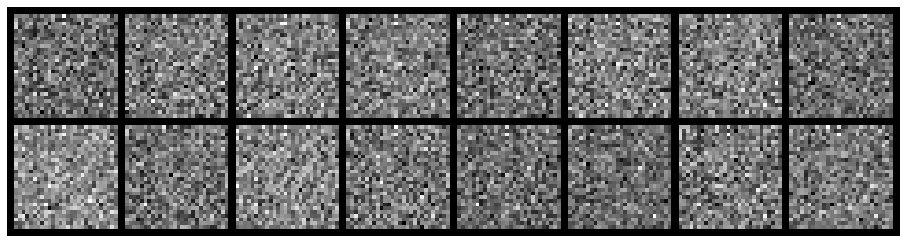

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.2473, Generator Loss: 0.6836
D(x): 0.5807, D(G(z)): 0.5051


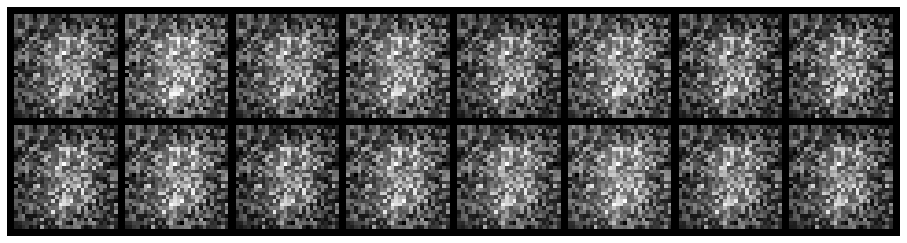

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.5036, Generator Loss: 1.0296
D(x): 0.8199, D(G(z)): 0.6739


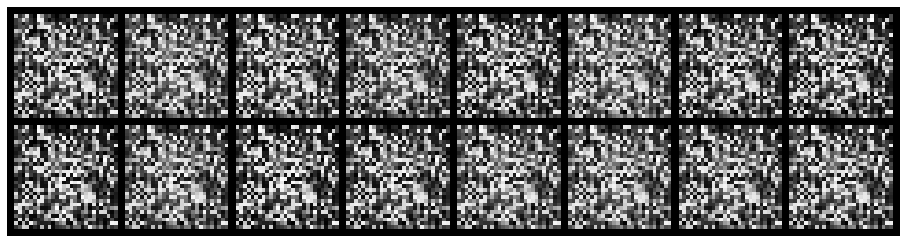

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.1316, Generator Loss: 5.3112
D(x): 0.9867, D(G(z)): 0.1014


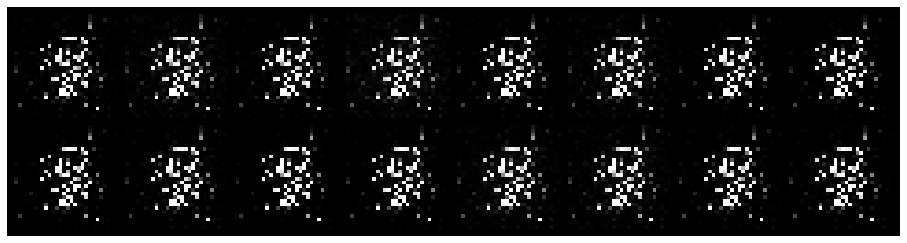

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.1585, Generator Loss: 5.0137
D(x): 0.9475, D(G(z)): 0.0745


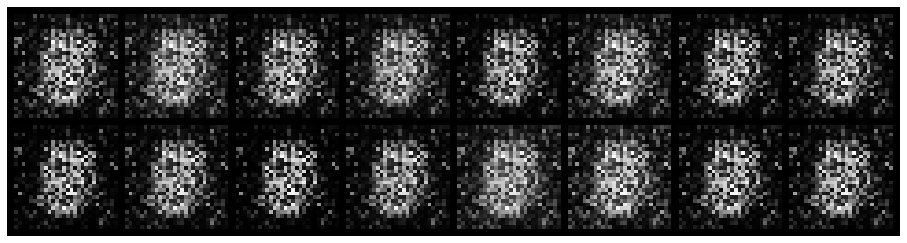

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 1.3286, Generator Loss: 3.5785
D(x): 0.6721, D(G(z)): 0.3812


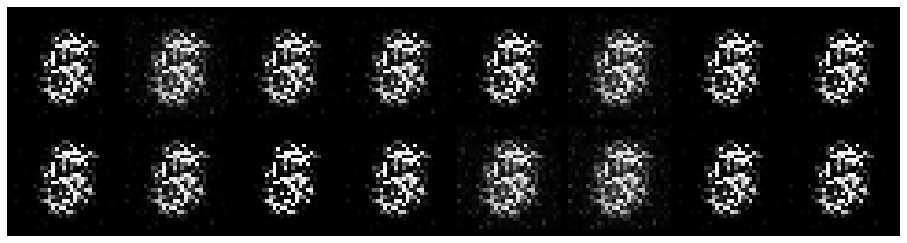

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.9283, Generator Loss: 2.6909
D(x): 0.7953, D(G(z)): 0.3762


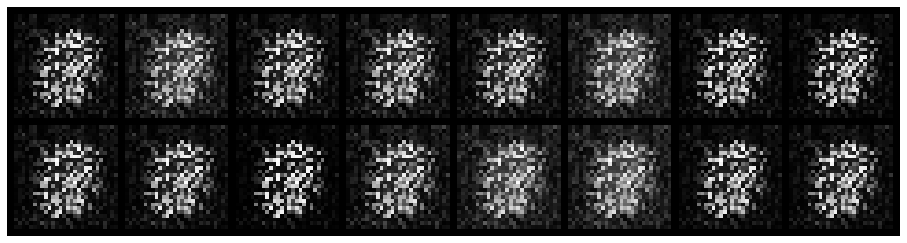

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.8671, Generator Loss: 2.8206
D(x): 0.7520, D(G(z)): 0.3152


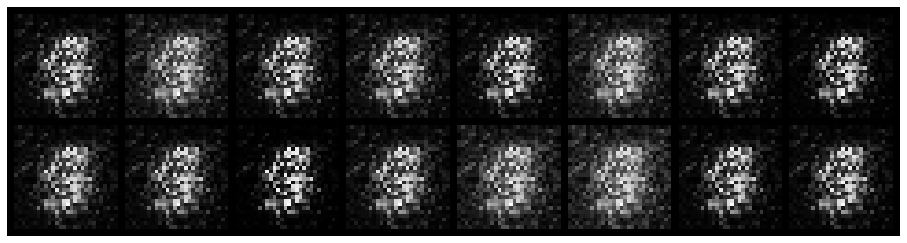

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.1343, Generator Loss: 1.0042
D(x): 0.6032, D(G(z)): 0.4232


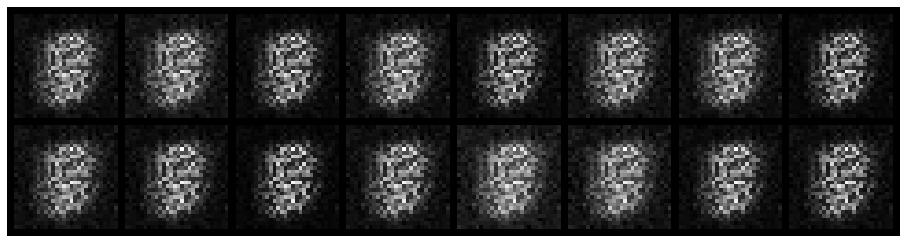

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.2949, Generator Loss: 1.0100
D(x): 0.6331, D(G(z)): 0.4844


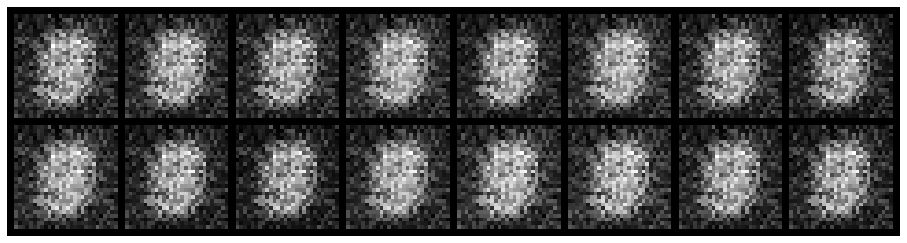

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 1.0440, Generator Loss: 1.0145
D(x): 0.6831, D(G(z)): 0.4468


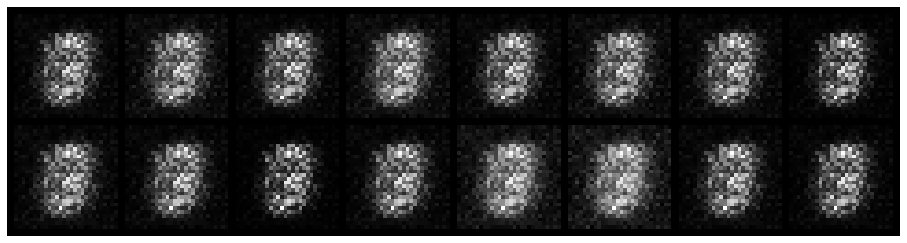

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.7596, Generator Loss: 2.1487
D(x): 0.7646, D(G(z)): 0.3286


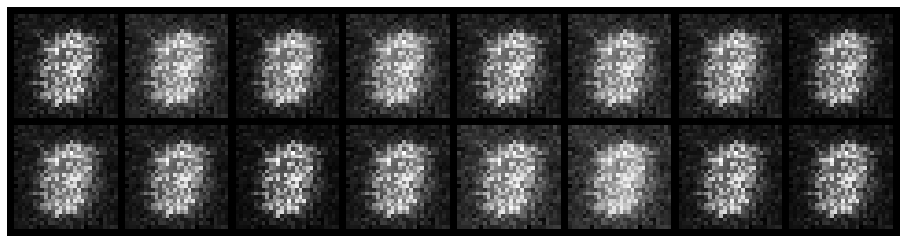

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 2.3845, Generator Loss: 0.3546
D(x): 0.5012, D(G(z)): 0.7441


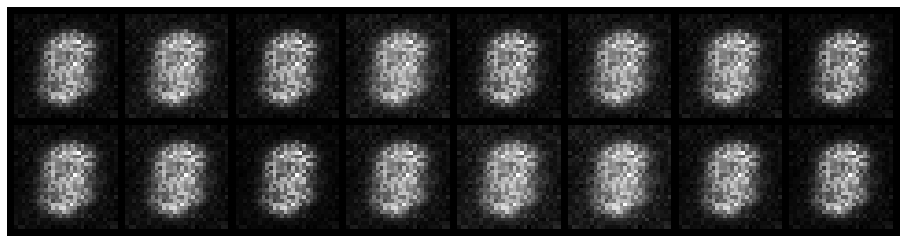

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.8745, Generator Loss: 1.1772
D(x): 0.7070, D(G(z)): 0.3910


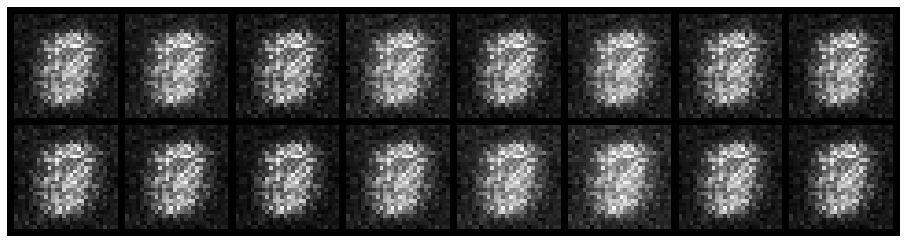

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.9343, Generator Loss: 1.8902
D(x): 0.7419, D(G(z)): 0.3478


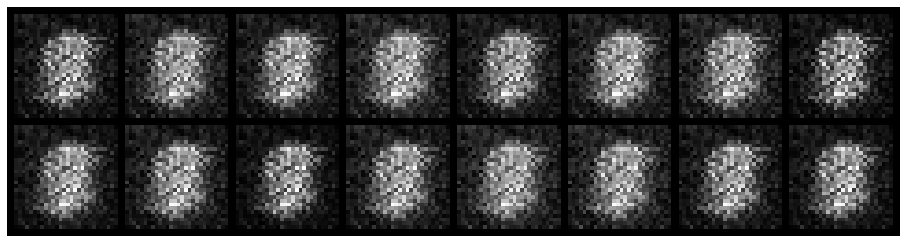

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.5294, Generator Loss: 1.9964
D(x): 0.7998, D(G(z)): 0.2277


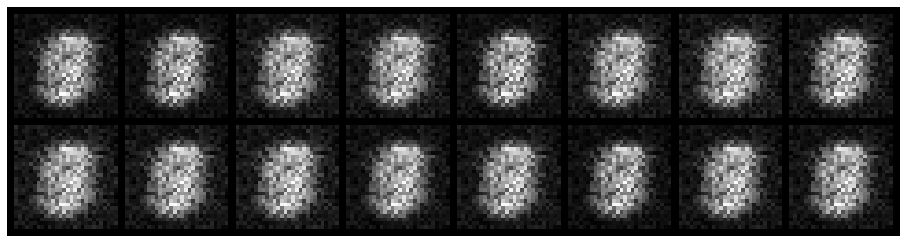

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.6235, Generator Loss: 1.7543
D(x): 0.8177, D(G(z)): 0.3013


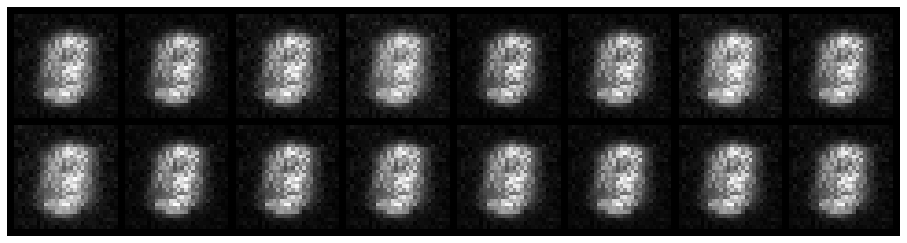

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.9172, Generator Loss: 2.8729
D(x): 0.7386, D(G(z)): 0.2283


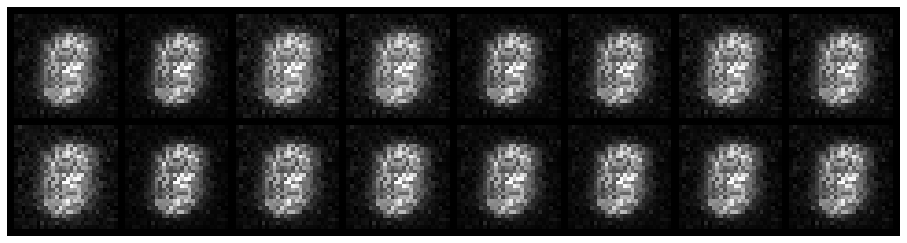

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 1.2218, Generator Loss: 1.0337
D(x): 0.6431, D(G(z)): 0.4695


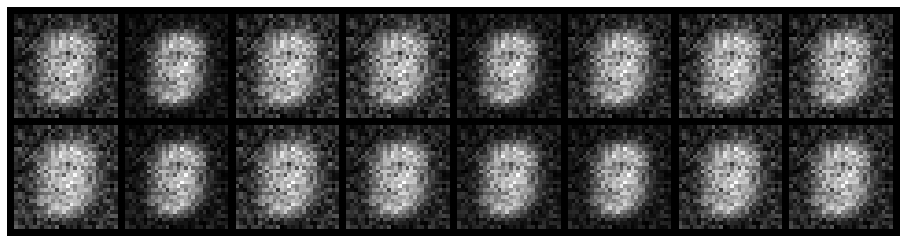

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.3416, Generator Loss: 3.2546
D(x): 0.8606, D(G(z)): 0.1191


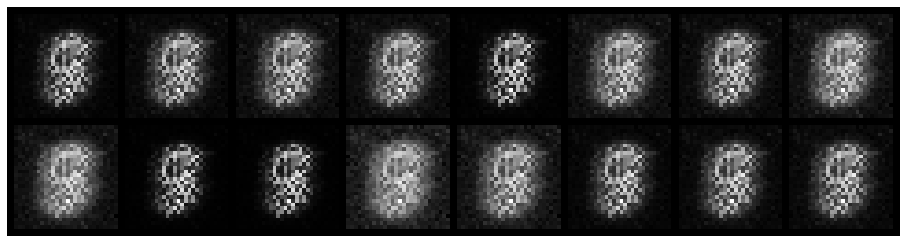

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 1.1937, Generator Loss: 2.3511
D(x): 0.7030, D(G(z)): 0.3508


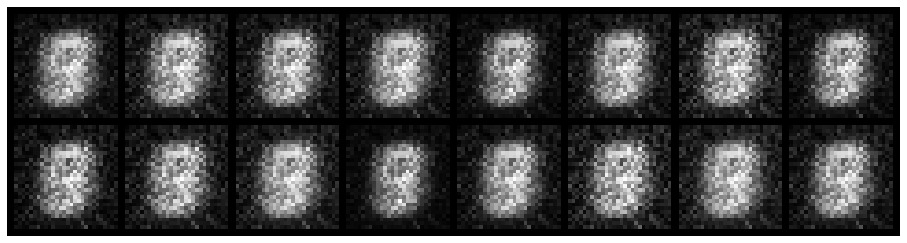

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.5874, Generator Loss: 1.5193
D(x): 0.8031, D(G(z)): 0.2325


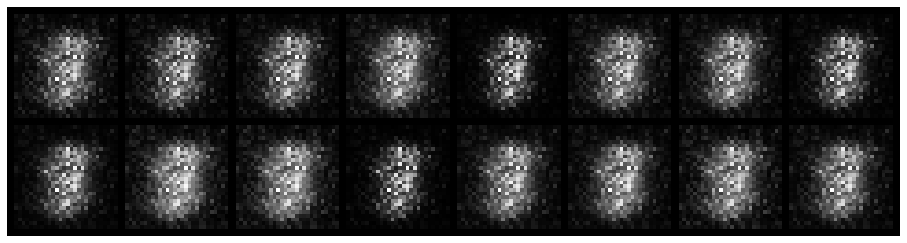

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 1.8267, Generator Loss: 1.0757
D(x): 0.6094, D(G(z)): 0.5002


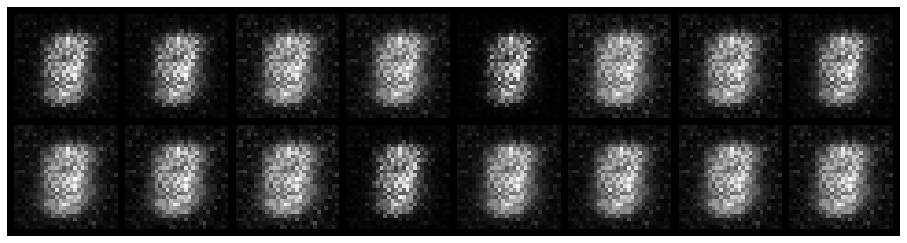

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.4892, Generator Loss: 2.6207
D(x): 0.8251, D(G(z)): 0.1826


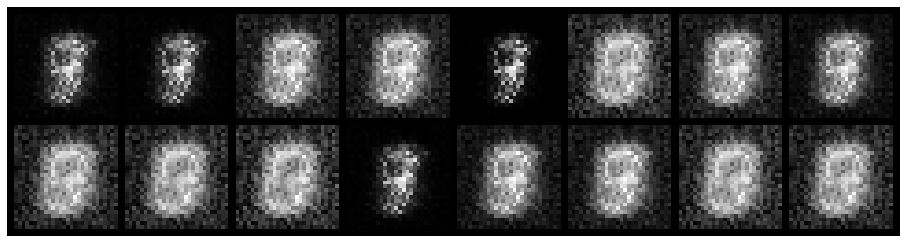

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 1.0668, Generator Loss: 1.5507
D(x): 0.6607, D(G(z)): 0.2861


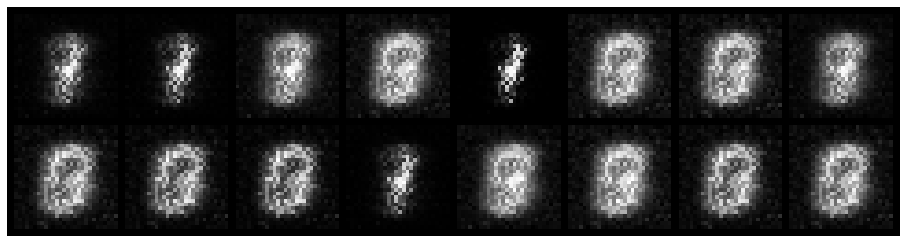

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 1.0092, Generator Loss: 1.0942
D(x): 0.7378, D(G(z)): 0.3545


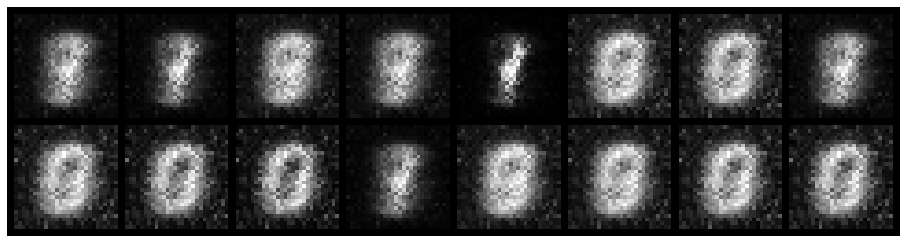

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.5415, Generator Loss: 2.2973
D(x): 0.8718, D(G(z)): 0.2431


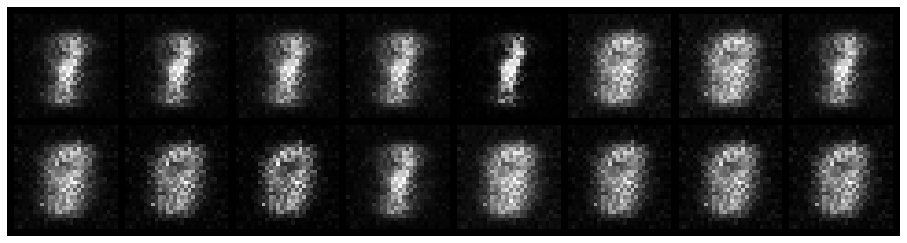

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.4647, Generator Loss: 3.7216
D(x): 0.8188, D(G(z)): 0.0961


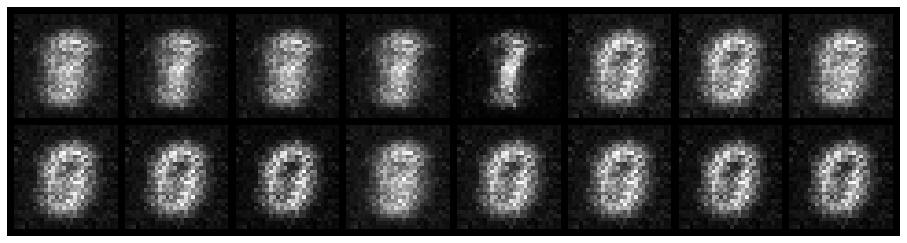

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.2547, Generator Loss: 2.6799
D(x): 0.9179, D(G(z)): 0.1143


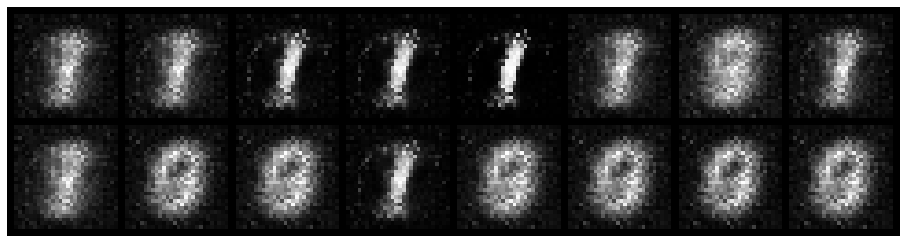

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.5188, Generator Loss: 1.9607
D(x): 0.8930, D(G(z)): 0.1918


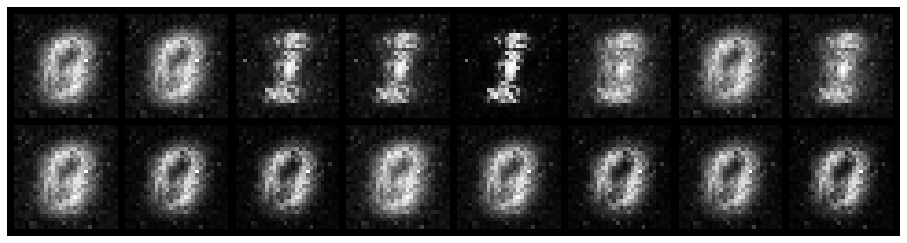

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.3214, Generator Loss: 3.3463
D(x): 0.9096, D(G(z)): 0.0866


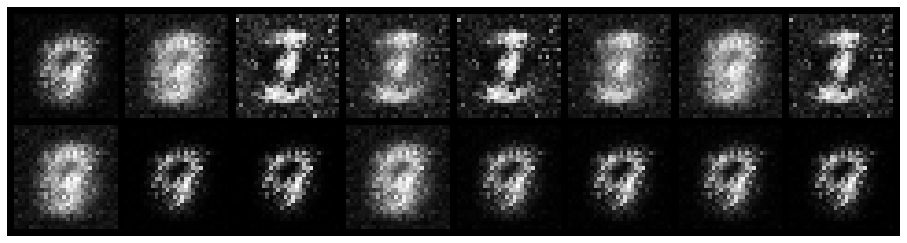

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.7053, Generator Loss: 1.9783
D(x): 0.8295, D(G(z)): 0.2588


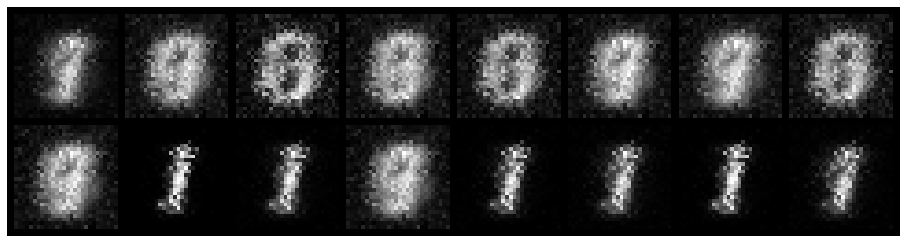

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 1.1150, Generator Loss: 1.6186
D(x): 0.6664, D(G(z)): 0.2994


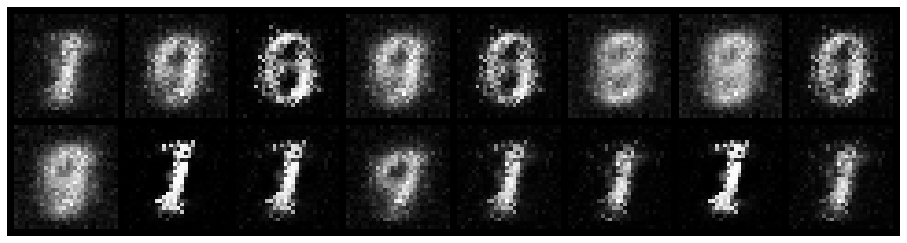

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.8160, Generator Loss: 2.8357
D(x): 0.8090, D(G(z)): 0.1856


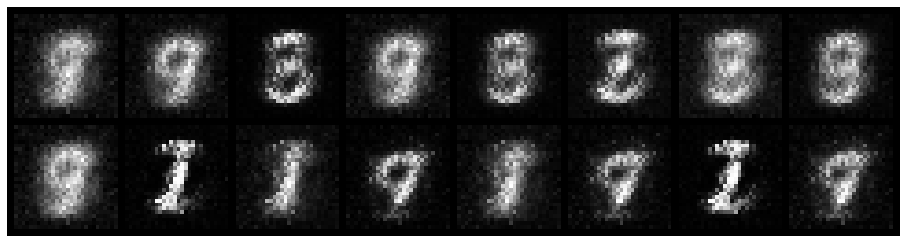

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.3501, Generator Loss: 2.7550
D(x): 0.8993, D(G(z)): 0.1671


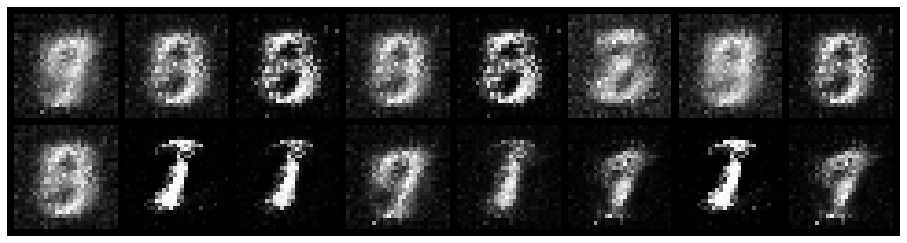

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.7949, Generator Loss: 1.8877
D(x): 0.7882, D(G(z)): 0.2537


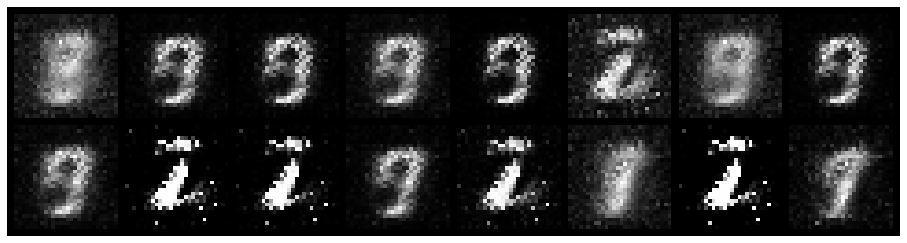

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.8567, Generator Loss: 3.2915
D(x): 0.7425, D(G(z)): 0.1082


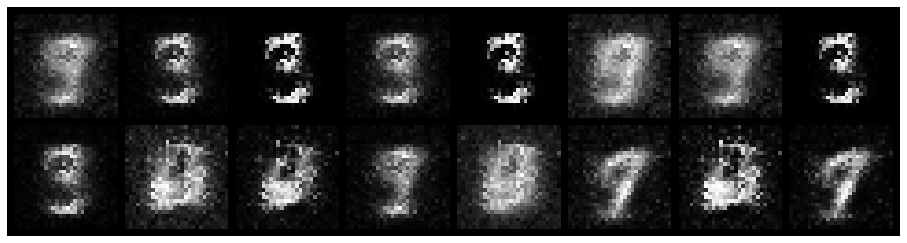

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.7525, Generator Loss: 2.2442
D(x): 0.7990, D(G(z)): 0.2651


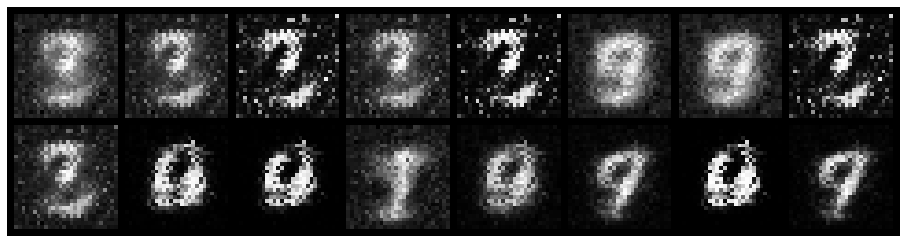

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.9623, Generator Loss: 2.2270
D(x): 0.7212, D(G(z)): 0.1967


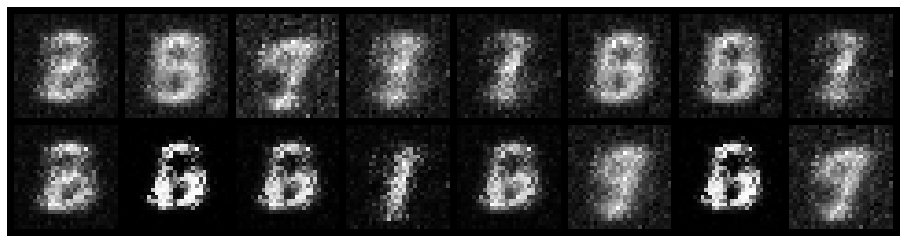

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.4790, Generator Loss: 2.2532
D(x): 0.8724, D(G(z)): 0.1849


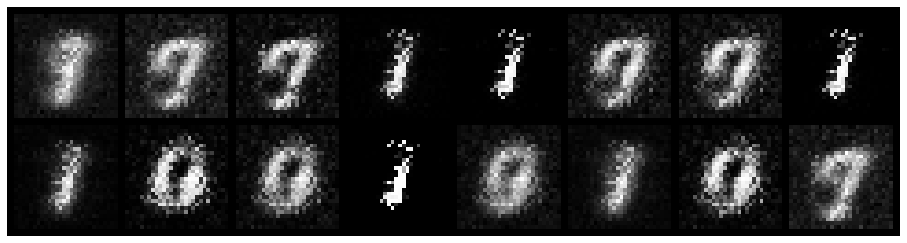

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.5141, Generator Loss: 2.4916
D(x): 0.8556, D(G(z)): 0.1444


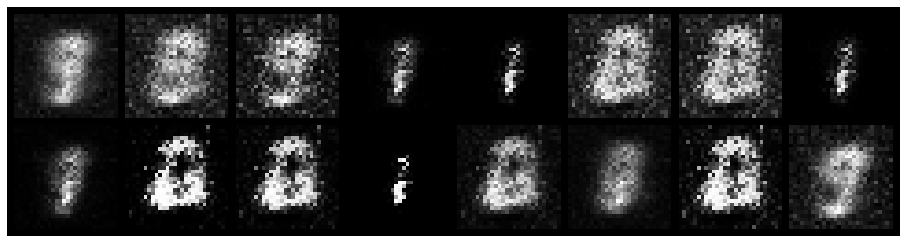

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.8651, Generator Loss: 2.5533
D(x): 0.7401, D(G(z)): 0.1522


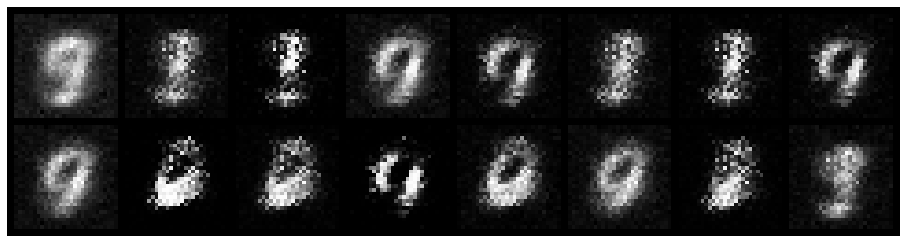

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.5907, Generator Loss: 2.5640
D(x): 0.8334, D(G(z)): 0.1809


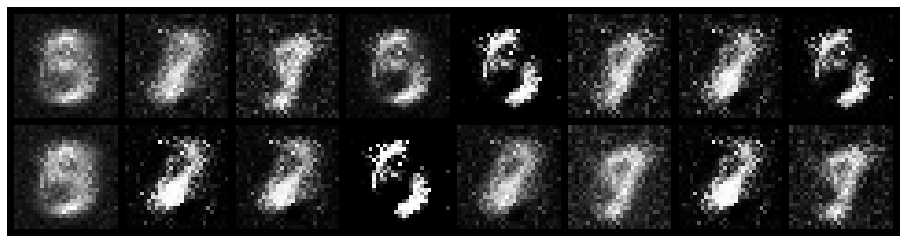

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.5099, Generator Loss: 1.7883
D(x): 0.8504, D(G(z)): 0.2285


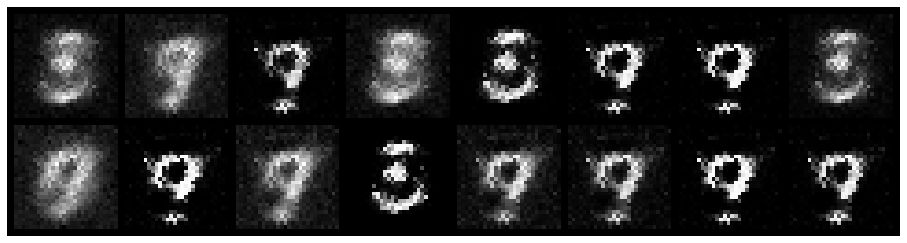

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.4489, Generator Loss: 2.9730
D(x): 0.8718, D(G(z)): 0.1717


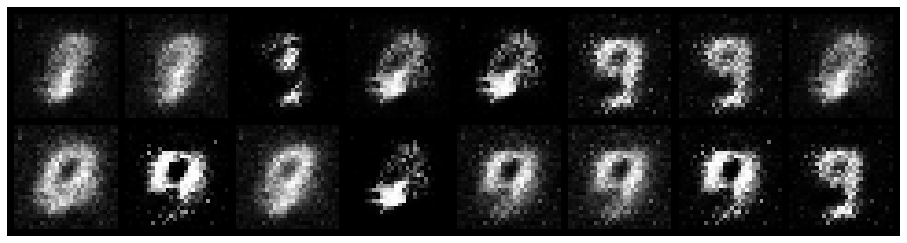

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.5215, Generator Loss: 1.6928
D(x): 0.8177, D(G(z)): 0.1555


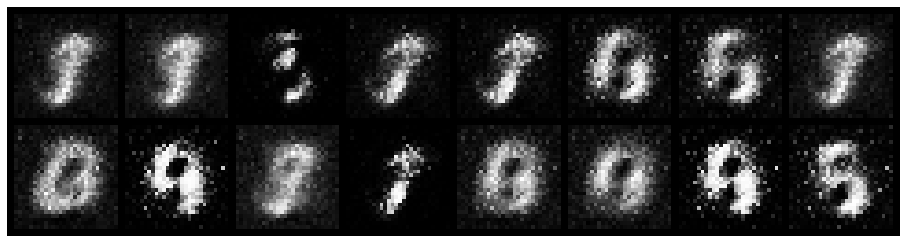

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.4938, Generator Loss: 2.4007
D(x): 0.8976, D(G(z)): 0.1766


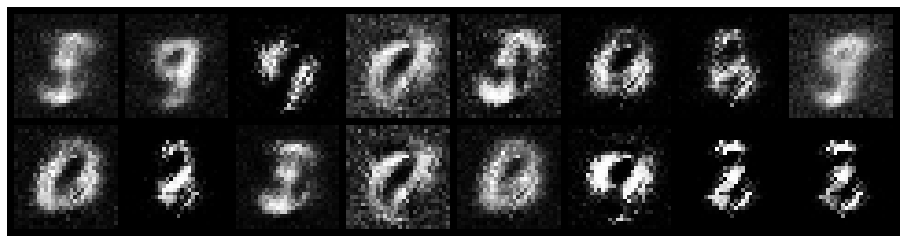

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.8610, Generator Loss: 2.4157
D(x): 0.7814, D(G(z)): 0.2424


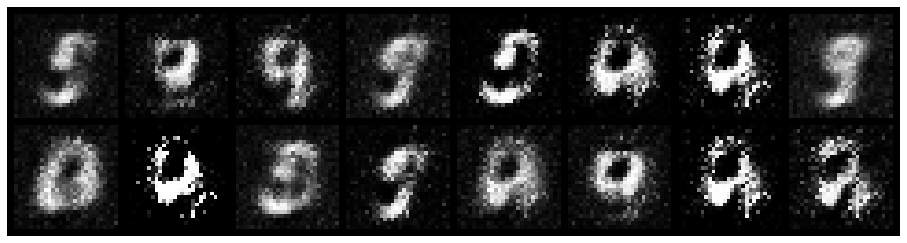

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.4884, Generator Loss: 2.2342
D(x): 0.8338, D(G(z)): 0.1853


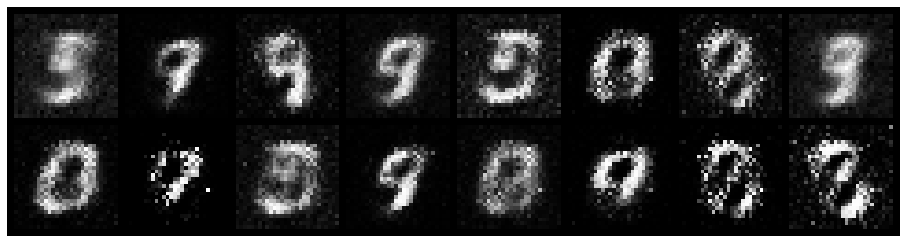

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.6441, Generator Loss: 1.9472
D(x): 0.7616, D(G(z)): 0.1734


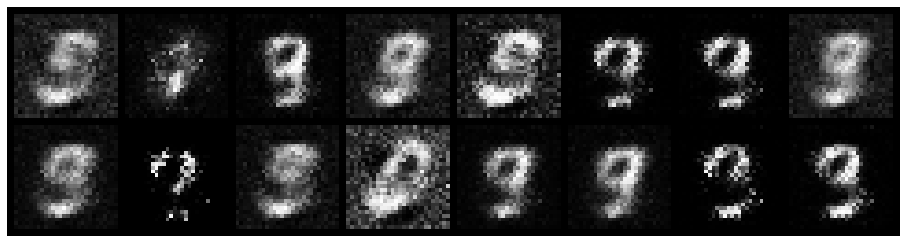

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5157, Generator Loss: 2.1574
D(x): 0.8044, D(G(z)): 0.1826


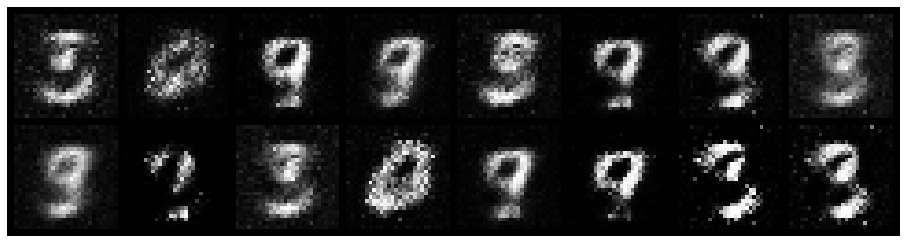

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.4935, Generator Loss: 2.2012
D(x): 0.8228, D(G(z)): 0.1734


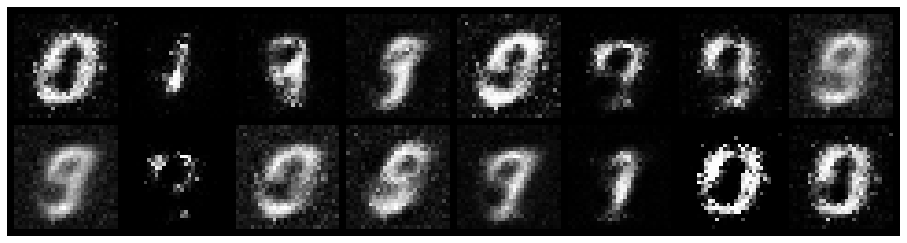

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.5593, Generator Loss: 2.0979
D(x): 0.8613, D(G(z)): 0.2179


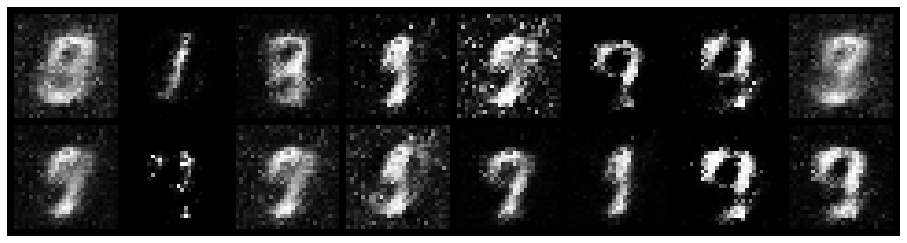

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.6425, Generator Loss: 2.1953
D(x): 0.8952, D(G(z)): 0.2846


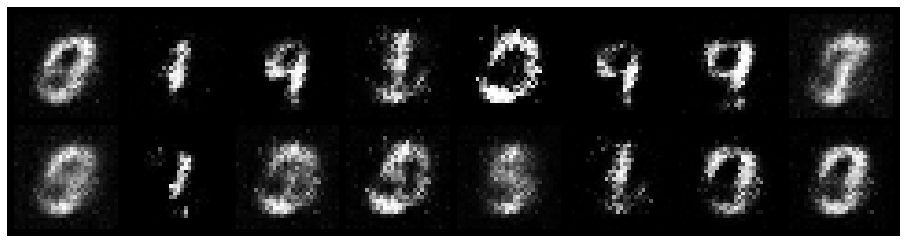

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.6445, Generator Loss: 2.0489
D(x): 0.8142, D(G(z)): 0.2385


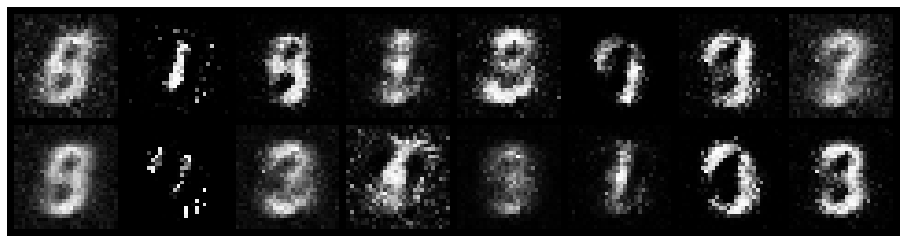

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.6824, Generator Loss: 2.5402
D(x): 0.8003, D(G(z)): 0.2040


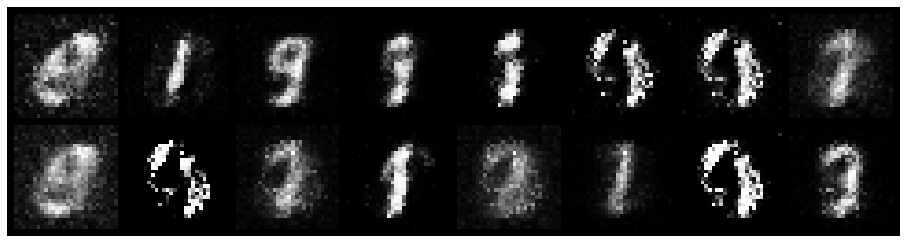

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.6121, Generator Loss: 2.6986
D(x): 0.7868, D(G(z)): 0.1400


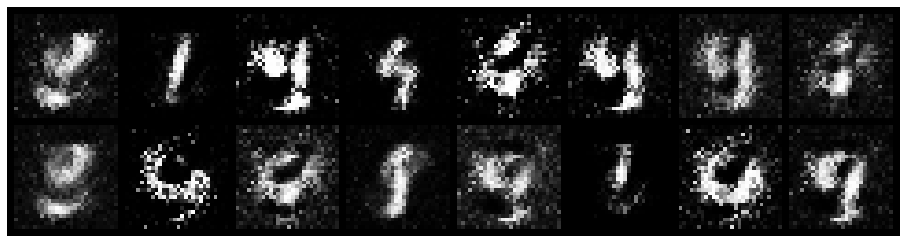

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.5394, Generator Loss: 3.3240
D(x): 0.8277, D(G(z)): 0.1592


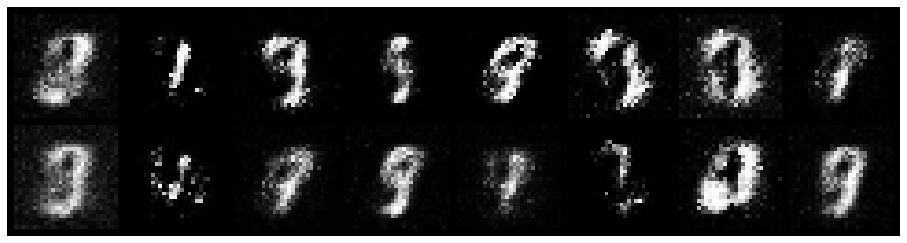

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.4713, Generator Loss: 3.0978
D(x): 0.8975, D(G(z)): 0.1812


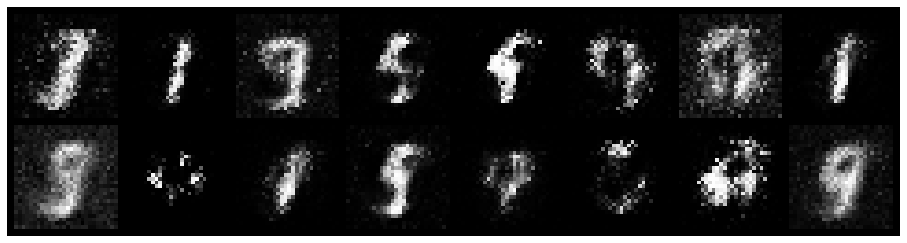

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.4688, Generator Loss: 2.6353
D(x): 0.8186, D(G(z)): 0.0910


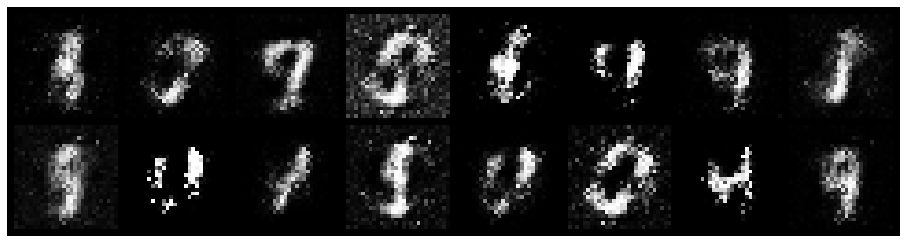

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.5908, Generator Loss: 2.8533
D(x): 0.8026, D(G(z)): 0.1440


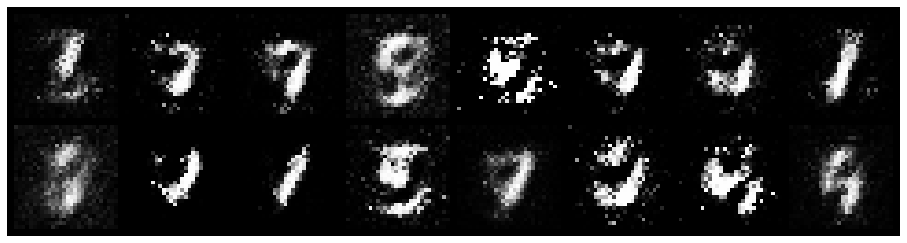

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.7751, Generator Loss: 2.0684
D(x): 0.8109, D(G(z)): 0.2630


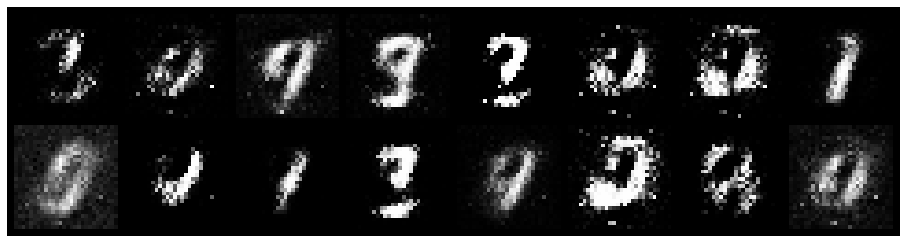

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.6097, Generator Loss: 2.5210
D(x): 0.8217, D(G(z)): 0.1836


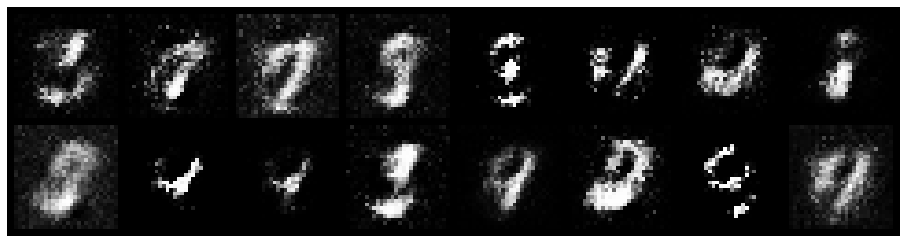

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.7116, Generator Loss: 2.2674
D(x): 0.7233, D(G(z)): 0.1535


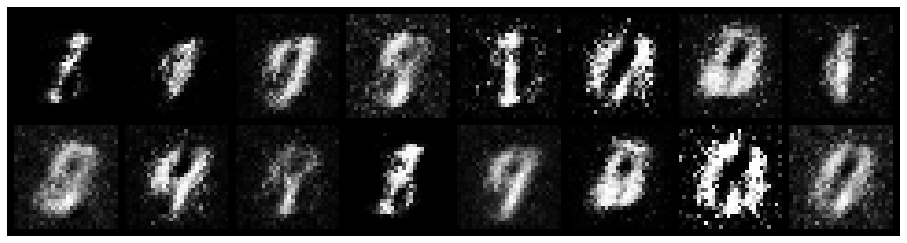

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.8367, Generator Loss: 2.2209
D(x): 0.7666, D(G(z)): 0.2586


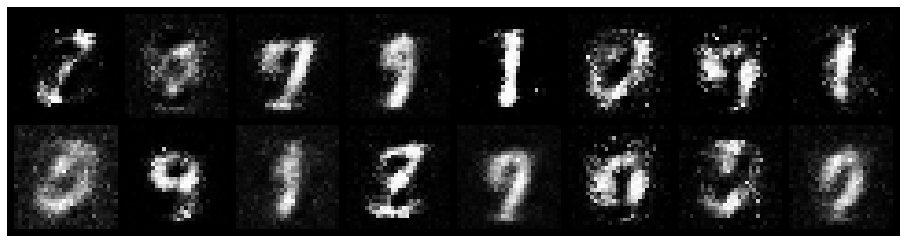

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.8156, Generator Loss: 1.7975
D(x): 0.7911, D(G(z)): 0.2676


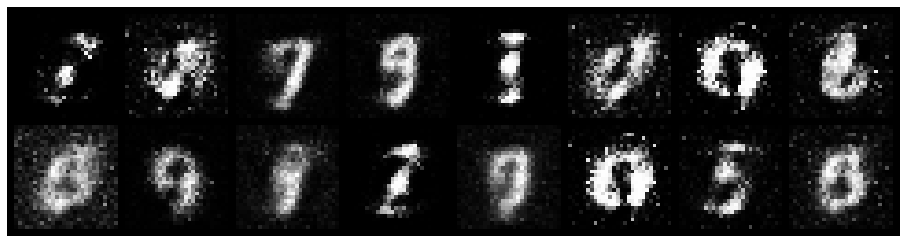

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.4781, Generator Loss: 2.3472
D(x): 0.8590, D(G(z)): 0.1850


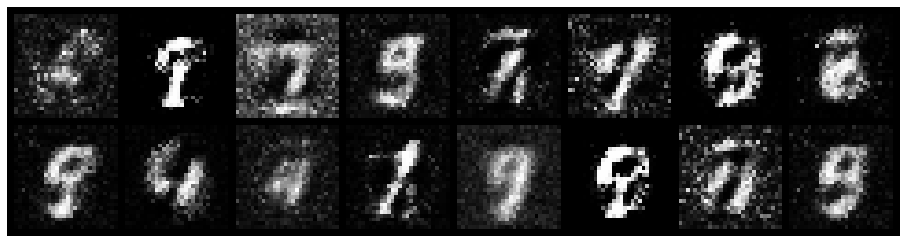

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.7871, Generator Loss: 1.6517
D(x): 0.7894, D(G(z)): 0.3038


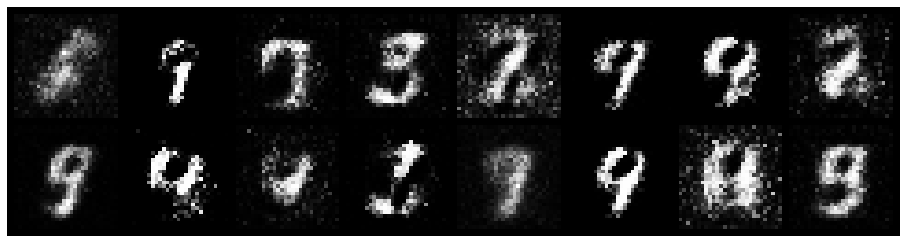

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.4871, Generator Loss: 2.9411
D(x): 0.7886, D(G(z)): 0.1079


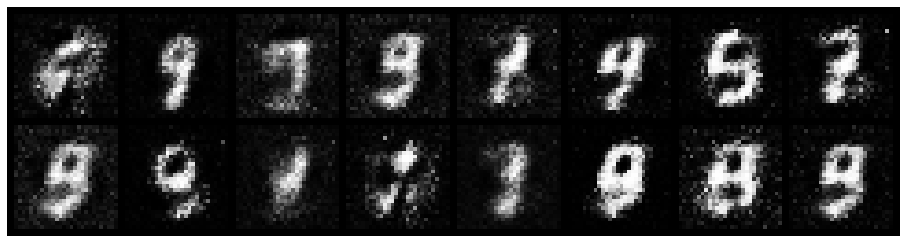

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.6954, Generator Loss: 2.4870
D(x): 0.7921, D(G(z)): 0.2298


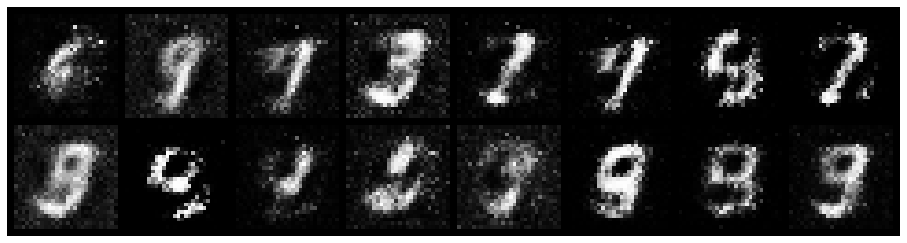

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.6821, Generator Loss: 2.3570
D(x): 0.8336, D(G(z)): 0.2363


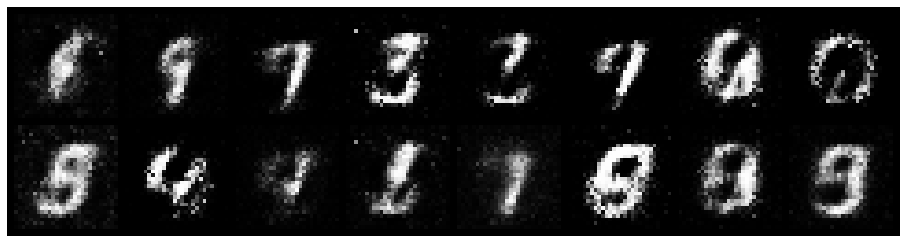

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 1.0895, Generator Loss: 1.6894
D(x): 0.6860, D(G(z)): 0.2962


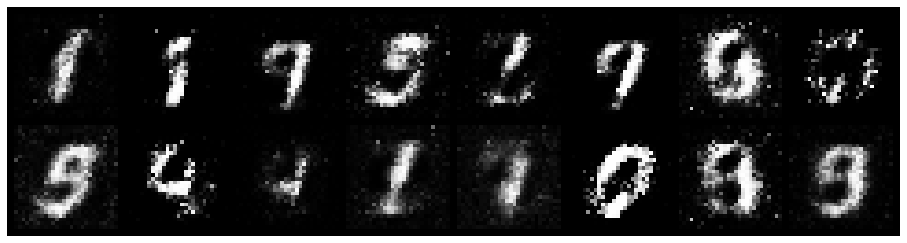

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.7452, Generator Loss: 1.8765
D(x): 0.8076, D(G(z)): 0.2400


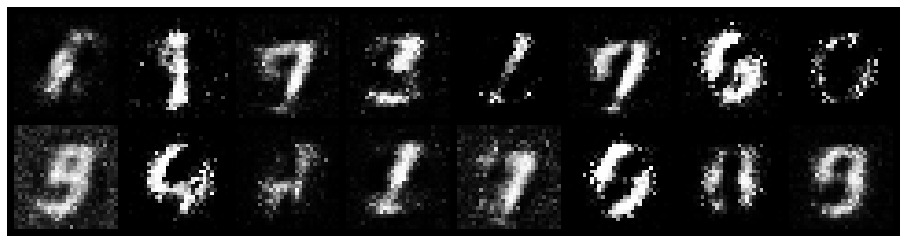

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.5388, Generator Loss: 2.1435
D(x): 0.8487, D(G(z)): 0.2235


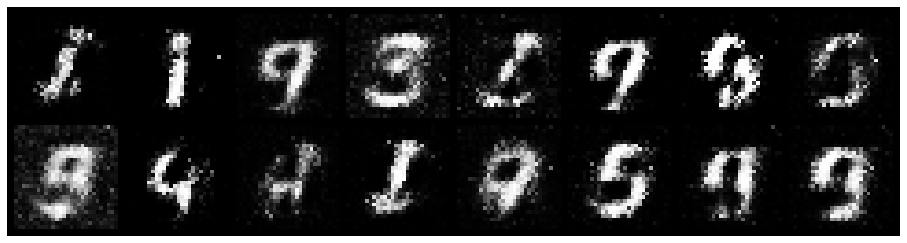

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.4670, Generator Loss: 2.8473
D(x): 0.8351, D(G(z)): 0.1821


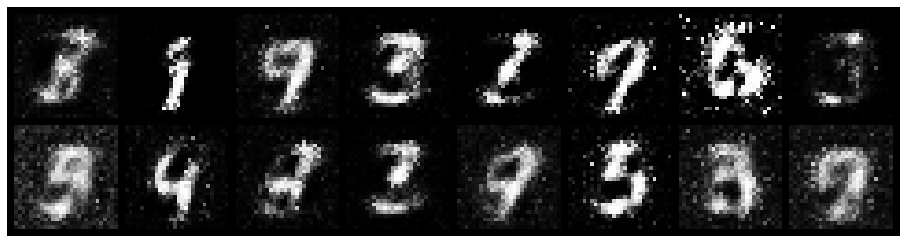

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.5421, Generator Loss: 2.4871
D(x): 0.8508, D(G(z)): 0.2149


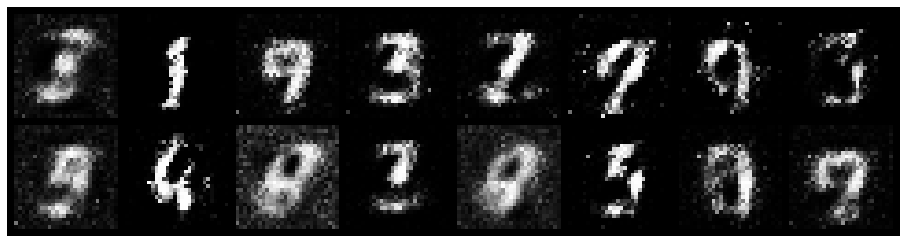

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.5473, Generator Loss: 2.6176
D(x): 0.8059, D(G(z)): 0.1489


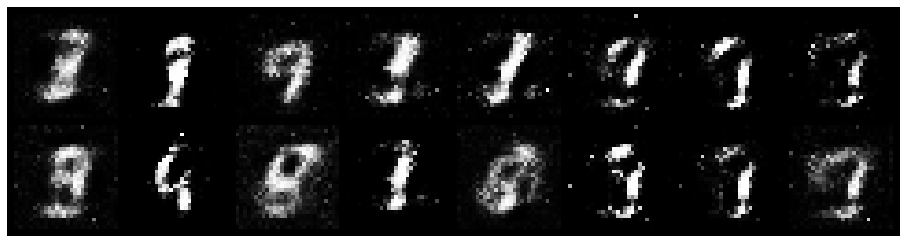

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.7252, Generator Loss: 2.5443
D(x): 0.7578, D(G(z)): 0.1593


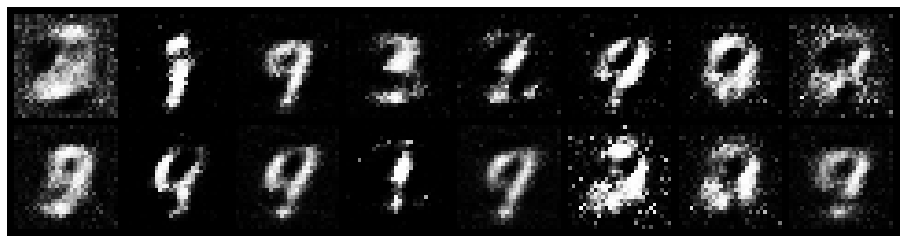

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.8127, Generator Loss: 1.9463
D(x): 0.7274, D(G(z)): 0.2461


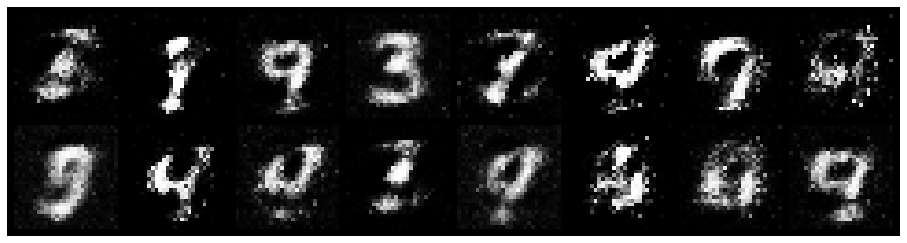

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.8327, Generator Loss: 1.3632
D(x): 0.7691, D(G(z)): 0.3755


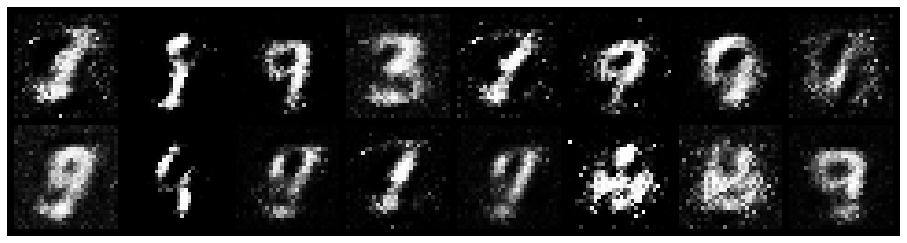

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.6216, Generator Loss: 2.0805
D(x): 0.7476, D(G(z)): 0.2032


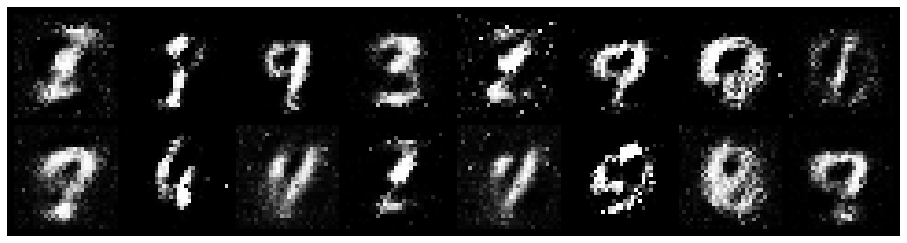

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.7342, Generator Loss: 2.1862
D(x): 0.7610, D(G(z)): 0.2514


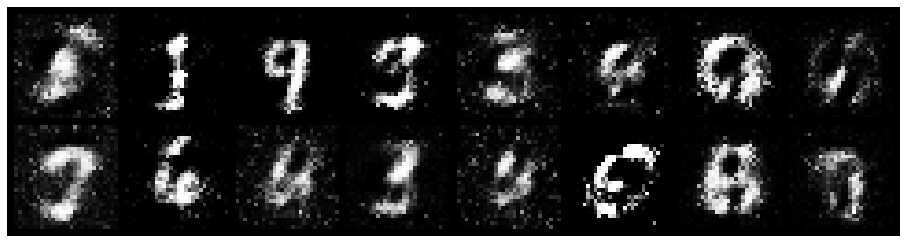

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.8372, Generator Loss: 2.1362
D(x): 0.7161, D(G(z)): 0.2475


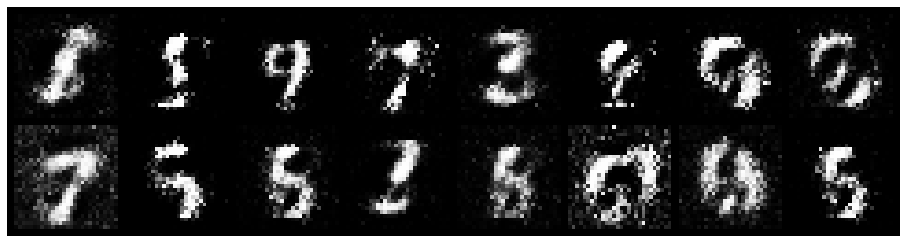

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.8135, Generator Loss: 1.7753
D(x): 0.7473, D(G(z)): 0.2643


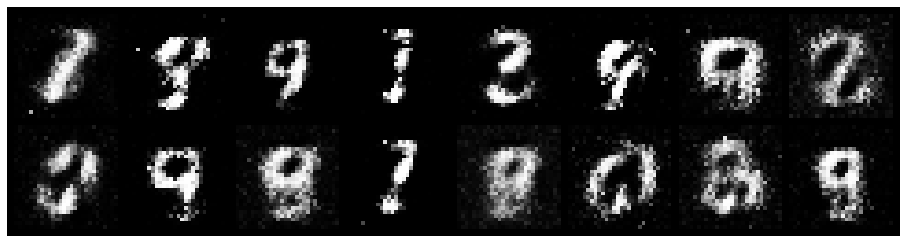

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.6553, Generator Loss: 2.1598
D(x): 0.8454, D(G(z)): 0.2869


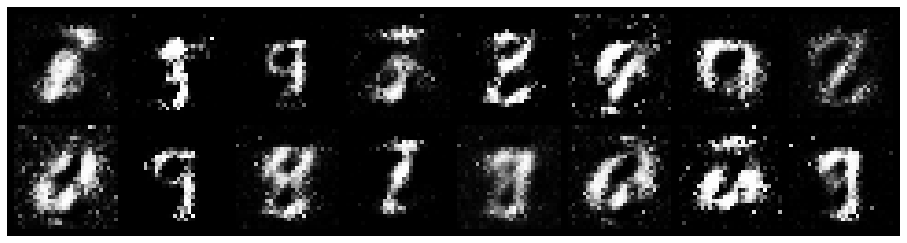

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.5927, Generator Loss: 2.0888
D(x): 0.8037, D(G(z)): 0.2134


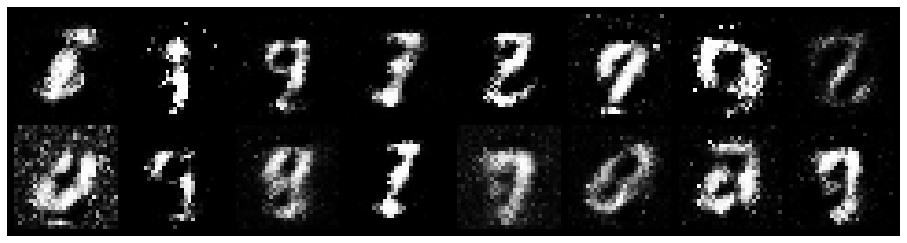

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.5837, Generator Loss: 2.6585
D(x): 0.7802, D(G(z)): 0.1465


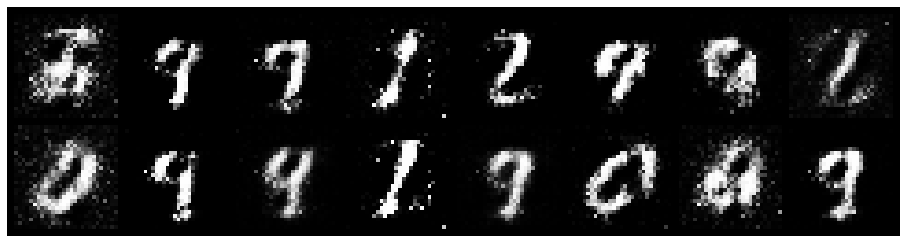

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 1.0375, Generator Loss: 1.6472
D(x): 0.7519, D(G(z)): 0.3622


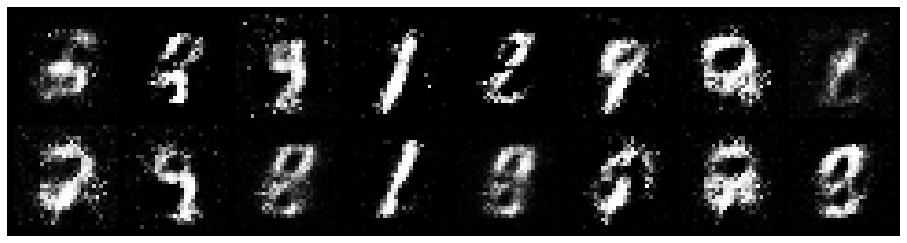

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 1.0979, Generator Loss: 1.5928
D(x): 0.6575, D(G(z)): 0.3167


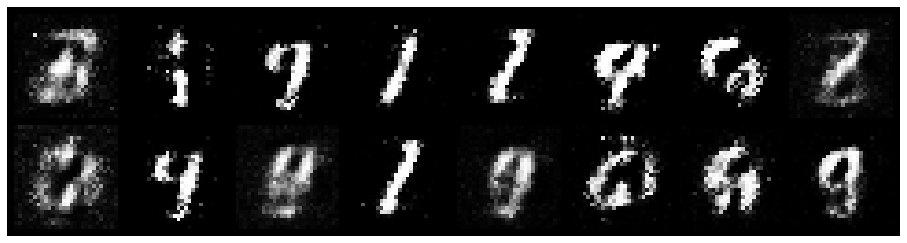

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8599, Generator Loss: 1.9986
D(x): 0.8223, D(G(z)): 0.3246


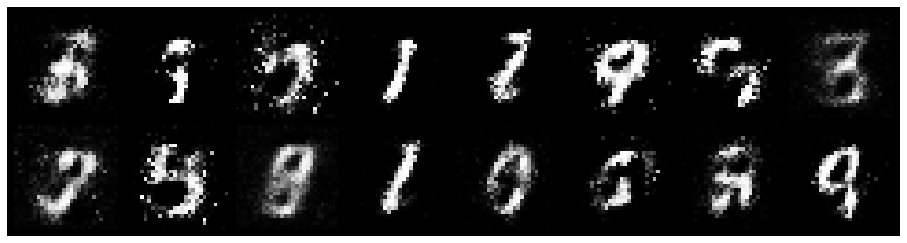

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.7876, Generator Loss: 2.1815
D(x): 0.8001, D(G(z)): 0.2823


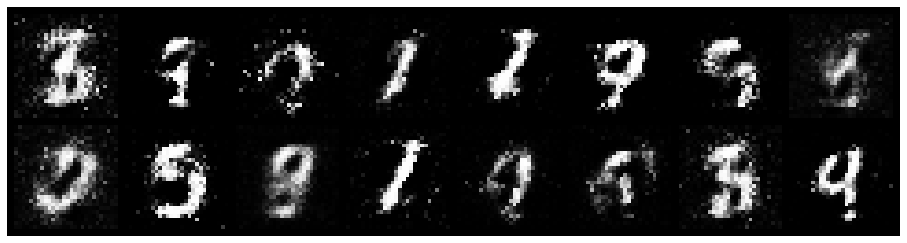

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.7822, Generator Loss: 1.8521
D(x): 0.6931, D(G(z)): 0.2083


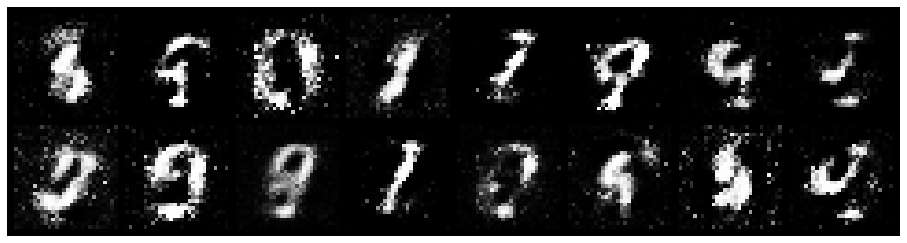

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.9165, Generator Loss: 2.2298
D(x): 0.6999, D(G(z)): 0.2535


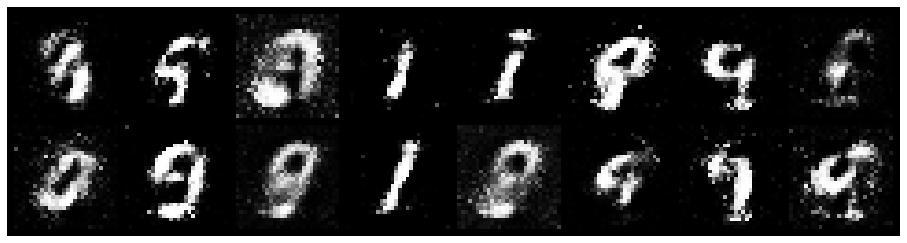

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 1.1021, Generator Loss: 2.2835
D(x): 0.6958, D(G(z)): 0.3119


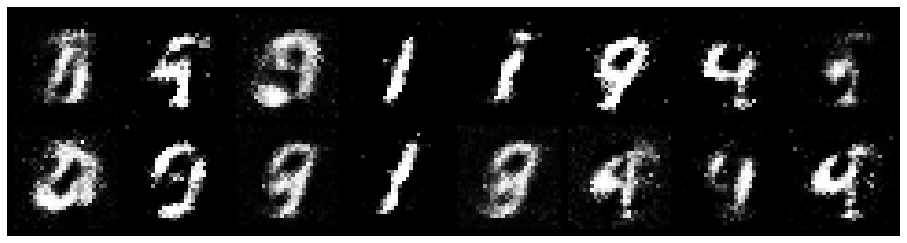

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7037, Generator Loss: 2.3230
D(x): 0.7402, D(G(z)): 0.1931


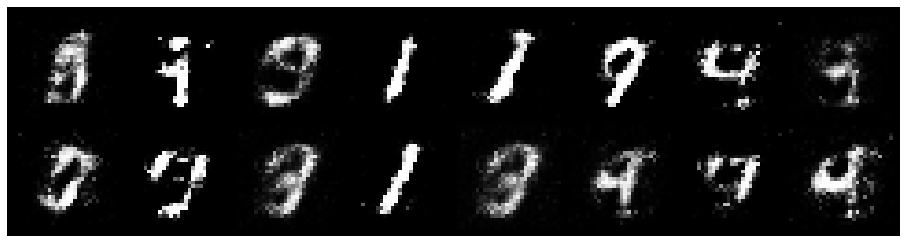

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.5516, Generator Loss: 2.7469
D(x): 0.8204, D(G(z)): 0.1718


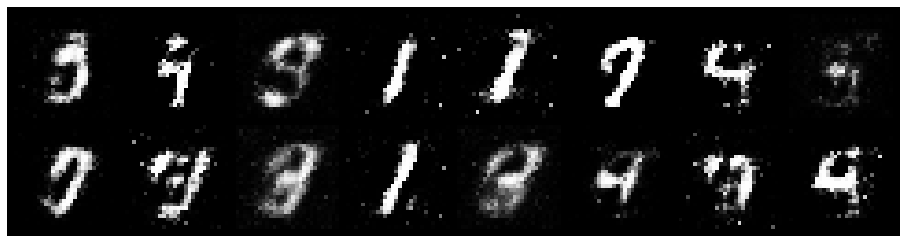

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7932, Generator Loss: 1.7512
D(x): 0.7421, D(G(z)): 0.2578


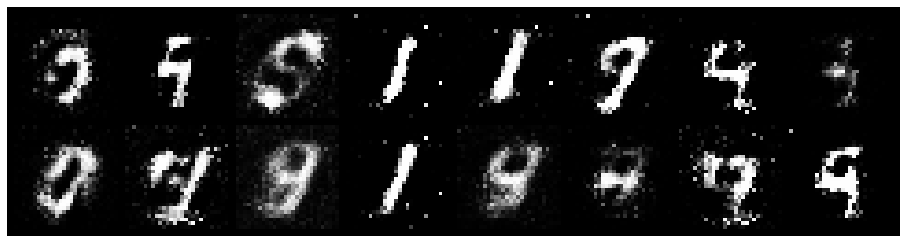

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.7403, Generator Loss: 1.7586
D(x): 0.7573, D(G(z)): 0.2854


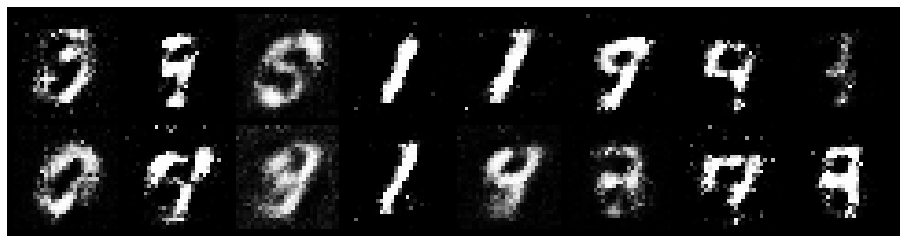

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.8531, Generator Loss: 1.9989
D(x): 0.7399, D(G(z)): 0.2806


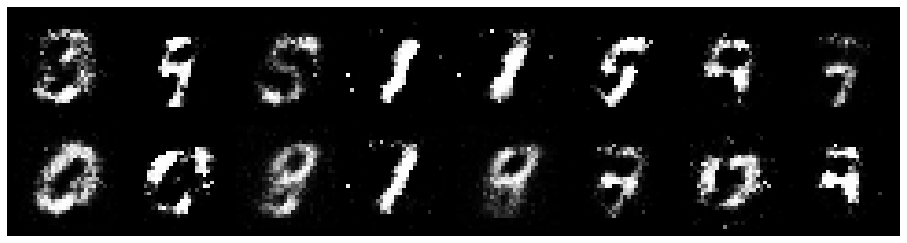

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.7965, Generator Loss: 1.6584
D(x): 0.7512, D(G(z)): 0.3146


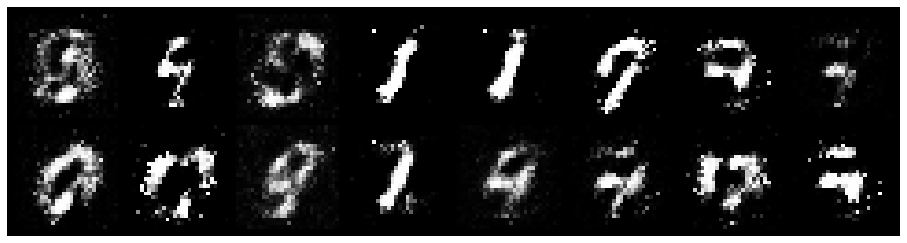

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.9345, Generator Loss: 2.1835
D(x): 0.7382, D(G(z)): 0.3336


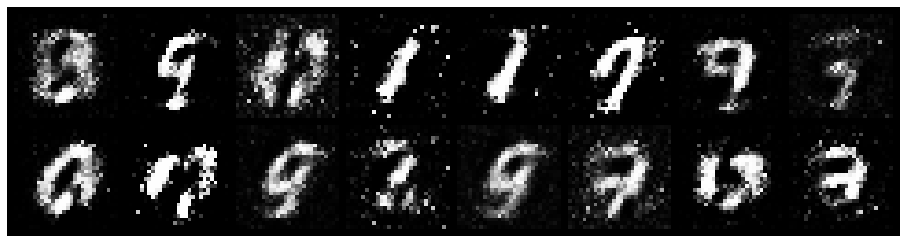

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.7107, Generator Loss: 1.5792
D(x): 0.7372, D(G(z)): 0.2254


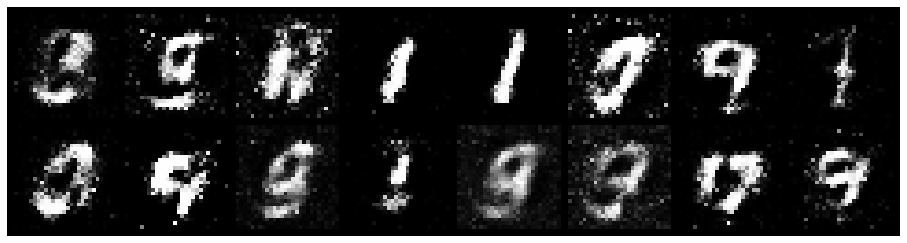

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.9685, Generator Loss: 1.4734
D(x): 0.6722, D(G(z)): 0.3218


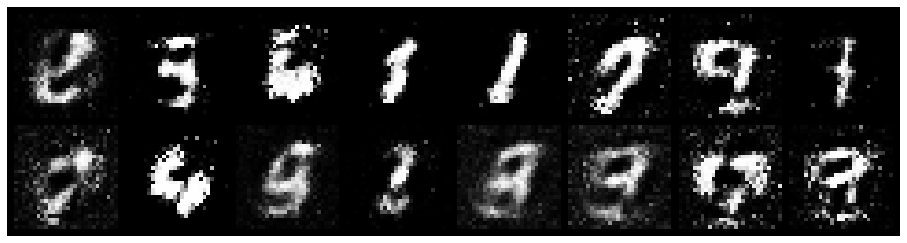

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 1.2525, Generator Loss: 1.8126
D(x): 0.5481, D(G(z)): 0.2977


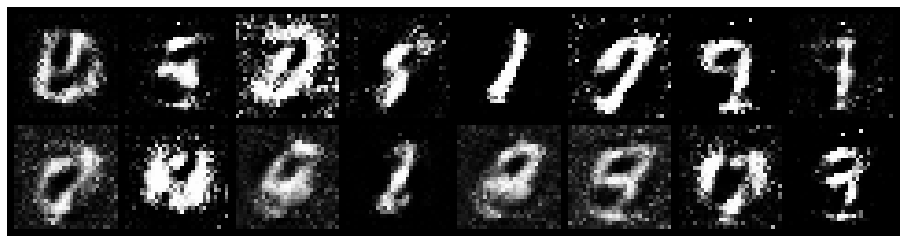

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.7743, Generator Loss: 2.1728
D(x): 0.8140, D(G(z)): 0.2683


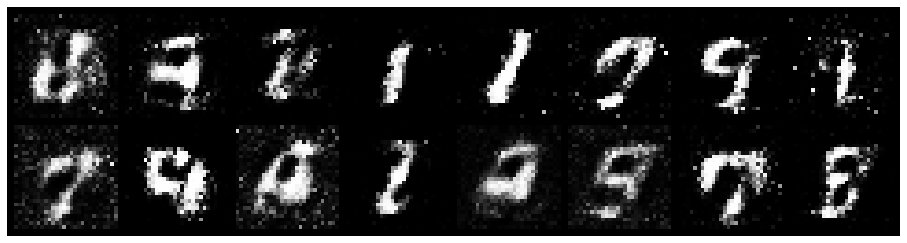

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.8534, Generator Loss: 1.9473
D(x): 0.7344, D(G(z)): 0.2338


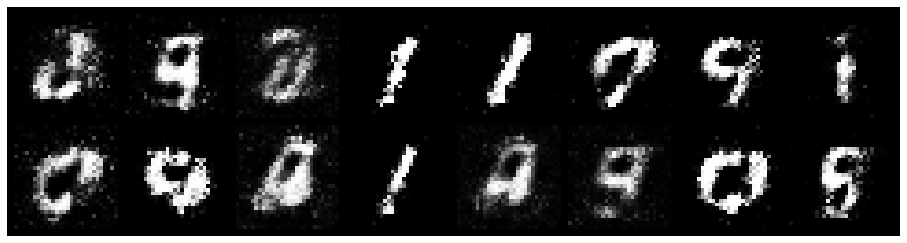

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.7928, Generator Loss: 2.0045
D(x): 0.6933, D(G(z)): 0.2274


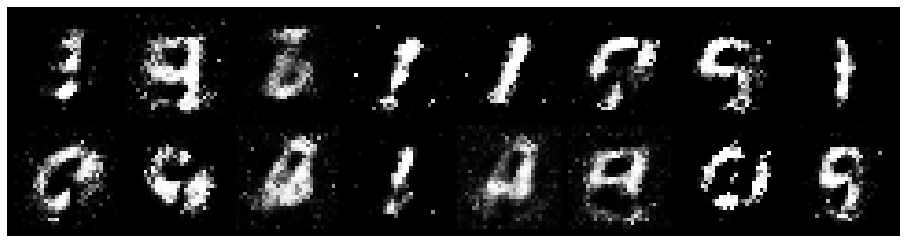

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.8243, Generator Loss: 1.7166
D(x): 0.6876, D(G(z)): 0.2447


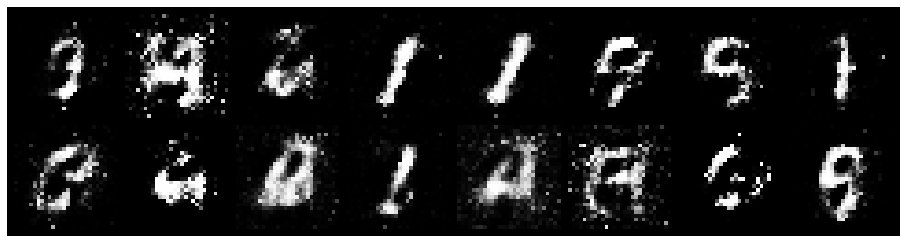

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.7806, Generator Loss: 1.6707
D(x): 0.7362, D(G(z)): 0.2433


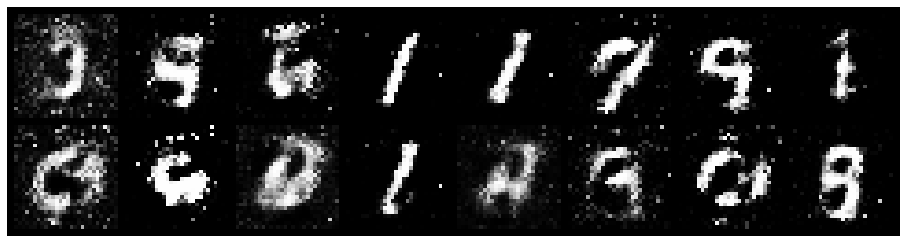

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.8213, Generator Loss: 2.1479
D(x): 0.7428, D(G(z)): 0.2611


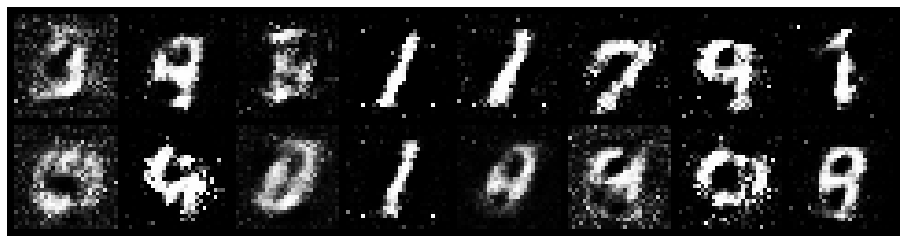

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.8779, Generator Loss: 1.4453
D(x): 0.6978, D(G(z)): 0.2875


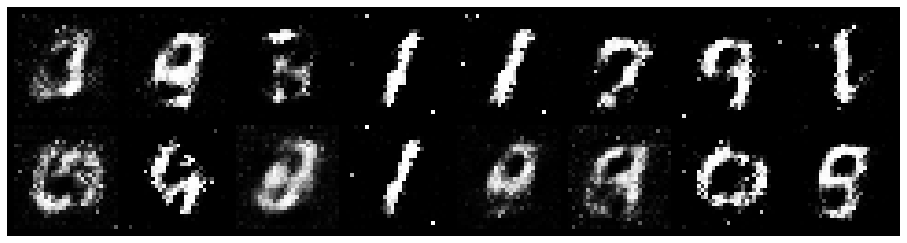

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.6812, Generator Loss: 1.9377
D(x): 0.7996, D(G(z)): 0.2892


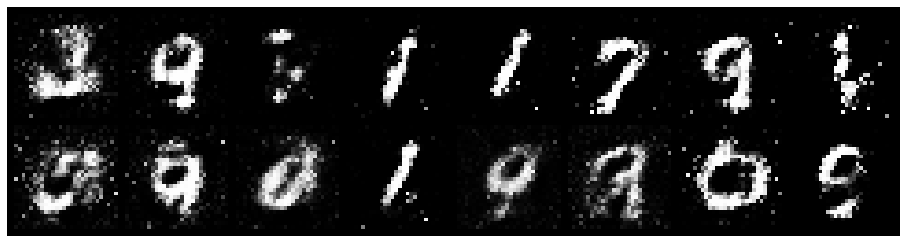

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.9113, Generator Loss: 1.7018
D(x): 0.7127, D(G(z)): 0.2995


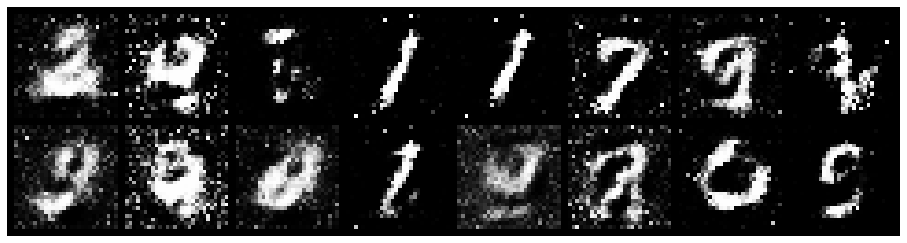

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.7538, Generator Loss: 1.9255
D(x): 0.7813, D(G(z)): 0.2897


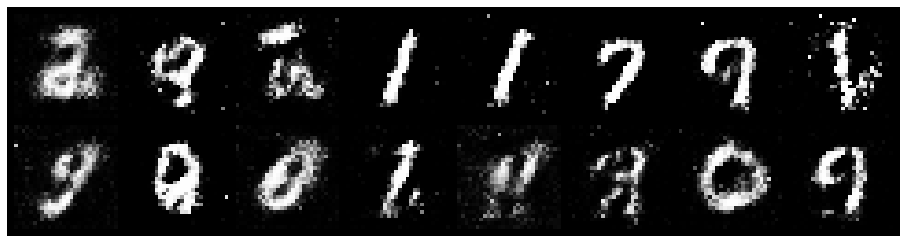

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.7130, Generator Loss: 2.3661
D(x): 0.7932, D(G(z)): 0.2348


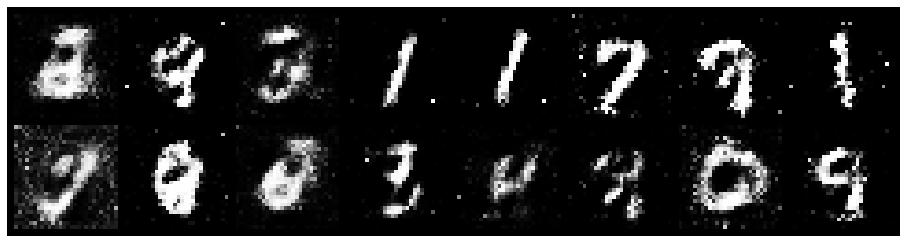

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 1.0343, Generator Loss: 1.6296
D(x): 0.7764, D(G(z)): 0.3917


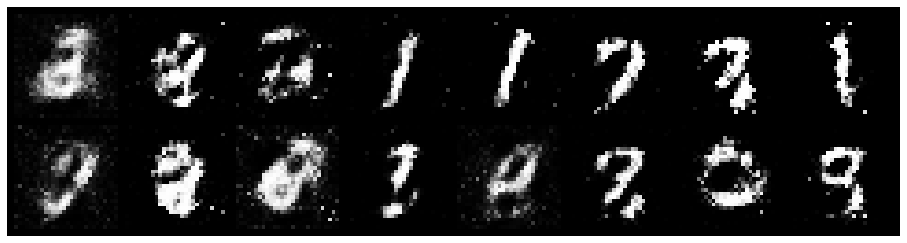

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.8834, Generator Loss: 1.7196
D(x): 0.6939, D(G(z)): 0.2624


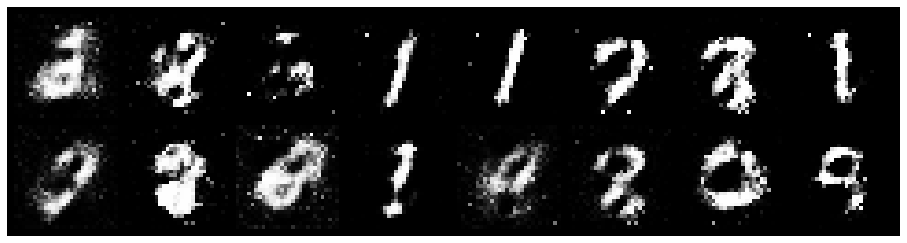

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.9505, Generator Loss: 1.7779
D(x): 0.7680, D(G(z)): 0.3286


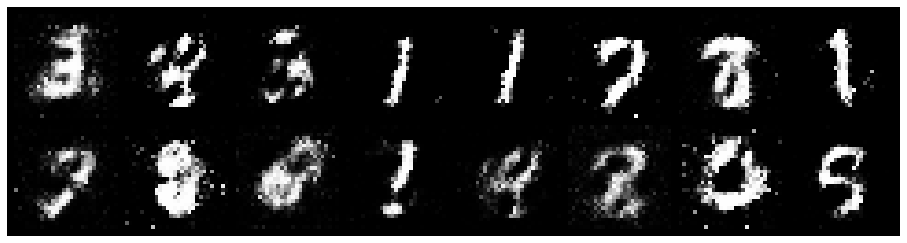

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7064, Generator Loss: 2.0722
D(x): 0.8436, D(G(z)): 0.2995


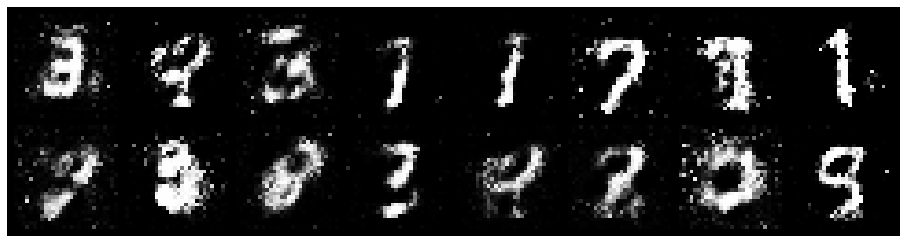

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.7891, Generator Loss: 1.5186
D(x): 0.7448, D(G(z)): 0.2890


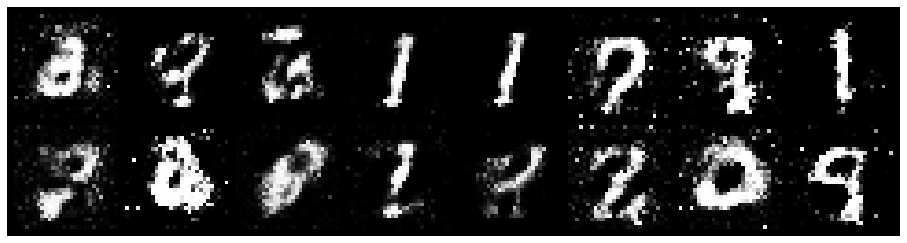

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.8153, Generator Loss: 1.8639
D(x): 0.7623, D(G(z)): 0.2965


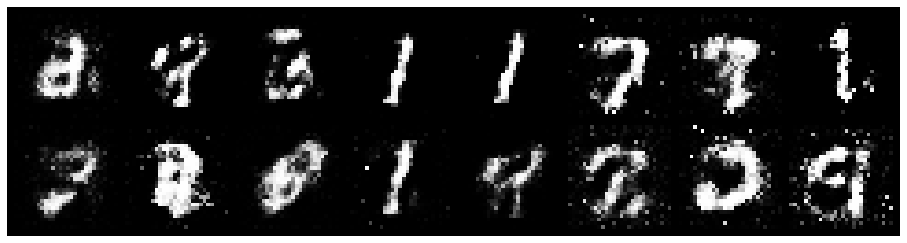

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.8415, Generator Loss: 1.6321
D(x): 0.6848, D(G(z)): 0.2411


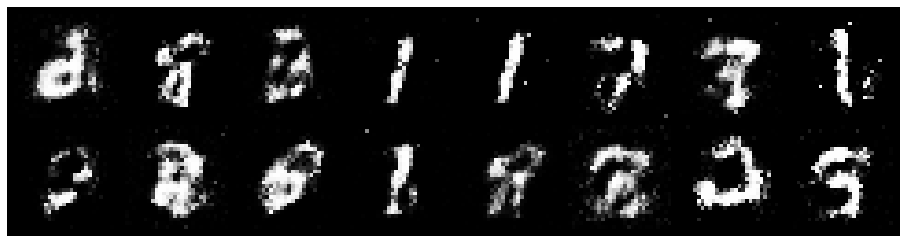

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.9255, Generator Loss: 1.4054
D(x): 0.7764, D(G(z)): 0.3572


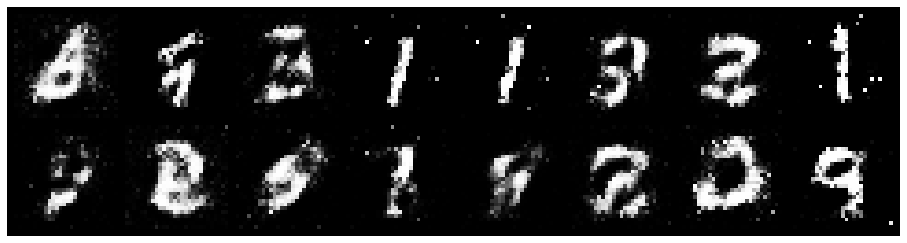

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8368, Generator Loss: 1.3928
D(x): 0.7069, D(G(z)): 0.2732


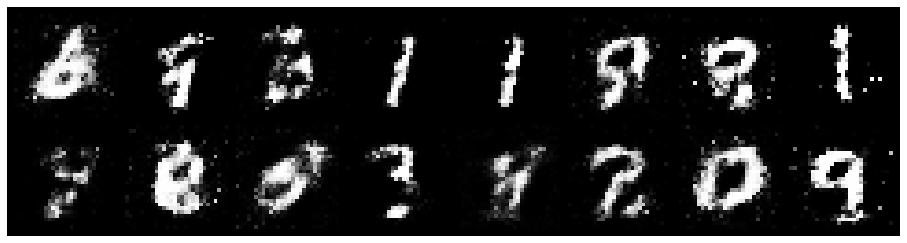

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.0708, Generator Loss: 1.5413
D(x): 0.7641, D(G(z)): 0.3775


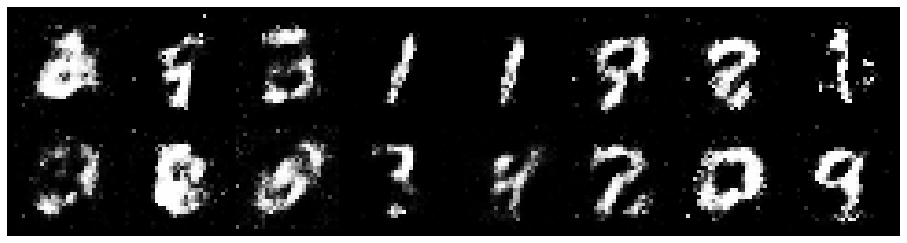

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.7266, Generator Loss: 1.9847
D(x): 0.7103, D(G(z)): 0.1929


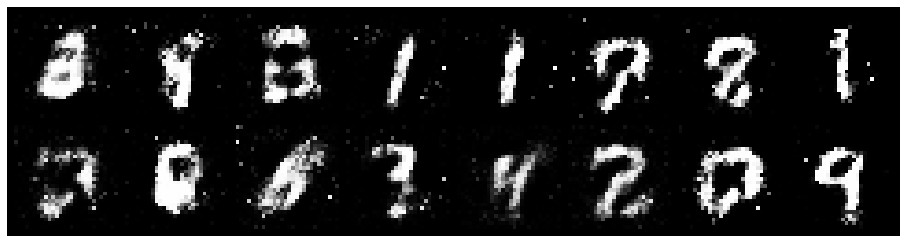

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 1.0115, Generator Loss: 1.8110
D(x): 0.6380, D(G(z)): 0.2614


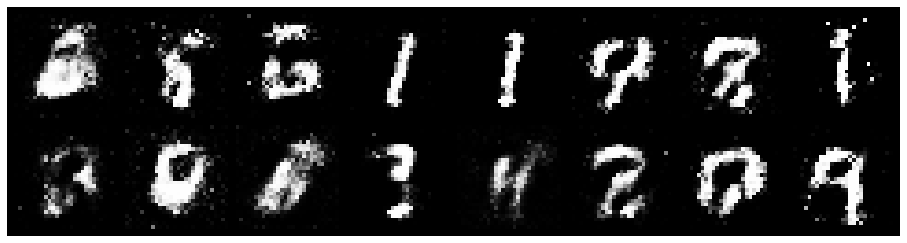

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.7668, Generator Loss: 1.6470
D(x): 0.7693, D(G(z)): 0.2981


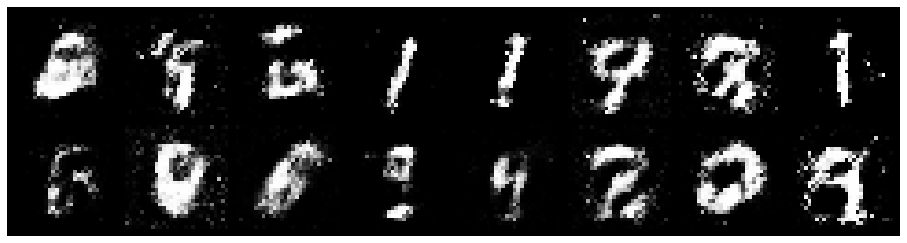

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.9101, Generator Loss: 1.6467
D(x): 0.7401, D(G(z)): 0.3603


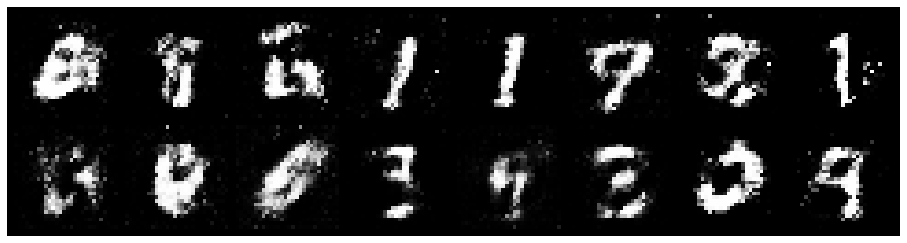

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.7558, Generator Loss: 1.6229
D(x): 0.7493, D(G(z)): 0.3038


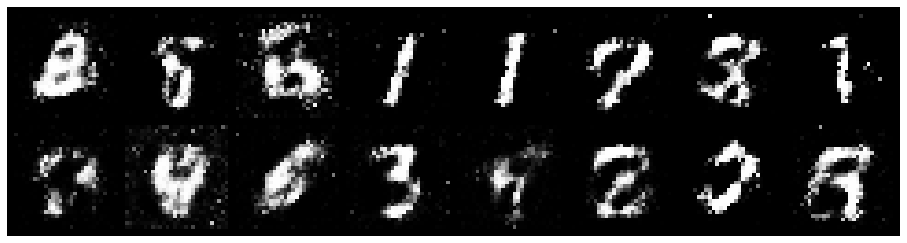

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8548, Generator Loss: 1.7649
D(x): 0.6705, D(G(z)): 0.2463


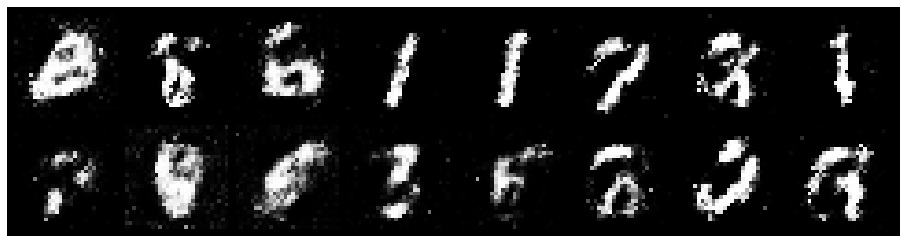

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 1.0398, Generator Loss: 1.5315
D(x): 0.7126, D(G(z)): 0.3614


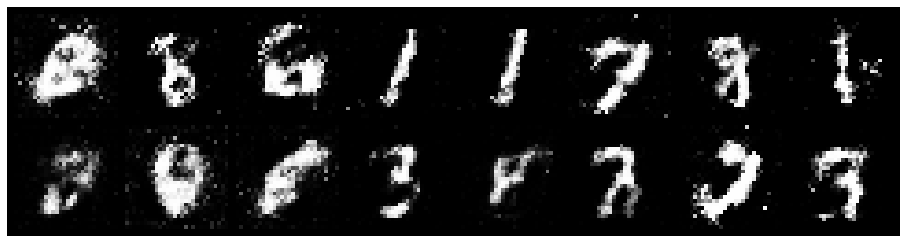

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.9566, Generator Loss: 1.6513
D(x): 0.7423, D(G(z)): 0.3295


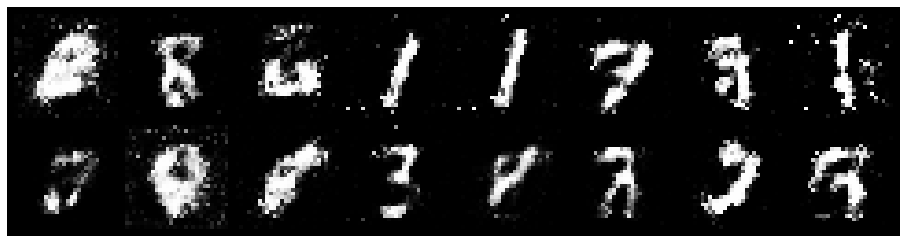

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.7524, Generator Loss: 1.7326
D(x): 0.7245, D(G(z)): 0.2394


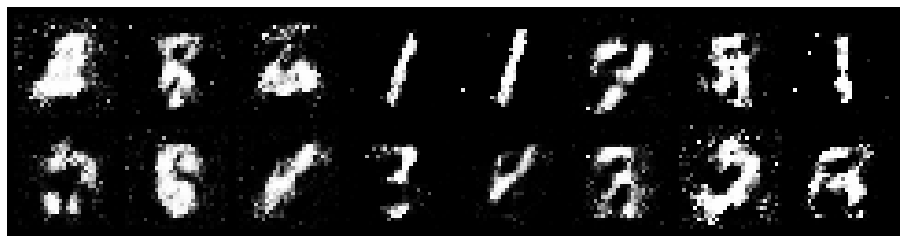

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.7086, Generator Loss: 1.6589
D(x): 0.7669, D(G(z)): 0.2491


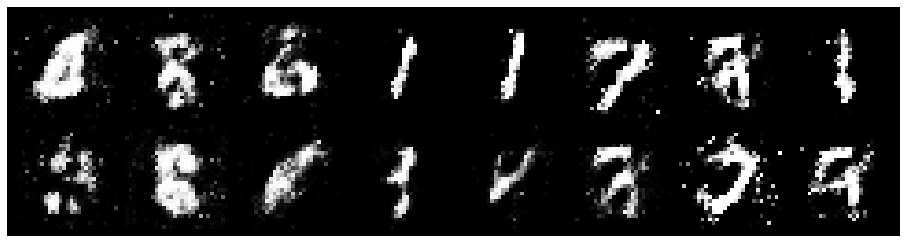

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.7563, Generator Loss: 2.0040
D(x): 0.7206, D(G(z)): 0.2288


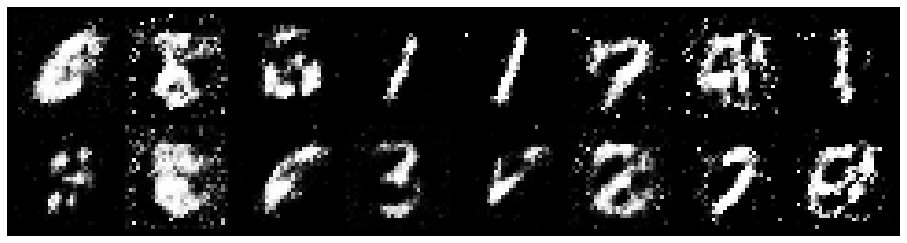

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.6714, Generator Loss: 2.1273
D(x): 0.7751, D(G(z)): 0.2347


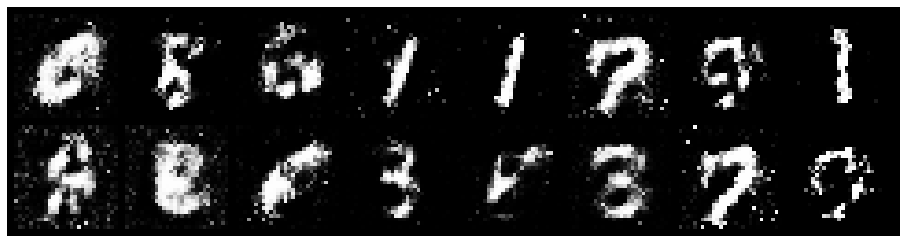

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9780, Generator Loss: 1.4764
D(x): 0.7108, D(G(z)): 0.3665


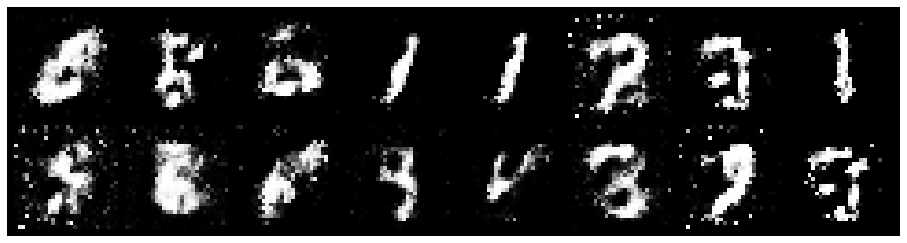

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.9464, Generator Loss: 1.8112
D(x): 0.7082, D(G(z)): 0.2959


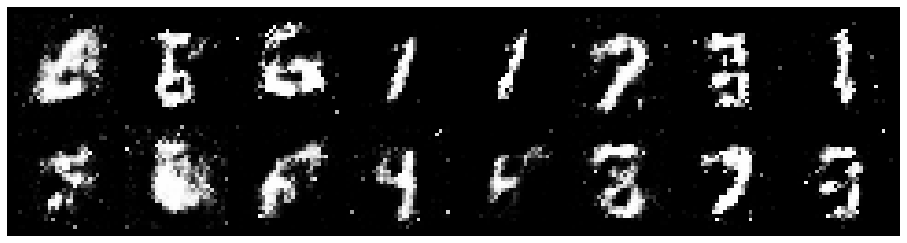

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.7955, Generator Loss: 1.6048
D(x): 0.8129, D(G(z)): 0.3500


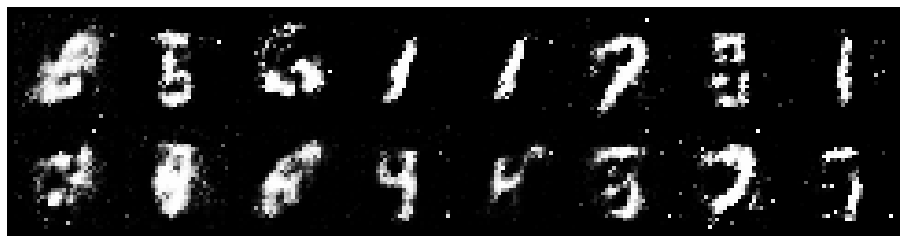

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 1.3608, Generator Loss: 1.3798
D(x): 0.6617, D(G(z)): 0.4665


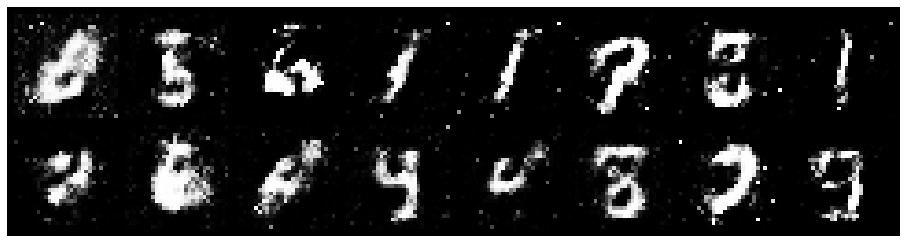

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.9691, Generator Loss: 1.8248
D(x): 0.7732, D(G(z)): 0.3584


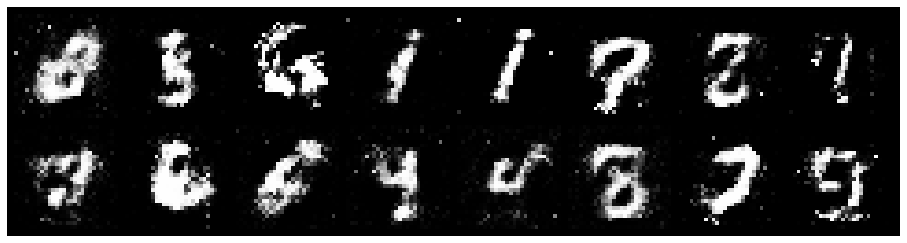

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9851, Generator Loss: 1.5363
D(x): 0.6852, D(G(z)): 0.3398


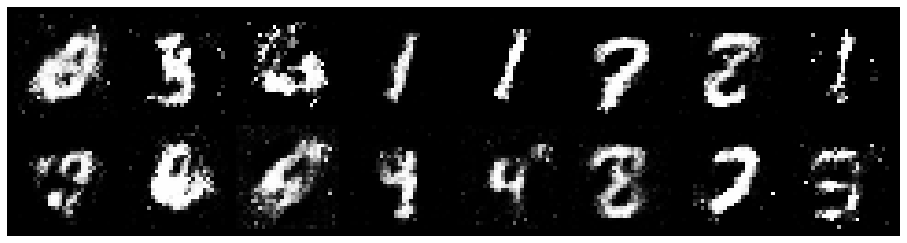

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.9221, Generator Loss: 1.4214
D(x): 0.6556, D(G(z)): 0.2844


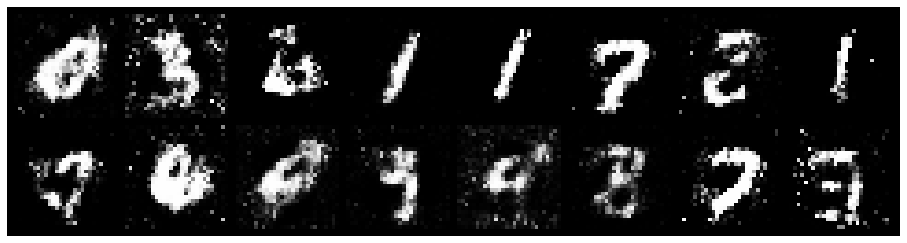

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.9903, Generator Loss: 1.3212
D(x): 0.6120, D(G(z)): 0.3042


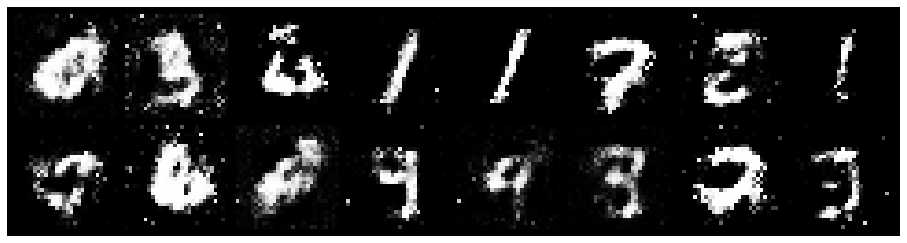

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 1.0062, Generator Loss: 1.4406
D(x): 0.6330, D(G(z)): 0.3224


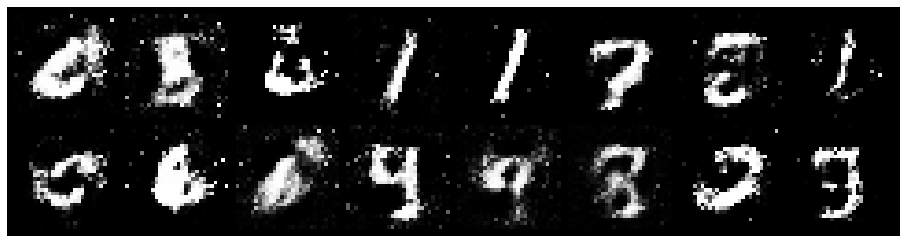

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 1.0662, Generator Loss: 1.4131
D(x): 0.6466, D(G(z)): 0.3495


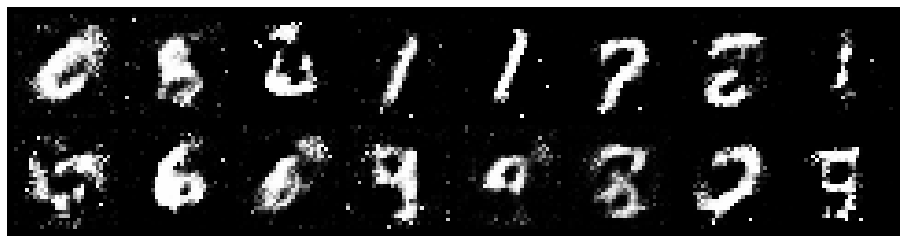

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.8779, Generator Loss: 1.7052
D(x): 0.7279, D(G(z)): 0.3048


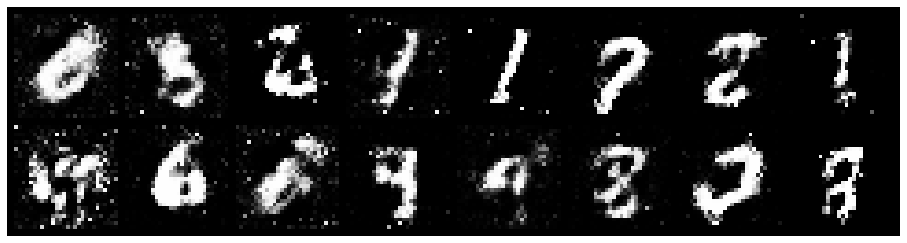

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.9107, Generator Loss: 1.5131
D(x): 0.6830, D(G(z)): 0.2938


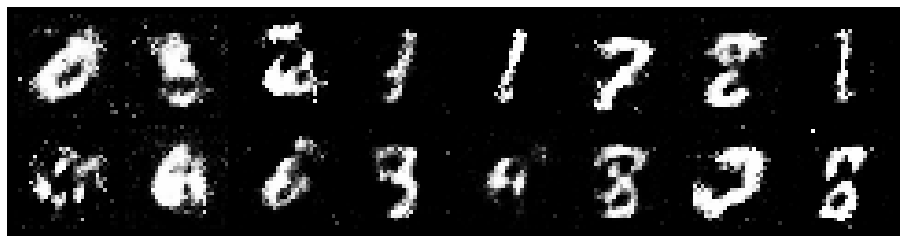

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.8297, Generator Loss: 1.8744
D(x): 0.7018, D(G(z)): 0.2522


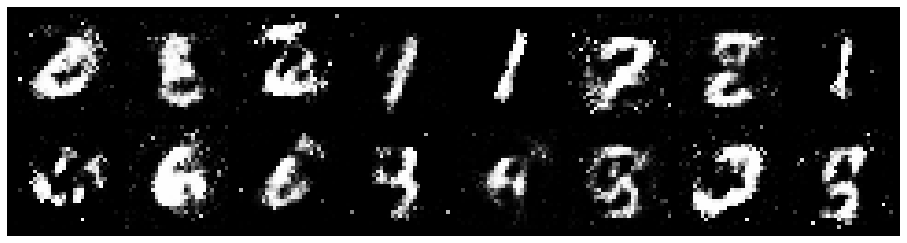

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.7320, Generator Loss: 1.8027
D(x): 0.7733, D(G(z)): 0.2794


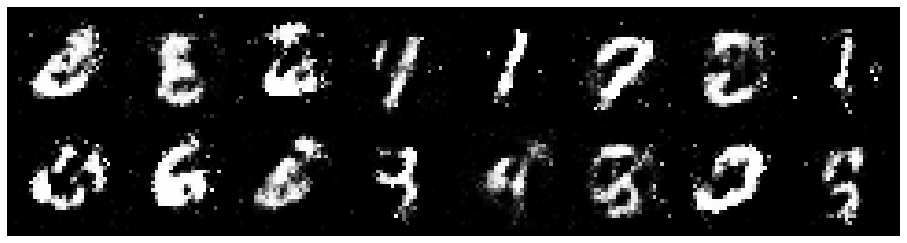

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.9323, Generator Loss: 1.6936
D(x): 0.7244, D(G(z)): 0.3022


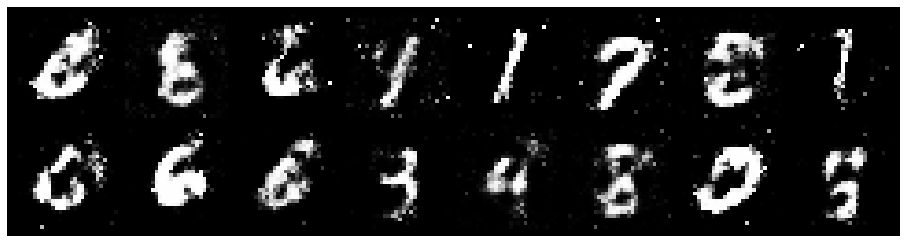

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.8195, Generator Loss: 1.5259
D(x): 0.7472, D(G(z)): 0.3034


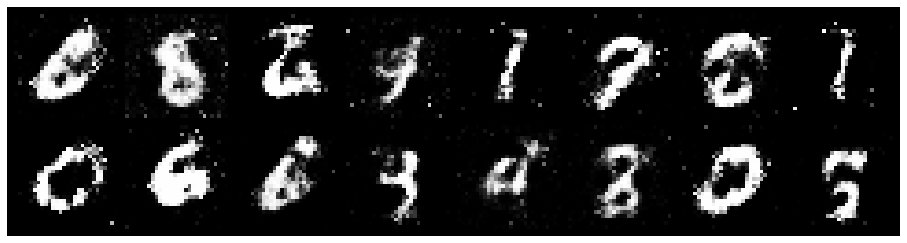

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9924, Generator Loss: 1.6473
D(x): 0.7161, D(G(z)): 0.3227


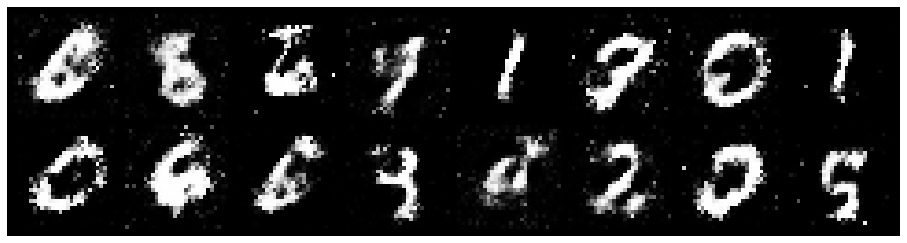

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.8686, Generator Loss: 1.4312
D(x): 0.7209, D(G(z)): 0.2965


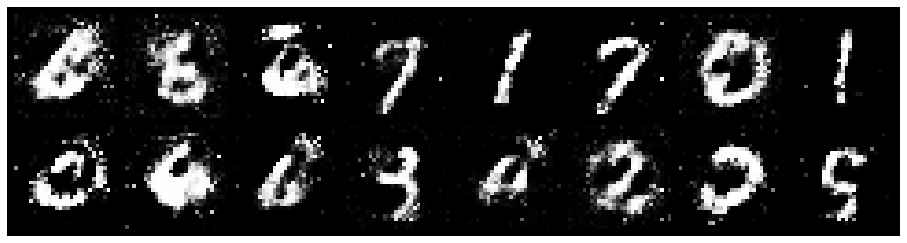

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.1215, Generator Loss: 1.3466
D(x): 0.7590, D(G(z)): 0.4266


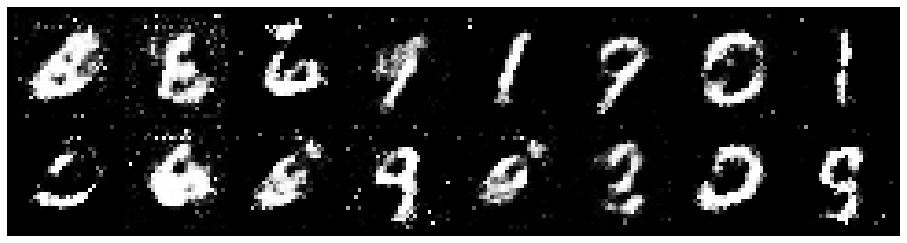

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0377, Generator Loss: 1.4918
D(x): 0.6258, D(G(z)): 0.2871


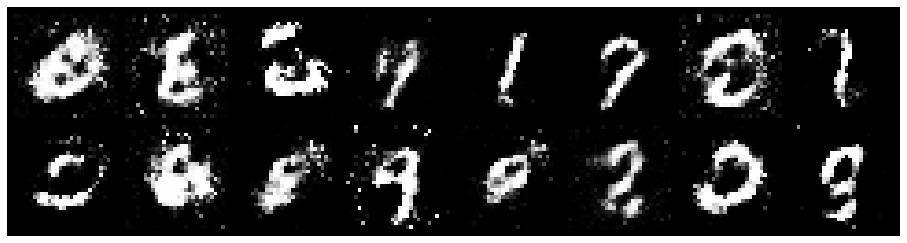

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.1689, Generator Loss: 1.2598
D(x): 0.6903, D(G(z)): 0.3877


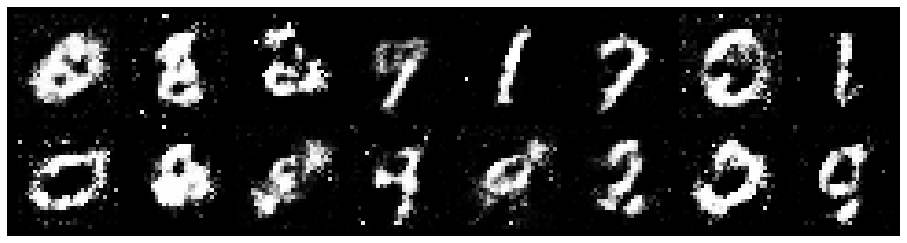

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.1438, Generator Loss: 1.5081
D(x): 0.6678, D(G(z)): 0.3672


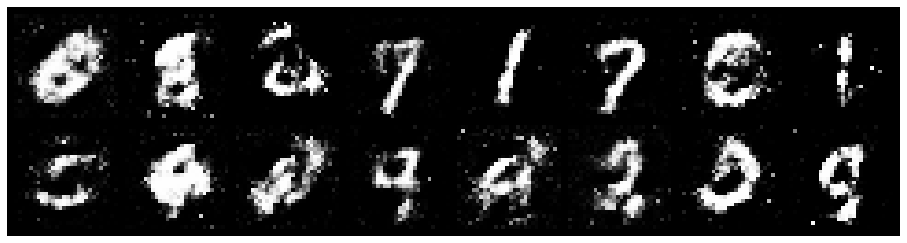

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 1.0704, Generator Loss: 1.0324
D(x): 0.6743, D(G(z)): 0.3688


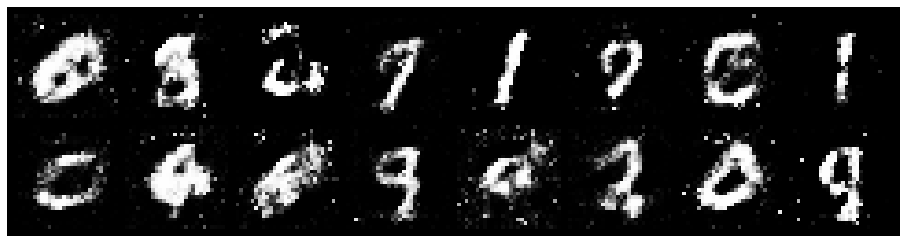

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 1.1371, Generator Loss: 1.0768
D(x): 0.6715, D(G(z)): 0.3647


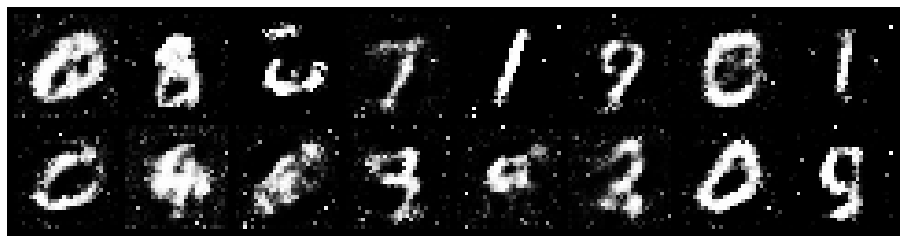

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.8890, Generator Loss: 1.7324
D(x): 0.7261, D(G(z)): 0.2940


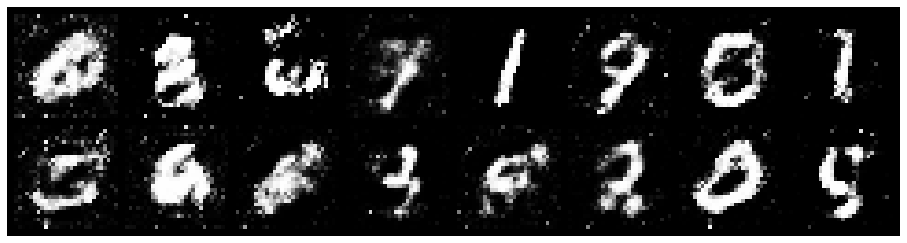

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0094, Generator Loss: 1.2872
D(x): 0.7561, D(G(z)): 0.4064


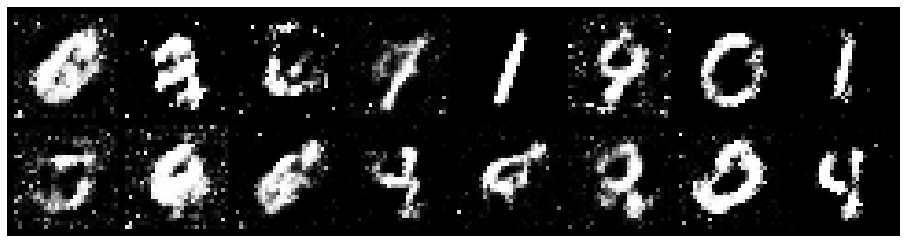

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9754, Generator Loss: 1.0296
D(x): 0.6966, D(G(z)): 0.3619


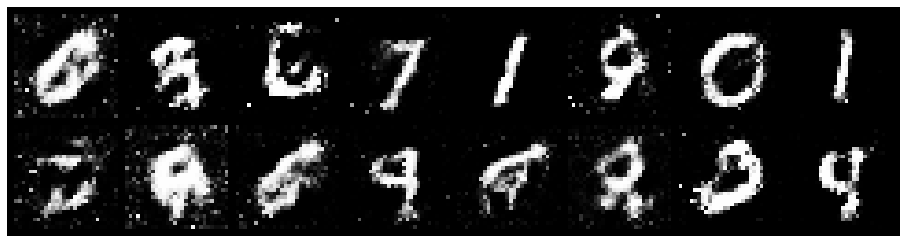

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.0657, Generator Loss: 1.3459
D(x): 0.6584, D(G(z)): 0.3127


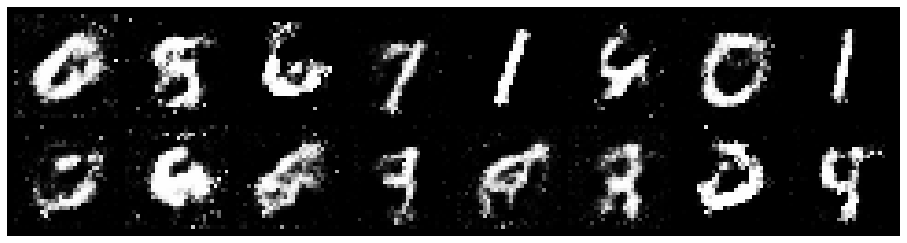

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.9225, Generator Loss: 1.5352
D(x): 0.7504, D(G(z)): 0.3691


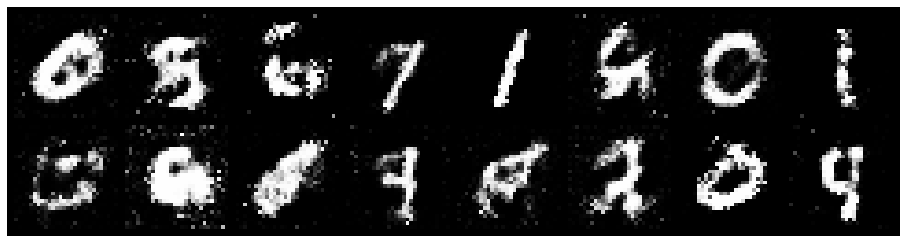

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 1.0821, Generator Loss: 1.6450
D(x): 0.7090, D(G(z)): 0.3554


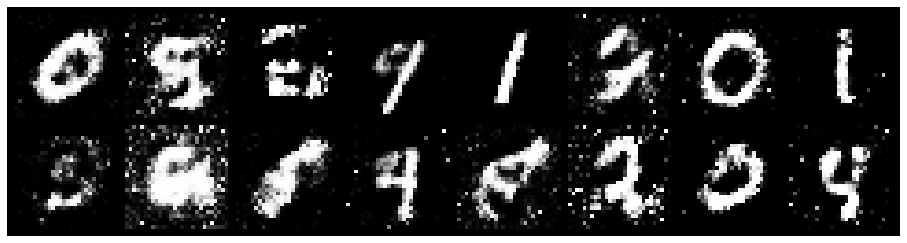

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 1.2361, Generator Loss: 1.0604
D(x): 0.6276, D(G(z)): 0.3967


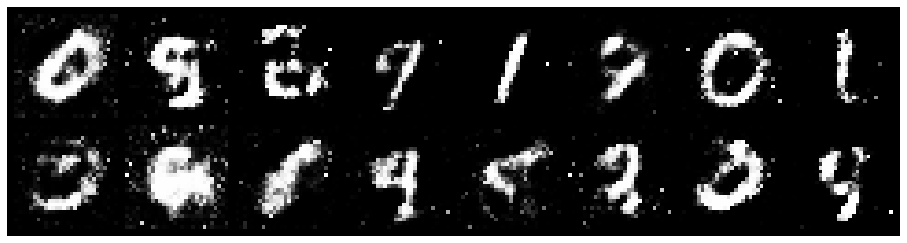

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.3019, Generator Loss: 1.3898
D(x): 0.5882, D(G(z)): 0.3616


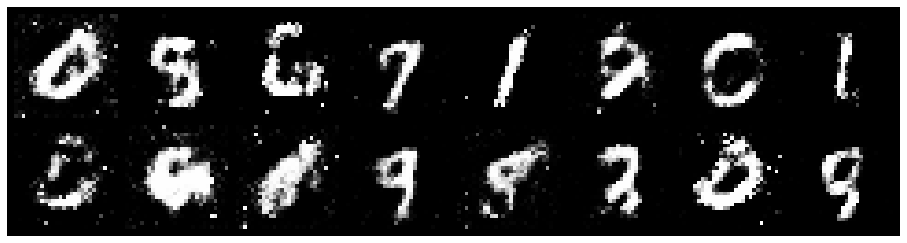

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.2438, Generator Loss: 1.1991
D(x): 0.5965, D(G(z)): 0.3926


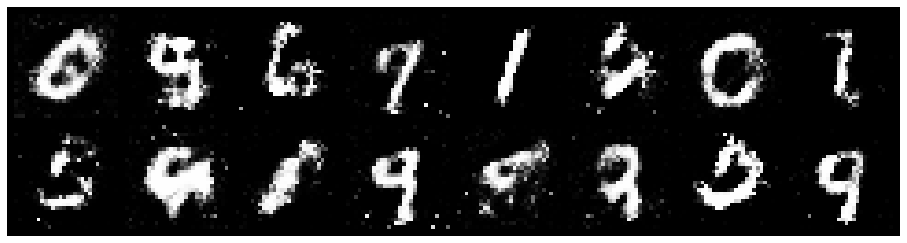

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0485, Generator Loss: 1.1382
D(x): 0.7558, D(G(z)): 0.4228


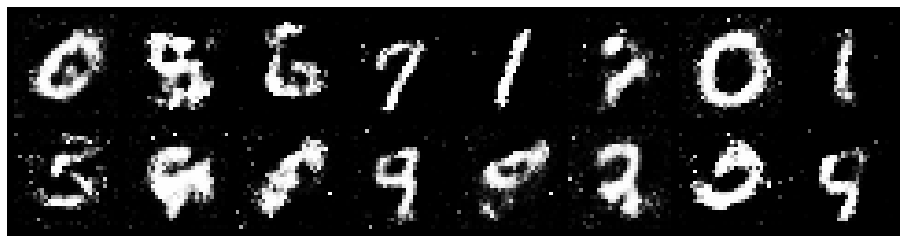

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.0054, Generator Loss: 1.6844
D(x): 0.6497, D(G(z)): 0.2931


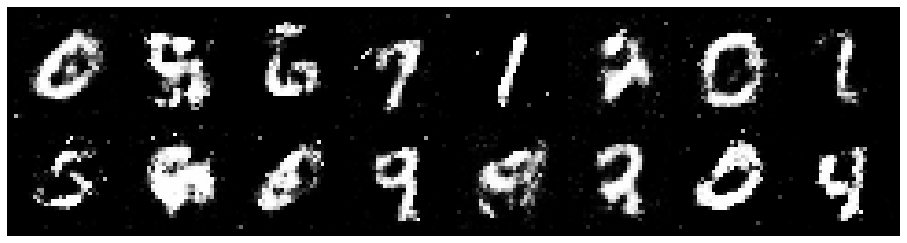

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9673, Generator Loss: 1.2500
D(x): 0.7453, D(G(z)): 0.3941


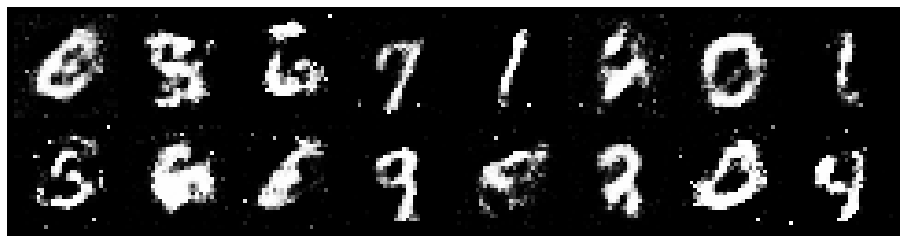

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.9216, Generator Loss: 1.1285
D(x): 0.6747, D(G(z)): 0.3134


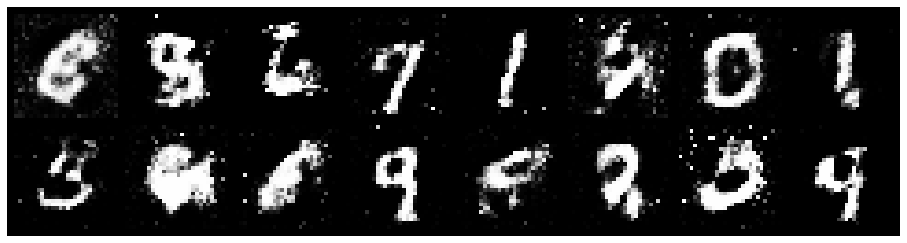

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.1479, Generator Loss: 1.1915
D(x): 0.6944, D(G(z)): 0.4253


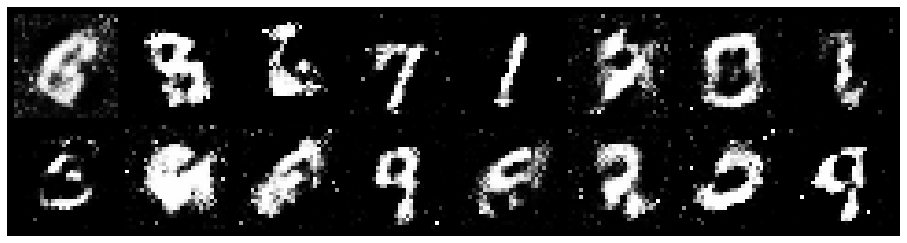

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.1036, Generator Loss: 1.1510
D(x): 0.6430, D(G(z)): 0.3601


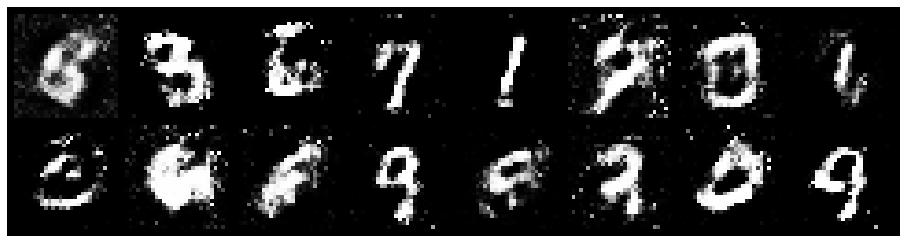

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.0201, Generator Loss: 1.3629
D(x): 0.5820, D(G(z)): 0.2523


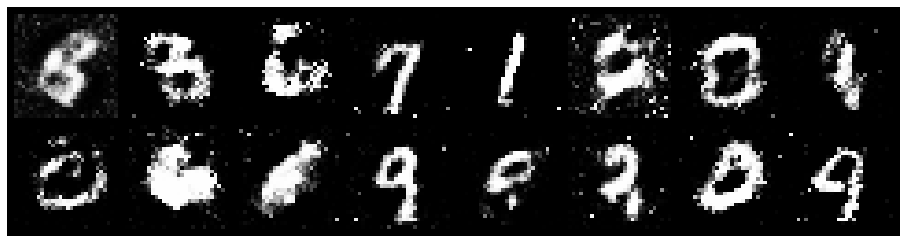

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0562, Generator Loss: 1.3612
D(x): 0.6636, D(G(z)): 0.3680


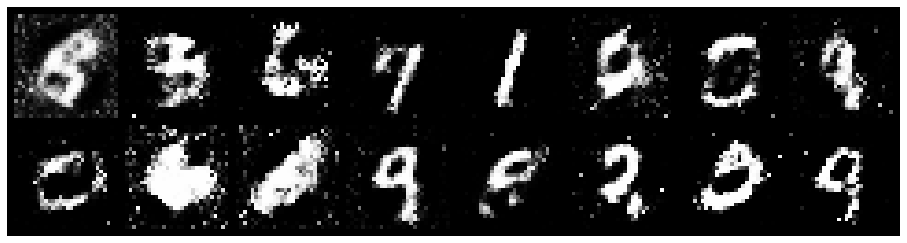

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.1358, Generator Loss: 1.4133
D(x): 0.5886, D(G(z)): 0.3350


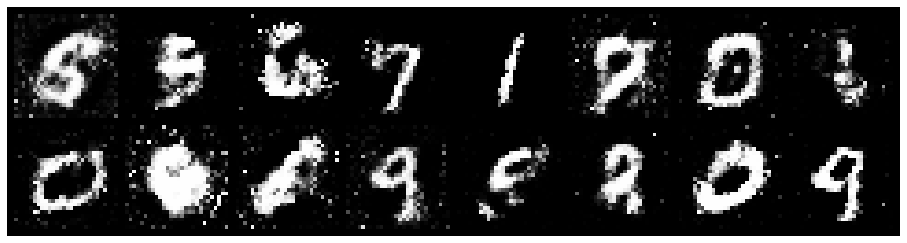

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.9092, Generator Loss: 1.2693
D(x): 0.7363, D(G(z)): 0.3758


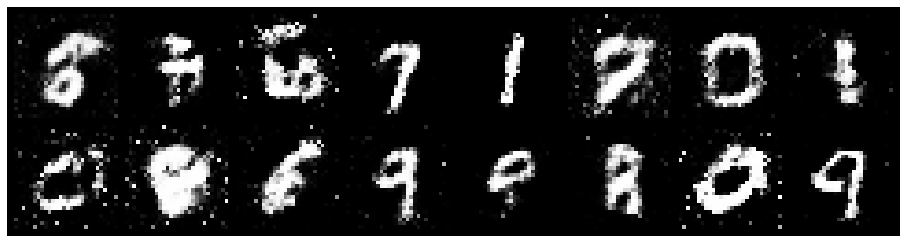

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.8043, Generator Loss: 1.6068
D(x): 0.7346, D(G(z)): 0.3057


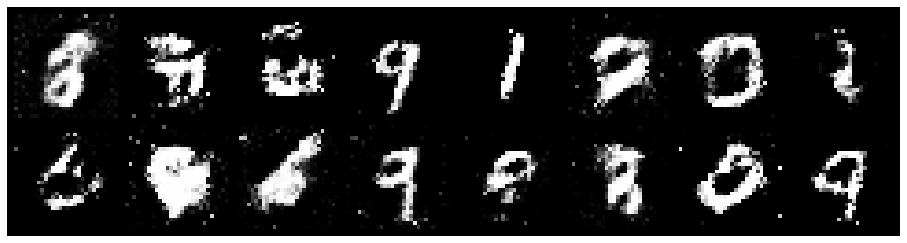

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.0165, Generator Loss: 1.3575
D(x): 0.7176, D(G(z)): 0.4159


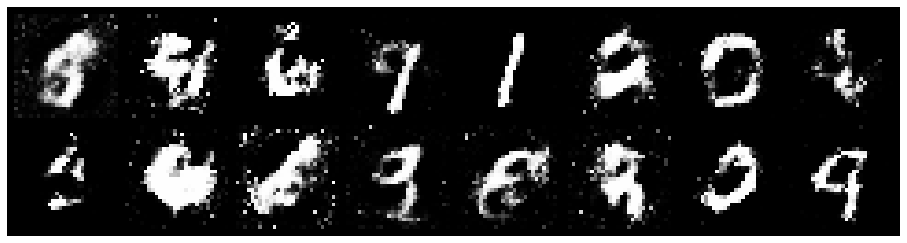

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.7794, Generator Loss: 1.6952
D(x): 0.7055, D(G(z)): 0.2609


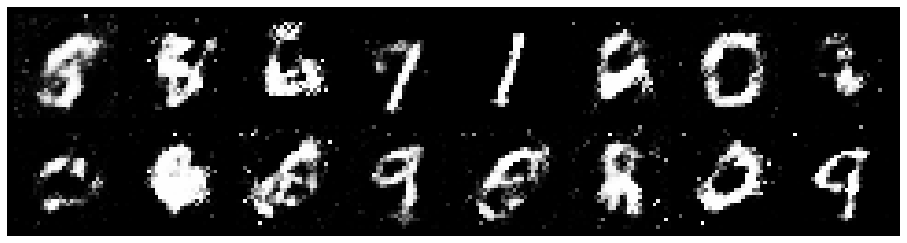

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.0651, Generator Loss: 1.4589
D(x): 0.5982, D(G(z)): 0.3256


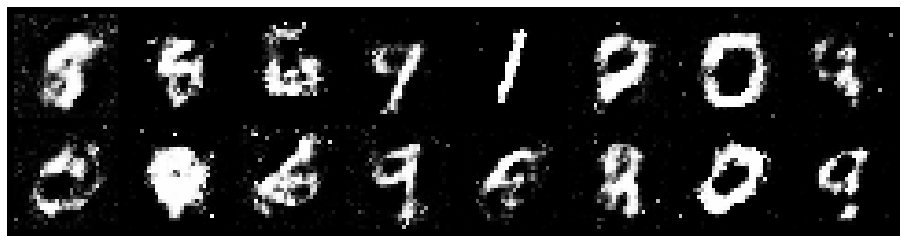

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.8668, Generator Loss: 1.5785
D(x): 0.6628, D(G(z)): 0.2684


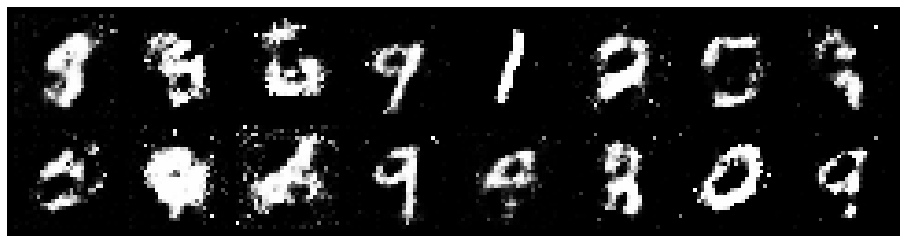

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.8625, Generator Loss: 1.8223
D(x): 0.6896, D(G(z)): 0.2939


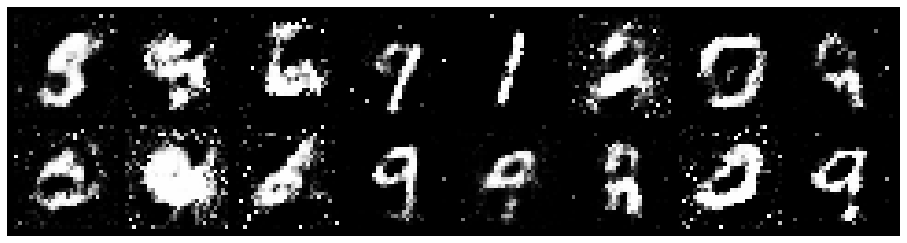

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.8224, Generator Loss: 1.5969
D(x): 0.7579, D(G(z)): 0.3435


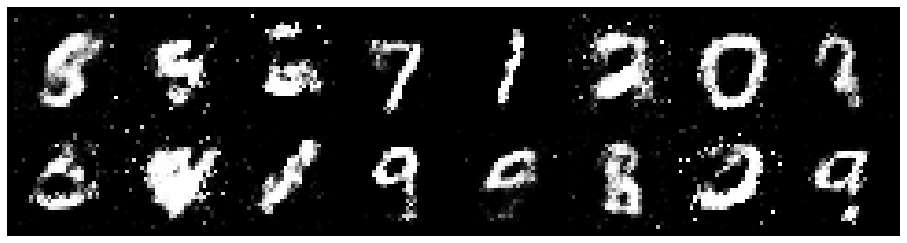

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.9218, Generator Loss: 1.1768
D(x): 0.6996, D(G(z)): 0.3062


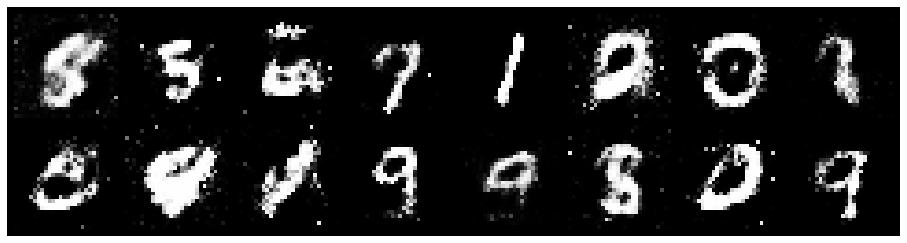

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9141, Generator Loss: 1.4122
D(x): 0.7009, D(G(z)): 0.2992


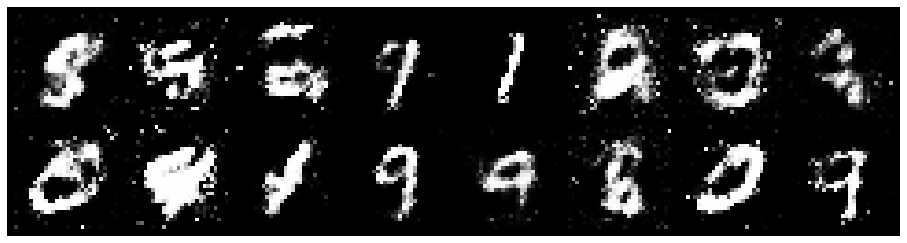

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.0679, Generator Loss: 1.5325
D(x): 0.6566, D(G(z)): 0.3753


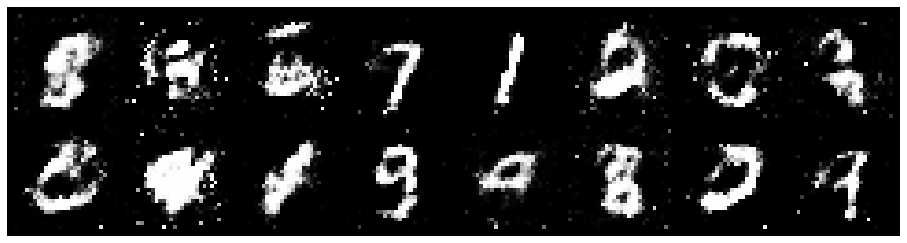

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 0.8670, Generator Loss: 1.3756
D(x): 0.6662, D(G(z)): 0.2813


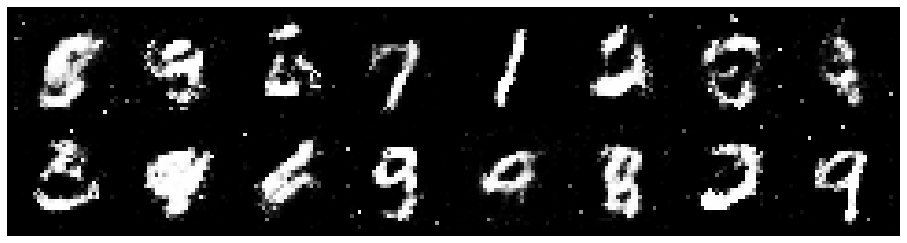

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9887, Generator Loss: 1.5072
D(x): 0.7009, D(G(z)): 0.3671


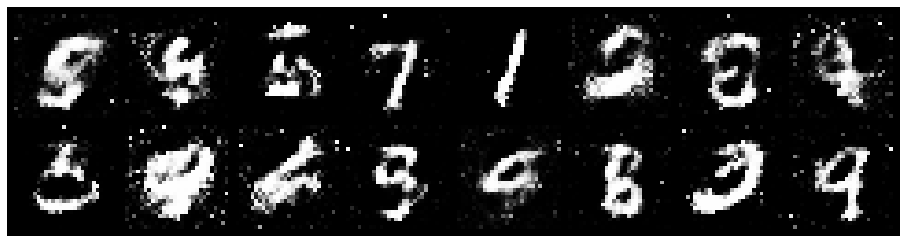

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.9551, Generator Loss: 1.3525
D(x): 0.6754, D(G(z)): 0.3222


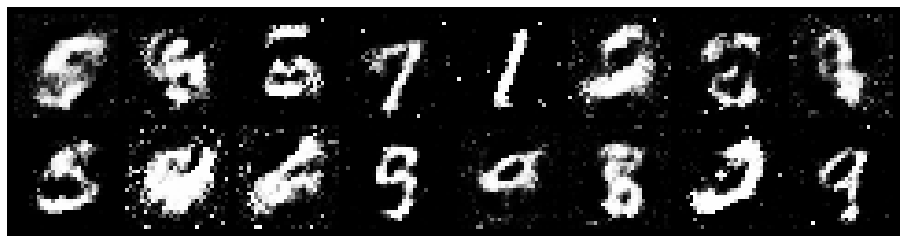

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.9175, Generator Loss: 1.6797
D(x): 0.7076, D(G(z)): 0.3541


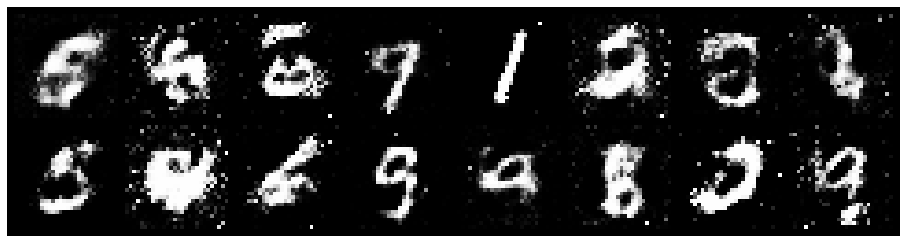

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.9021, Generator Loss: 1.2962
D(x): 0.7124, D(G(z)): 0.3384


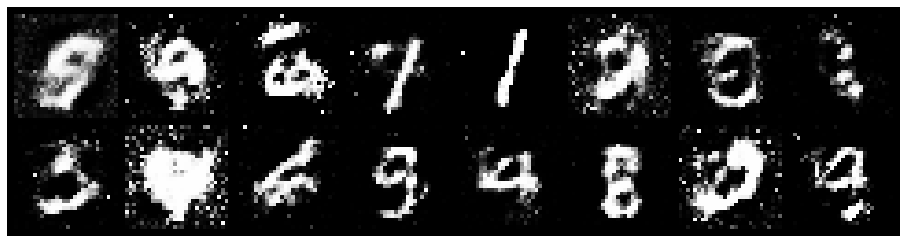

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.8255, Generator Loss: 1.4536
D(x): 0.7202, D(G(z)): 0.2907


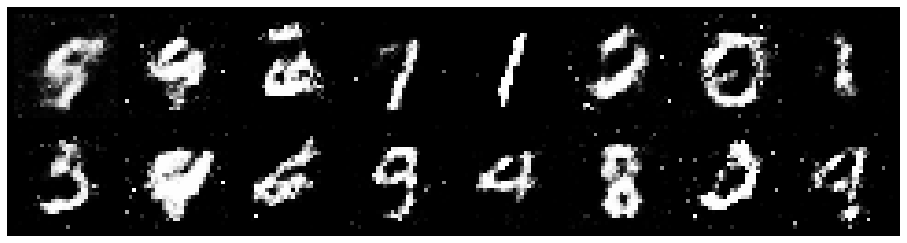

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.0571, Generator Loss: 1.4728
D(x): 0.6049, D(G(z)): 0.2949


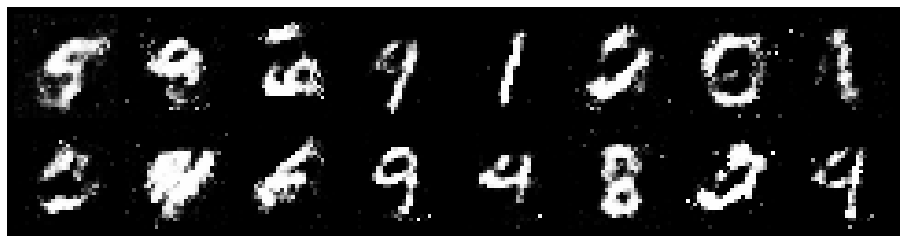

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0541, Generator Loss: 1.7903
D(x): 0.6326, D(G(z)): 0.2645


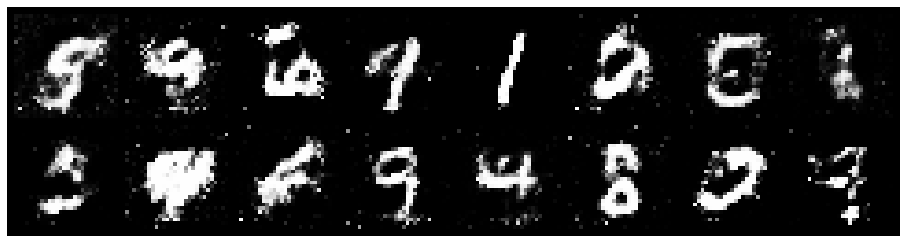

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.0329, Generator Loss: 1.3208
D(x): 0.6230, D(G(z)): 0.2852


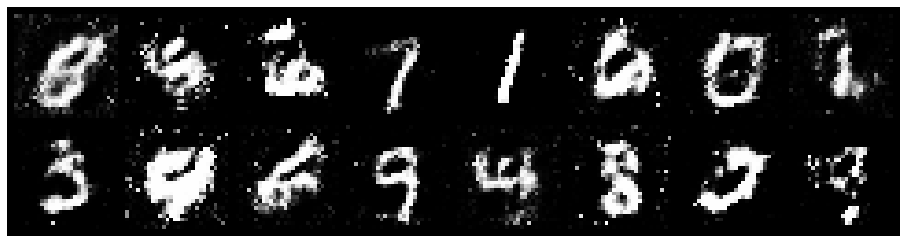

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.0808, Generator Loss: 1.2121
D(x): 0.6455, D(G(z)): 0.3646


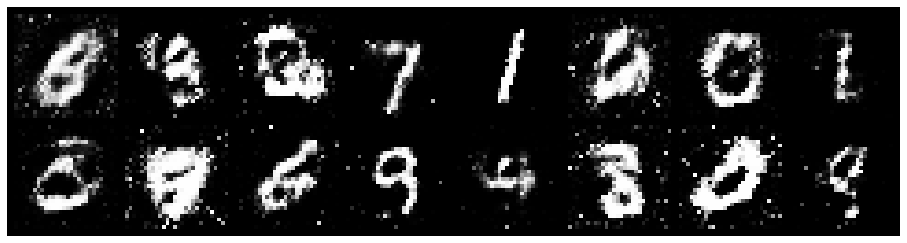

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.1059, Generator Loss: 1.5618
D(x): 0.6619, D(G(z)): 0.3866


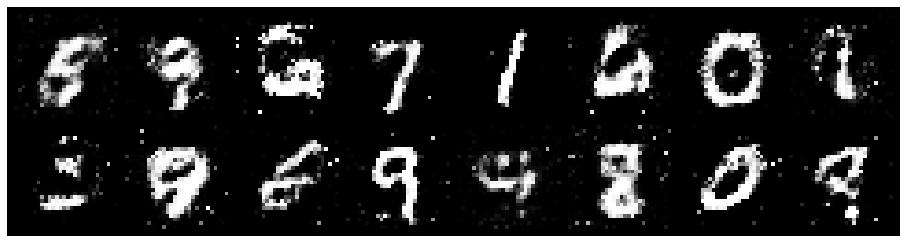

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.1865, Generator Loss: 1.7807
D(x): 0.5593, D(G(z)): 0.2571


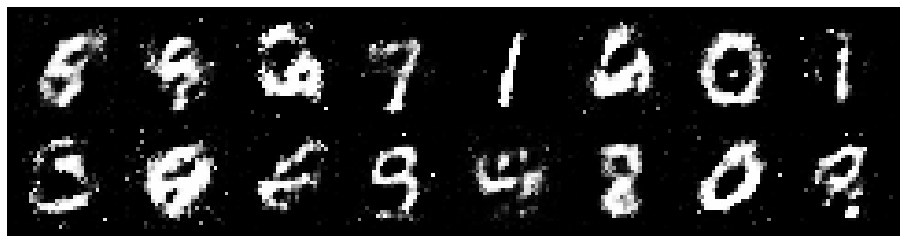

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.1605, Generator Loss: 1.3843
D(x): 0.6245, D(G(z)): 0.3183


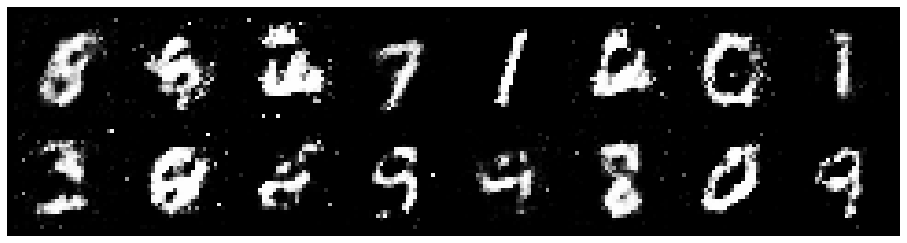

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0662, Generator Loss: 1.0743
D(x): 0.7048, D(G(z)): 0.4039


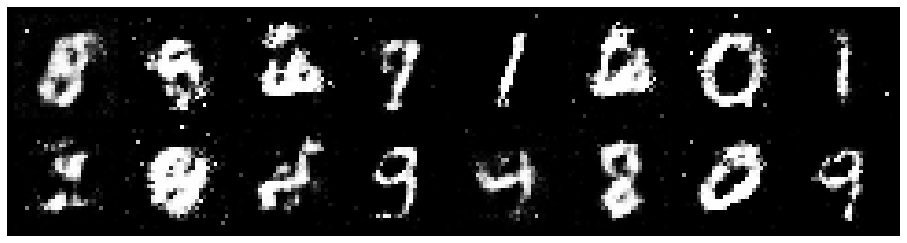

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.0743, Generator Loss: 1.1164
D(x): 0.6795, D(G(z)): 0.3902


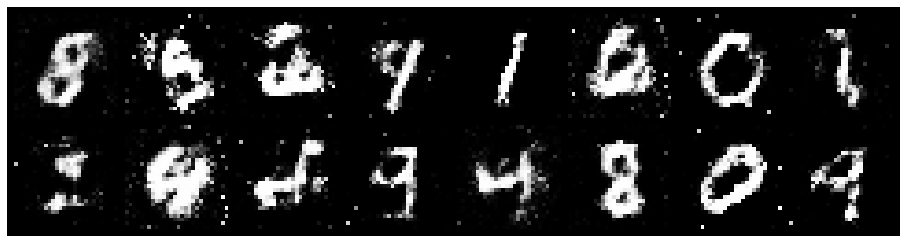

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.3692, Generator Loss: 0.9394
D(x): 0.5846, D(G(z)): 0.4498


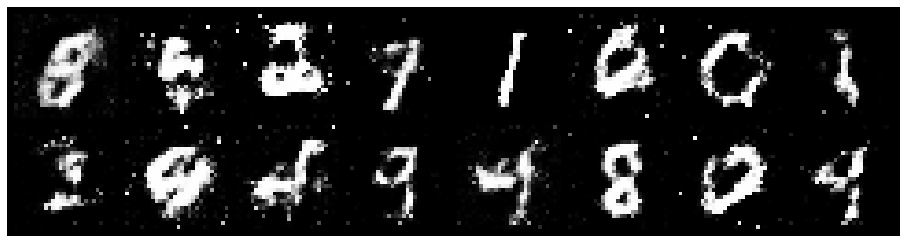

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.0479, Generator Loss: 0.9979
D(x): 0.6254, D(G(z)): 0.3552


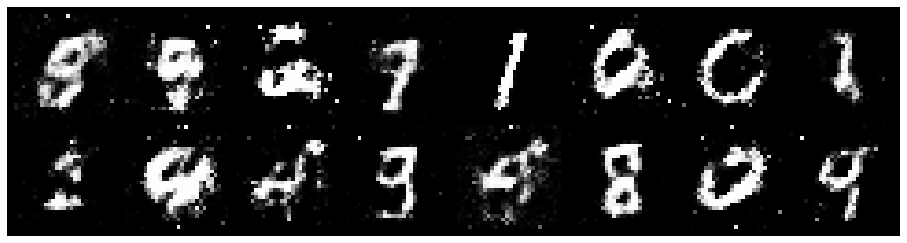

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.1314, Generator Loss: 0.9831
D(x): 0.6071, D(G(z)): 0.4069


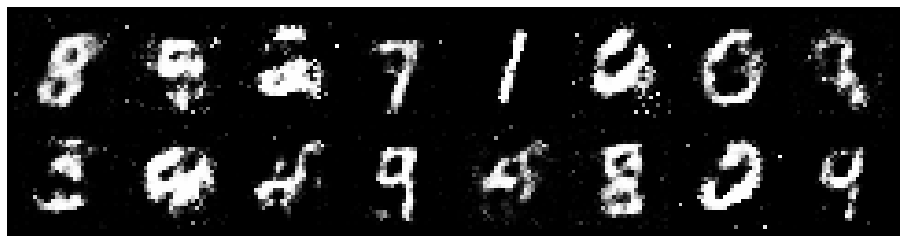

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.1789, Generator Loss: 0.9263
D(x): 0.6302, D(G(z)): 0.4428


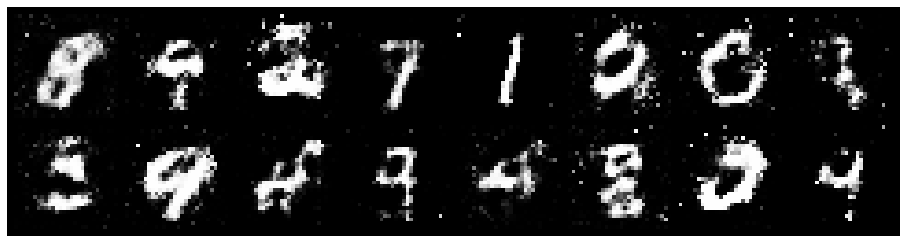

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0176, Generator Loss: 1.0791
D(x): 0.6333, D(G(z)): 0.3591


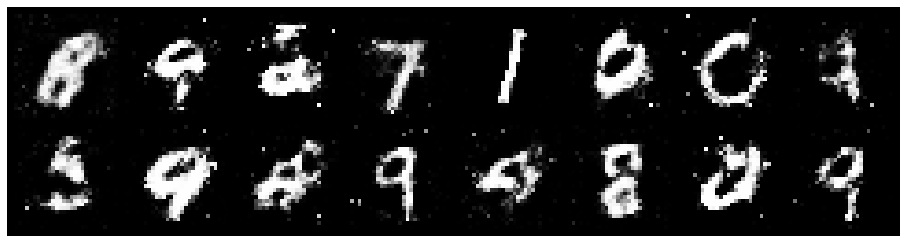

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.1302, Generator Loss: 1.1035
D(x): 0.6181, D(G(z)): 0.3863


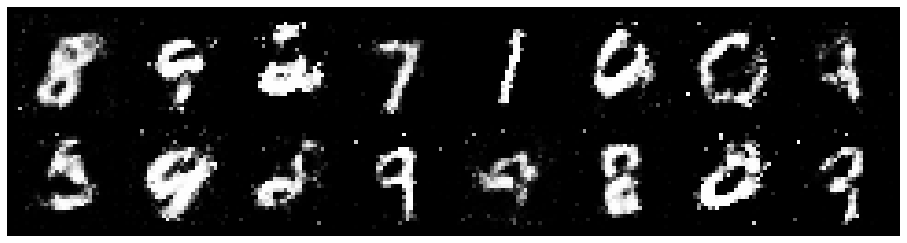

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0558, Generator Loss: 1.3270
D(x): 0.6268, D(G(z)): 0.3722


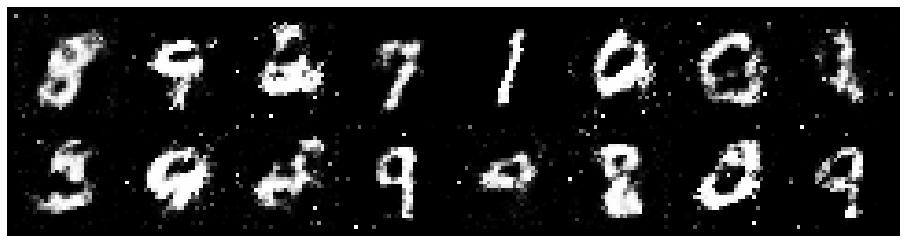

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0033, Generator Loss: 1.3215
D(x): 0.6669, D(G(z)): 0.3205


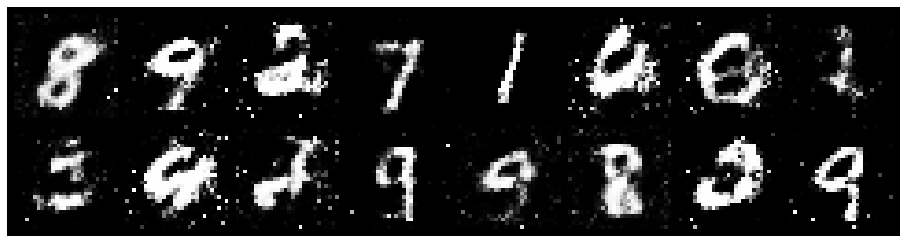

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 0.9807, Generator Loss: 1.1802
D(x): 0.6642, D(G(z)): 0.3379


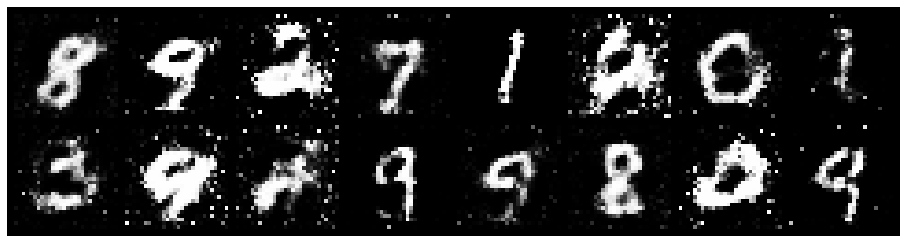

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.2052, Generator Loss: 1.0381
D(x): 0.6241, D(G(z)): 0.4188


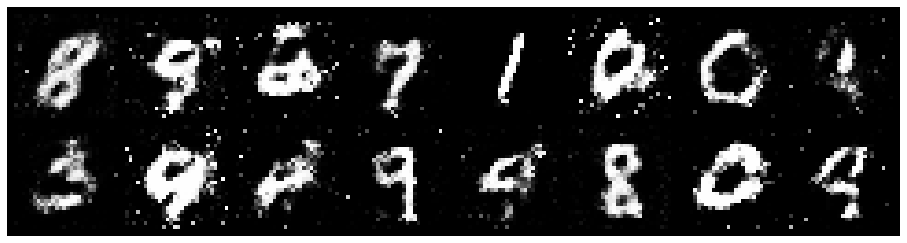

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.1175, Generator Loss: 0.9350
D(x): 0.6080, D(G(z)): 0.3971


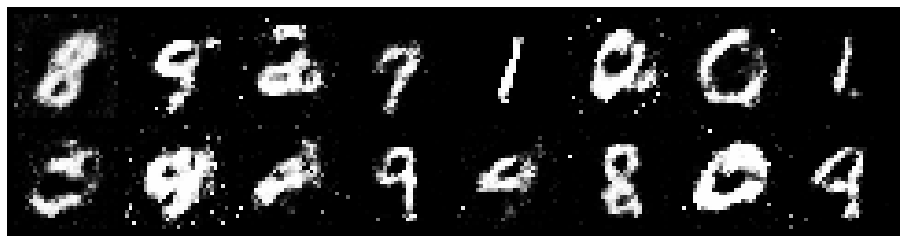

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0881, Generator Loss: 1.1199
D(x): 0.6197, D(G(z)): 0.3797


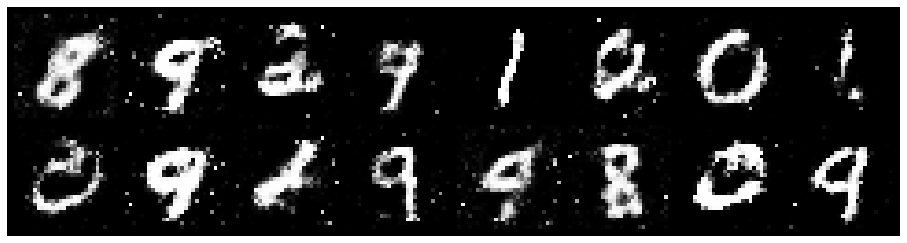

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.0955, Generator Loss: 1.3009
D(x): 0.6060, D(G(z)): 0.3417


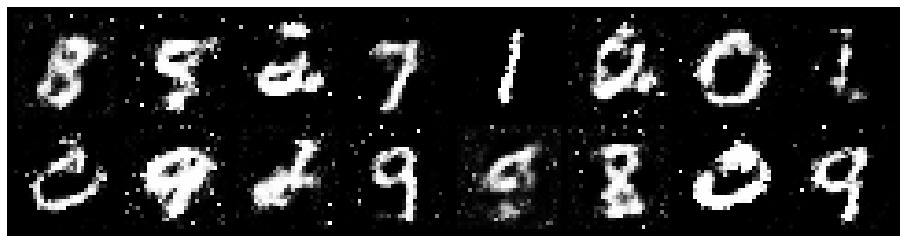

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0437, Generator Loss: 1.2627
D(x): 0.6108, D(G(z)): 0.3413


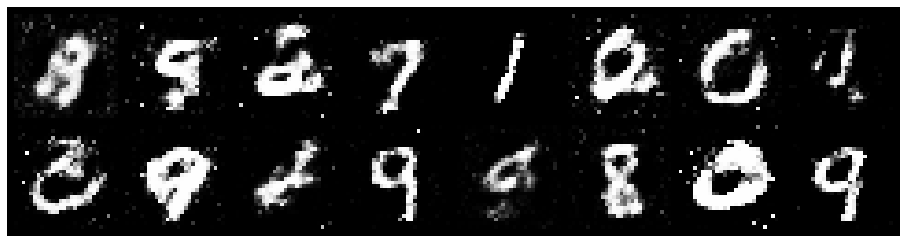

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.9591, Generator Loss: 1.5007
D(x): 0.6624, D(G(z)): 0.3263


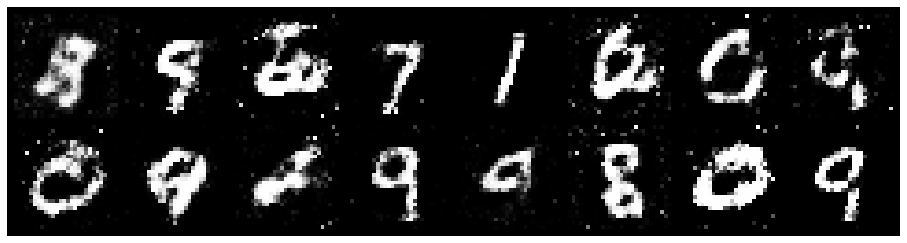

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 0.8885, Generator Loss: 1.5772
D(x): 0.6965, D(G(z)): 0.3065


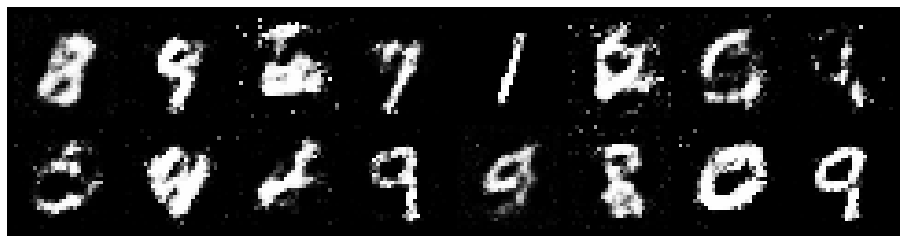

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9054, Generator Loss: 1.2856
D(x): 0.6457, D(G(z)): 0.3020


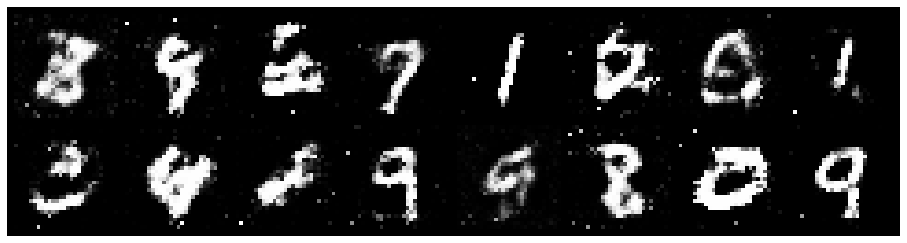

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 0.9654, Generator Loss: 1.2594
D(x): 0.6615, D(G(z)): 0.3586


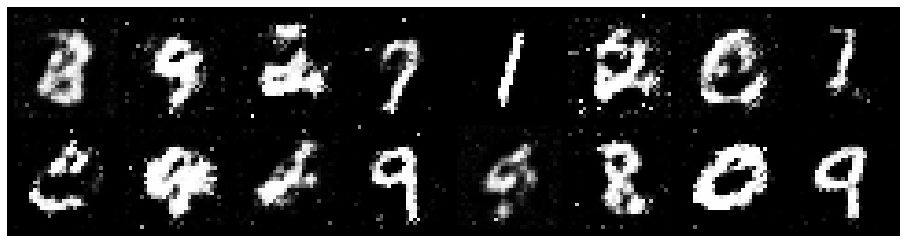

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.1001, Generator Loss: 1.1752
D(x): 0.6290, D(G(z)): 0.3610


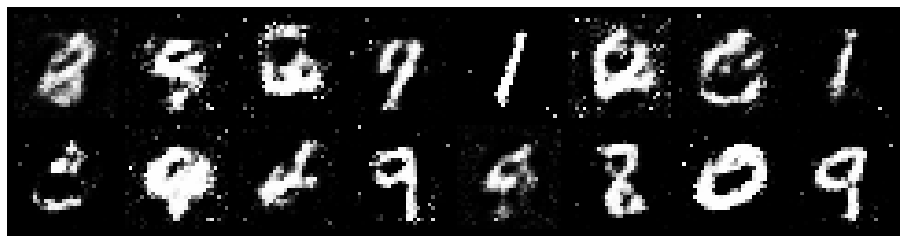

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.1138, Generator Loss: 1.0342
D(x): 0.6476, D(G(z)): 0.4063


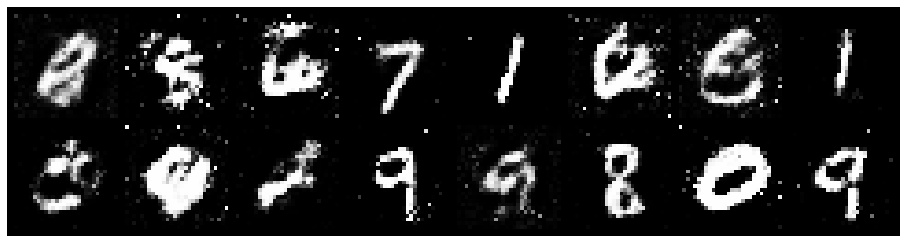

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0246, Generator Loss: 1.5968
D(x): 0.6652, D(G(z)): 0.3587


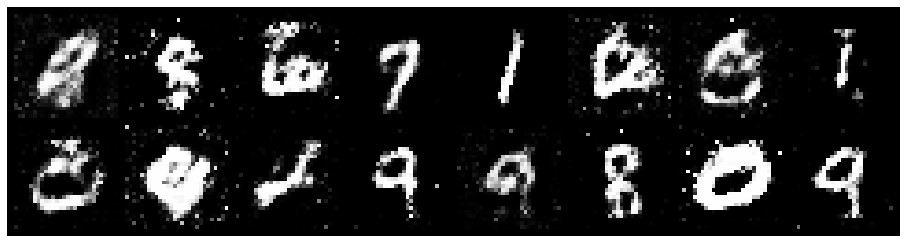

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.3187, Generator Loss: 1.2391
D(x): 0.5887, D(G(z)): 0.4284


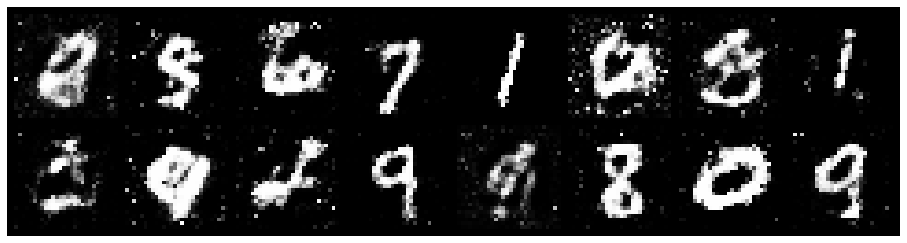

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.3098, Generator Loss: 1.1812
D(x): 0.6666, D(G(z)): 0.4676


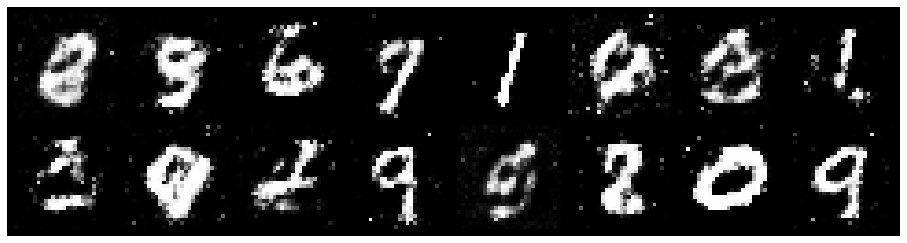

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9363
D(x): 0.6143, D(G(z)): 0.4216


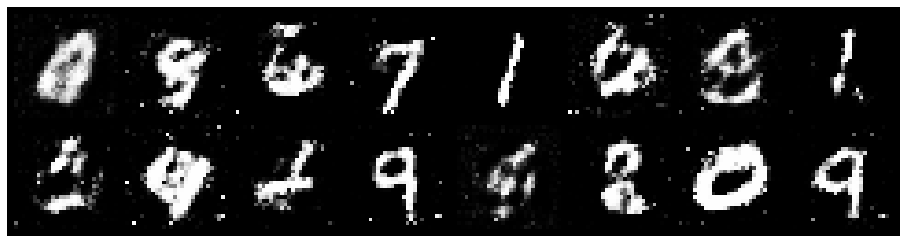

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 0.9715, Generator Loss: 1.2210
D(x): 0.6775, D(G(z)): 0.3361


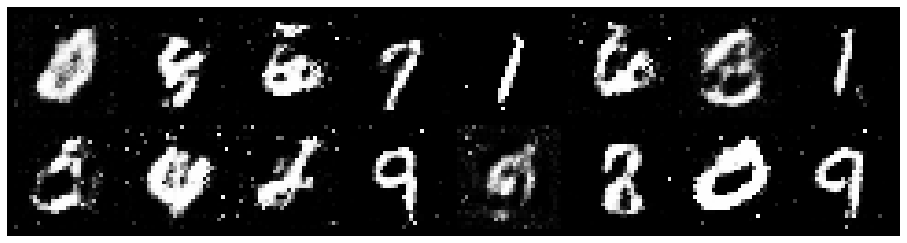

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 0.9930, Generator Loss: 1.3109
D(x): 0.7317, D(G(z)): 0.4132


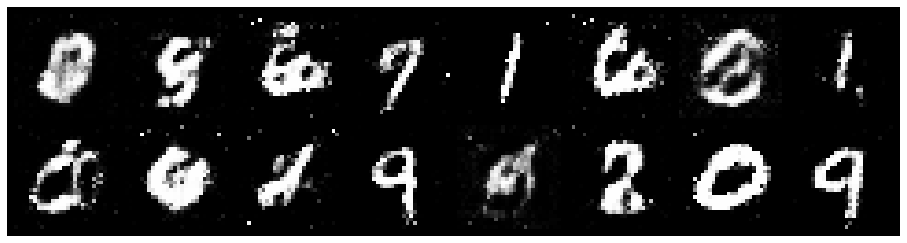

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.2713, Generator Loss: 0.9778
D(x): 0.6139, D(G(z)): 0.4371


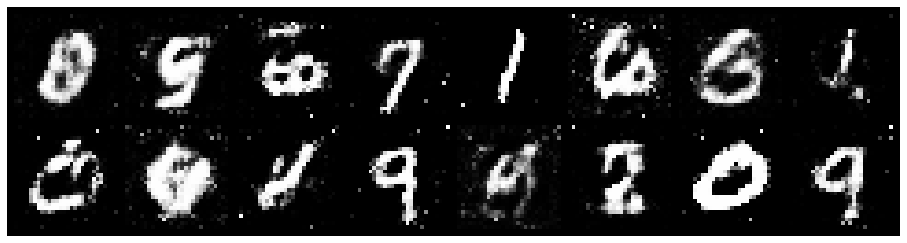

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1950, Generator Loss: 1.1500
D(x): 0.6143, D(G(z)): 0.3885


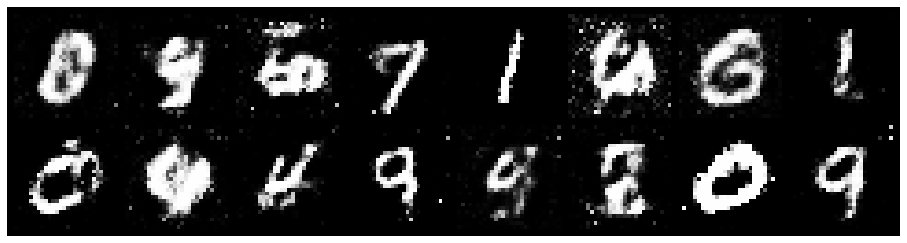

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.0620, Generator Loss: 1.0259
D(x): 0.6347, D(G(z)): 0.3810


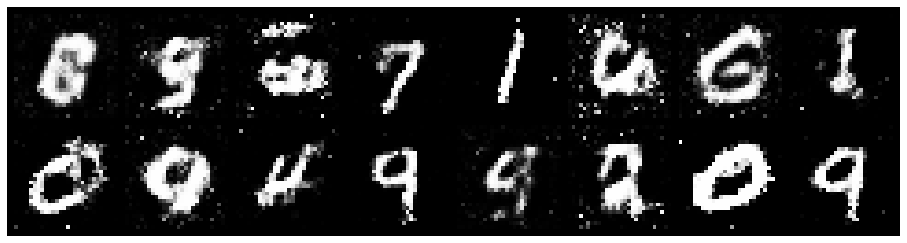

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.1844, Generator Loss: 1.1610
D(x): 0.6446, D(G(z)): 0.3961


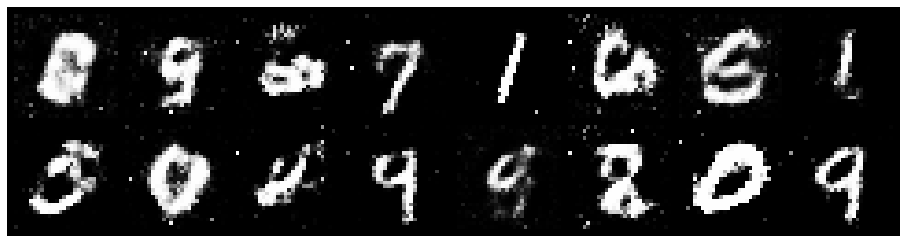

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.3307, Generator Loss: 1.0982
D(x): 0.5933, D(G(z)): 0.4071


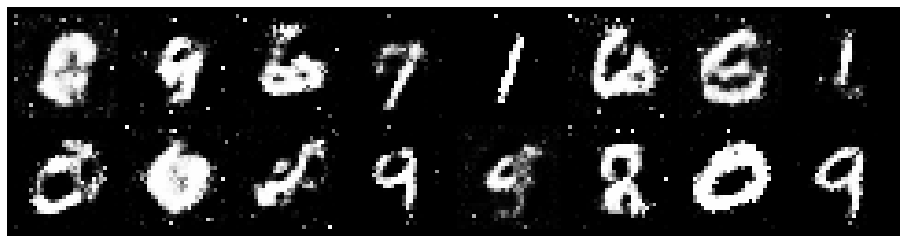

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1964, Generator Loss: 1.1163
D(x): 0.6546, D(G(z)): 0.4302


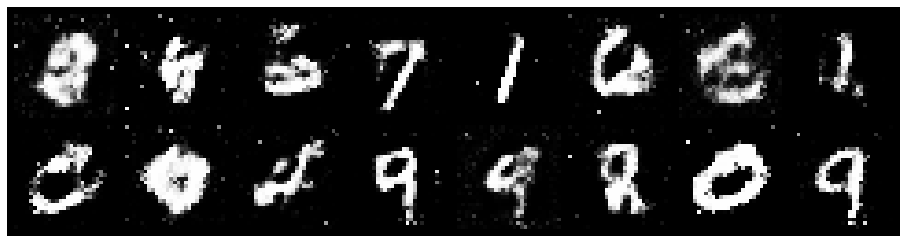

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1570, Generator Loss: 1.2923
D(x): 0.6243, D(G(z)): 0.4144


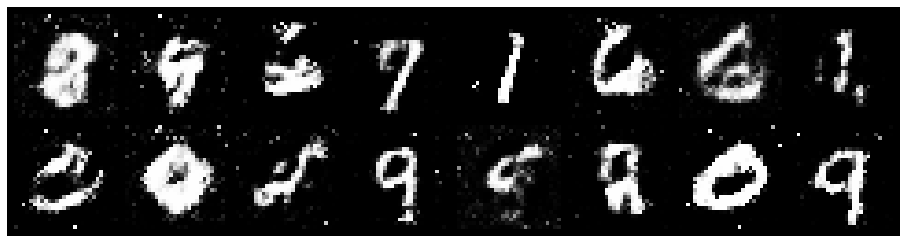

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1236, Generator Loss: 1.3086
D(x): 0.6165, D(G(z)): 0.3709


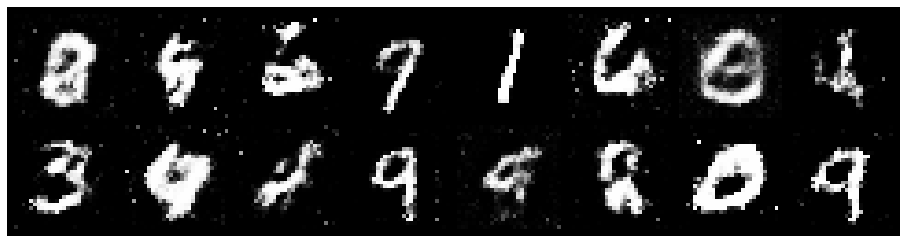

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.1486, Generator Loss: 0.8936
D(x): 0.6726, D(G(z)): 0.4452


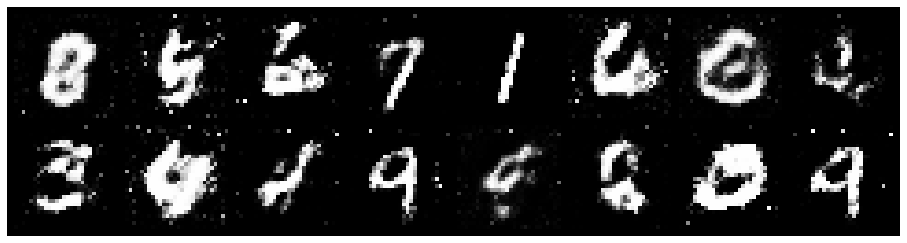

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.2867, Generator Loss: 1.0229
D(x): 0.5850, D(G(z)): 0.4291


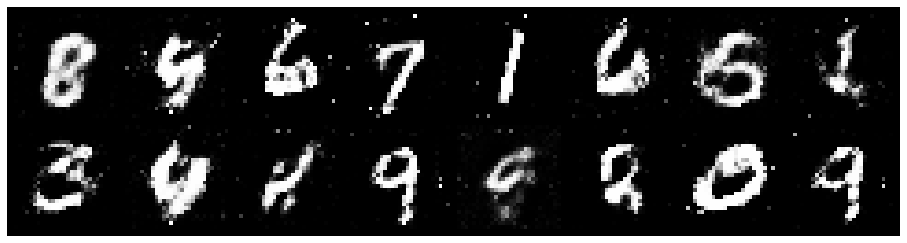

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1374, Generator Loss: 1.2495
D(x): 0.6024, D(G(z)): 0.3770


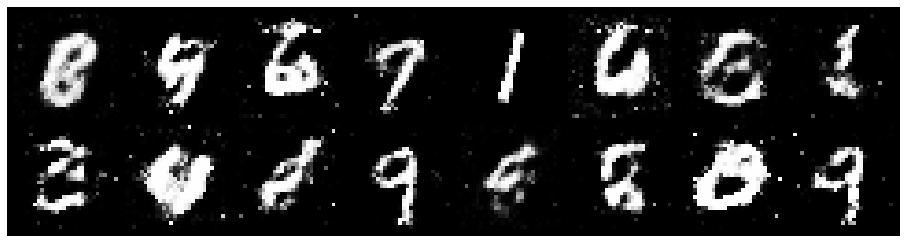

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0810, Generator Loss: 1.4159
D(x): 0.6201, D(G(z)): 0.3499


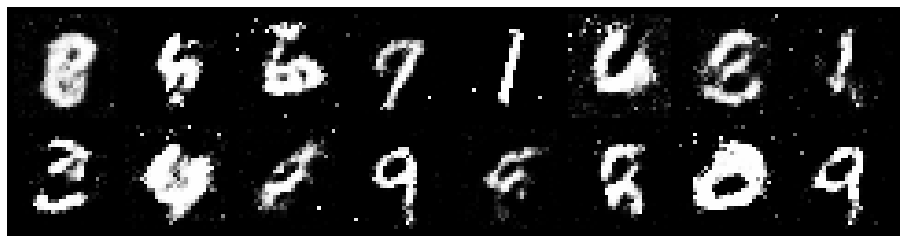

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.4032, Generator Loss: 0.9190
D(x): 0.5684, D(G(z)): 0.4402


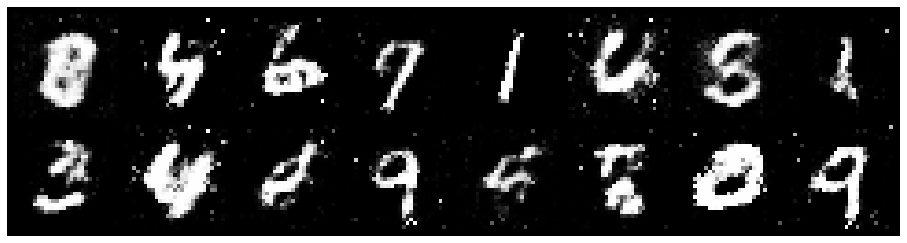

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.0678, Generator Loss: 1.2481
D(x): 0.6497, D(G(z)): 0.3718


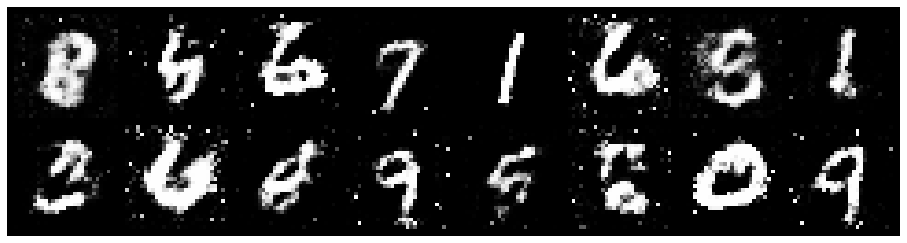

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.1601, Generator Loss: 1.1801
D(x): 0.6180, D(G(z)): 0.4010


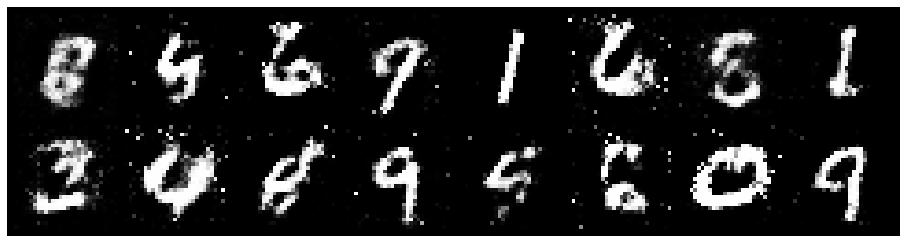

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.0732, Generator Loss: 1.1149
D(x): 0.6250, D(G(z)): 0.4006


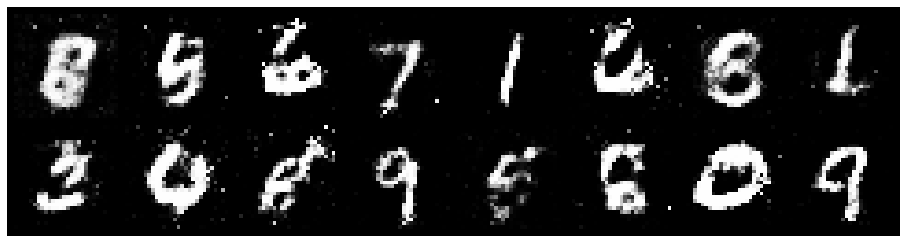

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.0041, Generator Loss: 1.2413
D(x): 0.6576, D(G(z)): 0.3595


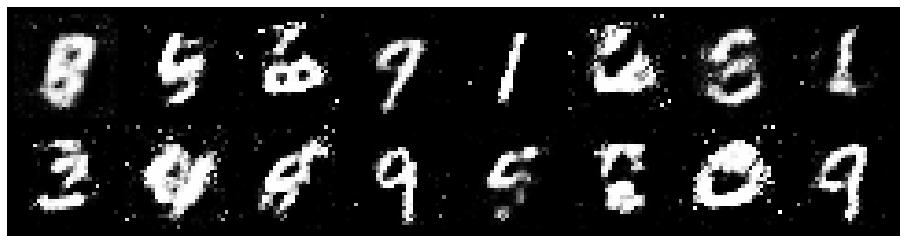

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1756, Generator Loss: 1.0634
D(x): 0.6143, D(G(z)): 0.4153


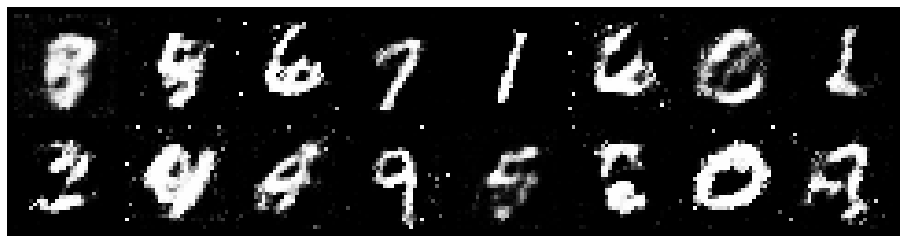

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1451, Generator Loss: 0.9889
D(x): 0.6049, D(G(z)): 0.3921


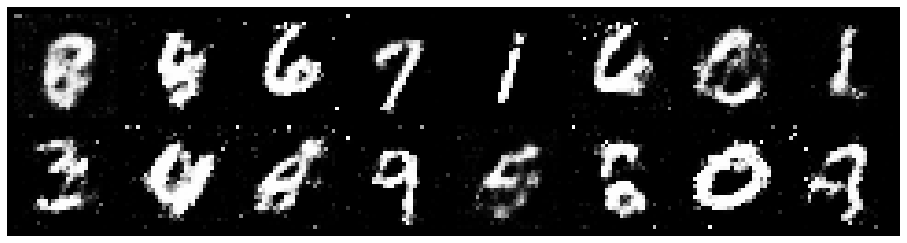

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0894, Generator Loss: 1.0381
D(x): 0.6624, D(G(z)): 0.4197


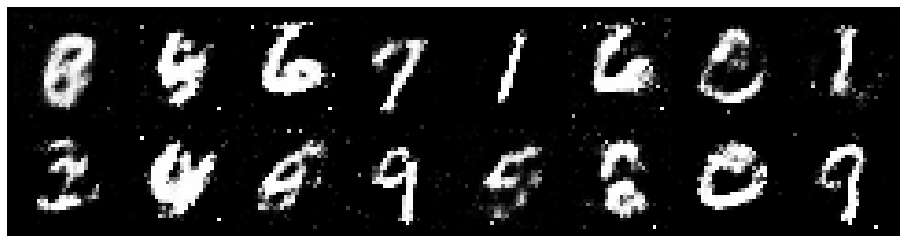

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1686, Generator Loss: 1.1562
D(x): 0.6574, D(G(z)): 0.4228


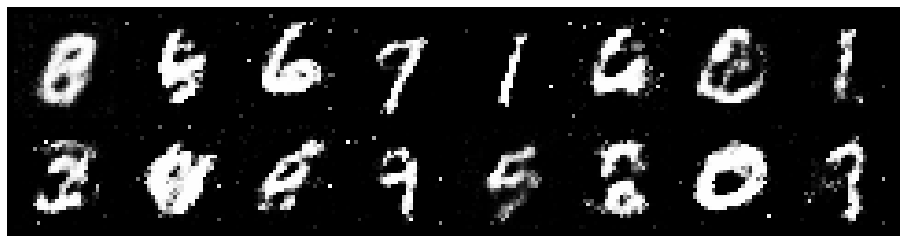

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 0.8655, Generator Loss: 1.3967
D(x): 0.6932, D(G(z)): 0.2830


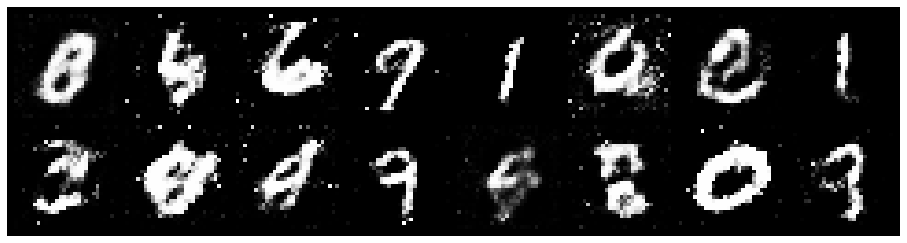

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.0783, Generator Loss: 1.2205
D(x): 0.6746, D(G(z)): 0.3838


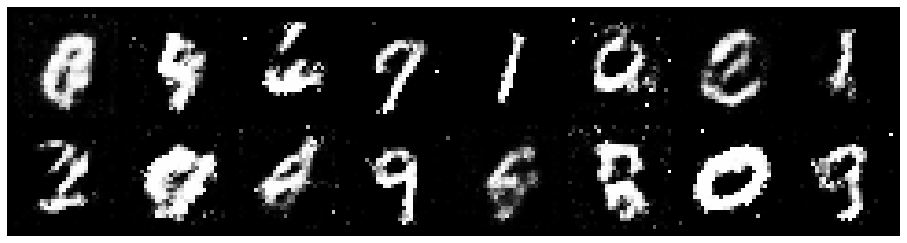

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.5175, Generator Loss: 0.8979
D(x): 0.5101, D(G(z)): 0.4627


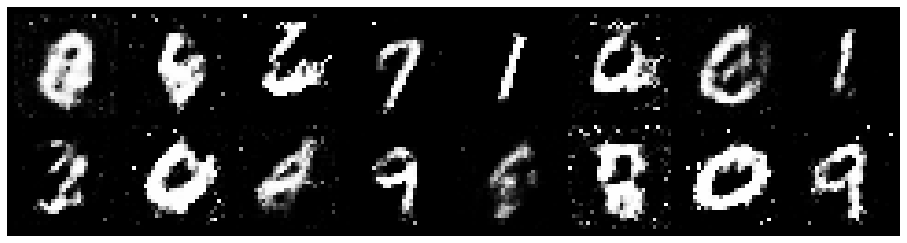

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.2674, Generator Loss: 1.0682
D(x): 0.6726, D(G(z)): 0.4650


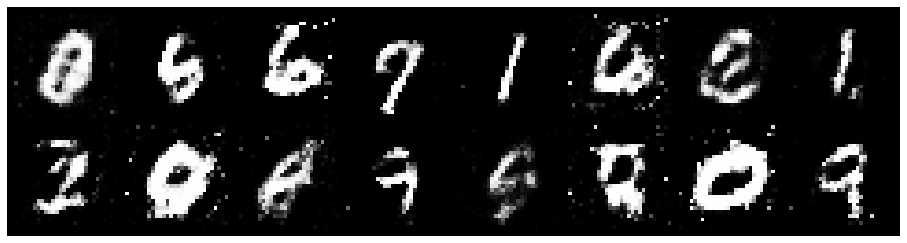

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.0184, Generator Loss: 1.4477
D(x): 0.6479, D(G(z)): 0.3697


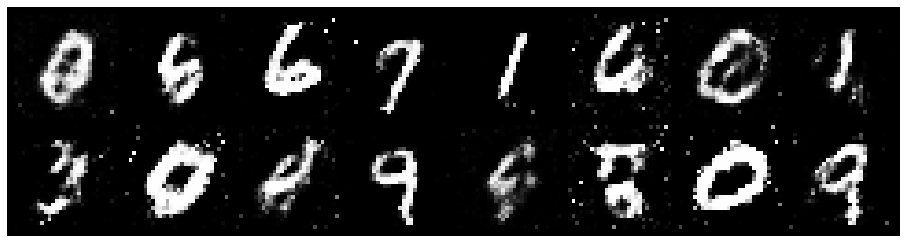

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0143, Generator Loss: 1.4081
D(x): 0.6213, D(G(z)): 0.3402


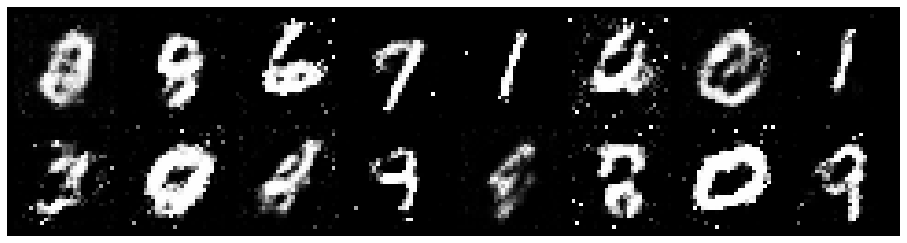

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0185, Generator Loss: 1.0828
D(x): 0.6174, D(G(z)): 0.3457


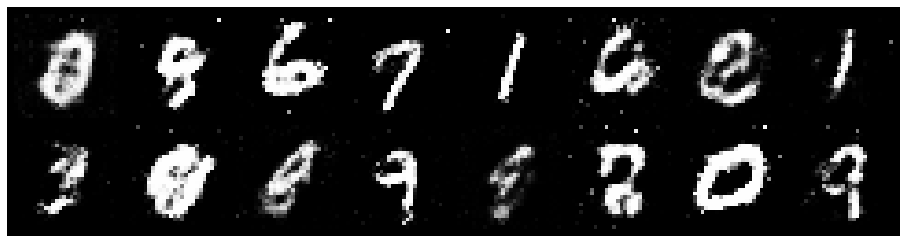

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1363, Generator Loss: 1.1901
D(x): 0.6287, D(G(z)): 0.3825


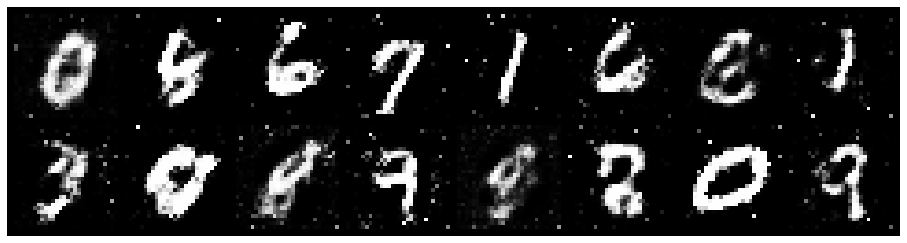

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 0.9637, Generator Loss: 1.1494
D(x): 0.6997, D(G(z)): 0.3563


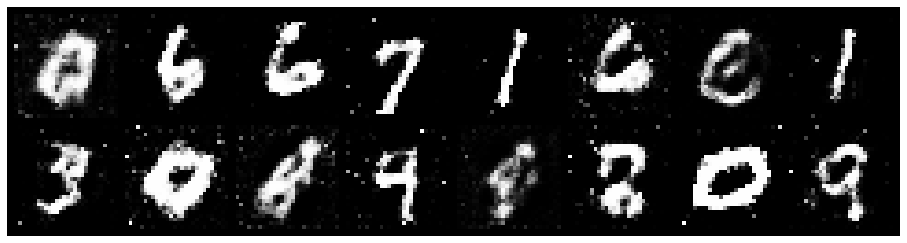

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1073, Generator Loss: 1.0605
D(x): 0.6146, D(G(z)): 0.3943


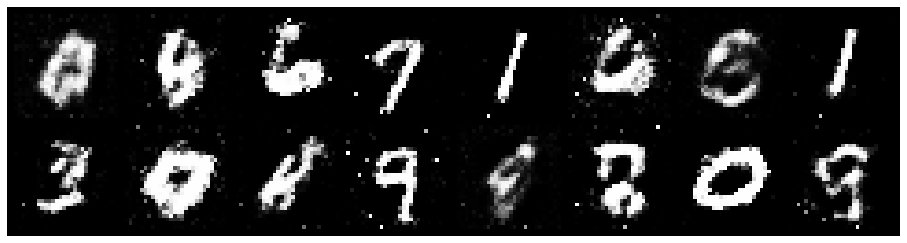

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.1478, Generator Loss: 0.8741
D(x): 0.6065, D(G(z)): 0.4059


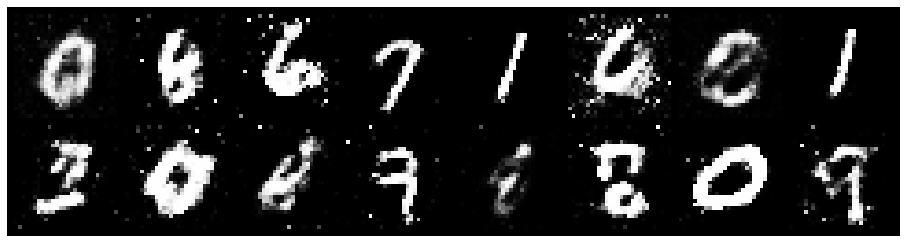

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.2918, Generator Loss: 0.9189
D(x): 0.5807, D(G(z)): 0.4232


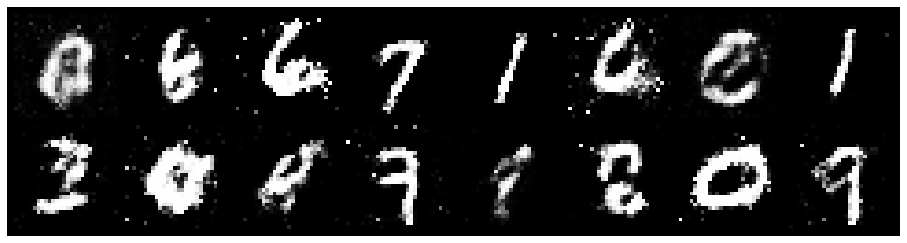

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.2653, Generator Loss: 0.9980
D(x): 0.6423, D(G(z)): 0.4592


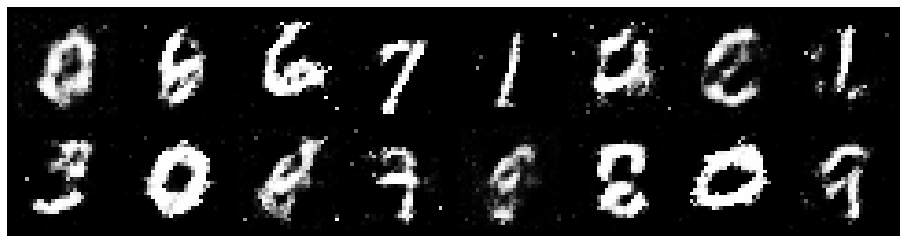

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.3542, Generator Loss: 0.9044
D(x): 0.6015, D(G(z)): 0.4872


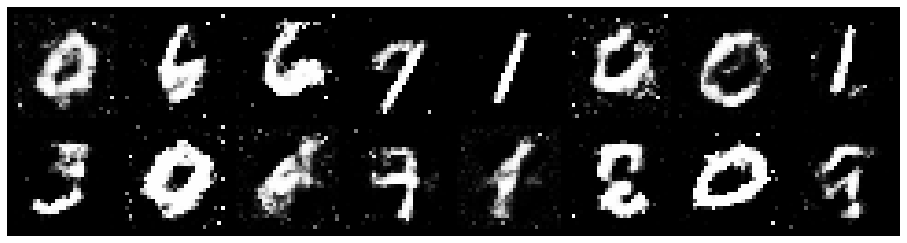

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.2016, Generator Loss: 1.2462
D(x): 0.6070, D(G(z)): 0.3866


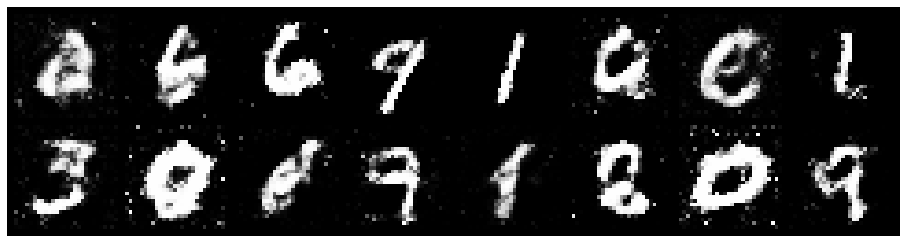

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.2244, Generator Loss: 1.0789
D(x): 0.5800, D(G(z)): 0.3919


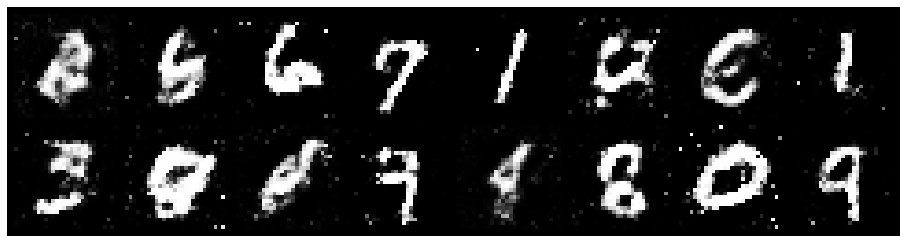

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.1335, Generator Loss: 1.0685
D(x): 0.6248, D(G(z)): 0.4168


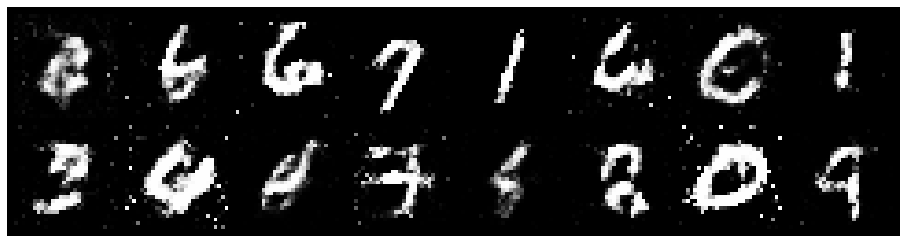

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.0496, Generator Loss: 1.1012
D(x): 0.6414, D(G(z)): 0.3776


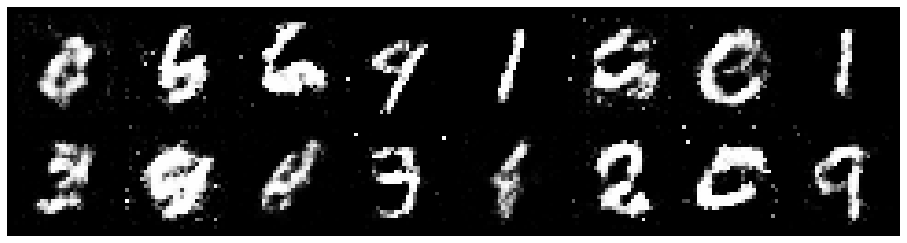

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.0335, Generator Loss: 1.1398
D(x): 0.6351, D(G(z)): 0.3858


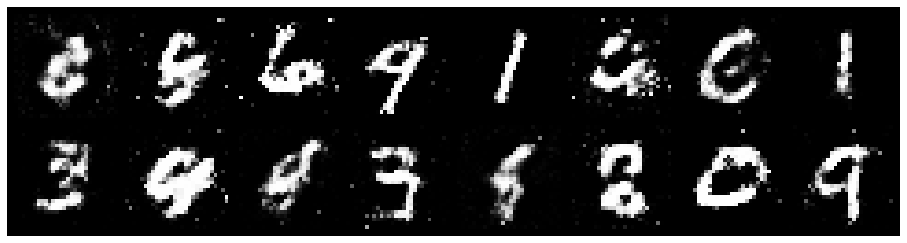

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0347, Generator Loss: 0.9659
D(x): 0.6403, D(G(z)): 0.3779


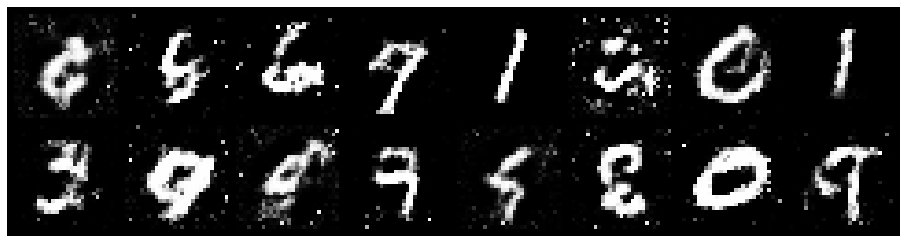

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.3785, Generator Loss: 0.9674
D(x): 0.5668, D(G(z)): 0.4669


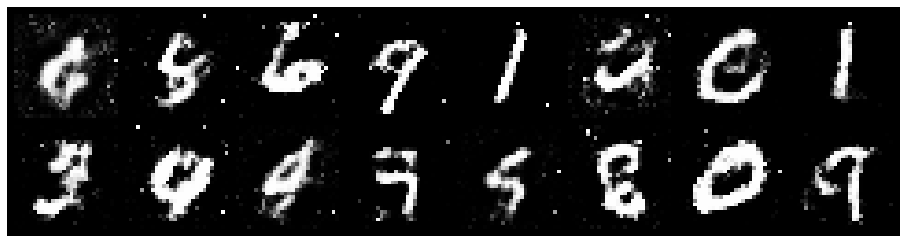

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.3216, Generator Loss: 1.0156
D(x): 0.5055, D(G(z)): 0.3932


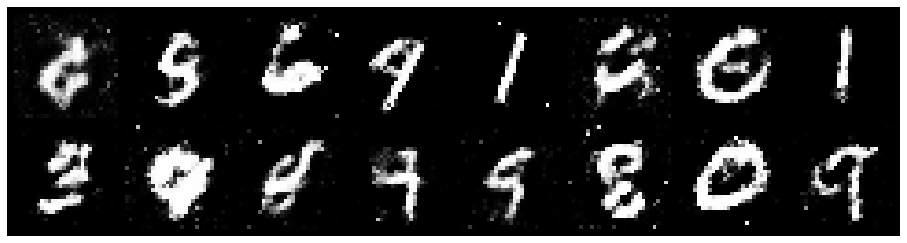

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.1999, Generator Loss: 1.2091
D(x): 0.5852, D(G(z)): 0.3977


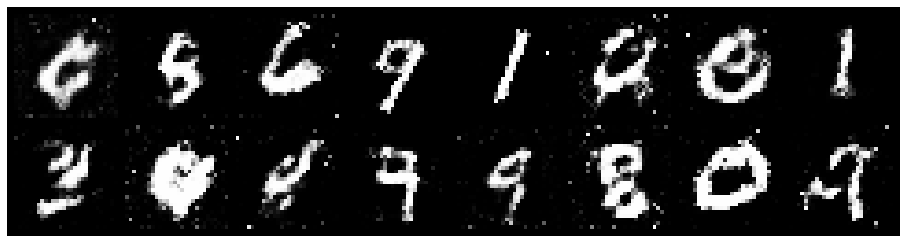

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1094, Generator Loss: 1.1182
D(x): 0.7189, D(G(z)): 0.3973


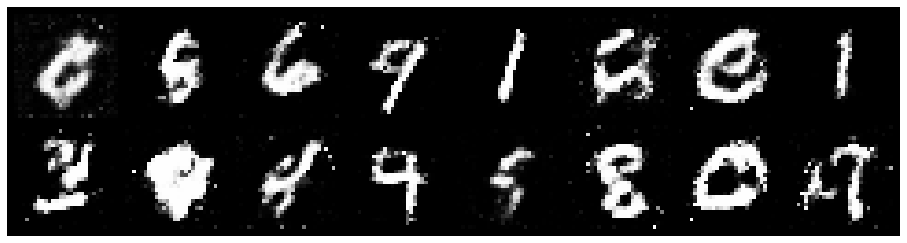

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0894, Generator Loss: 1.3299
D(x): 0.6494, D(G(z)): 0.3464


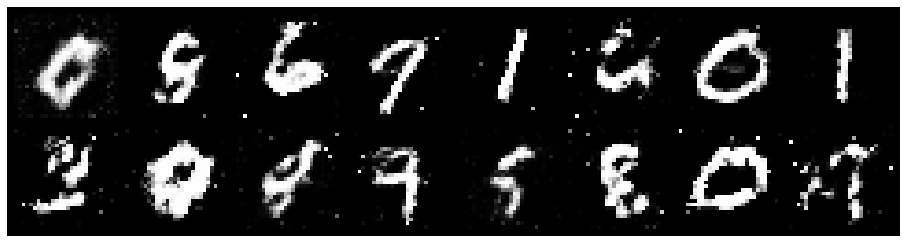

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.0893, Generator Loss: 1.2299
D(x): 0.6046, D(G(z)): 0.3464


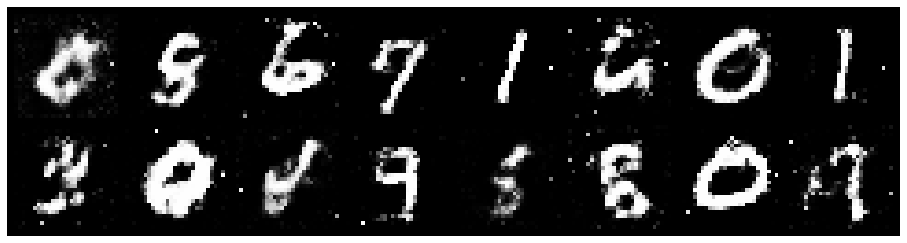

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1099, Generator Loss: 1.4477
D(x): 0.6256, D(G(z)): 0.3421


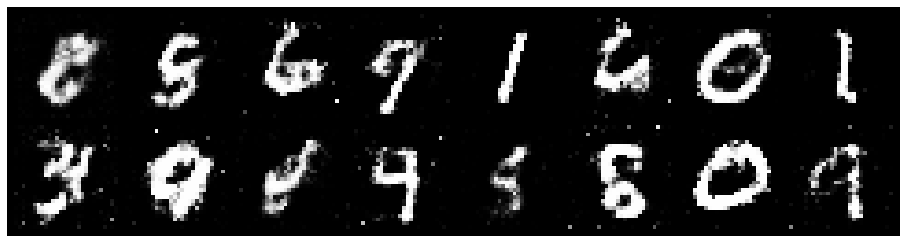

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.0513, Generator Loss: 1.3605
D(x): 0.6236, D(G(z)): 0.3440


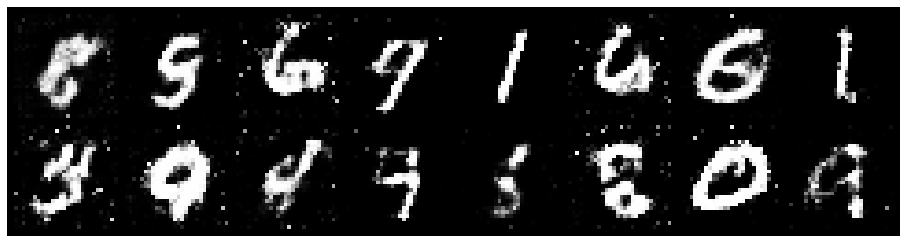

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.0155, Generator Loss: 1.3457
D(x): 0.6327, D(G(z)): 0.3298


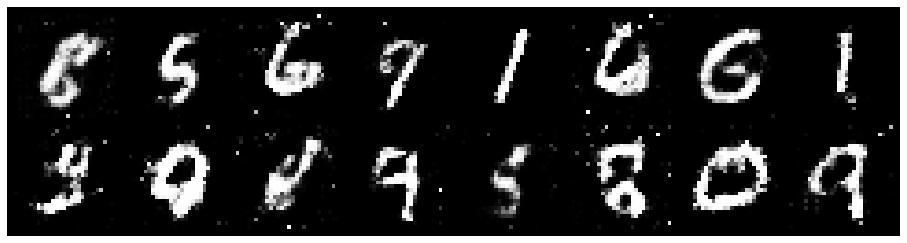

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0961, Generator Loss: 1.1664
D(x): 0.6126, D(G(z)): 0.3587


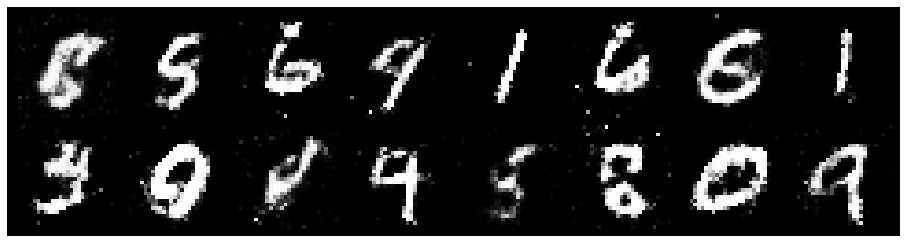

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 0.9937, Generator Loss: 1.2586
D(x): 0.6783, D(G(z)): 0.3530


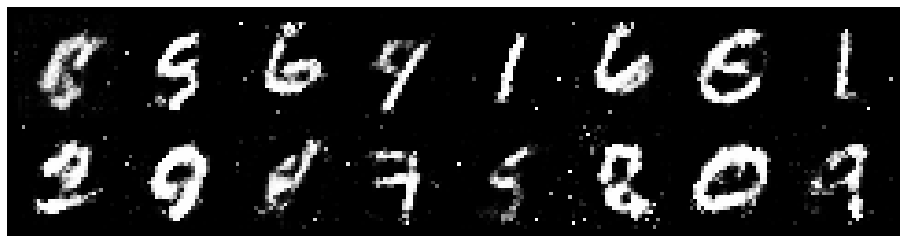

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1108, Generator Loss: 0.9953
D(x): 0.6400, D(G(z)): 0.4305


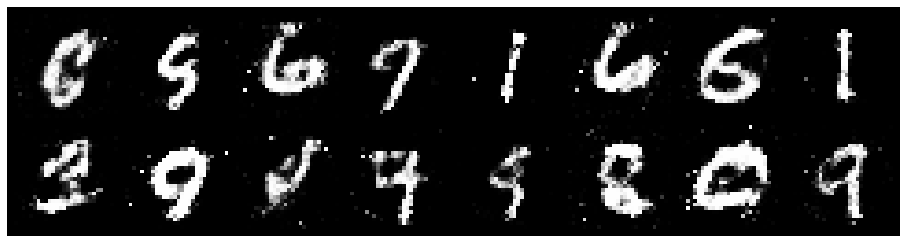

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1678, Generator Loss: 1.1191
D(x): 0.5950, D(G(z)): 0.3959


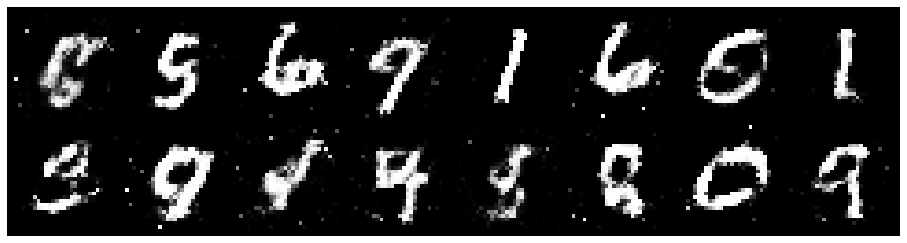

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1984, Generator Loss: 0.9699
D(x): 0.6374, D(G(z)): 0.4603


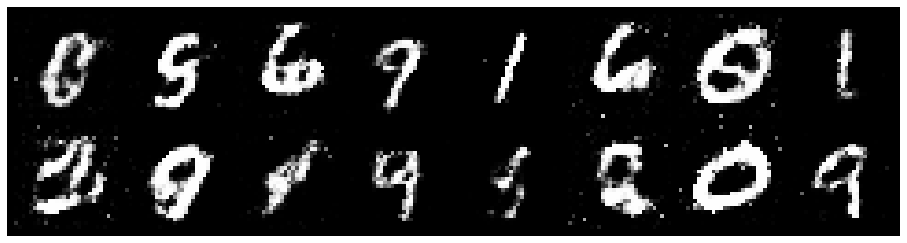

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.3259, Generator Loss: 0.9323
D(x): 0.6154, D(G(z)): 0.4832


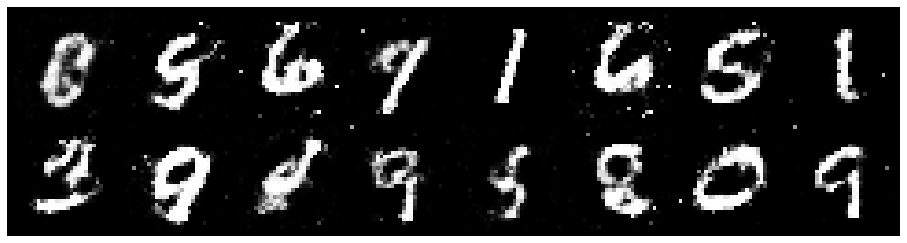

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.0710, Generator Loss: 1.0646
D(x): 0.6456, D(G(z)): 0.3932


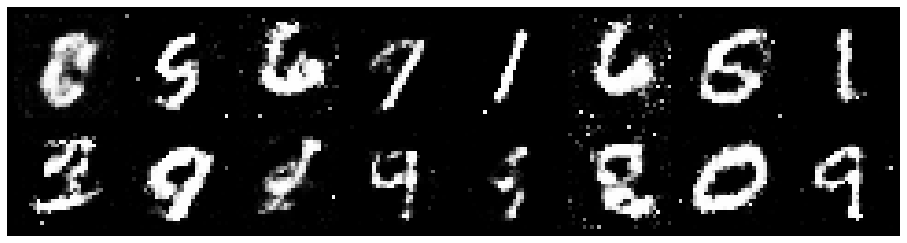

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.3149, Generator Loss: 1.2524
D(x): 0.5601, D(G(z)): 0.3916


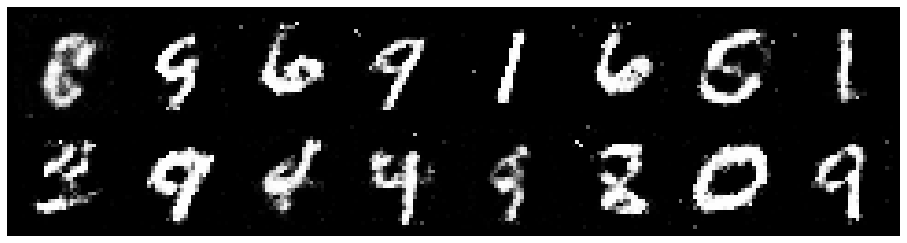

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1767, Generator Loss: 1.0541
D(x): 0.5802, D(G(z)): 0.3866


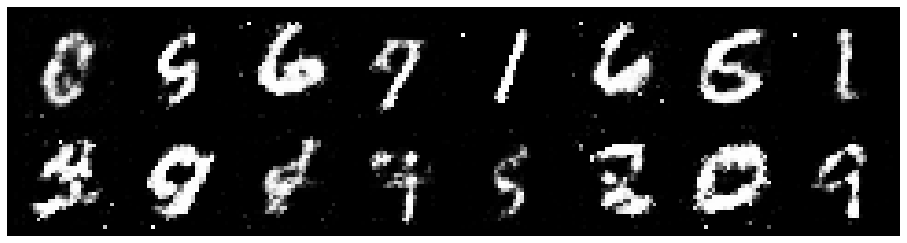

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0845, Generator Loss: 1.0597
D(x): 0.5946, D(G(z)): 0.3647


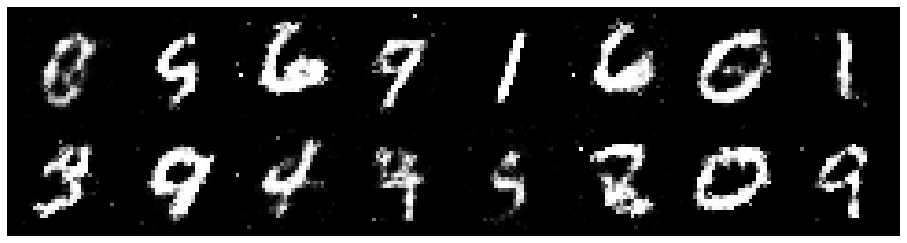

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.0966, Generator Loss: 1.2157
D(x): 0.5989, D(G(z)): 0.3686


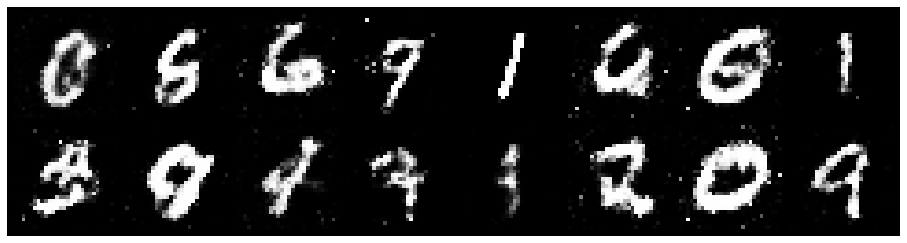

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1597, Generator Loss: 0.8614
D(x): 0.6734, D(G(z)): 0.4601


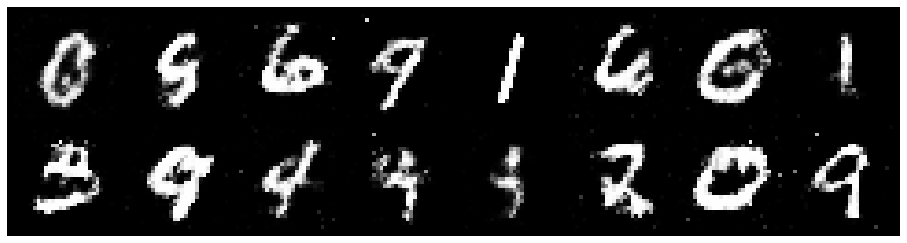

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.3478, Generator Loss: 0.7505
D(x): 0.6343, D(G(z)): 0.5178


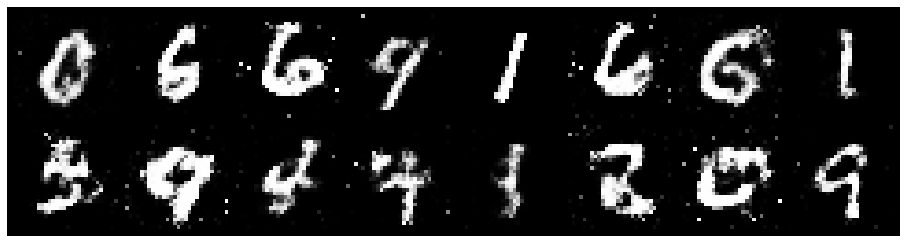

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1450, Generator Loss: 1.5353
D(x): 0.6878, D(G(z)): 0.3835


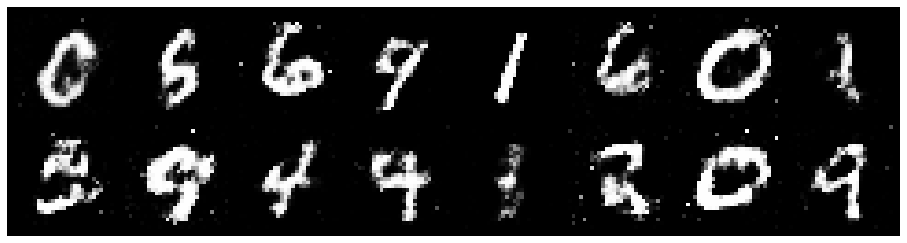

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.2219, Generator Loss: 0.9816
D(x): 0.5981, D(G(z)): 0.4211


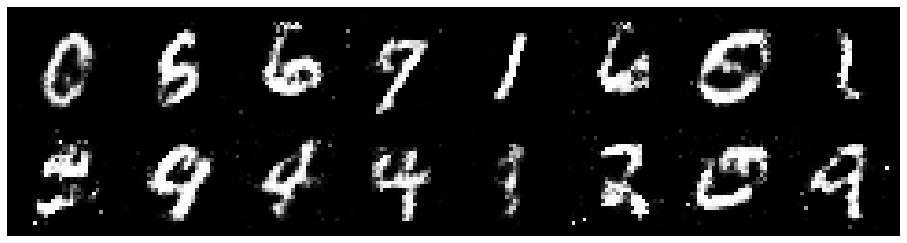

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 0.9892, Generator Loss: 1.1660
D(x): 0.6659, D(G(z)): 0.3725


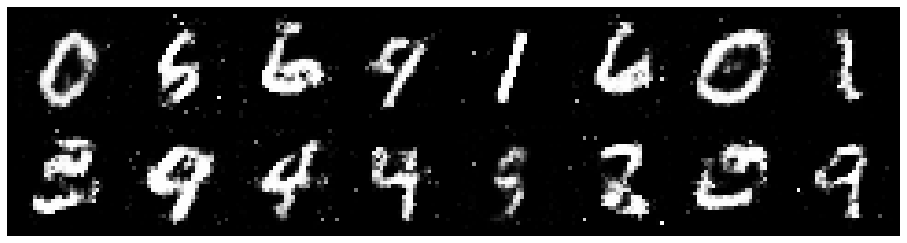

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1911, Generator Loss: 1.1639
D(x): 0.5502, D(G(z)): 0.3603


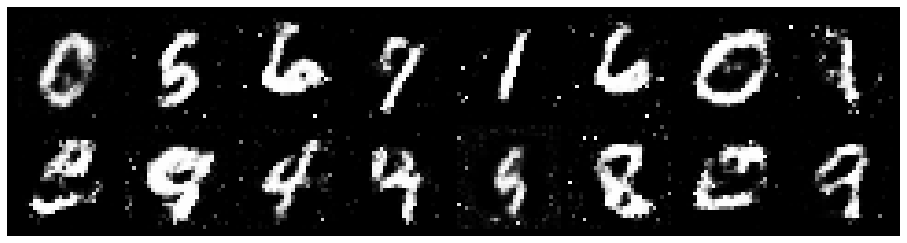

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.0821, Generator Loss: 0.9740
D(x): 0.6042, D(G(z)): 0.3925


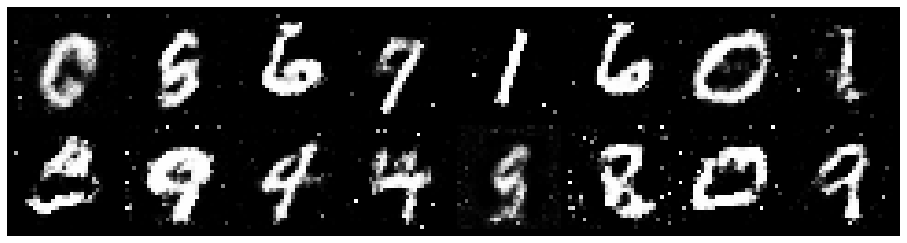

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1552, Generator Loss: 0.9836
D(x): 0.6281, D(G(z)): 0.4338


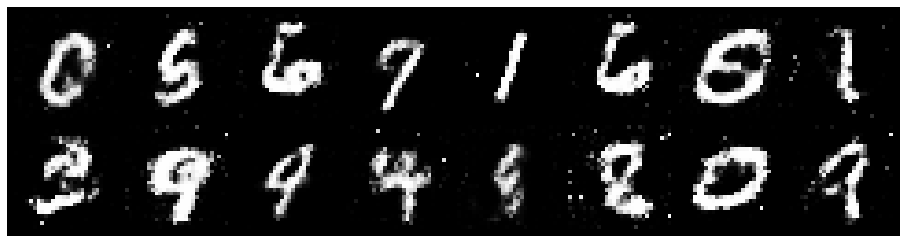

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.1983, Generator Loss: 0.9322
D(x): 0.5860, D(G(z)): 0.4376


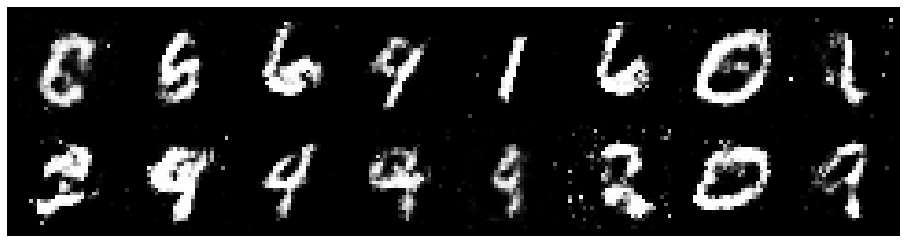

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1753, Generator Loss: 0.8626
D(x): 0.6200, D(G(z)): 0.4369


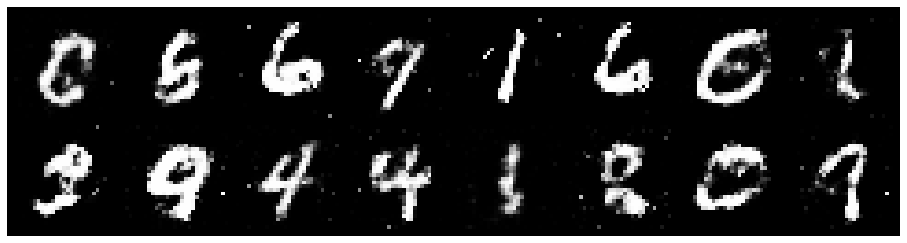

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.1421, Generator Loss: 0.9355
D(x): 0.5844, D(G(z)): 0.4018


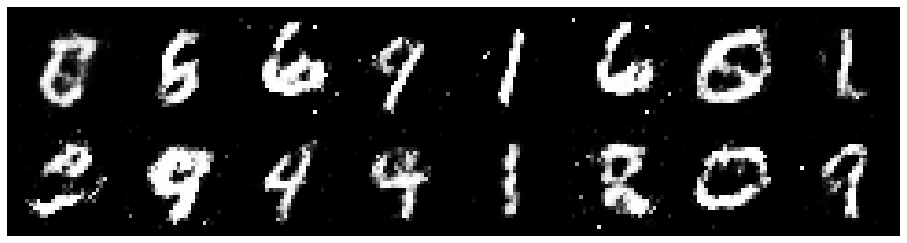

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.2759, Generator Loss: 0.9812
D(x): 0.5533, D(G(z)): 0.4390


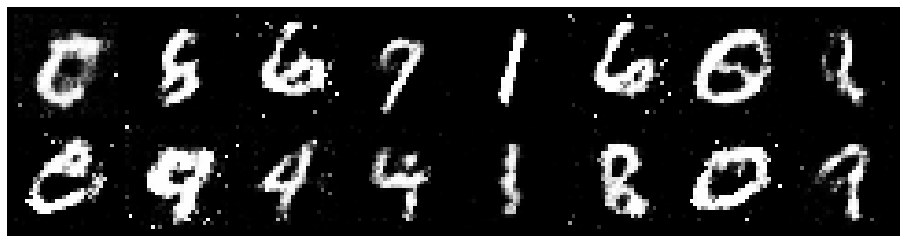

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1800, Generator Loss: 1.3067
D(x): 0.5826, D(G(z)): 0.3929


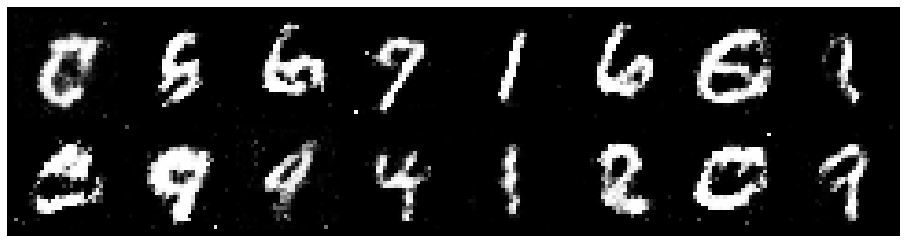

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.2139, Generator Loss: 1.2527
D(x): 0.6122, D(G(z)): 0.3891


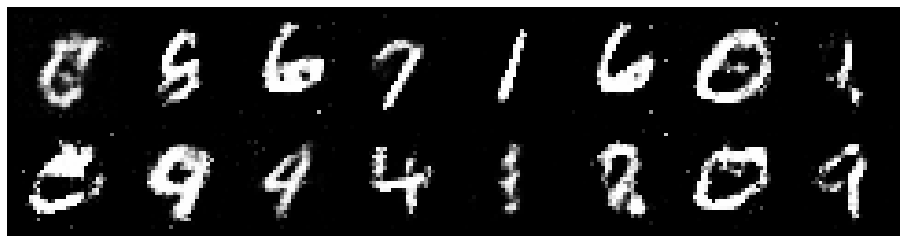

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.1512, Generator Loss: 0.8719
D(x): 0.5927, D(G(z)): 0.4183


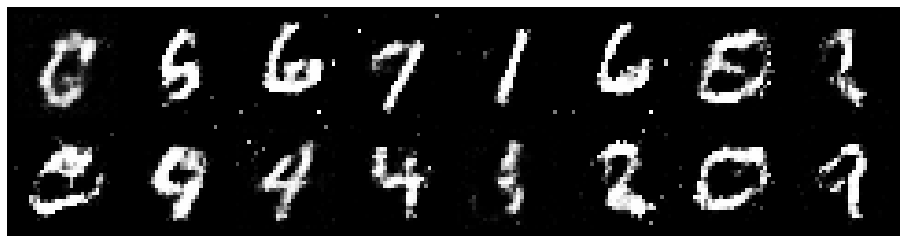

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 0.9851, Generator Loss: 1.1280
D(x): 0.6590, D(G(z)): 0.3650


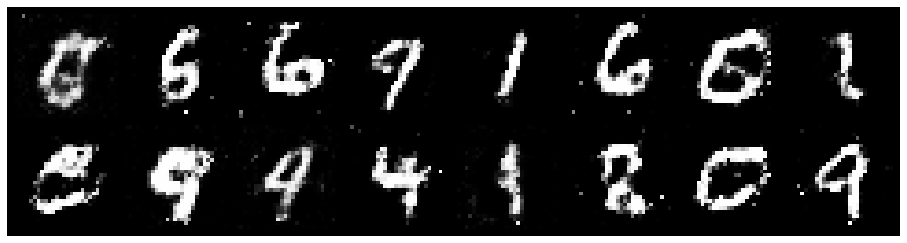

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 0.9695, Generator Loss: 1.3625
D(x): 0.6448, D(G(z)): 0.3260


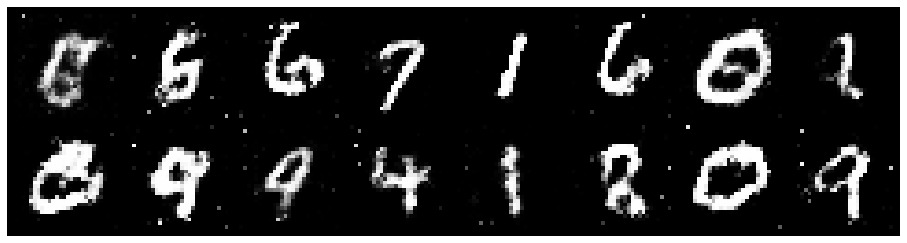

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1132, Generator Loss: 1.0737
D(x): 0.6776, D(G(z)): 0.4186


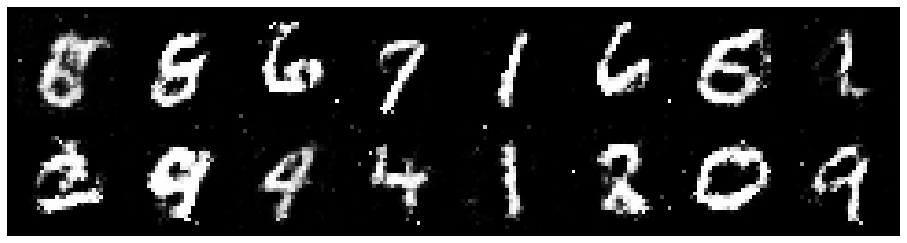

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.0211, Generator Loss: 1.4866
D(x): 0.6466, D(G(z)): 0.3485


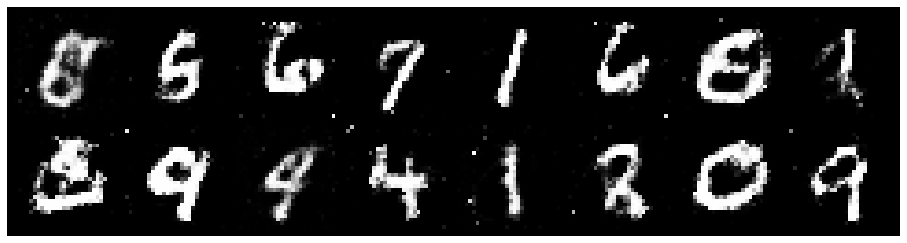

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1565, Generator Loss: 1.1331
D(x): 0.5772, D(G(z)): 0.3811


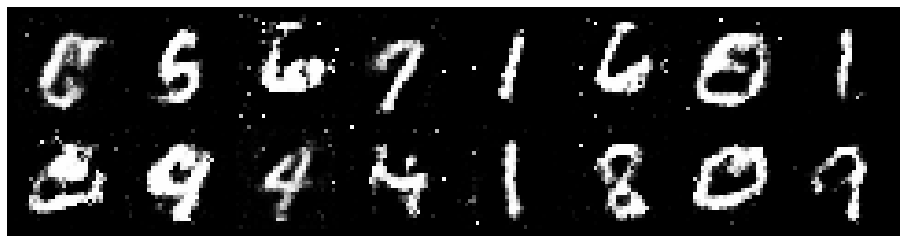

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.0848, Generator Loss: 1.0070
D(x): 0.6797, D(G(z)): 0.4302


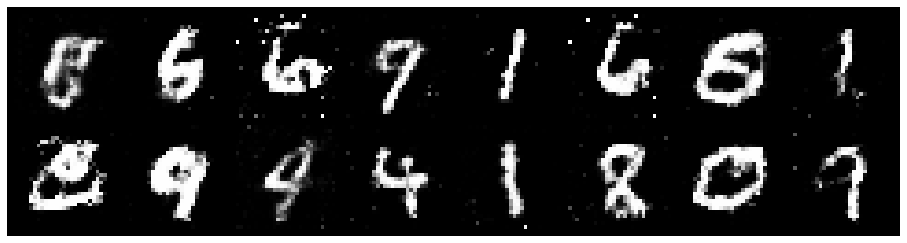

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1186, Generator Loss: 1.1406
D(x): 0.5926, D(G(z)): 0.3744


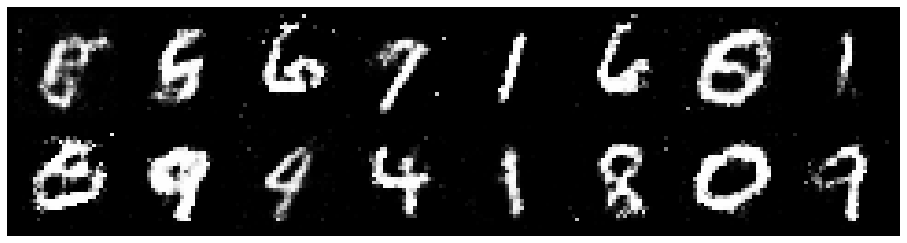

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1814, Generator Loss: 1.1074
D(x): 0.5615, D(G(z)): 0.3841


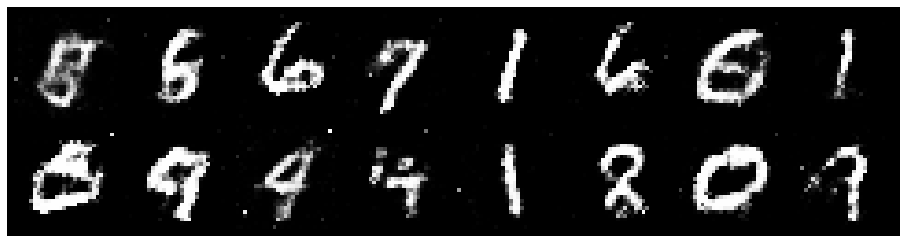

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.2264, Generator Loss: 0.9641
D(x): 0.5827, D(G(z)): 0.4044


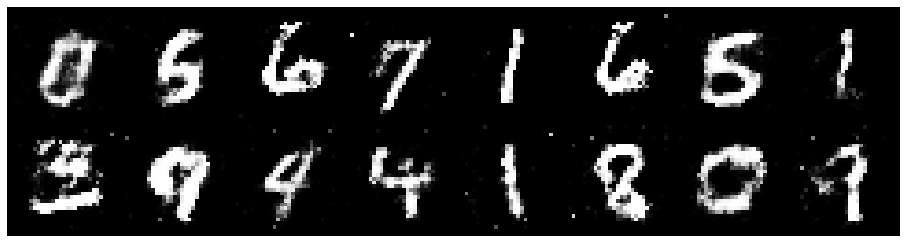

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1810, Generator Loss: 1.2265
D(x): 0.5842, D(G(z)): 0.3766


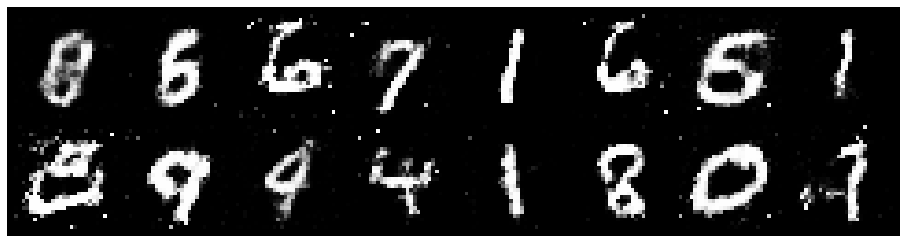

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2047, Generator Loss: 0.8848
D(x): 0.5829, D(G(z)): 0.4209


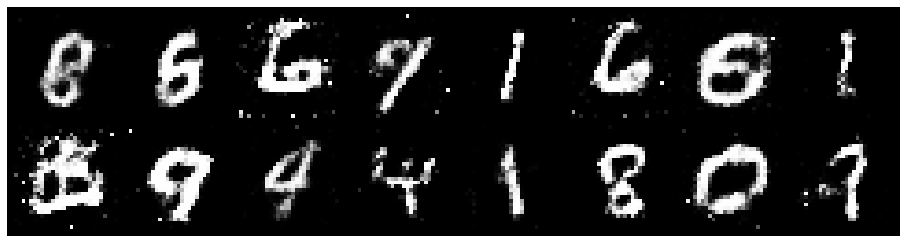

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1898, Generator Loss: 1.0821
D(x): 0.6250, D(G(z)): 0.4151


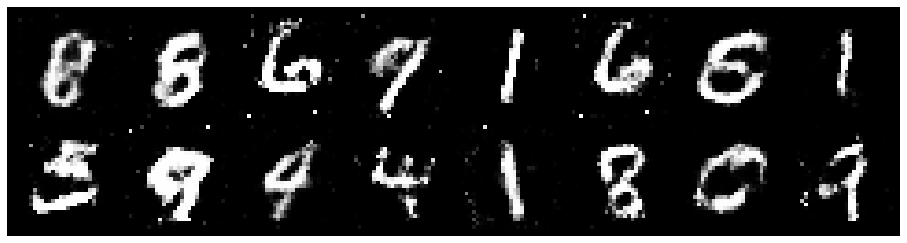

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.0365, Generator Loss: 1.0983
D(x): 0.6863, D(G(z)): 0.3987


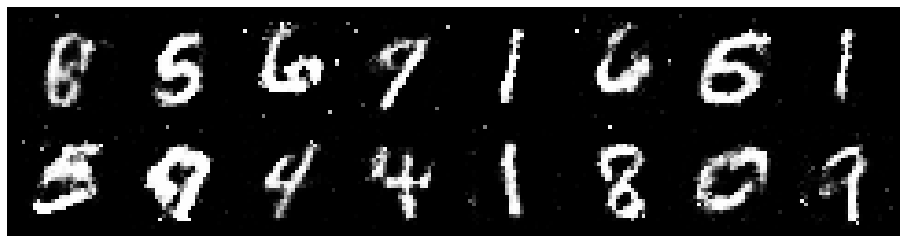

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.3217, Generator Loss: 1.3164
D(x): 0.5638, D(G(z)): 0.3984


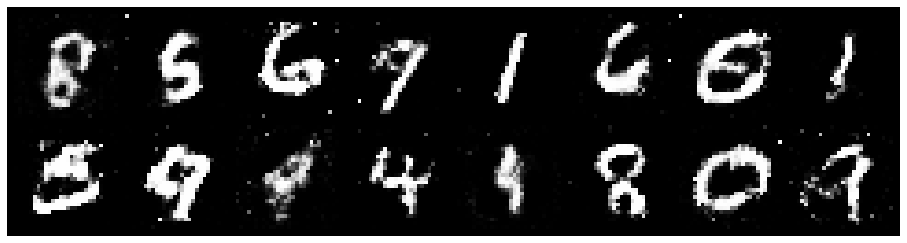

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.0221, Generator Loss: 1.2468
D(x): 0.6420, D(G(z)): 0.3549


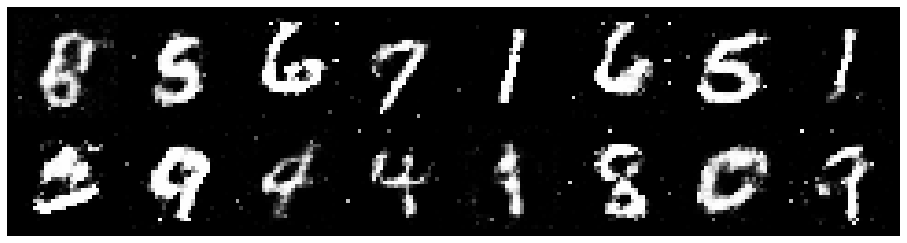

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0144, Generator Loss: 1.1104
D(x): 0.6481, D(G(z)): 0.3594


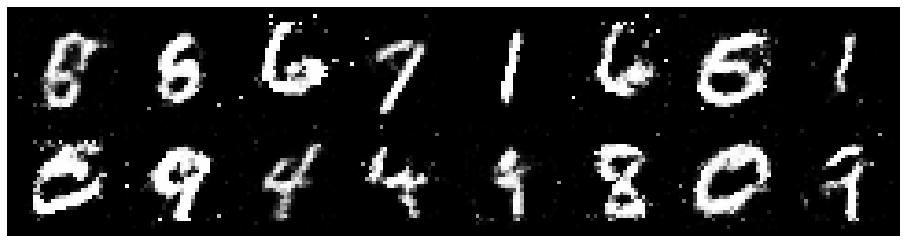

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2122, Generator Loss: 0.9682
D(x): 0.5826, D(G(z)): 0.4183


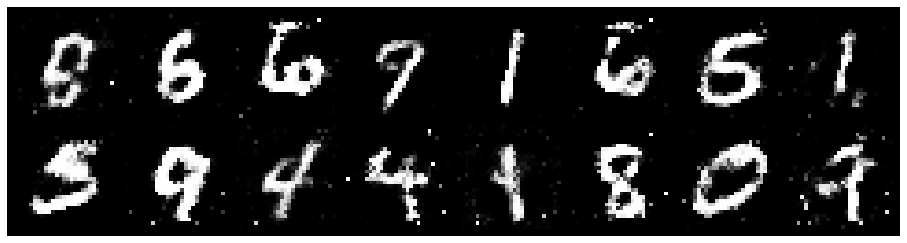

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.0185, Generator Loss: 0.9906
D(x): 0.6529, D(G(z)): 0.3872


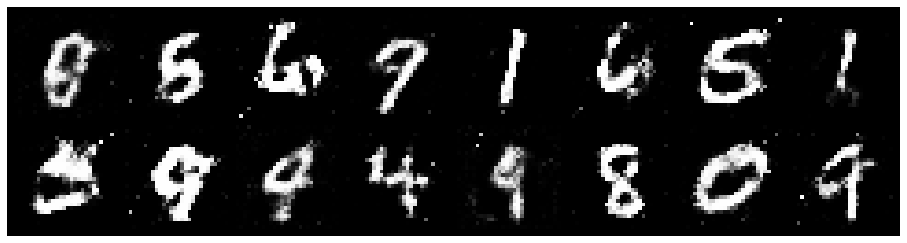

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.0758, Generator Loss: 0.9805
D(x): 0.6411, D(G(z)): 0.4029


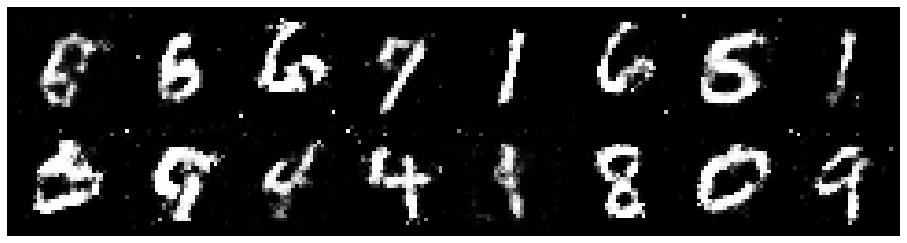

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 0.9527, Generator Loss: 1.2086
D(x): 0.6537, D(G(z)): 0.3155


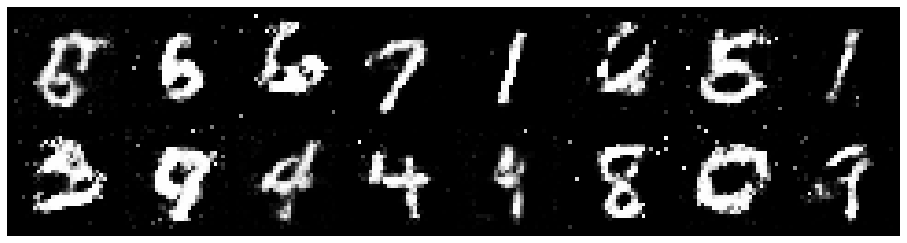

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.0120, Generator Loss: 1.2983
D(x): 0.6631, D(G(z)): 0.3600


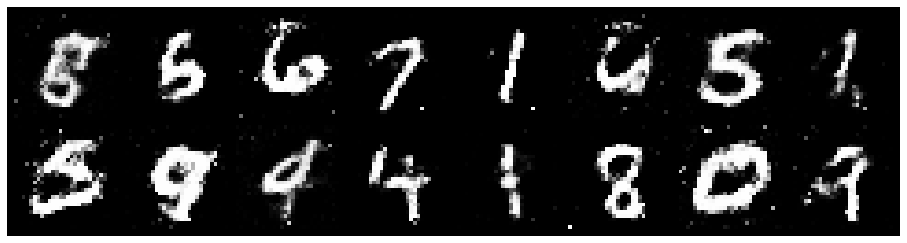

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1342, Generator Loss: 1.1948
D(x): 0.6324, D(G(z)): 0.3769


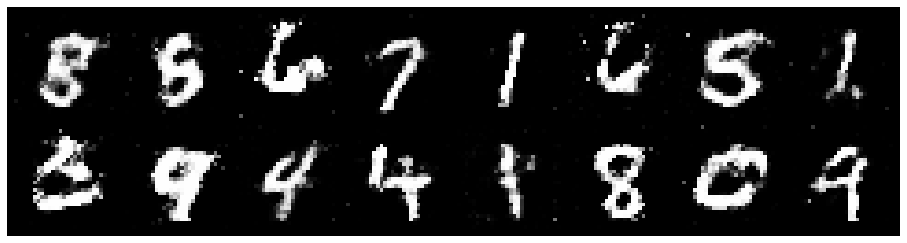

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1774, Generator Loss: 1.0904
D(x): 0.6491, D(G(z)): 0.4245


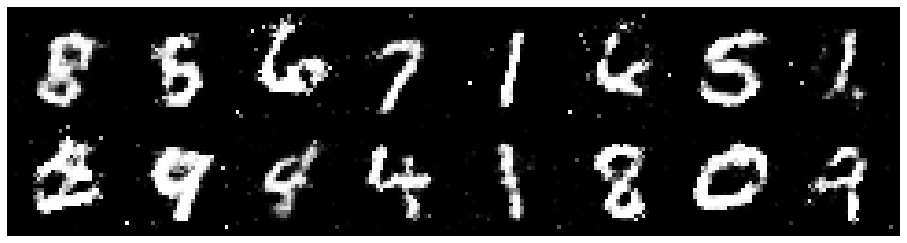

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1071, Generator Loss: 1.1314
D(x): 0.6274, D(G(z)): 0.4148


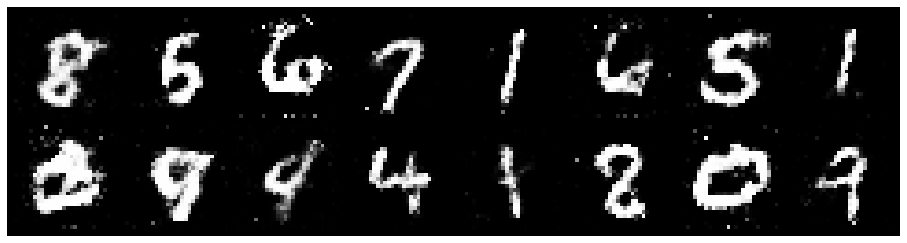

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.0089, Generator Loss: 1.0914
D(x): 0.6229, D(G(z)): 0.3446


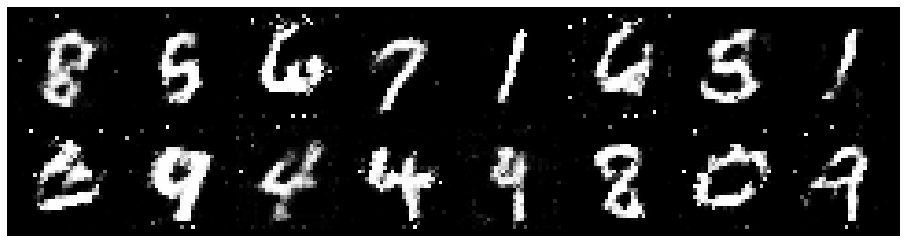

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.1622, Generator Loss: 1.2172
D(x): 0.6113, D(G(z)): 0.3901


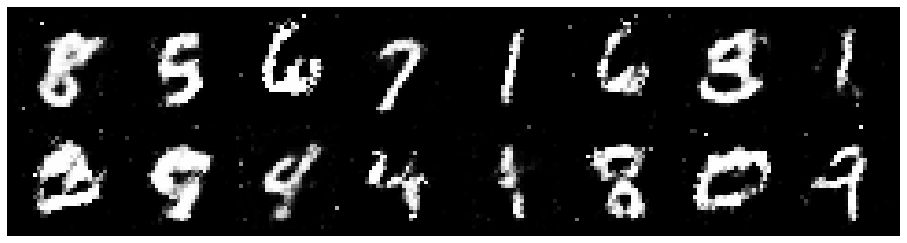

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2004, Generator Loss: 1.0802
D(x): 0.5537, D(G(z)): 0.3788


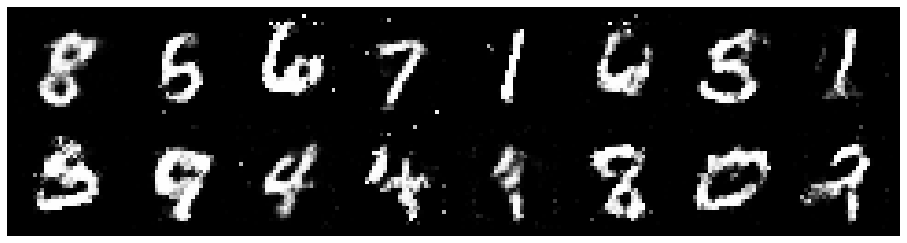

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.2631, Generator Loss: 0.9746
D(x): 0.5545, D(G(z)): 0.4384


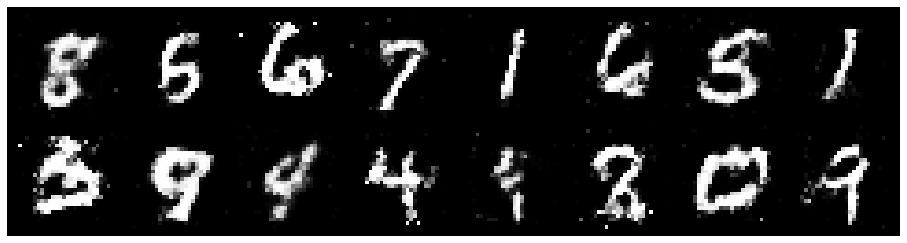

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1800, Generator Loss: 0.9715
D(x): 0.5852, D(G(z)): 0.4035


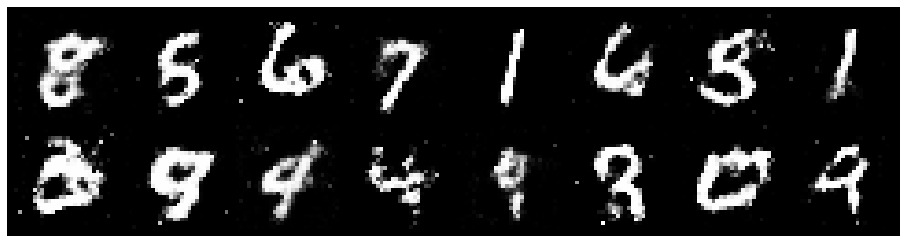

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.2354, Generator Loss: 0.8919
D(x): 0.5757, D(G(z)): 0.4266


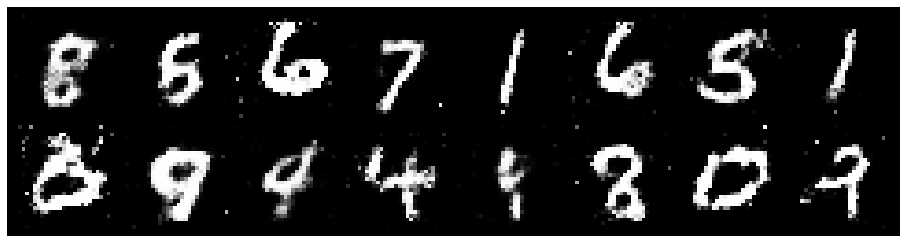

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.1000, Generator Loss: 1.1372
D(x): 0.6334, D(G(z)): 0.3905


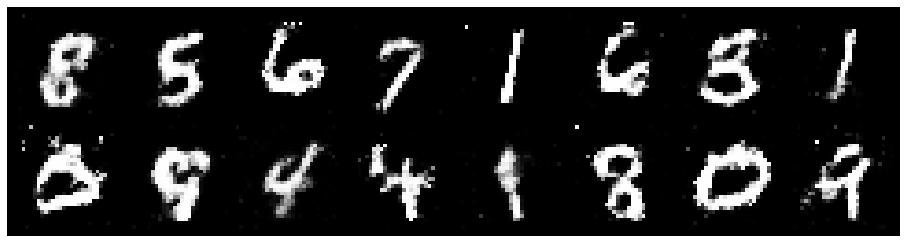

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.0497, Generator Loss: 1.2583
D(x): 0.5991, D(G(z)): 0.3232


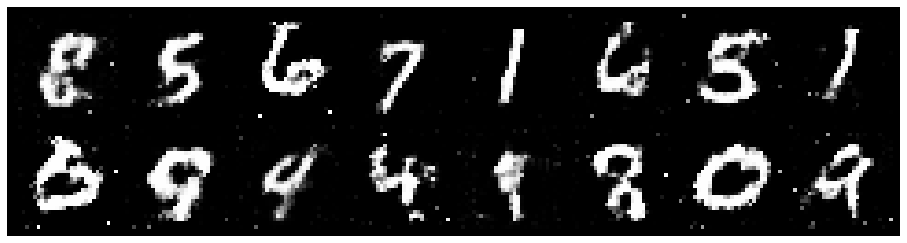

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1727, Generator Loss: 1.2751
D(x): 0.6471, D(G(z)): 0.4513


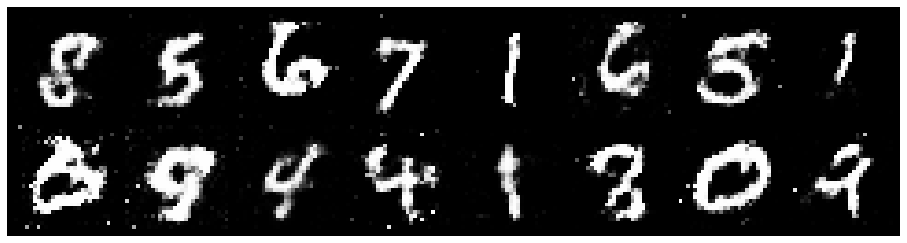

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 0.9919, Generator Loss: 1.4405
D(x): 0.6439, D(G(z)): 0.3366


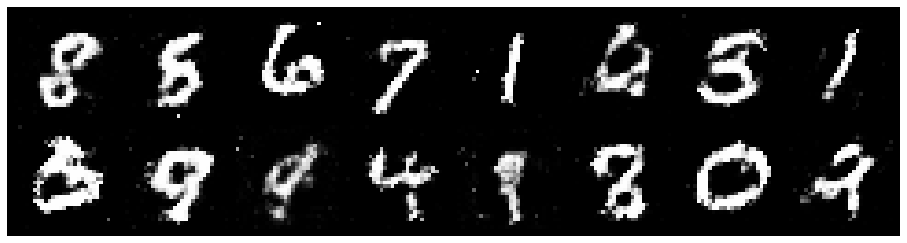

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.1132, Generator Loss: 1.3743
D(x): 0.5683, D(G(z)): 0.3219


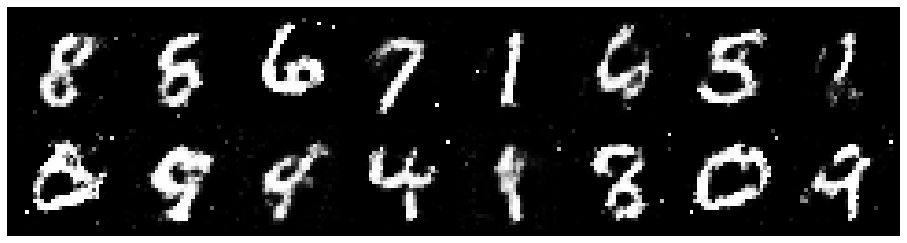

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.0170, Generator Loss: 1.0443
D(x): 0.6141, D(G(z)): 0.3491


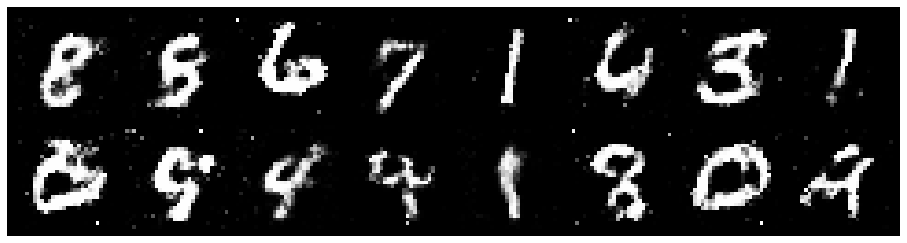

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.0977, Generator Loss: 1.2452
D(x): 0.6266, D(G(z)): 0.3857


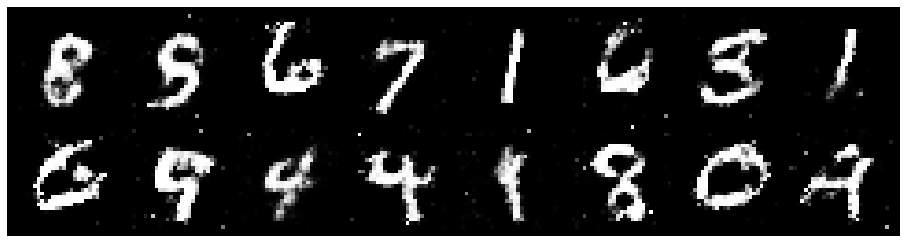

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2631, Generator Loss: 1.0833
D(x): 0.6480, D(G(z)): 0.4537


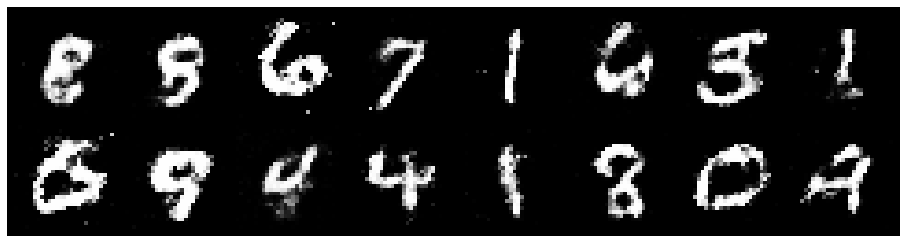

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.0940, Generator Loss: 1.1545
D(x): 0.6355, D(G(z)): 0.3883


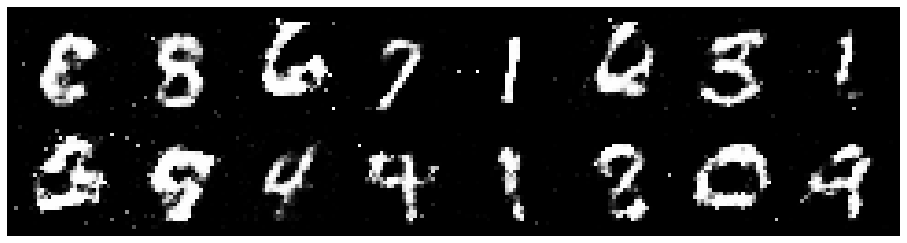

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1739, Generator Loss: 1.0991
D(x): 0.5988, D(G(z)): 0.4081


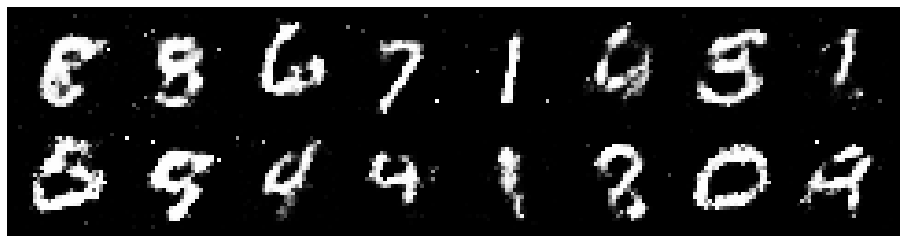

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1123, Generator Loss: 1.1481
D(x): 0.6182, D(G(z)): 0.4046


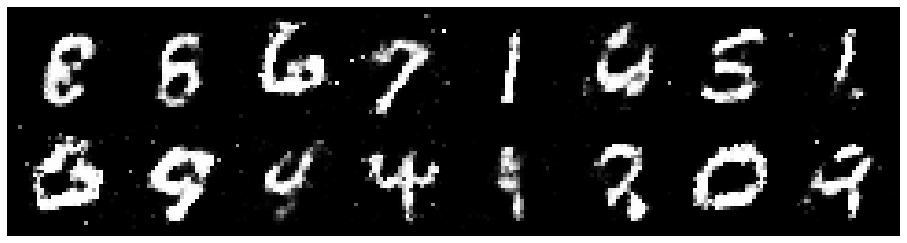

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.2711, Generator Loss: 1.1003
D(x): 0.5960, D(G(z)): 0.4384


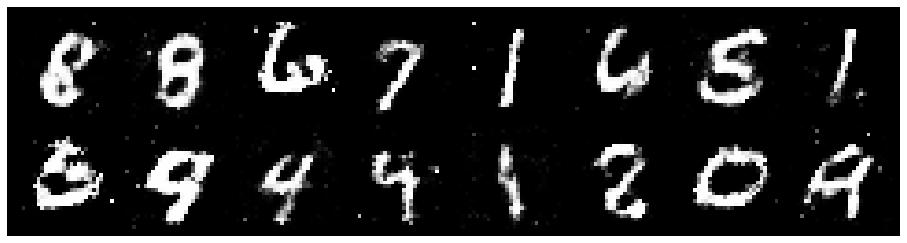

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1682, Generator Loss: 1.1390
D(x): 0.5629, D(G(z)): 0.3881


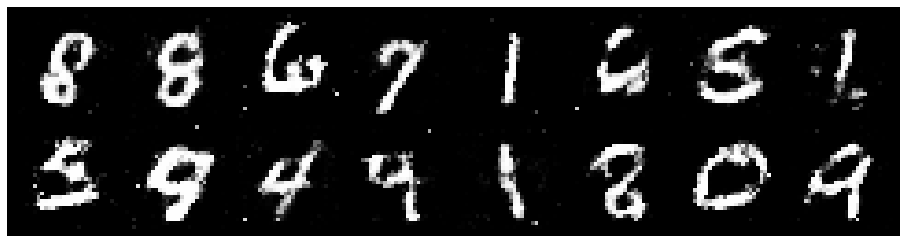

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1811, Generator Loss: 0.9479
D(x): 0.5673, D(G(z)): 0.3938


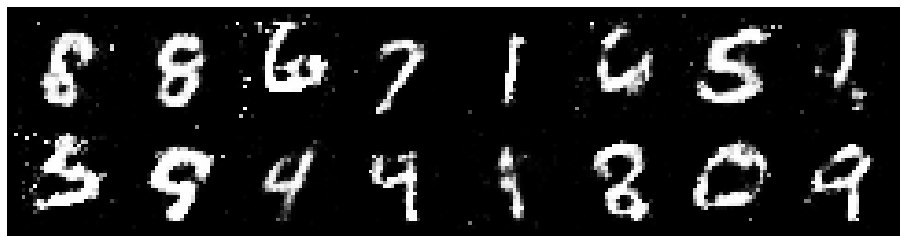

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1093, Generator Loss: 1.1088
D(x): 0.5894, D(G(z)): 0.3745


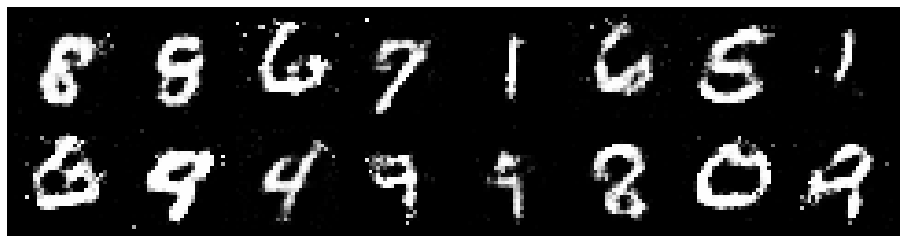

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2597, Generator Loss: 1.0419
D(x): 0.6124, D(G(z)): 0.4094


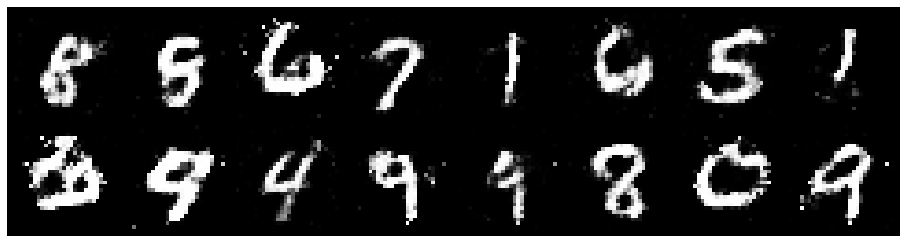

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1688, Generator Loss: 0.9372
D(x): 0.5889, D(G(z)): 0.3654


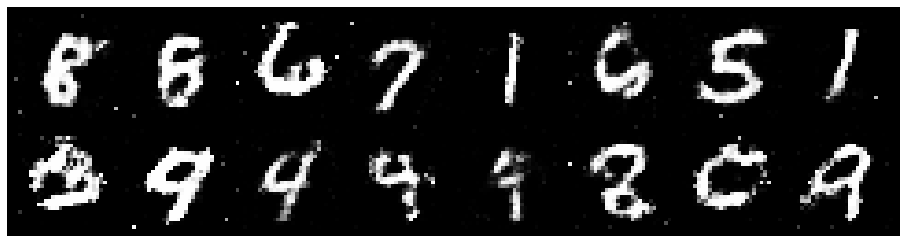

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 0.9540, Generator Loss: 1.6127
D(x): 0.6460, D(G(z)): 0.3025


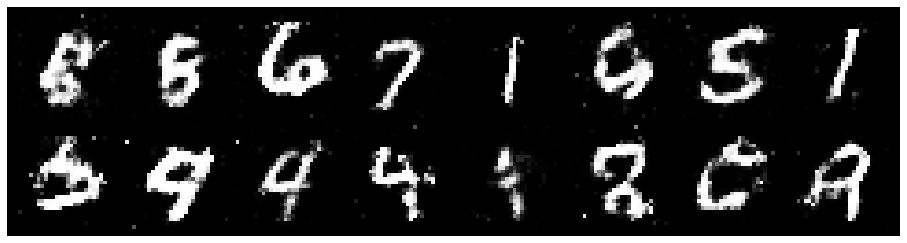

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1028, Generator Loss: 1.1743
D(x): 0.6073, D(G(z)): 0.3935


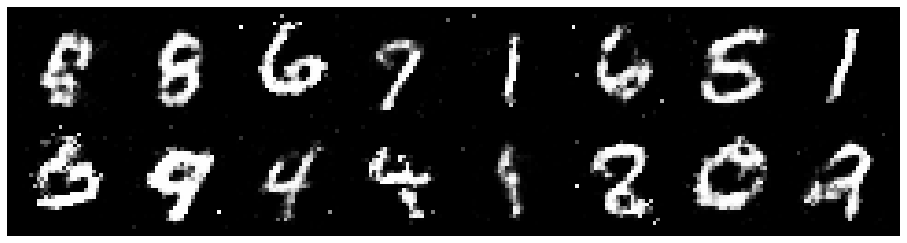

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2249, Generator Loss: 0.8696
D(x): 0.6202, D(G(z)): 0.4354


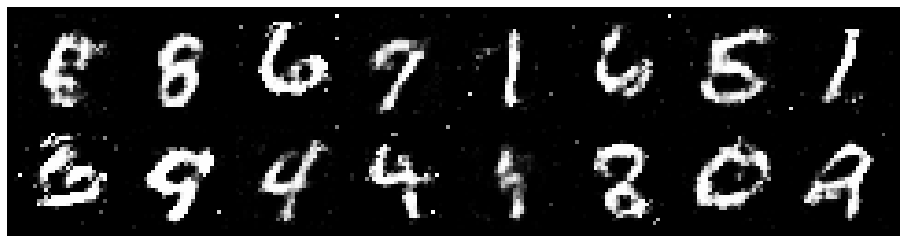

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1671, Generator Loss: 0.8638
D(x): 0.5826, D(G(z)): 0.4030


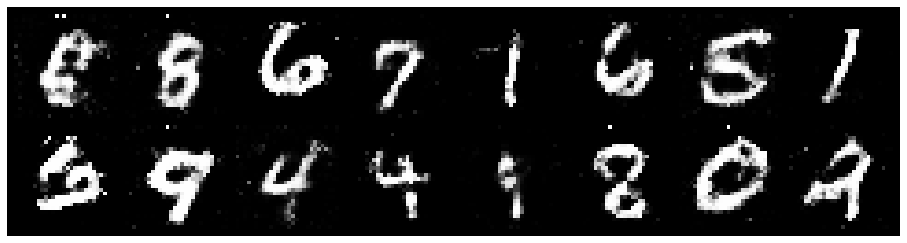

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2231, Generator Loss: 0.9537
D(x): 0.6069, D(G(z)): 0.4449


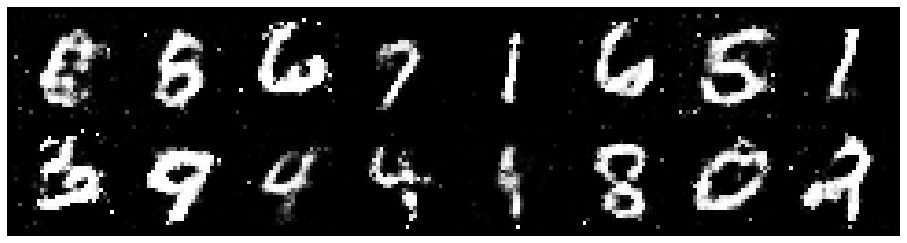

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2994, Generator Loss: 1.0044
D(x): 0.5577, D(G(z)): 0.4364


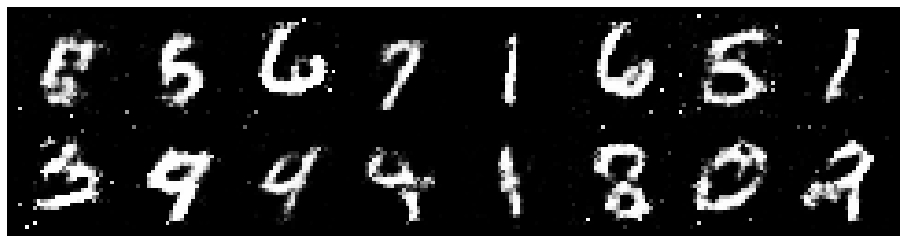

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.3452, Generator Loss: 0.9712
D(x): 0.5175, D(G(z)): 0.4279


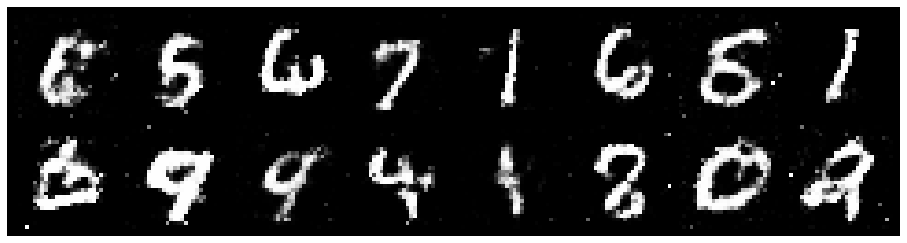

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.3193, Generator Loss: 0.7575
D(x): 0.6037, D(G(z)): 0.5058


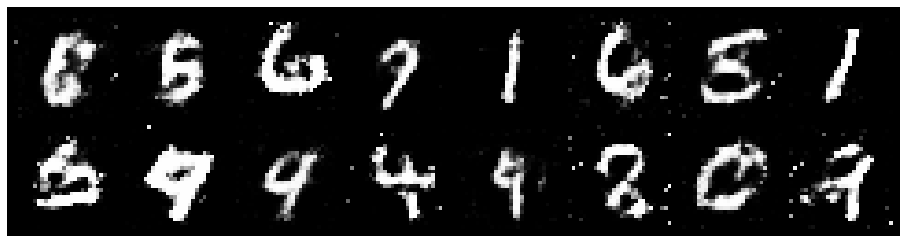

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.3733, Generator Loss: 1.0728
D(x): 0.5904, D(G(z)): 0.4602


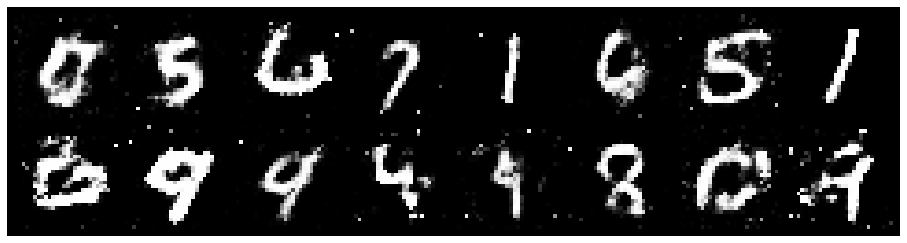

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.3506, Generator Loss: 0.8288
D(x): 0.6005, D(G(z)): 0.5087


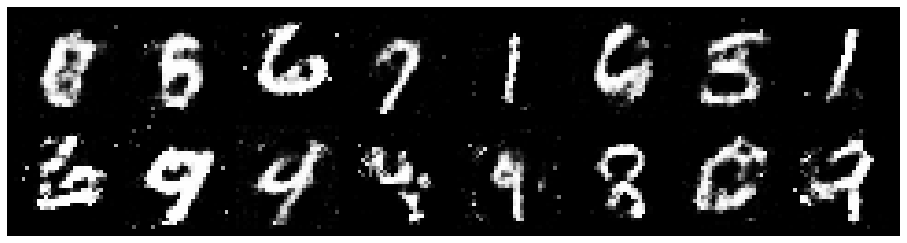

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1659, Generator Loss: 0.9493
D(x): 0.6023, D(G(z)): 0.4039


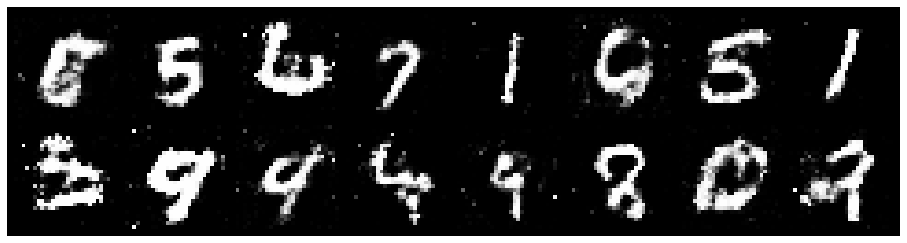

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1851, Generator Loss: 1.1369
D(x): 0.5768, D(G(z)): 0.3971


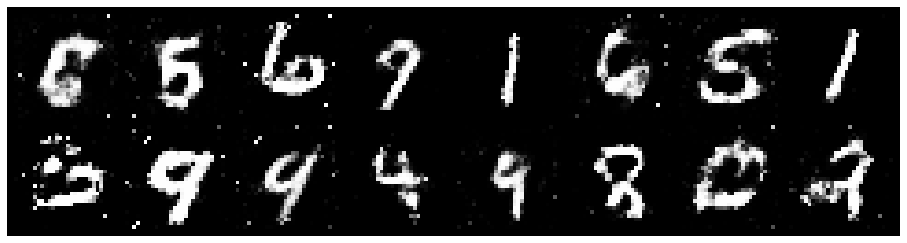

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.2134, Generator Loss: 0.9424
D(x): 0.6199, D(G(z)): 0.4557


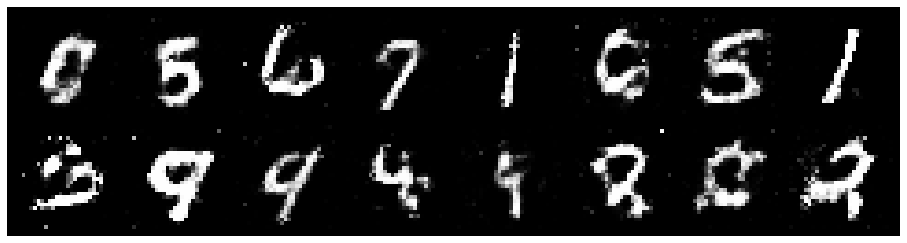

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.0473, Generator Loss: 1.2396
D(x): 0.6034, D(G(z)): 0.3587


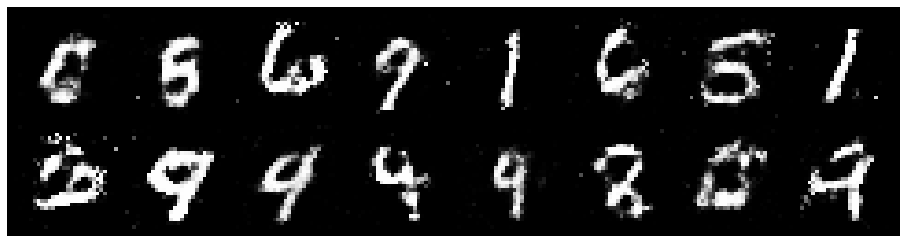

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1922, Generator Loss: 1.1439
D(x): 0.5763, D(G(z)): 0.3989


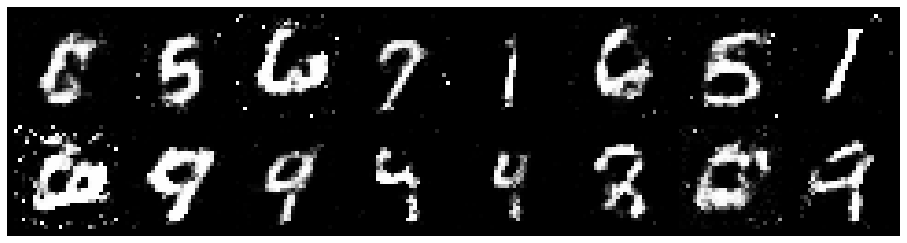

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1757, Generator Loss: 0.9133
D(x): 0.5627, D(G(z)): 0.4058


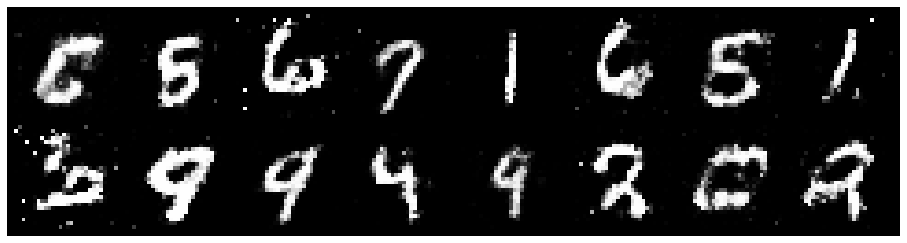

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2032, Generator Loss: 0.9735
D(x): 0.5140, D(G(z)): 0.3590


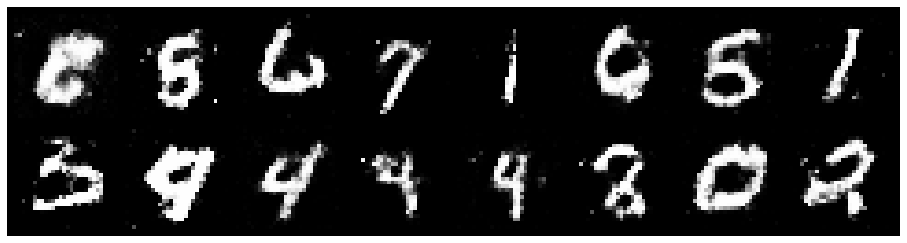

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1906, Generator Loss: 0.9947
D(x): 0.5102, D(G(z)): 0.3462


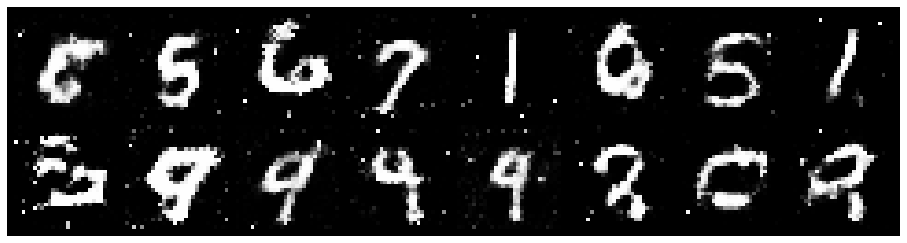

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.3880, Generator Loss: 1.0807
D(x): 0.5382, D(G(z)): 0.4221


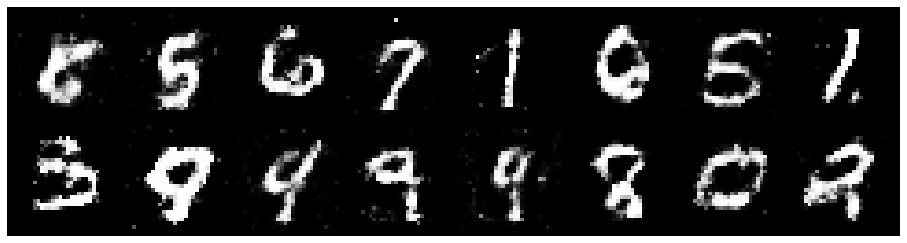

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.0899, Generator Loss: 0.9019
D(x): 0.6706, D(G(z)): 0.4341


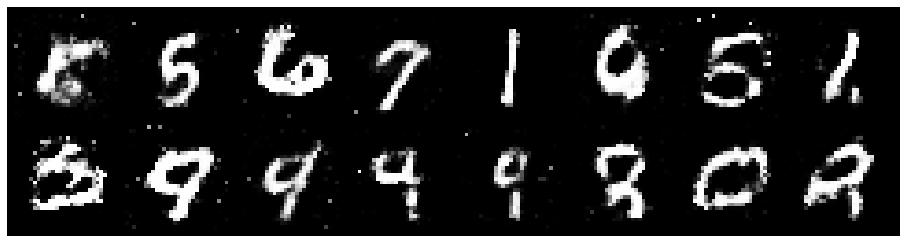

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1579, Generator Loss: 0.9876
D(x): 0.5520, D(G(z)): 0.3791


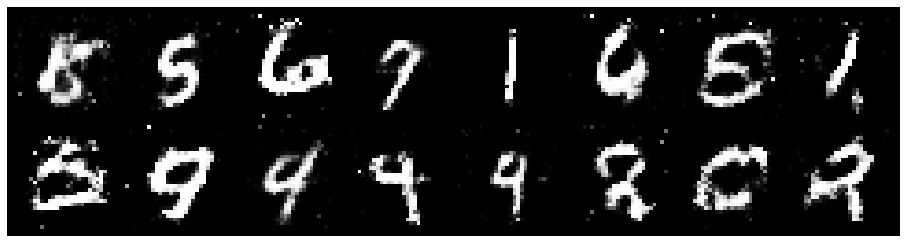

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.2712, Generator Loss: 0.8877
D(x): 0.6188, D(G(z)): 0.4690


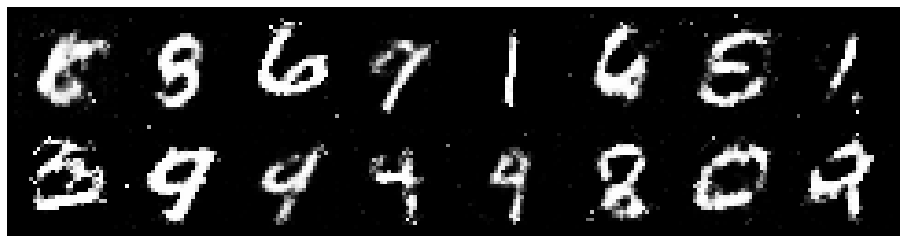

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.1846, Generator Loss: 0.8986
D(x): 0.5943, D(G(z)): 0.4288


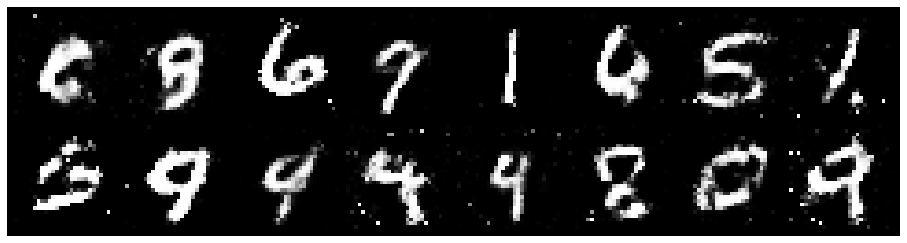

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.0435, Generator Loss: 1.1202
D(x): 0.6142, D(G(z)): 0.3567


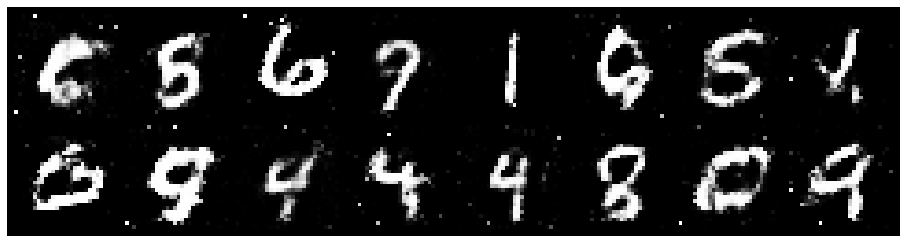

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2294, Generator Loss: 0.8866
D(x): 0.5825, D(G(z)): 0.4297


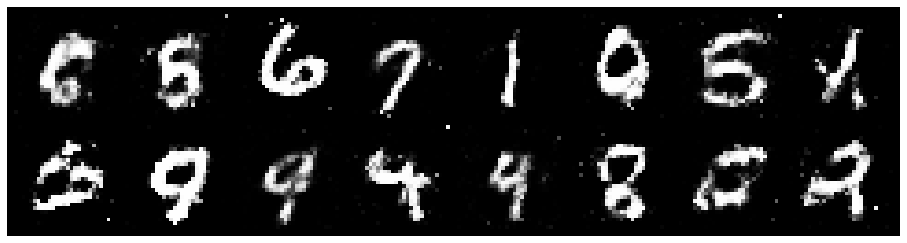

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.3222, Generator Loss: 0.9506
D(x): 0.6054, D(G(z)): 0.4755


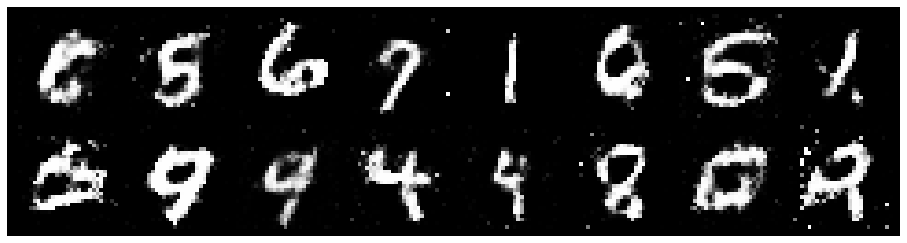

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.2980, Generator Loss: 1.0650
D(x): 0.5215, D(G(z)): 0.3762


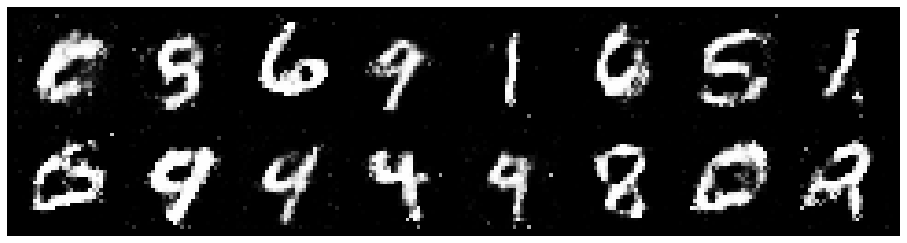

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.3944, Generator Loss: 0.8926
D(x): 0.5356, D(G(z)): 0.4733


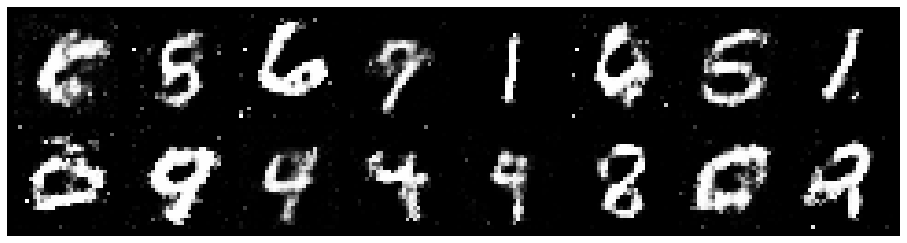

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1132, Generator Loss: 1.1247
D(x): 0.6153, D(G(z)): 0.4015


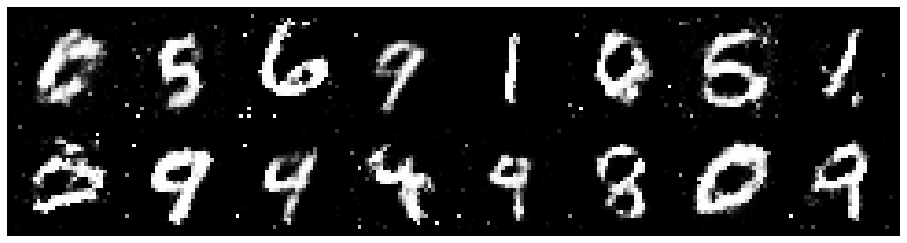

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1891, Generator Loss: 1.2344
D(x): 0.5760, D(G(z)): 0.3646


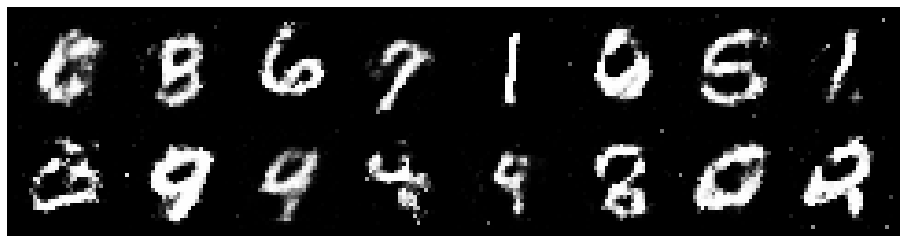

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2981, Generator Loss: 0.9657
D(x): 0.5479, D(G(z)): 0.4064


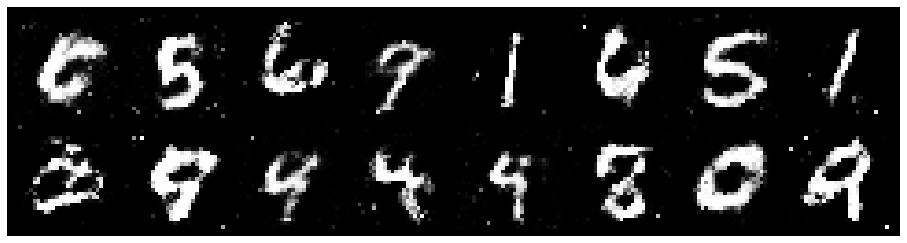

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2958, Generator Loss: 1.1083
D(x): 0.5147, D(G(z)): 0.3626


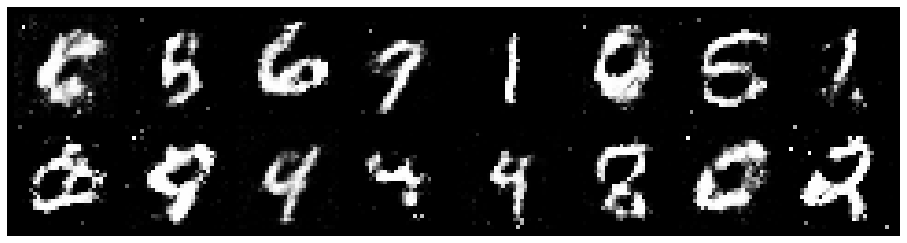

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2622, Generator Loss: 0.8885
D(x): 0.5617, D(G(z)): 0.4334


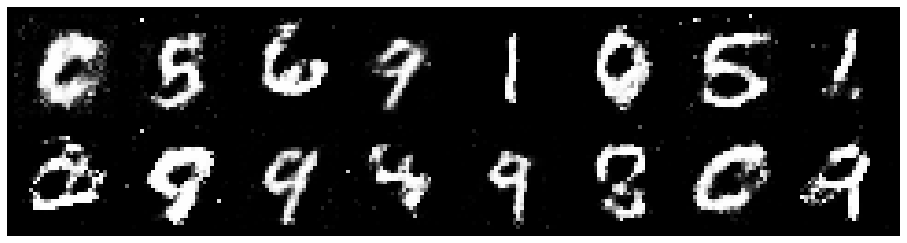

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.3657, Generator Loss: 0.8169
D(x): 0.5222, D(G(z)): 0.4457


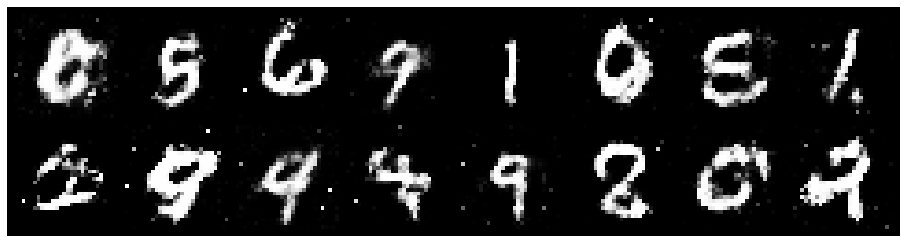

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2177, Generator Loss: 0.8662
D(x): 0.6566, D(G(z)): 0.4644


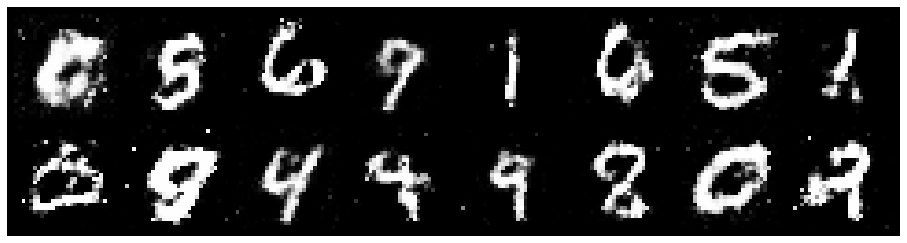

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2718, Generator Loss: 1.0170
D(x): 0.5640, D(G(z)): 0.4149


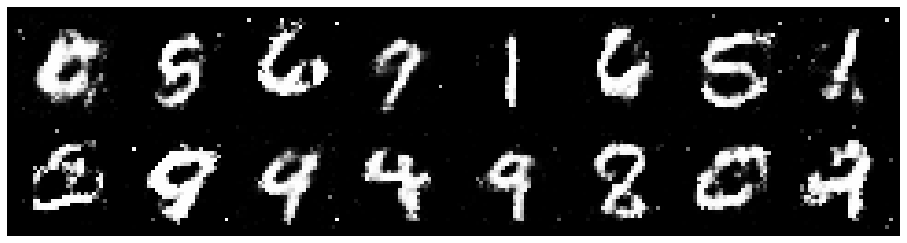

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2997, Generator Loss: 0.9488
D(x): 0.5905, D(G(z)): 0.4390


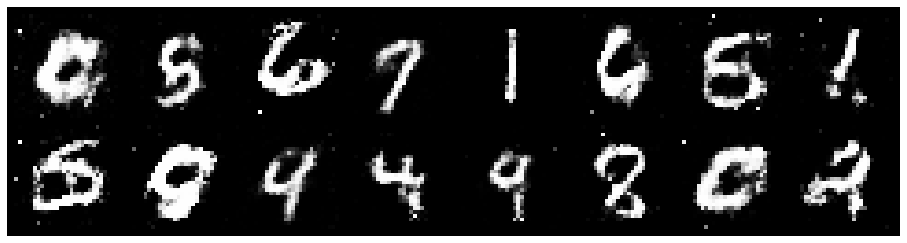

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2134, Generator Loss: 1.1612
D(x): 0.6386, D(G(z)): 0.4414


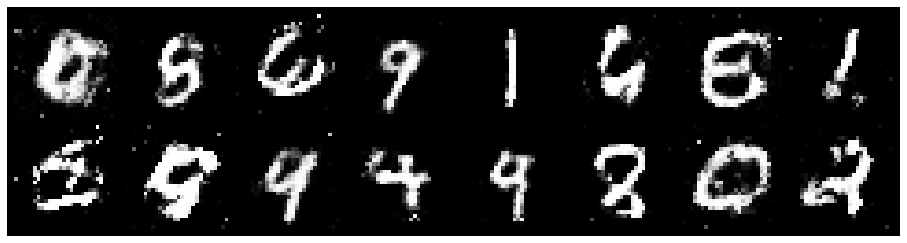

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2493, Generator Loss: 0.9159
D(x): 0.6003, D(G(z)): 0.4559


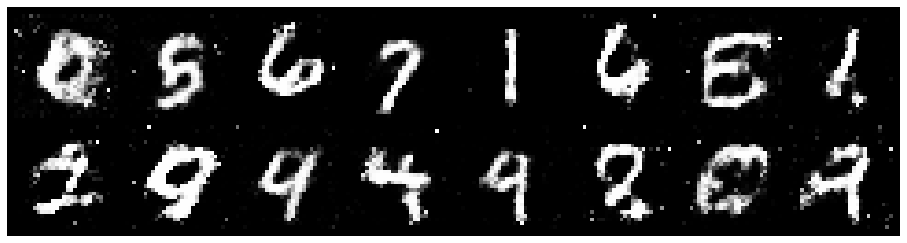

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.1147, Generator Loss: 1.1496
D(x): 0.5800, D(G(z)): 0.3682


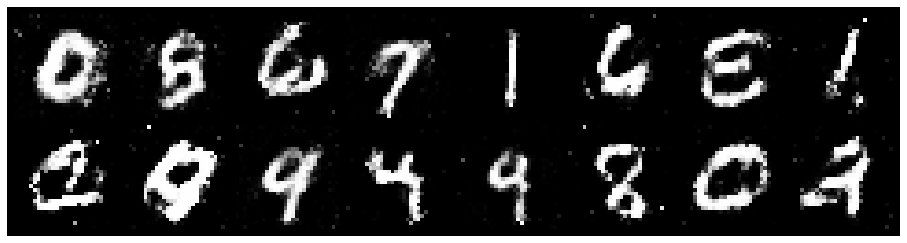

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.0163, Generator Loss: 1.1197
D(x): 0.6374, D(G(z)): 0.3880


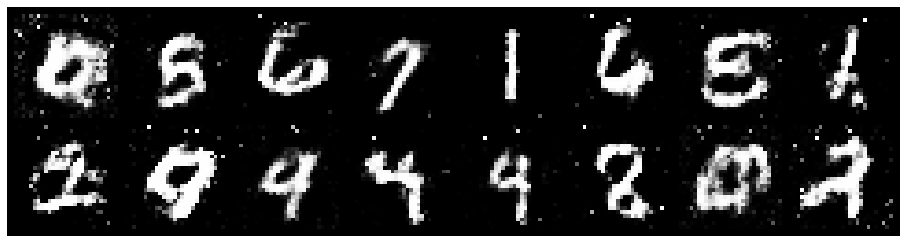

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2518, Generator Loss: 0.9241
D(x): 0.5782, D(G(z)): 0.4294


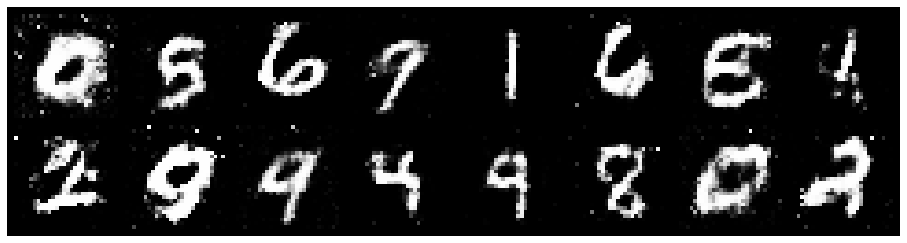

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.3061, Generator Loss: 0.7026
D(x): 0.6431, D(G(z)): 0.5146


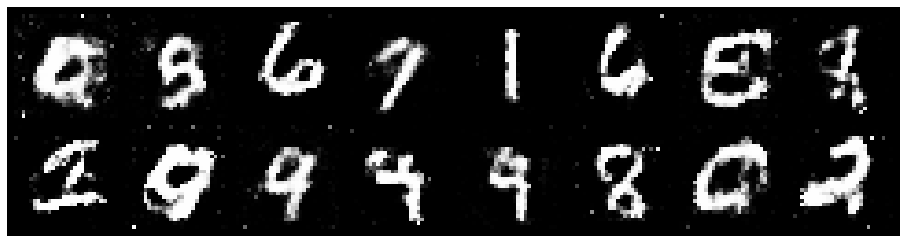

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2665, Generator Loss: 0.8364
D(x): 0.5726, D(G(z)): 0.4469


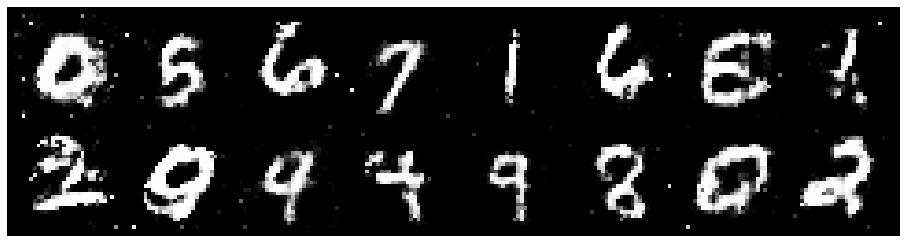

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2656, Generator Loss: 0.9996
D(x): 0.5908, D(G(z)): 0.4260


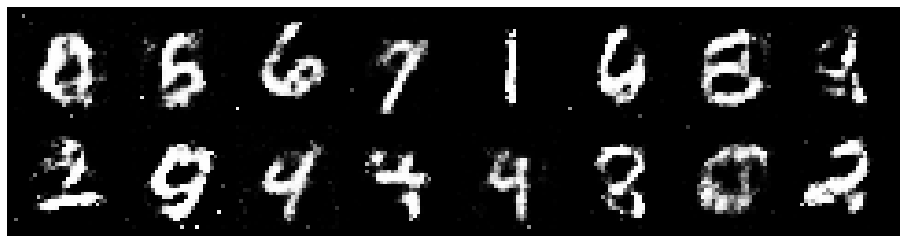

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1313, Generator Loss: 1.0452
D(x): 0.6213, D(G(z)): 0.4200


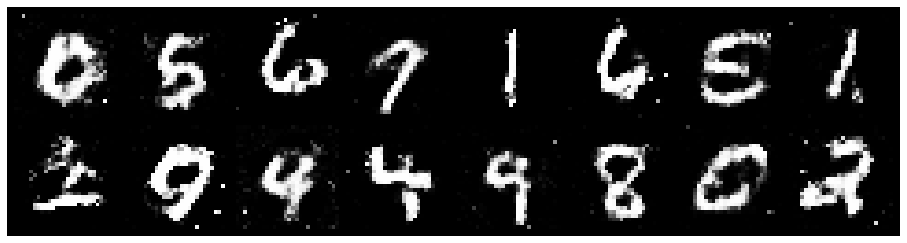

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.2379, Generator Loss: 0.9222
D(x): 0.5512, D(G(z)): 0.4242


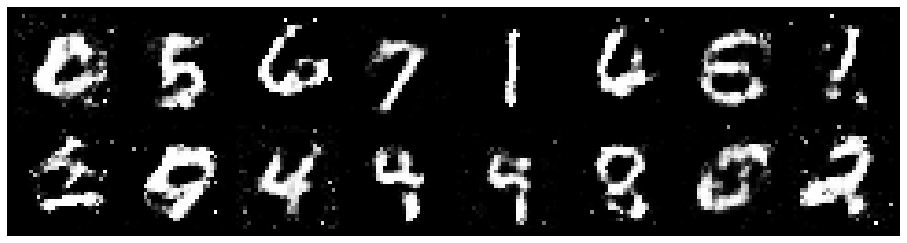

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.3220, Generator Loss: 0.8275
D(x): 0.5150, D(G(z)): 0.4356


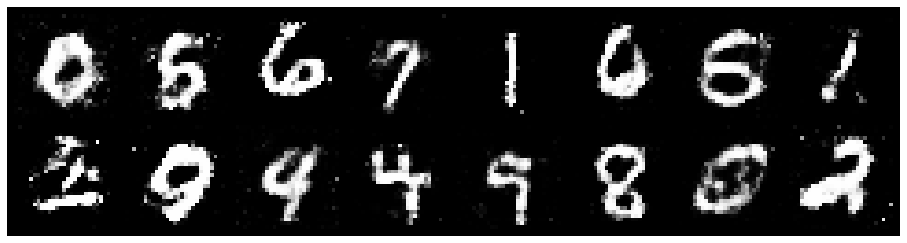

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2621, Generator Loss: 0.9136
D(x): 0.5397, D(G(z)): 0.4275


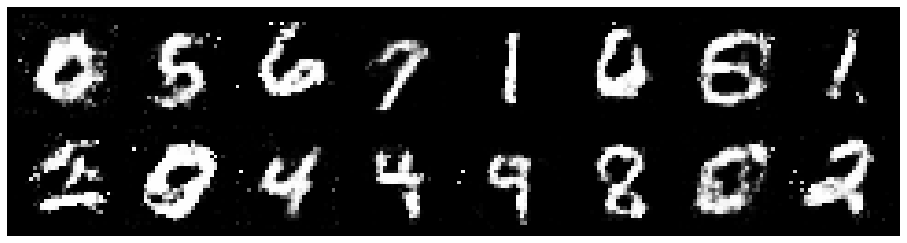

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.1863, Generator Loss: 1.1235
D(x): 0.6254, D(G(z)): 0.4425


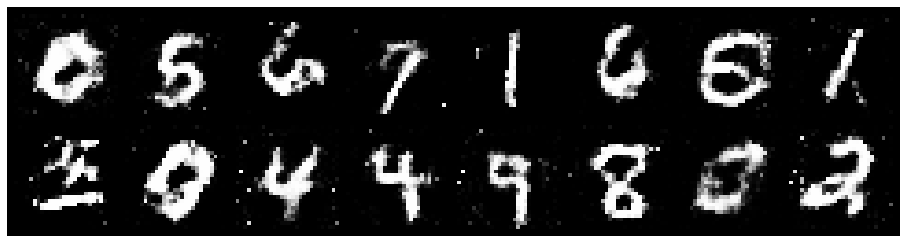

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.0823, Generator Loss: 1.1018
D(x): 0.5861, D(G(z)): 0.3601


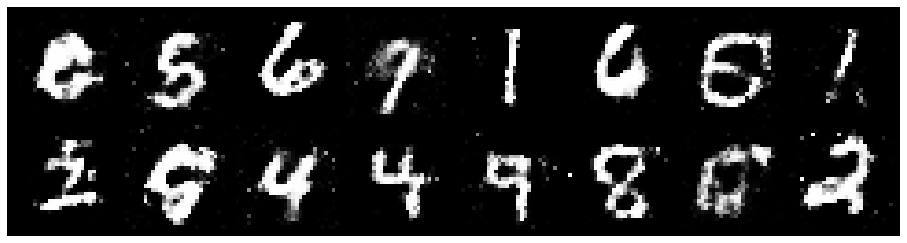

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2312, Generator Loss: 0.9989
D(x): 0.6502, D(G(z)): 0.4816


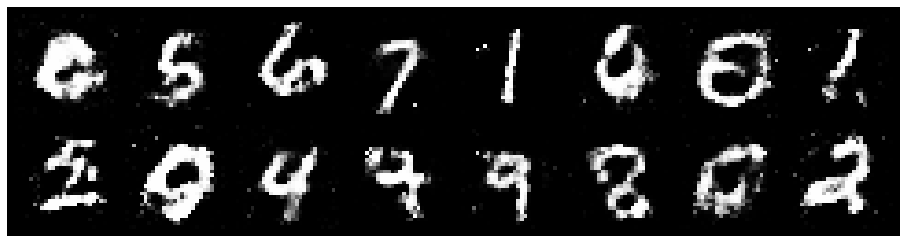

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1699, Generator Loss: 0.9730
D(x): 0.5901, D(G(z)): 0.4143


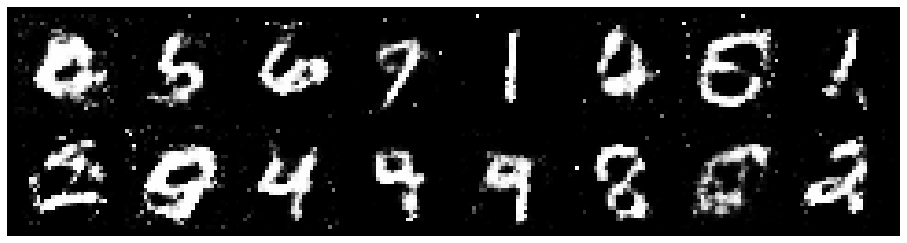

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1594, Generator Loss: 1.0222
D(x): 0.6226, D(G(z)): 0.4220


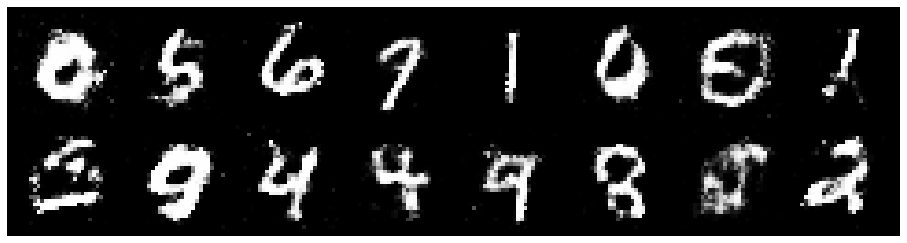

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.0747, Generator Loss: 1.0342
D(x): 0.5875, D(G(z)): 0.3567


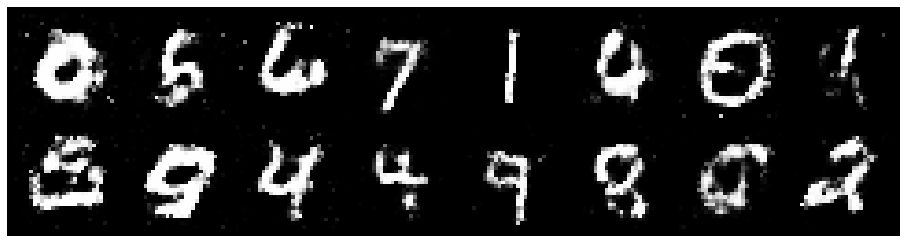

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2415, Generator Loss: 0.8703
D(x): 0.5693, D(G(z)): 0.4327


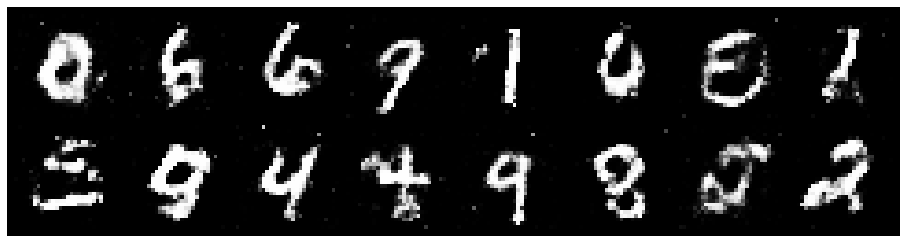

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.3722, Generator Loss: 1.0033
D(x): 0.5241, D(G(z)): 0.4215


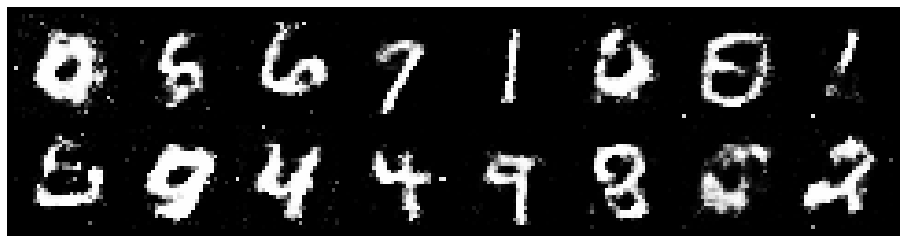

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.1553, Generator Loss: 0.9431
D(x): 0.5976, D(G(z)): 0.4196


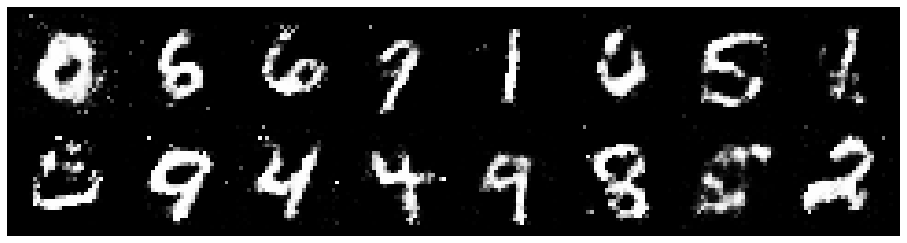

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1994, Generator Loss: 1.0972
D(x): 0.5217, D(G(z)): 0.3547


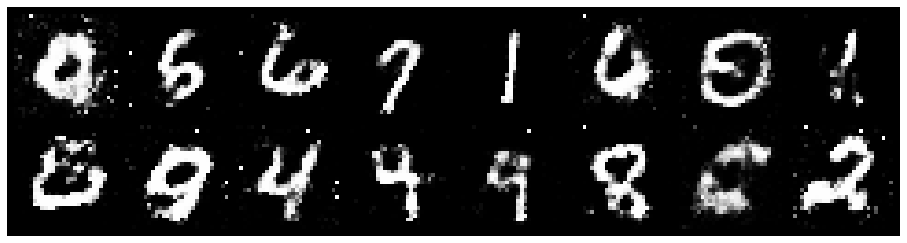

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.0722, Generator Loss: 1.0694
D(x): 0.5853, D(G(z)): 0.3435


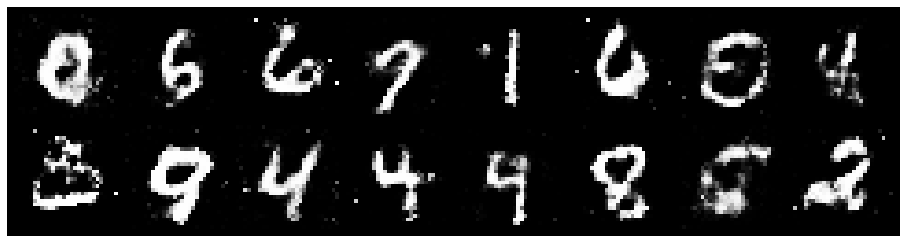

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.1577, Generator Loss: 1.0846
D(x): 0.6107, D(G(z)): 0.3841


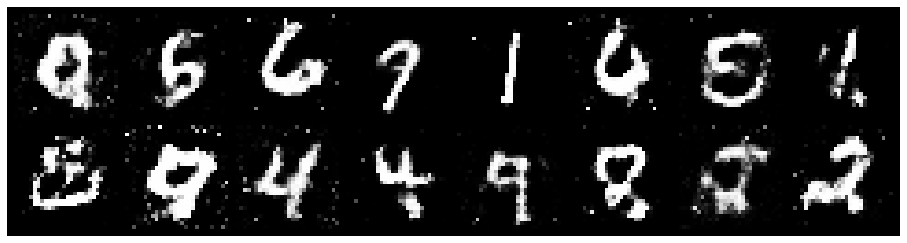

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.2397, Generator Loss: 1.1771
D(x): 0.5555, D(G(z)): 0.3939


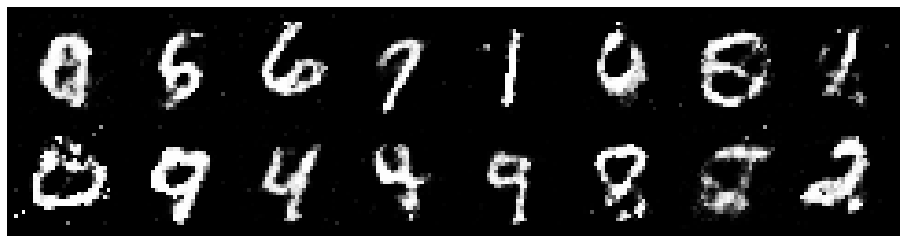

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1586, Generator Loss: 0.8234
D(x): 0.5999, D(G(z)): 0.4246


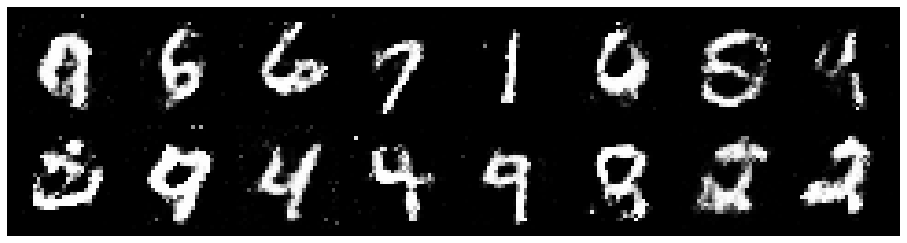

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.1898, Generator Loss: 0.9558
D(x): 0.5938, D(G(z)): 0.4469


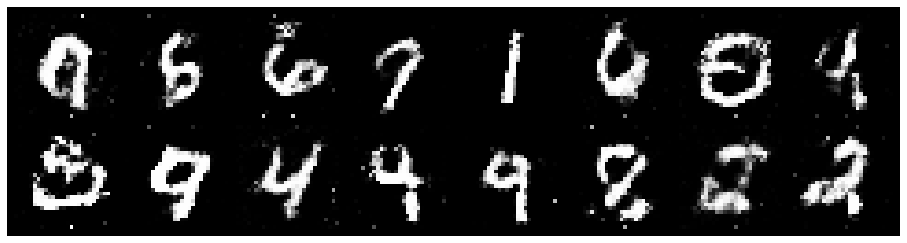

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.2900, Generator Loss: 0.9339
D(x): 0.6010, D(G(z)): 0.4611


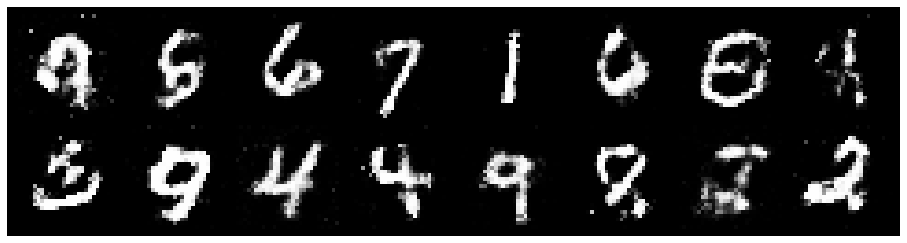

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.2233, Generator Loss: 1.0011
D(x): 0.6175, D(G(z)): 0.4504


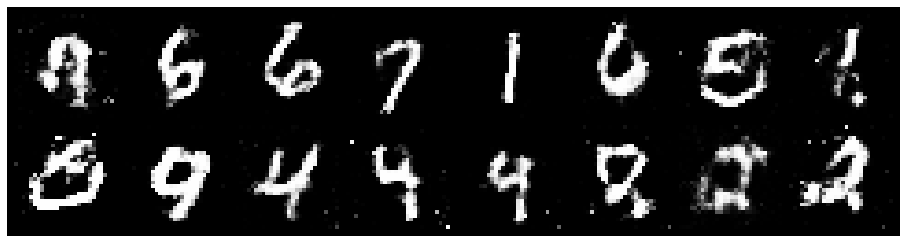

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1959, Generator Loss: 1.1000
D(x): 0.6568, D(G(z)): 0.4446


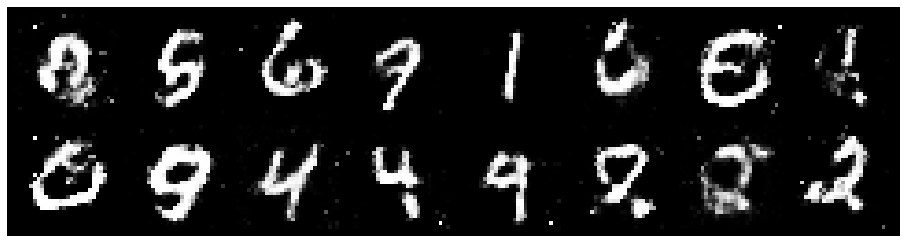

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.4495, Generator Loss: 1.0052
D(x): 0.5583, D(G(z)): 0.4937


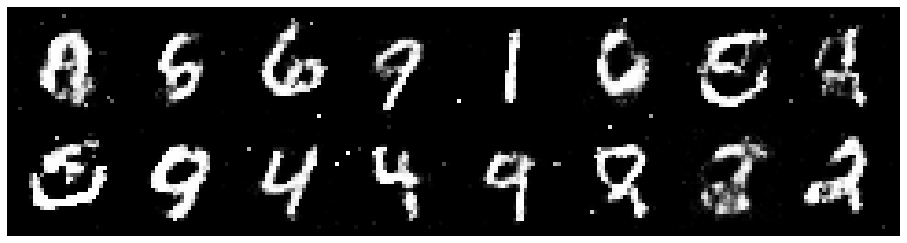

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2038, Generator Loss: 1.0177
D(x): 0.5531, D(G(z)): 0.3817


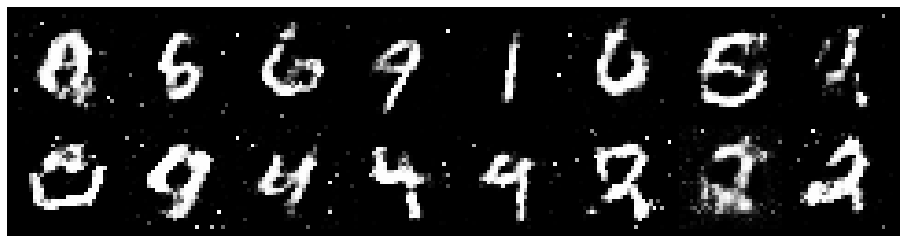

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2045, Generator Loss: 0.9492
D(x): 0.5832, D(G(z)): 0.4338


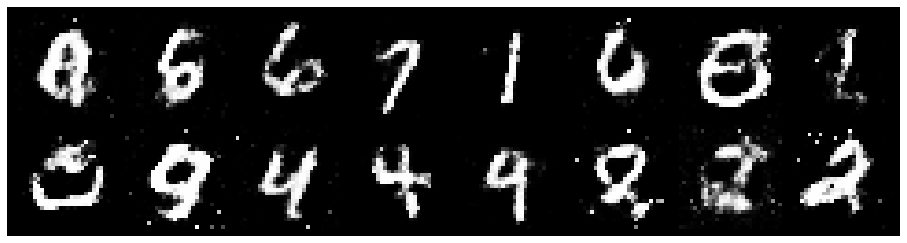

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.4920, Generator Loss: 0.8603
D(x): 0.6153, D(G(z)): 0.5506


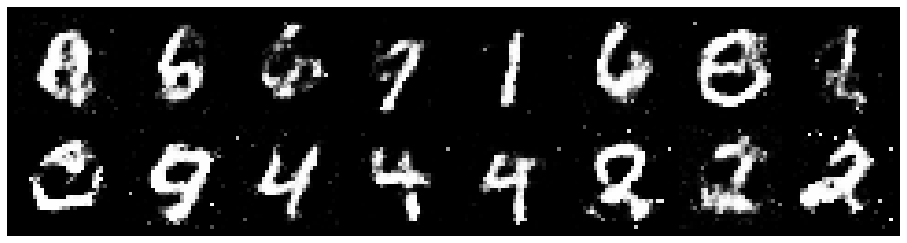

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.2347, Generator Loss: 0.8599
D(x): 0.5857, D(G(z)): 0.4490


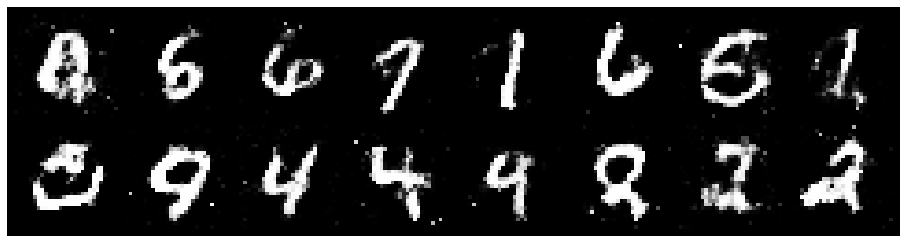

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.2670, Generator Loss: 0.8073
D(x): 0.5712, D(G(z)): 0.4470


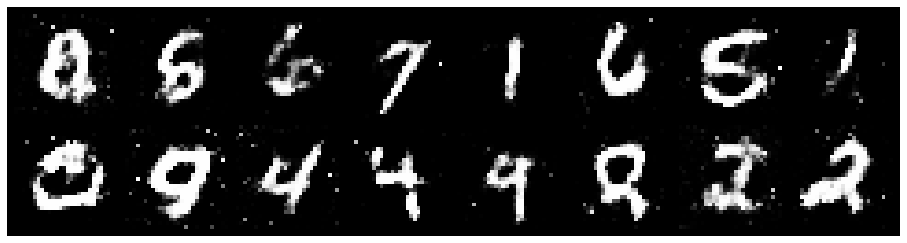

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.1846, Generator Loss: 0.8119
D(x): 0.6061, D(G(z)): 0.4499


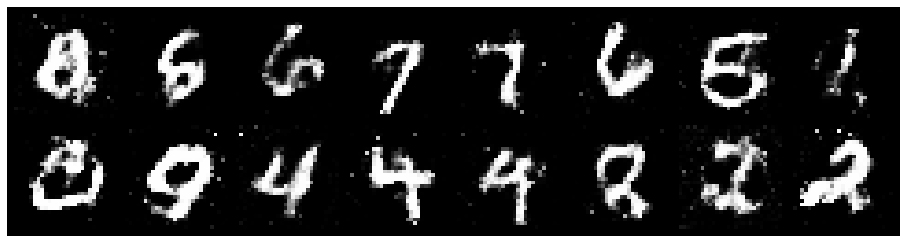

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1540, Generator Loss: 0.9444
D(x): 0.5727, D(G(z)): 0.3965


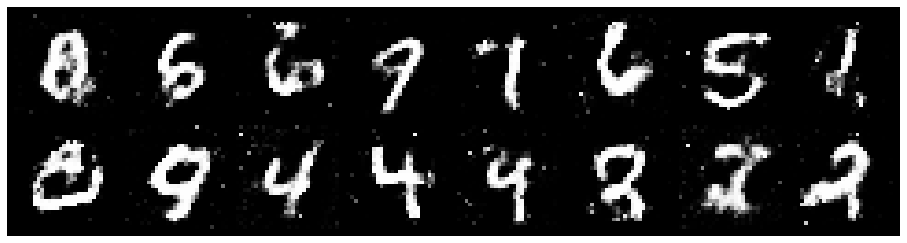

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2300, Generator Loss: 0.9416
D(x): 0.5158, D(G(z)): 0.3905


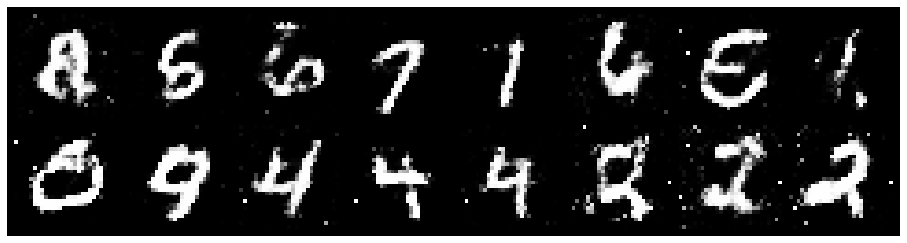

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1118, Generator Loss: 0.9838
D(x): 0.5884, D(G(z)): 0.3914


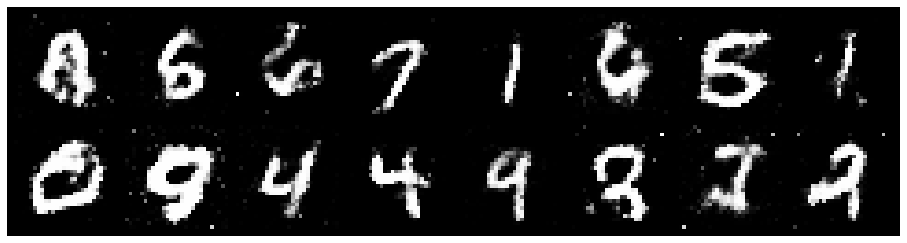

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.2421, Generator Loss: 0.9587
D(x): 0.5452, D(G(z)): 0.4174


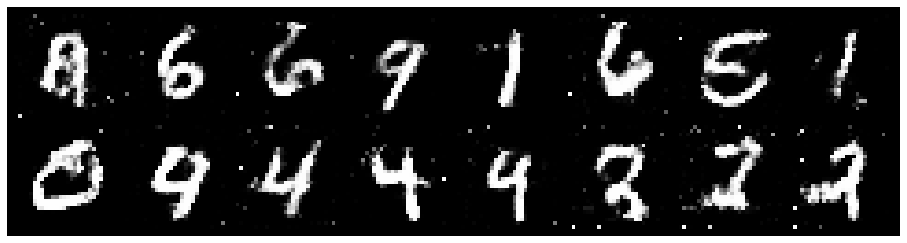

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2321, Generator Loss: 0.8960
D(x): 0.5741, D(G(z)): 0.4370


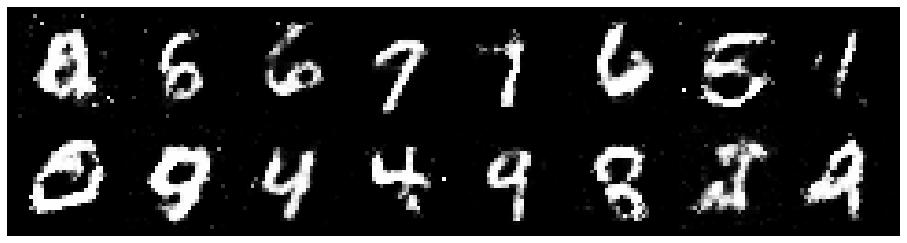

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2233, Generator Loss: 0.9686
D(x): 0.5683, D(G(z)): 0.3956


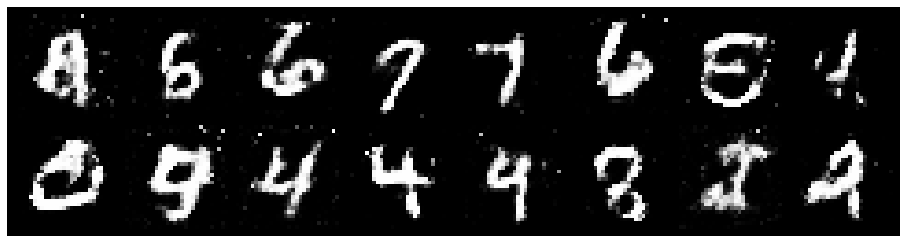

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1919, Generator Loss: 0.9164
D(x): 0.5819, D(G(z)): 0.4198


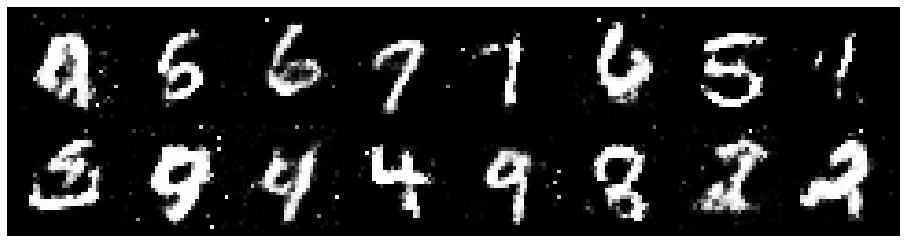

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2313, Generator Loss: 0.8833
D(x): 0.5682, D(G(z)): 0.4353


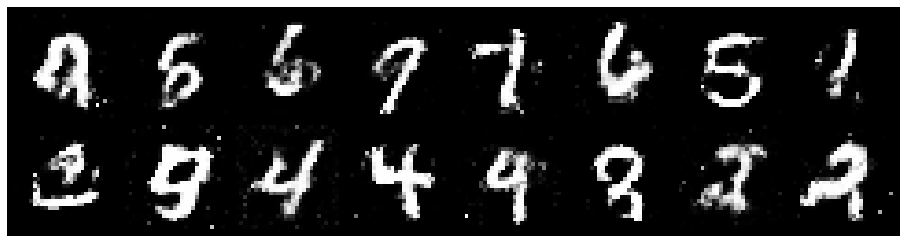

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2481, Generator Loss: 0.8936
D(x): 0.5586, D(G(z)): 0.4238


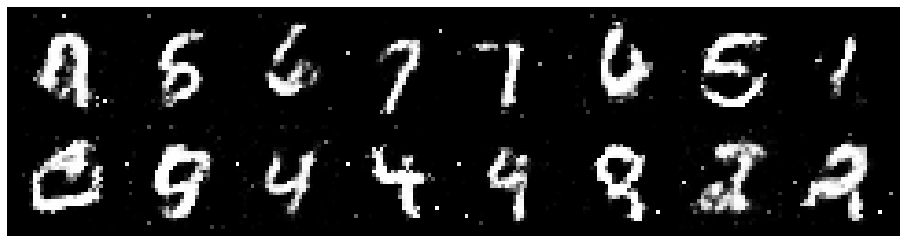

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2174, Generator Loss: 0.8377
D(x): 0.5944, D(G(z)): 0.4433


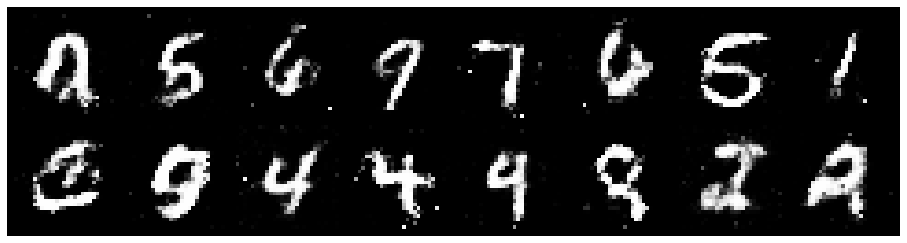

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2914, Generator Loss: 1.0562
D(x): 0.5790, D(G(z)): 0.4739


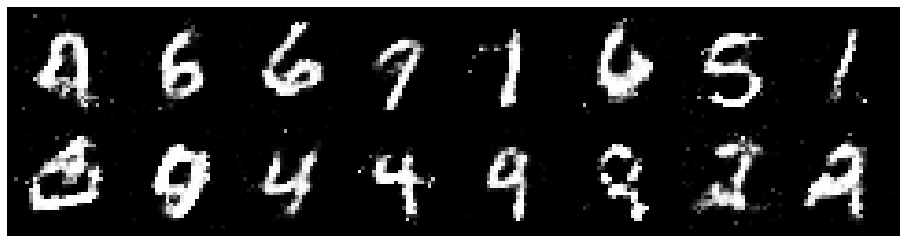

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2477, Generator Loss: 0.8071
D(x): 0.5658, D(G(z)): 0.4499


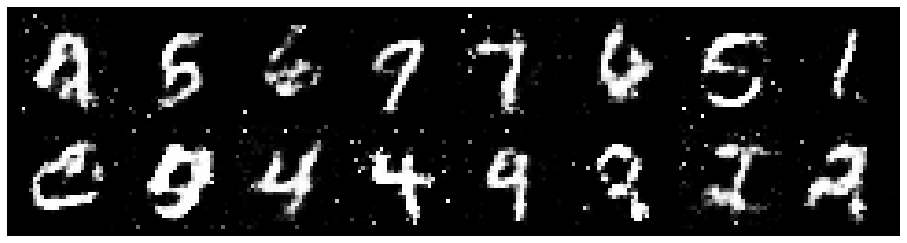

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1230, Generator Loss: 1.0239
D(x): 0.6081, D(G(z)): 0.4066


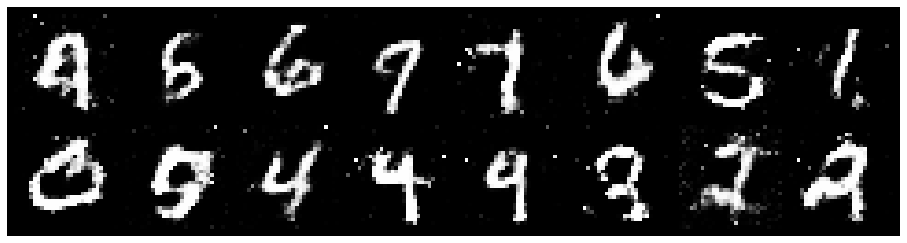

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2096, Generator Loss: 0.9619
D(x): 0.5426, D(G(z)): 0.3811


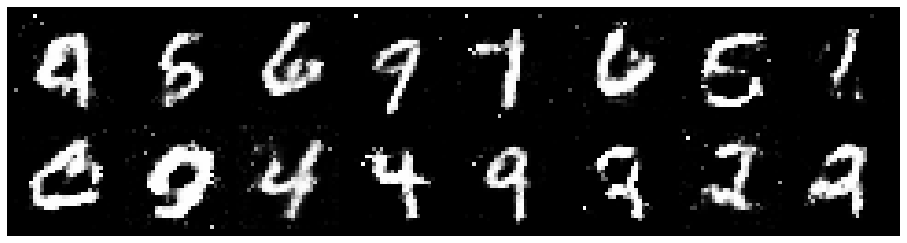

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2384, Generator Loss: 0.9792
D(x): 0.5802, D(G(z)): 0.4377


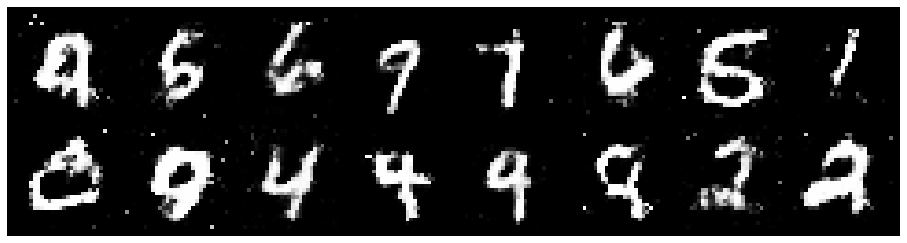

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.2205, Generator Loss: 0.9827
D(x): 0.5727, D(G(z)): 0.4325


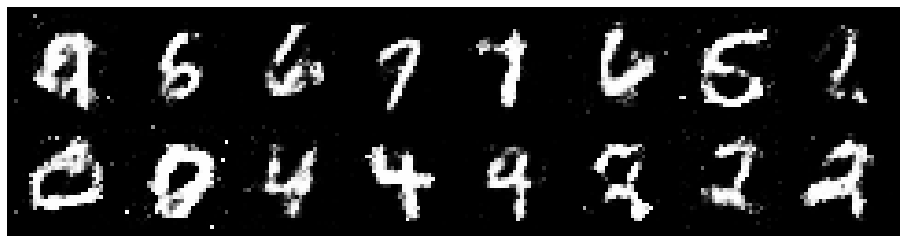

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1665, Generator Loss: 0.9889
D(x): 0.5709, D(G(z)): 0.4162


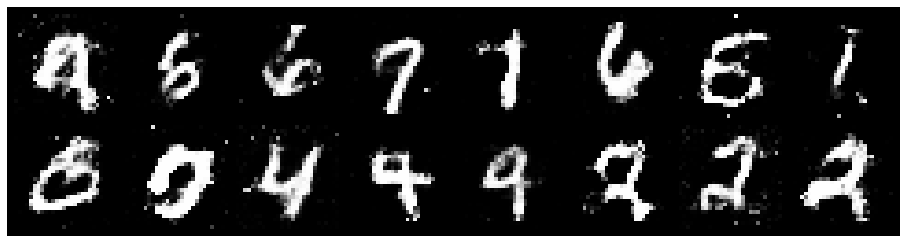

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2641, Generator Loss: 0.7828
D(x): 0.5853, D(G(z)): 0.4714


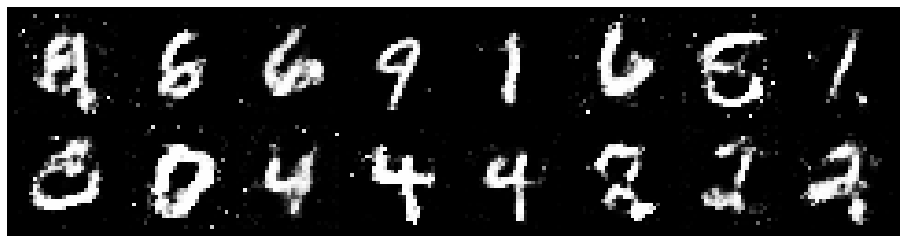

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1675, Generator Loss: 0.9611
D(x): 0.5414, D(G(z)): 0.3897


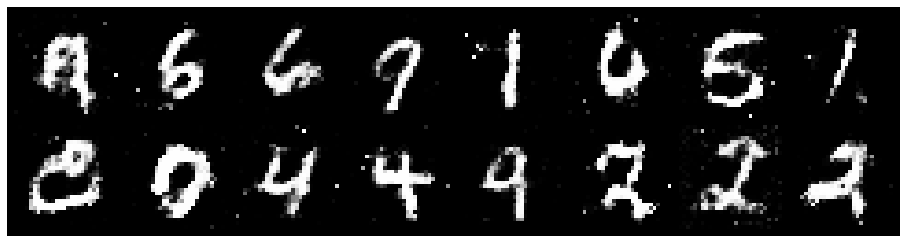

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.0372, Generator Loss: 1.2330
D(x): 0.6616, D(G(z)): 0.3597


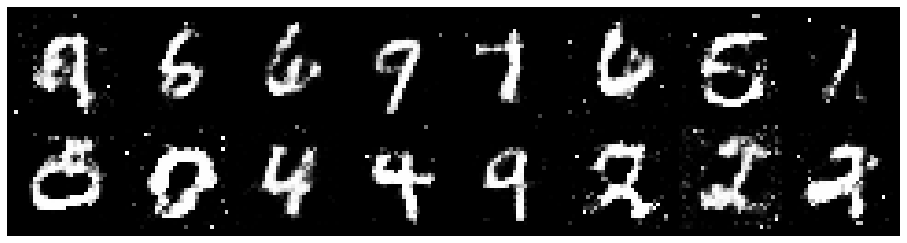

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.0628, Generator Loss: 1.0750
D(x): 0.6090, D(G(z)): 0.3742


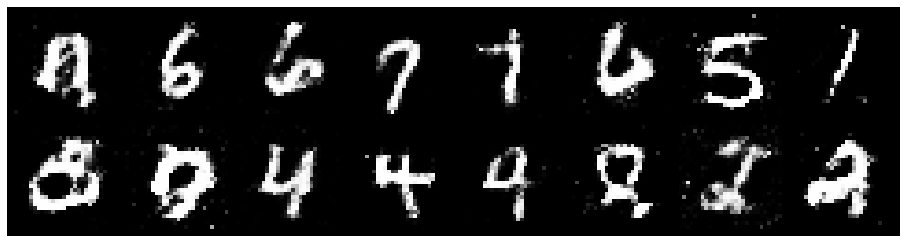

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1208, Generator Loss: 1.1321
D(x): 0.5847, D(G(z)): 0.3393


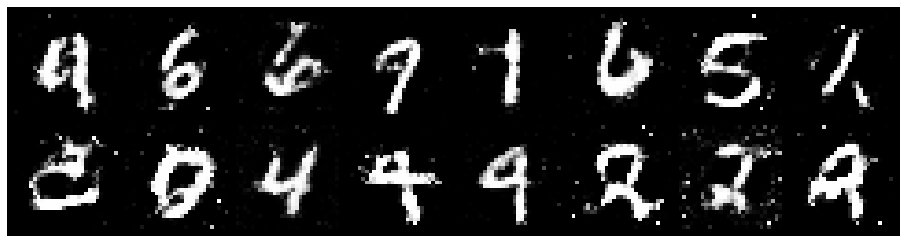

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8971
D(x): 0.5521, D(G(z)): 0.4188


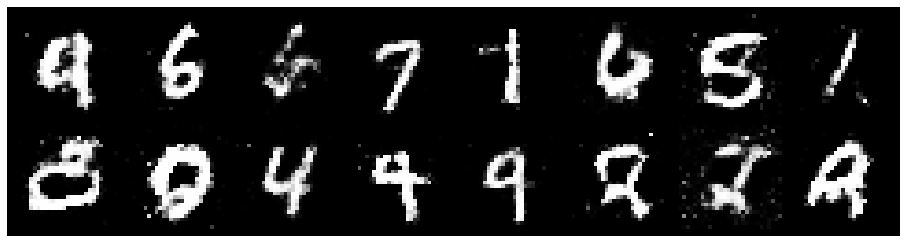

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2179, Generator Loss: 0.8853
D(x): 0.5731, D(G(z)): 0.4488


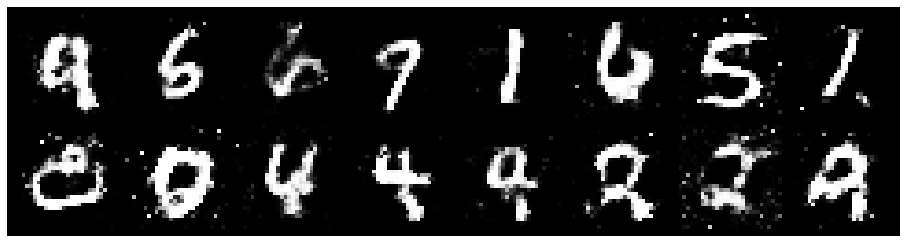

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2761, Generator Loss: 0.9007
D(x): 0.5471, D(G(z)): 0.4317


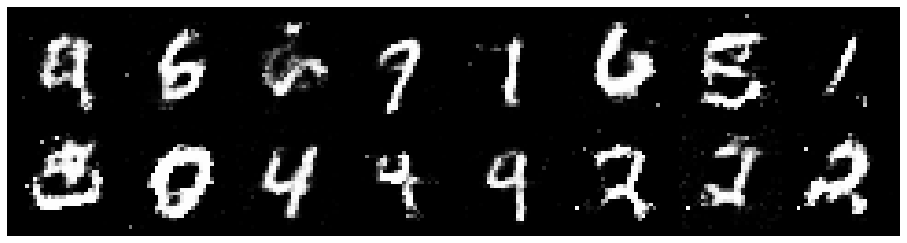

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8324
D(x): 0.5659, D(G(z)): 0.4569


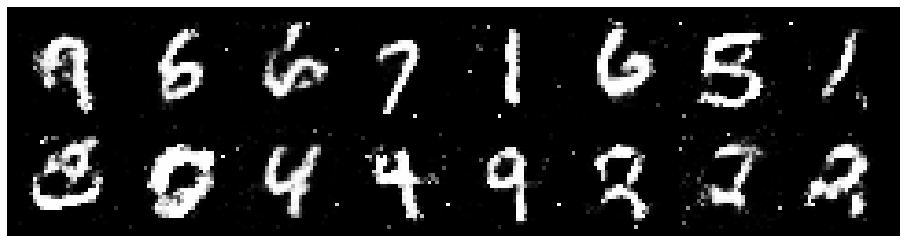

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2390, Generator Loss: 0.7967
D(x): 0.6002, D(G(z)): 0.4712


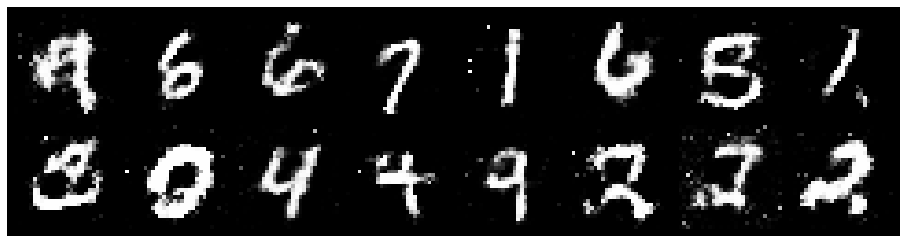

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.1629, Generator Loss: 1.1310
D(x): 0.6073, D(G(z)): 0.4416


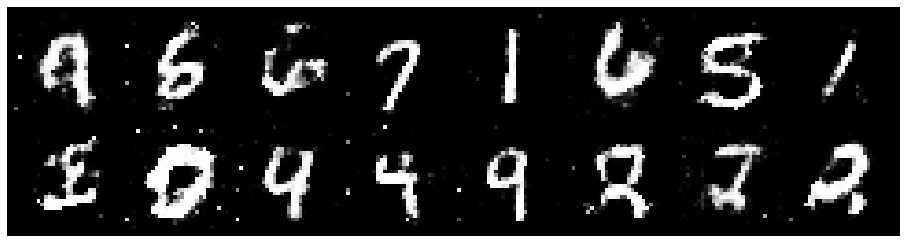

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2202, Generator Loss: 0.9804
D(x): 0.5854, D(G(z)): 0.4118


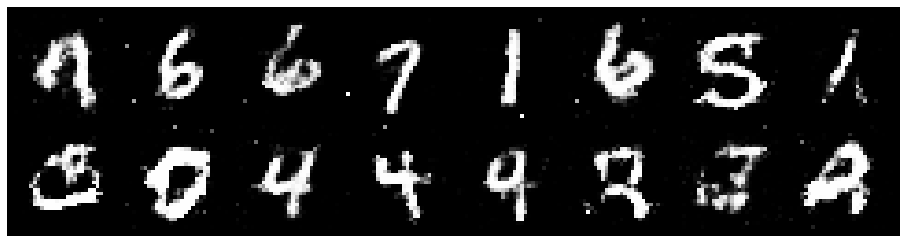

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2447, Generator Loss: 0.9304
D(x): 0.5457, D(G(z)): 0.4242


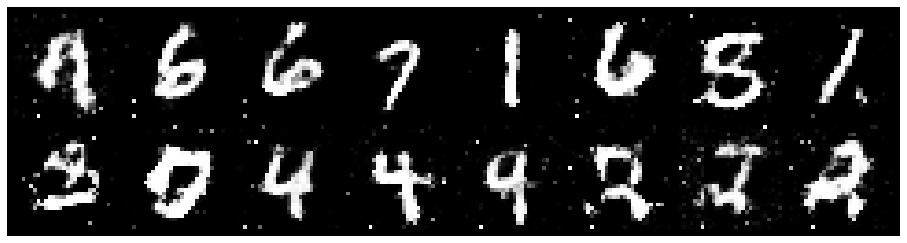

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2267, Generator Loss: 0.9469
D(x): 0.5438, D(G(z)): 0.3871


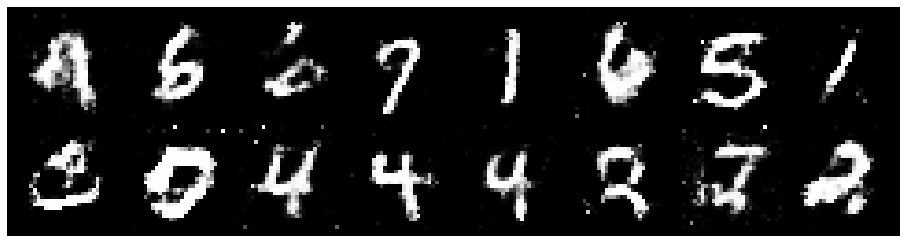

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9518
D(x): 0.5731, D(G(z)): 0.4280


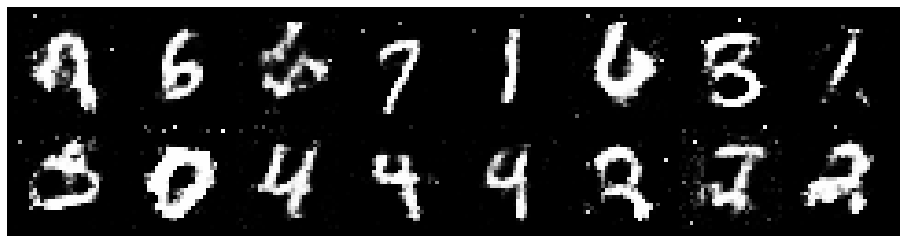

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.2290, Generator Loss: 1.1086
D(x): 0.5931, D(G(z)): 0.4257


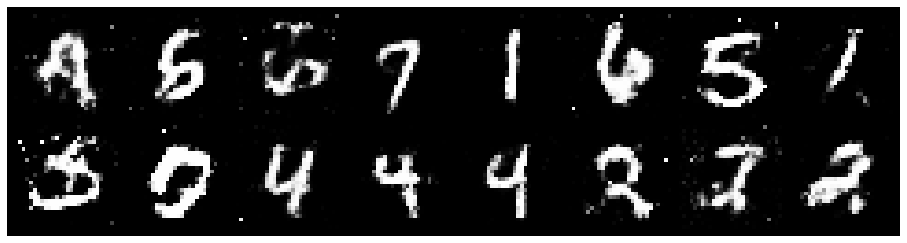

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2733, Generator Loss: 0.8950
D(x): 0.5597, D(G(z)): 0.4422


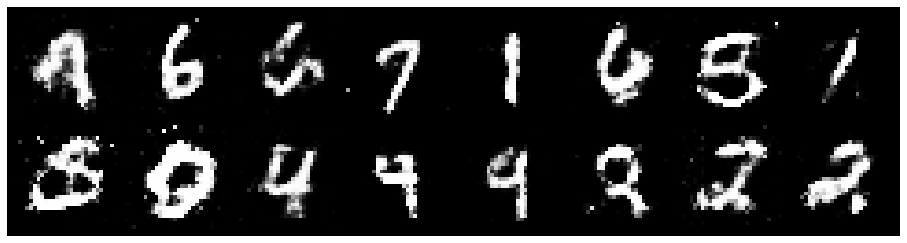

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2575, Generator Loss: 0.8582
D(x): 0.5763, D(G(z)): 0.4707


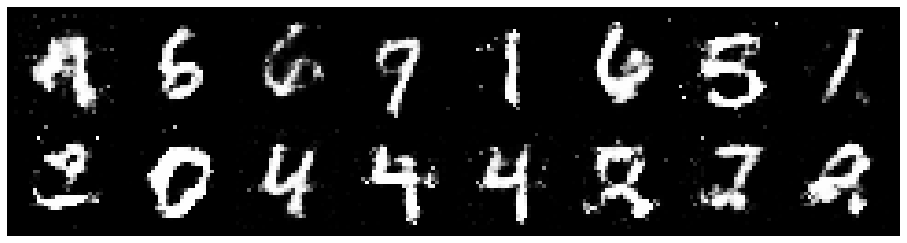

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.1998, Generator Loss: 0.9240
D(x): 0.5496, D(G(z)): 0.4109


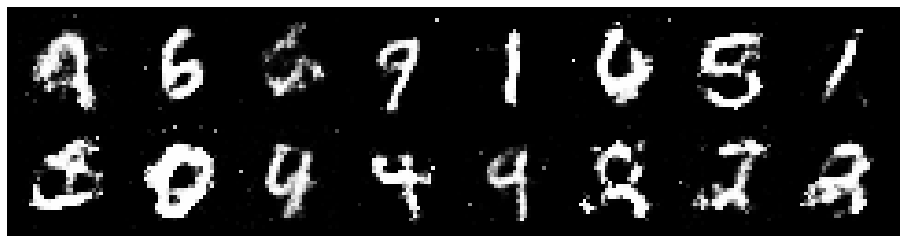

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2868, Generator Loss: 1.0882
D(x): 0.5805, D(G(z)): 0.4390


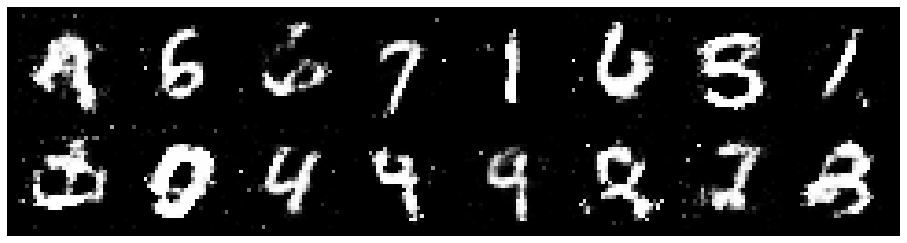

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2697, Generator Loss: 1.0401
D(x): 0.6068, D(G(z)): 0.4520


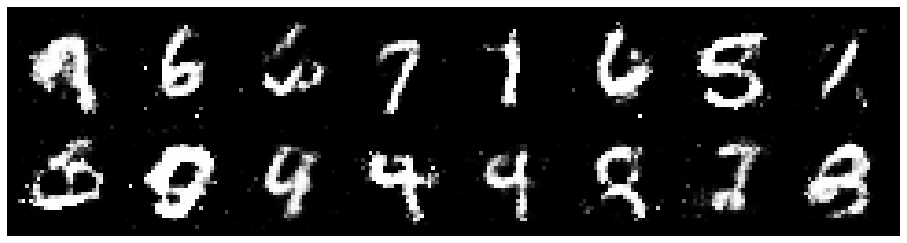

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 0.9718, Generator Loss: 1.1365
D(x): 0.6524, D(G(z)): 0.3741


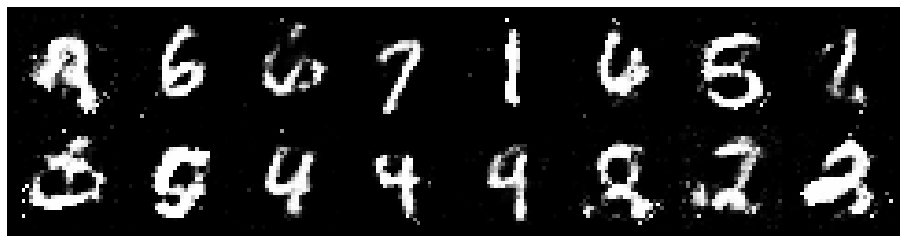

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2631, Generator Loss: 0.8000
D(x): 0.5720, D(G(z)): 0.4734


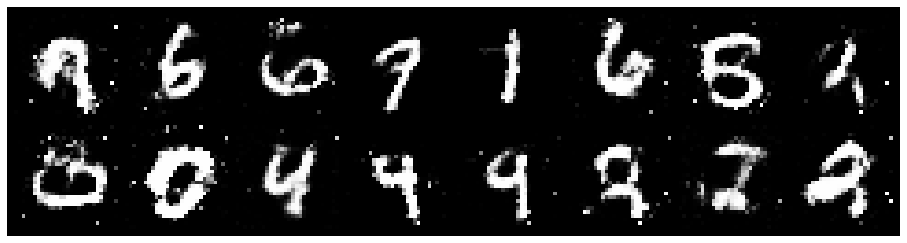

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.3116, Generator Loss: 0.8476
D(x): 0.5229, D(G(z)): 0.4497


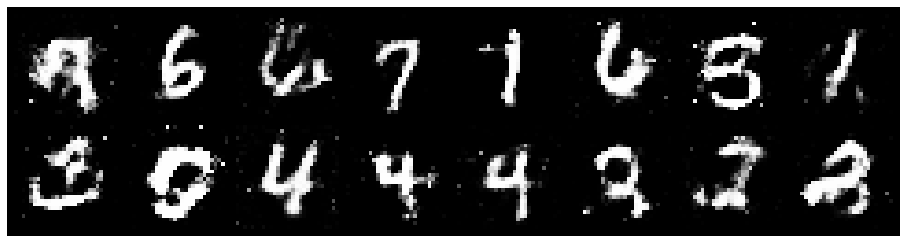

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2617, Generator Loss: 1.0718
D(x): 0.5770, D(G(z)): 0.4283


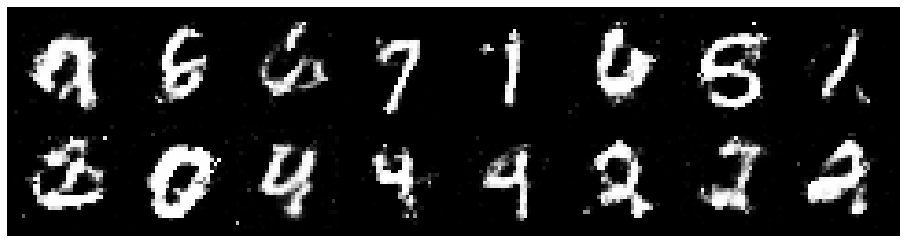

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2578, Generator Loss: 1.0502
D(x): 0.6151, D(G(z)): 0.4490


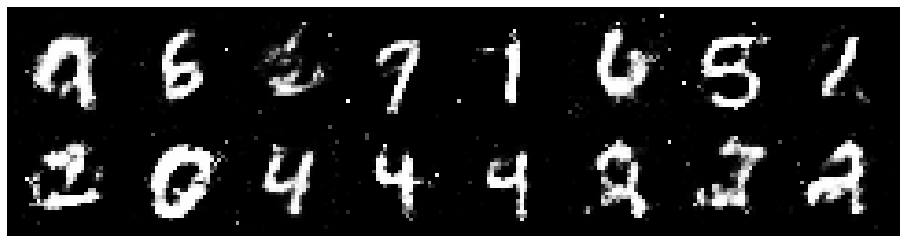

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.1962, Generator Loss: 1.2140
D(x): 0.5937, D(G(z)): 0.4169


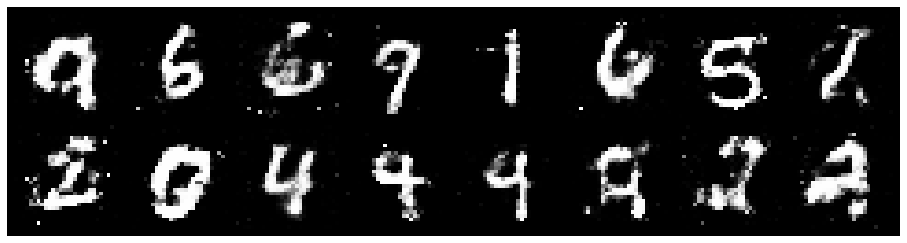

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.1646, Generator Loss: 1.2075
D(x): 0.5779, D(G(z)): 0.3872


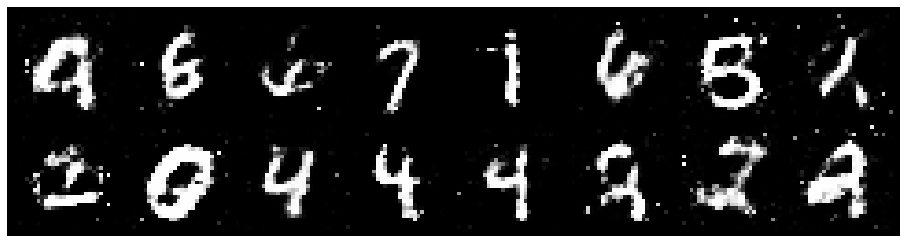

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.0981, Generator Loss: 1.1203
D(x): 0.6034, D(G(z)): 0.3778


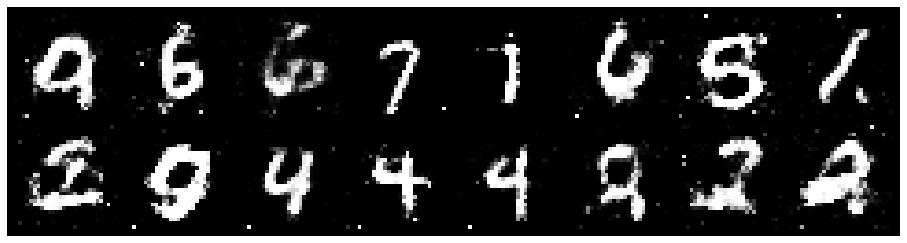

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.0954, Generator Loss: 0.9776
D(x): 0.6133, D(G(z)): 0.4116


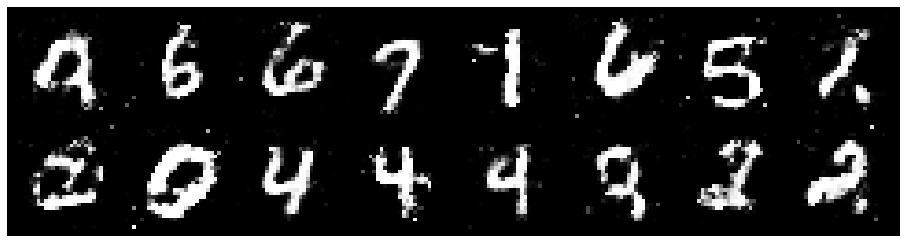

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.1690, Generator Loss: 1.1269
D(x): 0.6241, D(G(z)): 0.4183


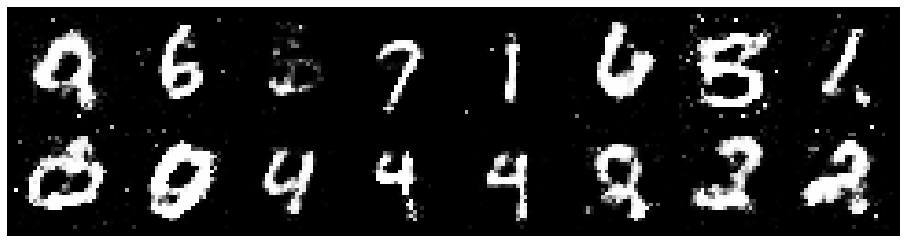

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.1255, Generator Loss: 0.9988
D(x): 0.5696, D(G(z)): 0.3714


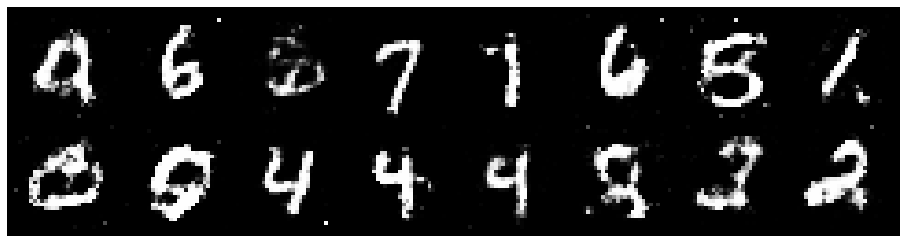

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2629, Generator Loss: 1.0146
D(x): 0.5614, D(G(z)): 0.4254


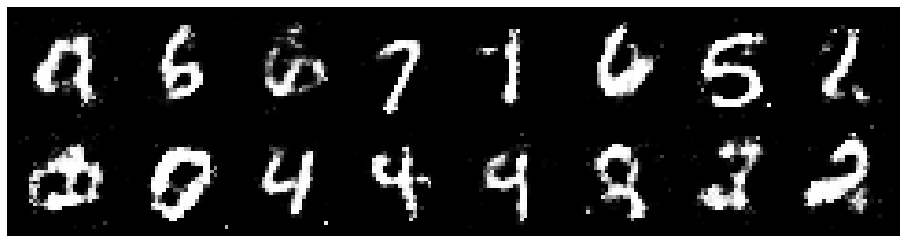

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2916, Generator Loss: 0.9855
D(x): 0.5883, D(G(z)): 0.4487


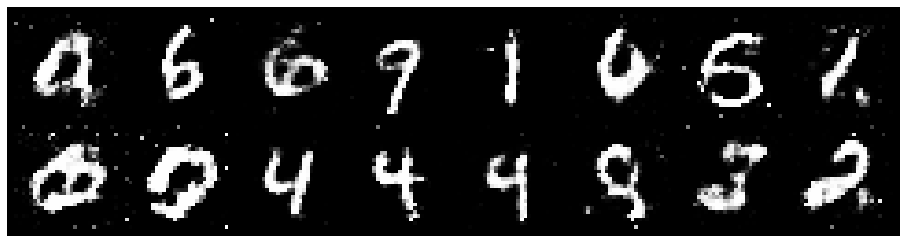

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1886, Generator Loss: 1.0668
D(x): 0.6116, D(G(z)): 0.4197


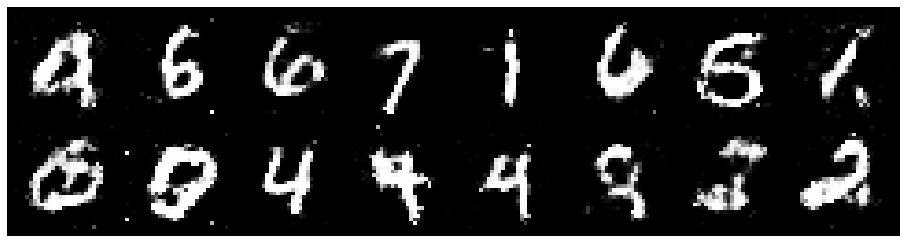

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.3109, Generator Loss: 0.8750
D(x): 0.5497, D(G(z)): 0.4235


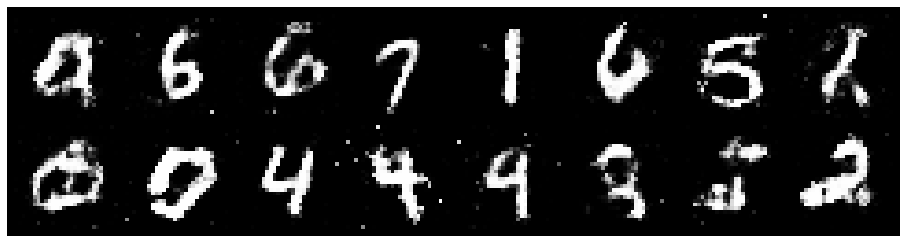

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.1611, Generator Loss: 0.9279
D(x): 0.5919, D(G(z)): 0.3961


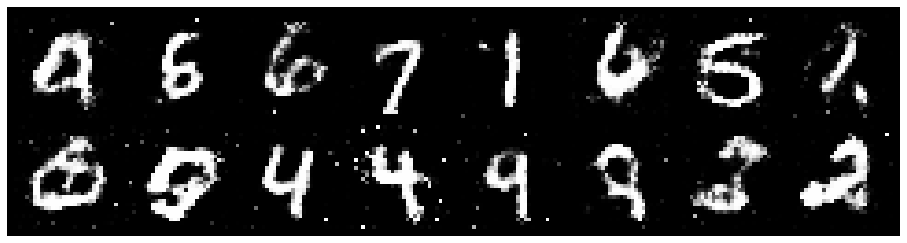

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9632
D(x): 0.5318, D(G(z)): 0.4177


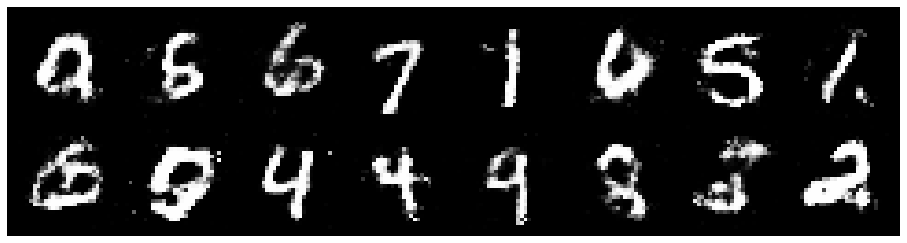

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.1429, Generator Loss: 1.0787
D(x): 0.6307, D(G(z)): 0.4193


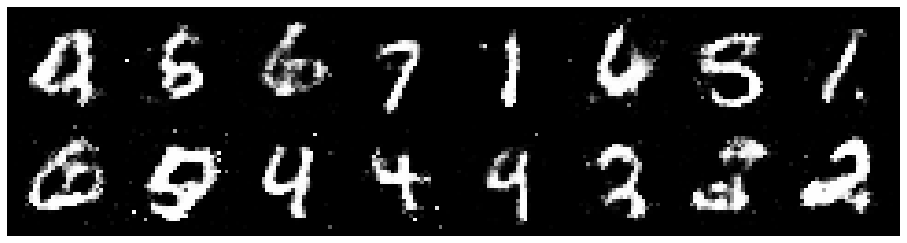

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1703, Generator Loss: 0.9424
D(x): 0.6462, D(G(z)): 0.4761


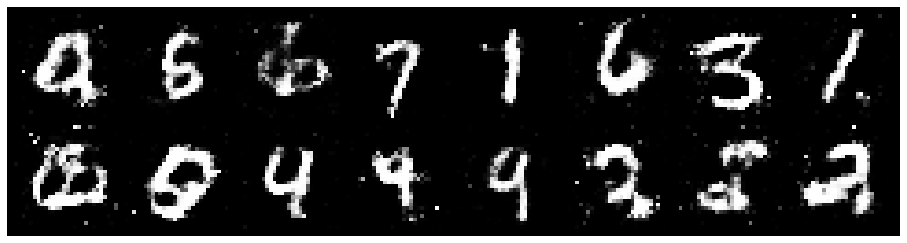

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.1536, Generator Loss: 1.1052
D(x): 0.5980, D(G(z)): 0.4012


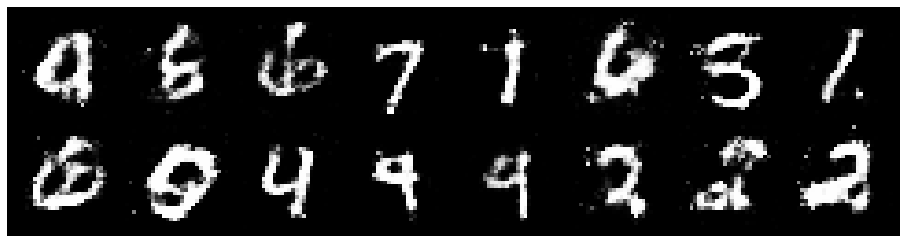

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.1783, Generator Loss: 1.0922
D(x): 0.5726, D(G(z)): 0.3812


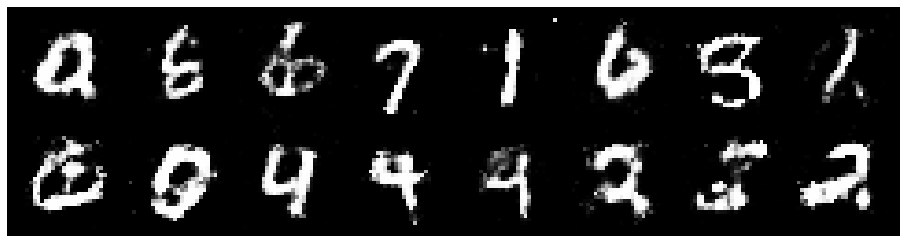

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.1784, Generator Loss: 0.9704
D(x): 0.5673, D(G(z)): 0.4045


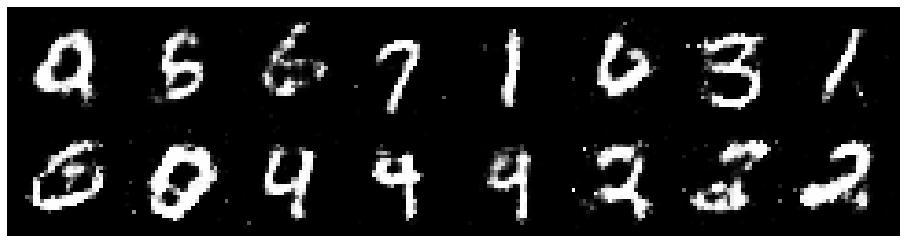

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1846, Generator Loss: 1.1850
D(x): 0.5517, D(G(z)): 0.3748


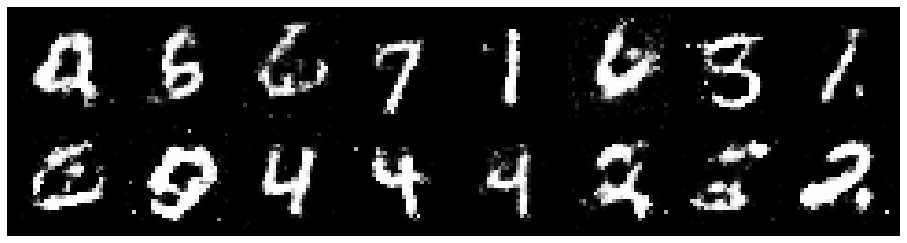

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.2811, Generator Loss: 0.8687
D(x): 0.5541, D(G(z)): 0.4452


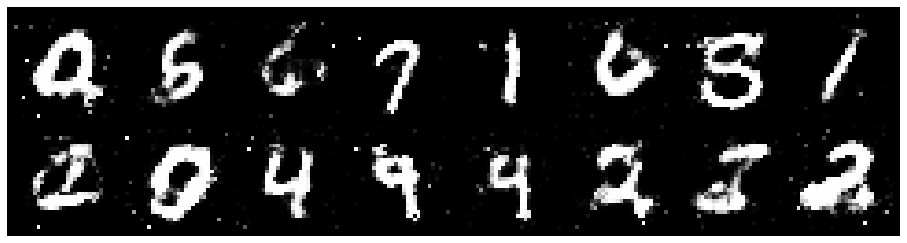

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.3526, Generator Loss: 1.1184
D(x): 0.4966, D(G(z)): 0.4056


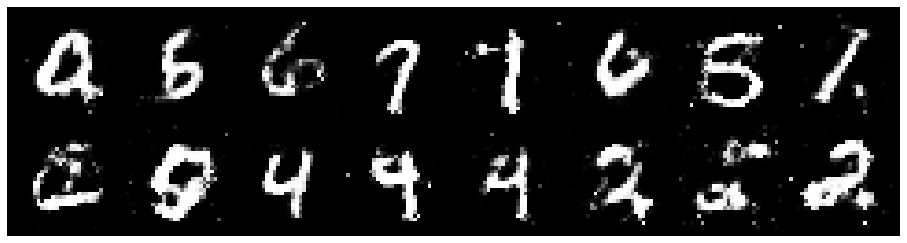

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2761, Generator Loss: 0.8603
D(x): 0.5564, D(G(z)): 0.4480


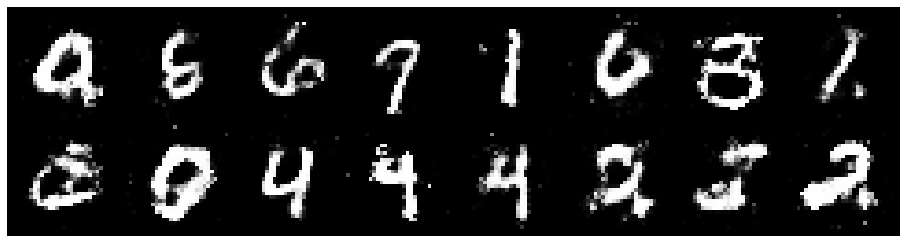

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2623, Generator Loss: 0.8574
D(x): 0.5754, D(G(z)): 0.4459


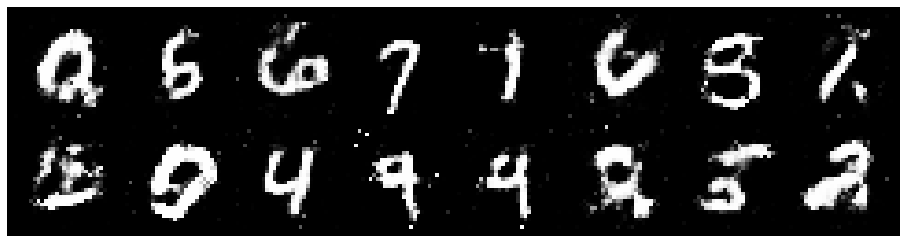

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2495, Generator Loss: 0.8307
D(x): 0.5717, D(G(z)): 0.4517


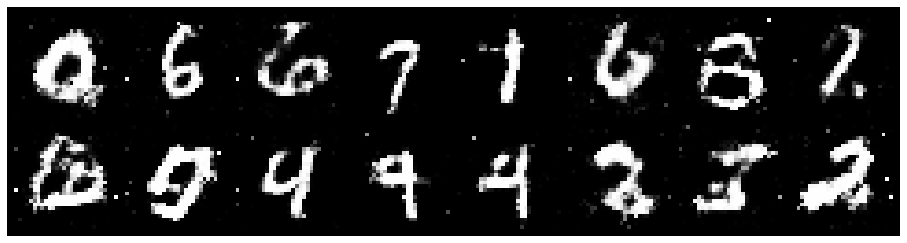

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2704, Generator Loss: 0.8319
D(x): 0.5730, D(G(z)): 0.4682


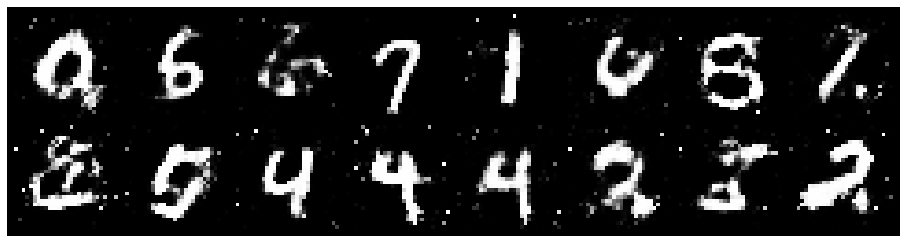

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.2603, Generator Loss: 0.8718
D(x): 0.5812, D(G(z)): 0.4491


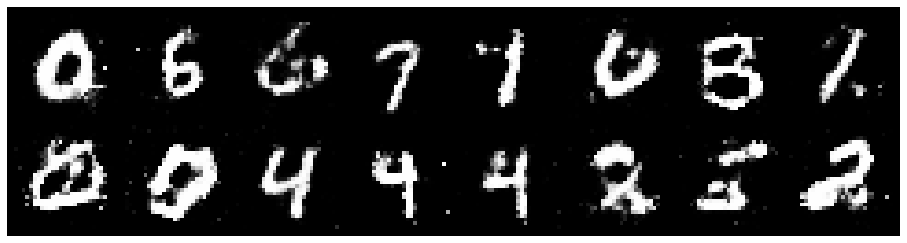

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.3531, Generator Loss: 0.9537
D(x): 0.5421, D(G(z)): 0.4473


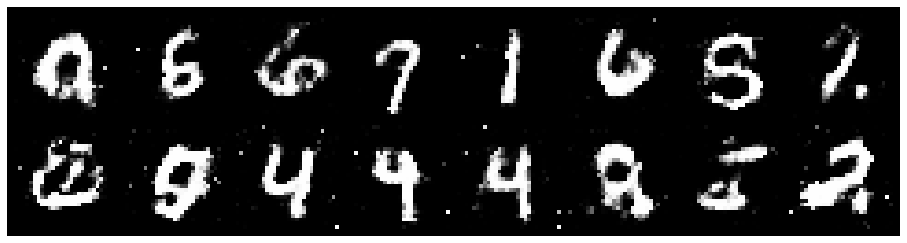

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.4025, Generator Loss: 0.8350
D(x): 0.5288, D(G(z)): 0.4676


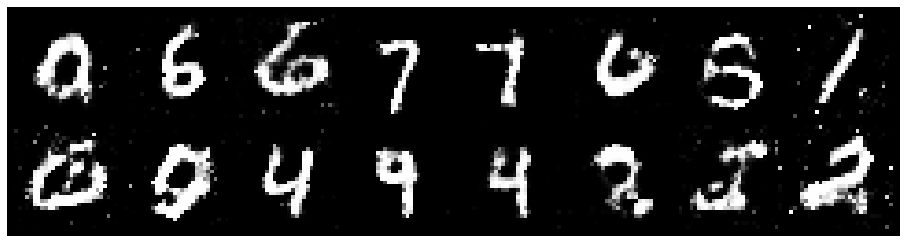

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.3070, Generator Loss: 0.9475
D(x): 0.5534, D(G(z)): 0.4104


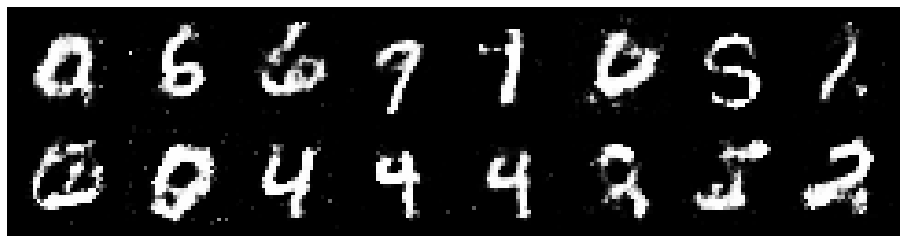

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2444, Generator Loss: 0.9356
D(x): 0.5890, D(G(z)): 0.4213


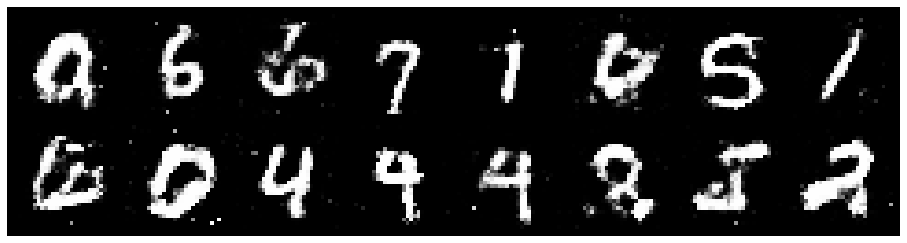

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.3097, Generator Loss: 1.1080
D(x): 0.5670, D(G(z)): 0.3991


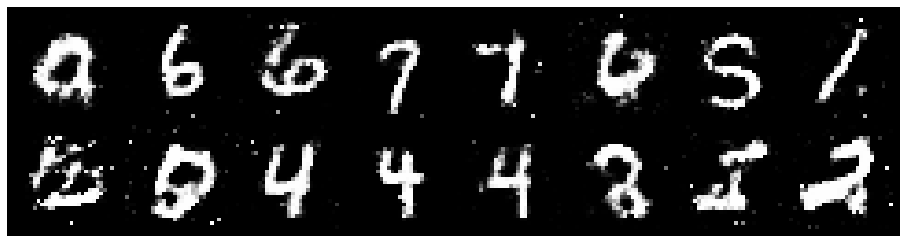

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.0482, Generator Loss: 1.3842
D(x): 0.5823, D(G(z)): 0.3137


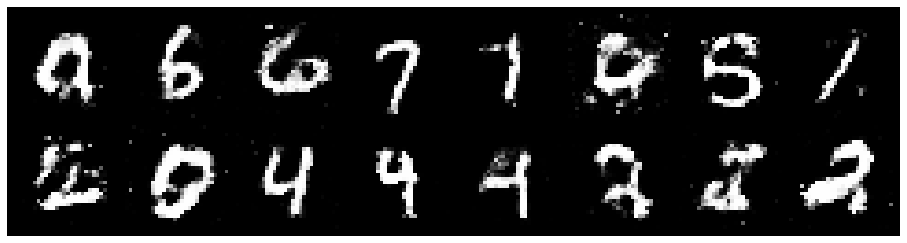

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2914, Generator Loss: 0.9999
D(x): 0.5459, D(G(z)): 0.4100


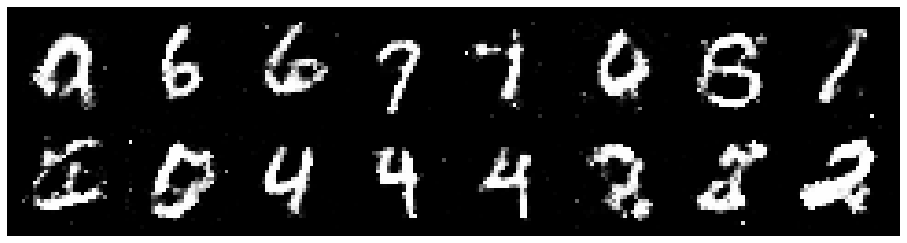

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.3389, Generator Loss: 0.7390
D(x): 0.5626, D(G(z)): 0.4786


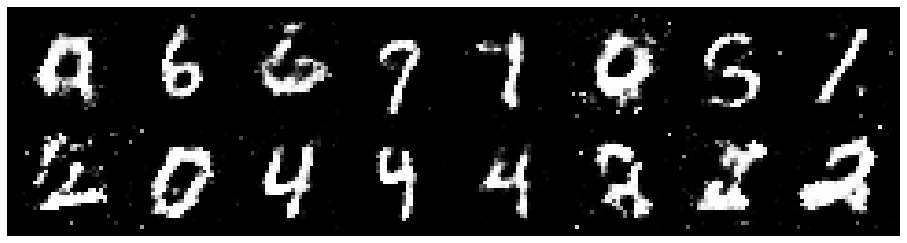

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2510, Generator Loss: 0.8408
D(x): 0.5353, D(G(z)): 0.4253


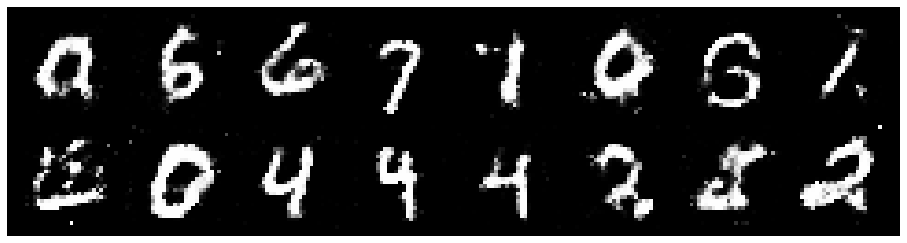

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.4123, Generator Loss: 0.8845
D(x): 0.5670, D(G(z)): 0.5044


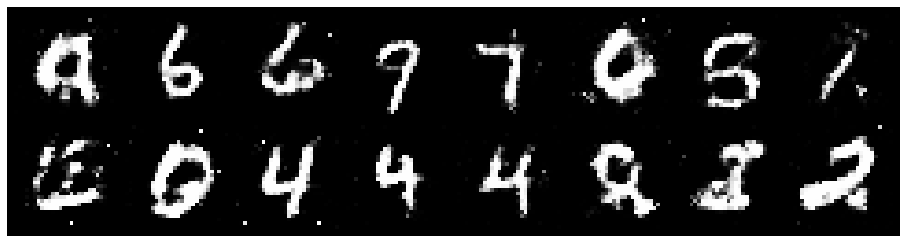

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.3033, Generator Loss: 0.7931
D(x): 0.5841, D(G(z)): 0.4781


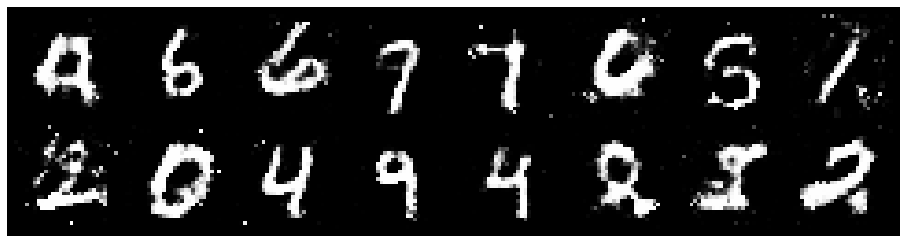

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2793, Generator Loss: 1.0589
D(x): 0.5348, D(G(z)): 0.4126


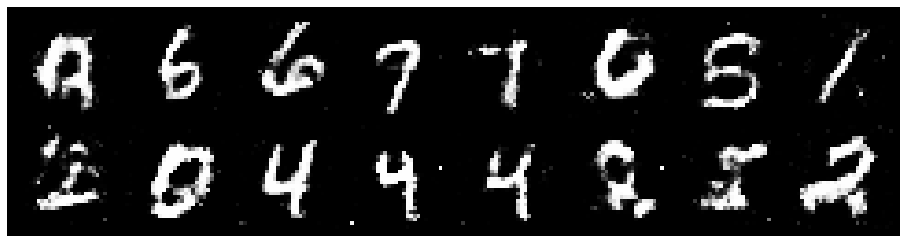

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2278, Generator Loss: 0.9655
D(x): 0.5507, D(G(z)): 0.3989


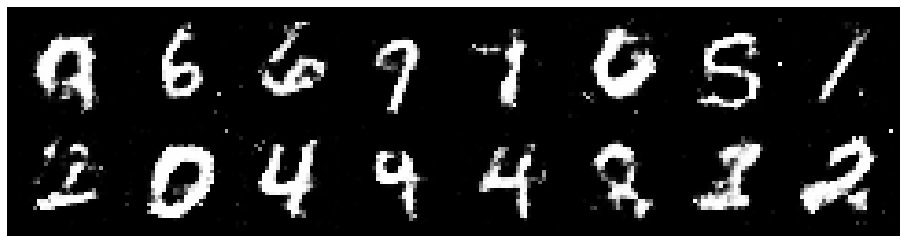

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.3295, Generator Loss: 0.9594
D(x): 0.5161, D(G(z)): 0.4135


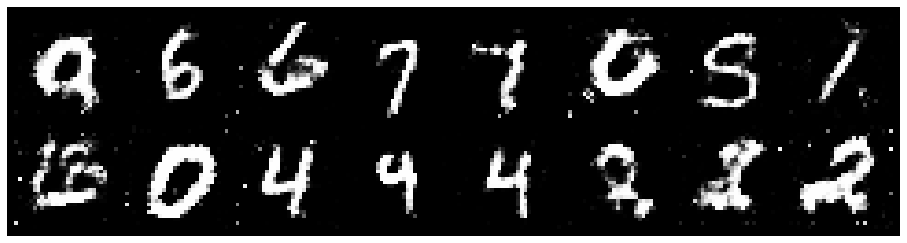

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.3906, Generator Loss: 0.9430
D(x): 0.5076, D(G(z)): 0.4417


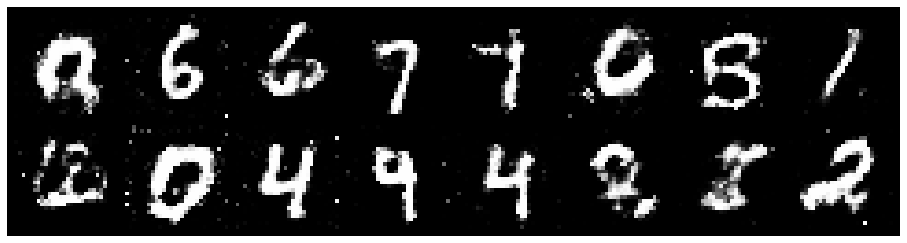

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.3401, Generator Loss: 0.9741
D(x): 0.5075, D(G(z)): 0.4185


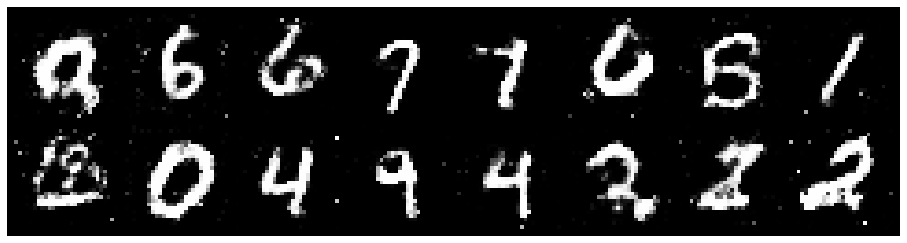

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.1212, Generator Loss: 1.0142
D(x): 0.6279, D(G(z)): 0.4066


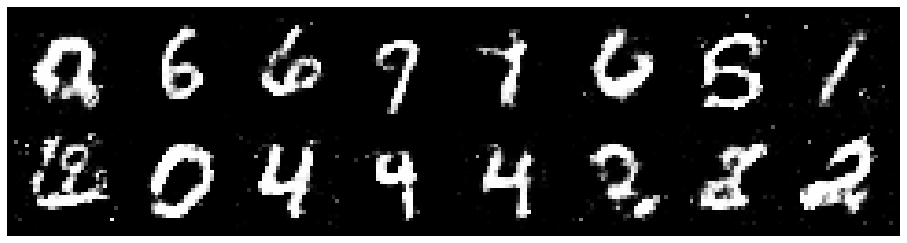

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2490, Generator Loss: 1.0555
D(x): 0.6054, D(G(z)): 0.4531


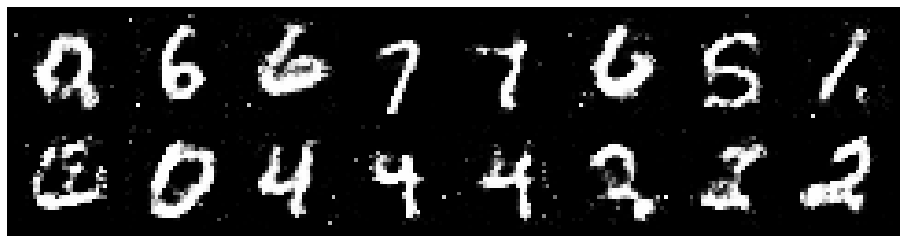

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.0966, Generator Loss: 1.0226
D(x): 0.5433, D(G(z)): 0.3119


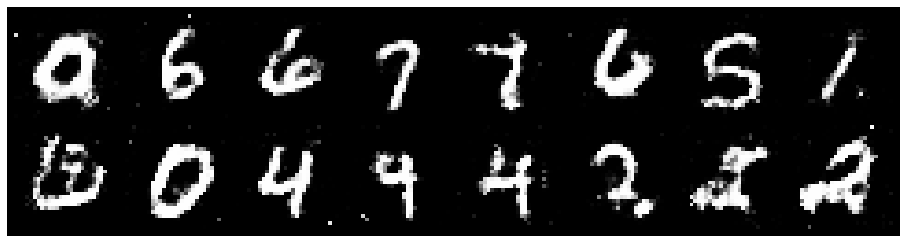

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.1449, Generator Loss: 1.0628
D(x): 0.5920, D(G(z)): 0.3712


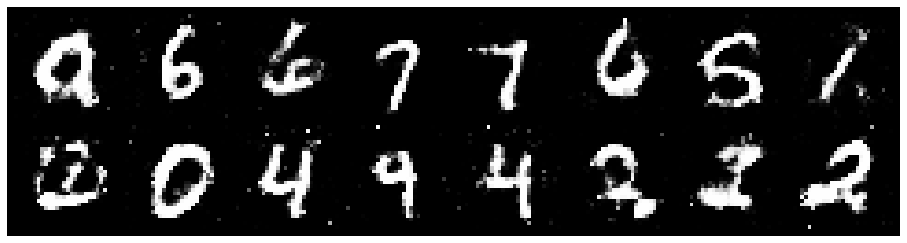

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2364, Generator Loss: 1.2417
D(x): 0.5854, D(G(z)): 0.4067


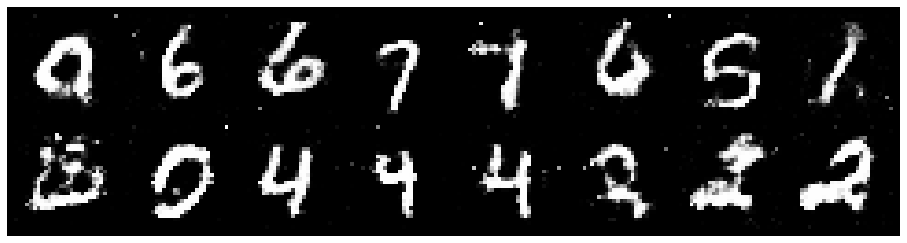

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.1864, Generator Loss: 0.9291
D(x): 0.5749, D(G(z)): 0.4024


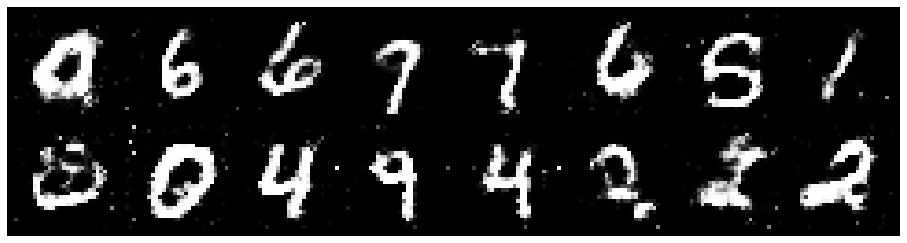

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.1749, Generator Loss: 0.8900
D(x): 0.5883, D(G(z)): 0.4278


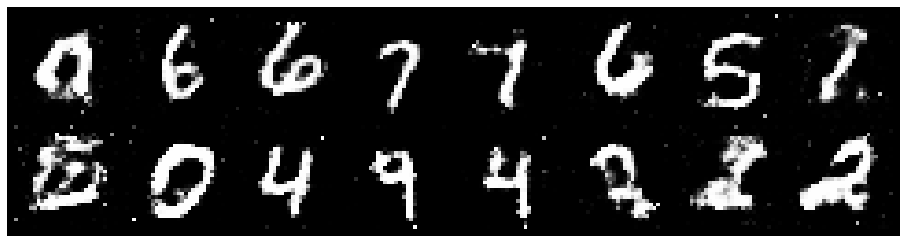

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2574, Generator Loss: 0.9968
D(x): 0.5666, D(G(z)): 0.4467


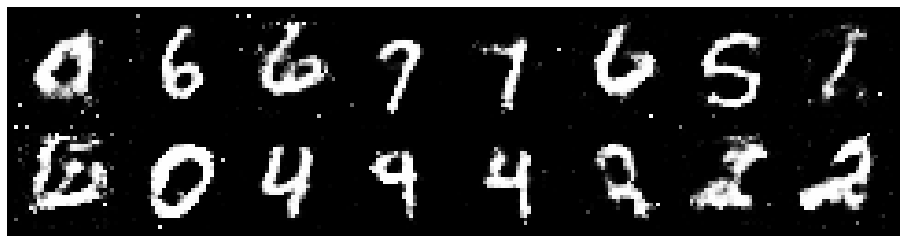

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2041, Generator Loss: 0.9734
D(x): 0.5809, D(G(z)): 0.4293


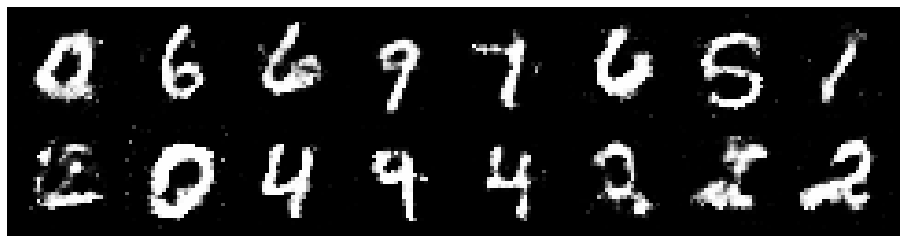

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2817, Generator Loss: 0.8640
D(x): 0.6038, D(G(z)): 0.4879


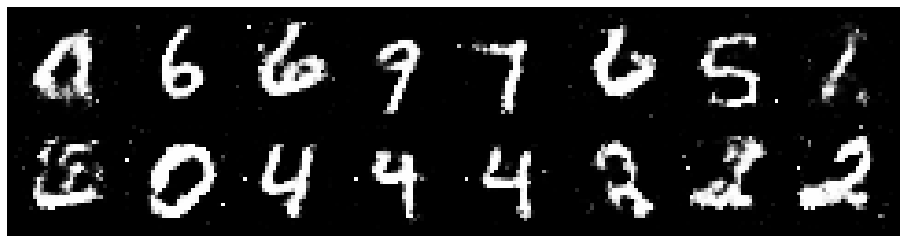

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2666, Generator Loss: 1.0934
D(x): 0.5515, D(G(z)): 0.4053


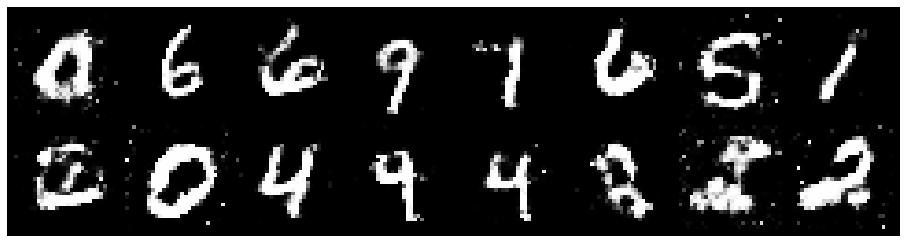

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.4125, Generator Loss: 0.9032
D(x): 0.5451, D(G(z)): 0.4639


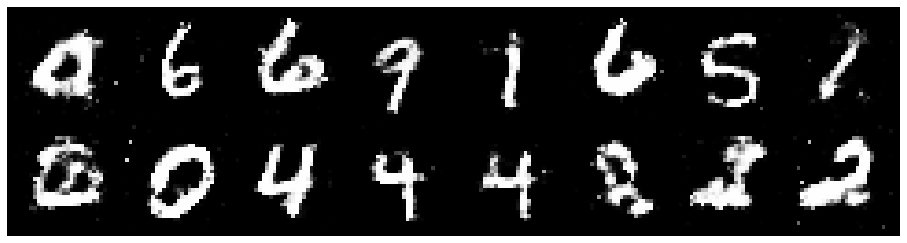

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2386, Generator Loss: 1.0327
D(x): 0.5751, D(G(z)): 0.4407


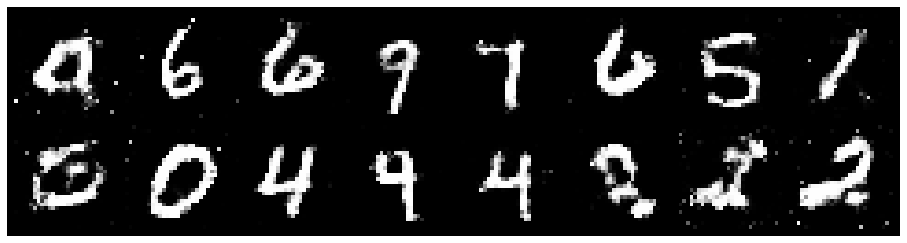

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.1538, Generator Loss: 0.9656
D(x): 0.6038, D(G(z)): 0.4174


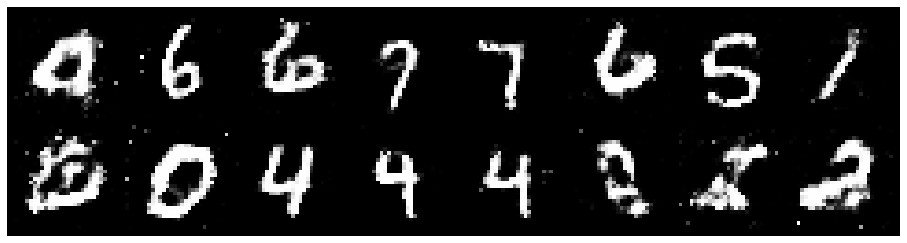

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2450, Generator Loss: 0.9804
D(x): 0.5709, D(G(z)): 0.4355


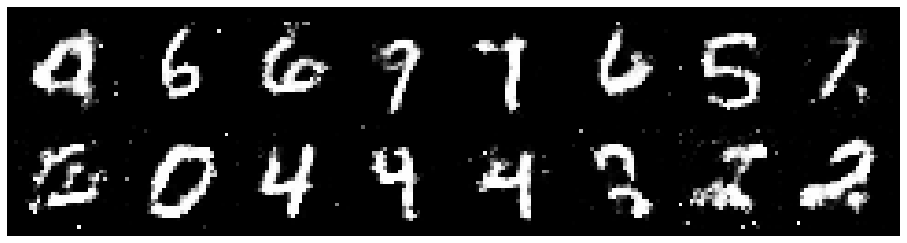

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1531, Generator Loss: 0.9103
D(x): 0.5968, D(G(z)): 0.4112


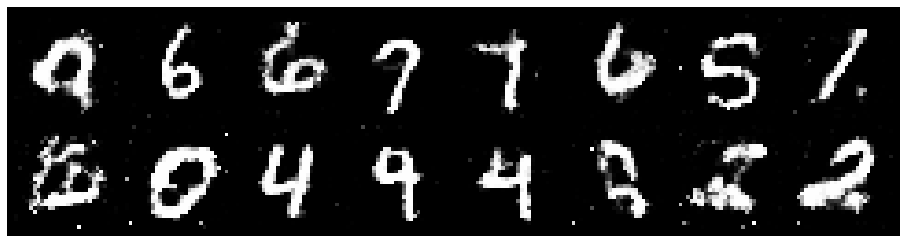

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2437, Generator Loss: 0.8831
D(x): 0.6029, D(G(z)): 0.4471


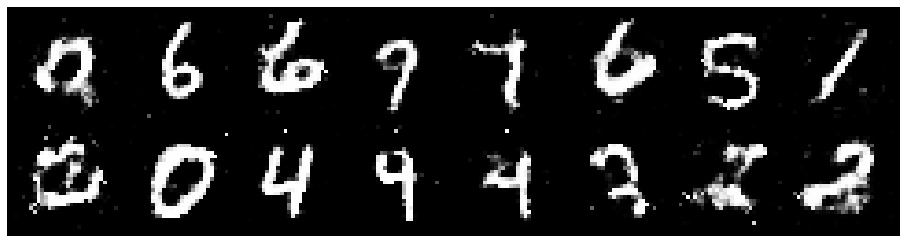

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.1109, Generator Loss: 1.0752
D(x): 0.6282, D(G(z)): 0.3945


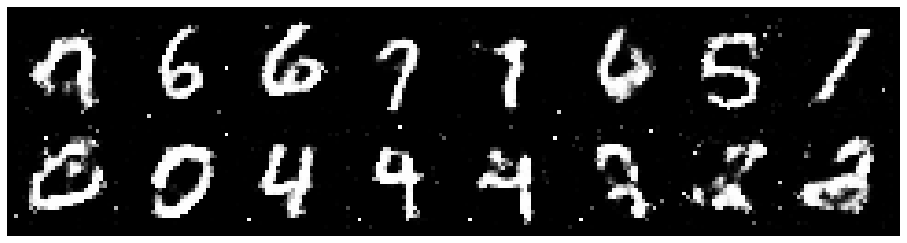

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.1853, Generator Loss: 1.0097
D(x): 0.5368, D(G(z)): 0.3835


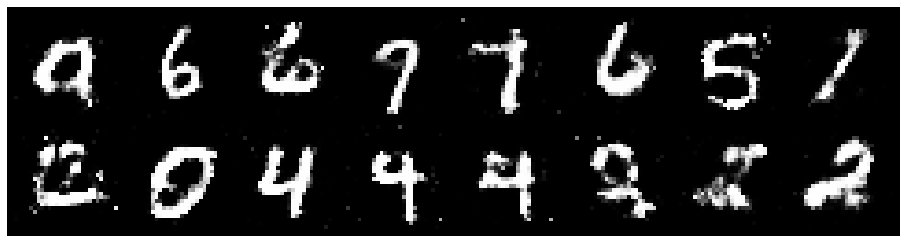

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.1233, Generator Loss: 0.9895
D(x): 0.6044, D(G(z)): 0.3941


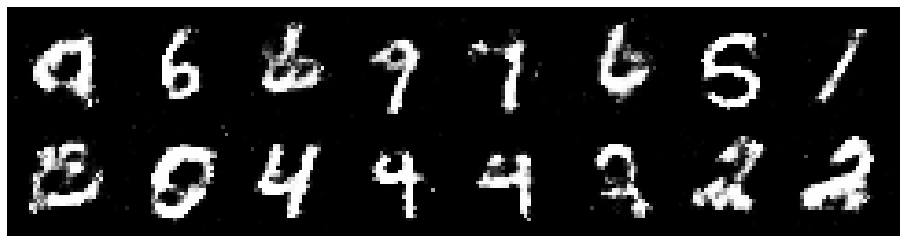

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2136, Generator Loss: 1.0193
D(x): 0.5532, D(G(z)): 0.4034


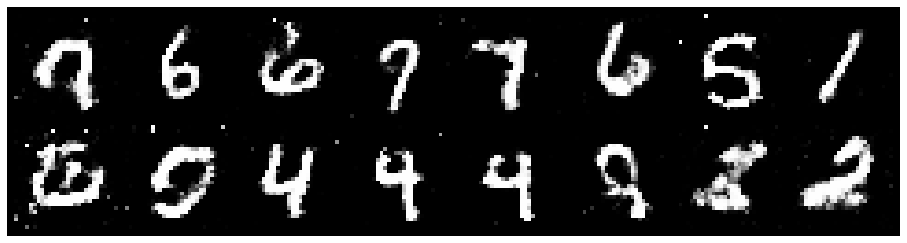

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3224, Generator Loss: 0.8002
D(x): 0.5510, D(G(z)): 0.4733


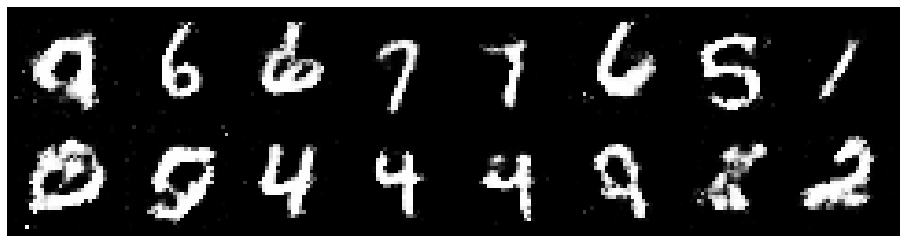

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2386, Generator Loss: 0.9315
D(x): 0.5594, D(G(z)): 0.4297


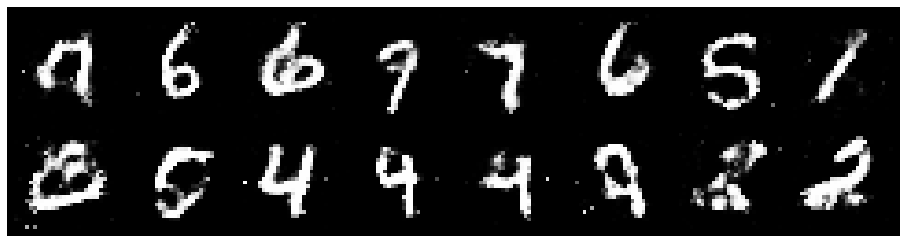

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2987, Generator Loss: 0.9117
D(x): 0.5743, D(G(z)): 0.4563


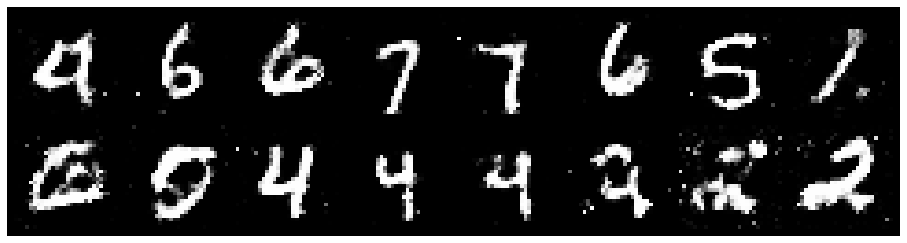

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2710, Generator Loss: 0.9738
D(x): 0.5579, D(G(z)): 0.4376


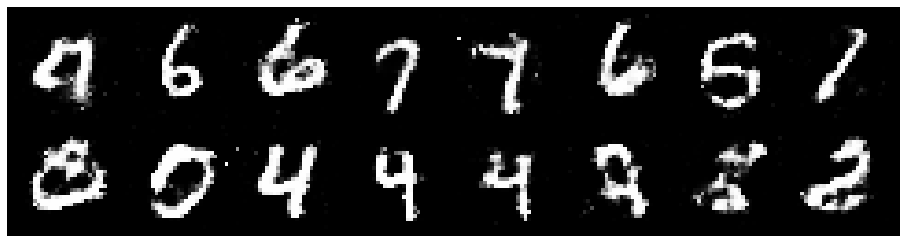

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.1621, Generator Loss: 1.0165
D(x): 0.5776, D(G(z)): 0.4115


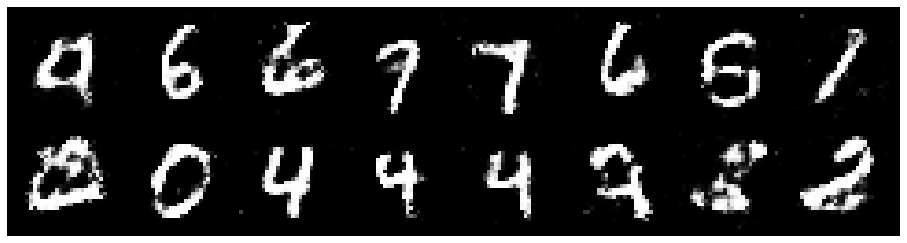

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2583, Generator Loss: 0.9982
D(x): 0.5509, D(G(z)): 0.4393


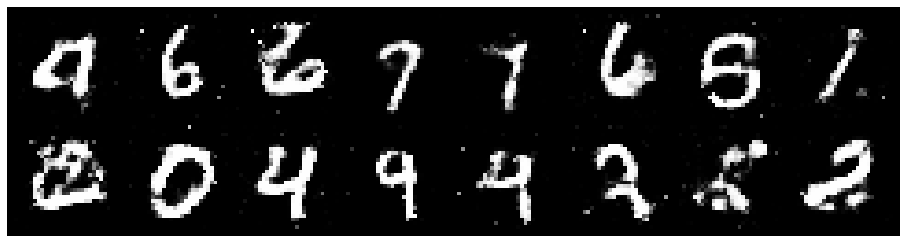

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2085, Generator Loss: 0.9644
D(x): 0.6003, D(G(z)): 0.4574


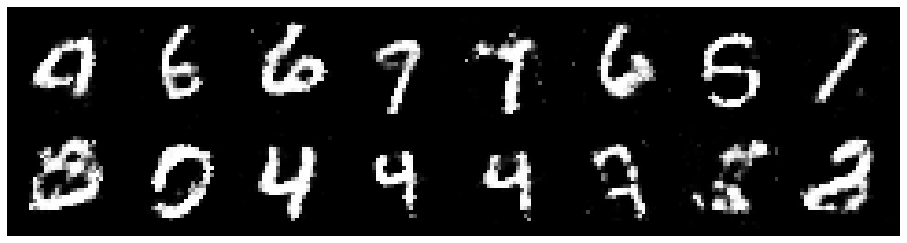

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.3316, Generator Loss: 0.9695
D(x): 0.5380, D(G(z)): 0.4466


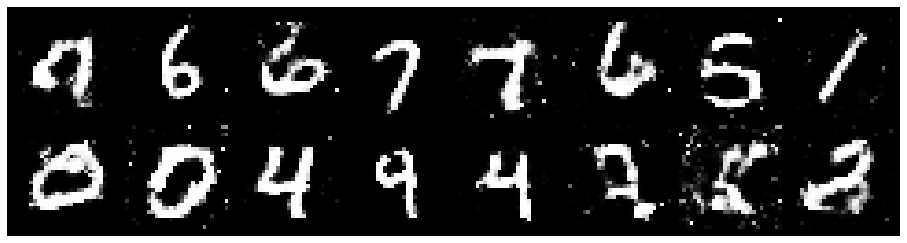

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2155, Generator Loss: 1.1652
D(x): 0.5904, D(G(z)): 0.4239


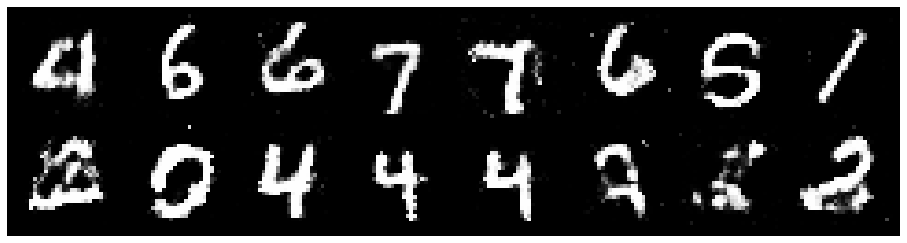

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.1964, Generator Loss: 1.1140
D(x): 0.6058, D(G(z)): 0.4026


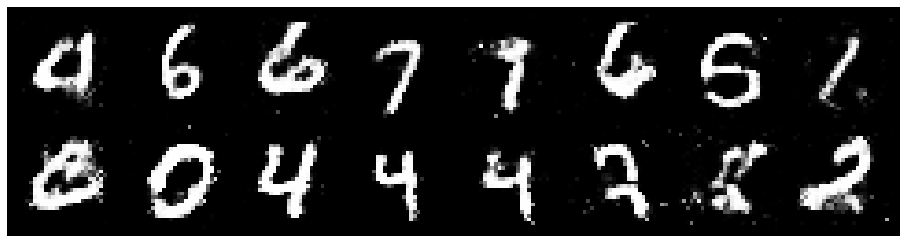

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.1770, Generator Loss: 1.0169
D(x): 0.5657, D(G(z)): 0.3936


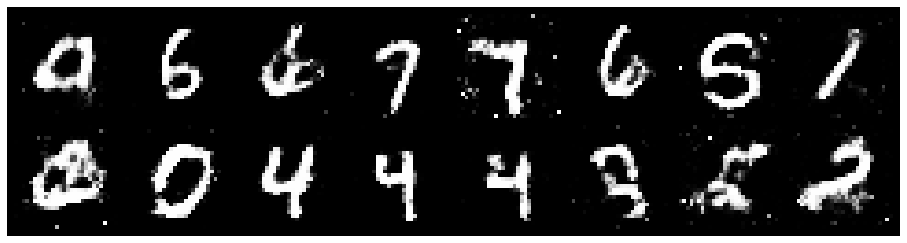

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2172, Generator Loss: 1.0155
D(x): 0.5400, D(G(z)): 0.3994


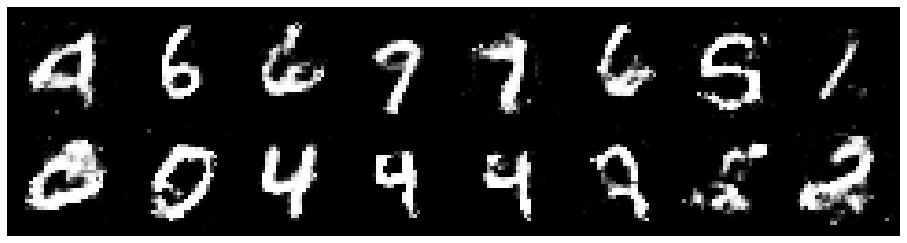

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.1992, Generator Loss: 1.0997
D(x): 0.5760, D(G(z)): 0.4108


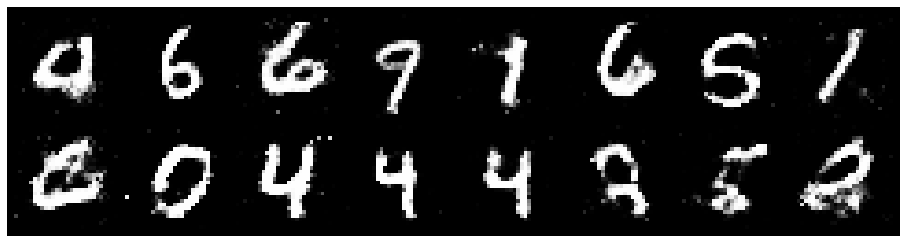

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.1723, Generator Loss: 0.9126
D(x): 0.5710, D(G(z)): 0.4094


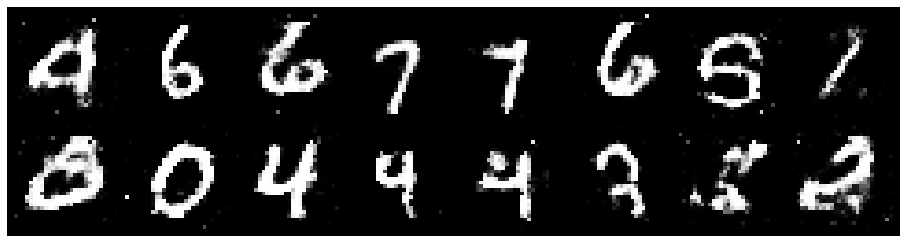

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2254, Generator Loss: 1.1262
D(x): 0.5581, D(G(z)): 0.4072


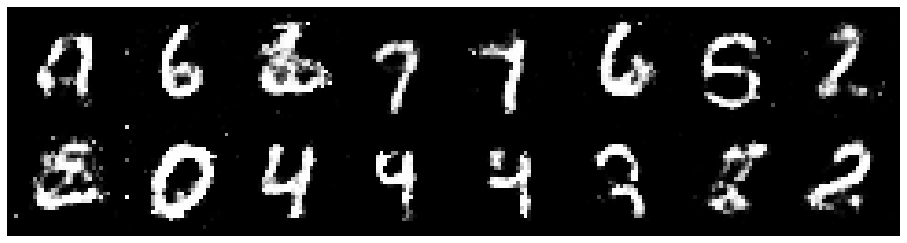

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.1503, Generator Loss: 0.7442
D(x): 0.5940, D(G(z)): 0.4312


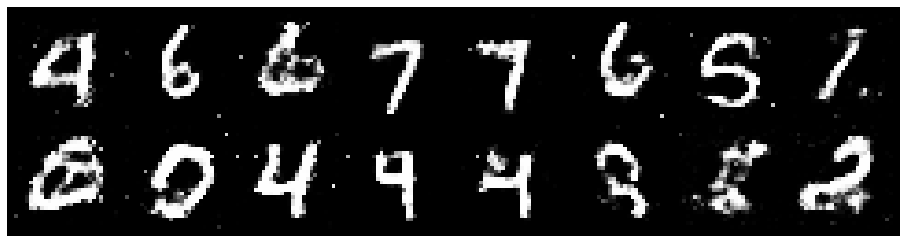

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.1079, Generator Loss: 1.0753
D(x): 0.5764, D(G(z)): 0.3809


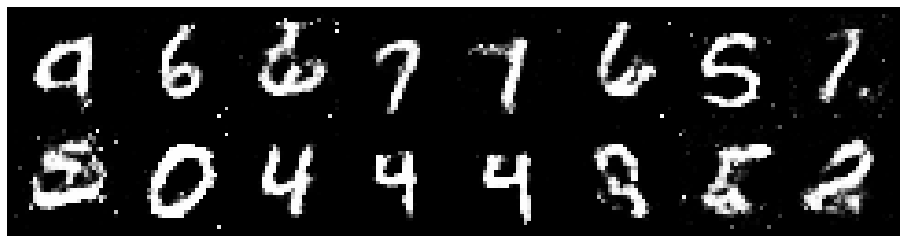

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8019
D(x): 0.6021, D(G(z)): 0.4820


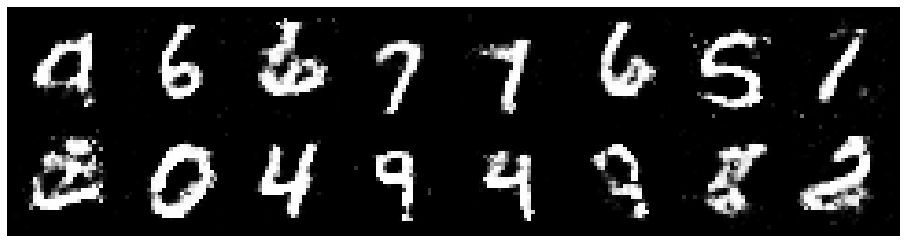

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2857, Generator Loss: 1.0915
D(x): 0.5856, D(G(z)): 0.4304


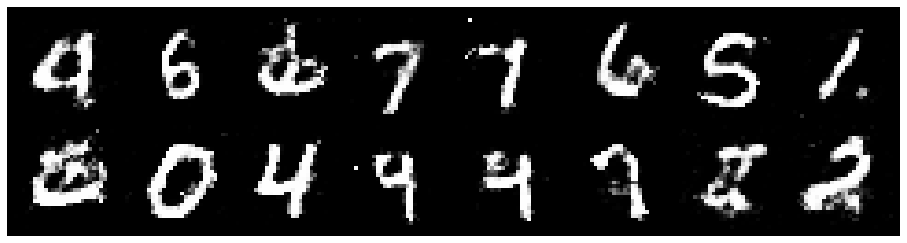

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.1445, Generator Loss: 1.1142
D(x): 0.5774, D(G(z)): 0.3844


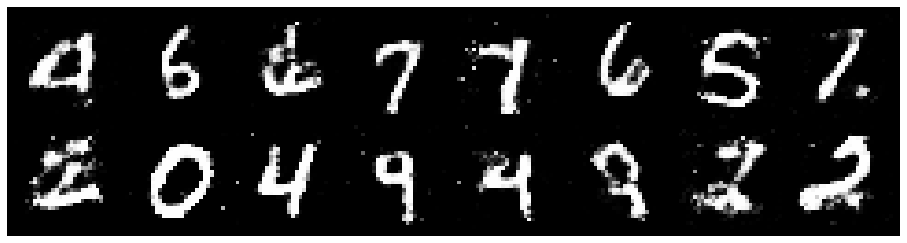

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.1828, Generator Loss: 0.9674
D(x): 0.5899, D(G(z)): 0.4210


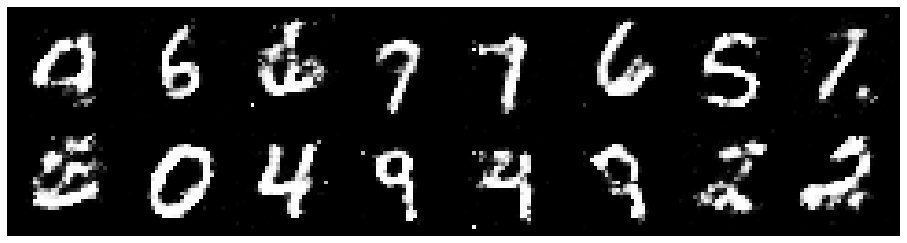

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2496, Generator Loss: 0.9433
D(x): 0.5605, D(G(z)): 0.4165


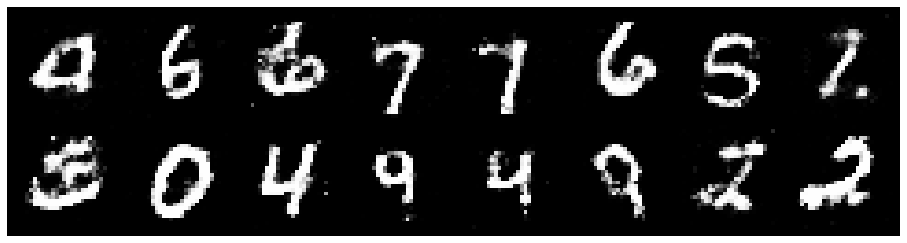

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2223, Generator Loss: 0.9508
D(x): 0.5412, D(G(z)): 0.4118


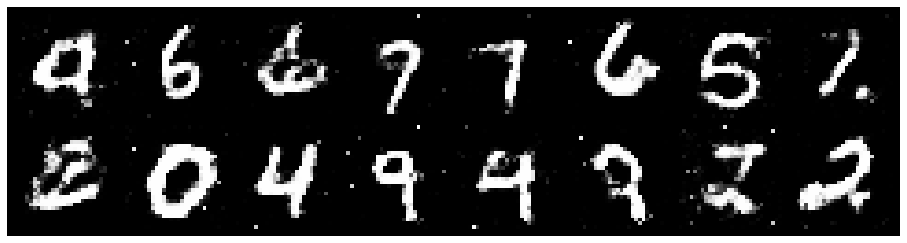

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3439, Generator Loss: 0.8214
D(x): 0.5538, D(G(z)): 0.4656


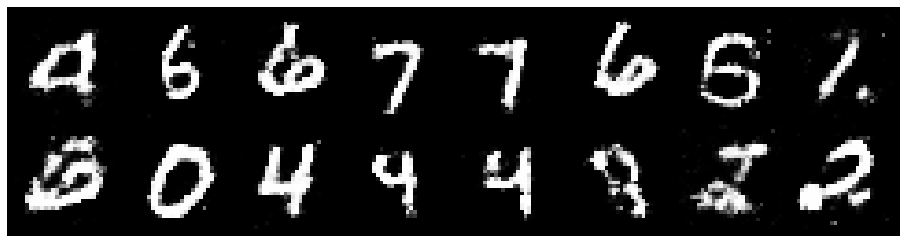

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.3522, Generator Loss: 0.8719
D(x): 0.5726, D(G(z)): 0.4842


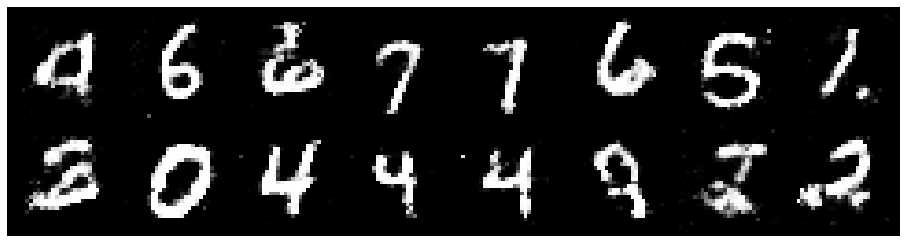

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.4295, Generator Loss: 0.8485
D(x): 0.4989, D(G(z)): 0.4533


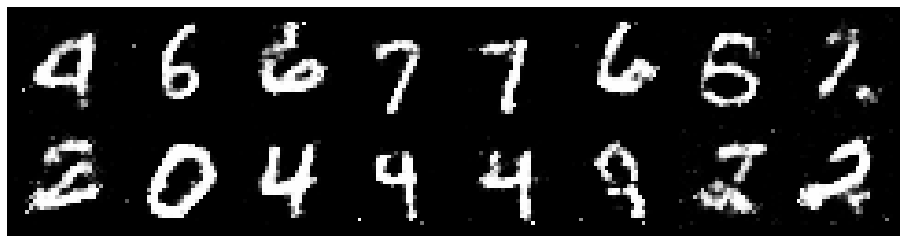

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.3463, Generator Loss: 0.8861
D(x): 0.5672, D(G(z)): 0.4766


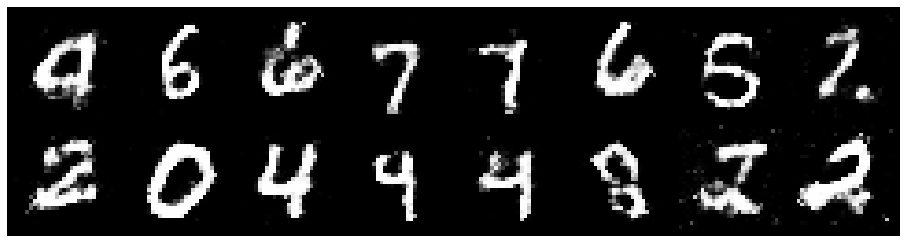

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.4389, Generator Loss: 0.9918
D(x): 0.4667, D(G(z)): 0.4346


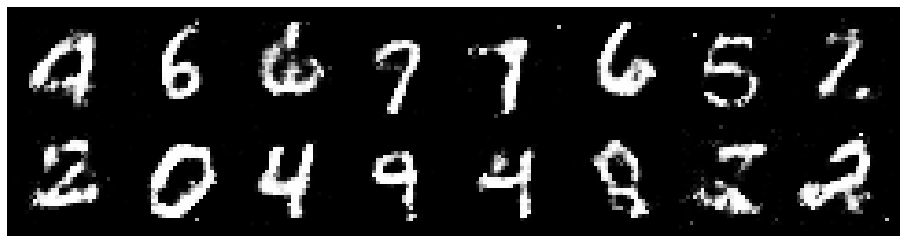

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.3476, Generator Loss: 0.8347
D(x): 0.5144, D(G(z)): 0.4427


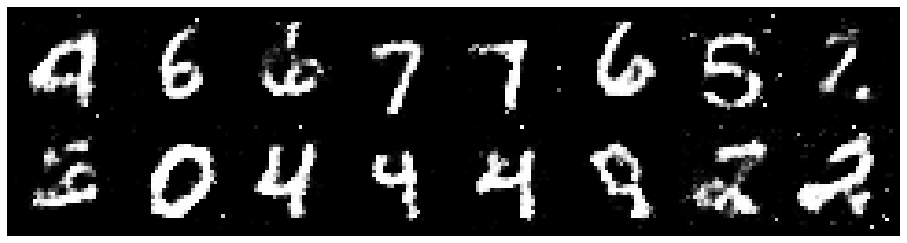

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.3562, Generator Loss: 0.9554
D(x): 0.5309, D(G(z)): 0.4462


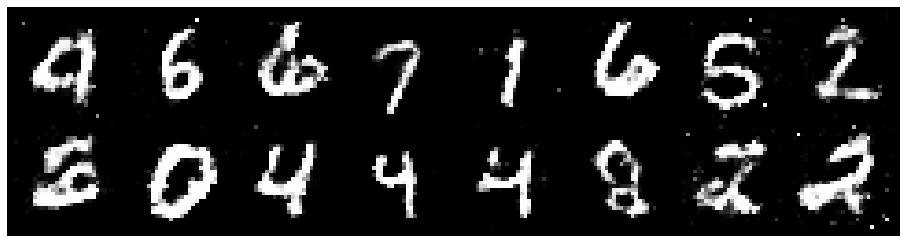

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2862, Generator Loss: 0.9960
D(x): 0.5416, D(G(z)): 0.4291


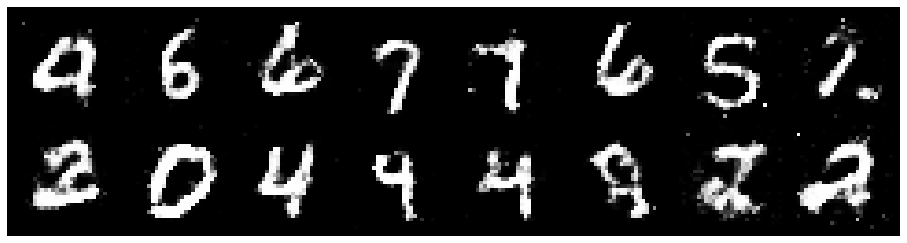

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2713, Generator Loss: 0.8090
D(x): 0.5503, D(G(z)): 0.4597


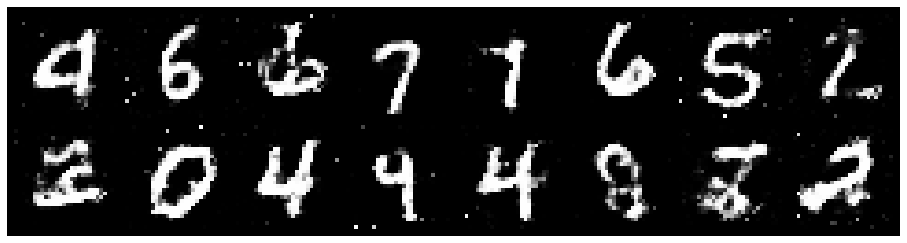

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2876, Generator Loss: 0.8830
D(x): 0.5577, D(G(z)): 0.4474


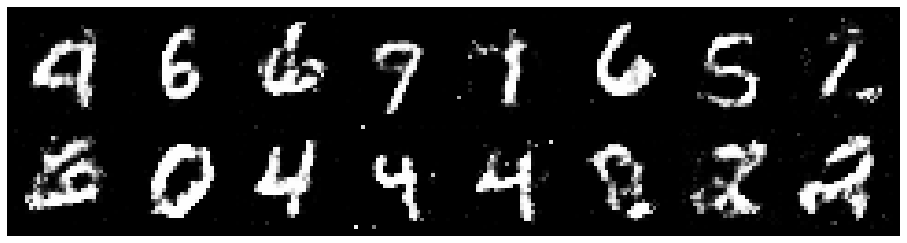

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.3452, Generator Loss: 0.8884
D(x): 0.5606, D(G(z)): 0.4643


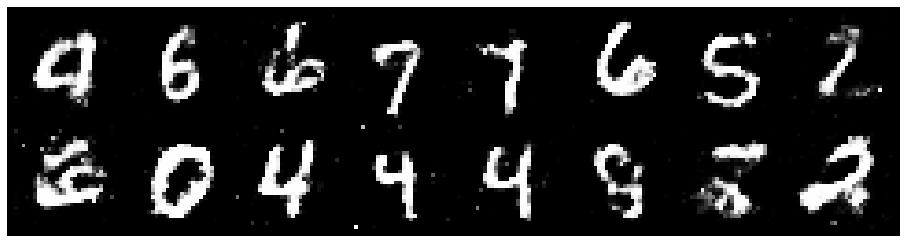

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.1556, Generator Loss: 0.8445
D(x): 0.6205, D(G(z)): 0.4444


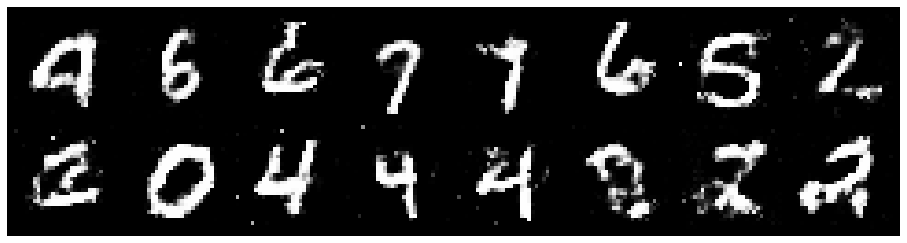

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2263, Generator Loss: 1.0166
D(x): 0.6053, D(G(z)): 0.4132


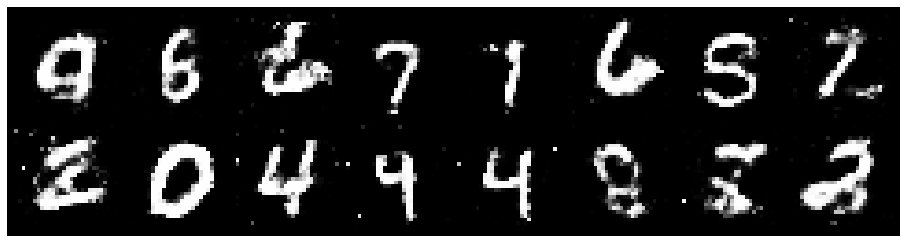

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2749, Generator Loss: 0.7985
D(x): 0.5920, D(G(z)): 0.4620


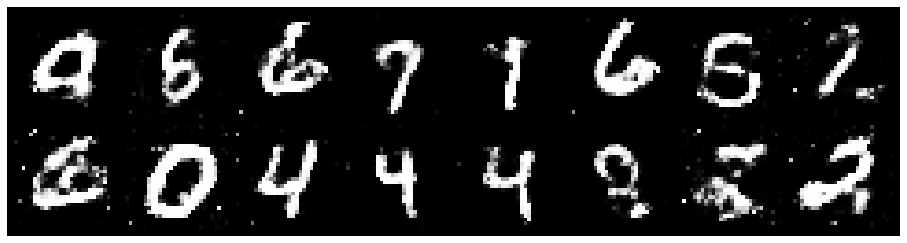

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2040, Generator Loss: 0.9295
D(x): 0.6020, D(G(z)): 0.4372


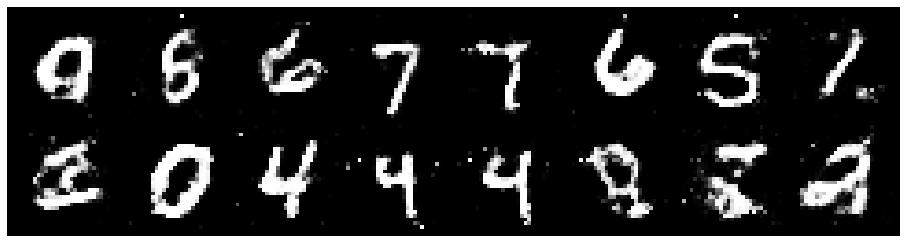

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.1978, Generator Loss: 1.0360
D(x): 0.6297, D(G(z)): 0.4449


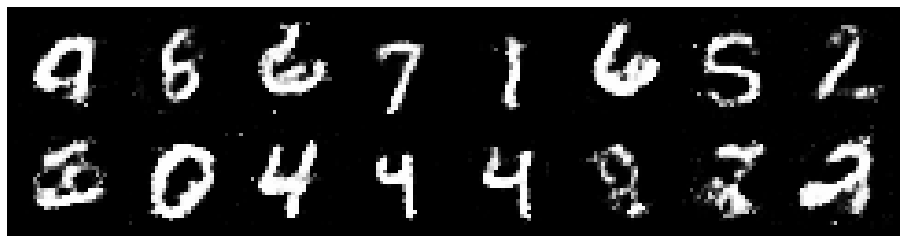

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.3017, Generator Loss: 1.1473
D(x): 0.5734, D(G(z)): 0.4408


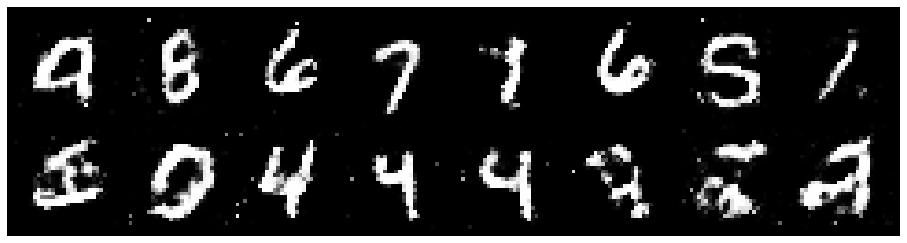

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2197, Generator Loss: 0.9756
D(x): 0.5558, D(G(z)): 0.4094


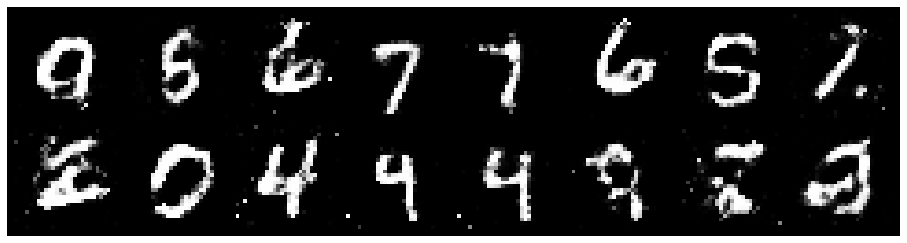

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8825
D(x): 0.5654, D(G(z)): 0.4551


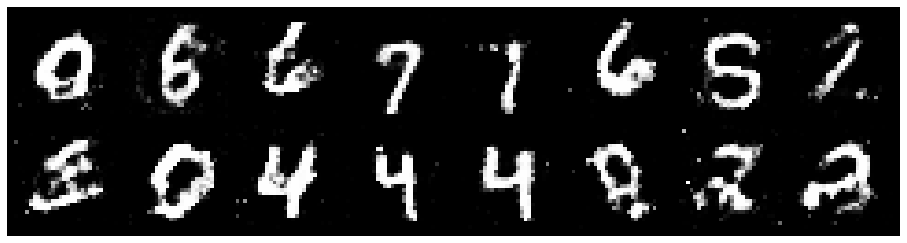

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.4200, Generator Loss: 0.9493
D(x): 0.4935, D(G(z)): 0.4503


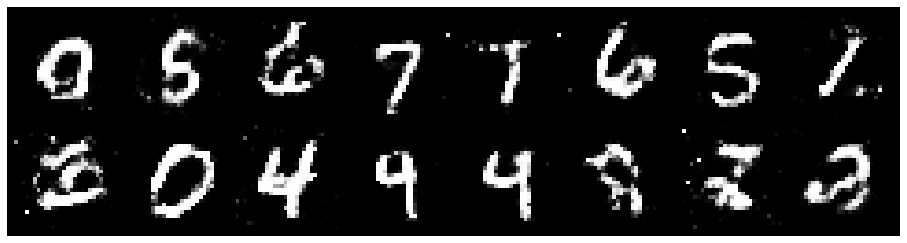

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2807, Generator Loss: 0.9165
D(x): 0.5801, D(G(z)): 0.4492


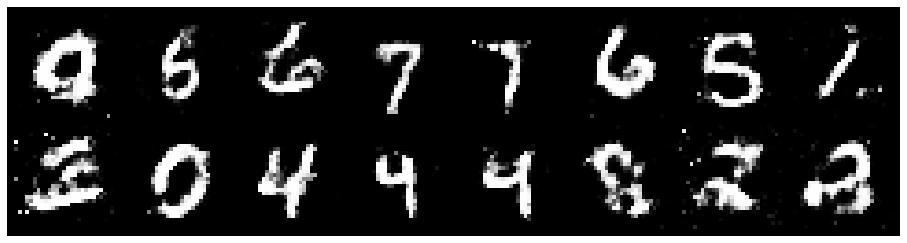

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2834, Generator Loss: 0.8206
D(x): 0.5334, D(G(z)): 0.4569


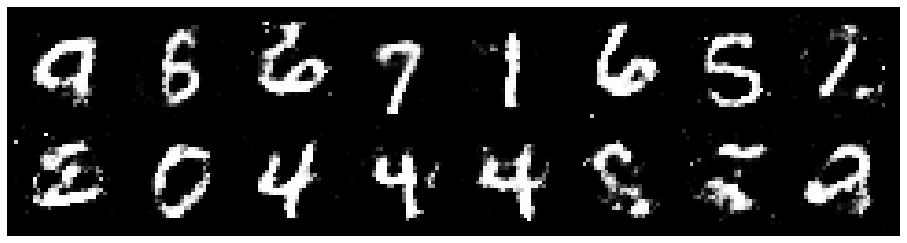

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.3881, Generator Loss: 0.8598
D(x): 0.5753, D(G(z)): 0.5064


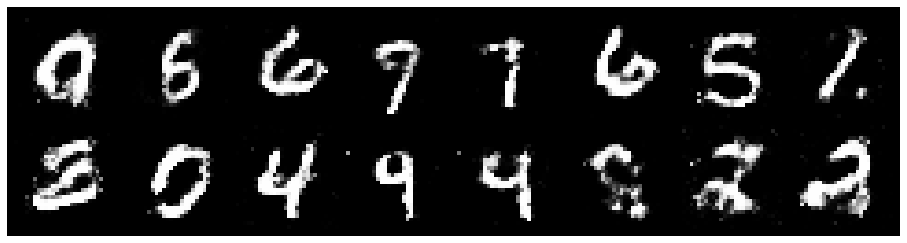

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2879, Generator Loss: 0.9020
D(x): 0.5602, D(G(z)): 0.4641


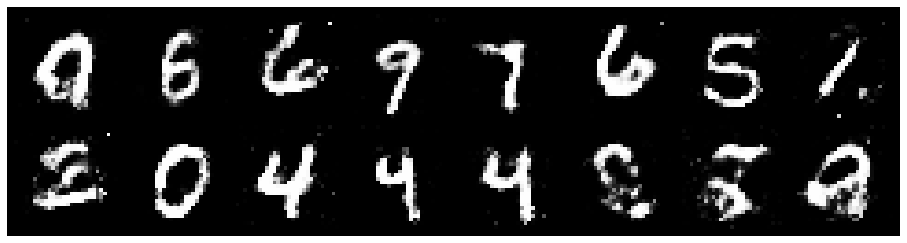

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2978, Generator Loss: 0.8666
D(x): 0.5074, D(G(z)): 0.4160


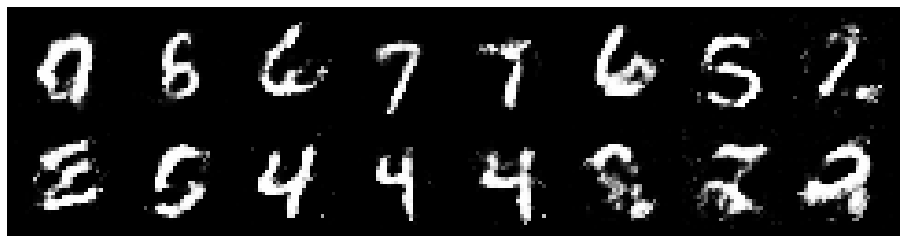

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.3095, Generator Loss: 0.8104
D(x): 0.5498, D(G(z)): 0.4625


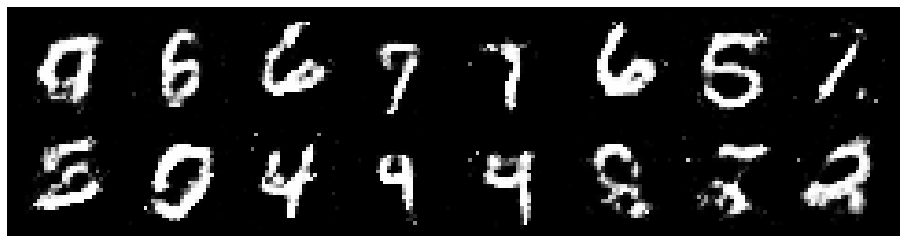

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8754
D(x): 0.5316, D(G(z)): 0.4423


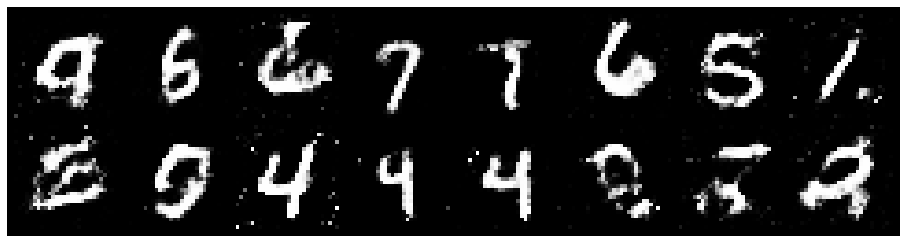

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.3463, Generator Loss: 0.8118
D(x): 0.5891, D(G(z)): 0.4756


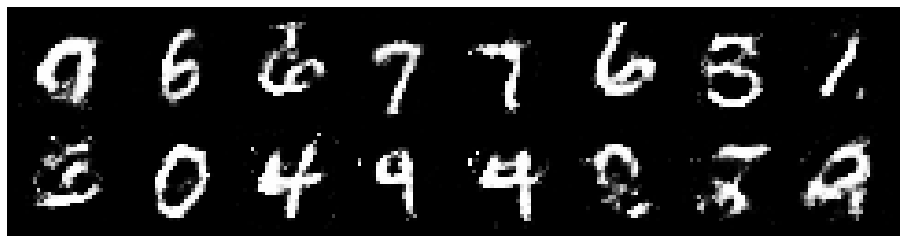

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.3466, Generator Loss: 0.9549
D(x): 0.5802, D(G(z)): 0.4786


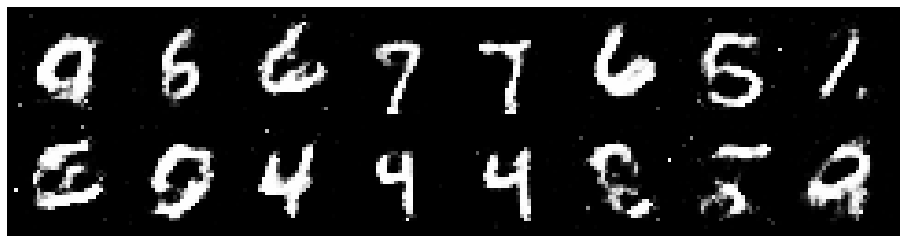

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.1795, Generator Loss: 1.1507
D(x): 0.5762, D(G(z)): 0.3727


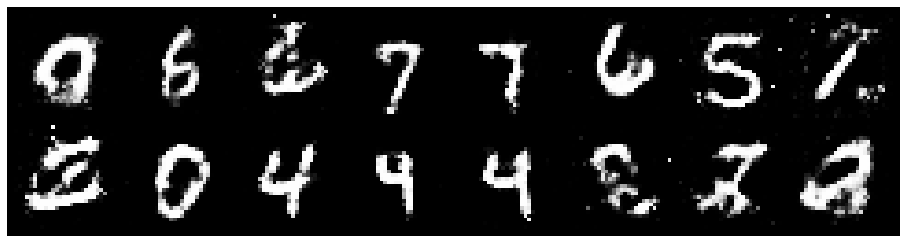

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2867, Generator Loss: 0.8698
D(x): 0.5502, D(G(z)): 0.4561


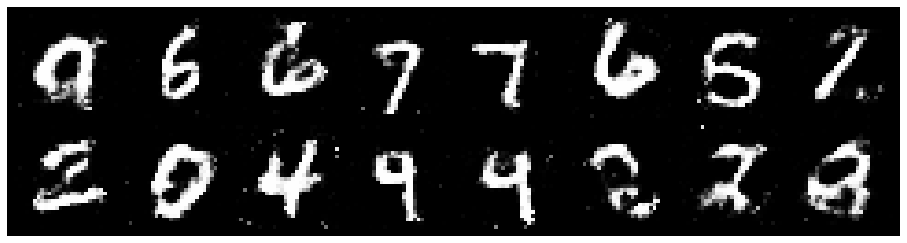

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2635, Generator Loss: 0.8568
D(x): 0.5482, D(G(z)): 0.4231


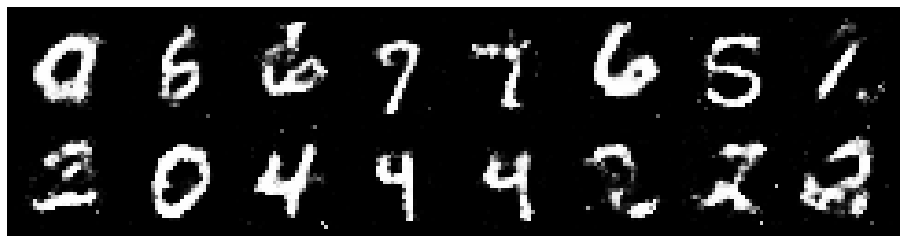

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.0988, Generator Loss: 1.0387
D(x): 0.6125, D(G(z)): 0.4064


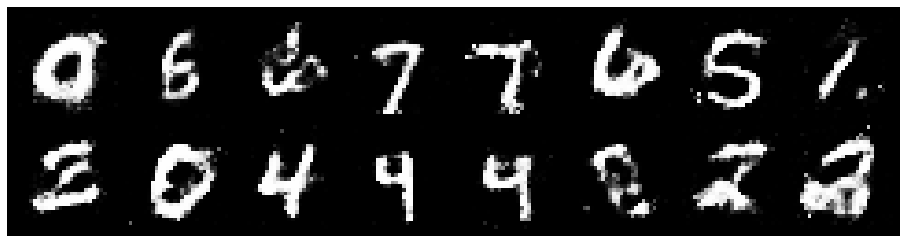

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.1938, Generator Loss: 1.0186
D(x): 0.5666, D(G(z)): 0.4042


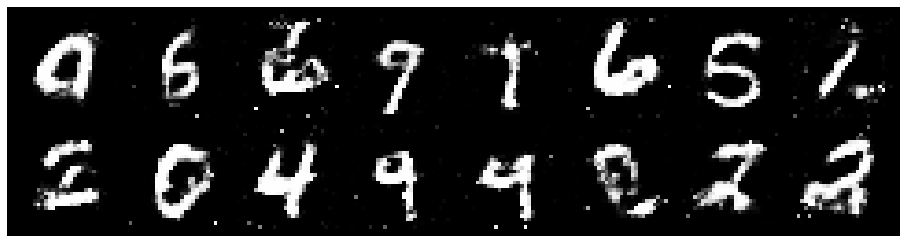

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2114, Generator Loss: 1.0186
D(x): 0.5850, D(G(z)): 0.4218


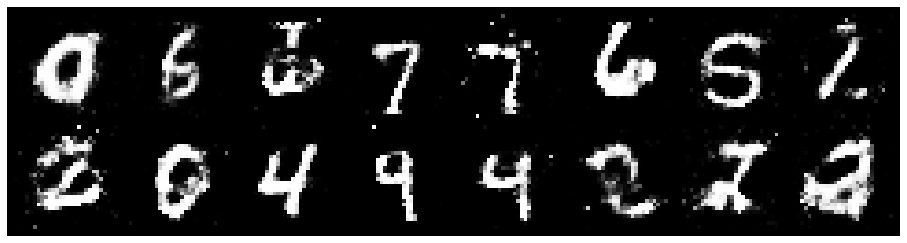

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2169, Generator Loss: 0.9154
D(x): 0.5456, D(G(z)): 0.4074


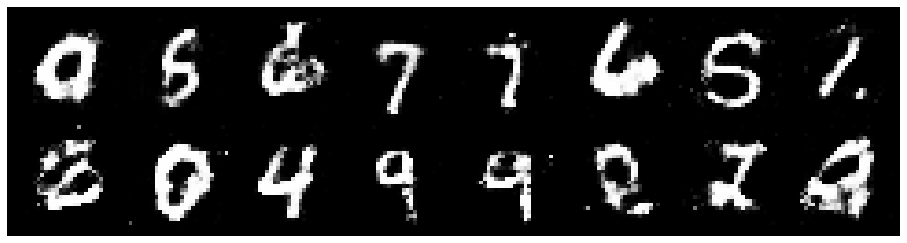

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1538, Generator Loss: 0.9766
D(x): 0.5965, D(G(z)): 0.4347


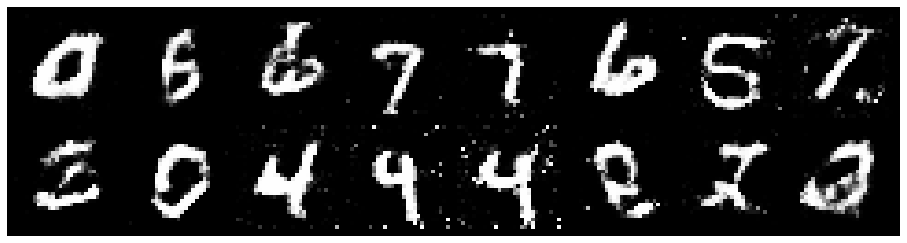

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2115, Generator Loss: 0.8690
D(x): 0.5701, D(G(z)): 0.4318


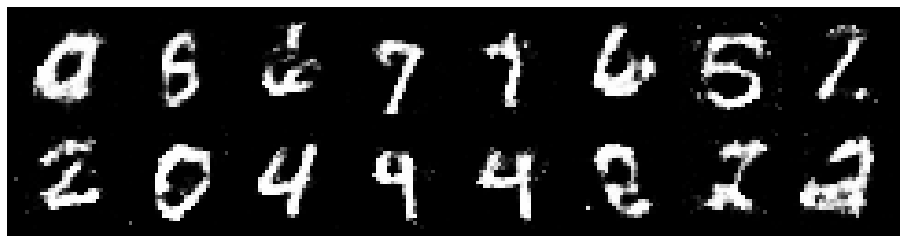

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.1653, Generator Loss: 0.8947
D(x): 0.5766, D(G(z)): 0.4171


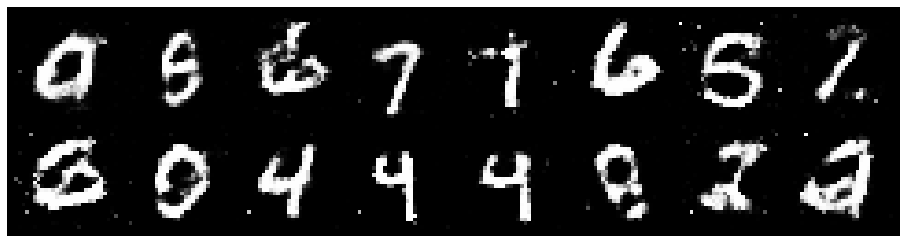

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2206, Generator Loss: 1.1373
D(x): 0.5514, D(G(z)): 0.3920


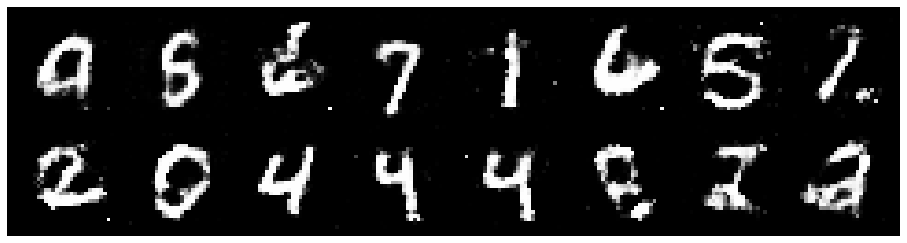

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2984, Generator Loss: 0.9199
D(x): 0.5742, D(G(z)): 0.4534


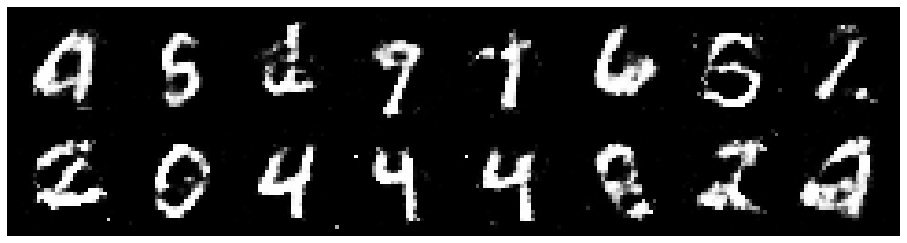

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2565, Generator Loss: 0.8706
D(x): 0.5429, D(G(z)): 0.4092


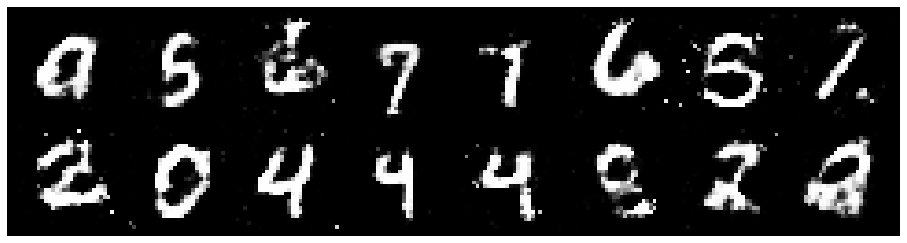

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3586, Generator Loss: 0.8930
D(x): 0.5629, D(G(z)): 0.4732


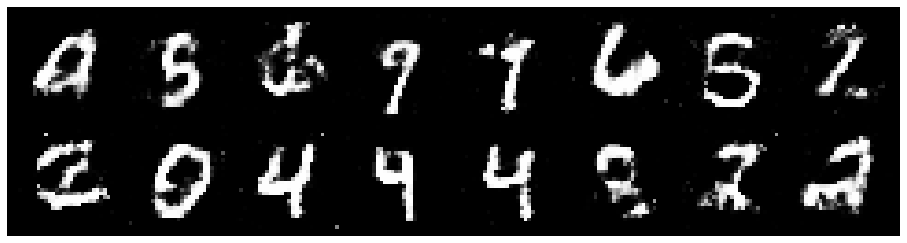

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.1284, Generator Loss: 0.9686
D(x): 0.6098, D(G(z)): 0.4070


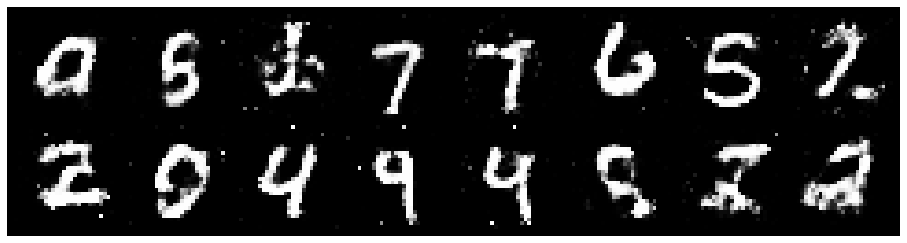

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2193, Generator Loss: 0.8797
D(x): 0.6039, D(G(z)): 0.4402


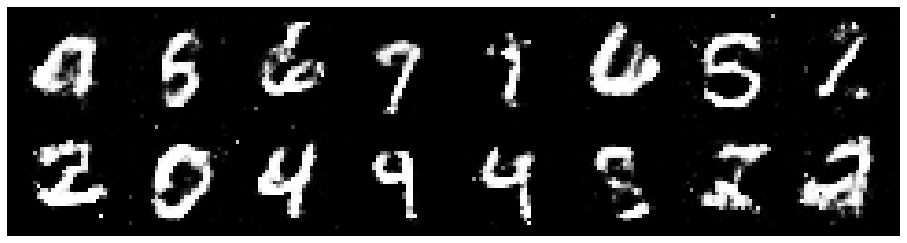

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.3083, Generator Loss: 0.9575
D(x): 0.6497, D(G(z)): 0.4759


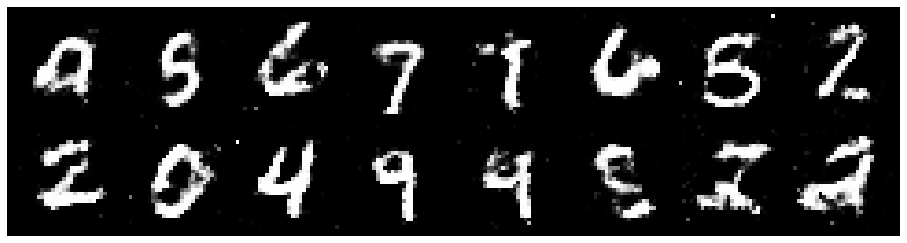

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3469, Generator Loss: 0.9603
D(x): 0.5669, D(G(z)): 0.4469


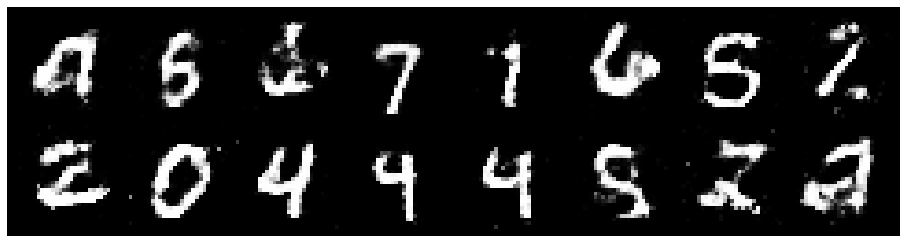

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.1642, Generator Loss: 1.1139
D(x): 0.5891, D(G(z)): 0.3976


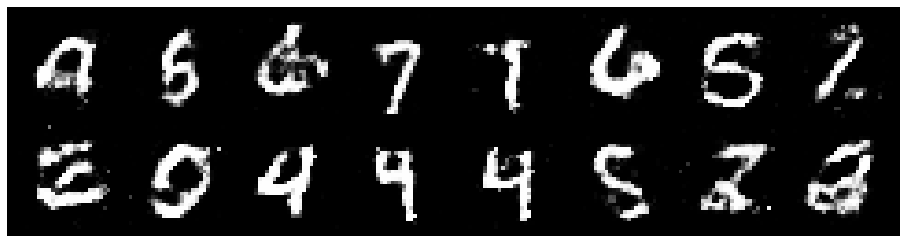

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1524, Generator Loss: 0.9079
D(x): 0.5846, D(G(z)): 0.3869


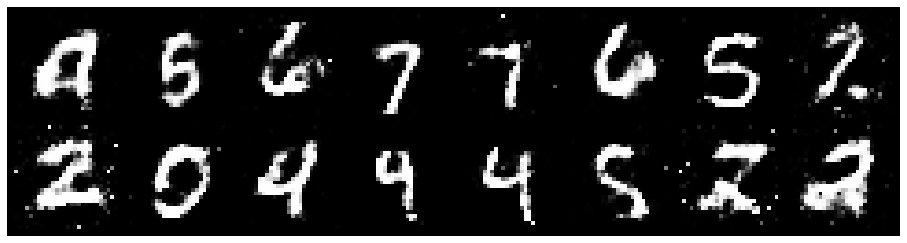

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2650, Generator Loss: 1.0485
D(x): 0.5553, D(G(z)): 0.4050


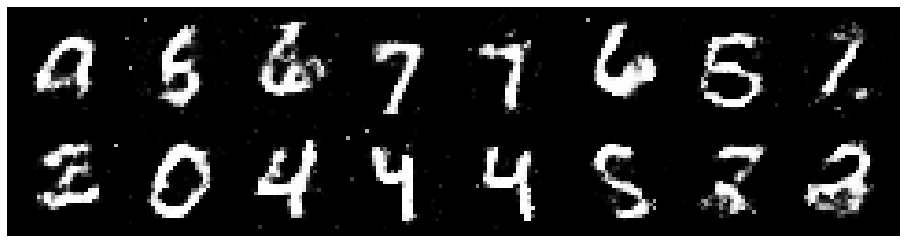

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.1958, Generator Loss: 0.9399
D(x): 0.5800, D(G(z)): 0.4152


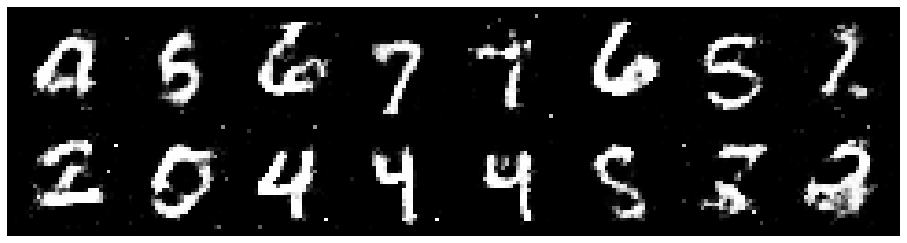

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1766, Generator Loss: 0.8999
D(x): 0.6191, D(G(z)): 0.4497


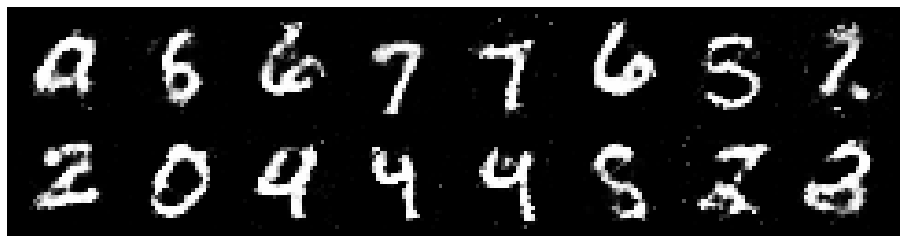

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.3011, Generator Loss: 0.9049
D(x): 0.5555, D(G(z)): 0.4366


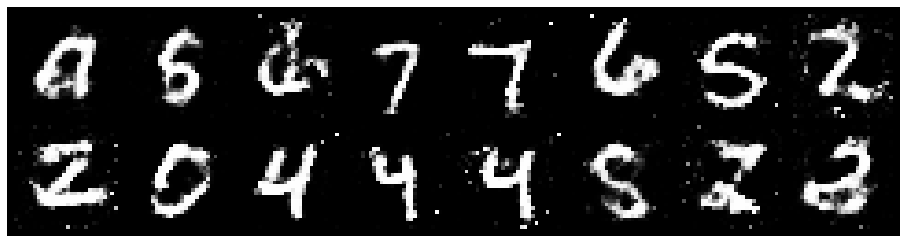

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.3504, Generator Loss: 0.9991
D(x): 0.5455, D(G(z)): 0.4577


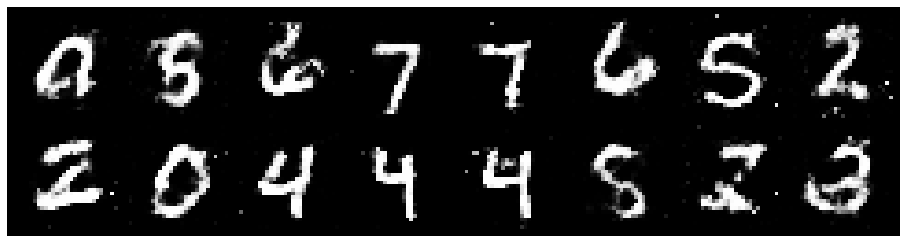

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.3799, Generator Loss: 0.9019
D(x): 0.5290, D(G(z)): 0.4791


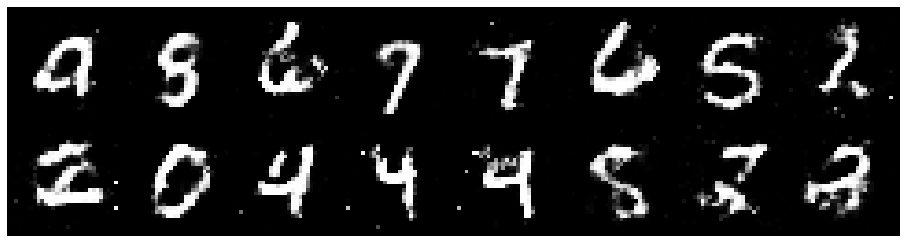

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.2756, Generator Loss: 0.8606
D(x): 0.5395, D(G(z)): 0.4306


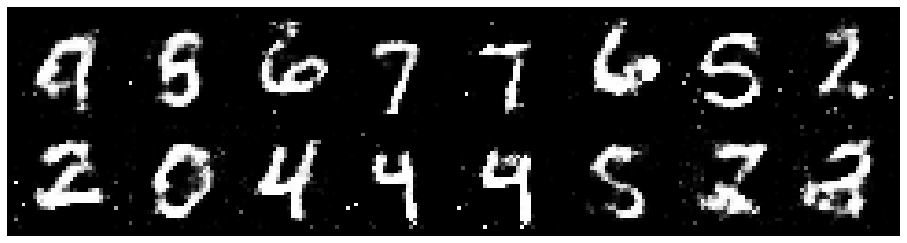

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3234, Generator Loss: 0.7546
D(x): 0.5658, D(G(z)): 0.4806


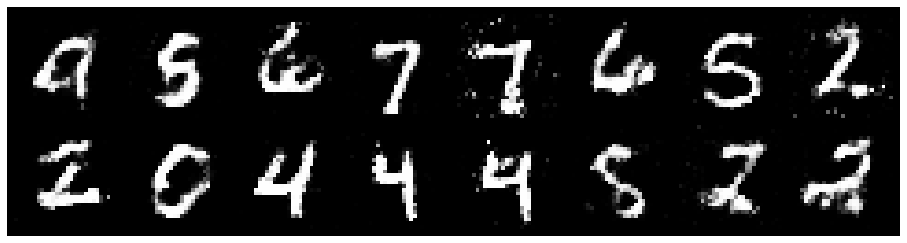

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3075, Generator Loss: 0.8721
D(x): 0.5632, D(G(z)): 0.4675


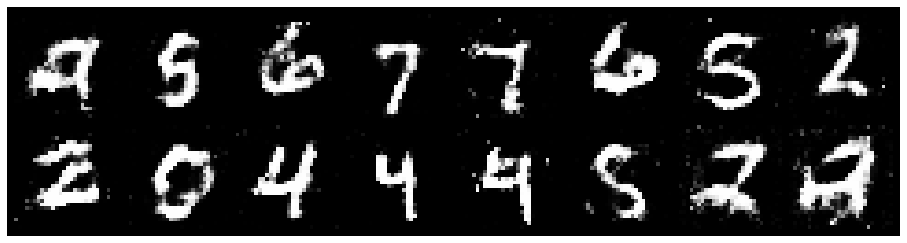

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.3345, Generator Loss: 0.8477
D(x): 0.5771, D(G(z)): 0.4902


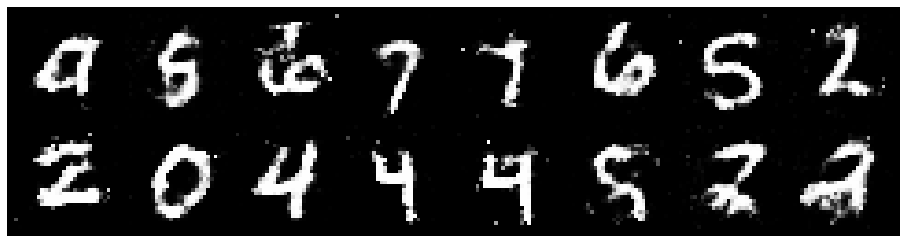

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2540, Generator Loss: 0.9533
D(x): 0.5747, D(G(z)): 0.4260


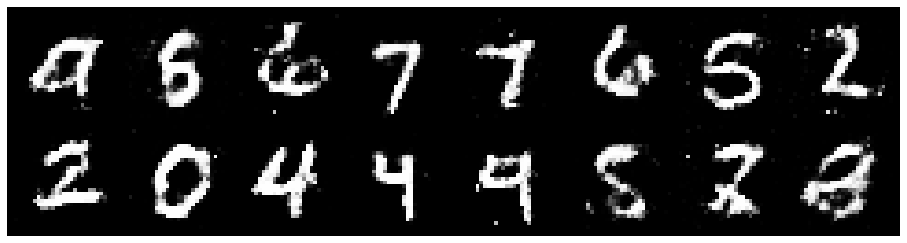

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2073, Generator Loss: 1.0704
D(x): 0.6477, D(G(z)): 0.4637


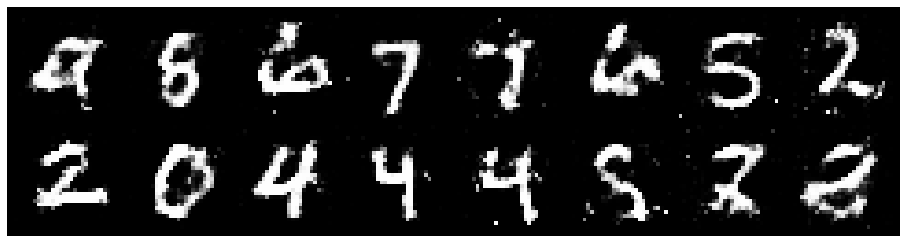

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.1785, Generator Loss: 0.9936
D(x): 0.6066, D(G(z)): 0.4305


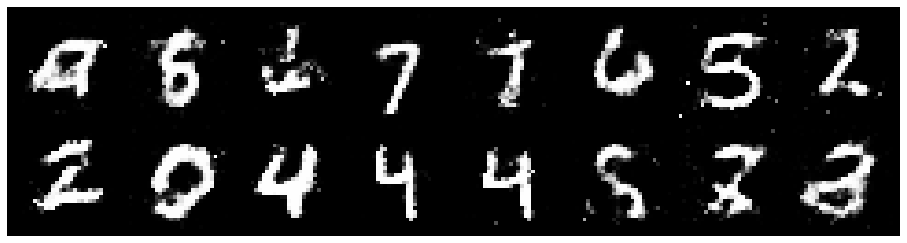

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.1619, Generator Loss: 0.9269
D(x): 0.6175, D(G(z)): 0.4107


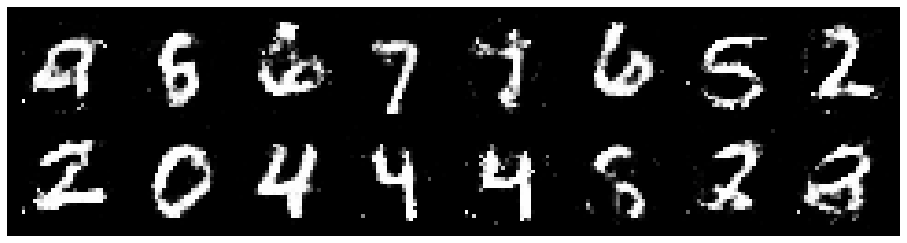

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.0884, Generator Loss: 1.0698
D(x): 0.6174, D(G(z)): 0.3929


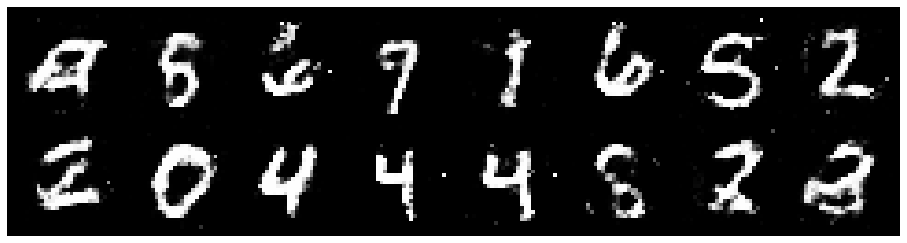

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9366
D(x): 0.5483, D(G(z)): 0.4001


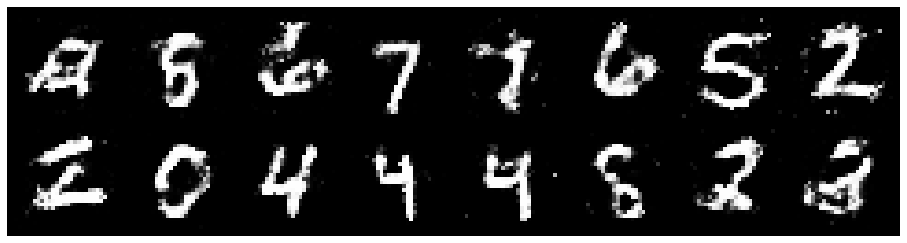

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2878, Generator Loss: 0.9943
D(x): 0.5400, D(G(z)): 0.4234


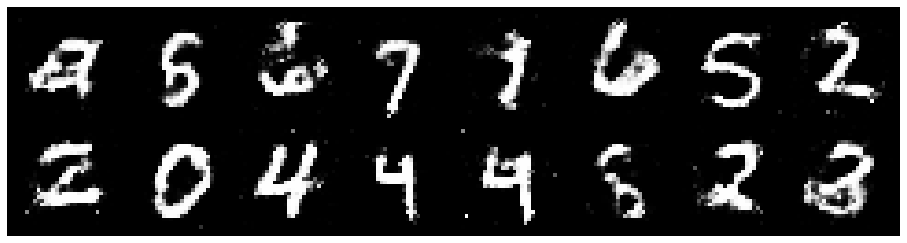

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.1666, Generator Loss: 0.9511
D(x): 0.5771, D(G(z)): 0.4255


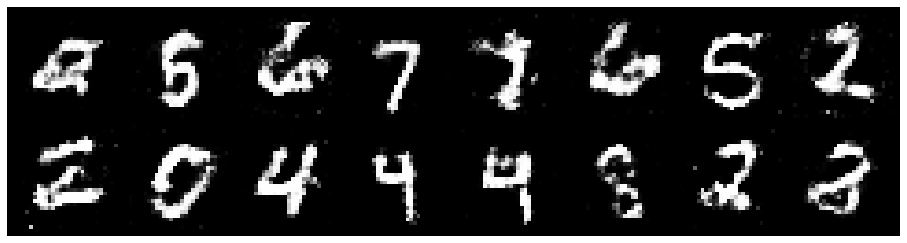

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2483, Generator Loss: 0.9581
D(x): 0.5257, D(G(z)): 0.4076


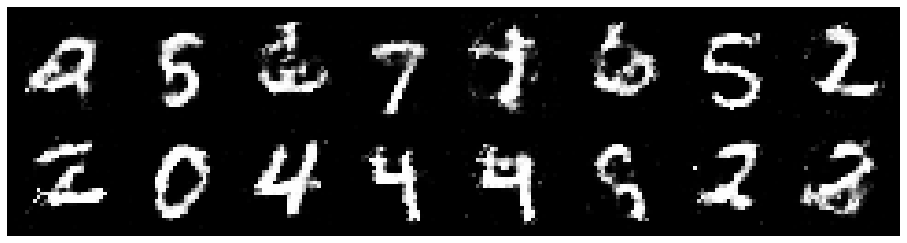

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2280, Generator Loss: 0.8534
D(x): 0.5706, D(G(z)): 0.4544


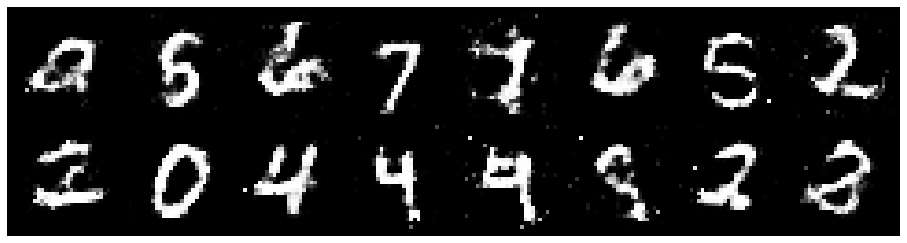

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.3478, Generator Loss: 0.8602
D(x): 0.5392, D(G(z)): 0.4733


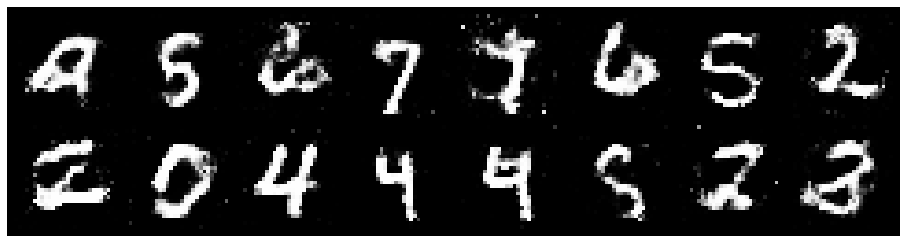

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8762
D(x): 0.5493, D(G(z)): 0.4542


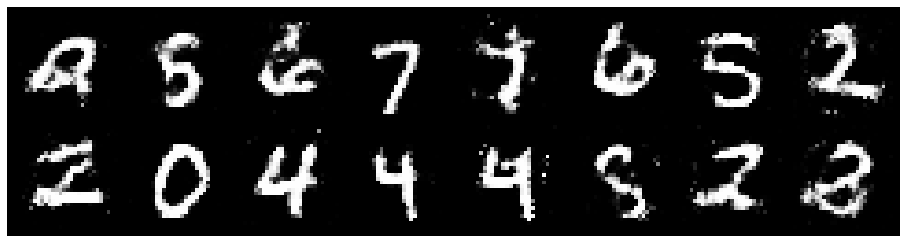

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.3405, Generator Loss: 0.8063
D(x): 0.5052, D(G(z)): 0.4521


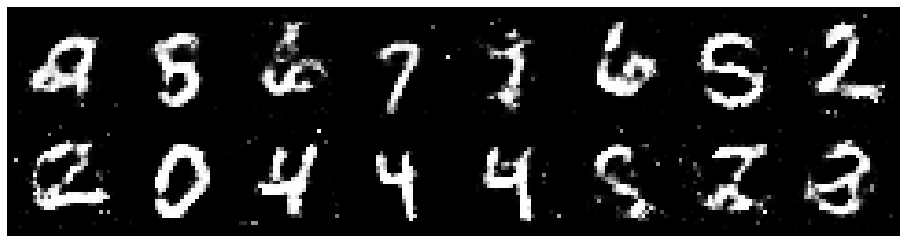

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3685, Generator Loss: 0.7806
D(x): 0.5456, D(G(z)): 0.4665


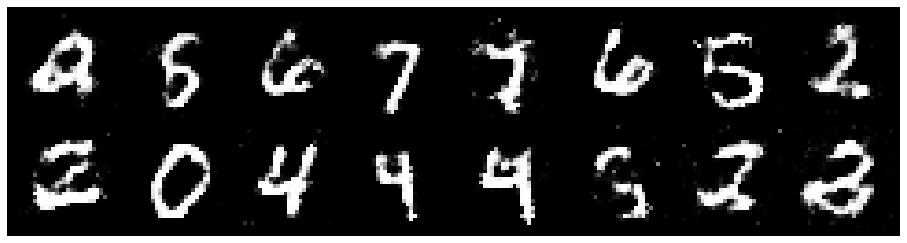

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2441, Generator Loss: 0.8369
D(x): 0.5679, D(G(z)): 0.4516


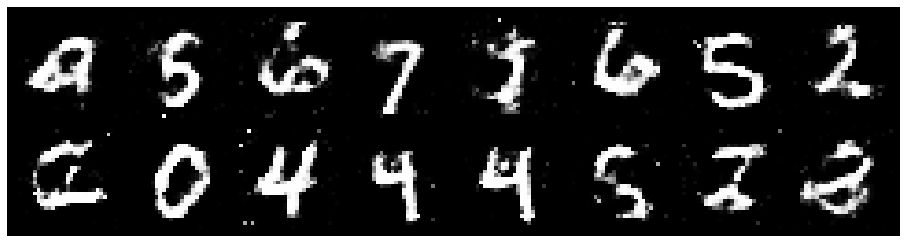

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2753, Generator Loss: 0.8860
D(x): 0.5611, D(G(z)): 0.4631


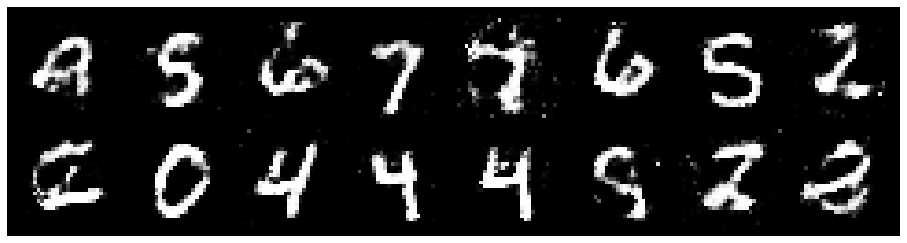

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2661, Generator Loss: 0.9321
D(x): 0.5605, D(G(z)): 0.4419


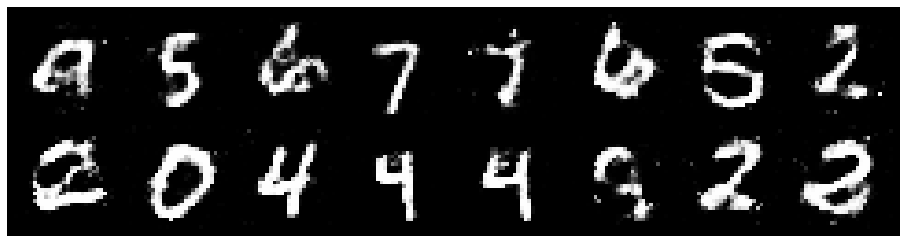

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3219, Generator Loss: 0.8358
D(x): 0.5996, D(G(z)): 0.4860


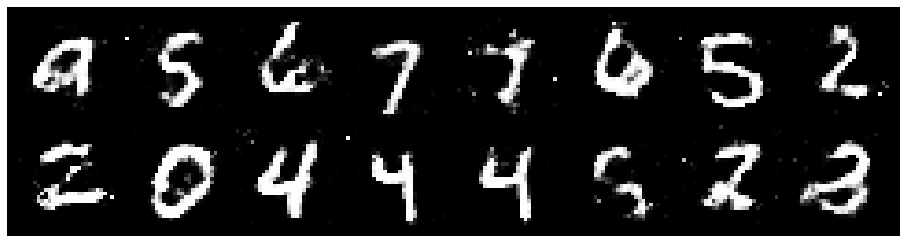

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2723, Generator Loss: 1.1022
D(x): 0.5847, D(G(z)): 0.4111


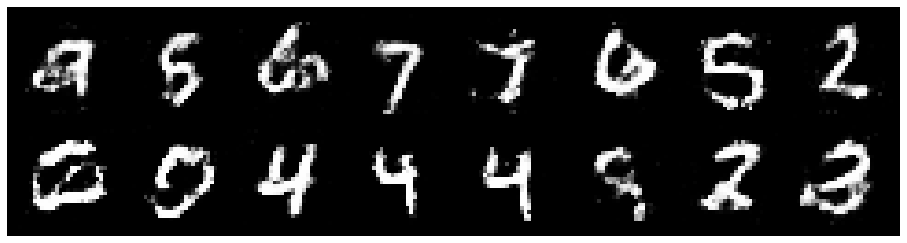

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3832, Generator Loss: 0.7208
D(x): 0.5376, D(G(z)): 0.4853


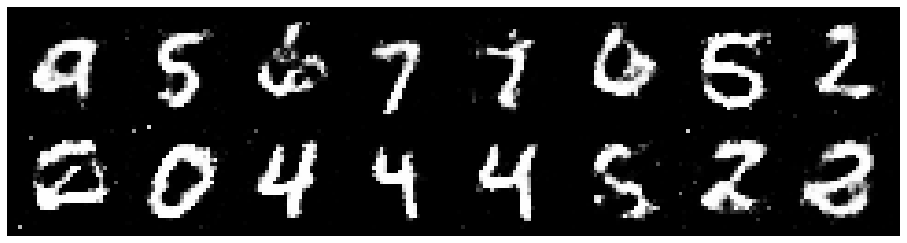

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.3443, Generator Loss: 0.9125
D(x): 0.5344, D(G(z)): 0.4365


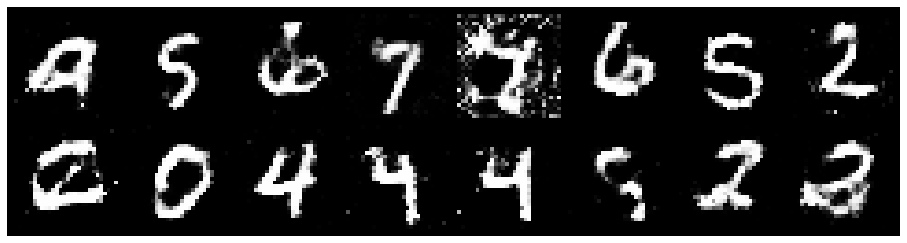

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2150, Generator Loss: 0.9822
D(x): 0.5993, D(G(z)): 0.4448


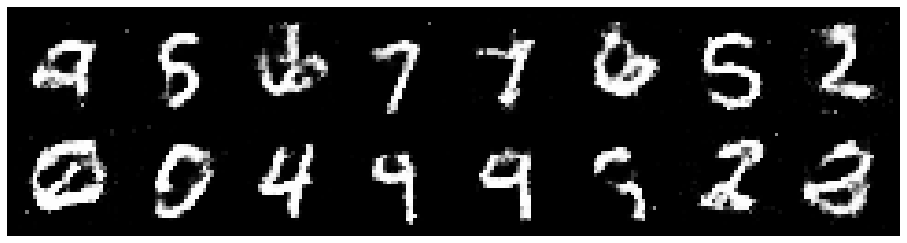

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2521, Generator Loss: 0.9945
D(x): 0.5982, D(G(z)): 0.4614


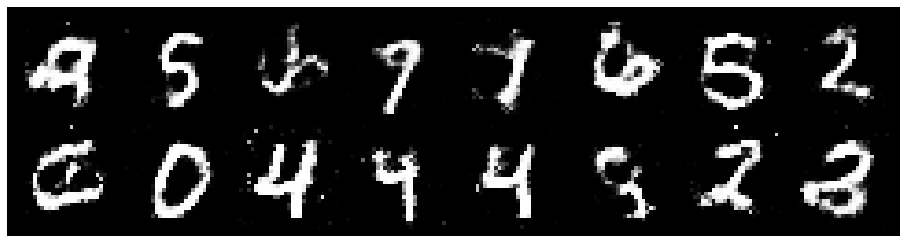

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2304, Generator Loss: 1.0496
D(x): 0.5627, D(G(z)): 0.4234


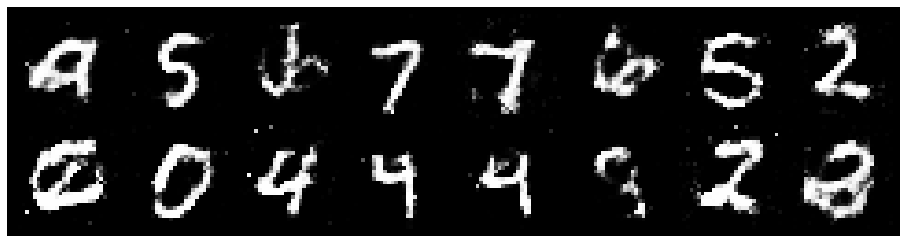

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2991, Generator Loss: 0.9050
D(x): 0.5772, D(G(z)): 0.4793


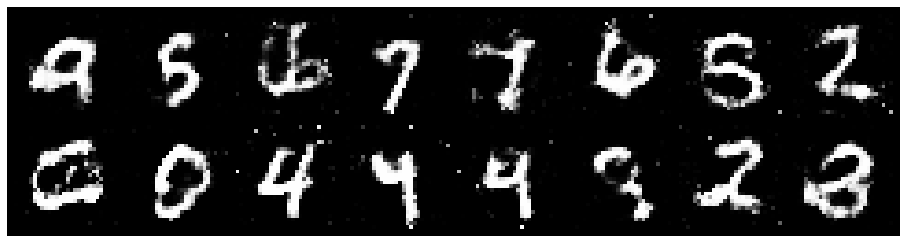

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2797, Generator Loss: 0.8794
D(x): 0.5596, D(G(z)): 0.4439


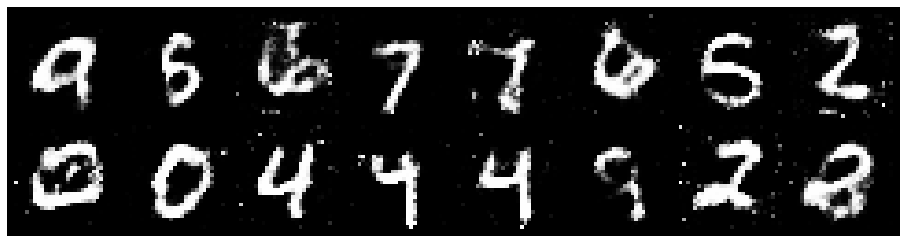

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.3678, Generator Loss: 0.8139
D(x): 0.5380, D(G(z)): 0.4532


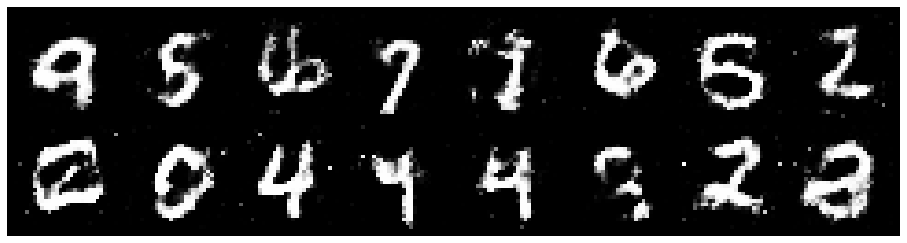

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.1671, Generator Loss: 0.9631
D(x): 0.6185, D(G(z)): 0.4190


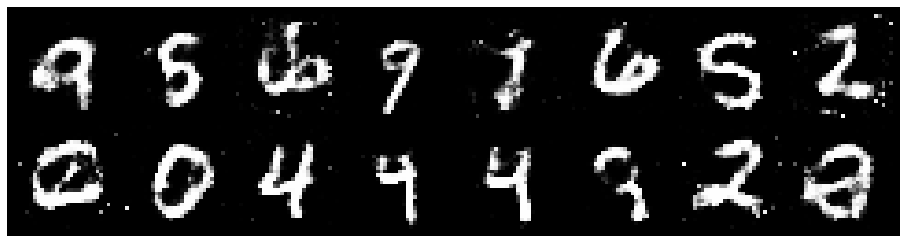

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2044, Generator Loss: 0.8104
D(x): 0.5798, D(G(z)): 0.4474


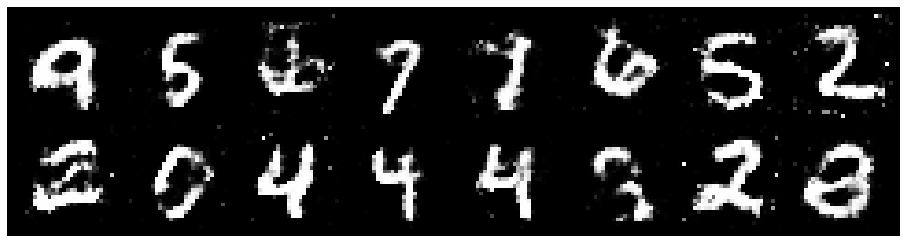

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2198, Generator Loss: 0.9432
D(x): 0.5606, D(G(z)): 0.4301


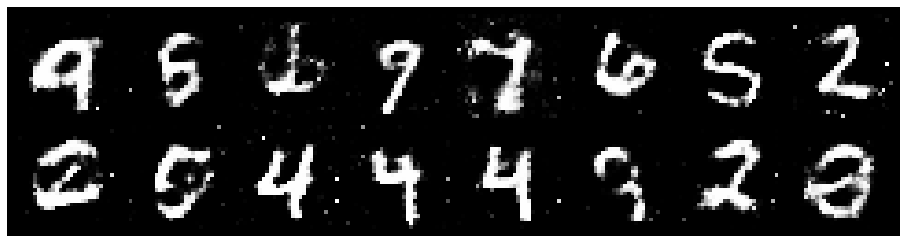

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2907, Generator Loss: 0.9453
D(x): 0.5886, D(G(z)): 0.4766


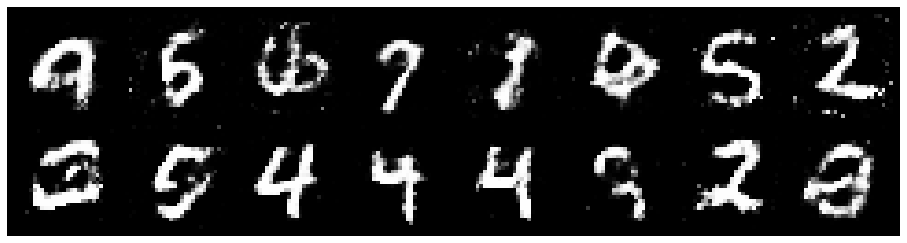

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2917, Generator Loss: 1.0934
D(x): 0.5560, D(G(z)): 0.4186


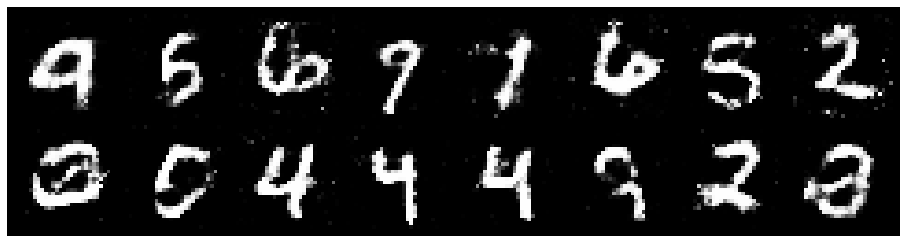

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2552, Generator Loss: 0.8815
D(x): 0.5810, D(G(z)): 0.4444


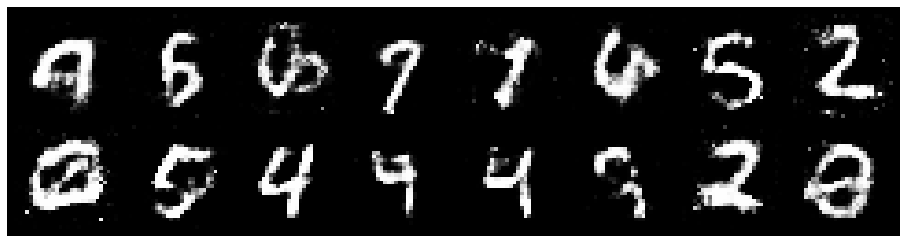

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2605, Generator Loss: 0.9668
D(x): 0.5141, D(G(z)): 0.3974


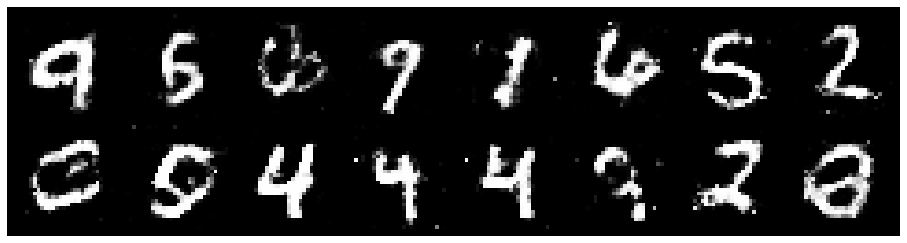

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.1986, Generator Loss: 1.0679
D(x): 0.5347, D(G(z)): 0.3715


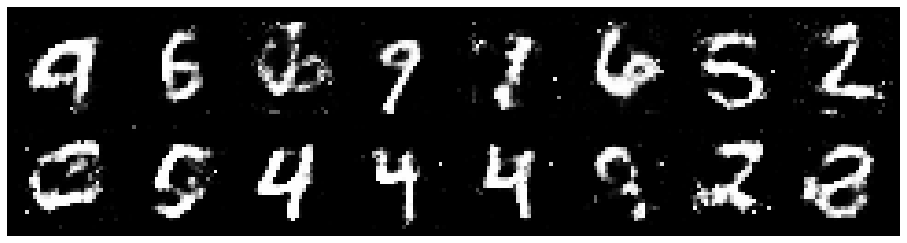

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.1804, Generator Loss: 0.9102
D(x): 0.5934, D(G(z)): 0.4155


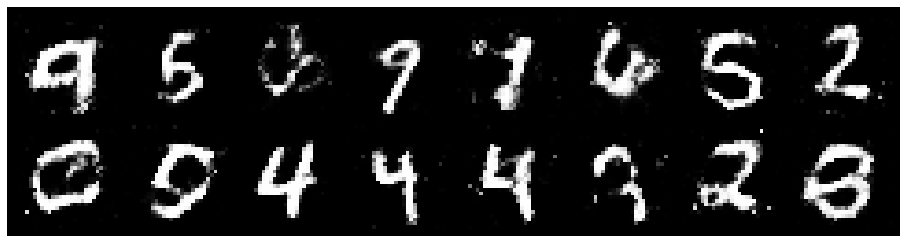

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2739, Generator Loss: 0.9268
D(x): 0.5540, D(G(z)): 0.4374


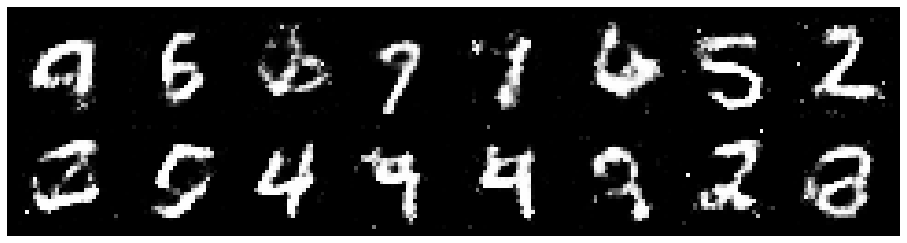

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2907, Generator Loss: 0.9827
D(x): 0.5627, D(G(z)): 0.4344


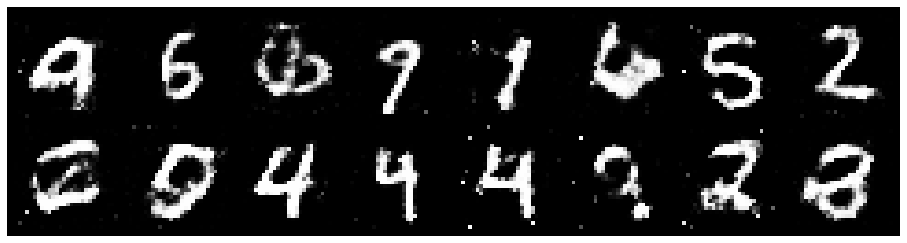

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2895, Generator Loss: 1.1524
D(x): 0.5564, D(G(z)): 0.4378


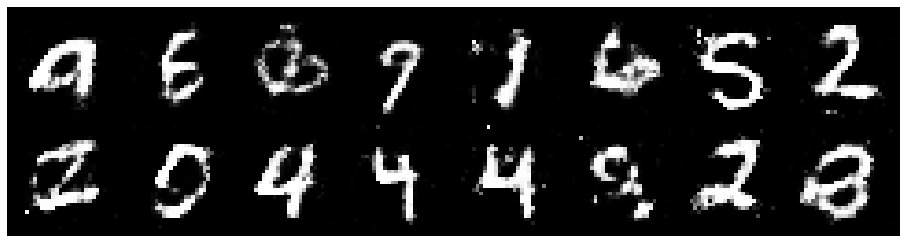

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.2871, Generator Loss: 1.1043
D(x): 0.5264, D(G(z)): 0.4045


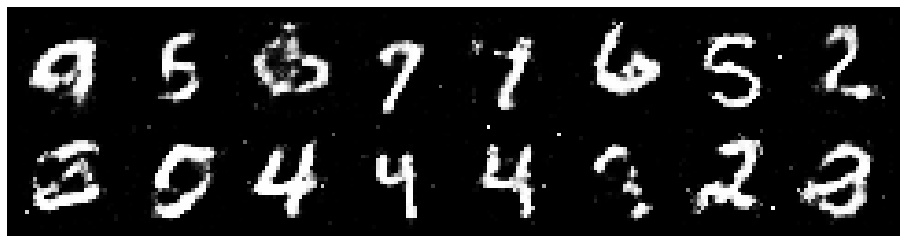

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2007, Generator Loss: 0.9186
D(x): 0.5382, D(G(z)): 0.3985


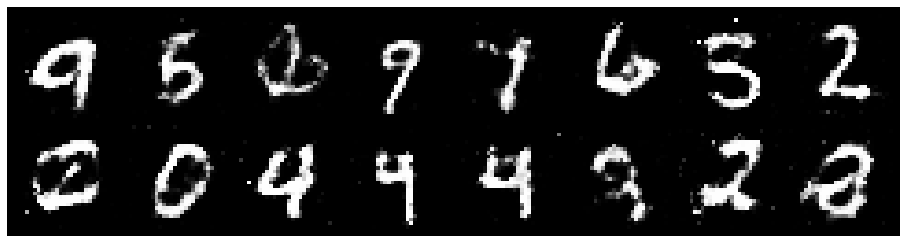

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.2616, Generator Loss: 0.8416
D(x): 0.5585, D(G(z)): 0.4484


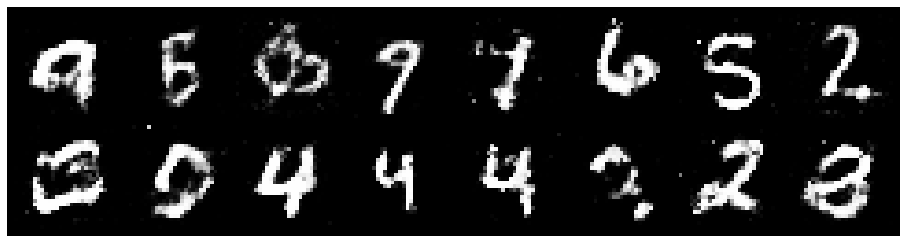

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2443, Generator Loss: 0.7819
D(x): 0.5620, D(G(z)): 0.4490


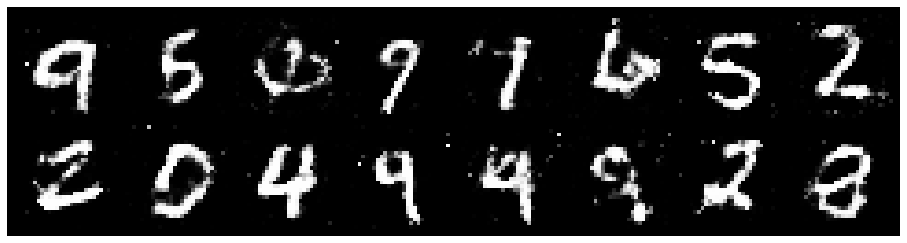

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2760, Generator Loss: 0.9840
D(x): 0.5434, D(G(z)): 0.4431


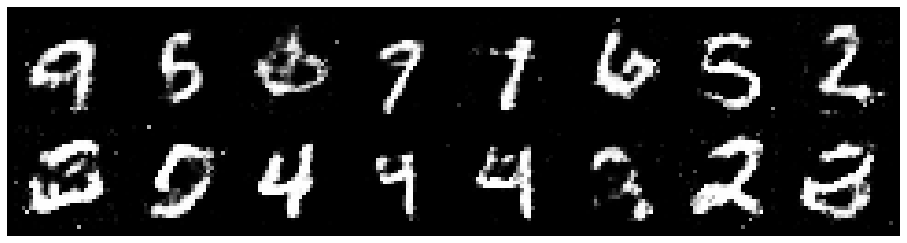

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2692, Generator Loss: 0.8337
D(x): 0.5597, D(G(z)): 0.4558


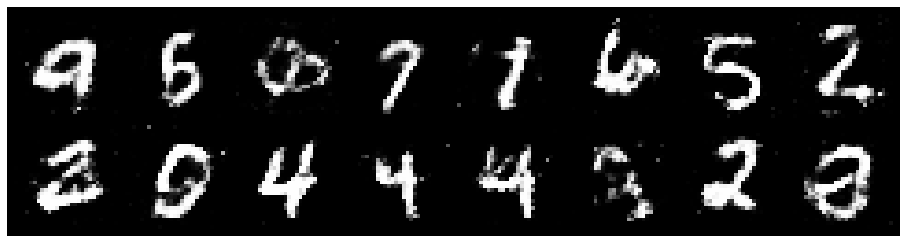

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.3267, Generator Loss: 0.8508
D(x): 0.5328, D(G(z)): 0.4647


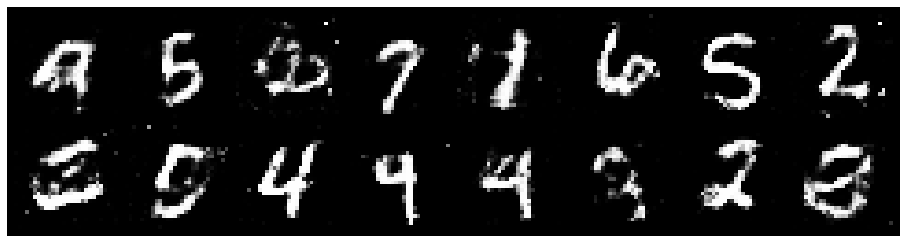

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.3237, Generator Loss: 0.9441
D(x): 0.5247, D(G(z)): 0.4380


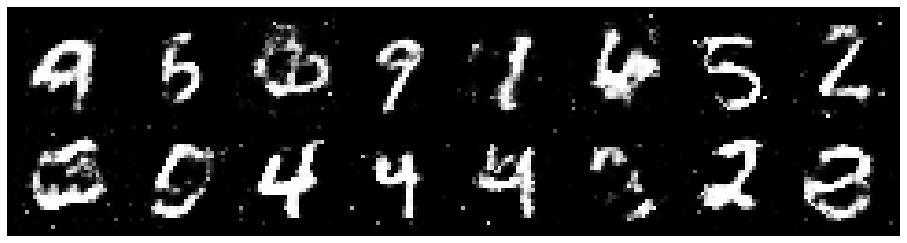

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.1960, Generator Loss: 1.1156
D(x): 0.5575, D(G(z)): 0.3916


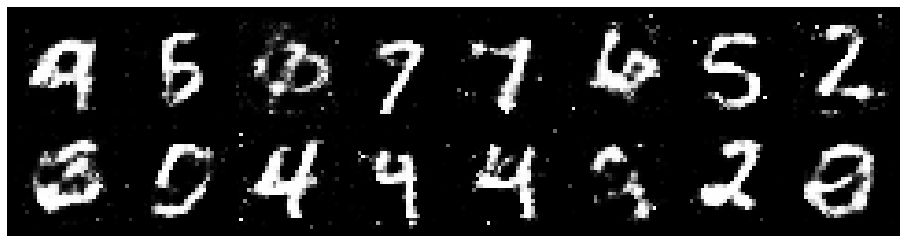

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2284, Generator Loss: 0.9499
D(x): 0.6213, D(G(z)): 0.4520


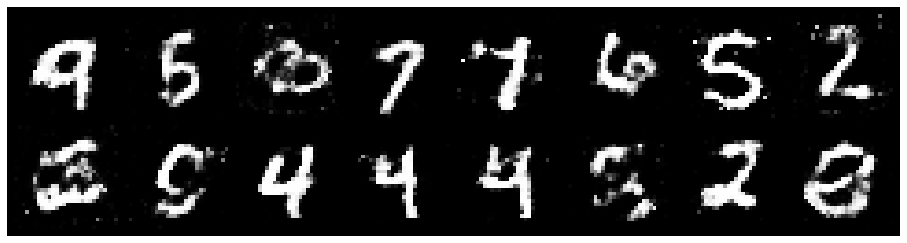

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2935, Generator Loss: 0.9645
D(x): 0.5685, D(G(z)): 0.4377


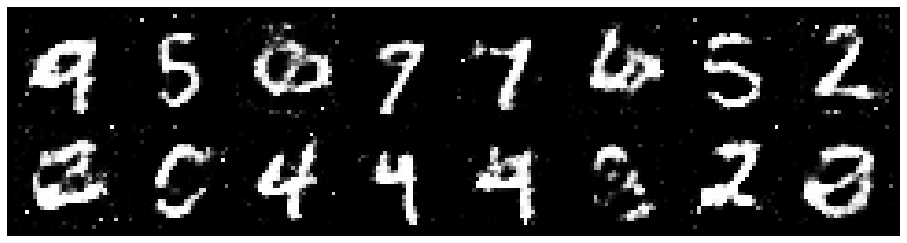

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.1899, Generator Loss: 0.9690
D(x): 0.5969, D(G(z)): 0.4286


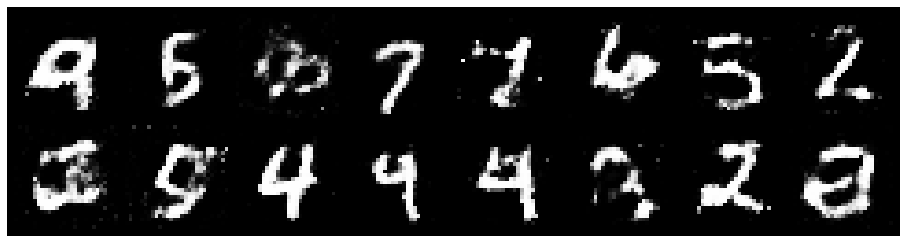

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1907, Generator Loss: 1.0502
D(x): 0.5657, D(G(z)): 0.3726


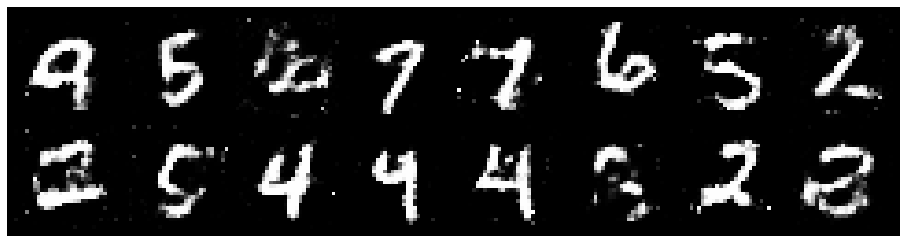

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.1602, Generator Loss: 1.1491
D(x): 0.6607, D(G(z)): 0.4316


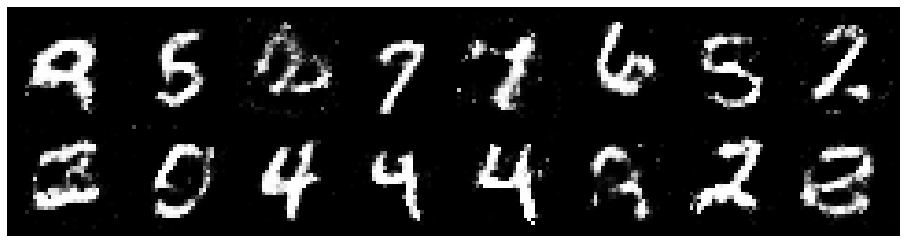

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2287, Generator Loss: 1.0296
D(x): 0.6109, D(G(z)): 0.4417


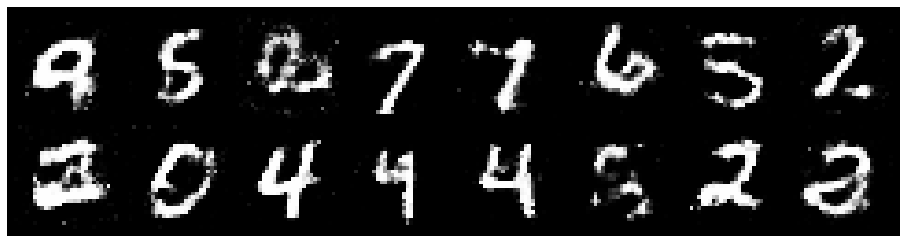

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9092
D(x): 0.5580, D(G(z)): 0.4579


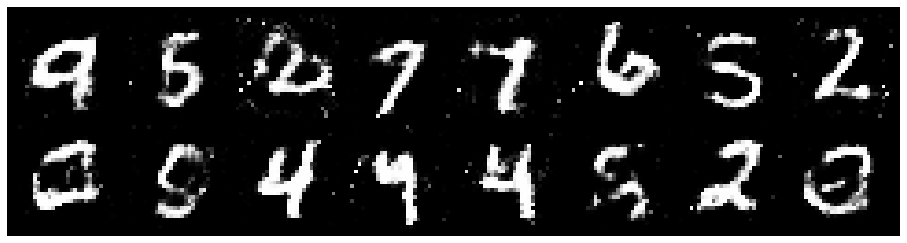

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2220, Generator Loss: 1.0534
D(x): 0.5553, D(G(z)): 0.4053


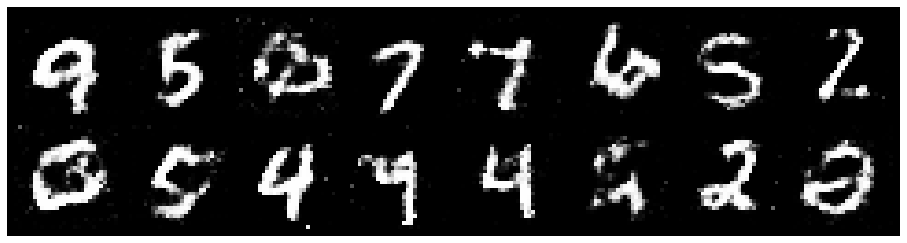

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2730, Generator Loss: 0.9028
D(x): 0.5791, D(G(z)): 0.4602


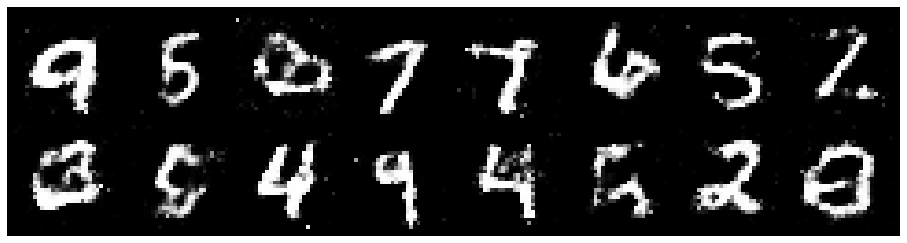

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.3480, Generator Loss: 0.8200
D(x): 0.5188, D(G(z)): 0.4753


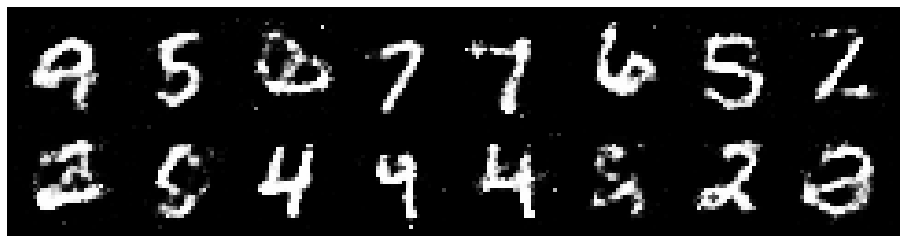

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2323, Generator Loss: 0.9342
D(x): 0.5609, D(G(z)): 0.4230


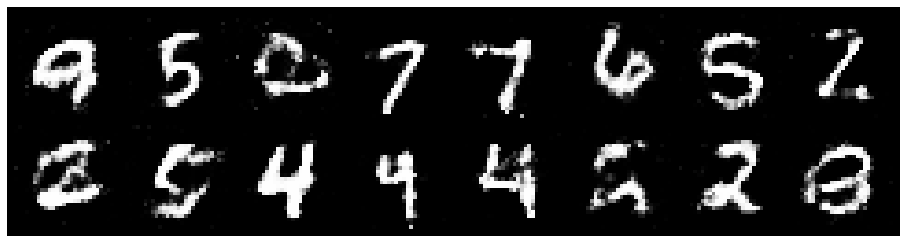

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3172, Generator Loss: 0.9345
D(x): 0.6146, D(G(z)): 0.5024


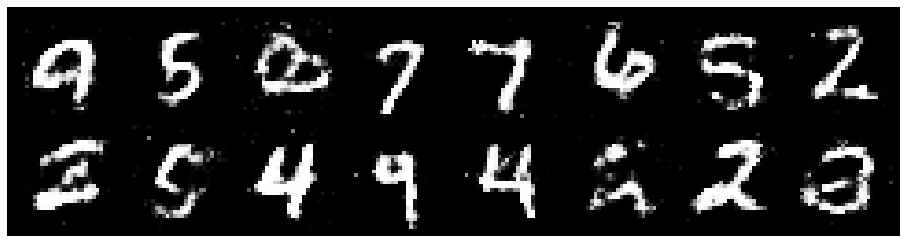

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.3131, Generator Loss: 0.8409
D(x): 0.5368, D(G(z)): 0.4470


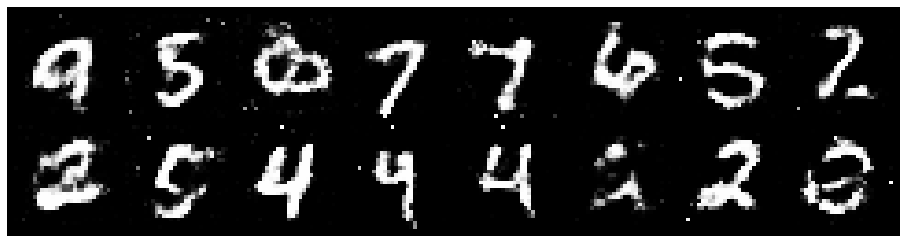

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2818, Generator Loss: 0.9479
D(x): 0.5205, D(G(z)): 0.4151


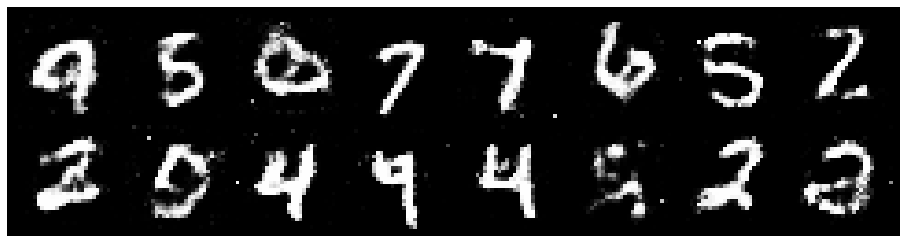

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2729, Generator Loss: 0.8579
D(x): 0.5804, D(G(z)): 0.4594


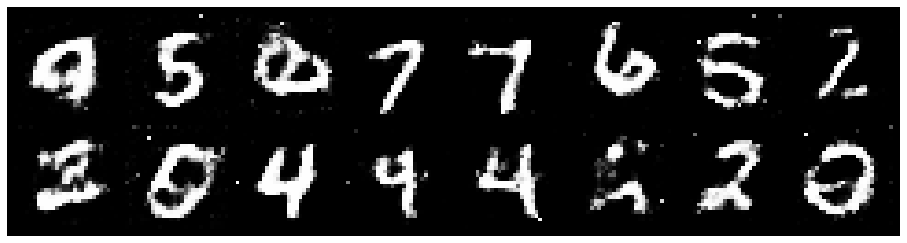

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3064, Generator Loss: 0.8529
D(x): 0.5600, D(G(z)): 0.4664


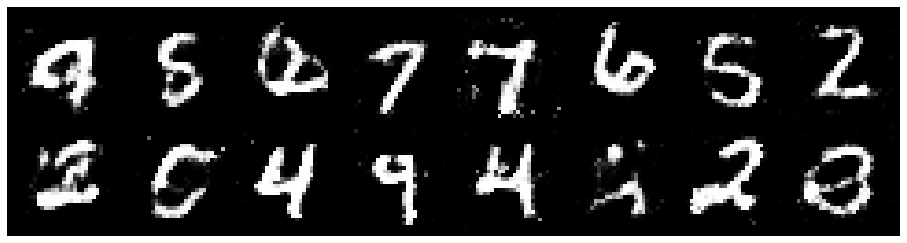

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.3492, Generator Loss: 0.7241
D(x): 0.5714, D(G(z)): 0.5087


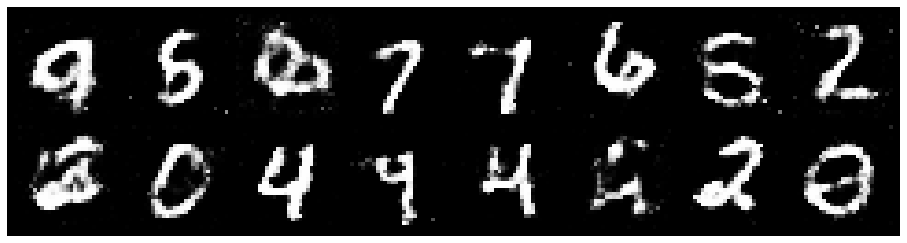

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3523, Generator Loss: 0.7074
D(x): 0.5610, D(G(z)): 0.4986


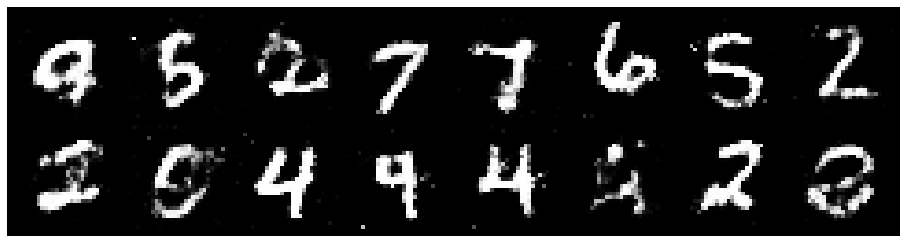

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.3755, Generator Loss: 0.7841
D(x): 0.5237, D(G(z)): 0.4775


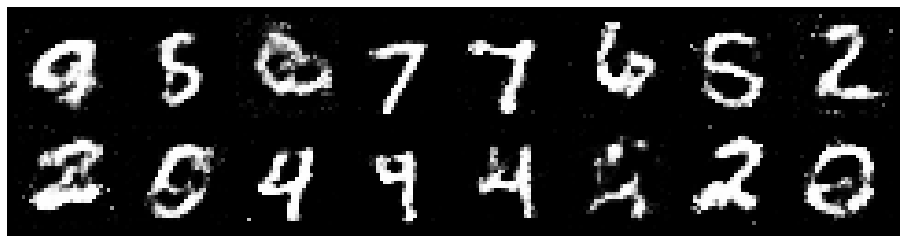

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.4489, Generator Loss: 0.7654
D(x): 0.5699, D(G(z)): 0.5279


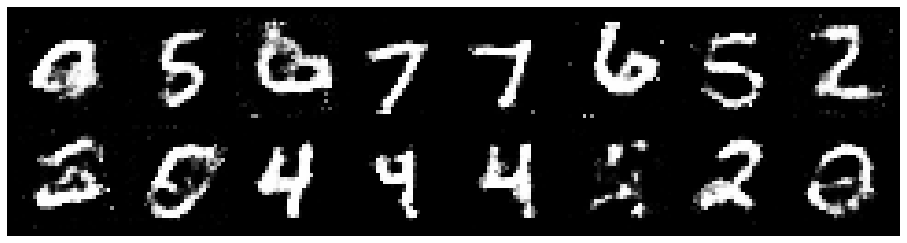

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2855, Generator Loss: 0.8799
D(x): 0.5736, D(G(z)): 0.4713


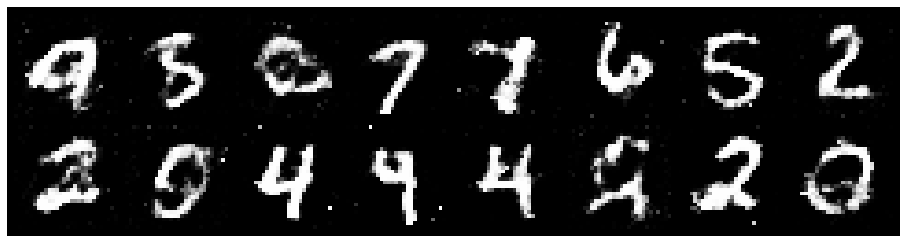

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2560, Generator Loss: 0.9964
D(x): 0.5643, D(G(z)): 0.4237


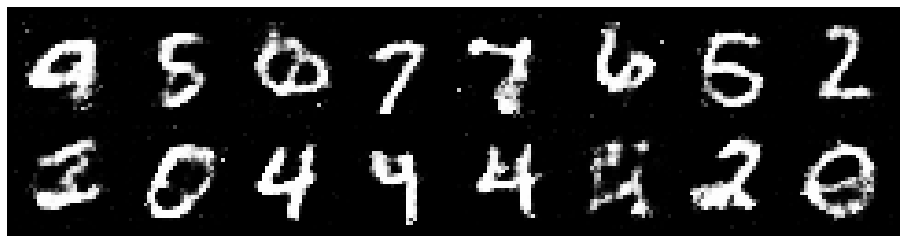

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3730, Generator Loss: 0.8788
D(x): 0.5337, D(G(z)): 0.4693


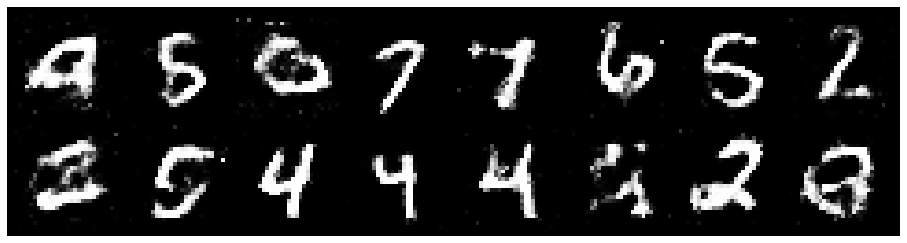

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2168, Generator Loss: 0.9473
D(x): 0.5878, D(G(z)): 0.4400


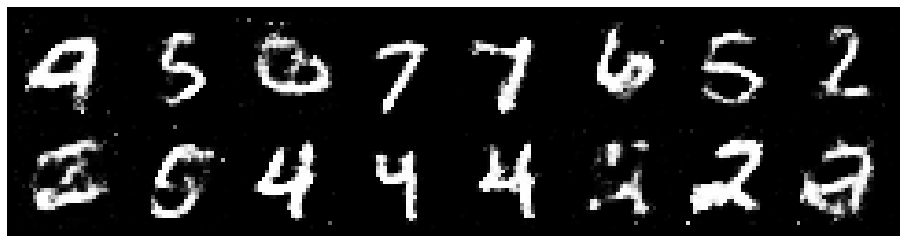

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.1641, Generator Loss: 0.9168
D(x): 0.6043, D(G(z)): 0.4130


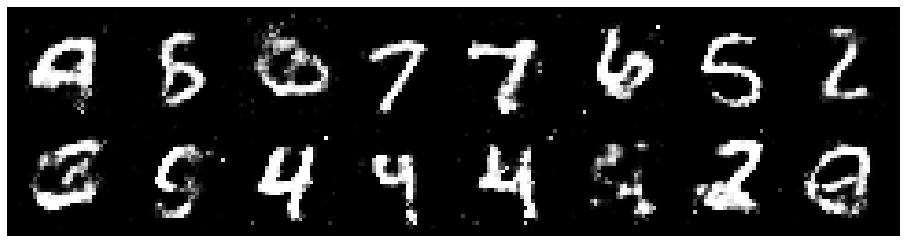

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1984, Generator Loss: 1.1082
D(x): 0.5512, D(G(z)): 0.3951


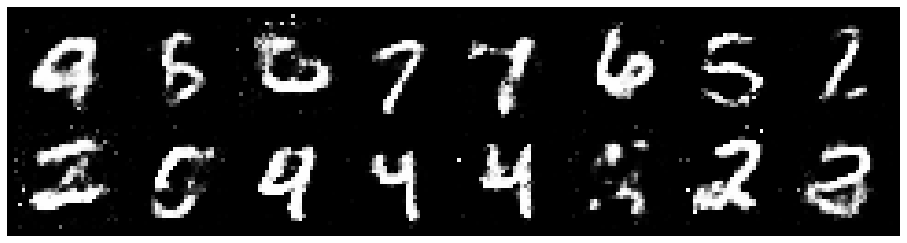

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2595, Generator Loss: 1.0921
D(x): 0.5391, D(G(z)): 0.4032


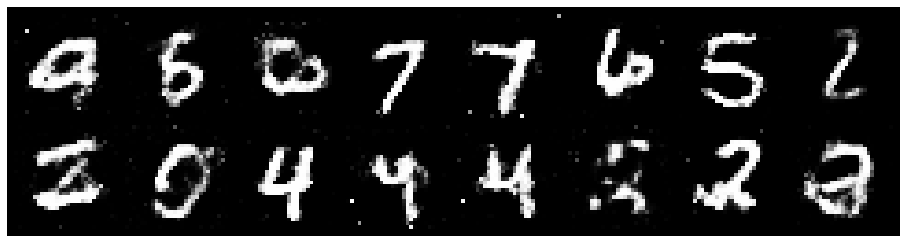

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2249, Generator Loss: 0.8827
D(x): 0.5424, D(G(z)): 0.4049


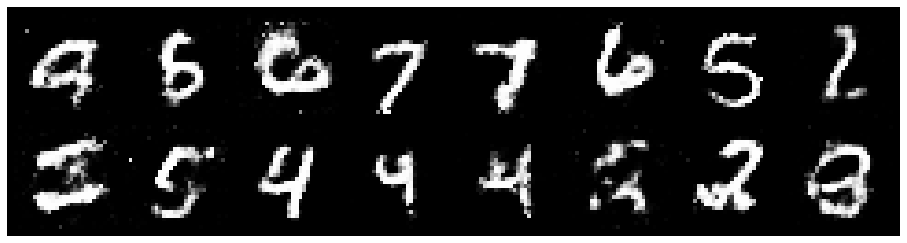

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.2941, Generator Loss: 0.8634
D(x): 0.5691, D(G(z)): 0.4665


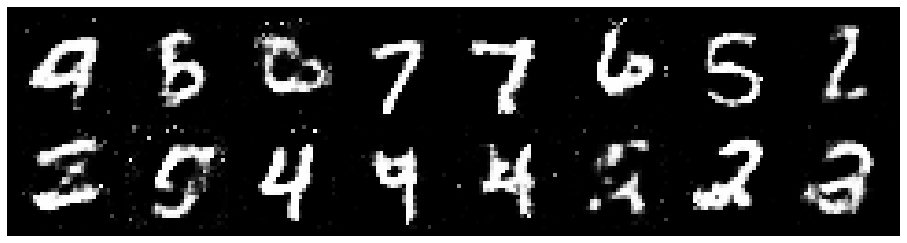

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2073, Generator Loss: 0.9694
D(x): 0.5821, D(G(z)): 0.4256


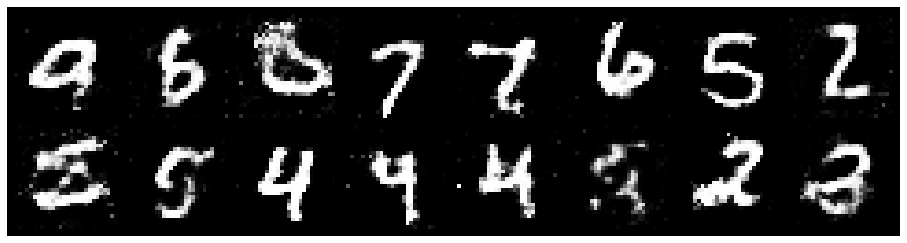

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.3205, Generator Loss: 0.8756
D(x): 0.5622, D(G(z)): 0.4661


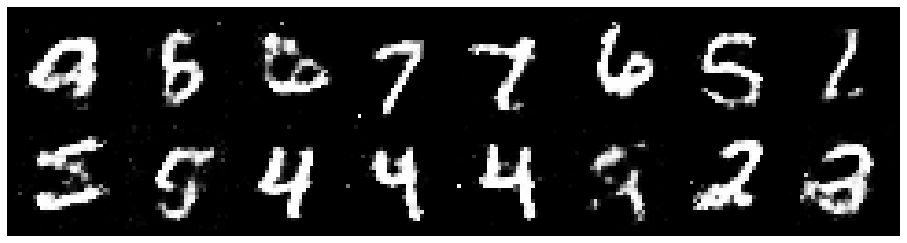

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2925, Generator Loss: 0.8768
D(x): 0.5722, D(G(z)): 0.4780


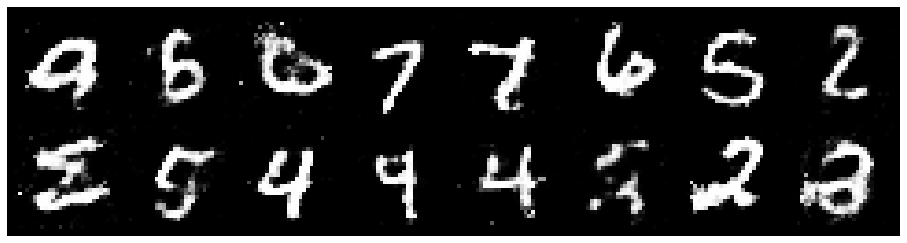

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.2270, Generator Loss: 0.8526
D(x): 0.5837, D(G(z)): 0.4415


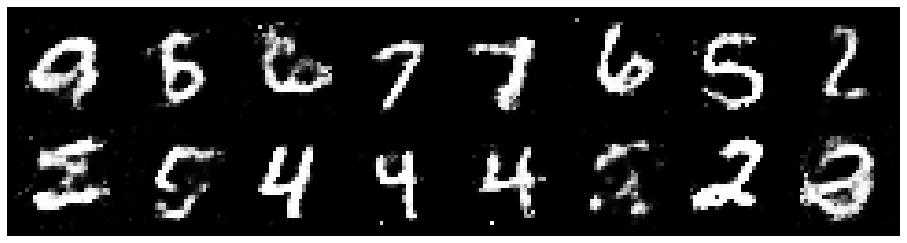

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2017, Generator Loss: 0.9640
D(x): 0.5607, D(G(z)): 0.4239


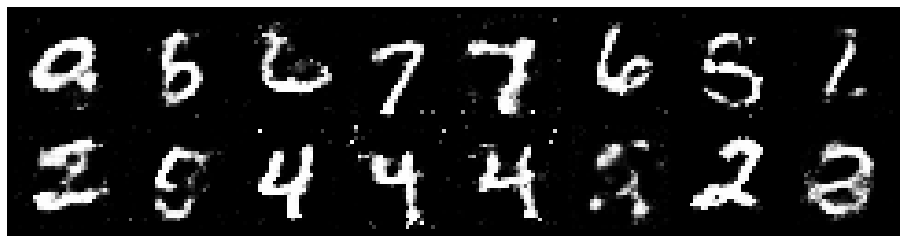

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2782, Generator Loss: 0.8605
D(x): 0.5743, D(G(z)): 0.4701


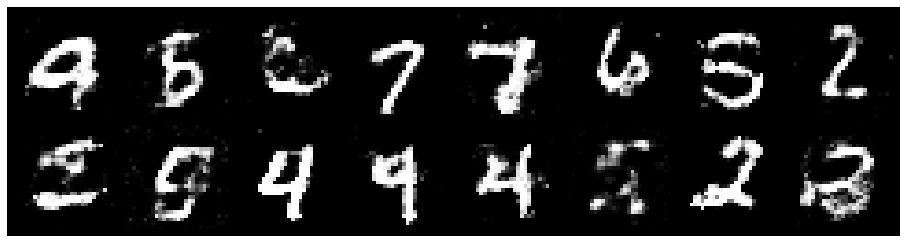

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.2259, Generator Loss: 0.8291
D(x): 0.5441, D(G(z)): 0.4223


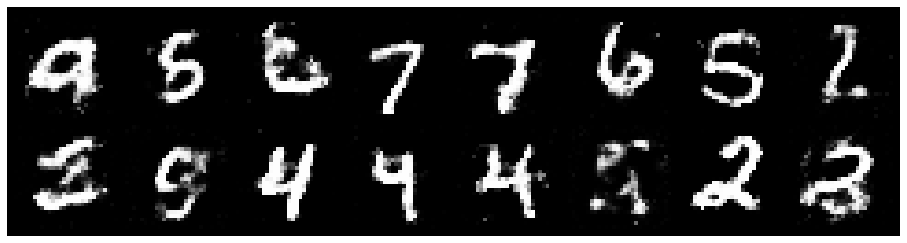

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3093, Generator Loss: 0.8400
D(x): 0.5172, D(G(z)): 0.4428


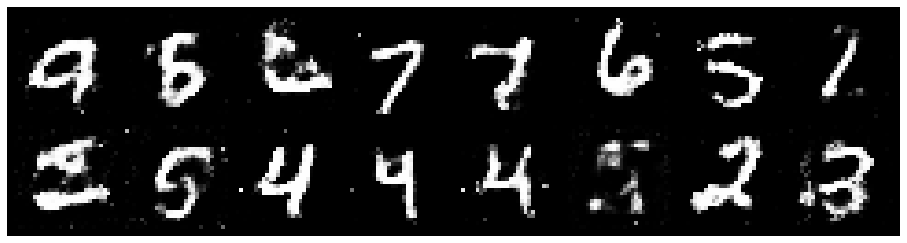

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2401, Generator Loss: 0.8499
D(x): 0.5588, D(G(z)): 0.4333


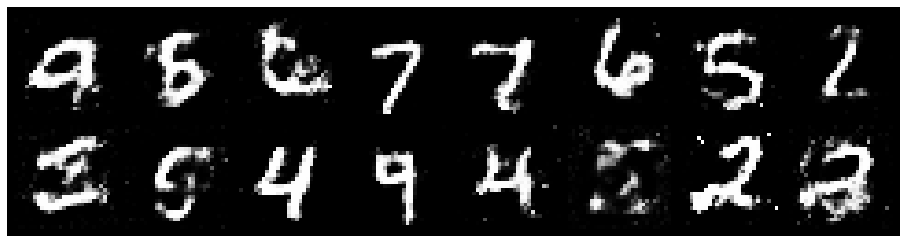

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.2373, Generator Loss: 0.9206
D(x): 0.5423, D(G(z)): 0.4201


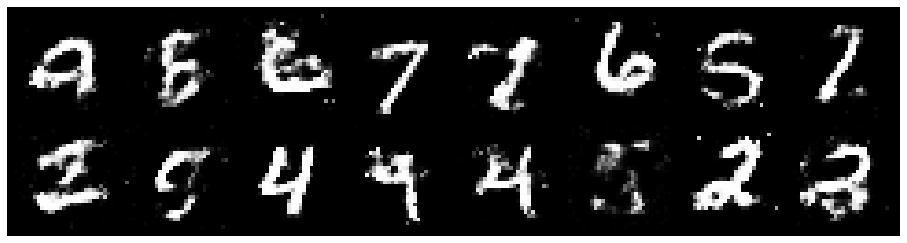

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.1968, Generator Loss: 0.8377
D(x): 0.5593, D(G(z)): 0.4255


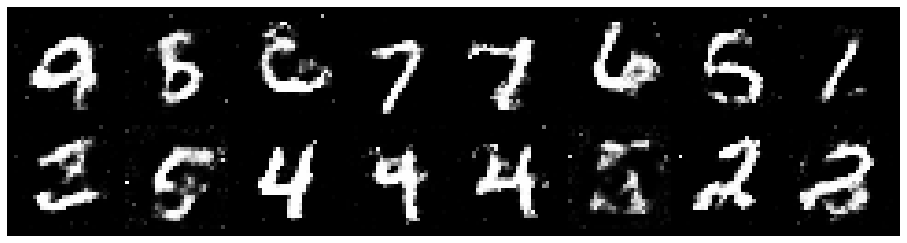

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2492, Generator Loss: 1.0557
D(x): 0.5250, D(G(z)): 0.4120


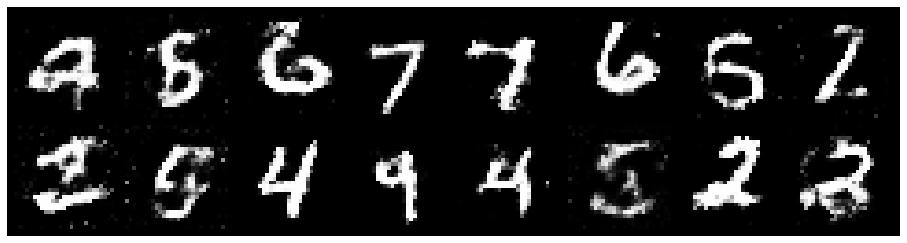

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.1251, Generator Loss: 1.0251
D(x): 0.6188, D(G(z)): 0.4110


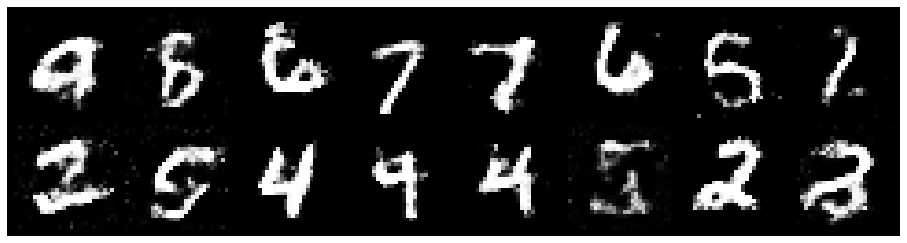

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2979, Generator Loss: 0.9038
D(x): 0.5100, D(G(z)): 0.4147


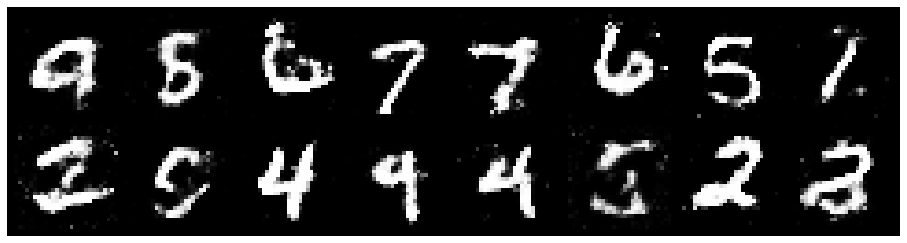

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2319, Generator Loss: 0.8692
D(x): 0.5707, D(G(z)): 0.4417


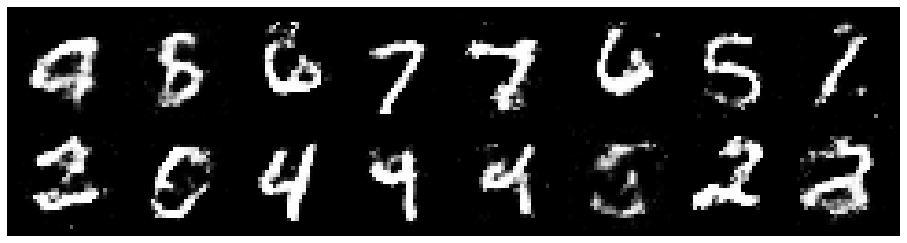

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2913, Generator Loss: 1.0776
D(x): 0.5497, D(G(z)): 0.4454


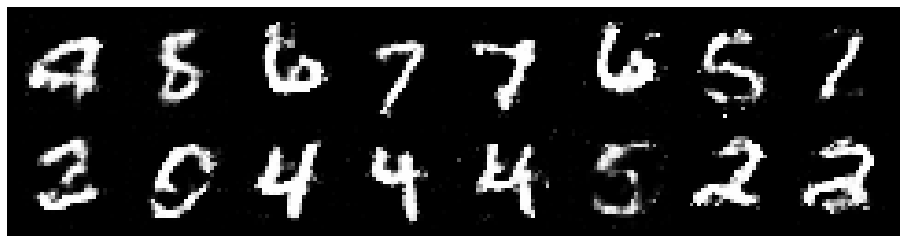

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2655, Generator Loss: 0.8174
D(x): 0.5946, D(G(z)): 0.4776


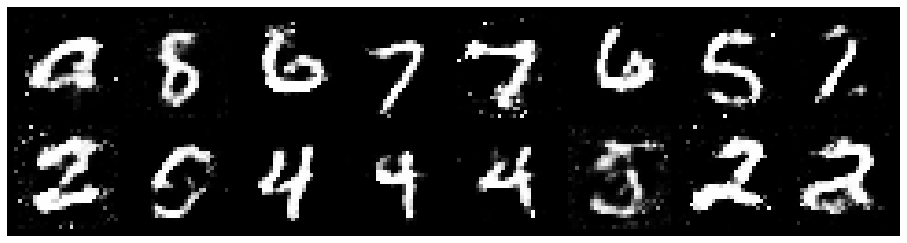

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.3178, Generator Loss: 0.9014
D(x): 0.5580, D(G(z)): 0.4631


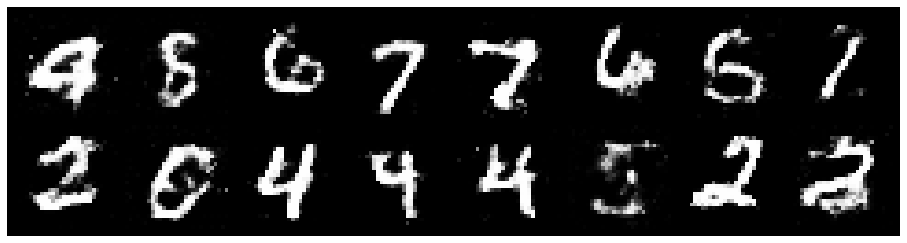

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.3290, Generator Loss: 0.8290
D(x): 0.5424, D(G(z)): 0.4724


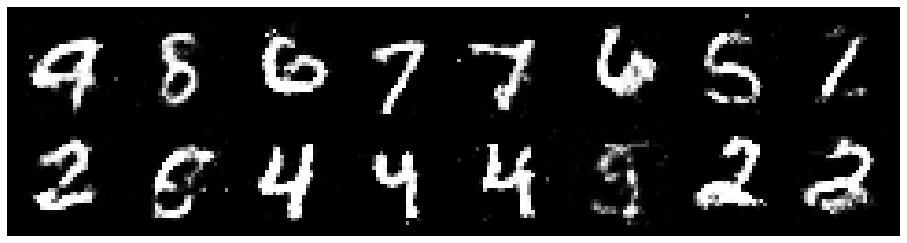

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3740, Generator Loss: 0.8152
D(x): 0.5621, D(G(z)): 0.4869


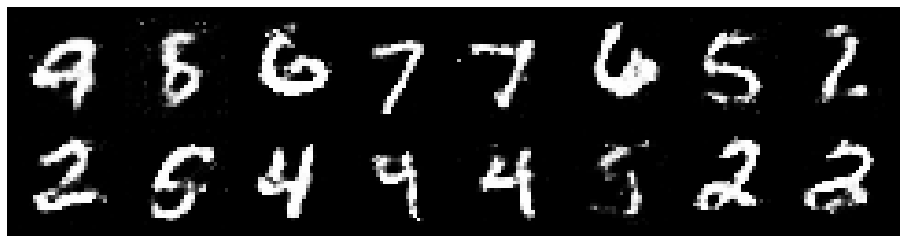

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.3298, Generator Loss: 0.8655
D(x): 0.5248, D(G(z)): 0.4532


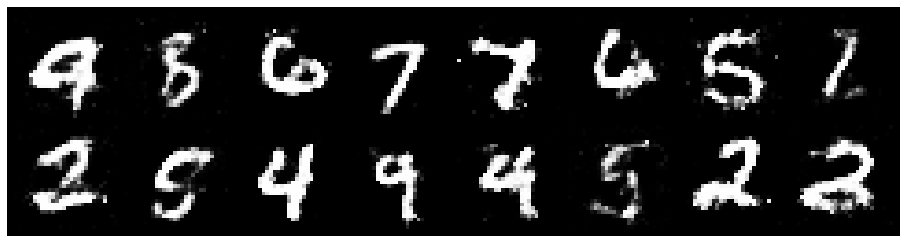

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2995, Generator Loss: 0.9245
D(x): 0.5328, D(G(z)): 0.4425


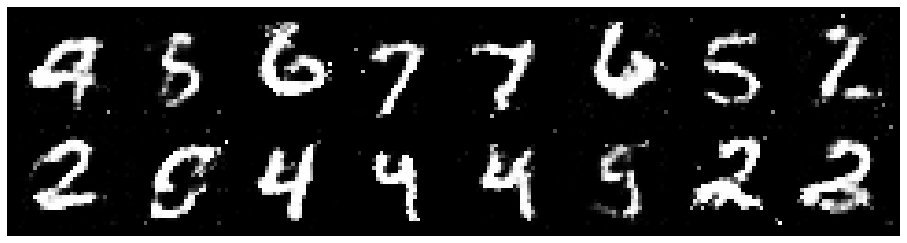

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.3602, Generator Loss: 0.8670
D(x): 0.5515, D(G(z)): 0.4744


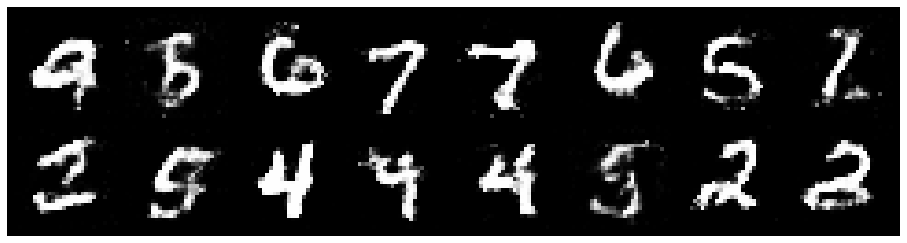

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.1762, Generator Loss: 0.8679
D(x): 0.5909, D(G(z)): 0.4348


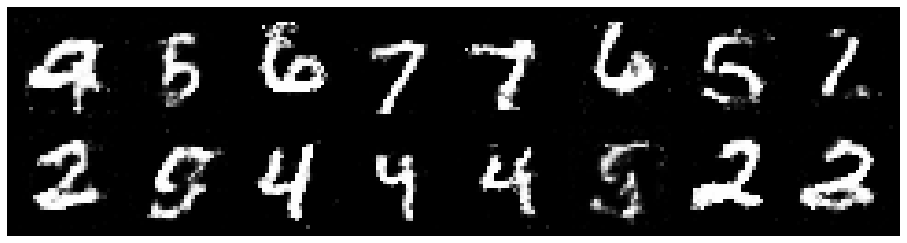

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.3372, Generator Loss: 1.0118
D(x): 0.5116, D(G(z)): 0.4186


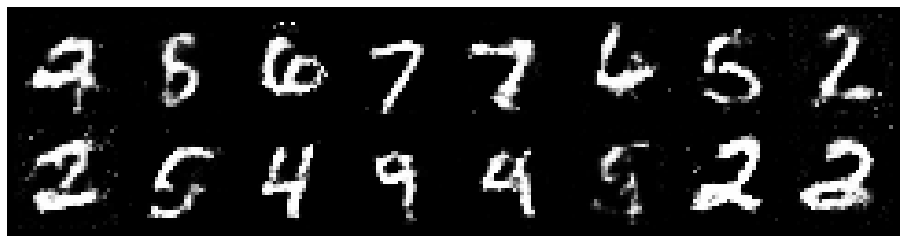

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.3442, Generator Loss: 0.9262
D(x): 0.5423, D(G(z)): 0.4583


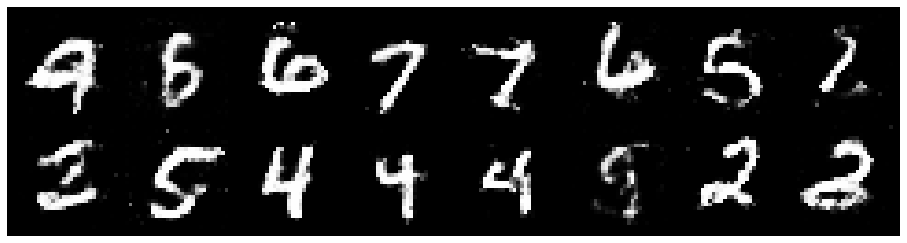

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.3223, Generator Loss: 0.7877
D(x): 0.5289, D(G(z)): 0.4750


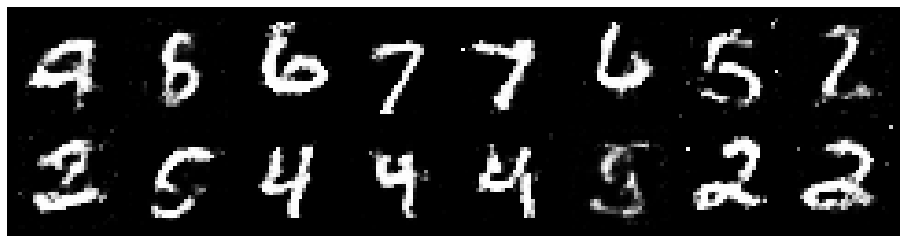

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3393, Generator Loss: 0.7906
D(x): 0.5074, D(G(z)): 0.4464


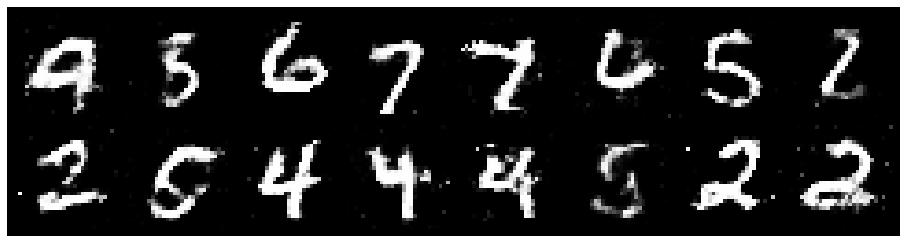

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3851, Generator Loss: 0.8996
D(x): 0.4997, D(G(z)): 0.4332


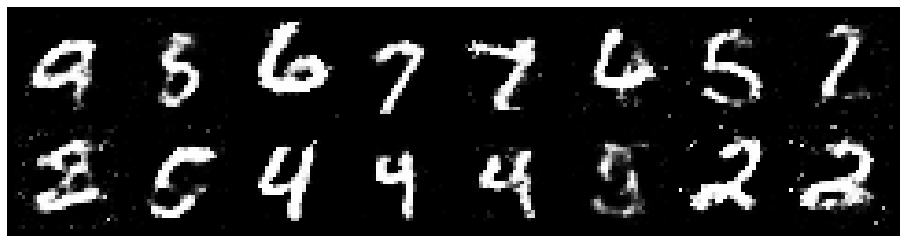

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.4014, Generator Loss: 0.8440
D(x): 0.5780, D(G(z)): 0.5413


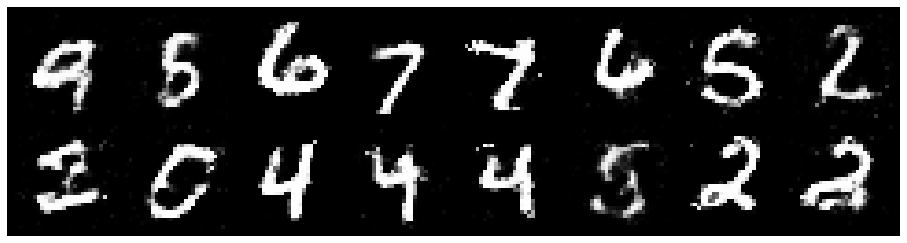

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.3472, Generator Loss: 0.8770
D(x): 0.5723, D(G(z)): 0.4725


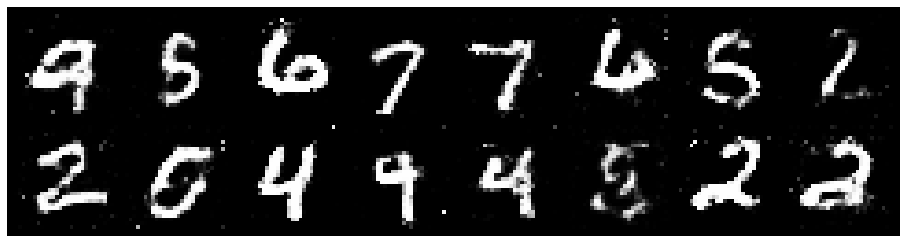

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.1867, Generator Loss: 0.9359
D(x): 0.5629, D(G(z)): 0.4205


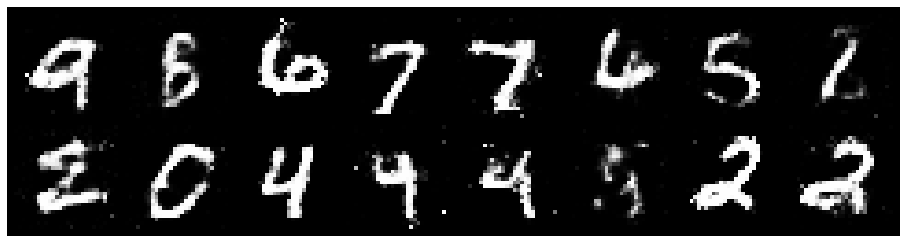

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2982, Generator Loss: 0.8763
D(x): 0.5714, D(G(z)): 0.4561


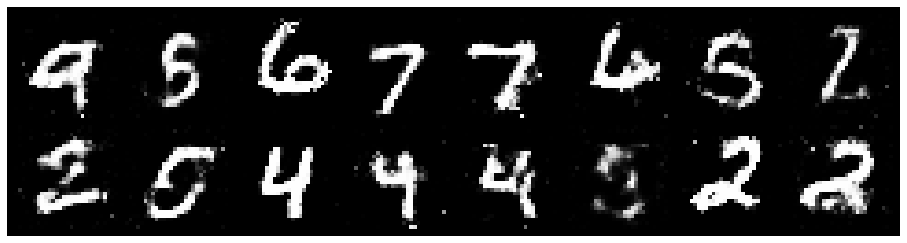

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2644, Generator Loss: 0.9883
D(x): 0.5195, D(G(z)): 0.4060


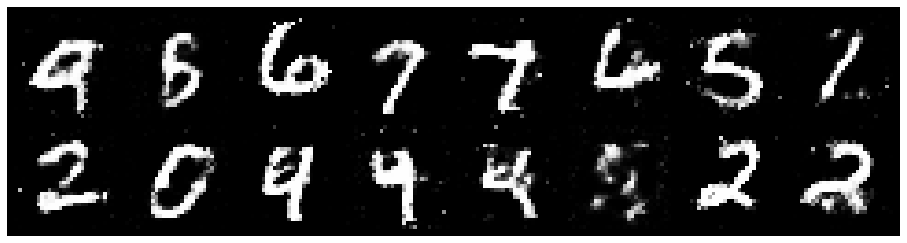

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2478, Generator Loss: 0.7693
D(x): 0.5789, D(G(z)): 0.4659


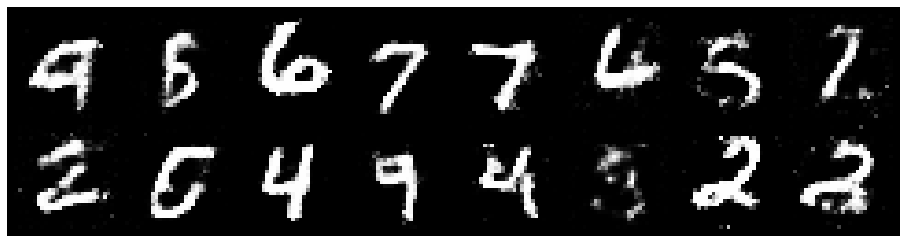

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2402, Generator Loss: 0.8559
D(x): 0.5727, D(G(z)): 0.4643


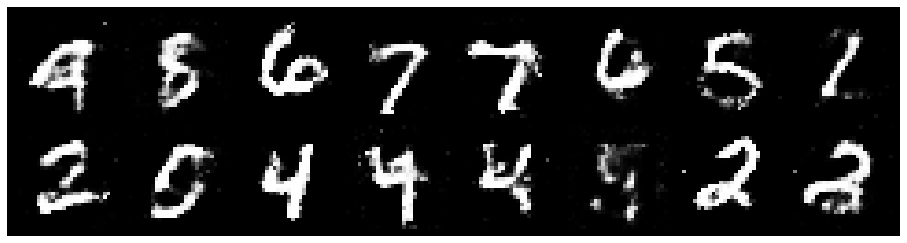

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2536, Generator Loss: 0.9269
D(x): 0.5674, D(G(z)): 0.4572


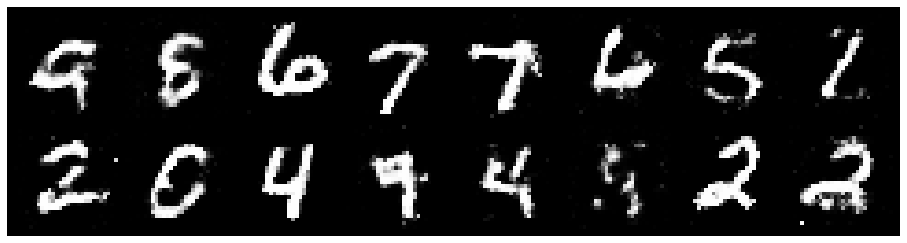

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2476, Generator Loss: 0.9662
D(x): 0.5179, D(G(z)): 0.4150


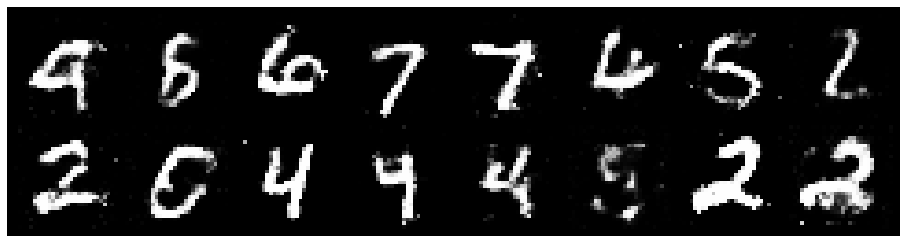

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.1857, Generator Loss: 0.9139
D(x): 0.5305, D(G(z)): 0.3936


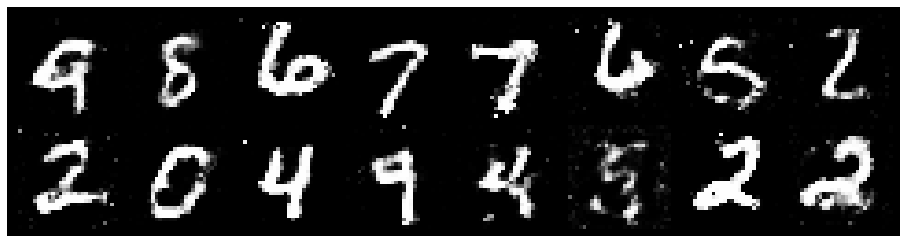

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2279, Generator Loss: 0.9272
D(x): 0.5520, D(G(z)): 0.4297


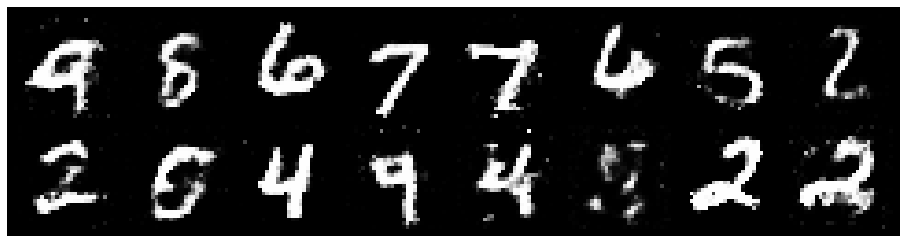

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.3147, Generator Loss: 0.9657
D(x): 0.5111, D(G(z)): 0.4003


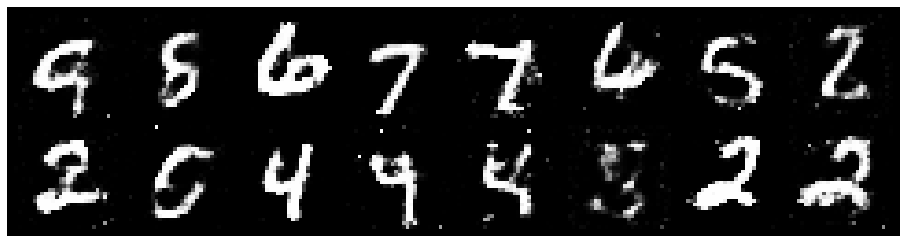

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.3576, Generator Loss: 0.7680
D(x): 0.5583, D(G(z)): 0.4873


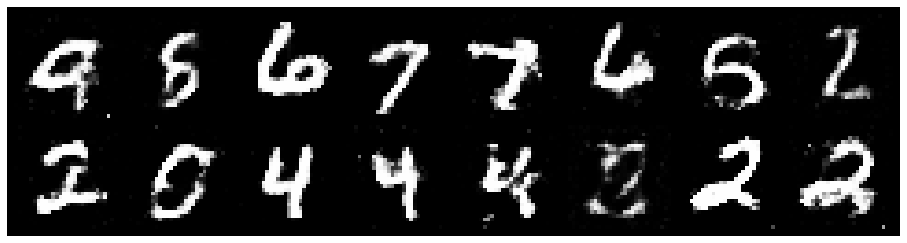

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.3408, Generator Loss: 0.8655
D(x): 0.5847, D(G(z)): 0.4983


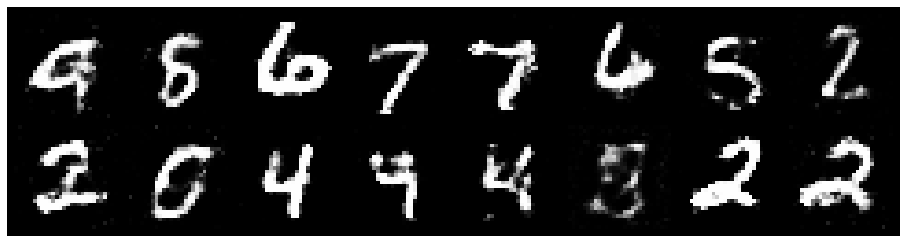

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2334, Generator Loss: 0.8827
D(x): 0.5745, D(G(z)): 0.4506


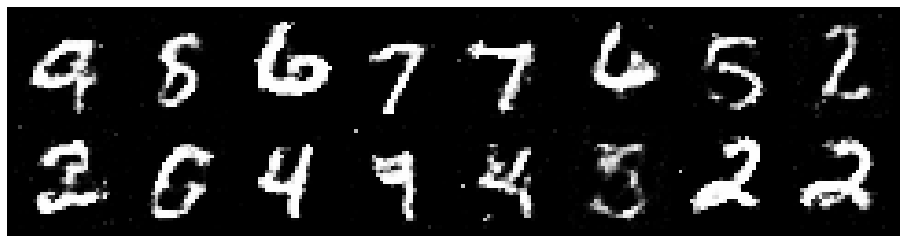

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2650, Generator Loss: 0.9139
D(x): 0.5153, D(G(z)): 0.4033


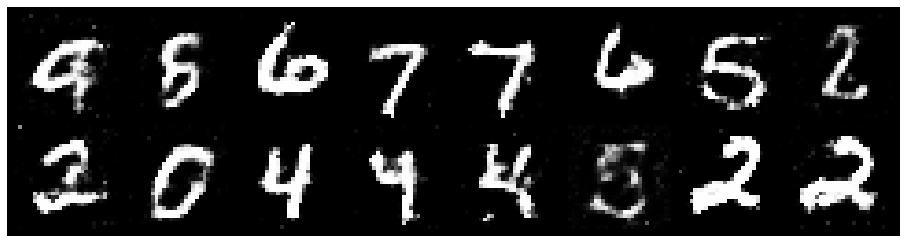

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2756, Generator Loss: 1.0134
D(x): 0.5530, D(G(z)): 0.4318


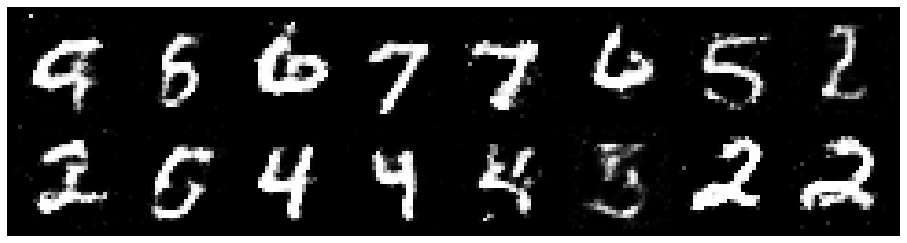

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.3233, Generator Loss: 0.9026
D(x): 0.5668, D(G(z)): 0.4668


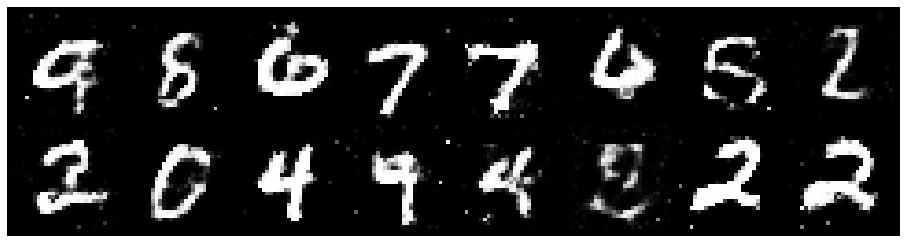

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2818, Generator Loss: 0.8527
D(x): 0.5449, D(G(z)): 0.4516


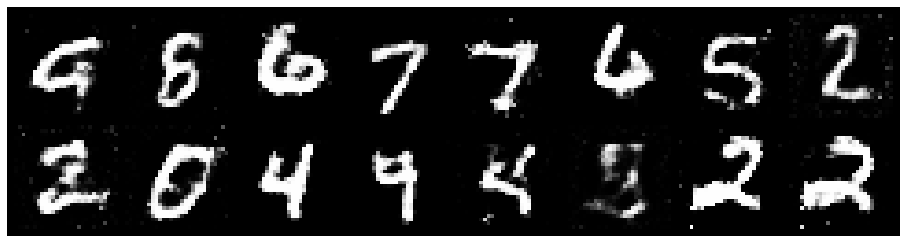

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.1583, Generator Loss: 0.8688
D(x): 0.6006, D(G(z)): 0.4312


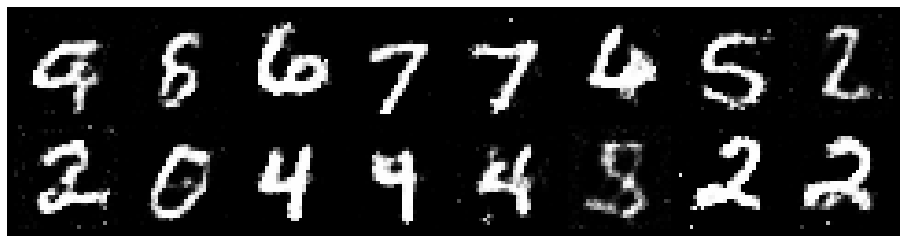

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2683, Generator Loss: 0.8344
D(x): 0.5694, D(G(z)): 0.4504


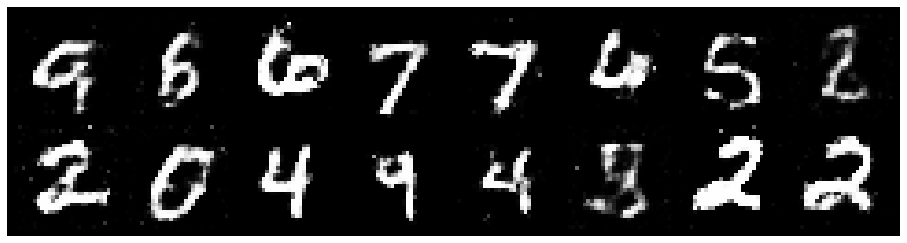

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2955, Generator Loss: 1.1077
D(x): 0.5547, D(G(z)): 0.3980


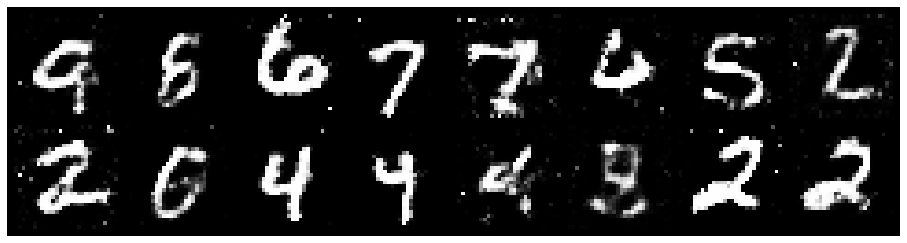

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.4026, Generator Loss: 0.9530
D(x): 0.5404, D(G(z)): 0.4805


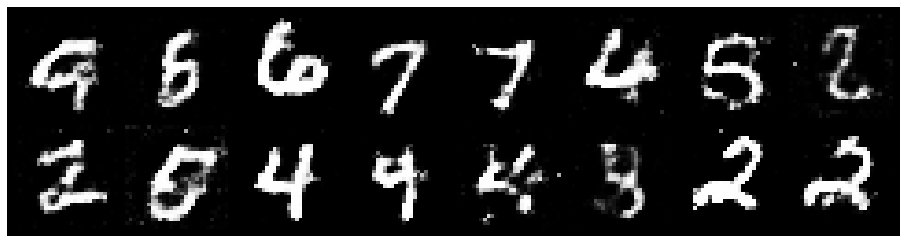

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2993, Generator Loss: 1.0505
D(x): 0.5409, D(G(z)): 0.4321


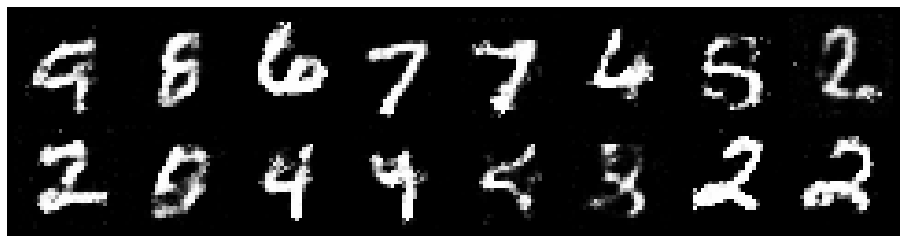

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2842, Generator Loss: 0.7822
D(x): 0.5511, D(G(z)): 0.4639


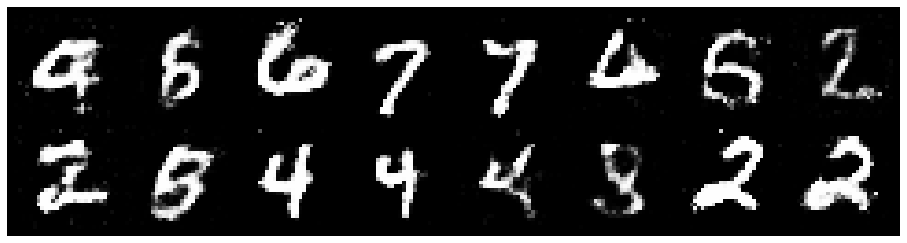

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3741, Generator Loss: 0.8077
D(x): 0.5001, D(G(z)): 0.4586


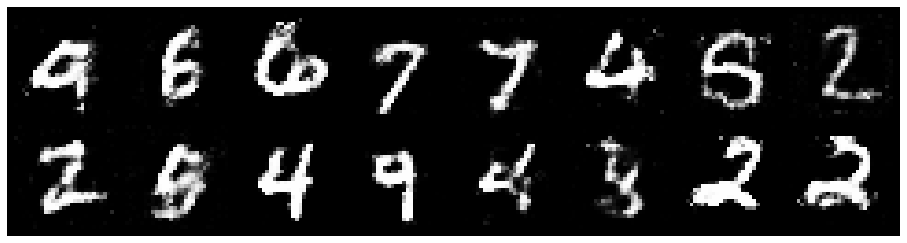

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2885, Generator Loss: 0.8762
D(x): 0.5022, D(G(z)): 0.4170


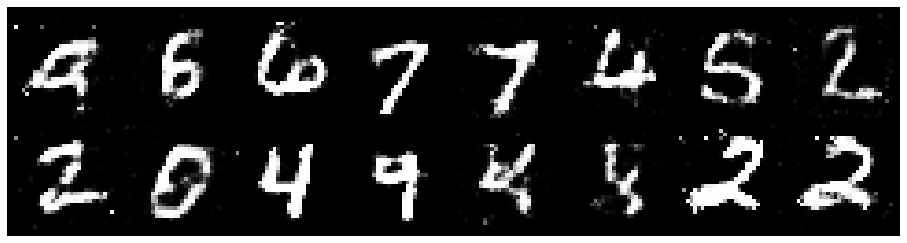

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.4075, Generator Loss: 0.8682
D(x): 0.5034, D(G(z)): 0.4634


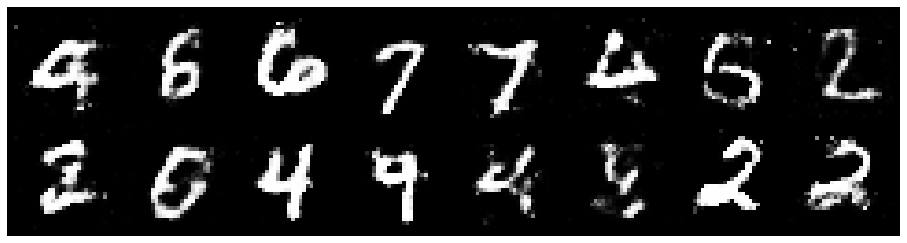

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.3431, Generator Loss: 0.9218
D(x): 0.5524, D(G(z)): 0.4687


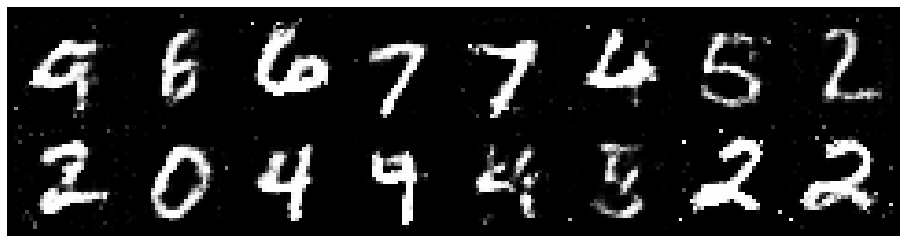

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2763, Generator Loss: 1.0003
D(x): 0.5527, D(G(z)): 0.4336


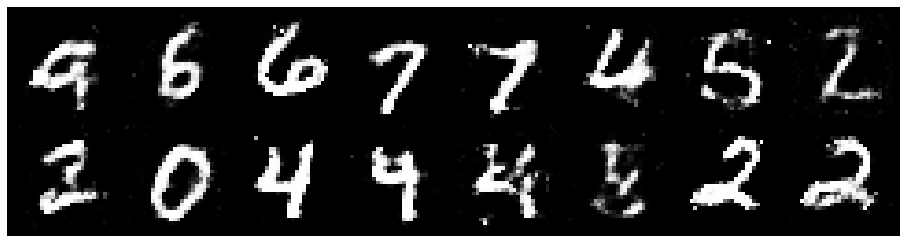

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3804, Generator Loss: 0.8645
D(x): 0.5623, D(G(z)): 0.4861


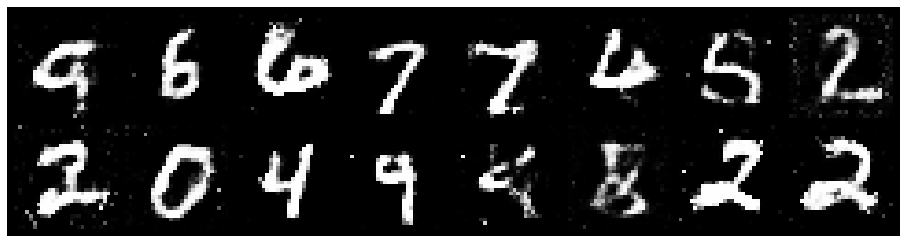

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.3256, Generator Loss: 0.8887
D(x): 0.5555, D(G(z)): 0.4535


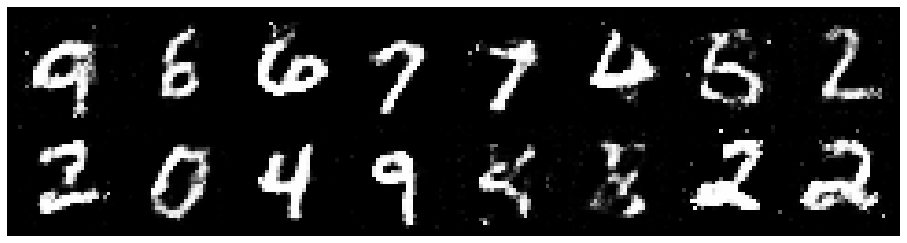

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9367
D(x): 0.5572, D(G(z)): 0.4453


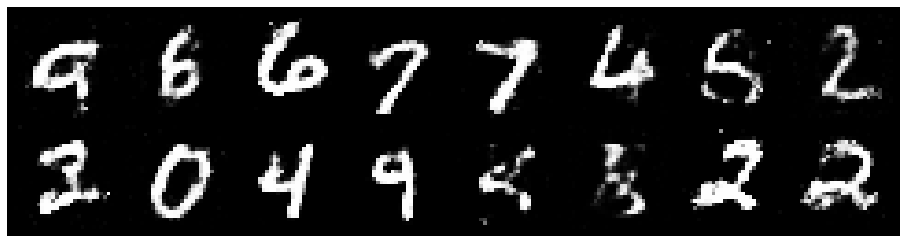

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2773, Generator Loss: 0.8992
D(x): 0.5444, D(G(z)): 0.4435


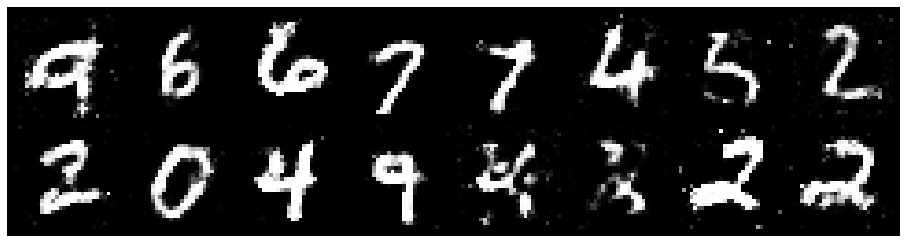

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2745, Generator Loss: 0.7684
D(x): 0.5974, D(G(z)): 0.4524


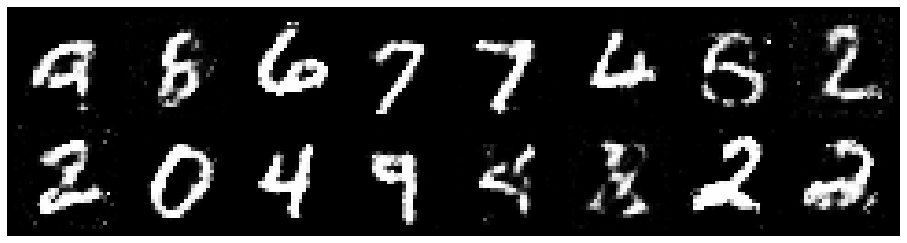

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.3711, Generator Loss: 0.7704
D(x): 0.5336, D(G(z)): 0.4669


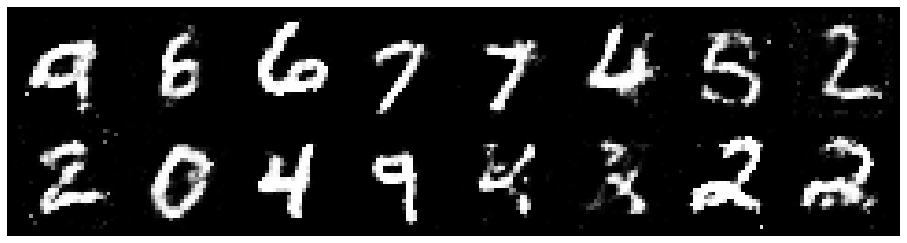

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3171, Generator Loss: 0.8010
D(x): 0.5750, D(G(z)): 0.4811


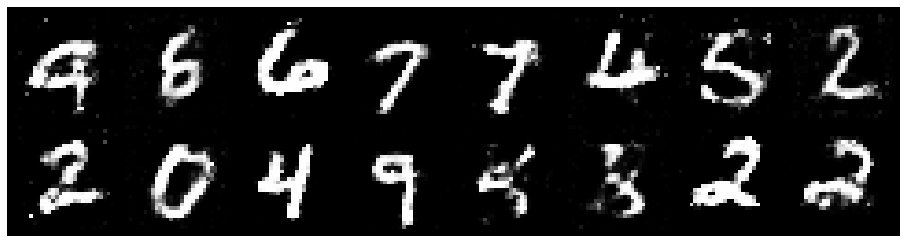

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.1661, Generator Loss: 0.9594
D(x): 0.5752, D(G(z)): 0.3922


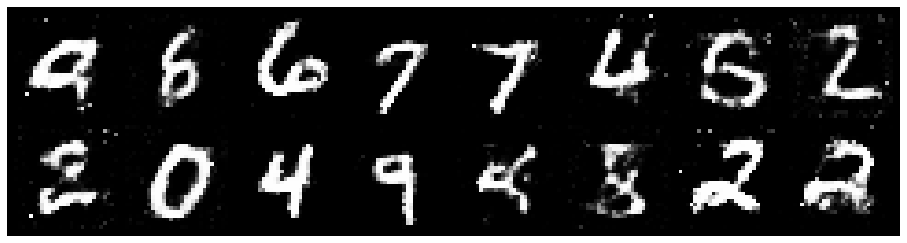

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2793, Generator Loss: 0.8452
D(x): 0.5738, D(G(z)): 0.4615


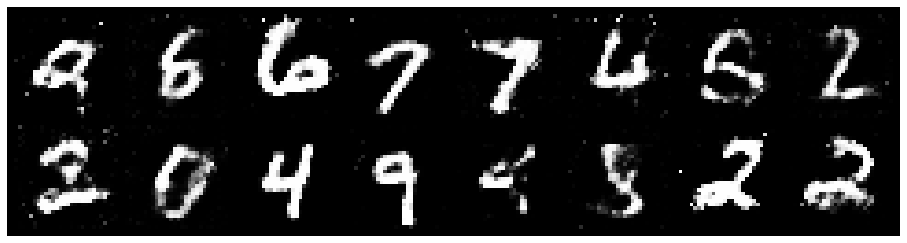

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2990, Generator Loss: 0.8828
D(x): 0.5330, D(G(z)): 0.4360


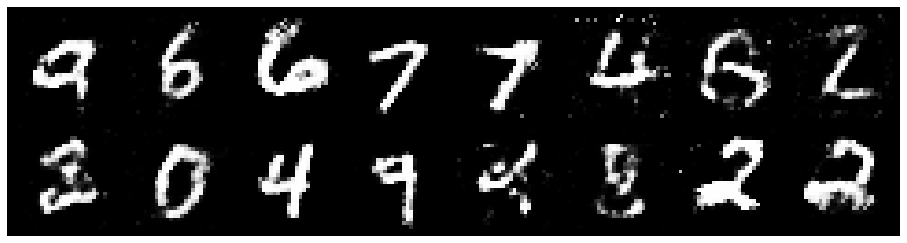

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.1371, Generator Loss: 1.0372
D(x): 0.6137, D(G(z)): 0.4090


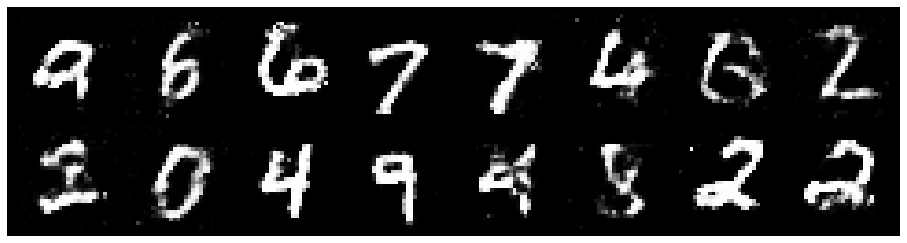

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2407, Generator Loss: 1.2101
D(x): 0.5423, D(G(z)): 0.3825


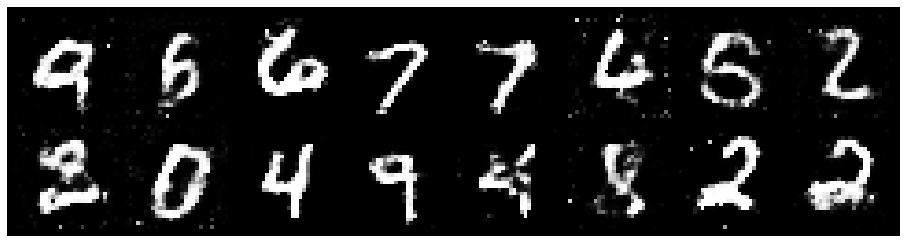

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1301, Generator Loss: 0.9002
D(x): 0.6103, D(G(z)): 0.4013


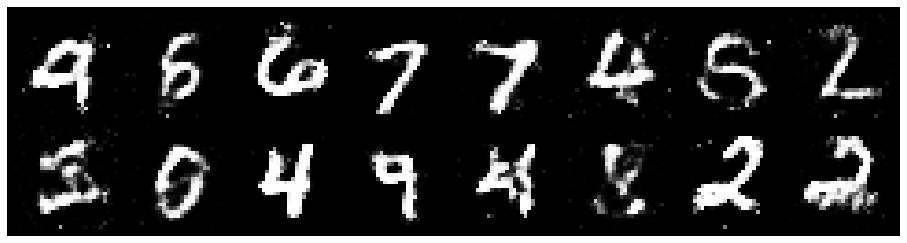

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2515, Generator Loss: 0.8862
D(x): 0.6247, D(G(z)): 0.4551


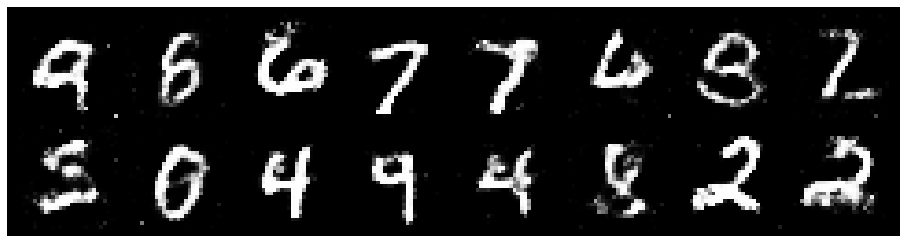

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.3543, Generator Loss: 0.9433
D(x): 0.5571, D(G(z)): 0.4591


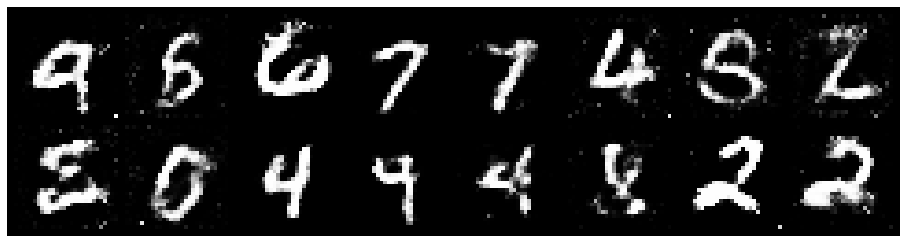

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2289, Generator Loss: 0.9814
D(x): 0.5704, D(G(z)): 0.4364


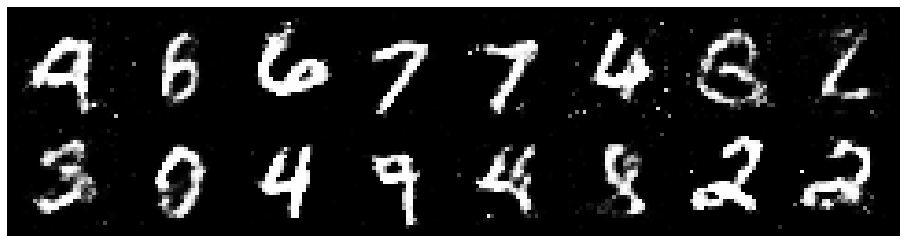

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.1995, Generator Loss: 0.9473
D(x): 0.5859, D(G(z)): 0.4283


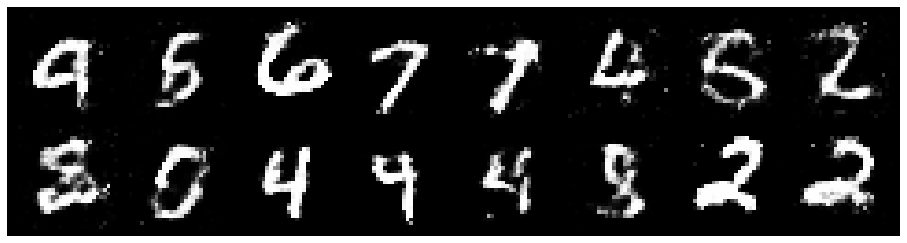

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.3062, Generator Loss: 0.8488
D(x): 0.5090, D(G(z)): 0.4404


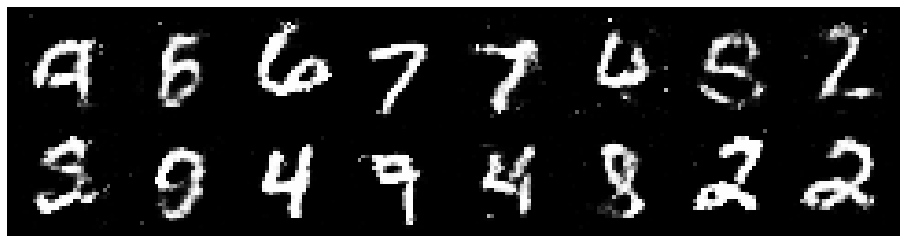

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2233, Generator Loss: 0.8080
D(x): 0.5835, D(G(z)): 0.4672


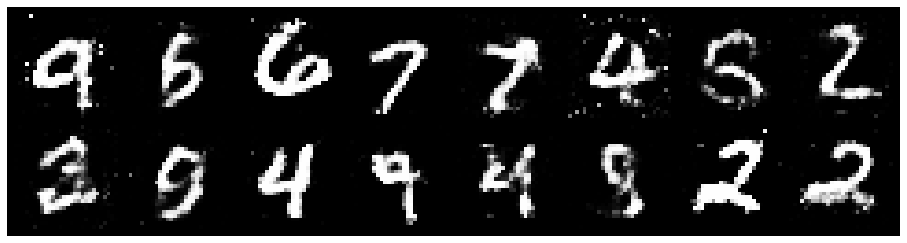

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3175, Generator Loss: 0.8106
D(x): 0.5484, D(G(z)): 0.4674


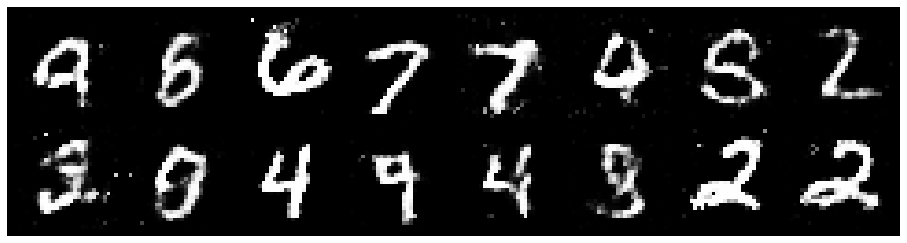

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.3195, Generator Loss: 0.9582
D(x): 0.5641, D(G(z)): 0.4498


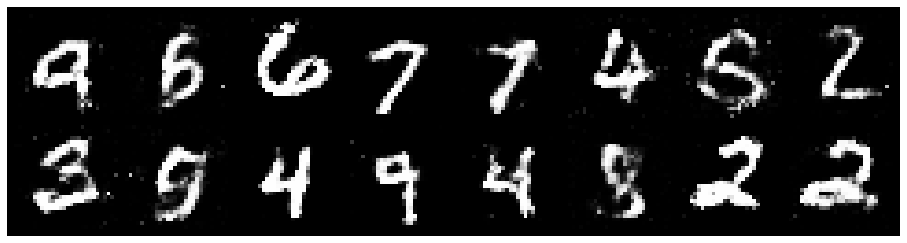

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.1320, Generator Loss: 0.9145
D(x): 0.5932, D(G(z)): 0.4042


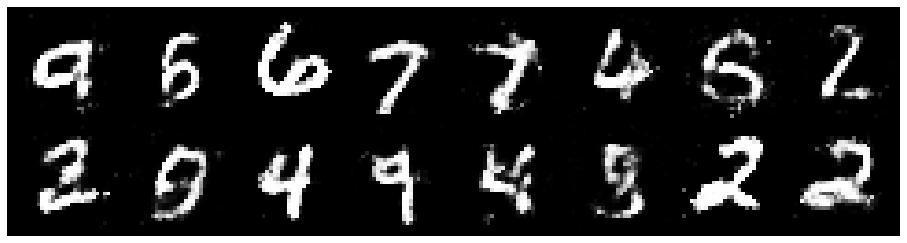

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.1171, Generator Loss: 0.9546
D(x): 0.5890, D(G(z)): 0.4045


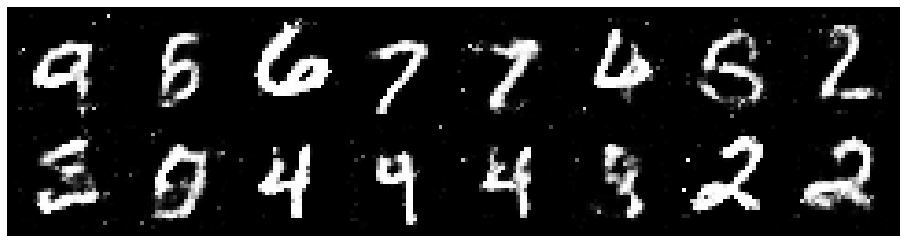

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2416, Generator Loss: 1.0261
D(x): 0.5793, D(G(z)): 0.4542


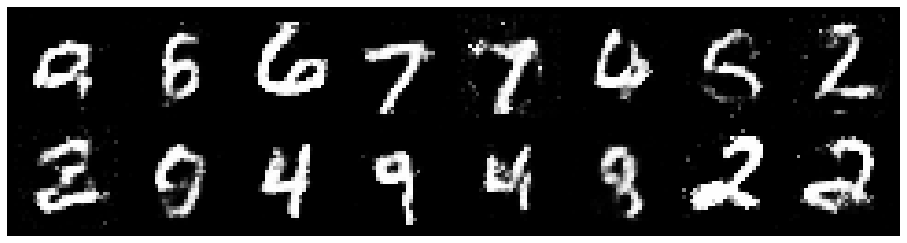

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2003, Generator Loss: 1.0009
D(x): 0.5935, D(G(z)): 0.4180


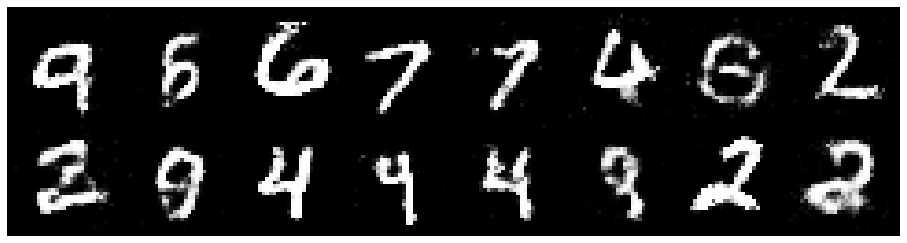

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2729, Generator Loss: 0.8116
D(x): 0.5522, D(G(z)): 0.4588


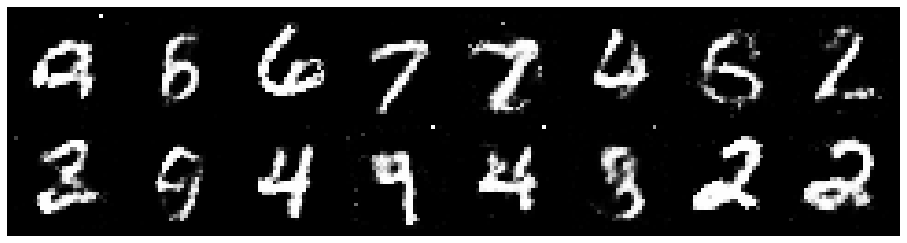

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2890, Generator Loss: 0.9091
D(x): 0.5030, D(G(z)): 0.4207


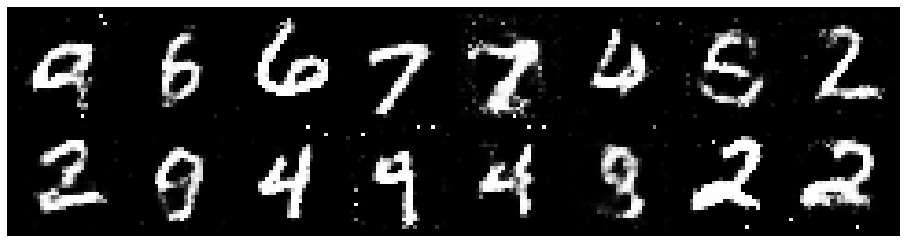

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2563, Generator Loss: 0.9344
D(x): 0.5120, D(G(z)): 0.4042


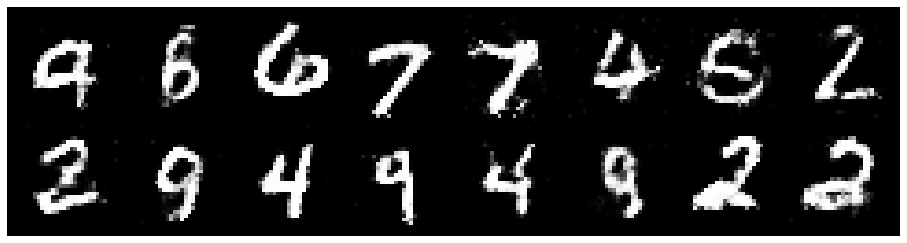

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9692
D(x): 0.6011, D(G(z)): 0.4419


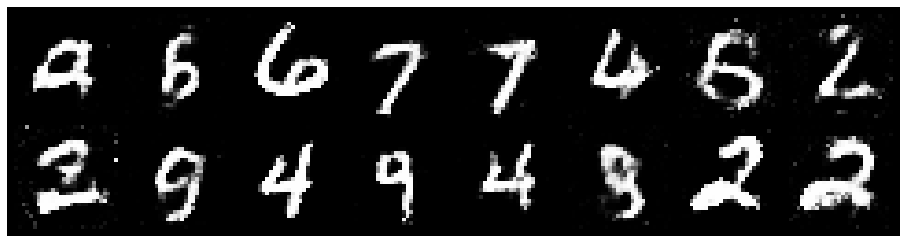

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.4530, Generator Loss: 0.9313
D(x): 0.5370, D(G(z)): 0.4671


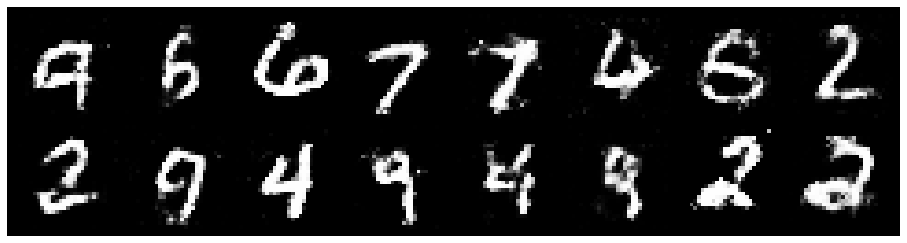

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.3200, Generator Loss: 0.9166
D(x): 0.5400, D(G(z)): 0.4528


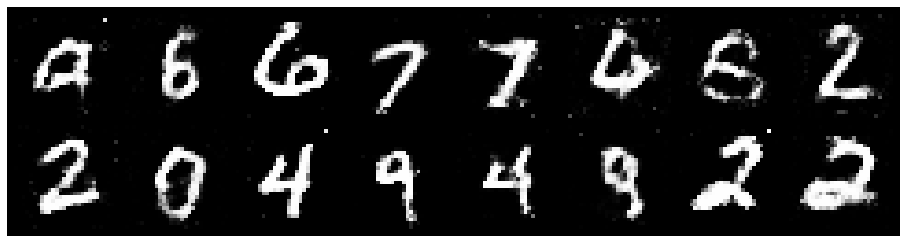

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2469, Generator Loss: 0.8251
D(x): 0.5890, D(G(z)): 0.4666


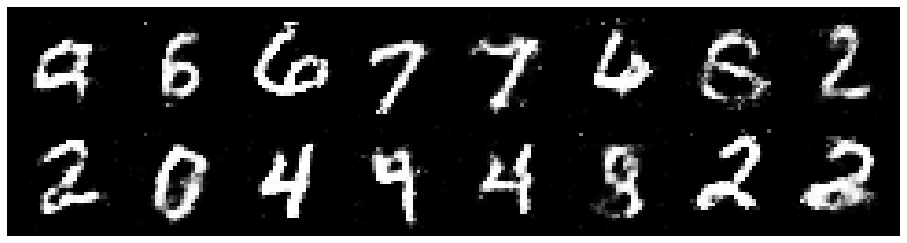

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2583, Generator Loss: 0.9017
D(x): 0.5582, D(G(z)): 0.4323


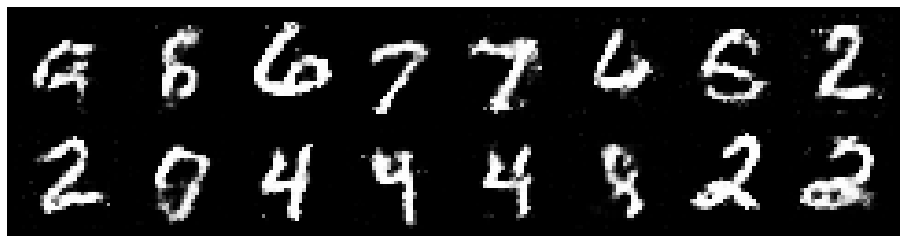

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.3370, Generator Loss: 0.8397
D(x): 0.5208, D(G(z)): 0.4664


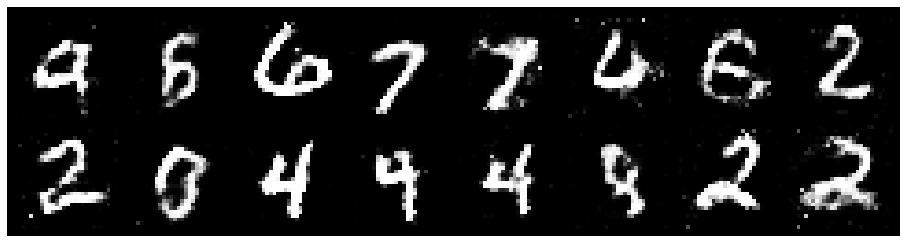

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.3712, Generator Loss: 0.9356
D(x): 0.5075, D(G(z)): 0.4283


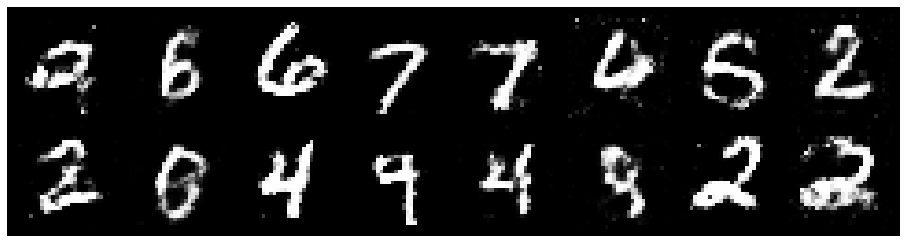

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8610
D(x): 0.5477, D(G(z)): 0.4387


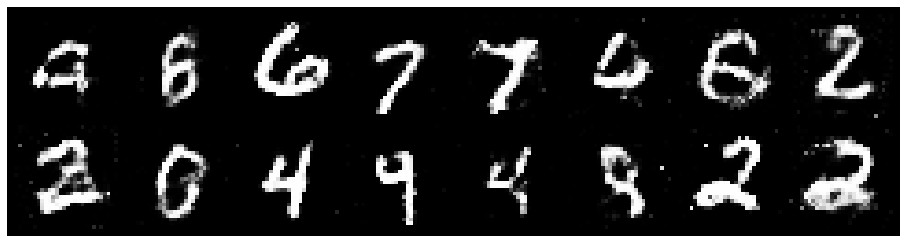

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2523, Generator Loss: 0.9790
D(x): 0.5529, D(G(z)): 0.4420


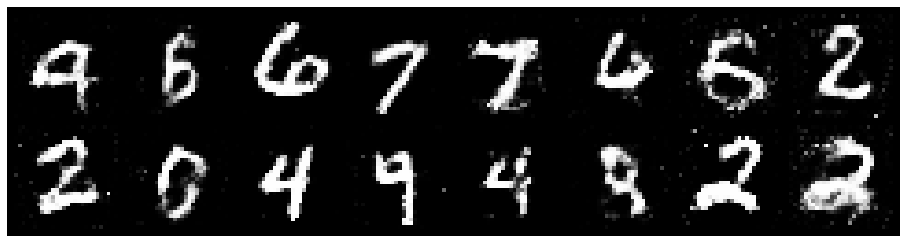

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2307, Generator Loss: 0.9695
D(x): 0.5631, D(G(z)): 0.4191


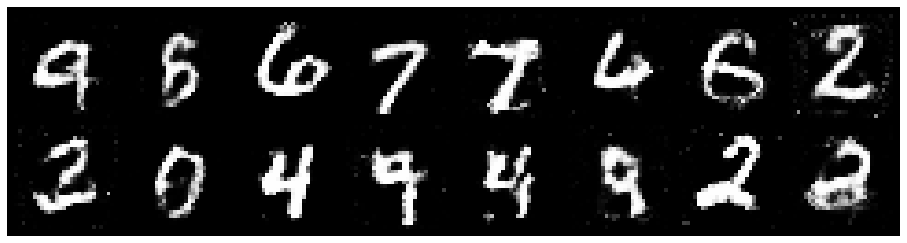

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2156, Generator Loss: 0.9399
D(x): 0.5476, D(G(z)): 0.4267


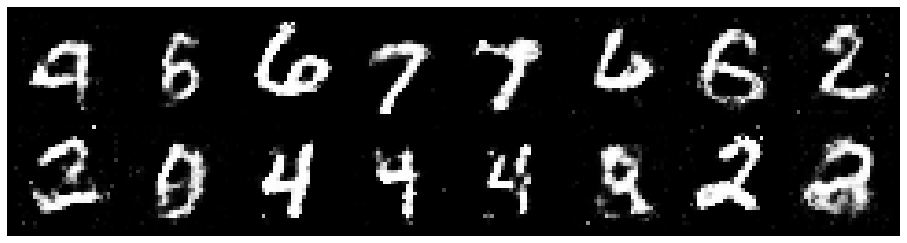

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3116, Generator Loss: 0.9596
D(x): 0.5020, D(G(z)): 0.3973


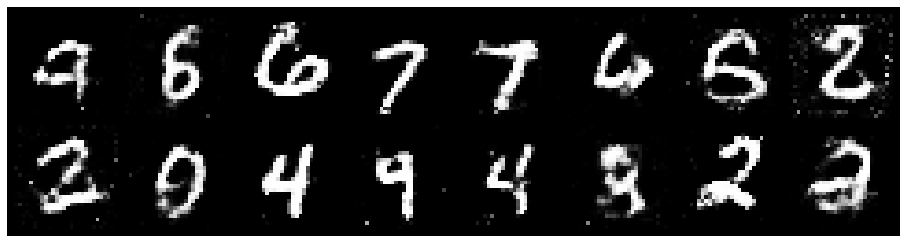

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.3572, Generator Loss: 0.8954
D(x): 0.5309, D(G(z)): 0.4675


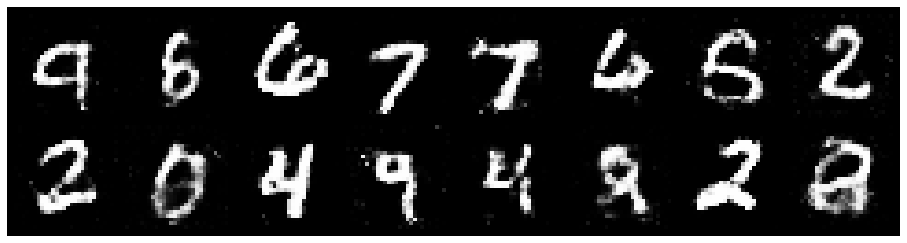

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.3893, Generator Loss: 0.8453
D(x): 0.5167, D(G(z)): 0.4541


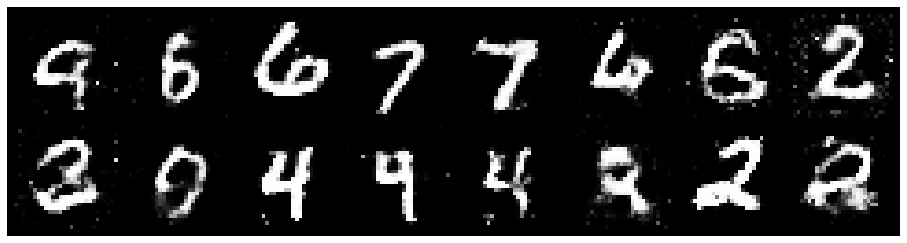

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3613, Generator Loss: 0.8062
D(x): 0.5353, D(G(z)): 0.4587


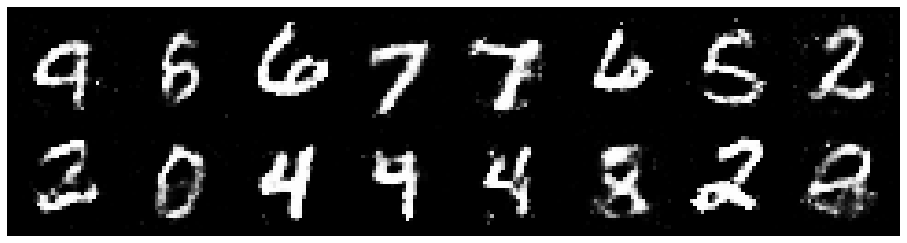

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.3048, Generator Loss: 0.8687
D(x): 0.5763, D(G(z)): 0.4805


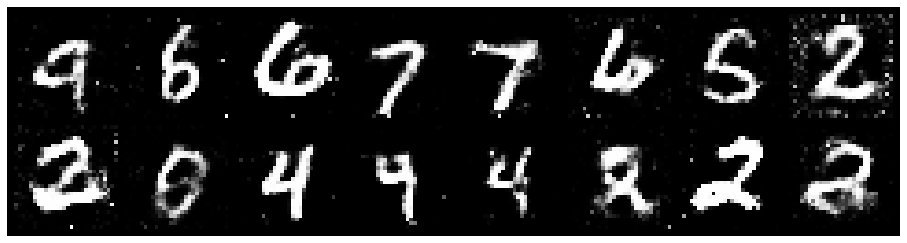

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.1888, Generator Loss: 0.8250
D(x): 0.5663, D(G(z)): 0.4225


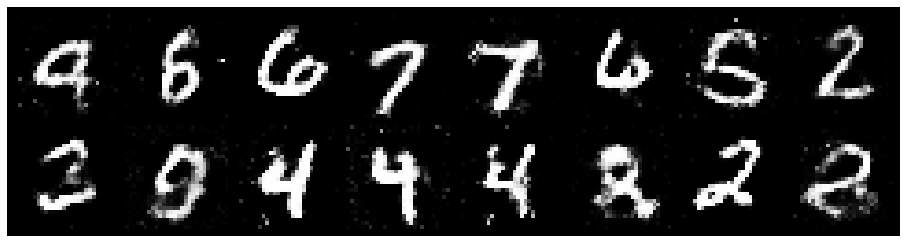

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.3234, Generator Loss: 0.8916
D(x): 0.5834, D(G(z)): 0.4689


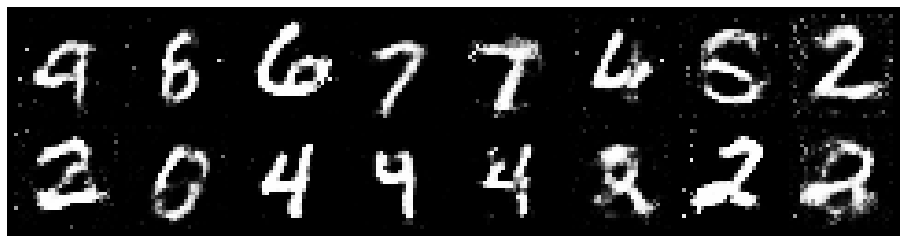

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2581, Generator Loss: 0.8157
D(x): 0.5677, D(G(z)): 0.4606


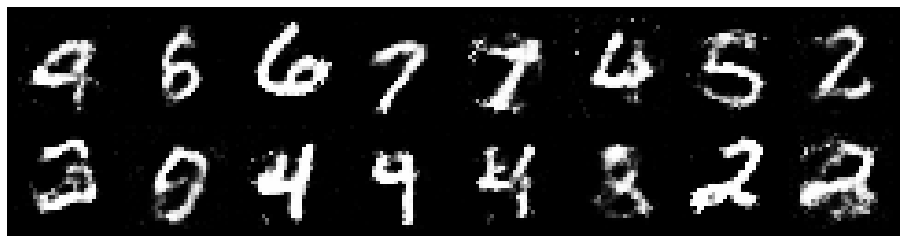

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3442, Generator Loss: 0.8667
D(x): 0.5546, D(G(z)): 0.4698


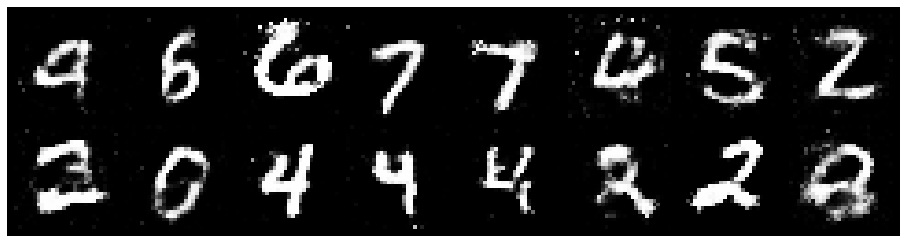

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3291, Generator Loss: 0.8134
D(x): 0.5739, D(G(z)): 0.4901


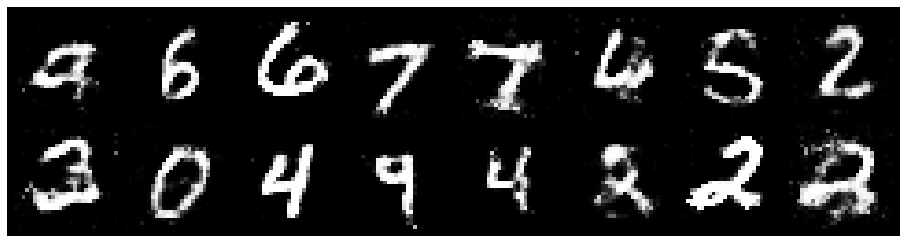

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.1728, Generator Loss: 1.0428
D(x): 0.6124, D(G(z)): 0.4331


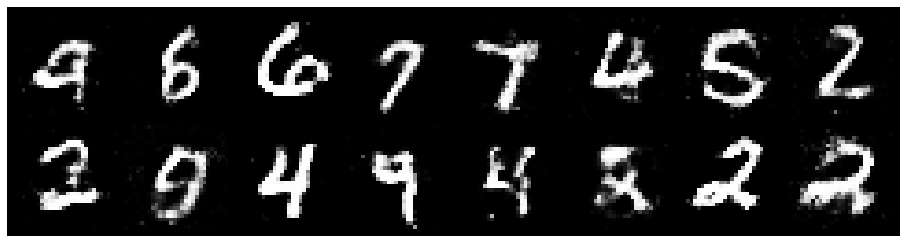

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.1485, Generator Loss: 0.8826
D(x): 0.5739, D(G(z)): 0.3937


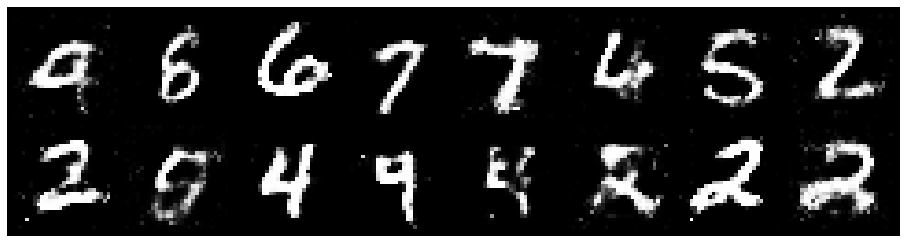

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2068, Generator Loss: 1.0740
D(x): 0.5845, D(G(z)): 0.4241


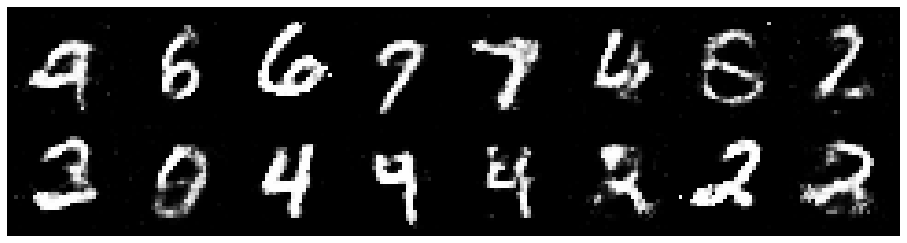

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2748, Generator Loss: 0.9305
D(x): 0.5286, D(G(z)): 0.4124


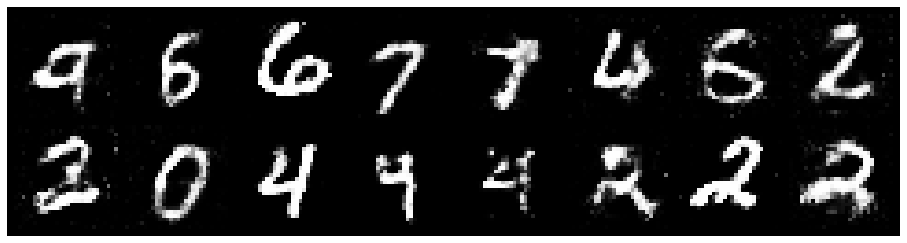

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3724, Generator Loss: 0.8713
D(x): 0.5195, D(G(z)): 0.4538


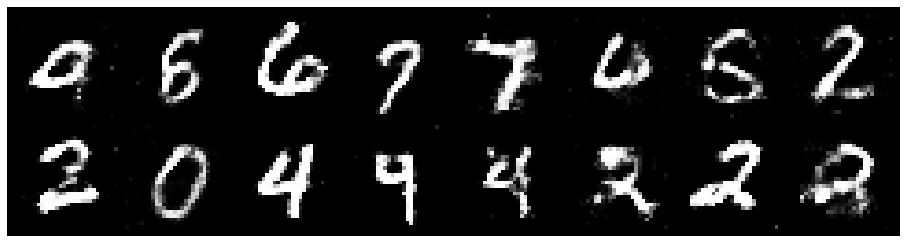

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3814, Generator Loss: 0.8236
D(x): 0.4796, D(G(z)): 0.4346


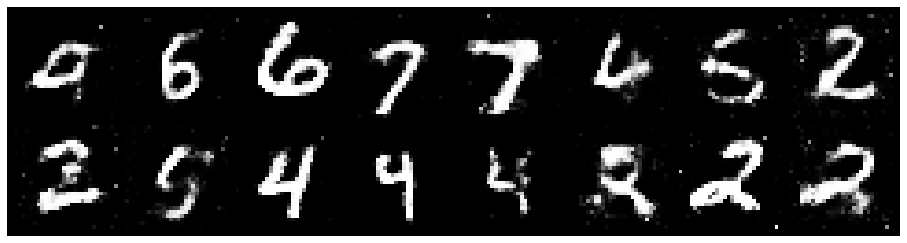

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2716, Generator Loss: 0.7726
D(x): 0.5554, D(G(z)): 0.4509


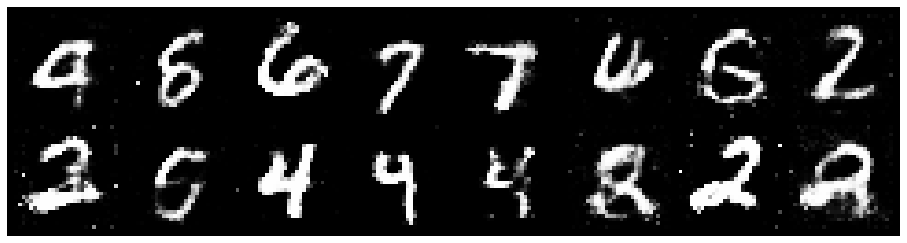

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2793, Generator Loss: 0.8210
D(x): 0.5486, D(G(z)): 0.4703


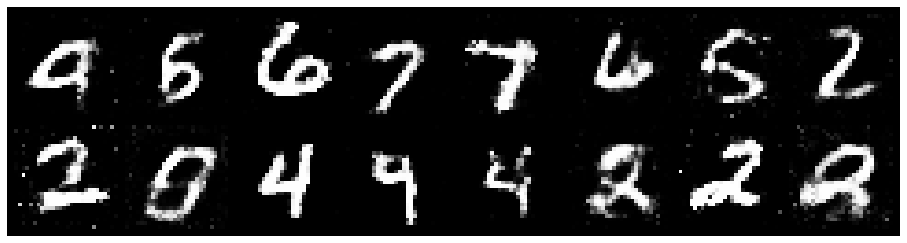

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2289, Generator Loss: 0.9954
D(x): 0.5875, D(G(z)): 0.4419


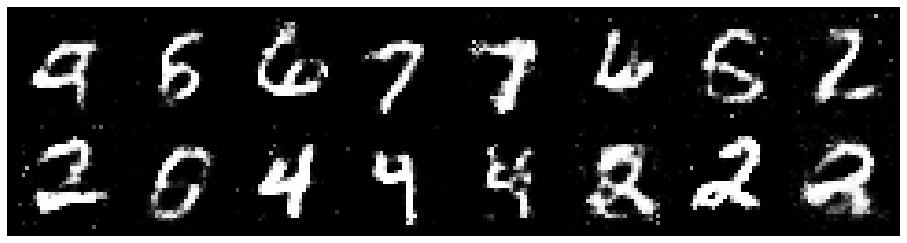

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1909, Generator Loss: 0.9002
D(x): 0.5828, D(G(z)): 0.4395


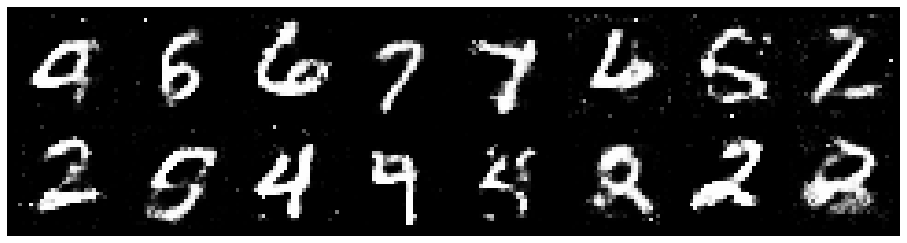

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.1645, Generator Loss: 0.9462
D(x): 0.6015, D(G(z)): 0.4220


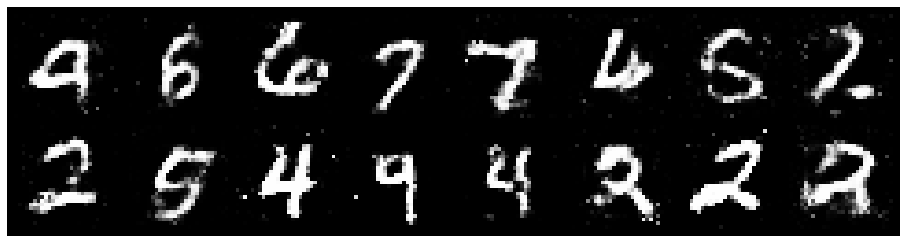

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2059, Generator Loss: 0.9922
D(x): 0.5569, D(G(z)): 0.4076


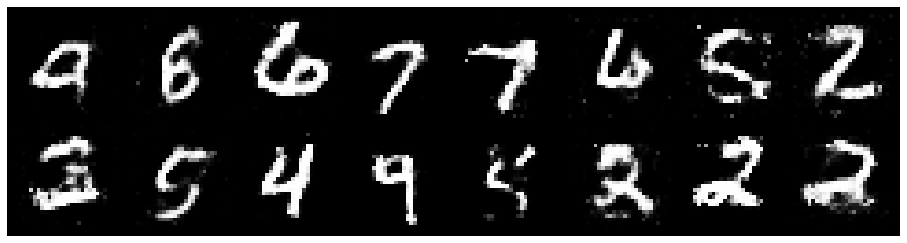

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2119, Generator Loss: 0.9357
D(x): 0.5553, D(G(z)): 0.4204


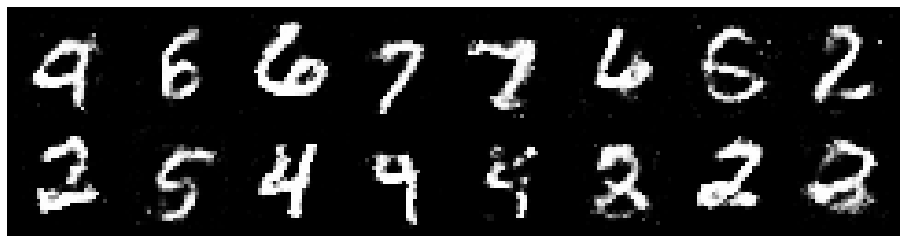

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3228, Generator Loss: 0.9023
D(x): 0.5357, D(G(z)): 0.4538


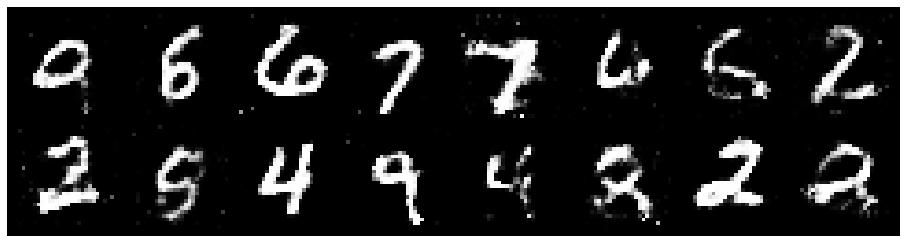

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3330, Generator Loss: 0.8168
D(x): 0.5540, D(G(z)): 0.4810


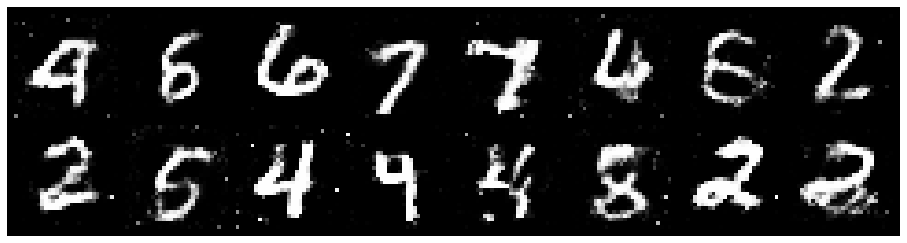

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2883, Generator Loss: 0.8617
D(x): 0.5336, D(G(z)): 0.4442


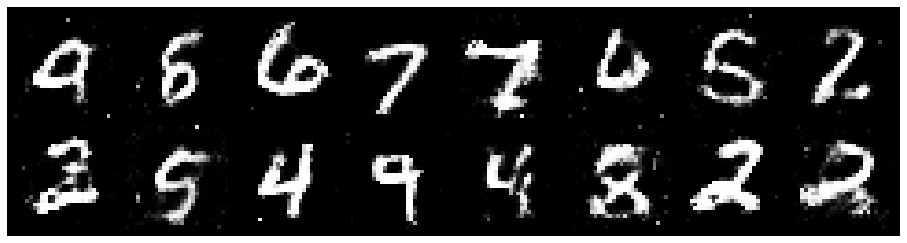

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2853, Generator Loss: 0.9629
D(x): 0.5070, D(G(z)): 0.4175


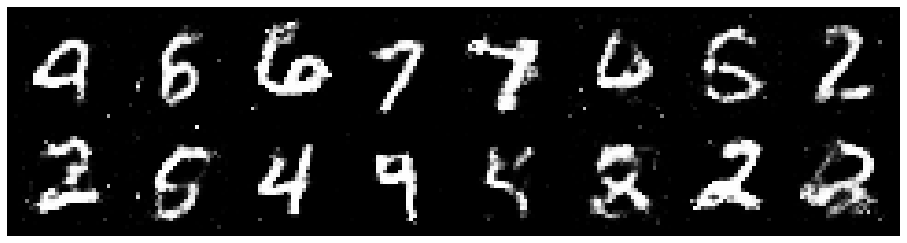

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2354, Generator Loss: 0.9261
D(x): 0.5476, D(G(z)): 0.4118


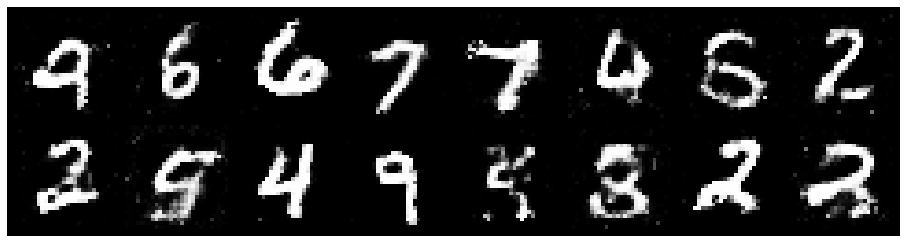

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2549, Generator Loss: 1.0057
D(x): 0.5361, D(G(z)): 0.4119


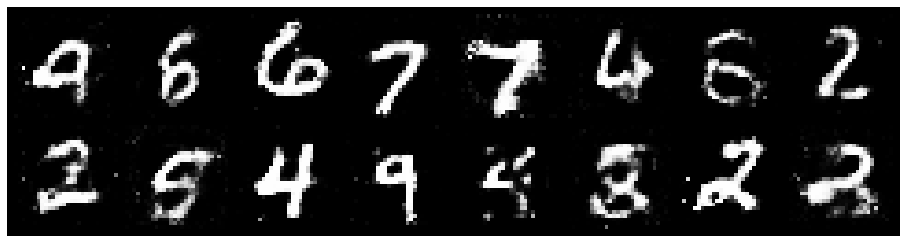

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2676, Generator Loss: 0.8461
D(x): 0.5400, D(G(z)): 0.4467


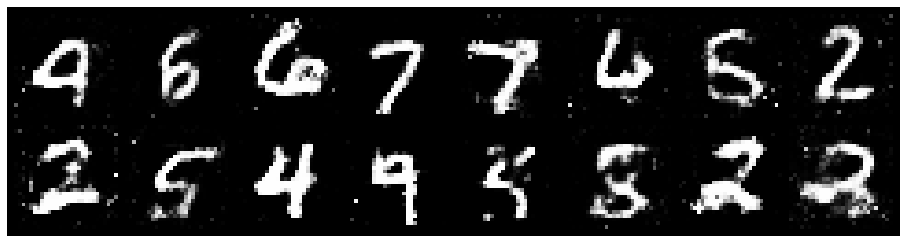

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.1832, Generator Loss: 0.8061
D(x): 0.5706, D(G(z)): 0.4213


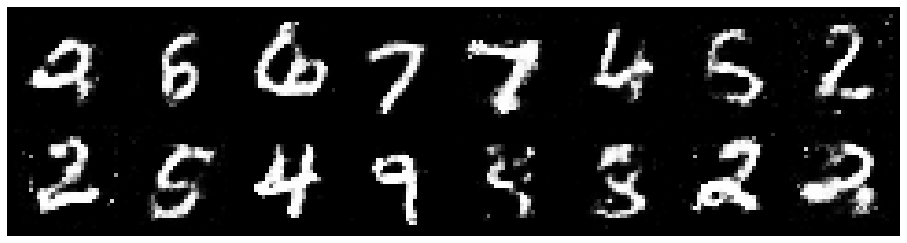

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2238, Generator Loss: 0.8939
D(x): 0.5707, D(G(z)): 0.4448


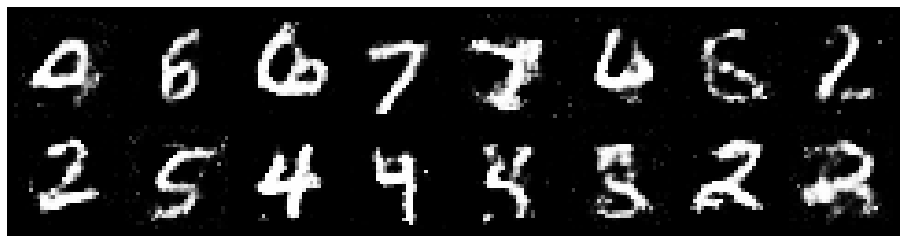

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2766, Generator Loss: 0.8466
D(x): 0.5449, D(G(z)): 0.4507


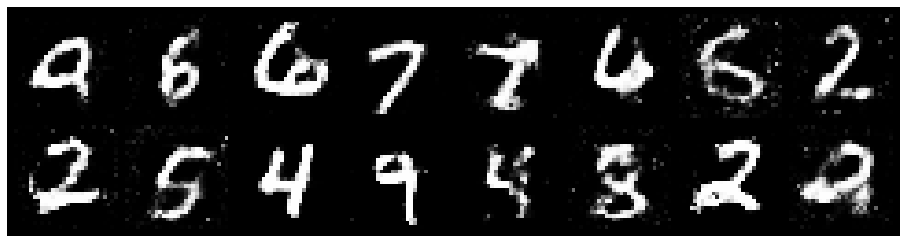

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2757, Generator Loss: 0.8643
D(x): 0.5028, D(G(z)): 0.3931


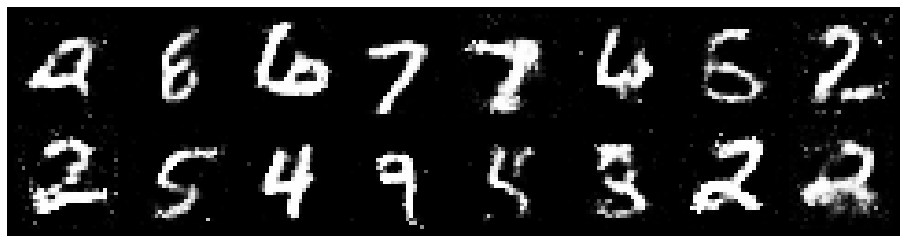

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2487, Generator Loss: 0.8416
D(x): 0.5334, D(G(z)): 0.4302


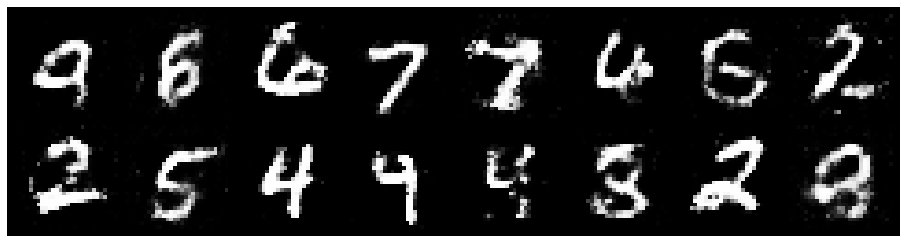

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2507, Generator Loss: 0.8478
D(x): 0.5710, D(G(z)): 0.4555


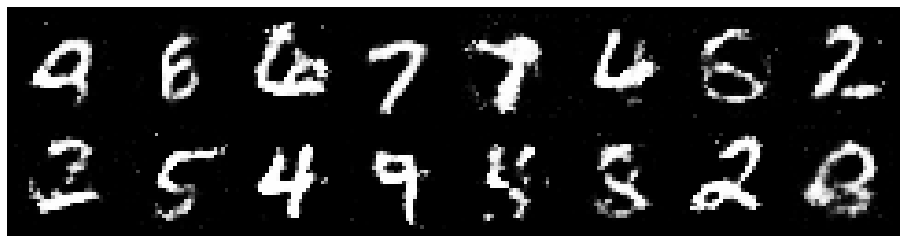

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2390, Generator Loss: 1.0122
D(x): 0.5580, D(G(z)): 0.4039


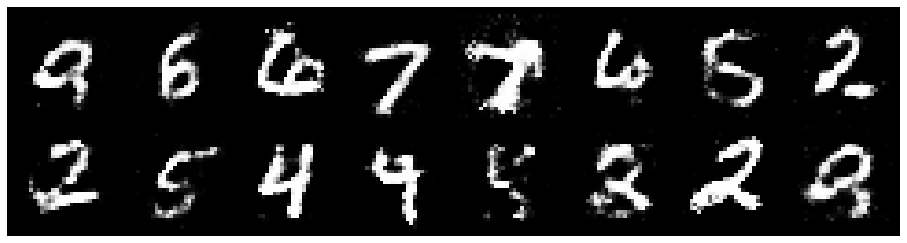

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3683, Generator Loss: 0.8956
D(x): 0.5282, D(G(z)): 0.4672


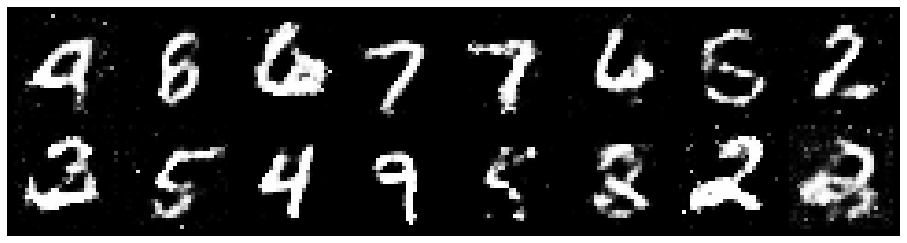

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.1604, Generator Loss: 0.8670
D(x): 0.5999, D(G(z)): 0.4238


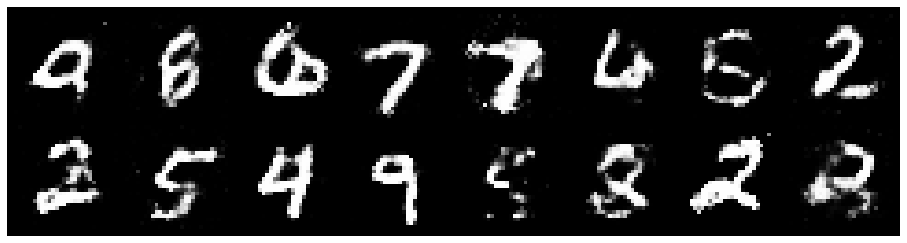

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2869, Generator Loss: 0.7684
D(x): 0.5593, D(G(z)): 0.4708


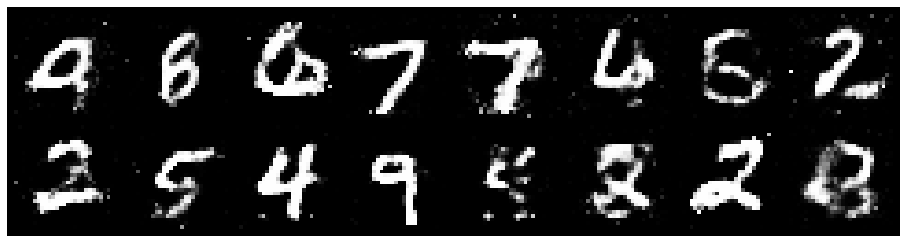

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2993, Generator Loss: 0.8469
D(x): 0.5956, D(G(z)): 0.4550


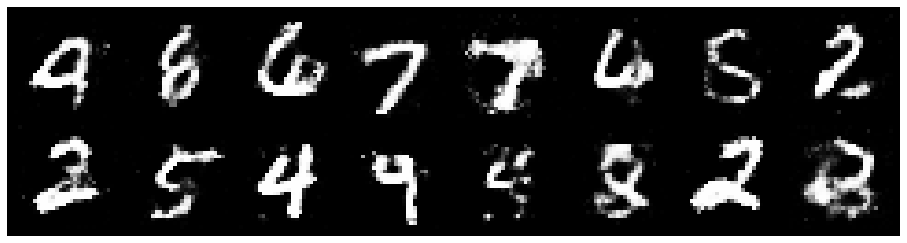

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.3530, Generator Loss: 0.7914
D(x): 0.5368, D(G(z)): 0.4801


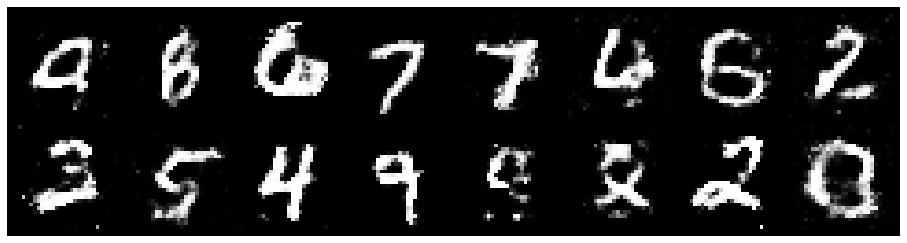

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2626, Generator Loss: 0.8827
D(x): 0.5552, D(G(z)): 0.4463


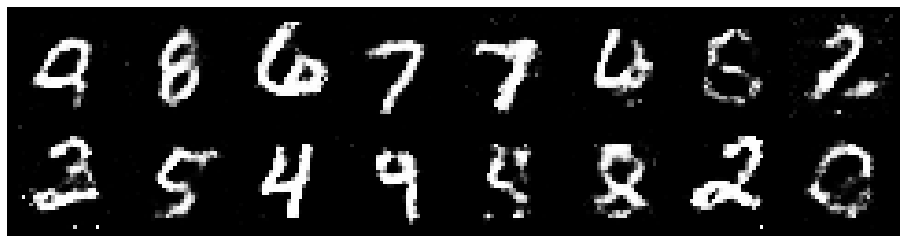

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2847, Generator Loss: 1.0172
D(x): 0.5319, D(G(z)): 0.4261


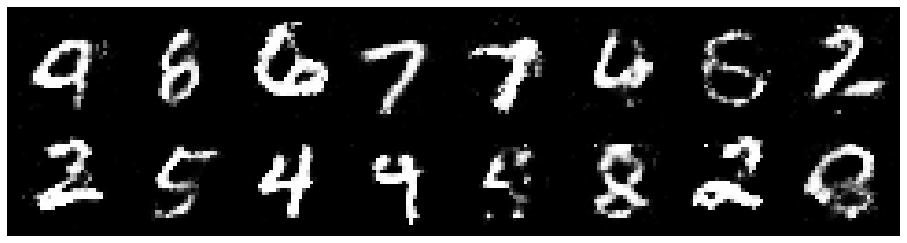

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.1956, Generator Loss: 0.9096
D(x): 0.5816, D(G(z)): 0.4477


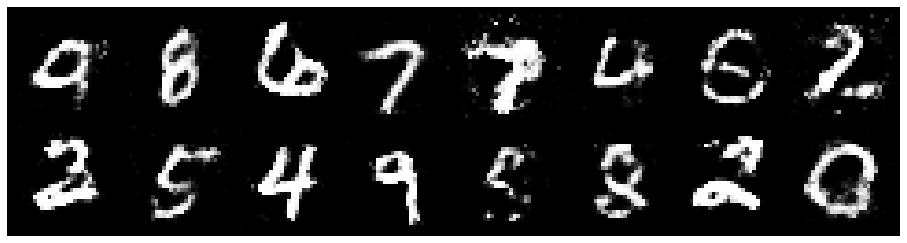

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2087, Generator Loss: 0.8269
D(x): 0.5580, D(G(z)): 0.4289


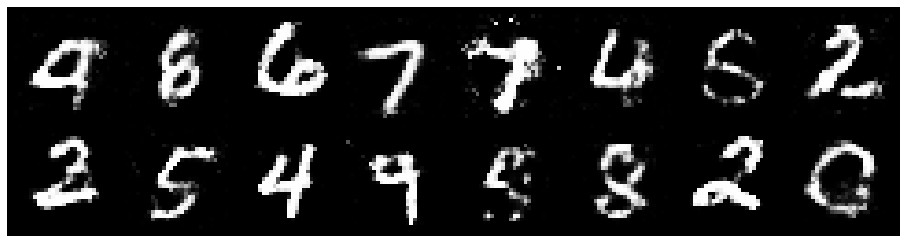

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.2763, Generator Loss: 0.7457
D(x): 0.5864, D(G(z)): 0.4830


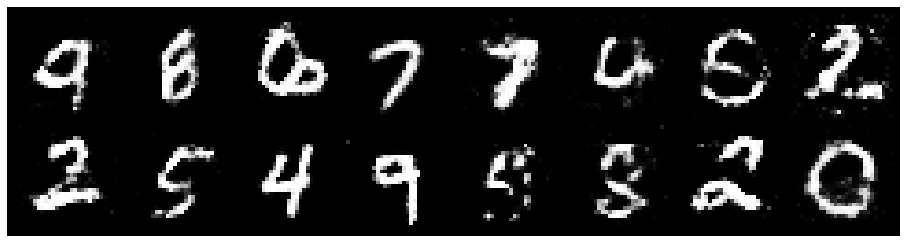

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.4029, Generator Loss: 0.8211
D(x): 0.5089, D(G(z)): 0.4832


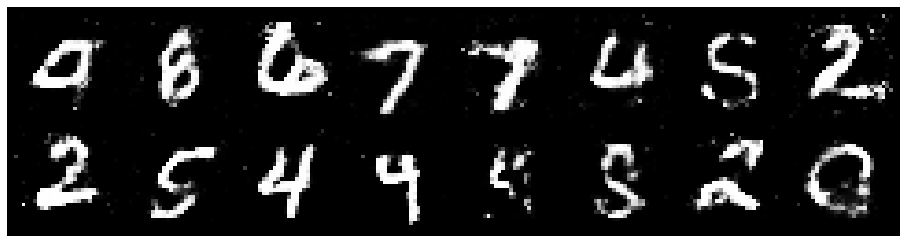

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.3257, Generator Loss: 0.8399
D(x): 0.5180, D(G(z)): 0.4455


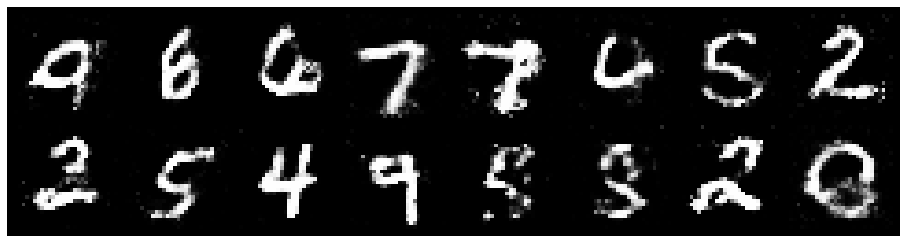

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3516, Generator Loss: 0.9127
D(x): 0.5328, D(G(z)): 0.4637


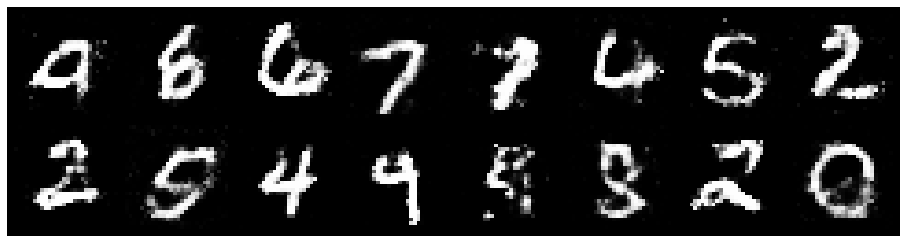

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.3835, Generator Loss: 0.7938
D(x): 0.5094, D(G(z)): 0.4642


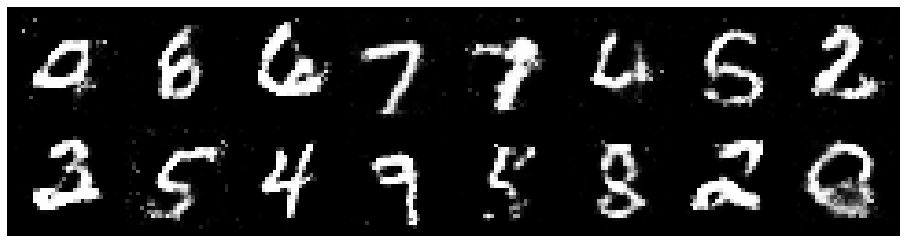

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2096, Generator Loss: 0.8465
D(x): 0.6018, D(G(z)): 0.4463


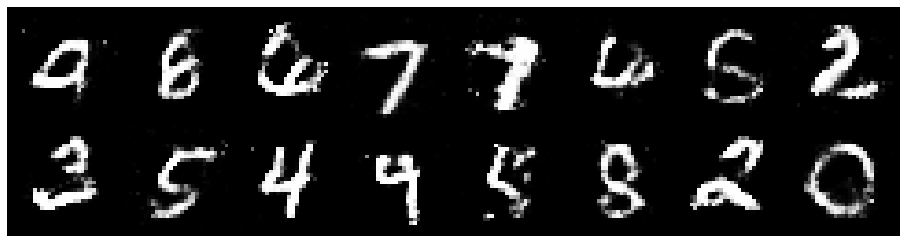

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3125, Generator Loss: 0.7770
D(x): 0.5433, D(G(z)): 0.4529


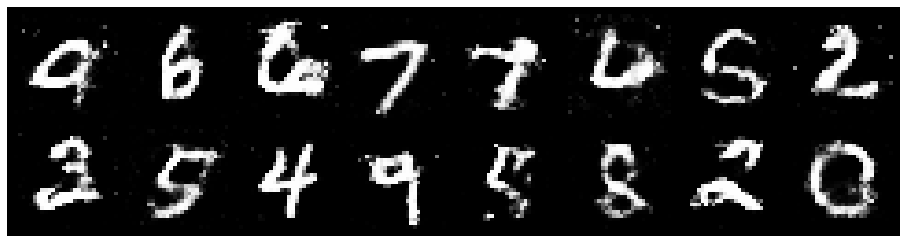

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.3015, Generator Loss: 0.8424
D(x): 0.5630, D(G(z)): 0.4688


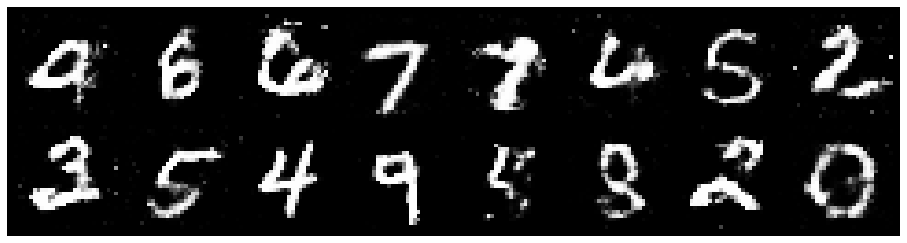

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2425, Generator Loss: 0.8848
D(x): 0.5377, D(G(z)): 0.4131


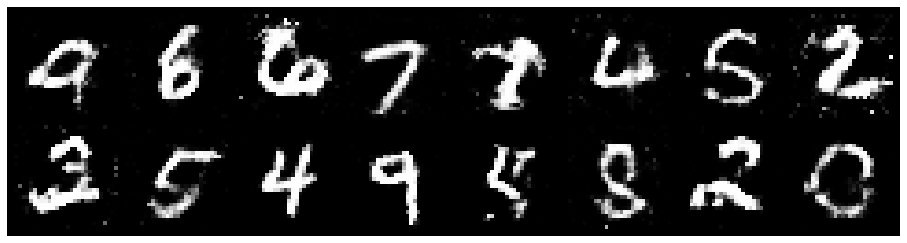

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2330, Generator Loss: 0.9924
D(x): 0.5683, D(G(z)): 0.4272


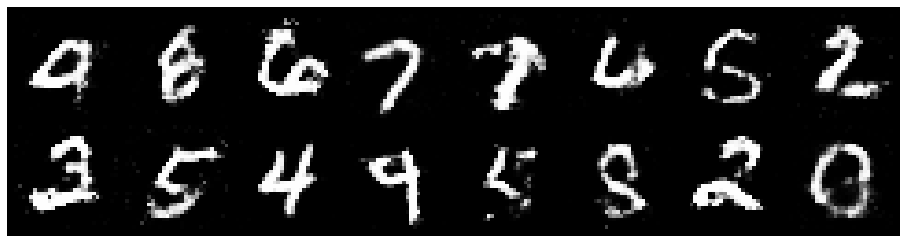

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3406, Generator Loss: 0.8209
D(x): 0.5791, D(G(z)): 0.5017


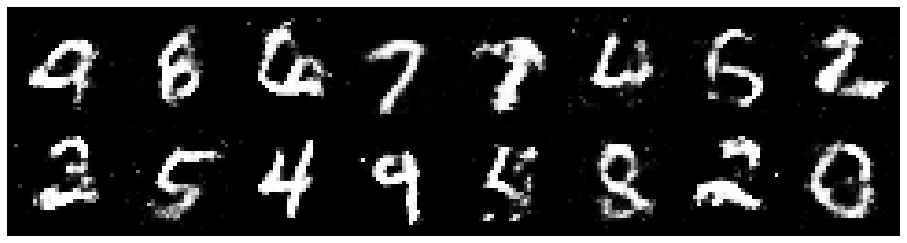

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.4412, Generator Loss: 0.8431
D(x): 0.5180, D(G(z)): 0.4749


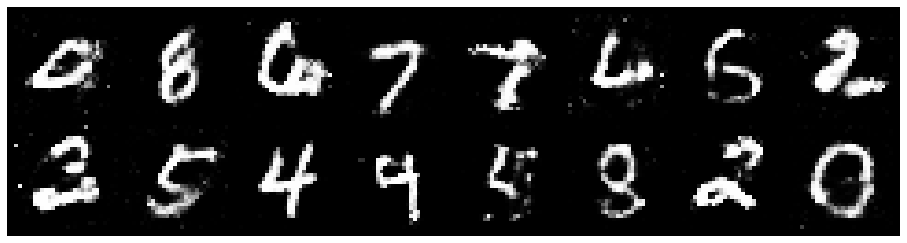

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2871, Generator Loss: 0.8443
D(x): 0.5265, D(G(z)): 0.4222


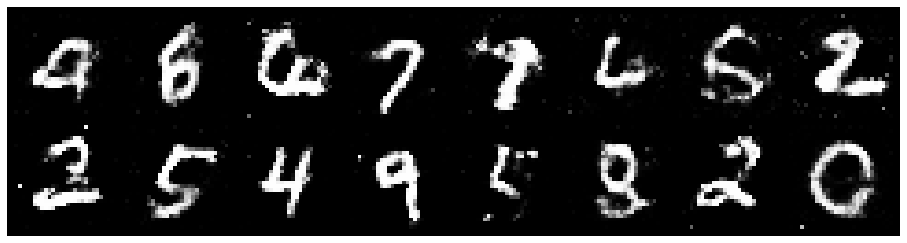

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2976, Generator Loss: 0.8924
D(x): 0.5307, D(G(z)): 0.4286


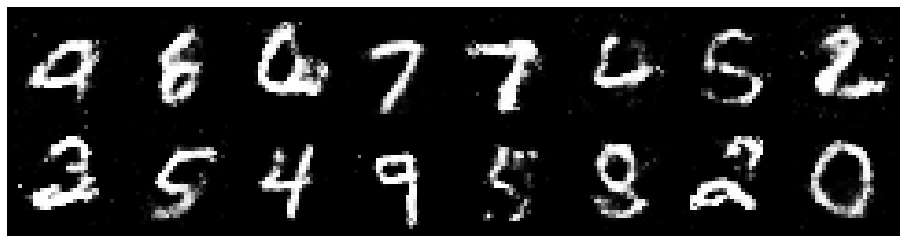

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.3219, Generator Loss: 0.9338
D(x): 0.5300, D(G(z)): 0.4271


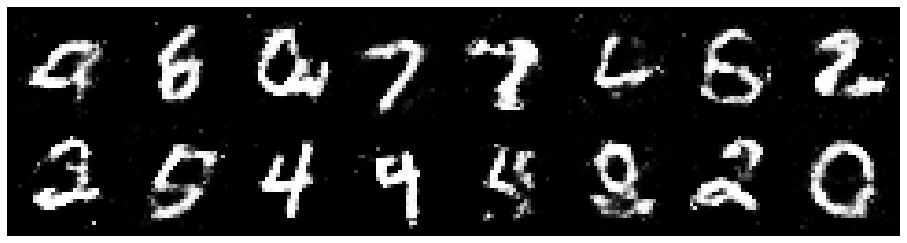

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.3130, Generator Loss: 0.9294
D(x): 0.5372, D(G(z)): 0.4388


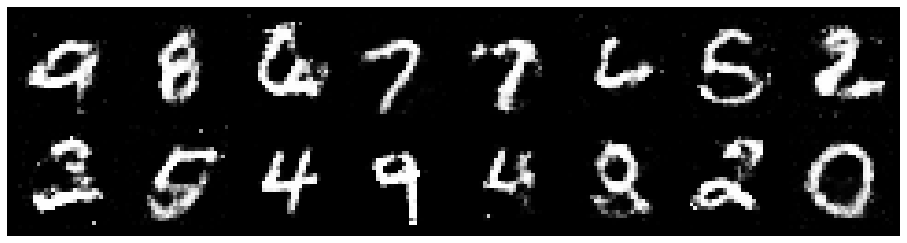

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.3245, Generator Loss: 0.8580
D(x): 0.5301, D(G(z)): 0.4481


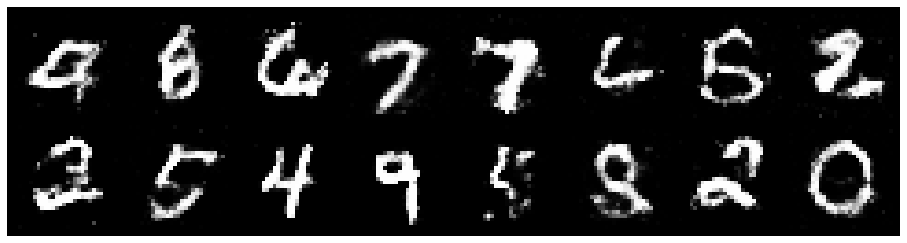

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.3849, Generator Loss: 0.7497
D(x): 0.5244, D(G(z)): 0.4937


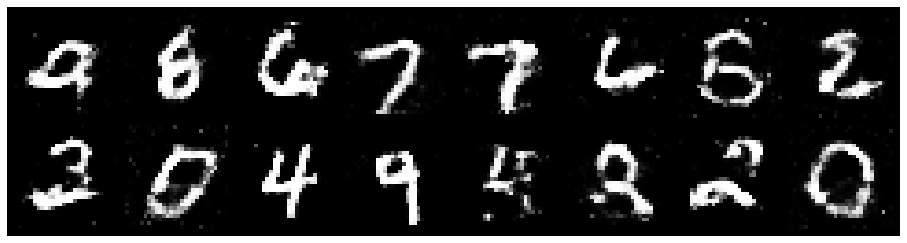

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3679, Generator Loss: 0.8683
D(x): 0.5270, D(G(z)): 0.4739


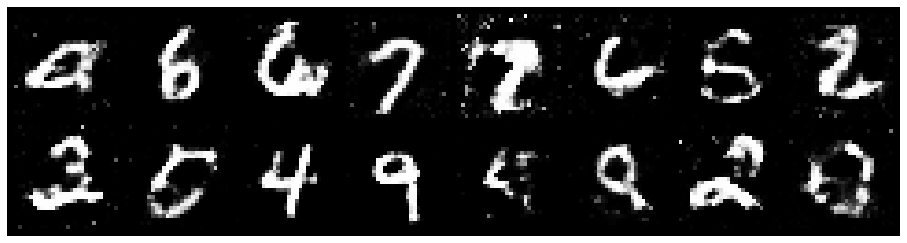

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2183, Generator Loss: 0.9285
D(x): 0.5944, D(G(z)): 0.4423


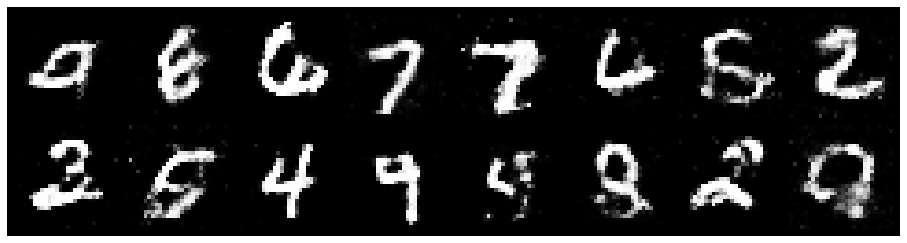

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.1588, Generator Loss: 0.9907
D(x): 0.6211, D(G(z)): 0.4328


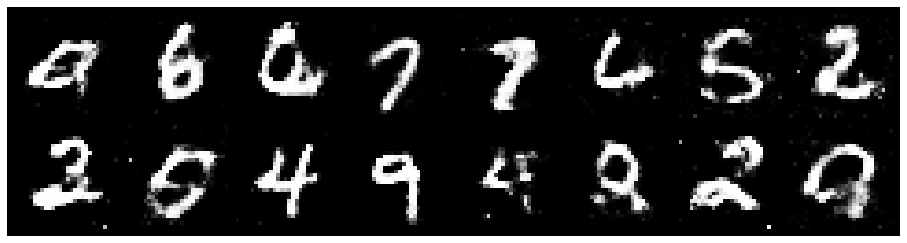

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2282, Generator Loss: 1.0074
D(x): 0.5256, D(G(z)): 0.3860


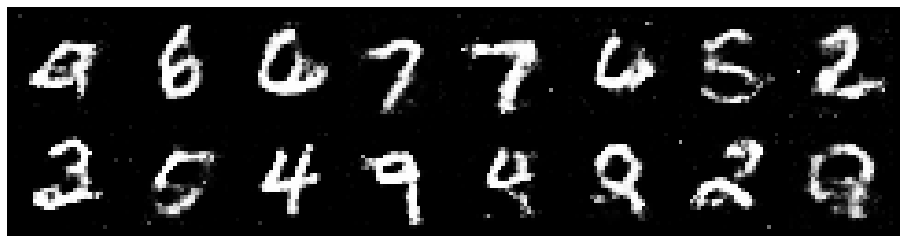

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.1101, Generator Loss: 0.9920
D(x): 0.6152, D(G(z)): 0.4121


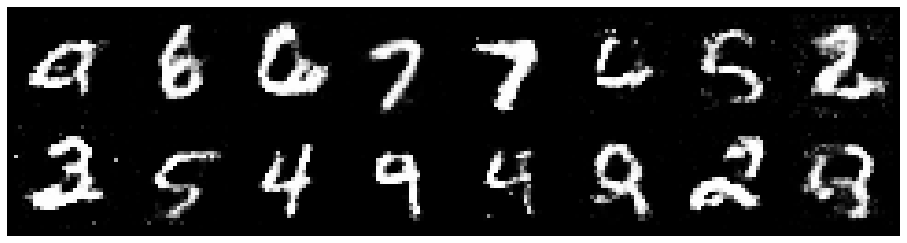

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.1392, Generator Loss: 0.8761
D(x): 0.5991, D(G(z)): 0.4195


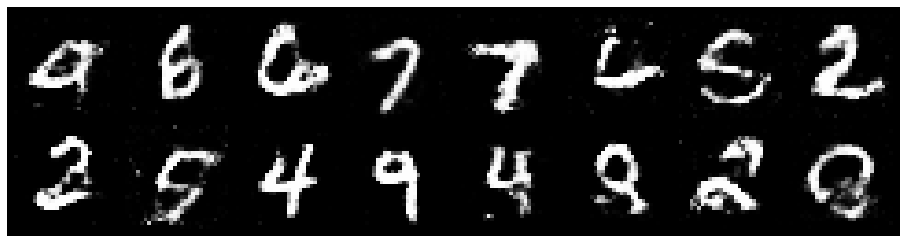

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8428
D(x): 0.5586, D(G(z)): 0.4826


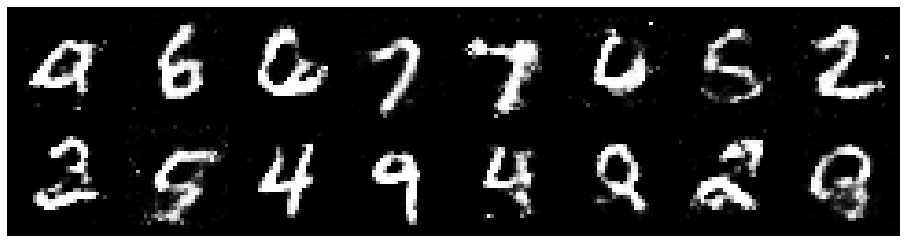

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1929, Generator Loss: 0.9206
D(x): 0.5881, D(G(z)): 0.4471


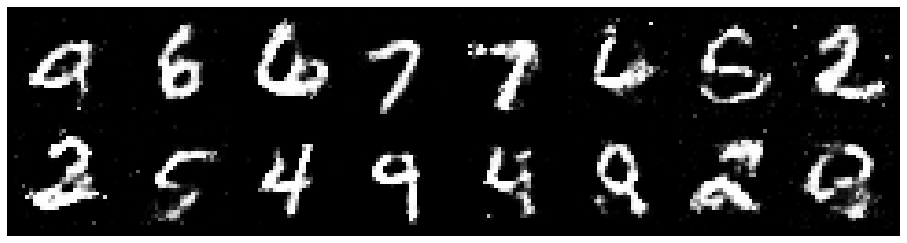

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2133, Generator Loss: 0.9764
D(x): 0.5839, D(G(z)): 0.4260


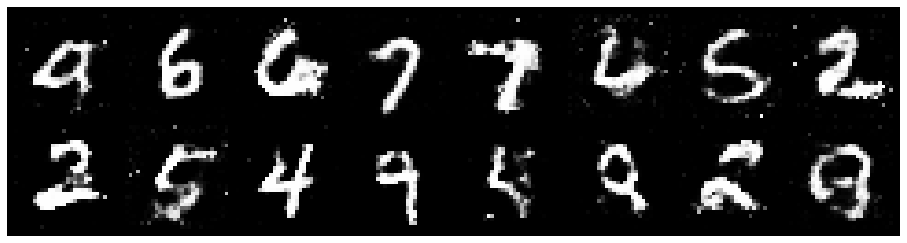

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2403, Generator Loss: 0.9189
D(x): 0.5528, D(G(z)): 0.4127


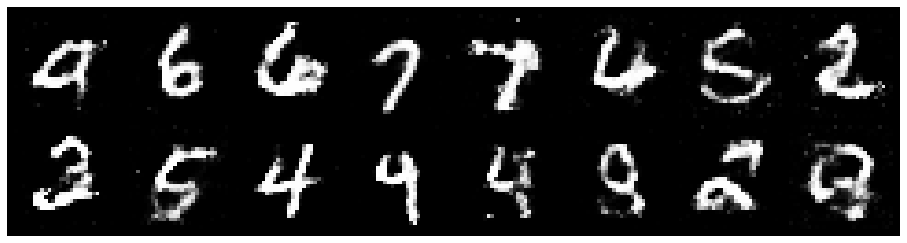

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.2646, Generator Loss: 0.8143
D(x): 0.5548, D(G(z)): 0.4506


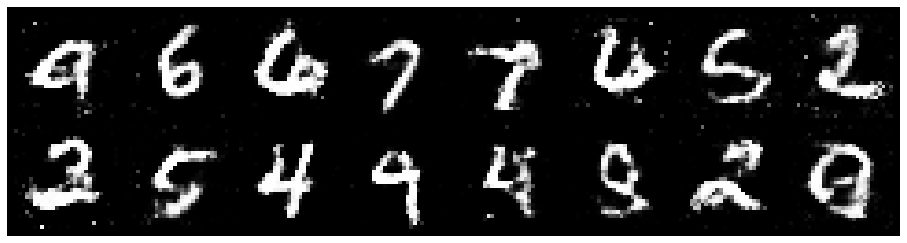

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2956, Generator Loss: 0.8745
D(x): 0.5035, D(G(z)): 0.4164


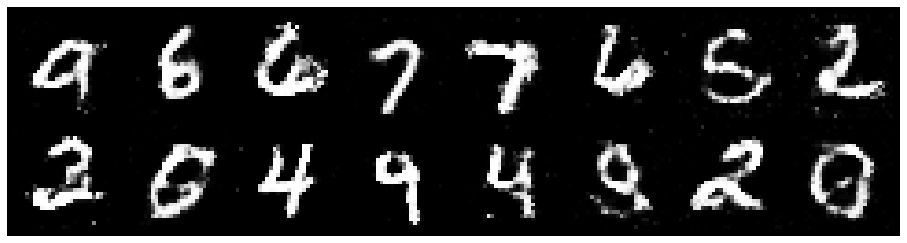

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2699, Generator Loss: 0.7919
D(x): 0.5669, D(G(z)): 0.4642


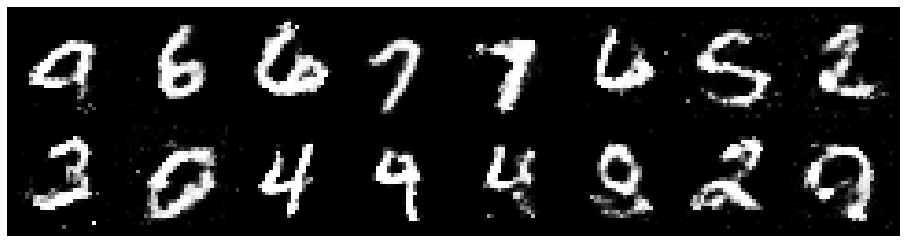

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2790, Generator Loss: 0.8988
D(x): 0.5483, D(G(z)): 0.4498


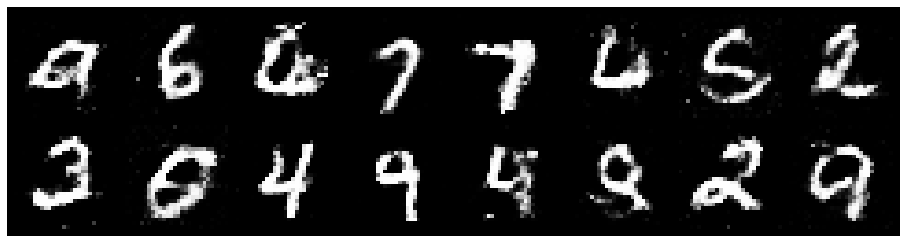

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2864, Generator Loss: 0.8419
D(x): 0.5736, D(G(z)): 0.4733


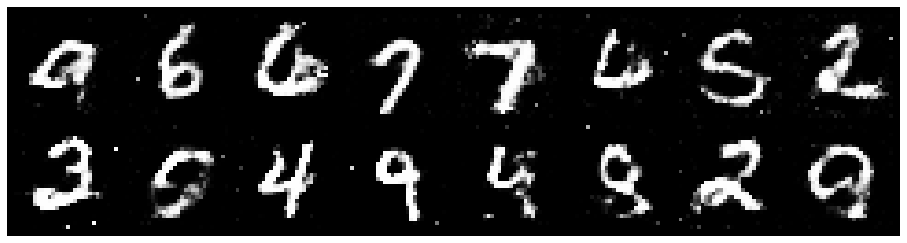

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.1661, Generator Loss: 0.9032
D(x): 0.5849, D(G(z)): 0.4283


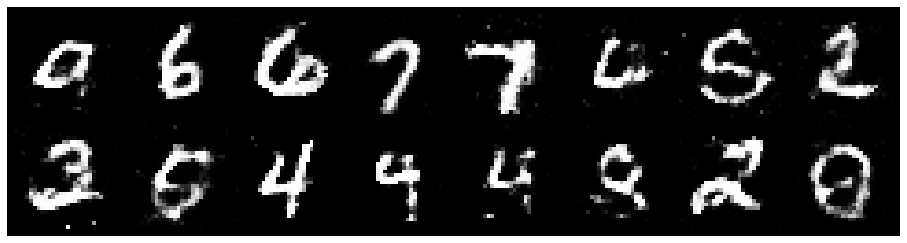

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.3723, Generator Loss: 0.8278
D(x): 0.5528, D(G(z)): 0.4798


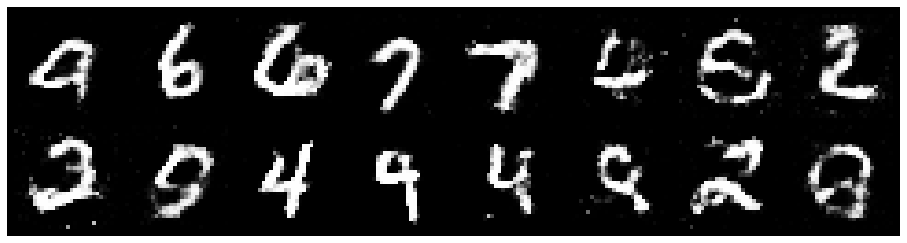

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8239
D(x): 0.5594, D(G(z)): 0.4552


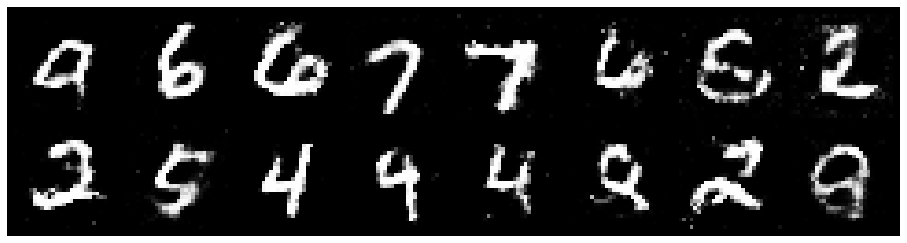

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3882, Generator Loss: 0.8449
D(x): 0.5235, D(G(z)): 0.4670


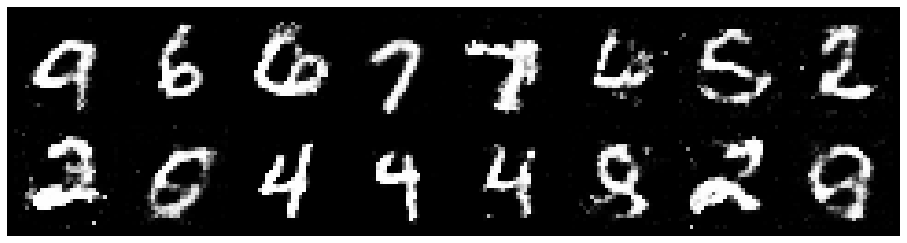

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3486, Generator Loss: 0.8084
D(x): 0.5609, D(G(z)): 0.4926


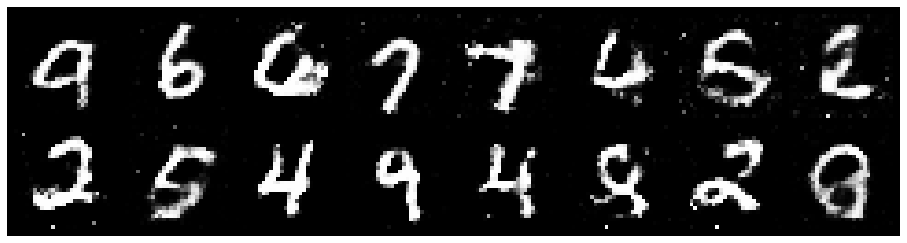

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.3314, Generator Loss: 0.8752
D(x): 0.5431, D(G(z)): 0.4684


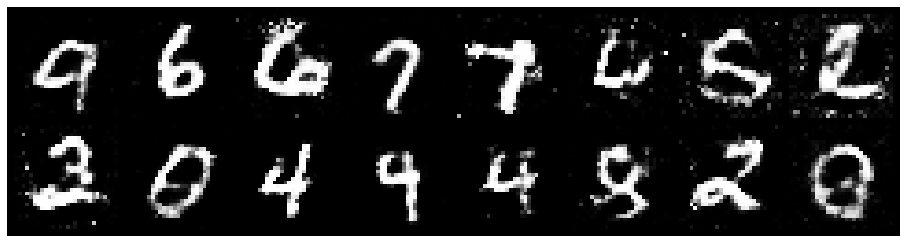

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2689, Generator Loss: 0.8458
D(x): 0.5522, D(G(z)): 0.4590


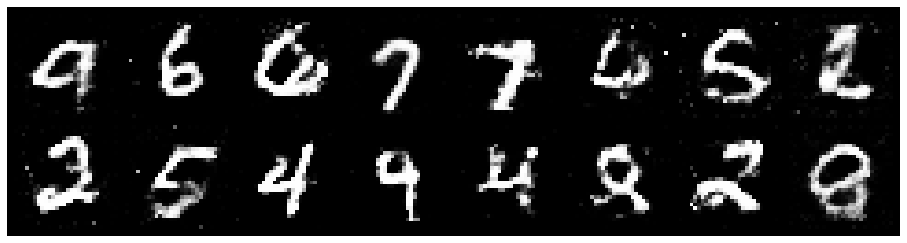

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2498, Generator Loss: 0.8783
D(x): 0.5384, D(G(z)): 0.4230


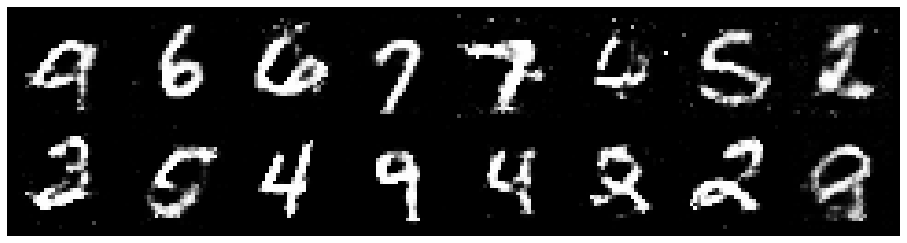

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.1904, Generator Loss: 1.0020
D(x): 0.5602, D(G(z)): 0.4085


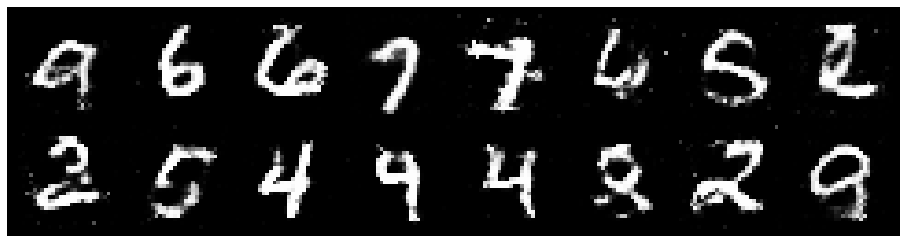

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2301, Generator Loss: 0.8529
D(x): 0.5553, D(G(z)): 0.4202


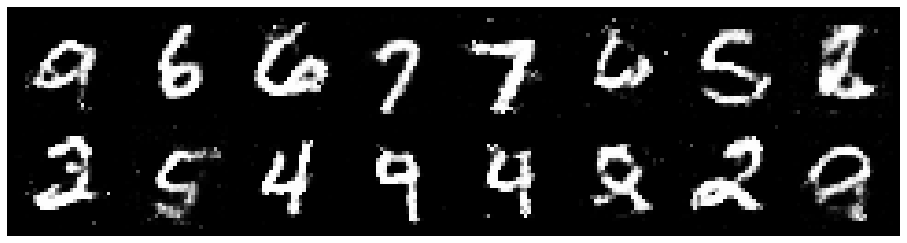

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2753, Generator Loss: 0.9135
D(x): 0.5967, D(G(z)): 0.4711


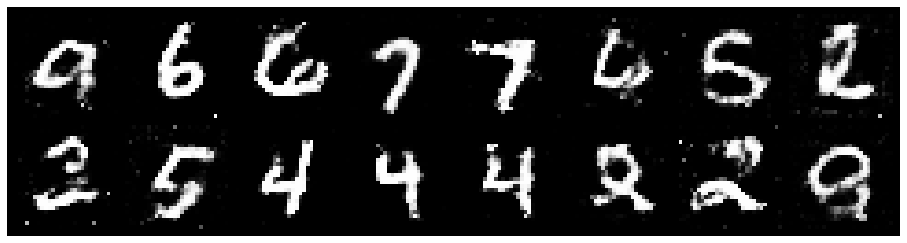

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3434, Generator Loss: 0.7961
D(x): 0.5875, D(G(z)): 0.4852


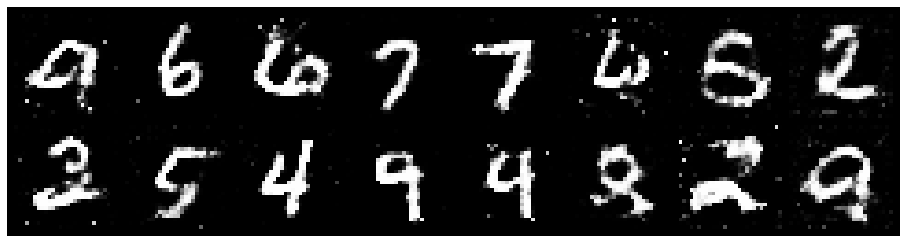

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.1654, Generator Loss: 1.0498
D(x): 0.5644, D(G(z)): 0.4037


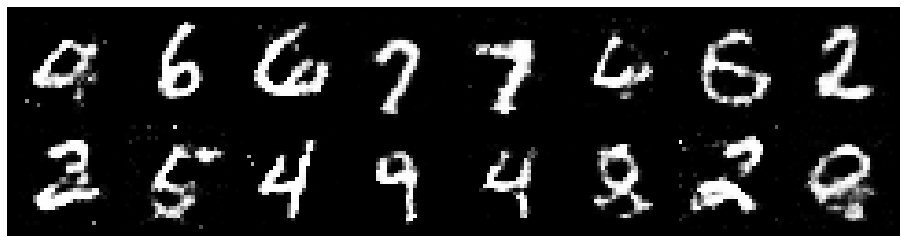

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.2922, Generator Loss: 0.7873
D(x): 0.5449, D(G(z)): 0.4584


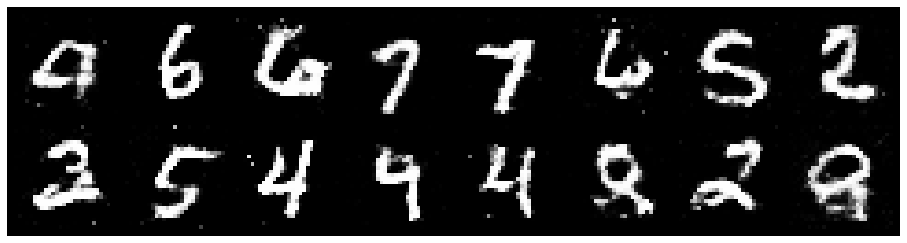

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.1673, Generator Loss: 0.9268
D(x): 0.5727, D(G(z)): 0.4115


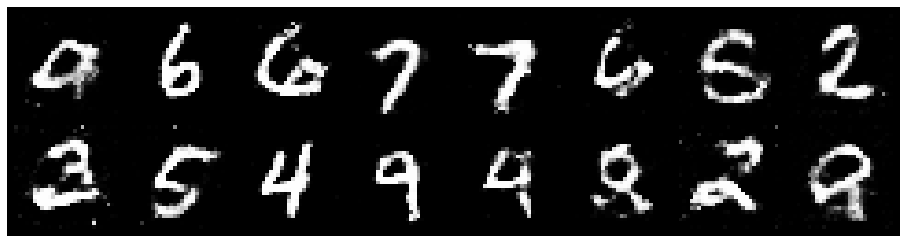

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.3162, Generator Loss: 0.7558
D(x): 0.5344, D(G(z)): 0.4620


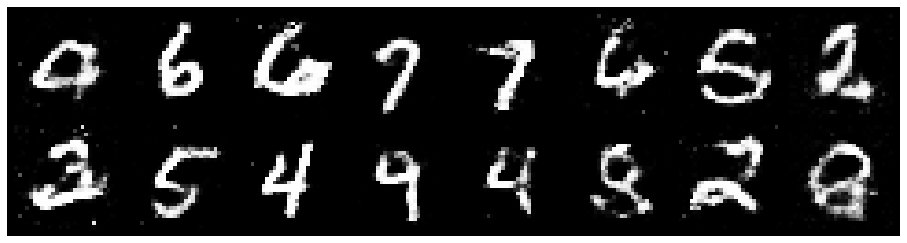

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2400, Generator Loss: 0.9672
D(x): 0.5447, D(G(z)): 0.4263


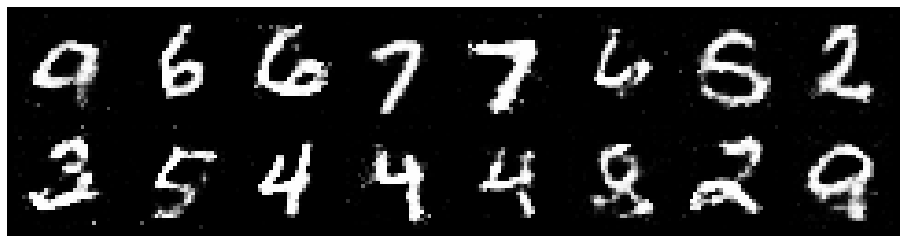

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2025, Generator Loss: 0.8613
D(x): 0.5849, D(G(z)): 0.4430


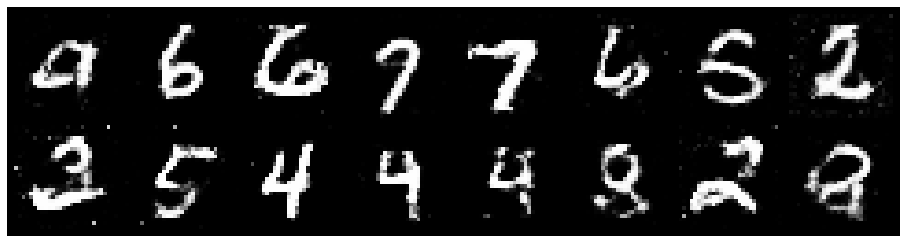

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2677, Generator Loss: 0.9000
D(x): 0.5416, D(G(z)): 0.4509


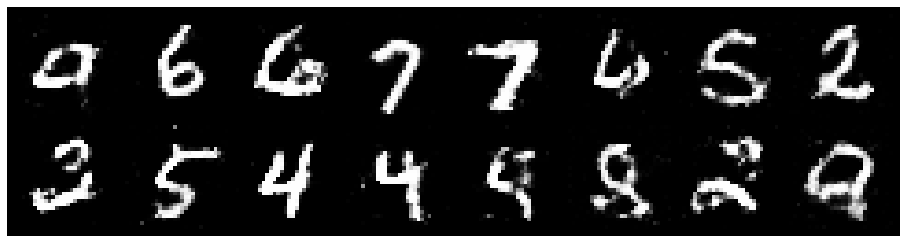

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3131, Generator Loss: 0.7987
D(x): 0.5344, D(G(z)): 0.4505


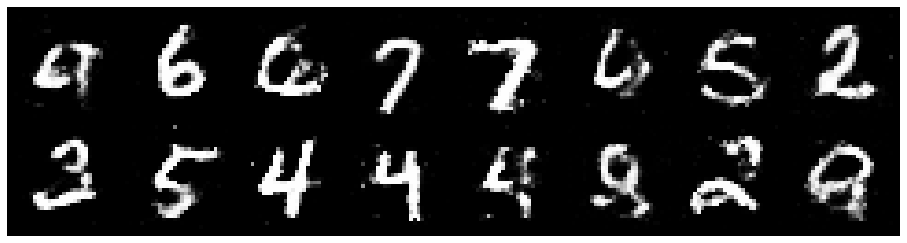

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.4295, Generator Loss: 0.7749
D(x): 0.5538, D(G(z)): 0.5310


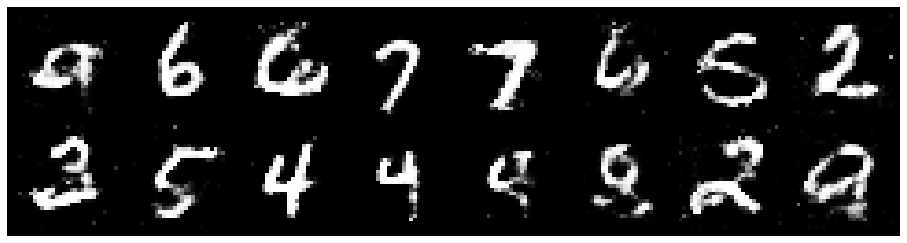

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.3250, Generator Loss: 0.8629
D(x): 0.5650, D(G(z)): 0.4605


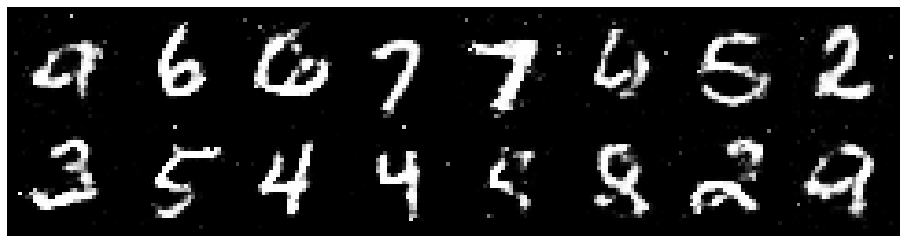

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.4281, Generator Loss: 0.7208
D(x): 0.5394, D(G(z)): 0.5071


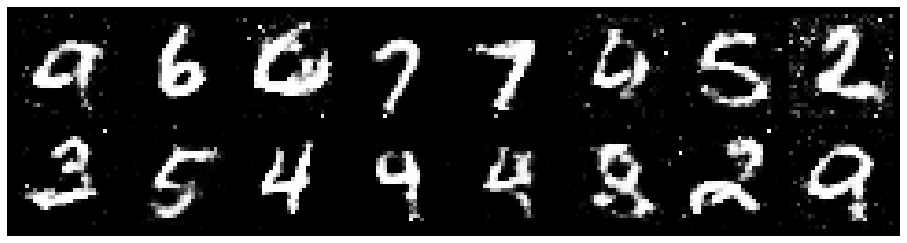

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2633, Generator Loss: 0.7717
D(x): 0.5414, D(G(z)): 0.4453


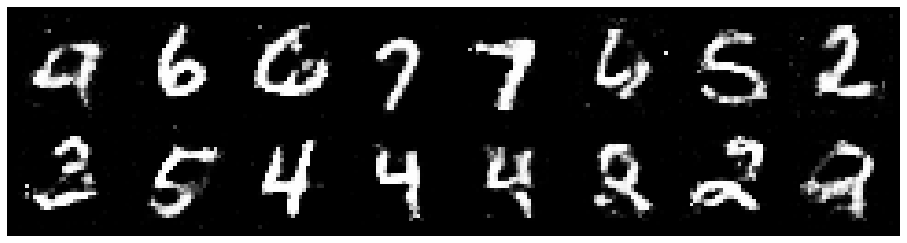

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2157, Generator Loss: 0.7861
D(x): 0.5751, D(G(z)): 0.4390


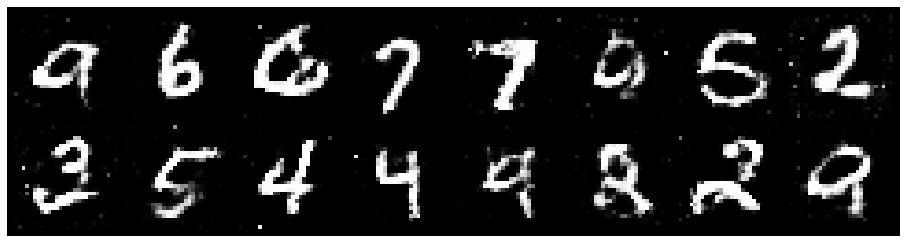

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3084, Generator Loss: 0.9180
D(x): 0.5386, D(G(z)): 0.4340


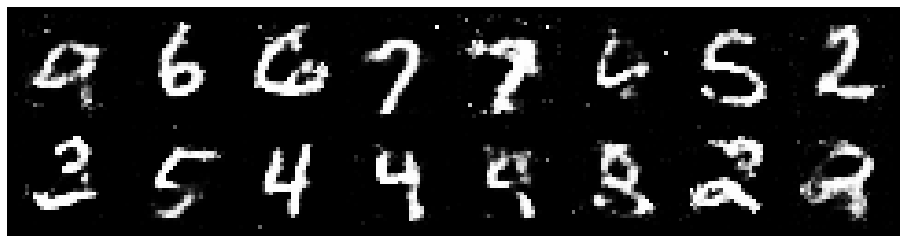

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.1861, Generator Loss: 0.9339
D(x): 0.5580, D(G(z)): 0.4076


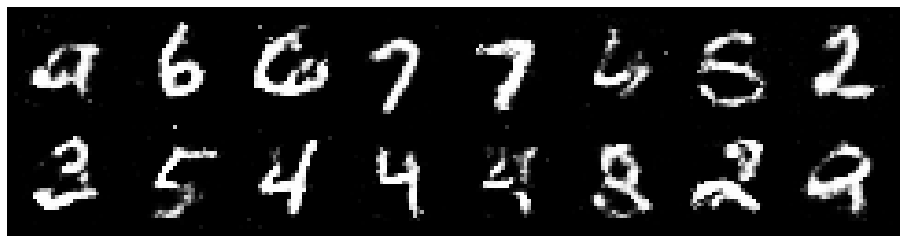

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9391
D(x): 0.5618, D(G(z)): 0.4264


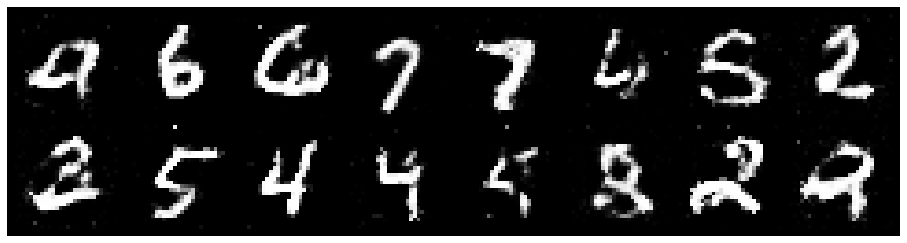

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9257
D(x): 0.5560, D(G(z)): 0.4366


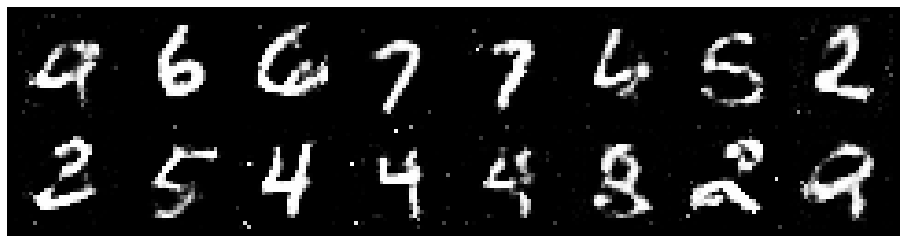

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2263, Generator Loss: 0.9231
D(x): 0.5653, D(G(z)): 0.4315


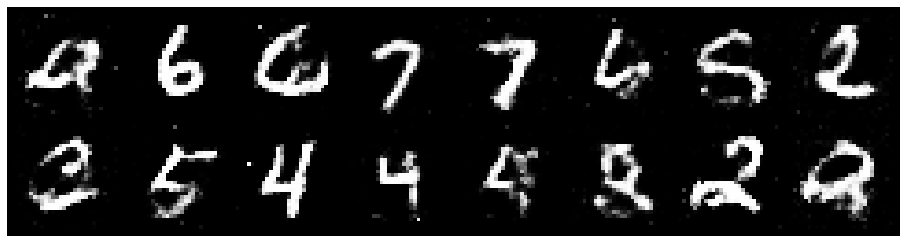

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.3398, Generator Loss: 0.8219
D(x): 0.5413, D(G(z)): 0.4770


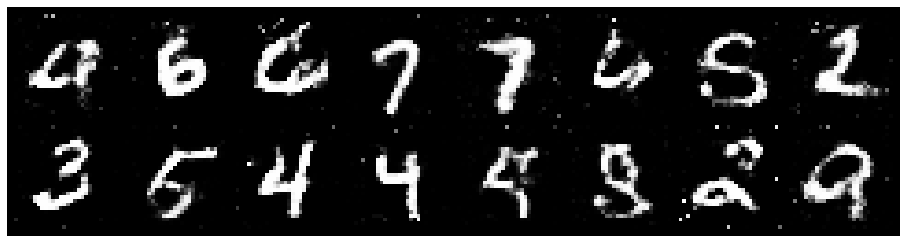

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.3212, Generator Loss: 0.9184
D(x): 0.5371, D(G(z)): 0.4524


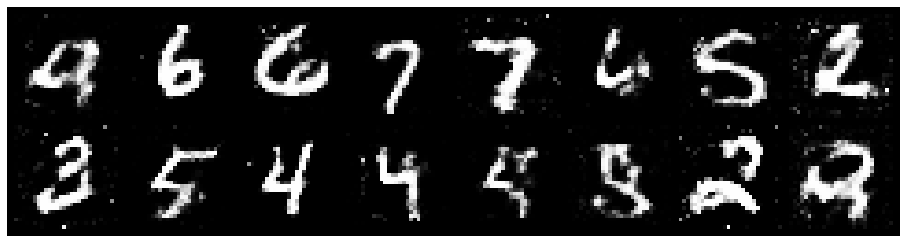

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.1779, Generator Loss: 1.0415
D(x): 0.5740, D(G(z)): 0.4027


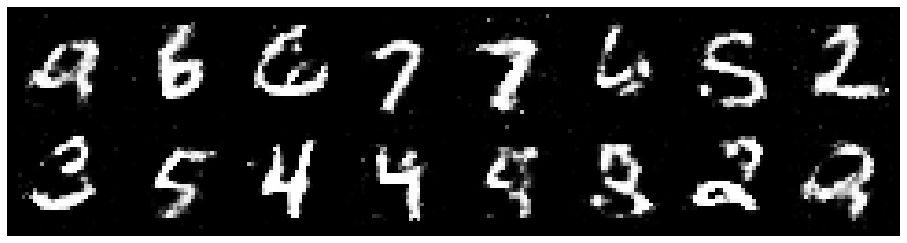

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2612, Generator Loss: 1.0481
D(x): 0.5842, D(G(z)): 0.4302


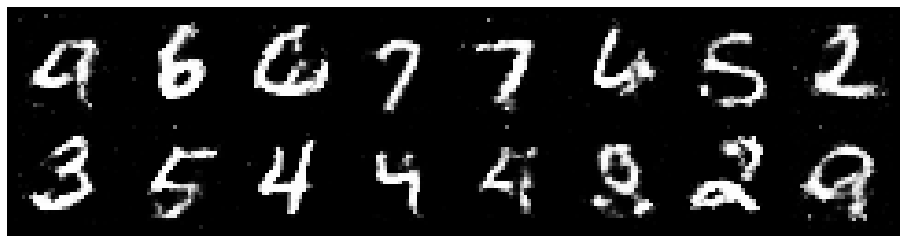

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2716, Generator Loss: 0.9257
D(x): 0.5543, D(G(z)): 0.4388


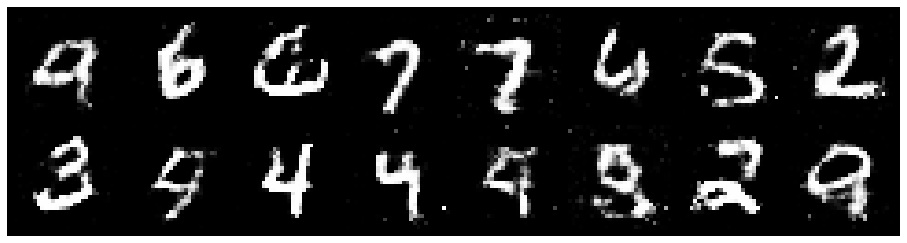

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2930, Generator Loss: 1.0957
D(x): 0.5417, D(G(z)): 0.4421


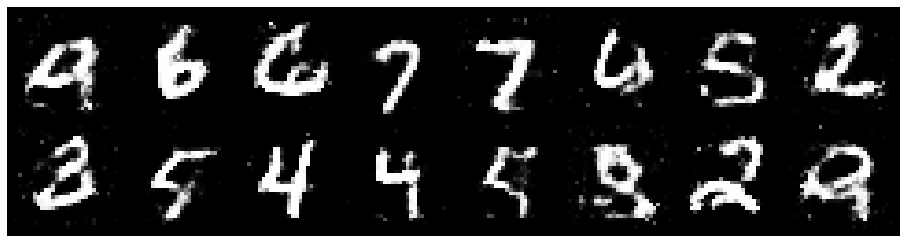

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2417, Generator Loss: 0.9086
D(x): 0.5647, D(G(z)): 0.4377


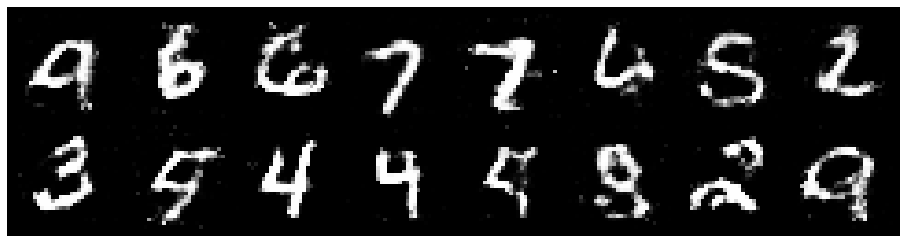

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2709, Generator Loss: 0.8881
D(x): 0.5549, D(G(z)): 0.4591


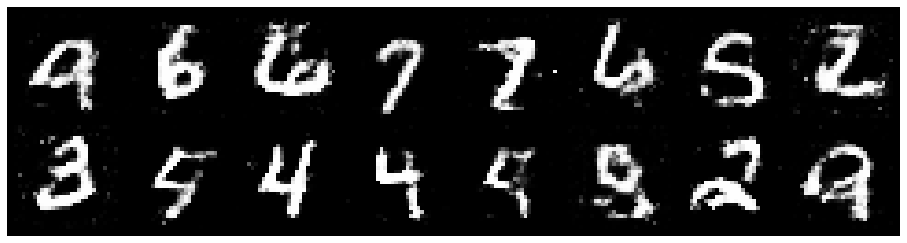

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2067, Generator Loss: 0.8754
D(x): 0.5514, D(G(z)): 0.4162


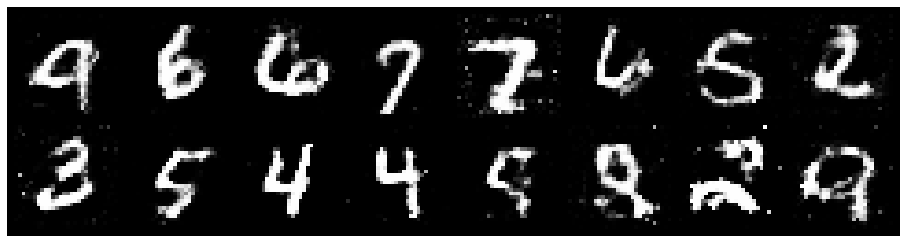

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2241, Generator Loss: 1.0430
D(x): 0.5591, D(G(z)): 0.4243


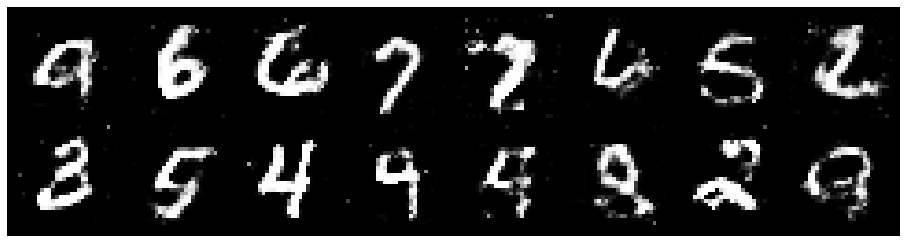

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.2039, Generator Loss: 0.8978
D(x): 0.5684, D(G(z)): 0.4419


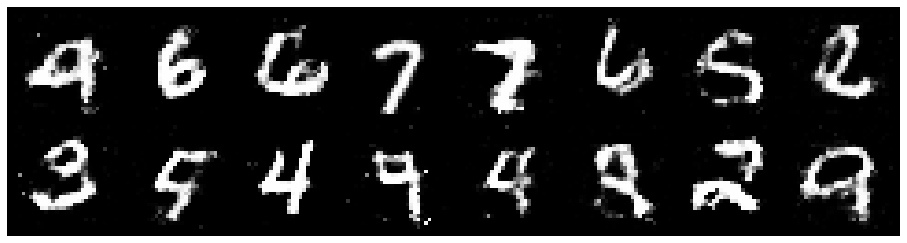

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.1525, Generator Loss: 1.0613
D(x): 0.5480, D(G(z)): 0.3625


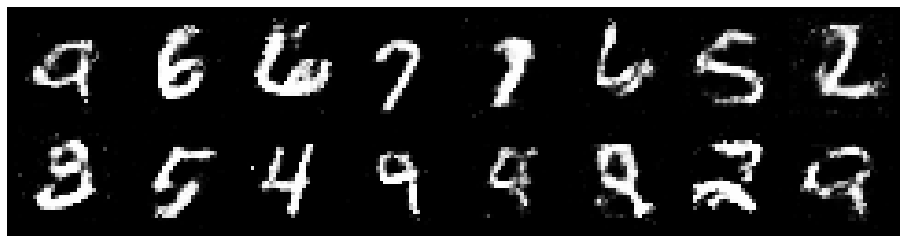

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.4433, Generator Loss: 0.8187
D(x): 0.4942, D(G(z)): 0.4630


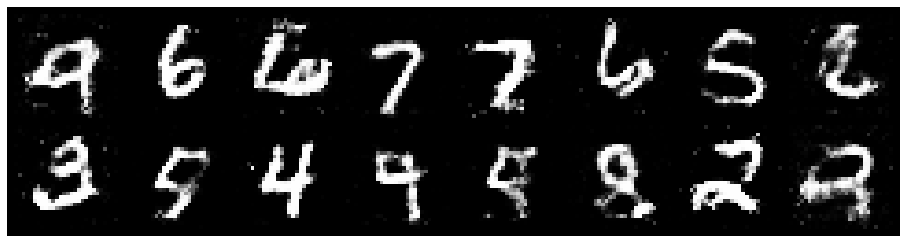

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.3181, Generator Loss: 0.7367
D(x): 0.6053, D(G(z)): 0.4936


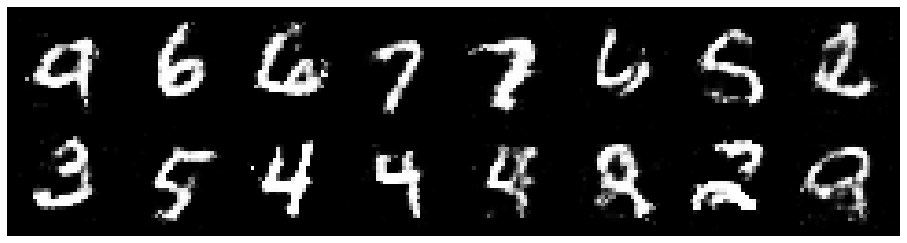

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.3547, Generator Loss: 0.9778
D(x): 0.5271, D(G(z)): 0.4335


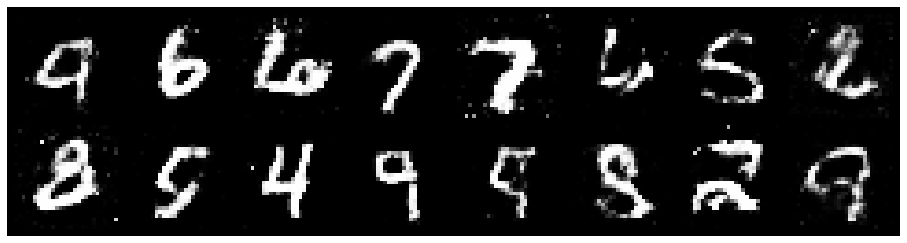

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.1033, Generator Loss: 1.0081
D(x): 0.5907, D(G(z)): 0.3984


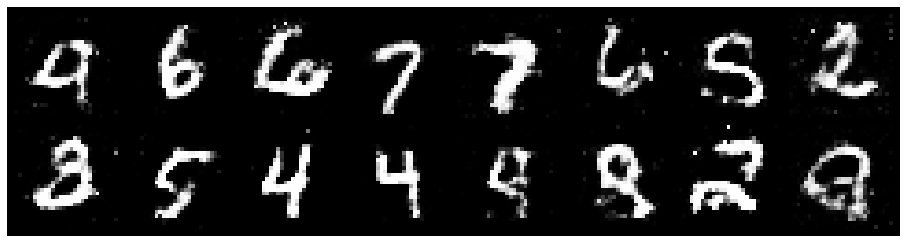

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.1904, Generator Loss: 0.9763
D(x): 0.5637, D(G(z)): 0.4114


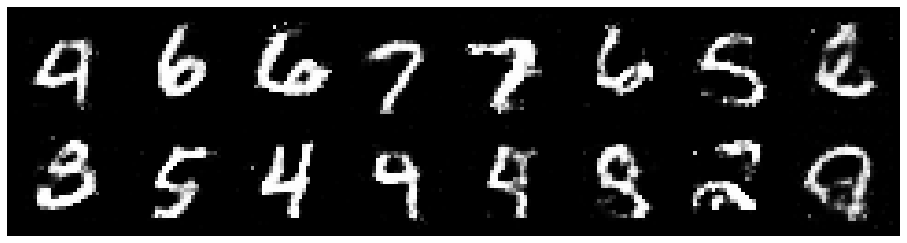

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.1488, Generator Loss: 0.9611
D(x): 0.6165, D(G(z)): 0.4289


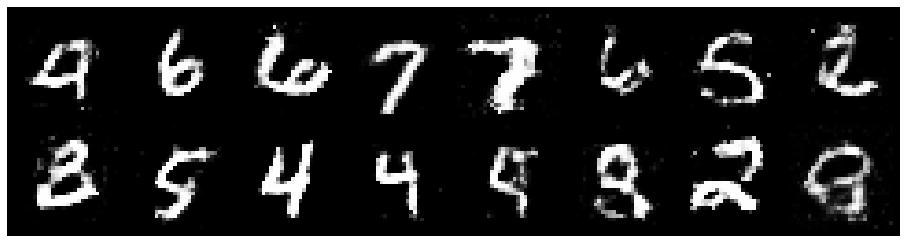

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.0124, Generator Loss: 0.9561
D(x): 0.6326, D(G(z)): 0.3801


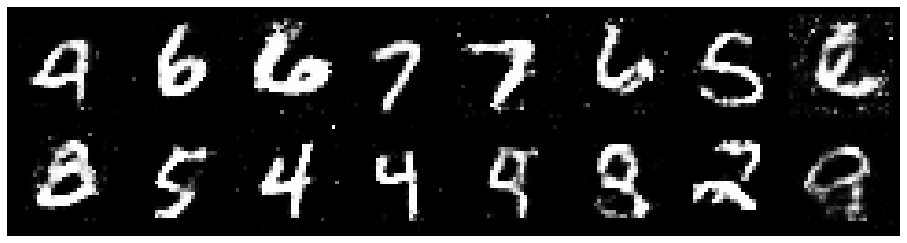

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.3792, Generator Loss: 0.9130
D(x): 0.5365, D(G(z)): 0.4613


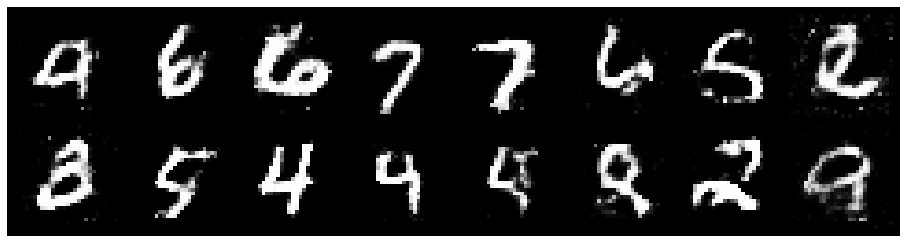

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2791, Generator Loss: 1.1256
D(x): 0.5528, D(G(z)): 0.4077


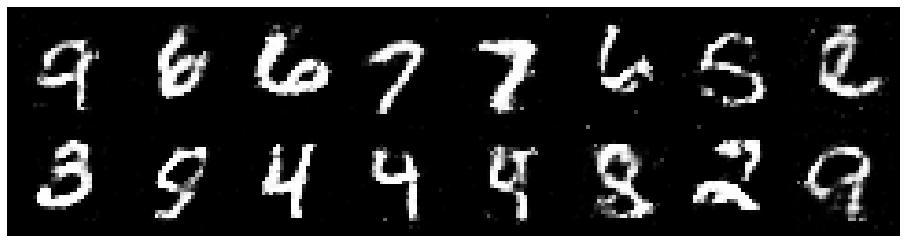

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2202, Generator Loss: 0.9568
D(x): 0.5628, D(G(z)): 0.4259


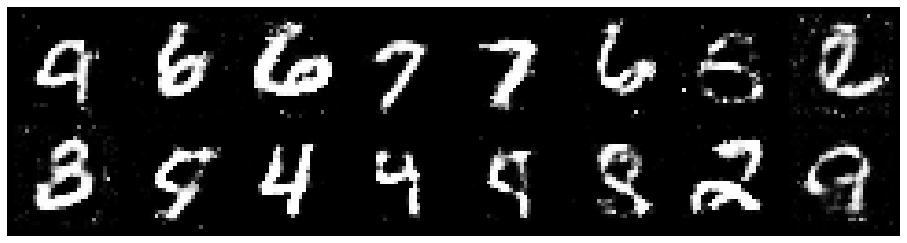

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.3495, Generator Loss: 0.8767
D(x): 0.5834, D(G(z)): 0.4973


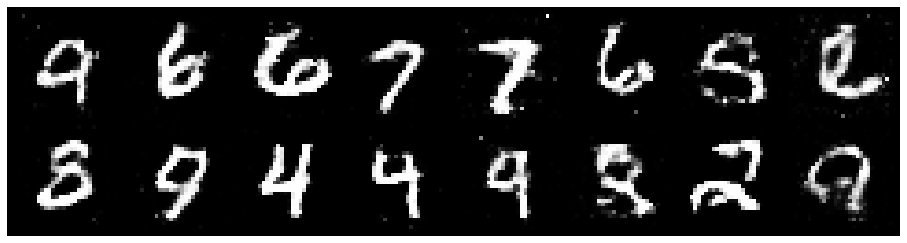

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2507, Generator Loss: 0.8707
D(x): 0.5751, D(G(z)): 0.4486


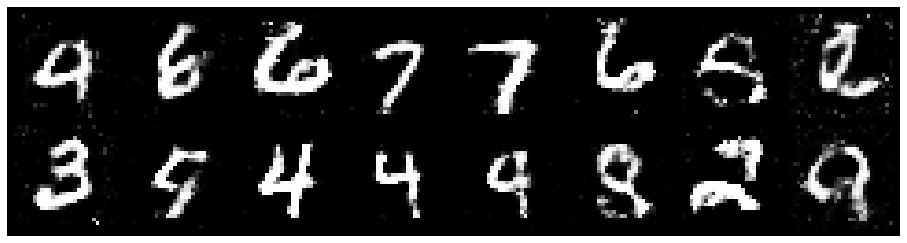

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.3864, Generator Loss: 0.8065
D(x): 0.5353, D(G(z)): 0.4964


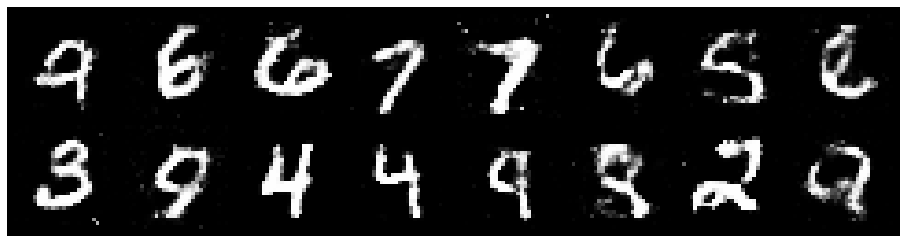

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.4055, Generator Loss: 0.8218
D(x): 0.5343, D(G(z)): 0.4883


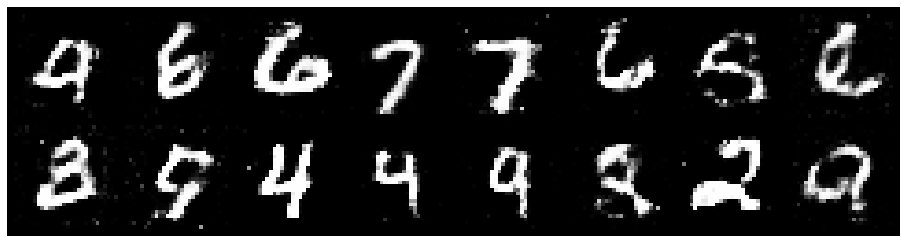

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3050, Generator Loss: 0.8071
D(x): 0.5188, D(G(z)): 0.4459


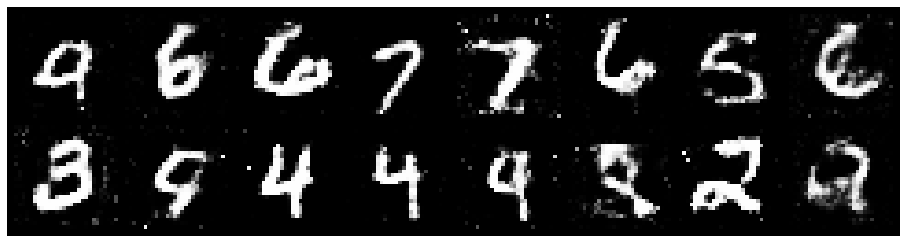

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3162, Generator Loss: 0.7922
D(x): 0.5381, D(G(z)): 0.4746


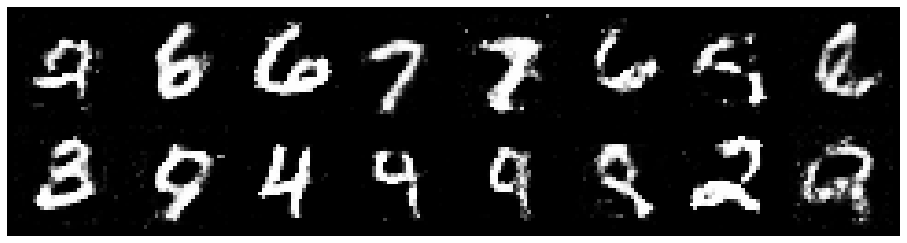

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2417, Generator Loss: 0.8934
D(x): 0.5398, D(G(z)): 0.4188


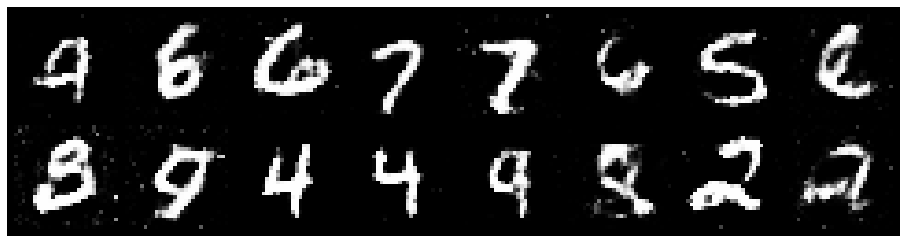

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.3494, Generator Loss: 0.9068
D(x): 0.5043, D(G(z)): 0.4474


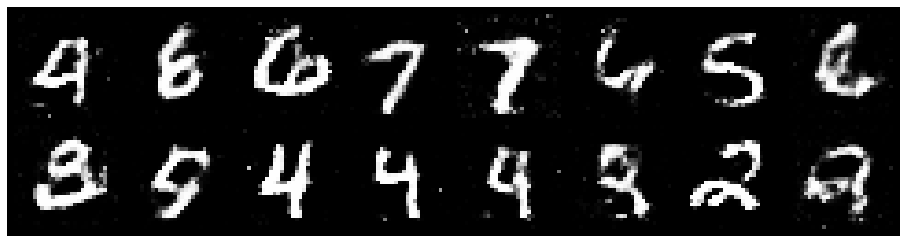

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.2296, Generator Loss: 0.8694
D(x): 0.5730, D(G(z)): 0.4502


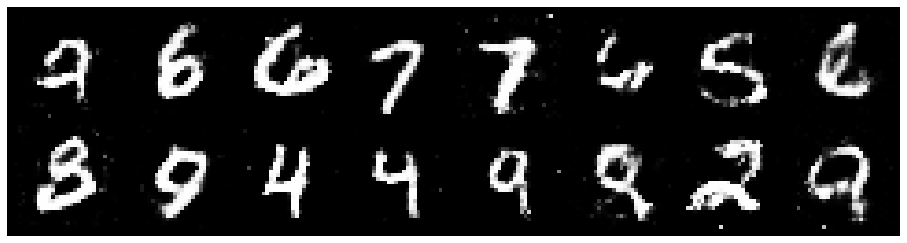

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2731, Generator Loss: 0.8817
D(x): 0.5547, D(G(z)): 0.4544


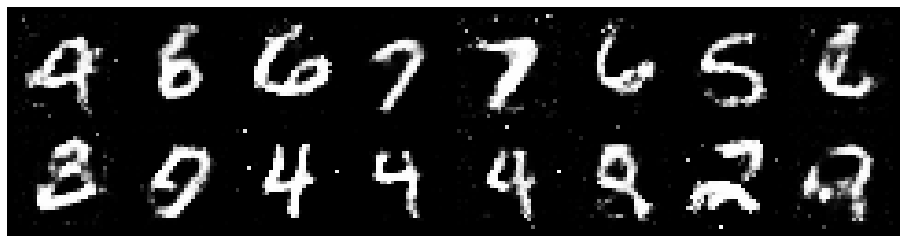

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2573, Generator Loss: 0.9095
D(x): 0.5502, D(G(z)): 0.4432


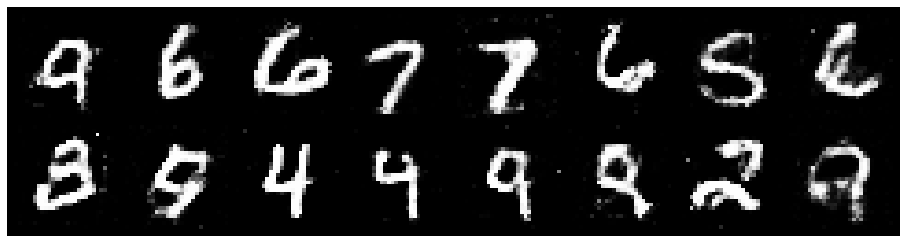

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.3063, Generator Loss: 1.0248
D(x): 0.5478, D(G(z)): 0.4226


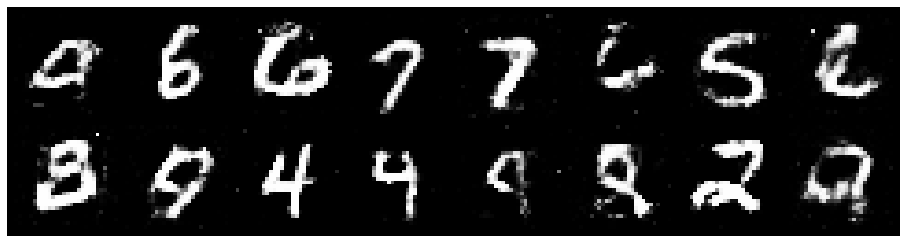

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2581, Generator Loss: 0.7757
D(x): 0.6063, D(G(z)): 0.4853


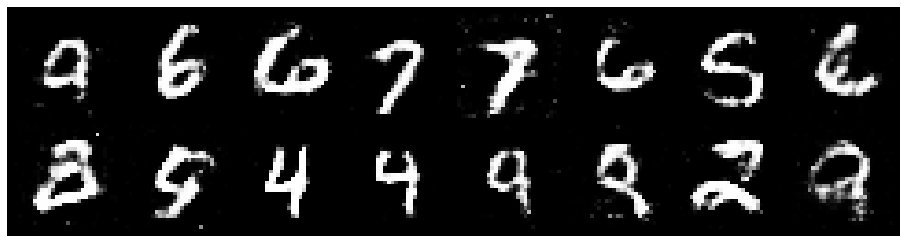

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.4307, Generator Loss: 0.8858
D(x): 0.5122, D(G(z)): 0.4568


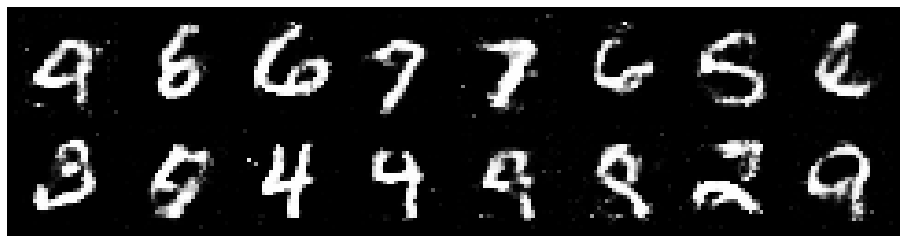

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.3392, Generator Loss: 0.9248
D(x): 0.5465, D(G(z)): 0.4542


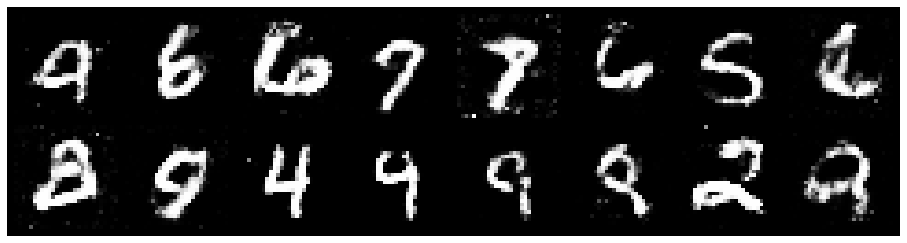

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.3636, Generator Loss: 0.9328
D(x): 0.5634, D(G(z)): 0.4757


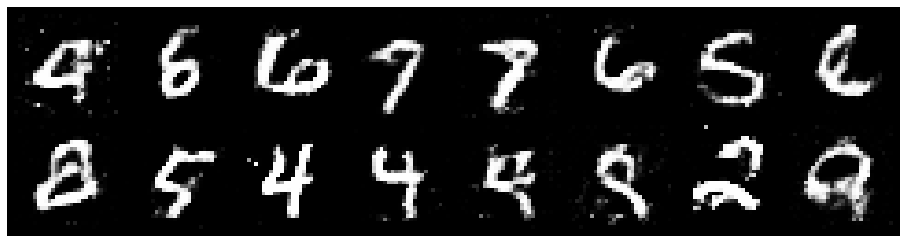

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3207, Generator Loss: 0.8026
D(x): 0.5585, D(G(z)): 0.4688


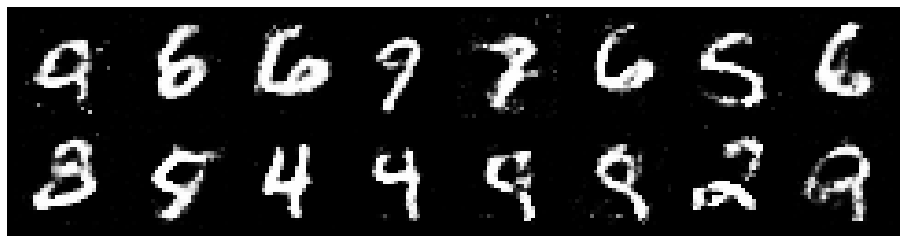

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.3523, Generator Loss: 0.8591
D(x): 0.5431, D(G(z)): 0.4705


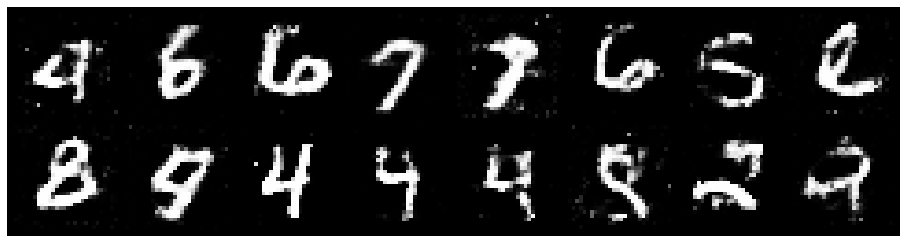

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8255
D(x): 0.5414, D(G(z)): 0.4617


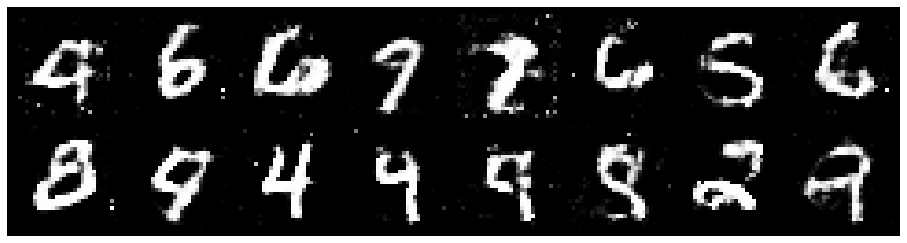

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.3115, Generator Loss: 0.7961
D(x): 0.5686, D(G(z)): 0.4800


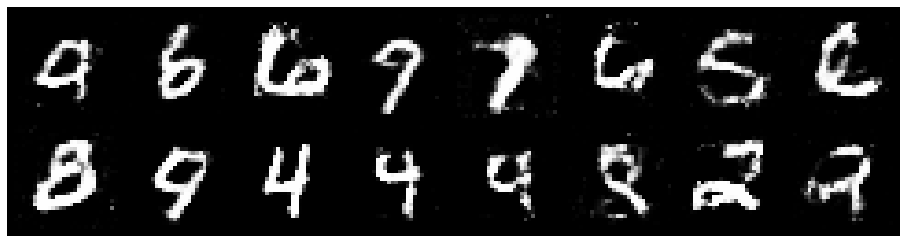

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8449
D(x): 0.5168, D(G(z)): 0.4388


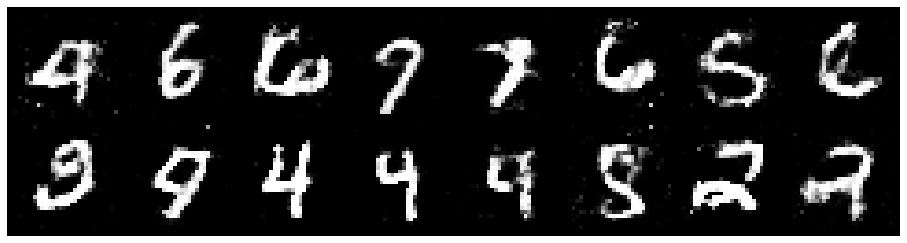

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.2986, Generator Loss: 0.7927
D(x): 0.5455, D(G(z)): 0.4533


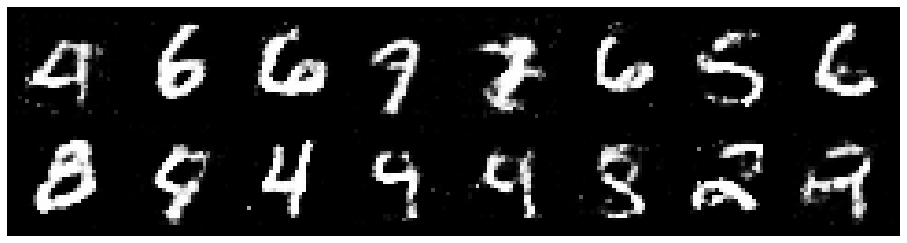

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.2425, Generator Loss: 0.9450
D(x): 0.5295, D(G(z)): 0.4195


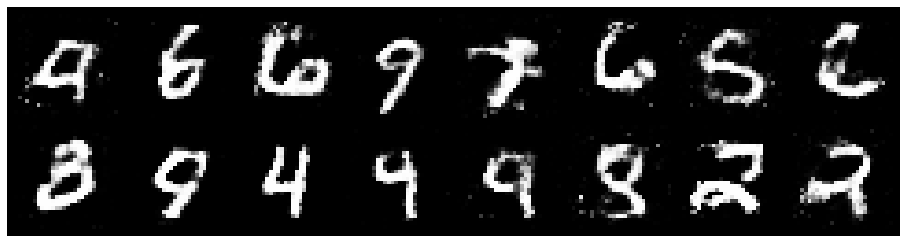

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3265, Generator Loss: 0.8109
D(x): 0.5107, D(G(z)): 0.4435


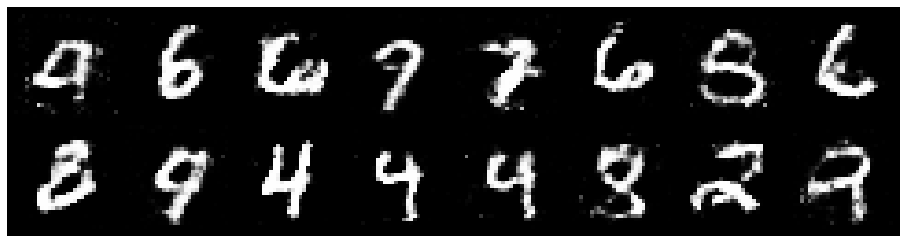

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.3574, Generator Loss: 0.9439
D(x): 0.5283, D(G(z)): 0.4395


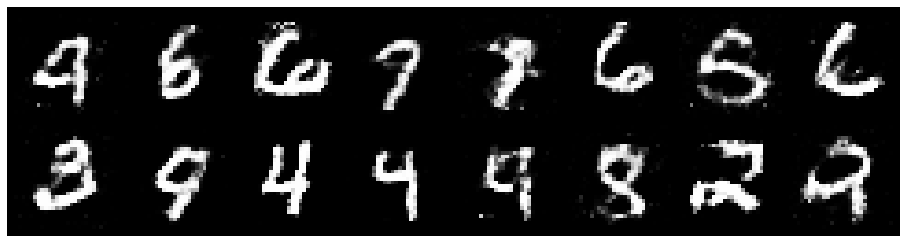

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.2317, Generator Loss: 0.9467
D(x): 0.5429, D(G(z)): 0.4105


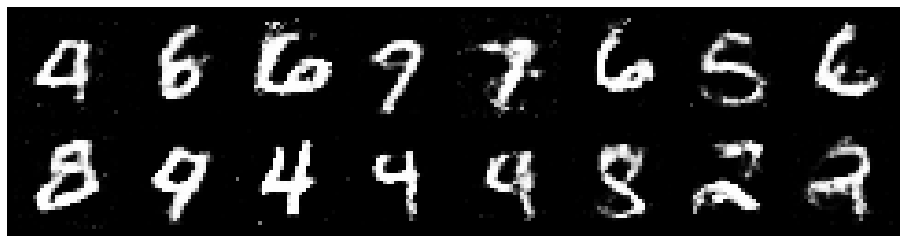

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3416, Generator Loss: 0.9249
D(x): 0.4975, D(G(z)): 0.4202


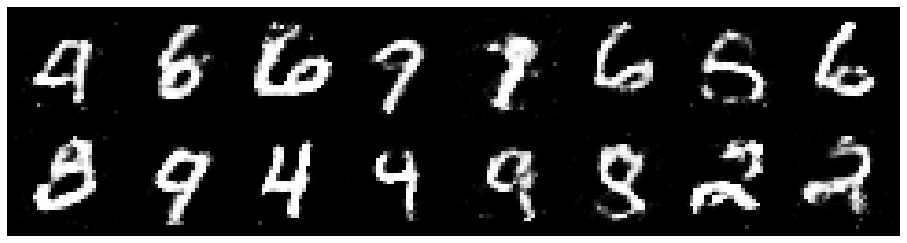

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.2261, Generator Loss: 0.7879
D(x): 0.5524, D(G(z)): 0.4308


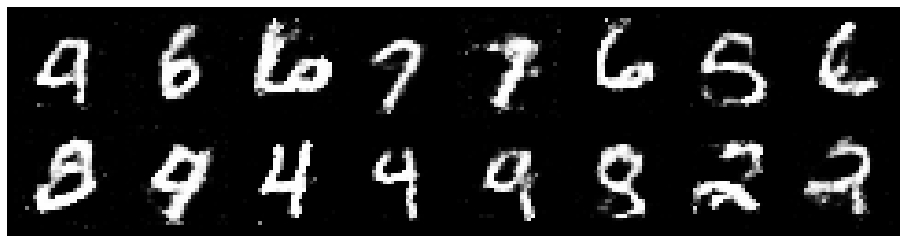

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.3216, Generator Loss: 0.9081
D(x): 0.5099, D(G(z)): 0.4370


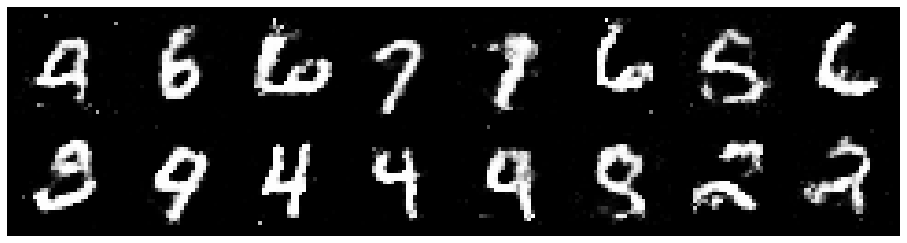

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2700, Generator Loss: 1.0596
D(x): 0.5334, D(G(z)): 0.3934


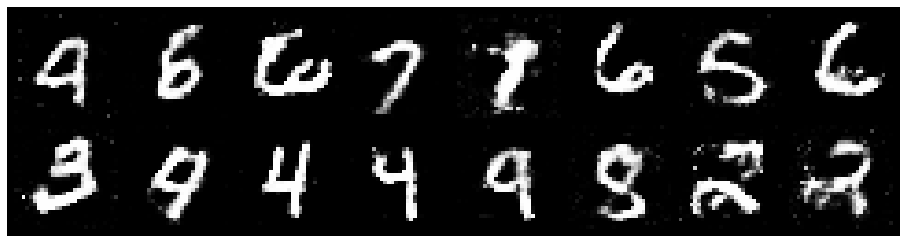

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2994, Generator Loss: 0.8877
D(x): 0.5545, D(G(z)): 0.4442


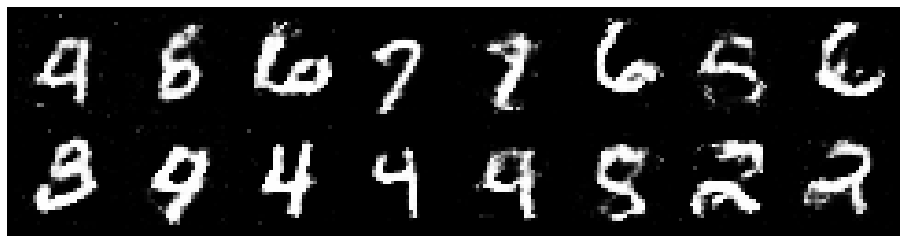

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2999, Generator Loss: 0.7597
D(x): 0.5572, D(G(z)): 0.4833


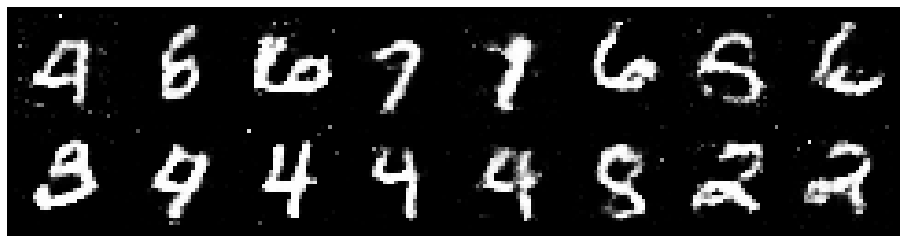

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2200, Generator Loss: 0.8885
D(x): 0.5476, D(G(z)): 0.4099


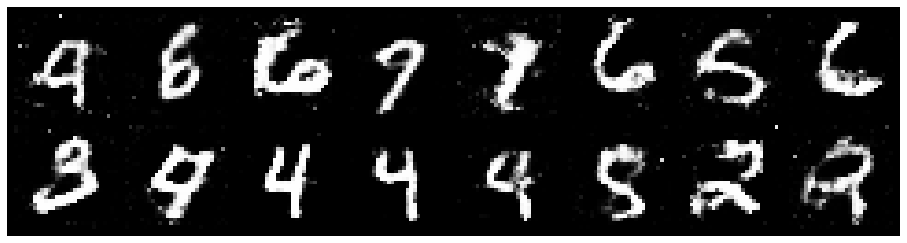

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3381, Generator Loss: 0.8984
D(x): 0.5320, D(G(z)): 0.4518


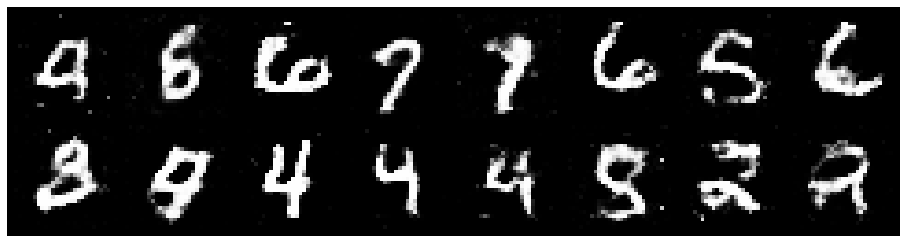

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.1490, Generator Loss: 0.8858
D(x): 0.5944, D(G(z)): 0.4100


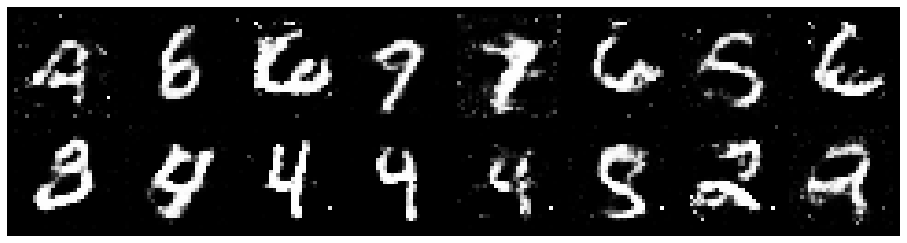

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2072, Generator Loss: 0.9150
D(x): 0.5912, D(G(z)): 0.4355


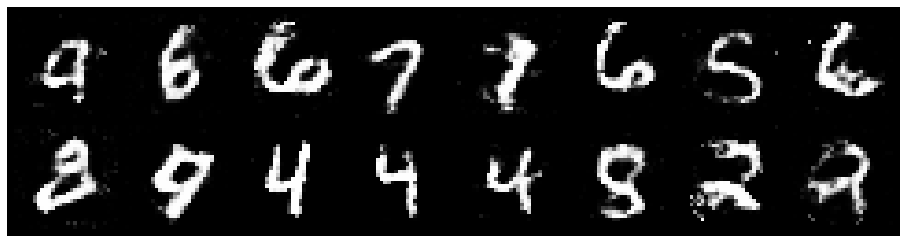

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2861, Generator Loss: 0.8677
D(x): 0.5940, D(G(z)): 0.4597


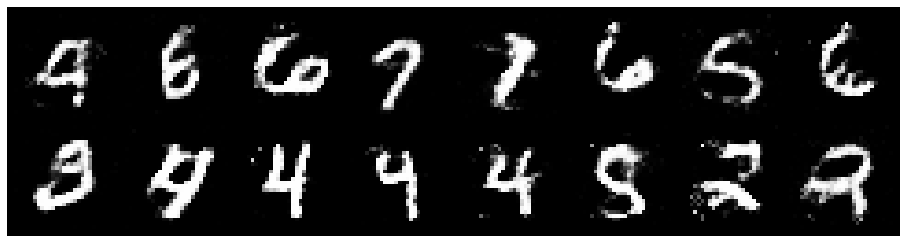

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.3480, Generator Loss: 0.7953
D(x): 0.5565, D(G(z)): 0.4970


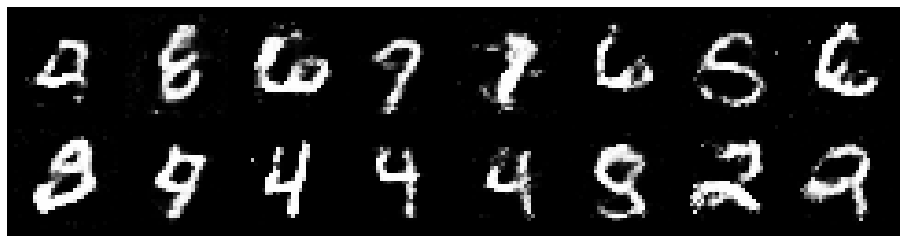

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.3101, Generator Loss: 0.7617
D(x): 0.5415, D(G(z)): 0.4628


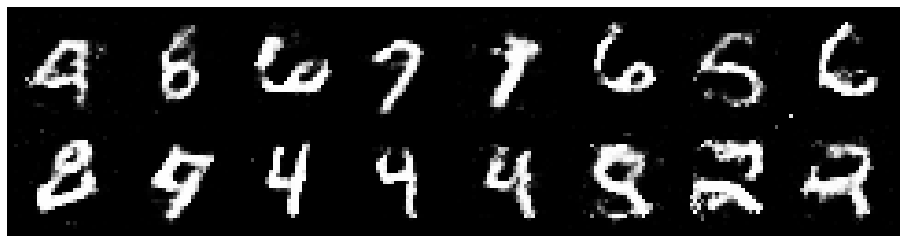

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2741, Generator Loss: 1.0662
D(x): 0.5172, D(G(z)): 0.4043


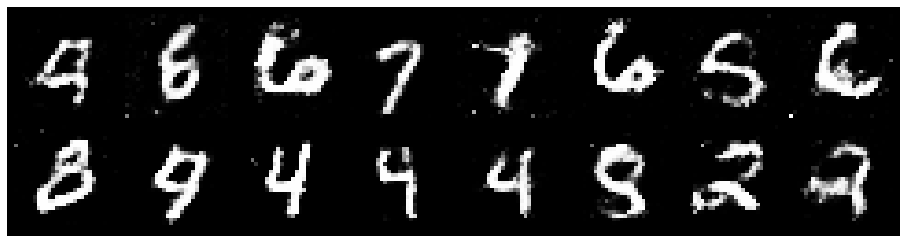

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.3023, Generator Loss: 0.9763
D(x): 0.5207, D(G(z)): 0.4287


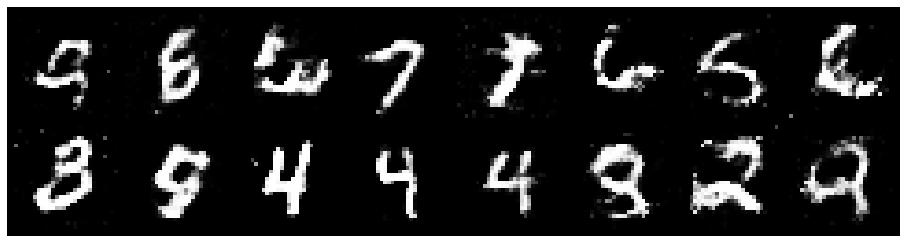

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.1910, Generator Loss: 0.9188
D(x): 0.5602, D(G(z)): 0.4125


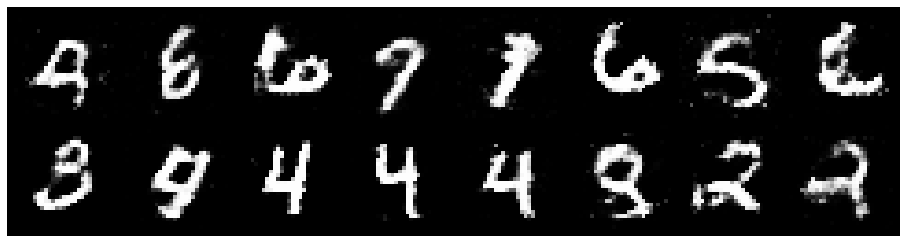

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.2822, Generator Loss: 0.8925
D(x): 0.5243, D(G(z)): 0.4157


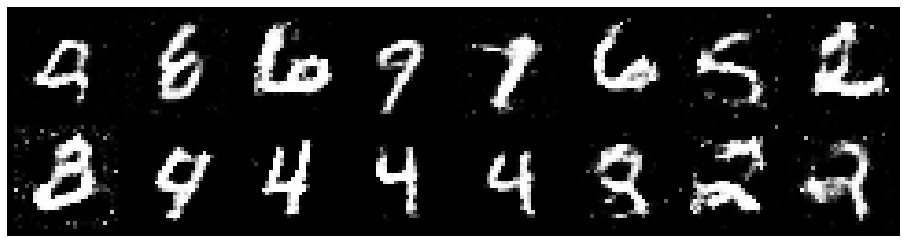

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.1436, Generator Loss: 0.9368
D(x): 0.5908, D(G(z)): 0.4099


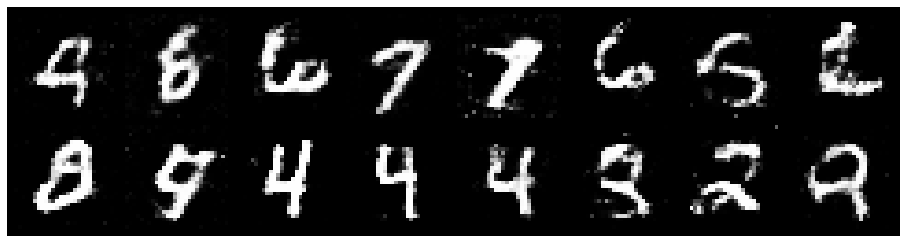

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2033, Generator Loss: 0.8274
D(x): 0.5860, D(G(z)): 0.4485


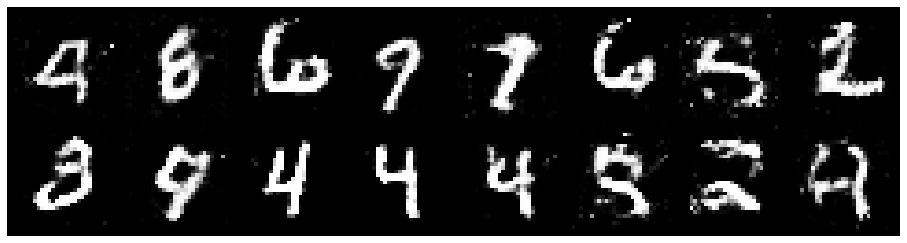

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.1991, Generator Loss: 0.9385
D(x): 0.5838, D(G(z)): 0.4341


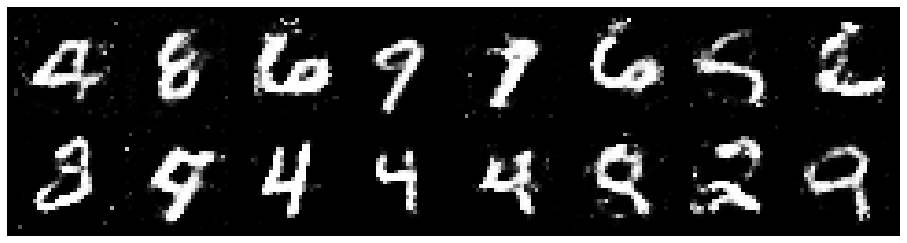

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2254, Generator Loss: 0.8471
D(x): 0.5777, D(G(z)): 0.4505


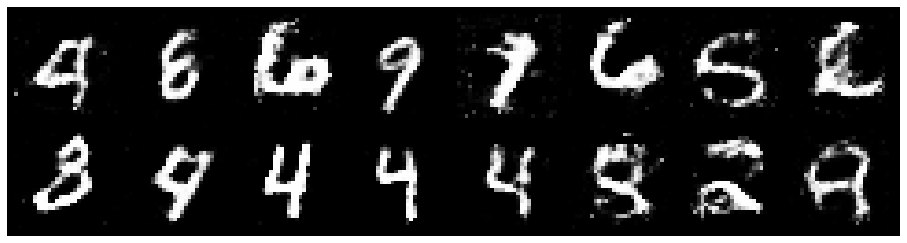

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2759, Generator Loss: 0.9165
D(x): 0.5552, D(G(z)): 0.4502


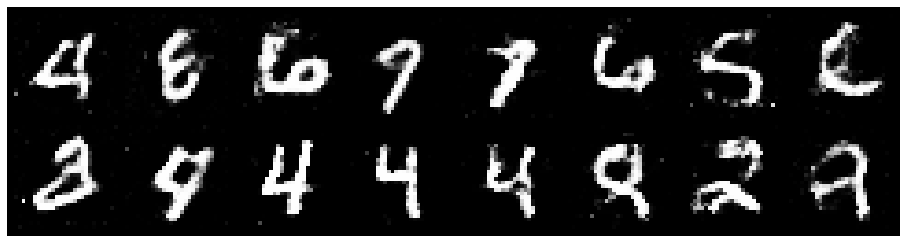

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2119, Generator Loss: 0.8523
D(x): 0.5806, D(G(z)): 0.4448


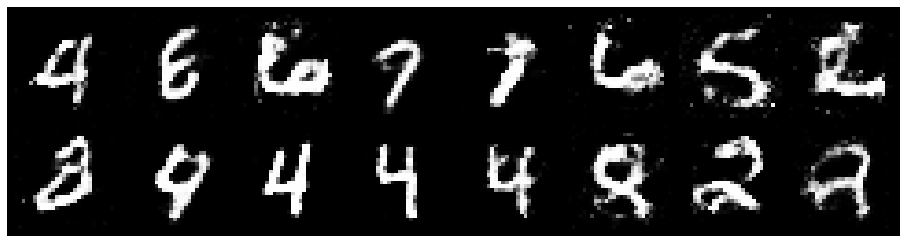

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2477, Generator Loss: 0.9198
D(x): 0.5491, D(G(z)): 0.4342


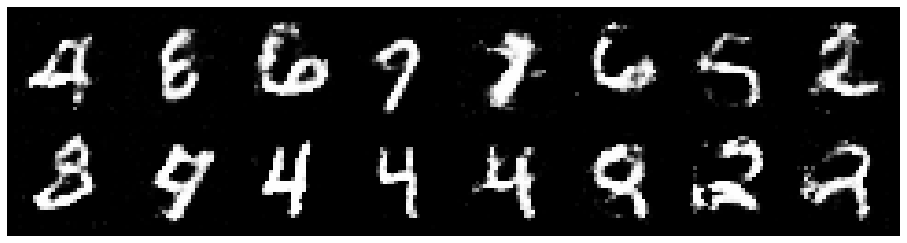

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3259, Generator Loss: 1.0245
D(x): 0.5407, D(G(z)): 0.4356


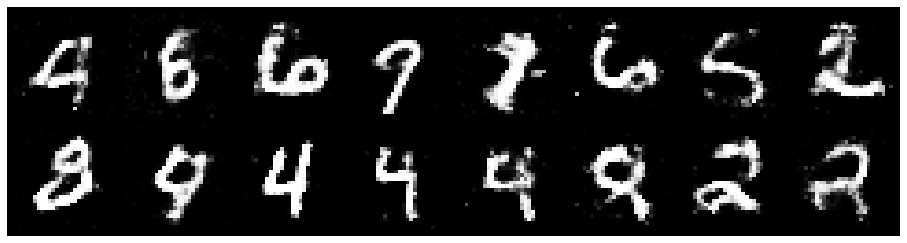

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3437, Generator Loss: 0.9507
D(x): 0.5268, D(G(z)): 0.4477


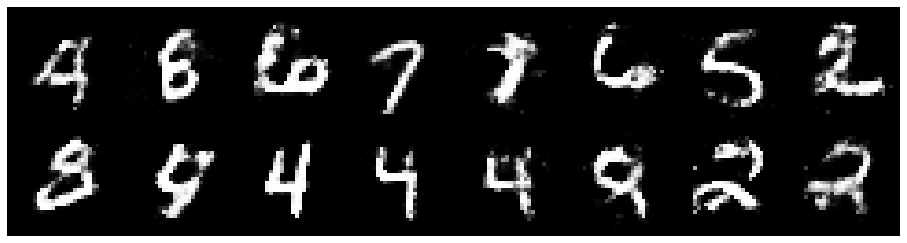

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.4030, Generator Loss: 0.8252
D(x): 0.5034, D(G(z)): 0.4660


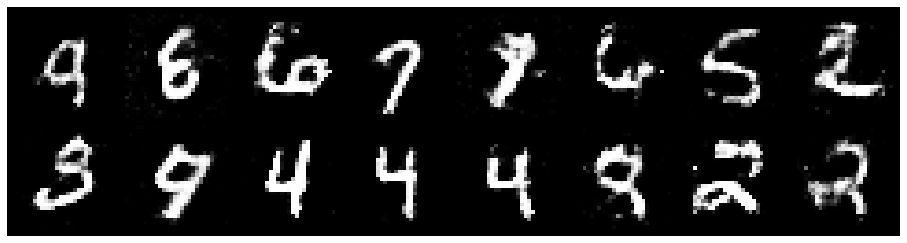

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.3021, Generator Loss: 0.7867
D(x): 0.5323, D(G(z)): 0.4469


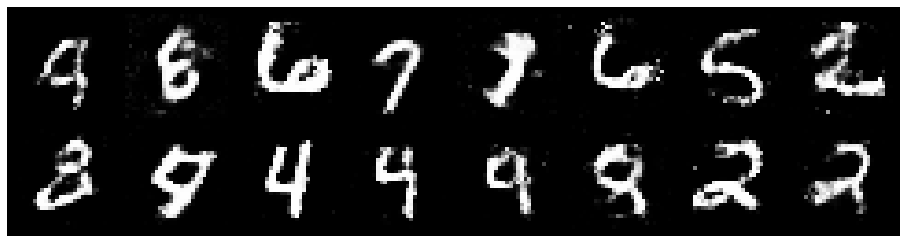

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3917, Generator Loss: 0.8105
D(x): 0.5167, D(G(z)): 0.4747


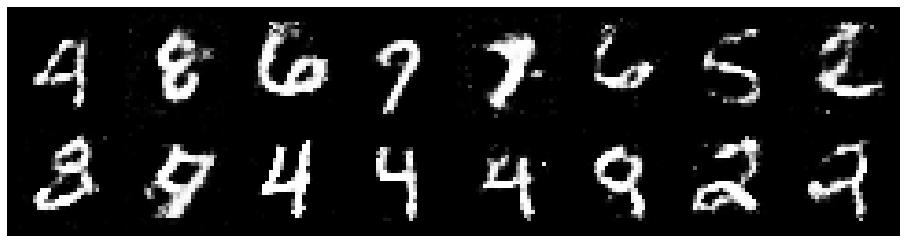

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.2981, Generator Loss: 0.7819
D(x): 0.5464, D(G(z)): 0.4629


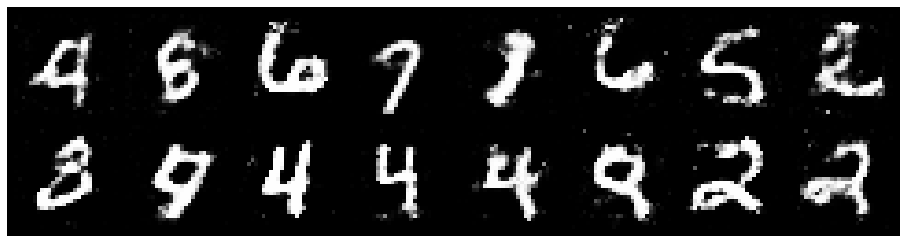

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.3339, Generator Loss: 0.8193
D(x): 0.5657, D(G(z)): 0.4730


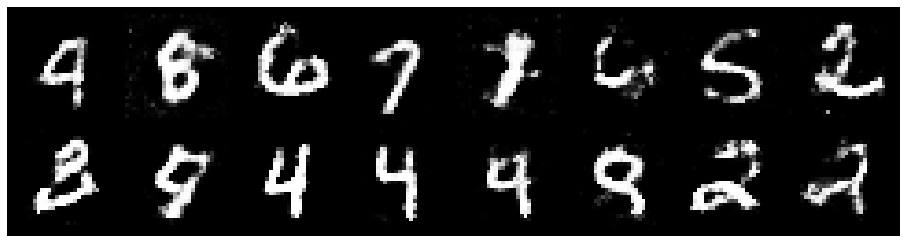

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3478, Generator Loss: 0.8120
D(x): 0.5122, D(G(z)): 0.4509


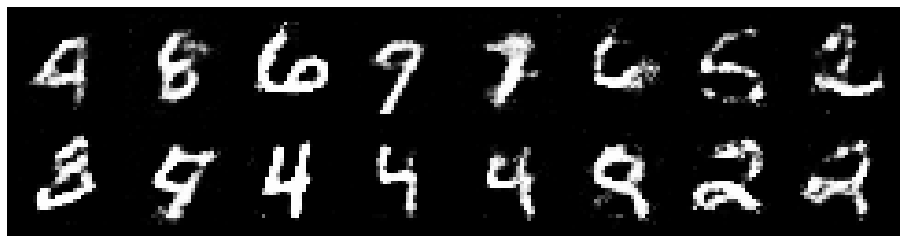

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.3100, Generator Loss: 0.8891
D(x): 0.5299, D(G(z)): 0.4483


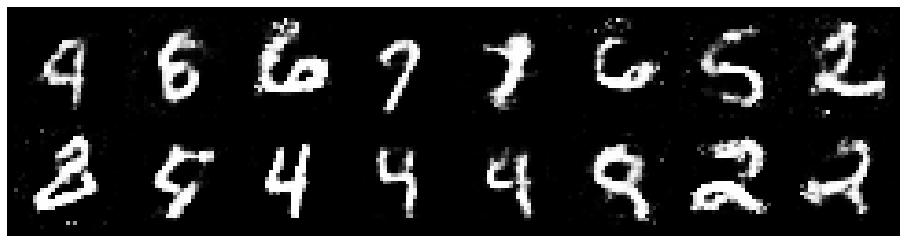

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2385, Generator Loss: 0.8966
D(x): 0.5812, D(G(z)): 0.4356


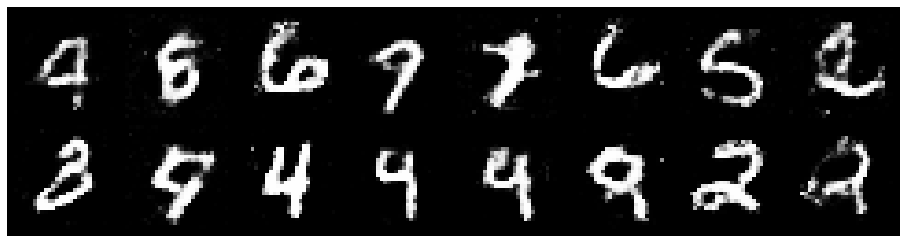

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2623, Generator Loss: 0.9848
D(x): 0.5865, D(G(z)): 0.4626


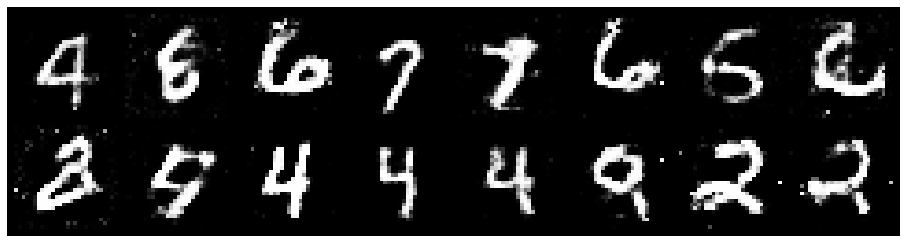

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2476, Generator Loss: 0.8193
D(x): 0.5707, D(G(z)): 0.4525


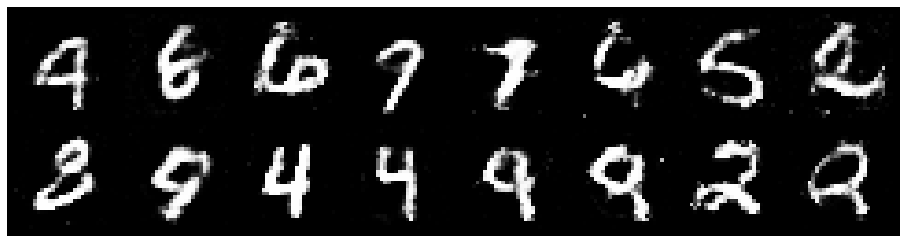

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8647
D(x): 0.5661, D(G(z)): 0.4417


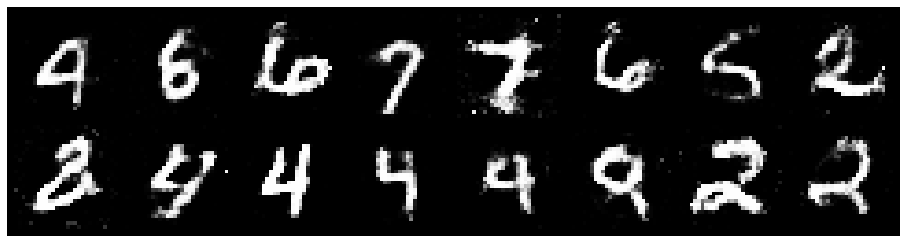

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.2966, Generator Loss: 0.8598
D(x): 0.5735, D(G(z)): 0.4702


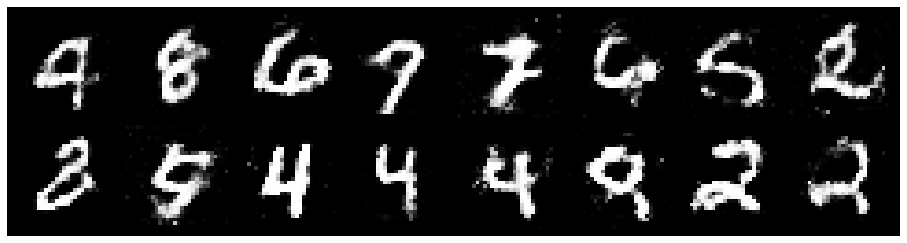

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.3078, Generator Loss: 0.7927
D(x): 0.5172, D(G(z)): 0.4541


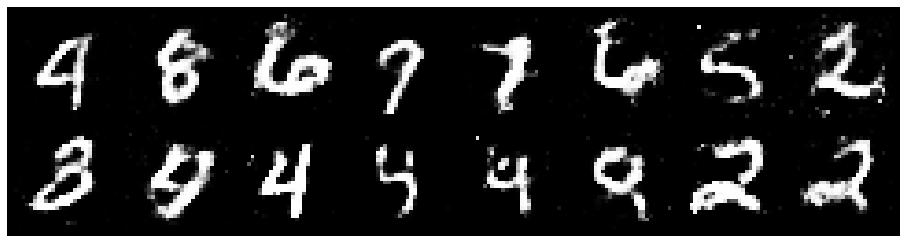

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2161, Generator Loss: 0.8178
D(x): 0.5875, D(G(z)): 0.4482


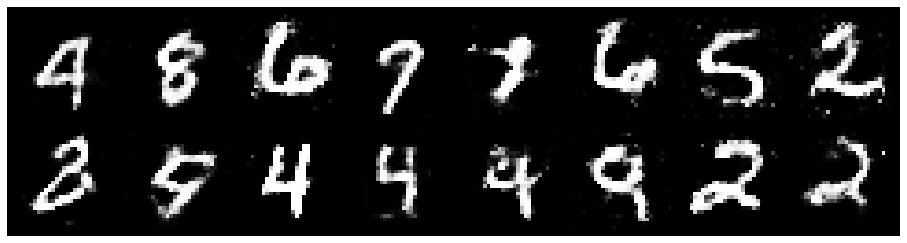

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2829, Generator Loss: 0.8168
D(x): 0.5386, D(G(z)): 0.4540


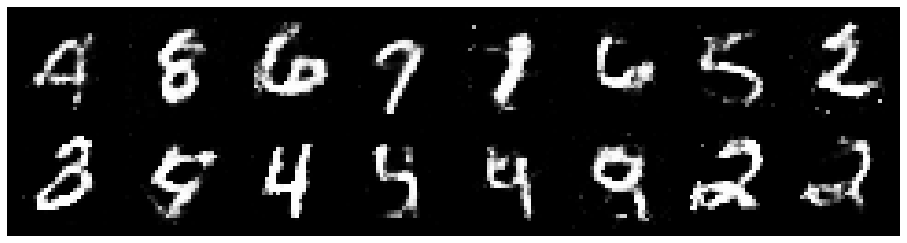

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.1874, Generator Loss: 1.0288
D(x): 0.5663, D(G(z)): 0.4028


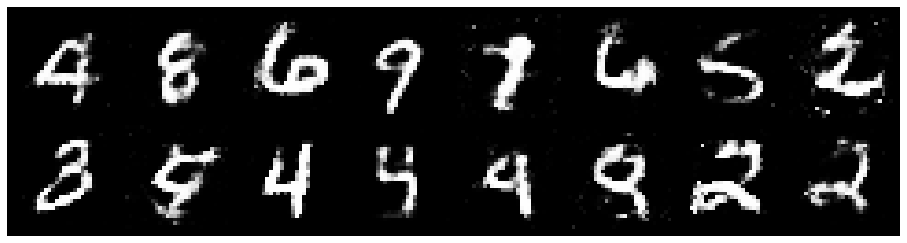

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.1874, Generator Loss: 0.9827
D(x): 0.5764, D(G(z)): 0.4221


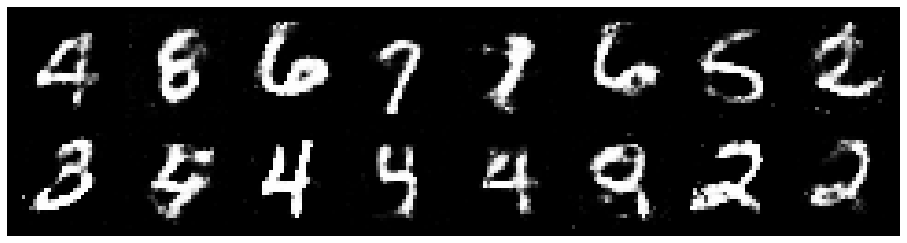

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2503, Generator Loss: 1.1130
D(x): 0.5569, D(G(z)): 0.4014


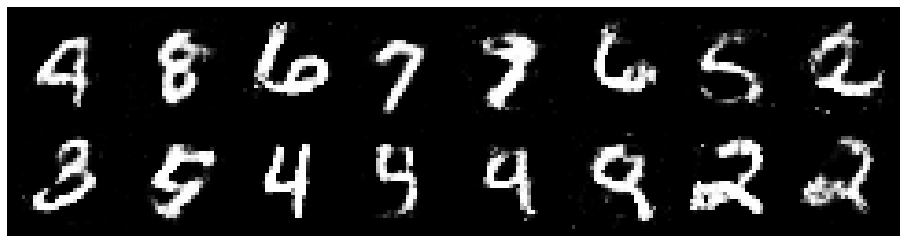

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.3819, Generator Loss: 0.8817
D(x): 0.5362, D(G(z)): 0.4728


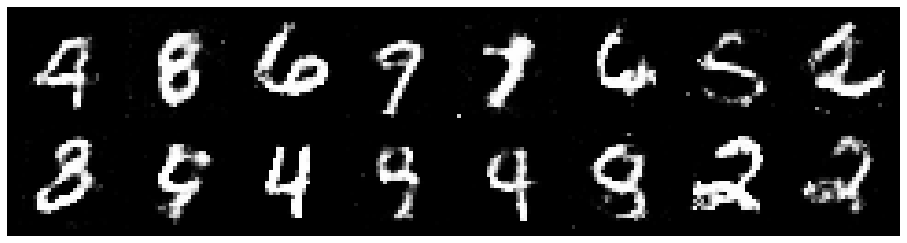

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3208, Generator Loss: 0.8930
D(x): 0.6015, D(G(z)): 0.5069


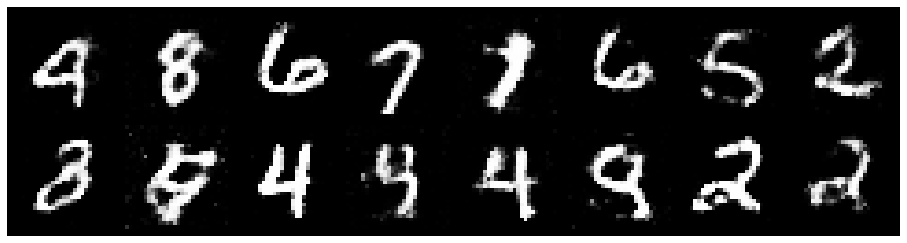

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.3092, Generator Loss: 0.8131
D(x): 0.5162, D(G(z)): 0.4436


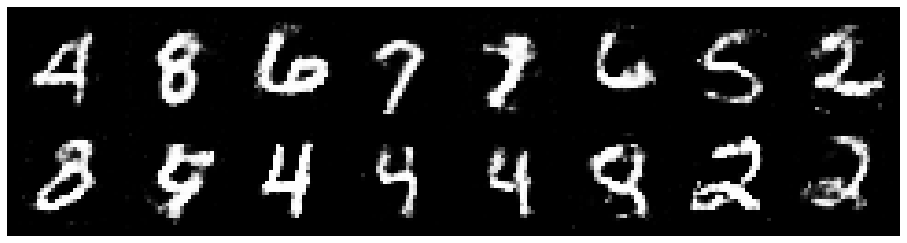

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3058, Generator Loss: 0.8508
D(x): 0.5358, D(G(z)): 0.4615


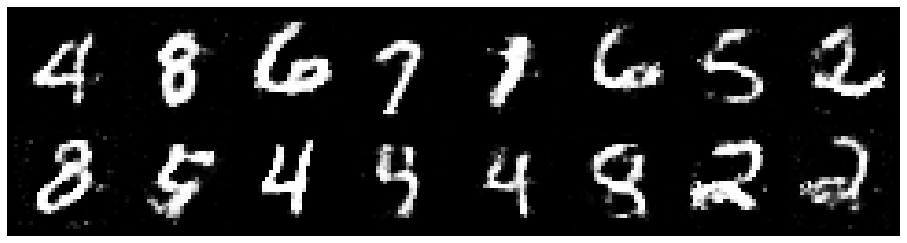

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2716, Generator Loss: 0.8604
D(x): 0.5512, D(G(z)): 0.4553


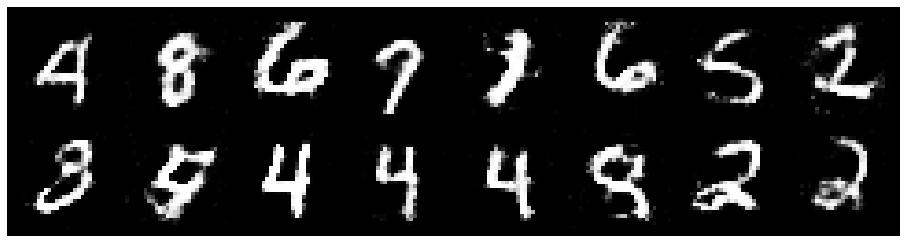

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2337, Generator Loss: 0.8170
D(x): 0.5805, D(G(z)): 0.4685


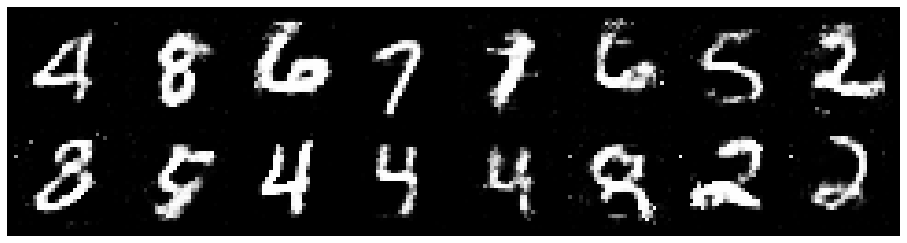

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.2040, Generator Loss: 0.9416
D(x): 0.5570, D(G(z)): 0.4072


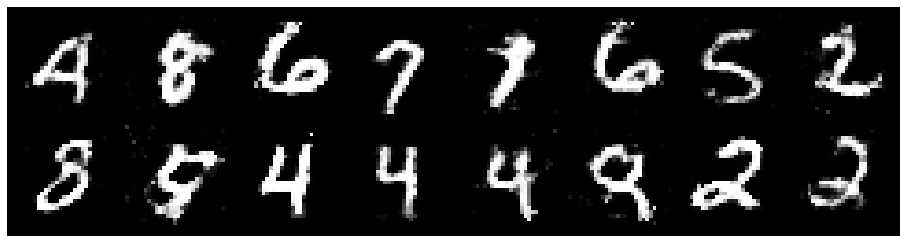

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2904, Generator Loss: 0.8674
D(x): 0.5578, D(G(z)): 0.4489


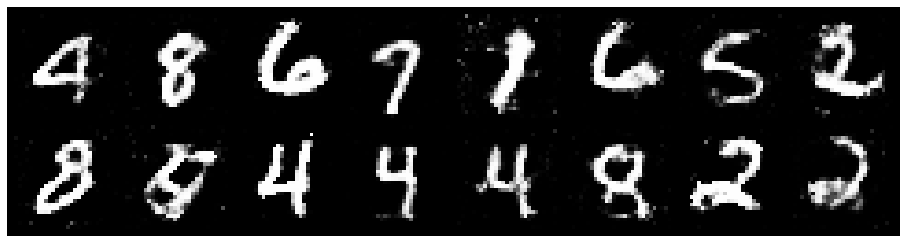

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2597, Generator Loss: 0.8015
D(x): 0.5452, D(G(z)): 0.4364


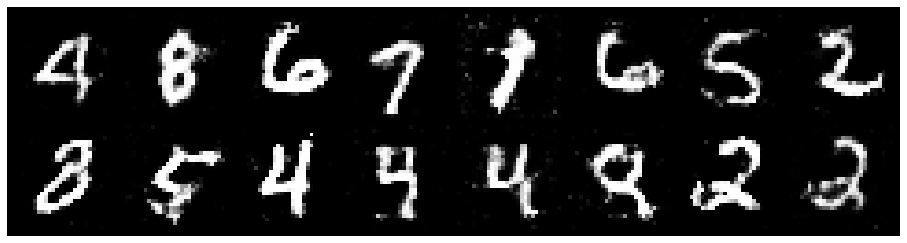

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2866, Generator Loss: 0.8173
D(x): 0.5601, D(G(z)): 0.4583


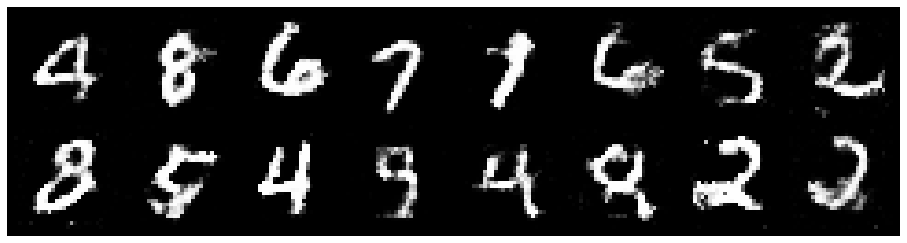

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.2652, Generator Loss: 0.8626
D(x): 0.5574, D(G(z)): 0.4485


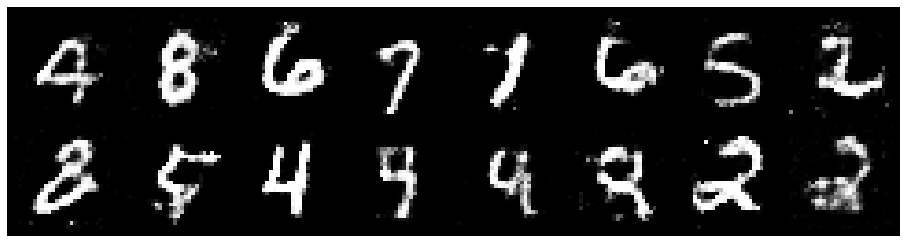

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.2203, Generator Loss: 0.8293
D(x): 0.5525, D(G(z)): 0.4296


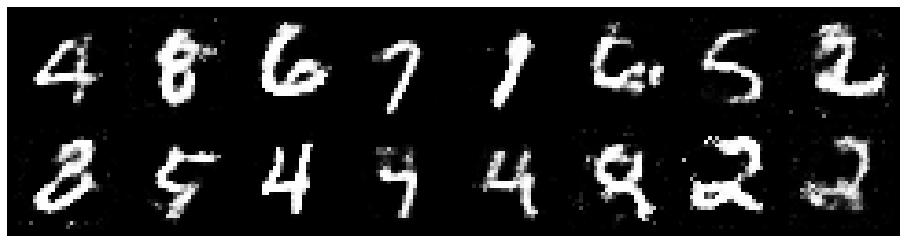

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2535, Generator Loss: 0.9627
D(x): 0.5849, D(G(z)): 0.4570


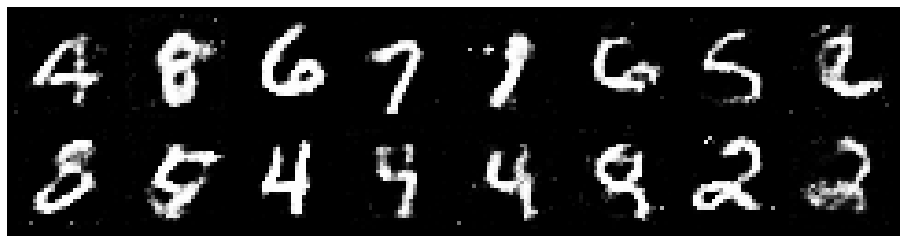

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2630, Generator Loss: 0.9617
D(x): 0.5696, D(G(z)): 0.4420


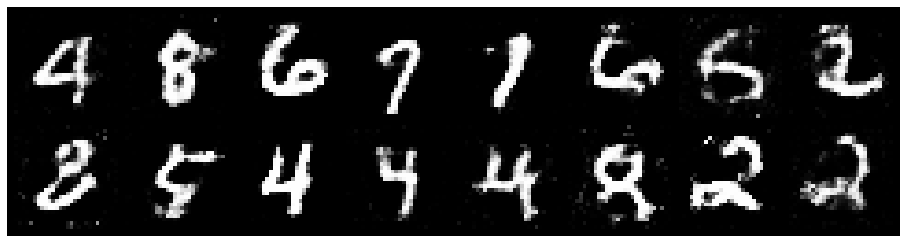

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.2499, Generator Loss: 1.0095
D(x): 0.5446, D(G(z)): 0.4242


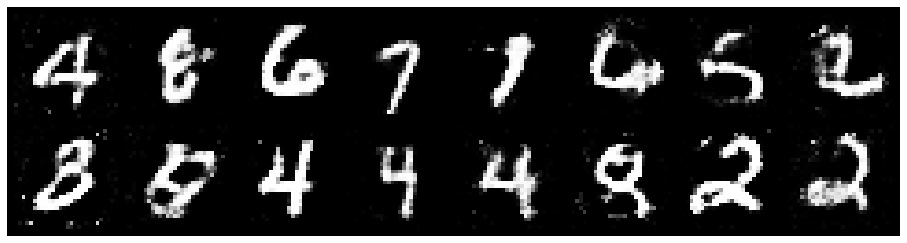

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2451, Generator Loss: 0.8625
D(x): 0.5568, D(G(z)): 0.4391


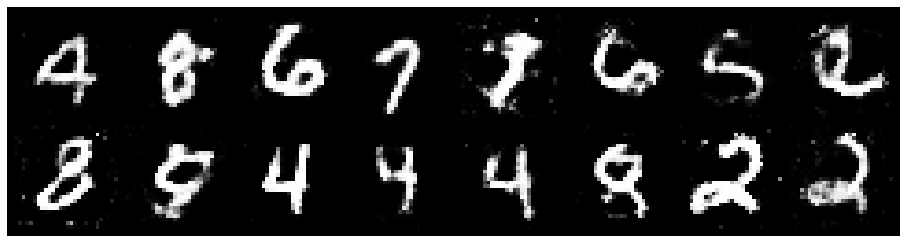

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2113, Generator Loss: 0.9256
D(x): 0.5442, D(G(z)): 0.4197


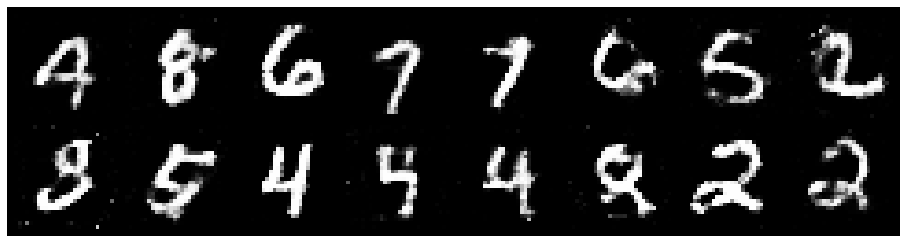

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.1946, Generator Loss: 0.9236
D(x): 0.5768, D(G(z)): 0.4402


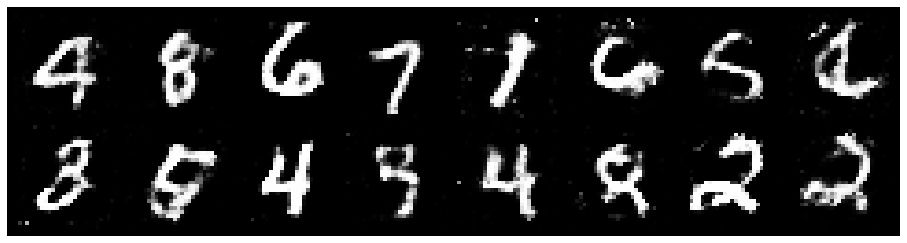

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2055, Generator Loss: 1.0458
D(x): 0.5398, D(G(z)): 0.3977


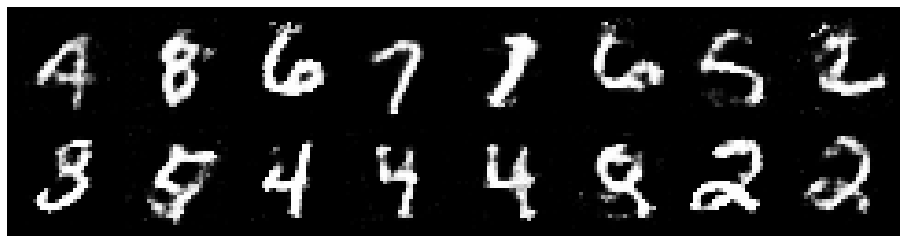

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.1764, Generator Loss: 0.9830
D(x): 0.6207, D(G(z)): 0.4393


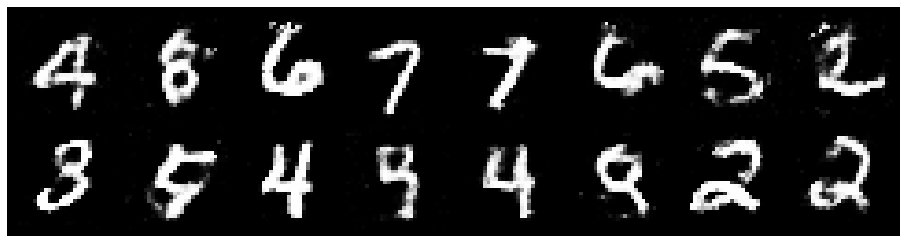

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2656, Generator Loss: 0.9393
D(x): 0.5513, D(G(z)): 0.4408


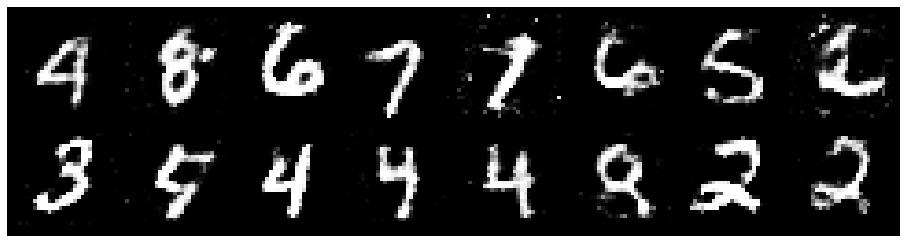

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.1763, Generator Loss: 0.8554
D(x): 0.6078, D(G(z)): 0.4444


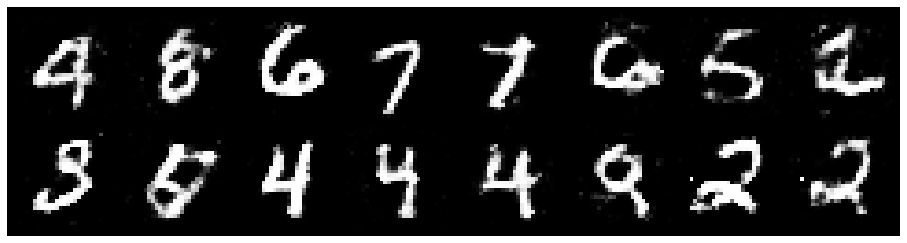

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.2823, Generator Loss: 0.9660
D(x): 0.5744, D(G(z)): 0.4476


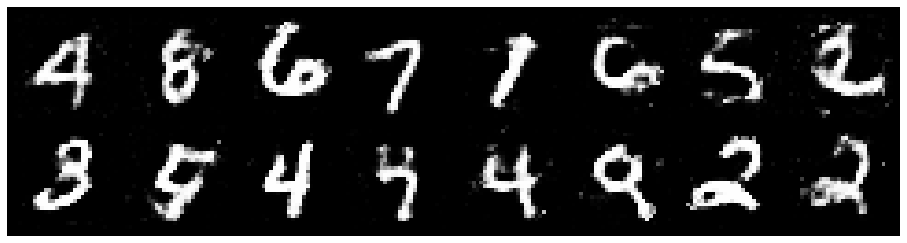

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.2794, Generator Loss: 0.8797
D(x): 0.5785, D(G(z)): 0.4678


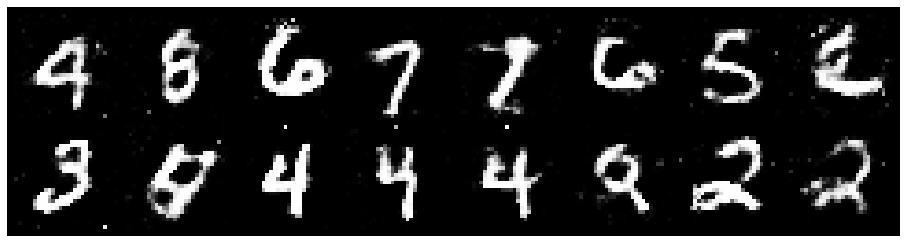

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3176, Generator Loss: 0.7779
D(x): 0.5386, D(G(z)): 0.4653


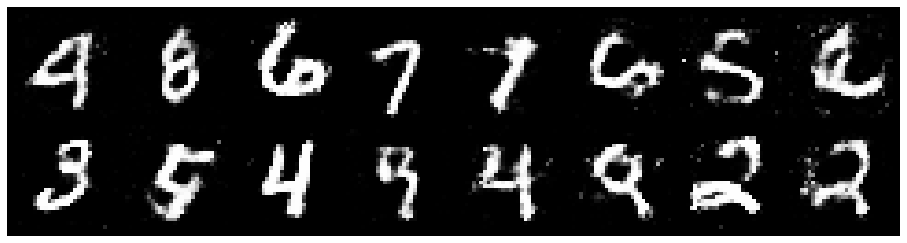

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.2615, Generator Loss: 0.8585
D(x): 0.5572, D(G(z)): 0.4576


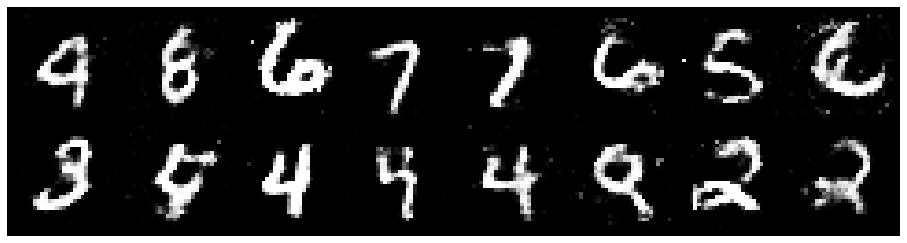

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8479
D(x): 0.5633, D(G(z)): 0.4436


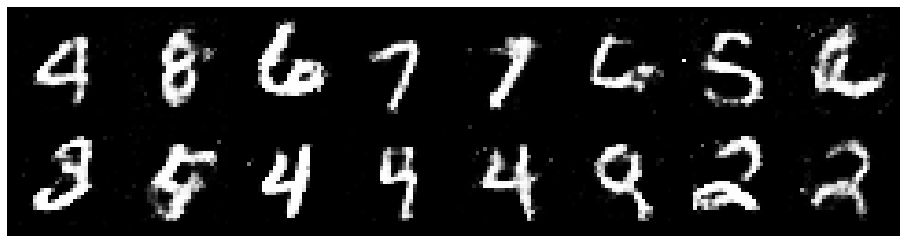

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.3992, Generator Loss: 0.8686
D(x): 0.5056, D(G(z)): 0.4590


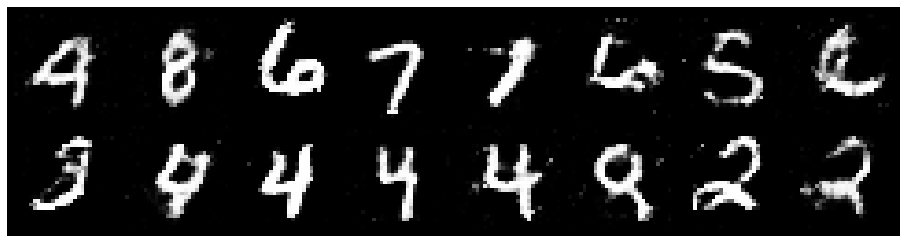

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.4699, Generator Loss: 0.7880
D(x): 0.5370, D(G(z)): 0.5178


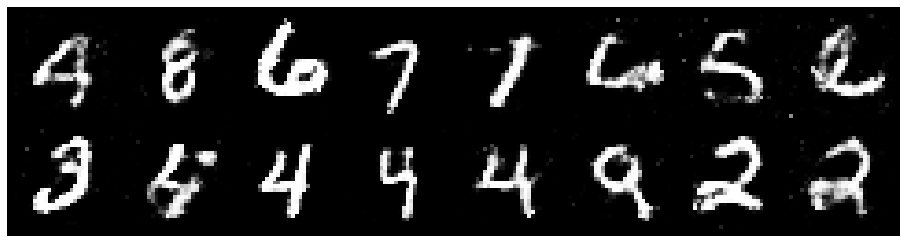

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2536, Generator Loss: 0.7951
D(x): 0.5550, D(G(z)): 0.4484


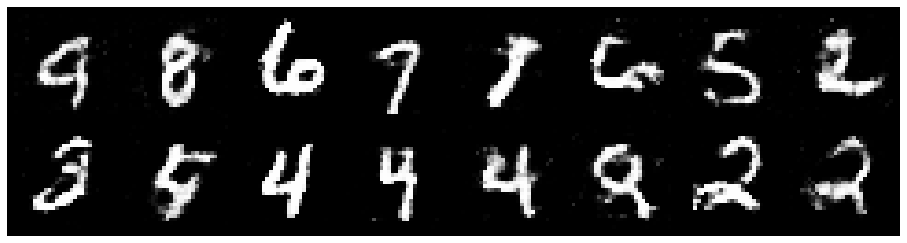

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2024, Generator Loss: 0.8139
D(x): 0.5578, D(G(z)): 0.4332


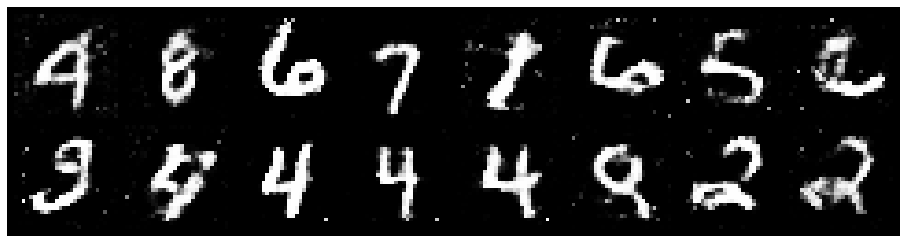

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2517, Generator Loss: 0.8356
D(x): 0.5569, D(G(z)): 0.4559


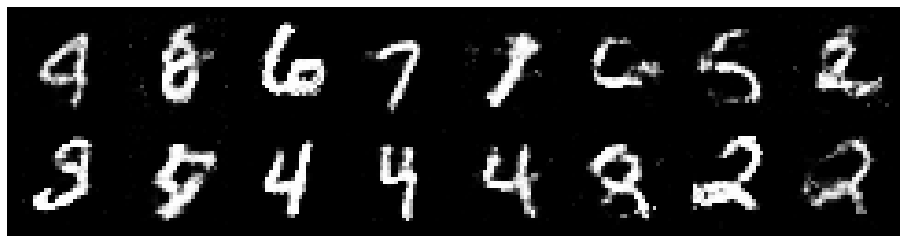

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.2223, Generator Loss: 0.8725
D(x): 0.5660, D(G(z)): 0.4436


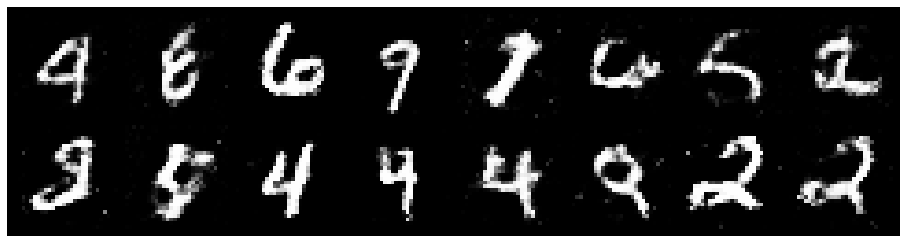

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2416, Generator Loss: 0.8293
D(x): 0.5621, D(G(z)): 0.4558


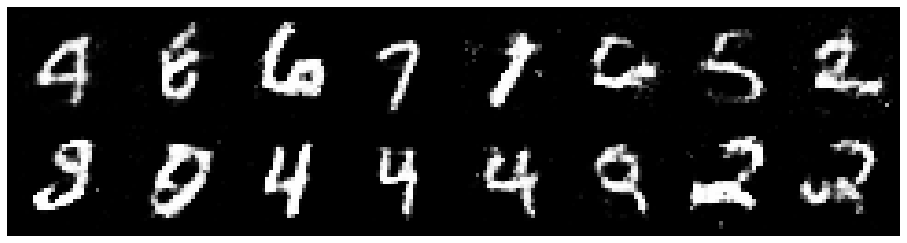

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2404, Generator Loss: 0.9216
D(x): 0.5753, D(G(z)): 0.4559


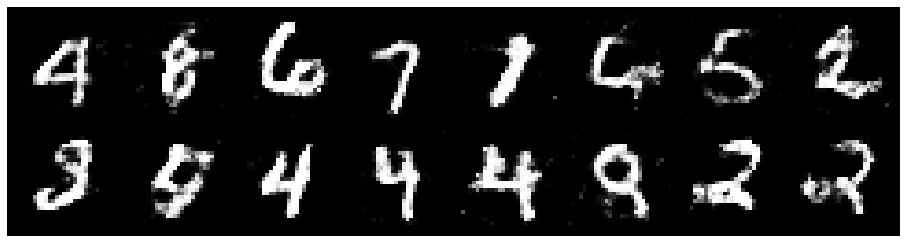

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8736
D(x): 0.5557, D(G(z)): 0.4602


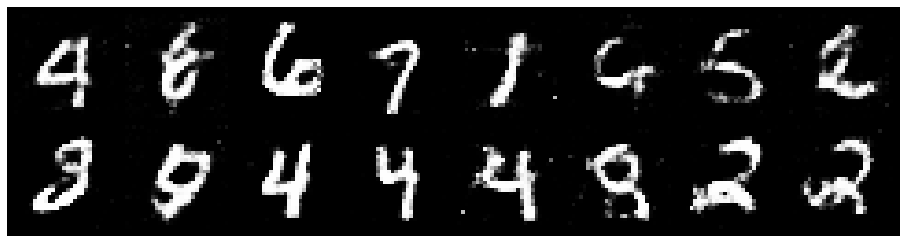

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2008, Generator Loss: 0.8809
D(x): 0.5655, D(G(z)): 0.4388


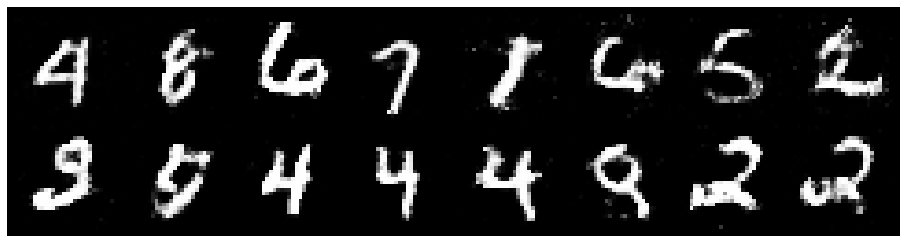

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2457, Generator Loss: 0.8762
D(x): 0.5627, D(G(z)): 0.4497


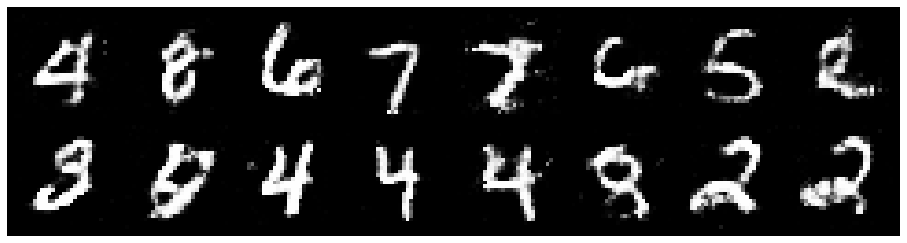

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3065, Generator Loss: 0.8432
D(x): 0.5505, D(G(z)): 0.4778


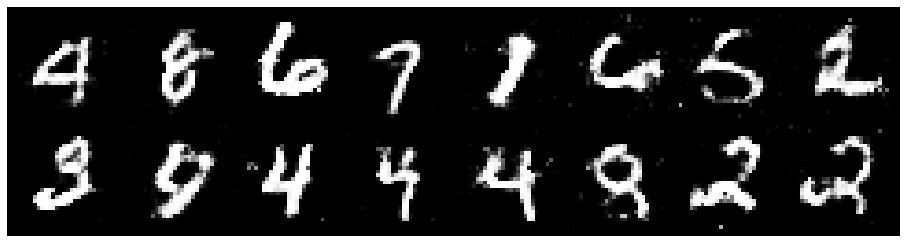

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.3226, Generator Loss: 0.7917
D(x): 0.5513, D(G(z)): 0.4858


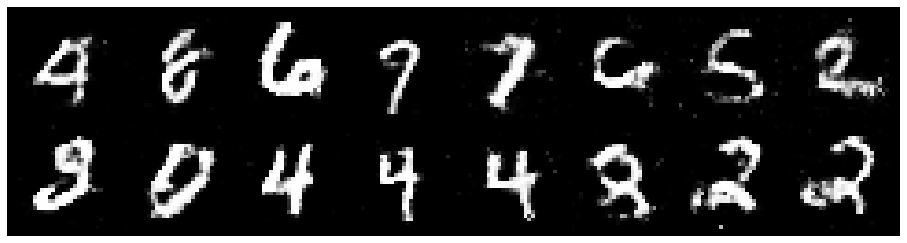

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2092, Generator Loss: 0.9168
D(x): 0.5448, D(G(z)): 0.4057


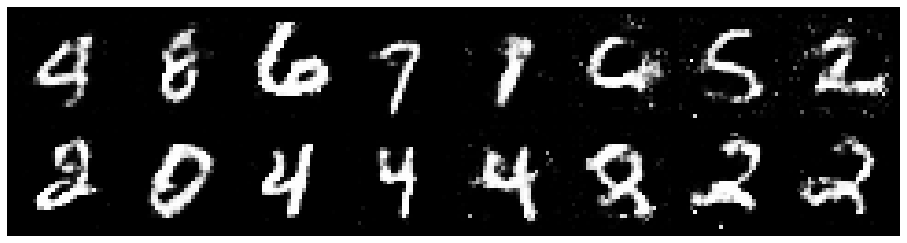

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.2830, Generator Loss: 1.0425
D(x): 0.5429, D(G(z)): 0.4493


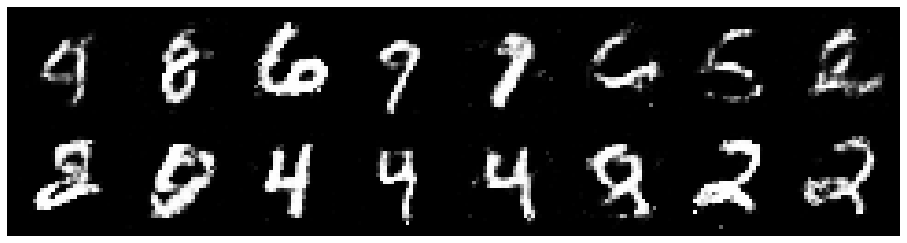

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2805, Generator Loss: 0.7956
D(x): 0.5644, D(G(z)): 0.4589


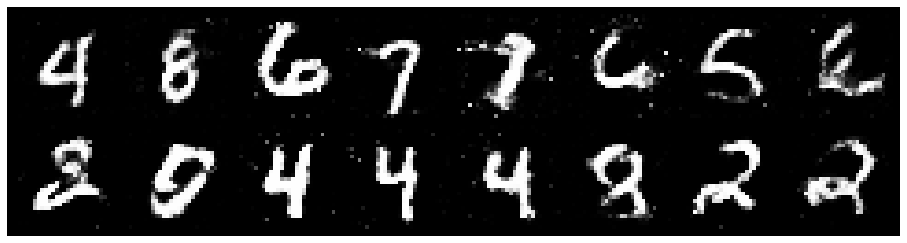

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2750, Generator Loss: 0.9640
D(x): 0.5510, D(G(z)): 0.4386


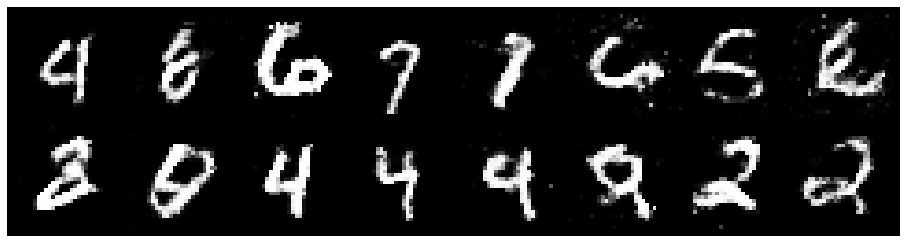

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2216, Generator Loss: 0.9203
D(x): 0.5630, D(G(z)): 0.4354


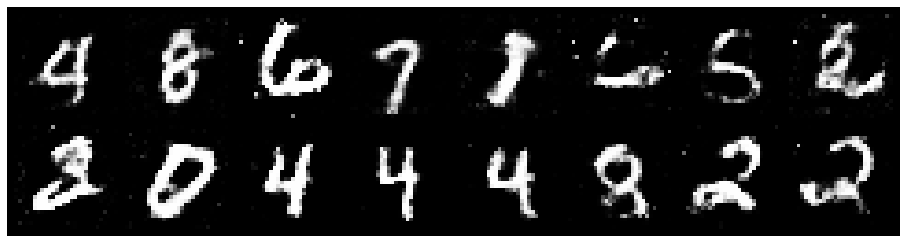

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.2971, Generator Loss: 1.0183
D(x): 0.5460, D(G(z)): 0.4369


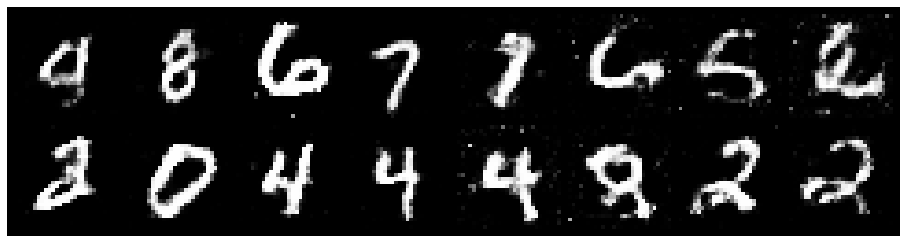

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2277, Generator Loss: 0.8492
D(x): 0.5804, D(G(z)): 0.4558


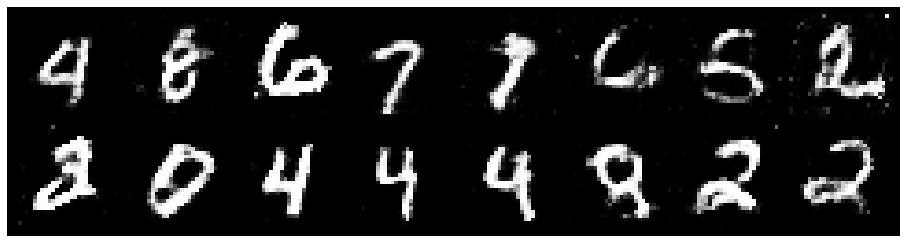

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.1968, Generator Loss: 1.0363
D(x): 0.5519, D(G(z)): 0.3928


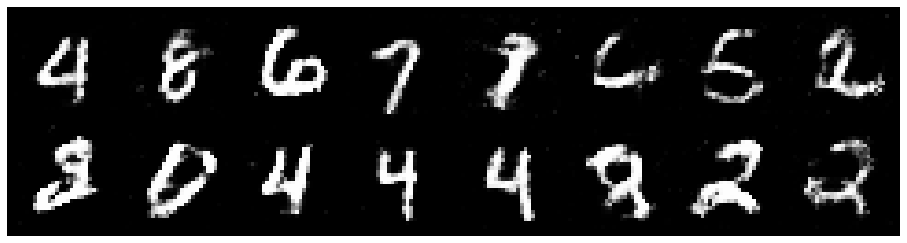

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.3077, Generator Loss: 0.8360
D(x): 0.5793, D(G(z)): 0.4862


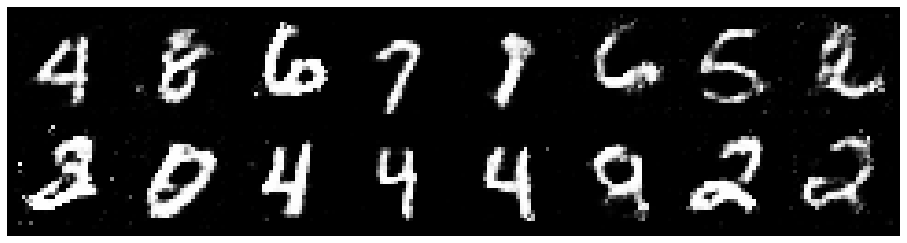

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3022, Generator Loss: 0.8569
D(x): 0.5402, D(G(z)): 0.4614


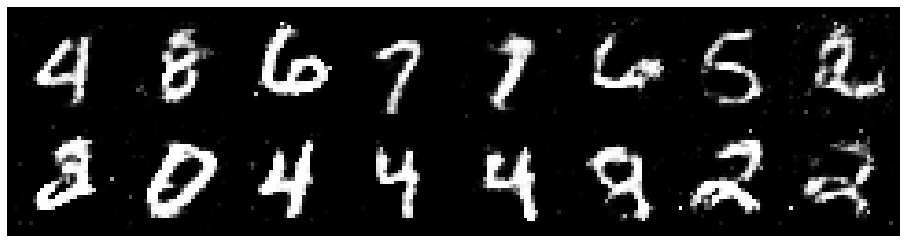

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3115, Generator Loss: 0.7703
D(x): 0.5656, D(G(z)): 0.4854


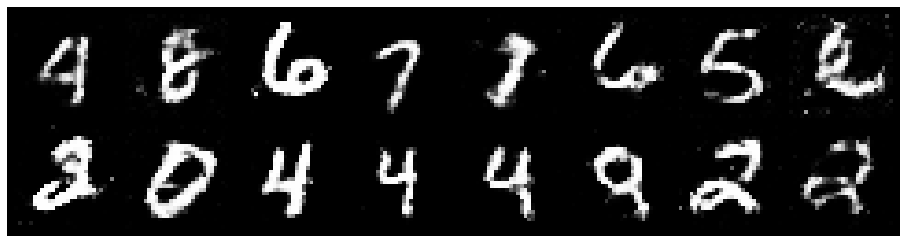

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.2811, Generator Loss: 0.8038
D(x): 0.5717, D(G(z)): 0.4830


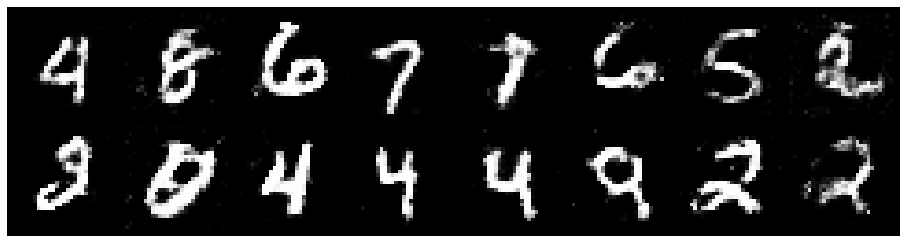

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3948, Generator Loss: 0.8758
D(x): 0.4859, D(G(z)): 0.4631


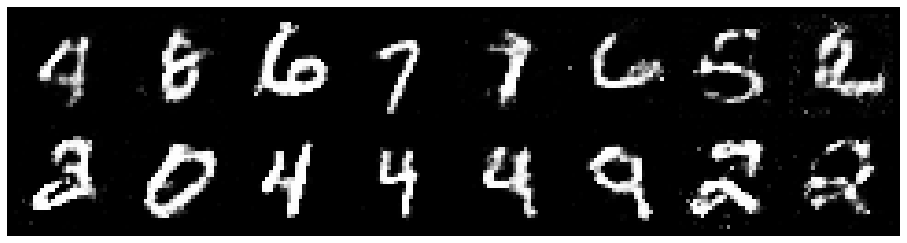

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.3085, Generator Loss: 0.9526
D(x): 0.5530, D(G(z)): 0.4659


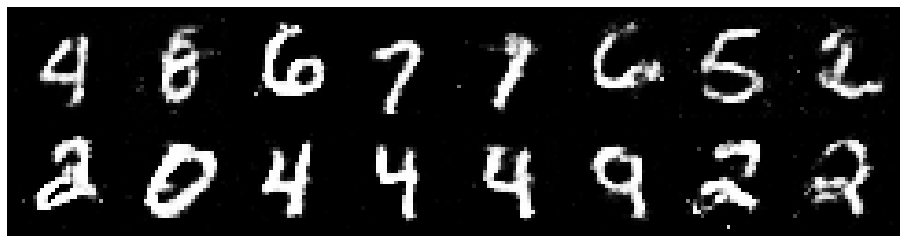

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.3115, Generator Loss: 0.8687
D(x): 0.5430, D(G(z)): 0.4408


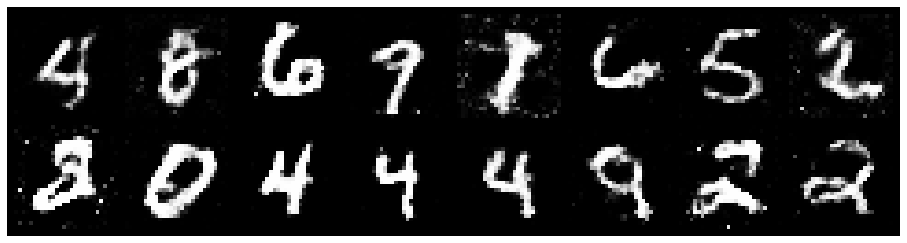

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8991
D(x): 0.5248, D(G(z)): 0.4440


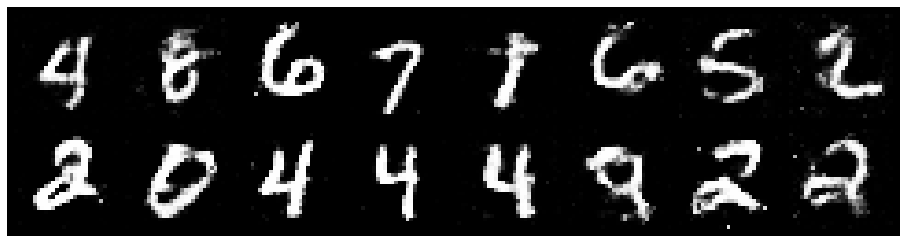

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2831, Generator Loss: 0.8684
D(x): 0.5490, D(G(z)): 0.4471


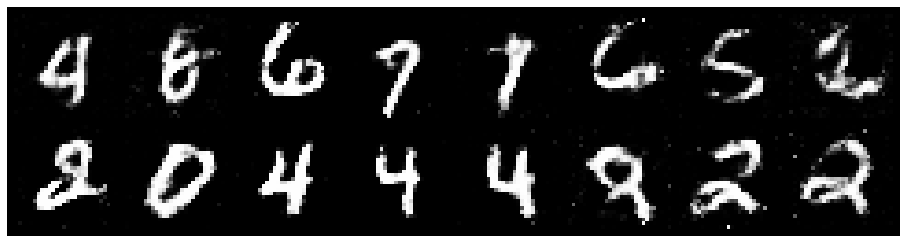

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.1997, Generator Loss: 0.8900
D(x): 0.6161, D(G(z)): 0.4570


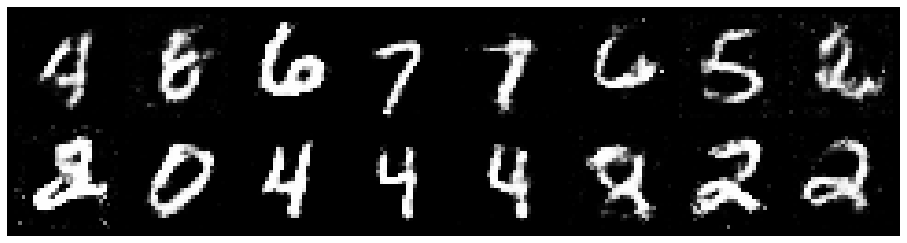

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.3046, Generator Loss: 0.9251
D(x): 0.5506, D(G(z)): 0.4645


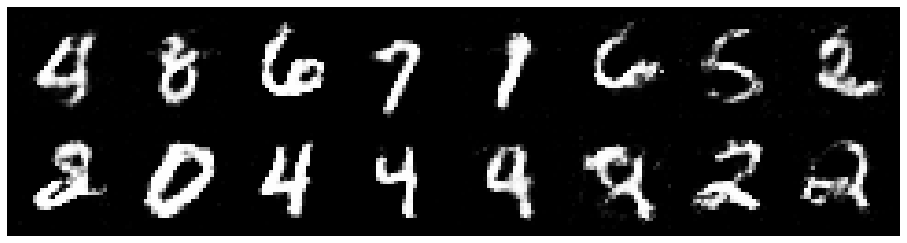

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3927, Generator Loss: 0.8696
D(x): 0.5298, D(G(z)): 0.4732


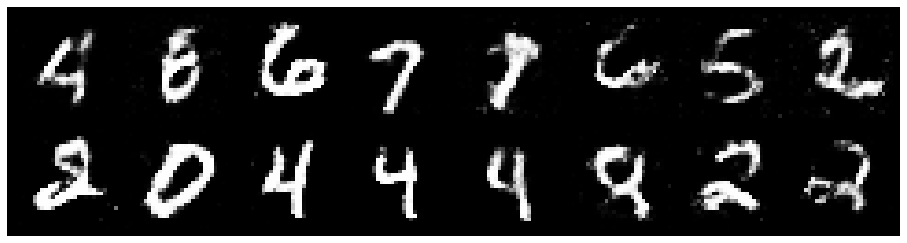

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.3649, Generator Loss: 0.8308
D(x): 0.5141, D(G(z)): 0.4600


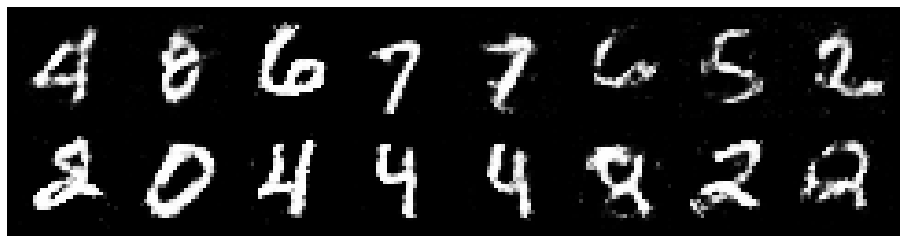

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.4346, Generator Loss: 0.7885
D(x): 0.5242, D(G(z)): 0.4956


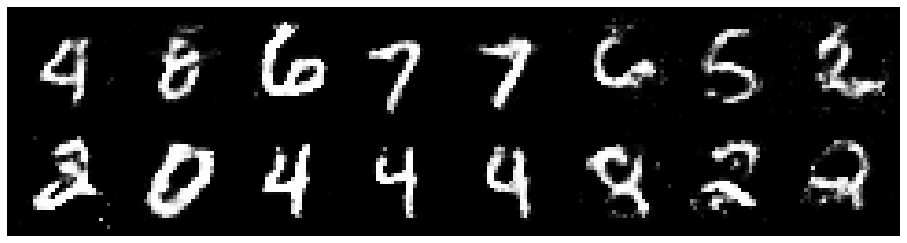

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.3667, Generator Loss: 0.7543
D(x): 0.5060, D(G(z)): 0.4649


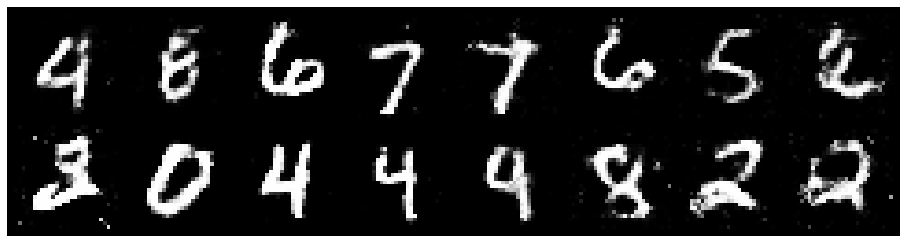

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.3867, Generator Loss: 0.8651
D(x): 0.5203, D(G(z)): 0.4632


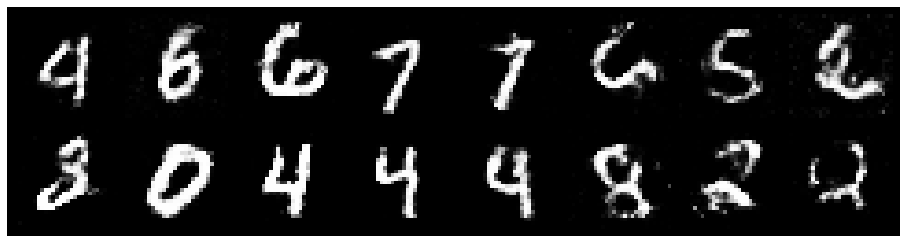

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.3592, Generator Loss: 0.9139
D(x): 0.5256, D(G(z)): 0.4691


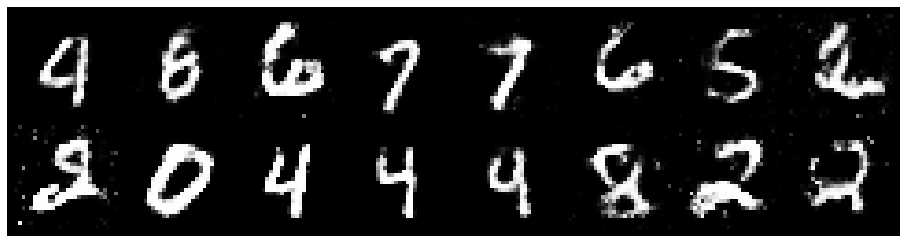

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.3410, Generator Loss: 0.8582
D(x): 0.5227, D(G(z)): 0.4527


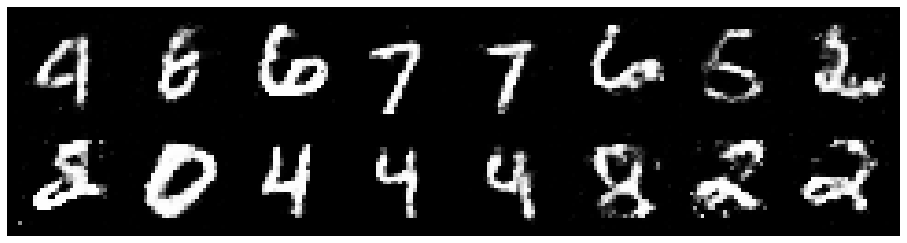

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.1701, Generator Loss: 0.9409
D(x): 0.5761, D(G(z)): 0.4190


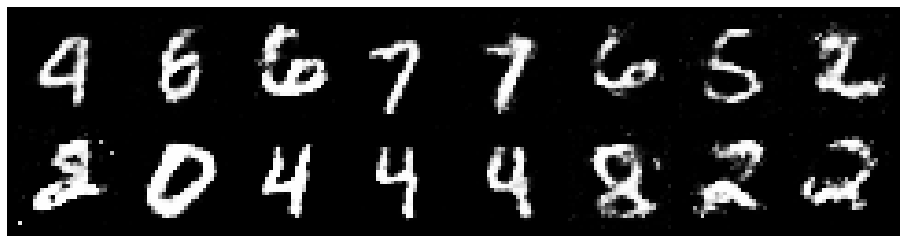

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.3286, Generator Loss: 0.8301
D(x): 0.5456, D(G(z)): 0.4707


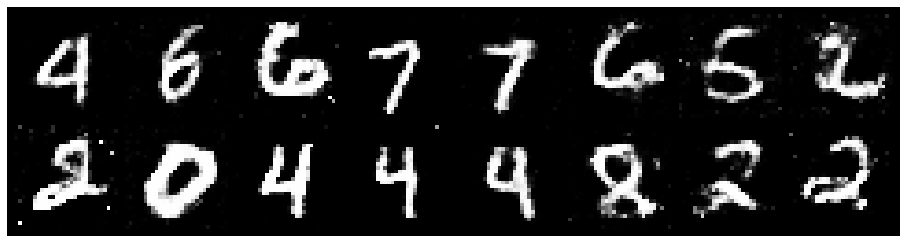

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2481, Generator Loss: 0.8720
D(x): 0.5948, D(G(z)): 0.4524


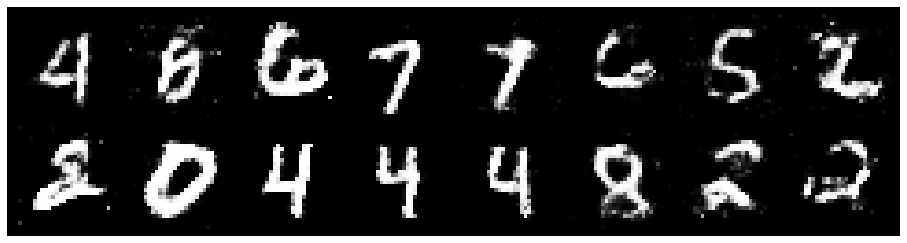

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.3529, Generator Loss: 0.8708
D(x): 0.5515, D(G(z)): 0.4709


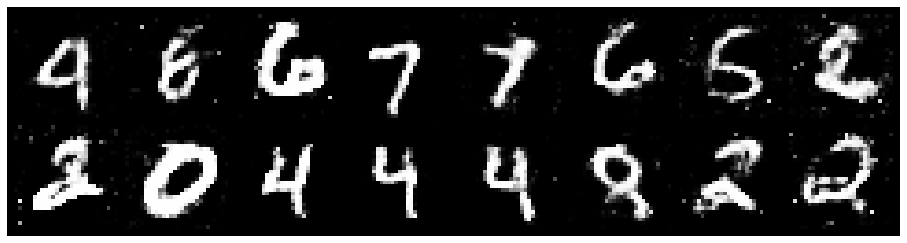

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3382, Generator Loss: 0.8147
D(x): 0.5323, D(G(z)): 0.4586


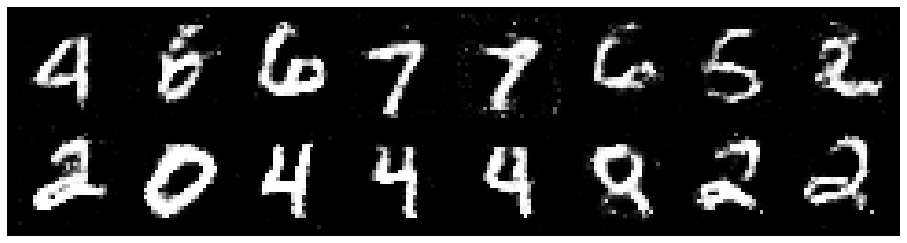

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2984, Generator Loss: 0.7517
D(x): 0.5468, D(G(z)): 0.4590


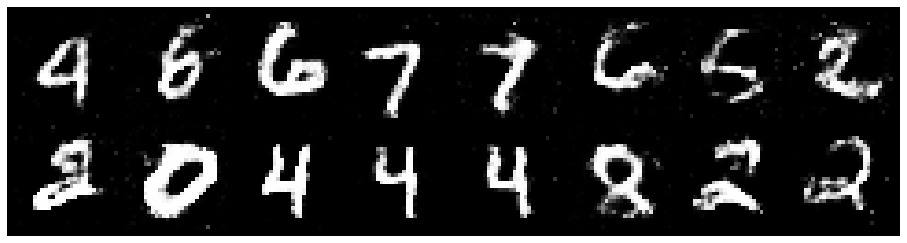

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.2730, Generator Loss: 0.8676
D(x): 0.5508, D(G(z)): 0.4327


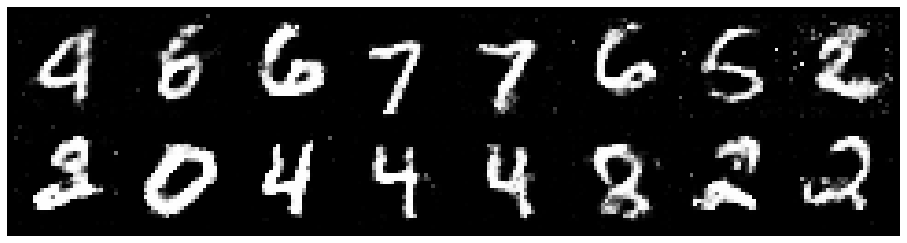

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3708, Generator Loss: 0.8596
D(x): 0.5147, D(G(z)): 0.4551


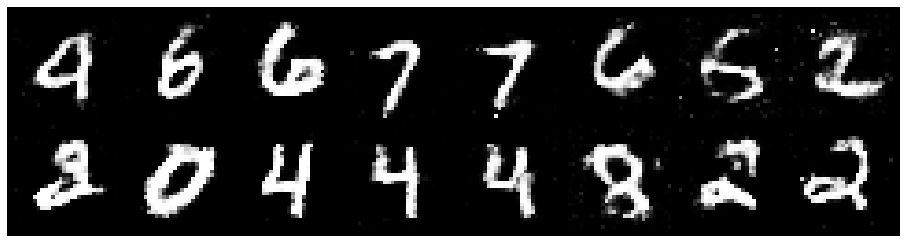

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.3735, Generator Loss: 0.8836
D(x): 0.5187, D(G(z)): 0.4537


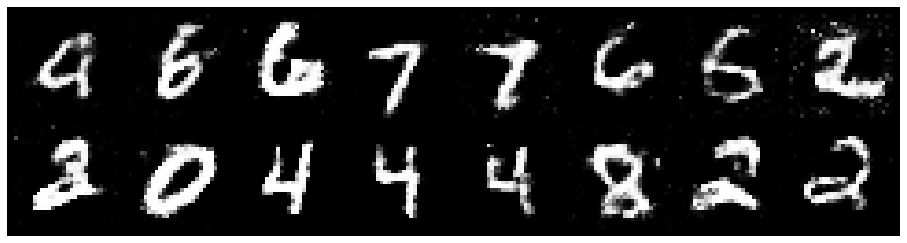

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.3422, Generator Loss: 0.7635
D(x): 0.5606, D(G(z)): 0.4831


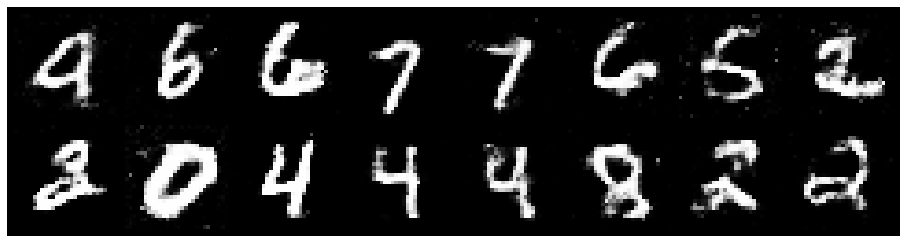

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.3387, Generator Loss: 0.8199
D(x): 0.5294, D(G(z)): 0.4736


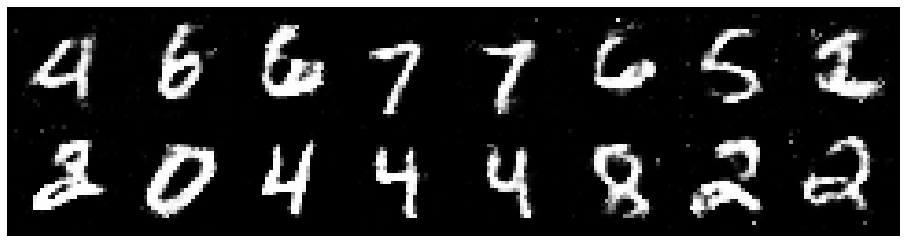

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.3113, Generator Loss: 0.8470
D(x): 0.5363, D(G(z)): 0.4615


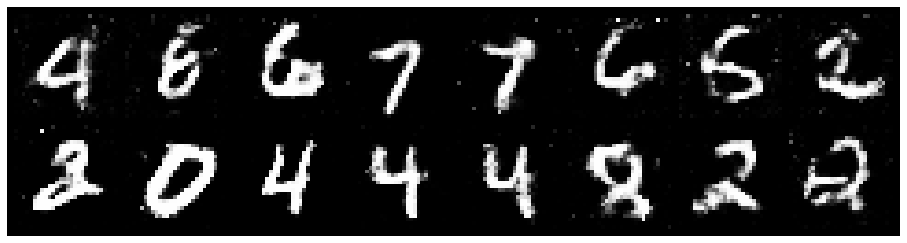

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.3194, Generator Loss: 0.8499
D(x): 0.5402, D(G(z)): 0.4707


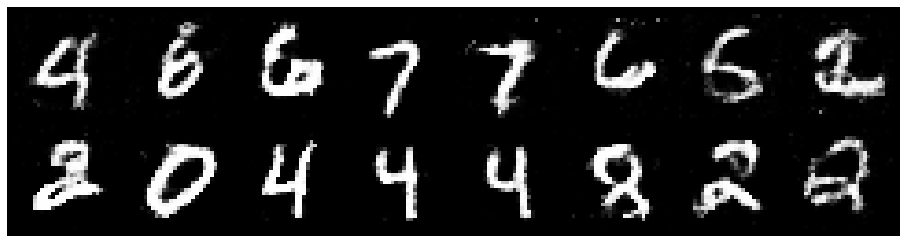

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2335, Generator Loss: 0.8498
D(x): 0.5513, D(G(z)): 0.4310


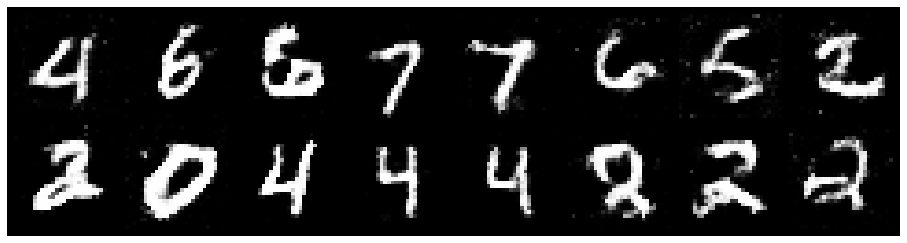

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2300, Generator Loss: 0.9690
D(x): 0.5325, D(G(z)): 0.3993


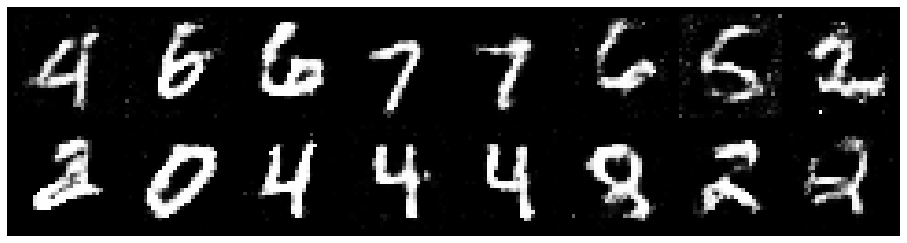

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.1947, Generator Loss: 0.9224
D(x): 0.5791, D(G(z)): 0.4252


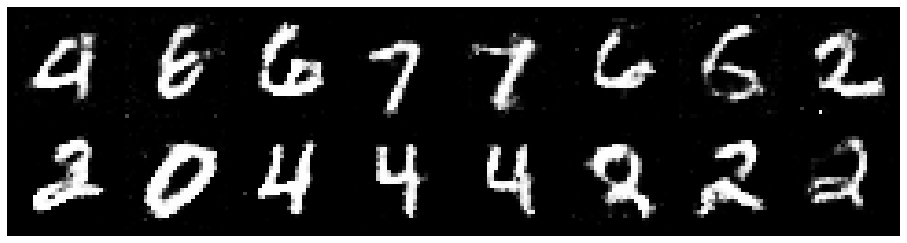

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.3919, Generator Loss: 0.8793
D(x): 0.5403, D(G(z)): 0.4868


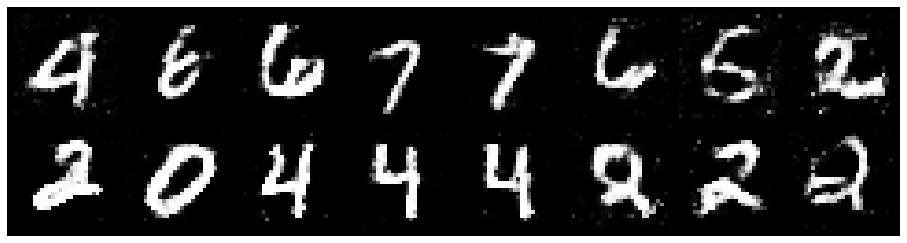

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2985, Generator Loss: 0.7262
D(x): 0.5554, D(G(z)): 0.4751


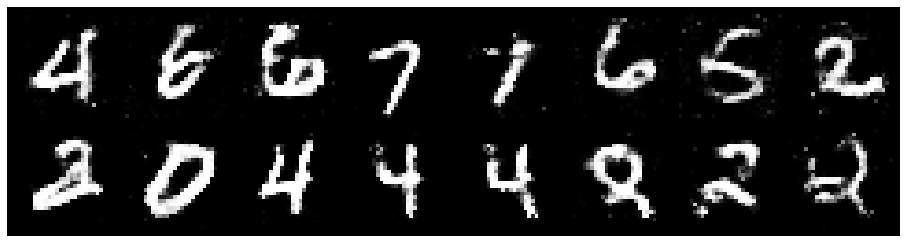

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2481, Generator Loss: 0.8982
D(x): 0.5680, D(G(z)): 0.4435


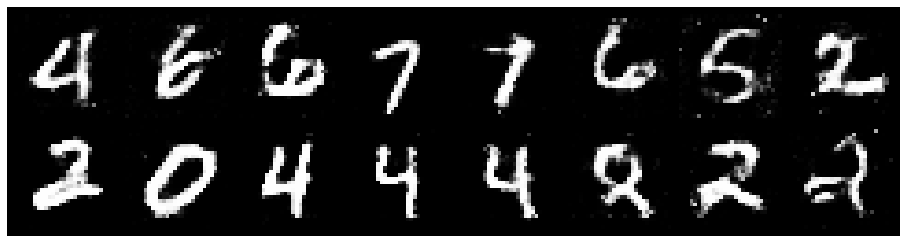

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.3052, Generator Loss: 0.7863
D(x): 0.5532, D(G(z)): 0.4763


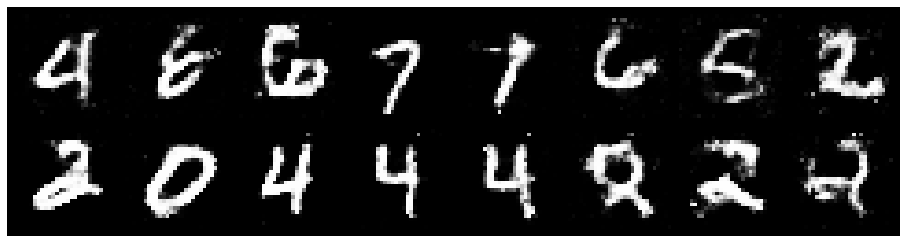

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.3217, Generator Loss: 0.7993
D(x): 0.5342, D(G(z)): 0.4562


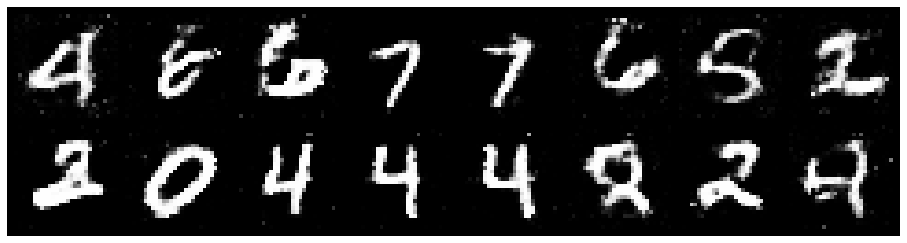

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.3479, Generator Loss: 0.8340
D(x): 0.5327, D(G(z)): 0.4658


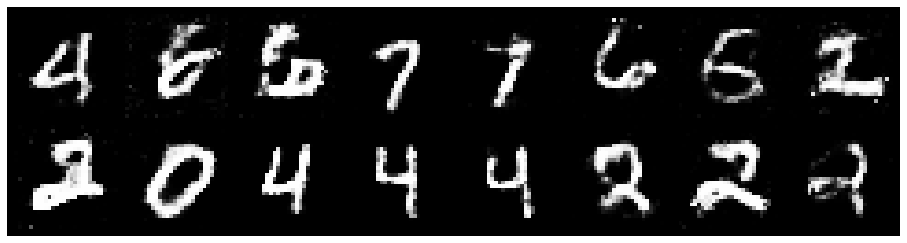

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.3280, Generator Loss: 0.8589
D(x): 0.5400, D(G(z)): 0.4497


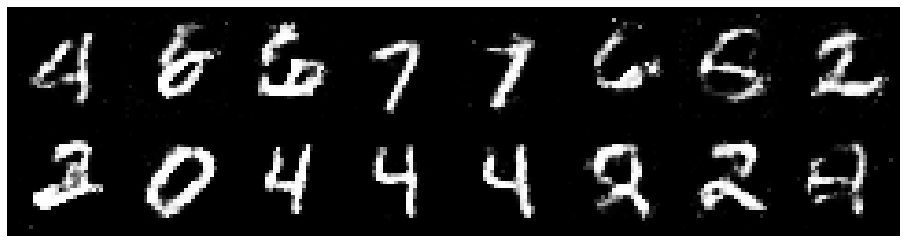

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.3381, Generator Loss: 0.8855
D(x): 0.5309, D(G(z)): 0.4580


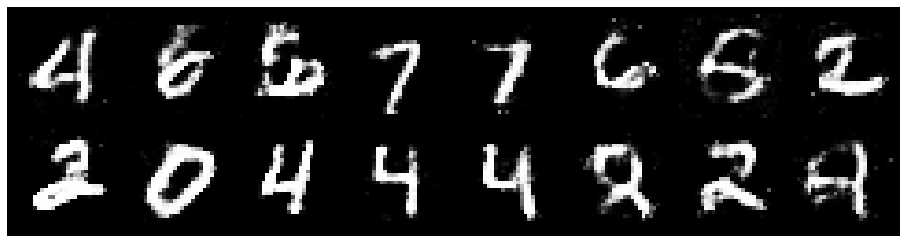

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.2723, Generator Loss: 0.8769
D(x): 0.5408, D(G(z)): 0.4541


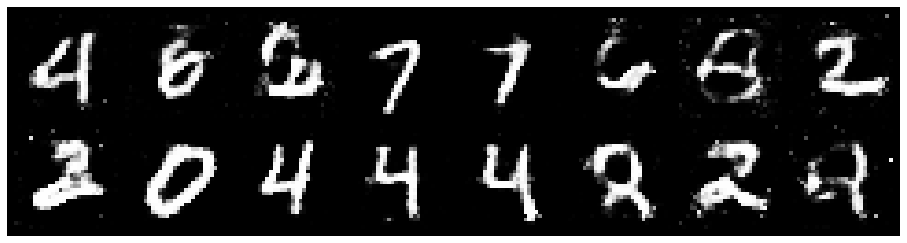

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2211, Generator Loss: 0.9448
D(x): 0.5602, D(G(z)): 0.4088


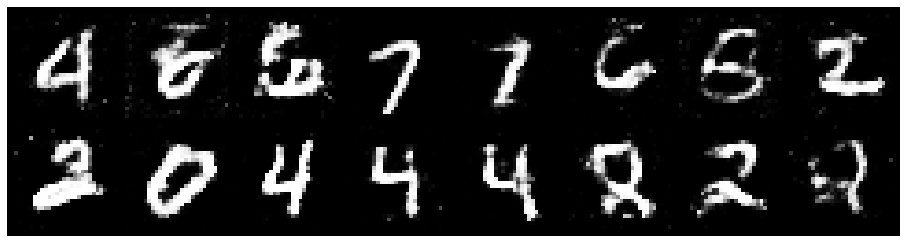

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2819, Generator Loss: 0.9109
D(x): 0.5624, D(G(z)): 0.4454


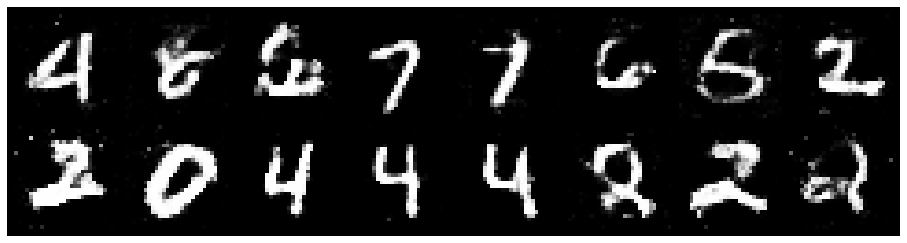

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2436, Generator Loss: 0.8898
D(x): 0.5300, D(G(z)): 0.4119


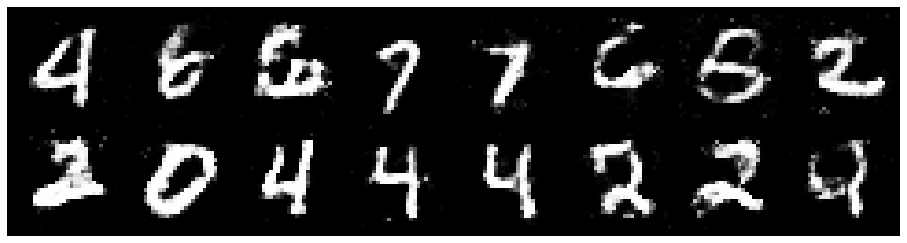

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3373, Generator Loss: 0.8088
D(x): 0.5553, D(G(z)): 0.4947


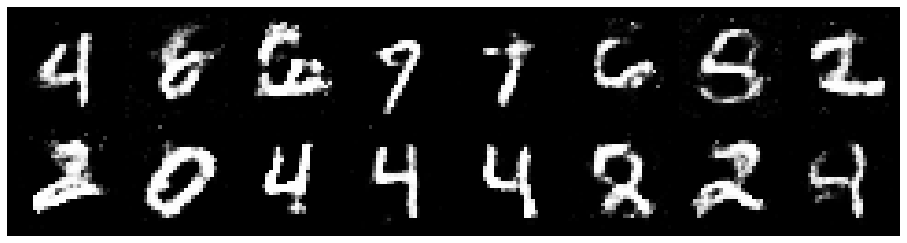

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2904, Generator Loss: 0.9465
D(x): 0.5390, D(G(z)): 0.4377


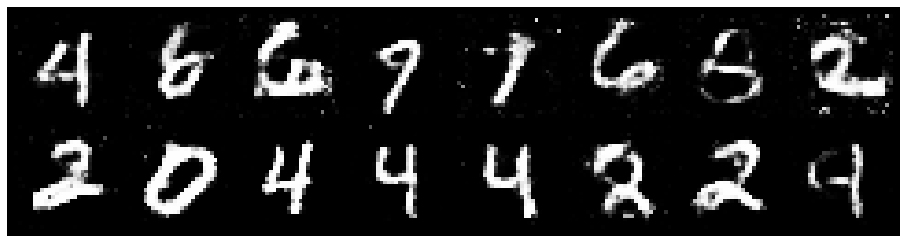

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2845, Generator Loss: 0.8024
D(x): 0.5428, D(G(z)): 0.4551


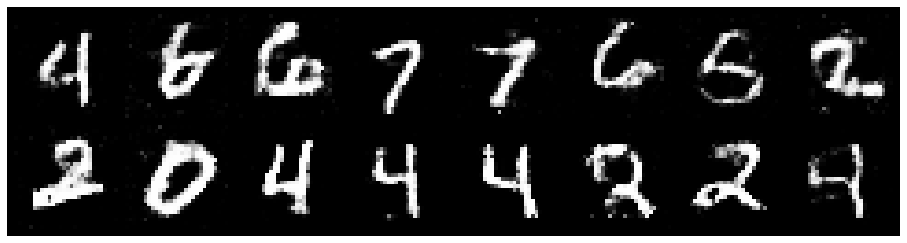

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.3355, Generator Loss: 0.7951
D(x): 0.5287, D(G(z)): 0.4686


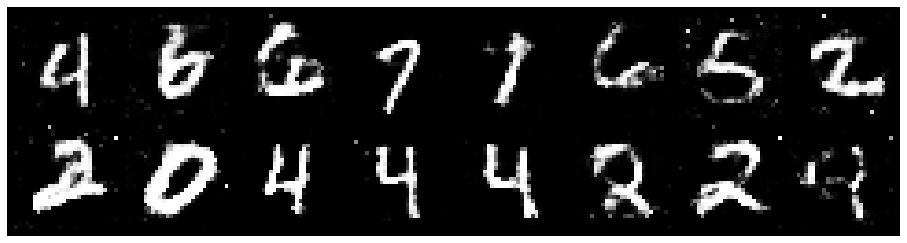

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2861, Generator Loss: 0.9125
D(x): 0.5609, D(G(z)): 0.4666


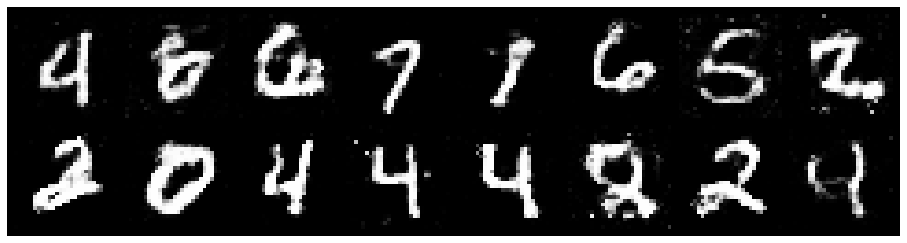

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.3516, Generator Loss: 1.0189
D(x): 0.5719, D(G(z)): 0.4676


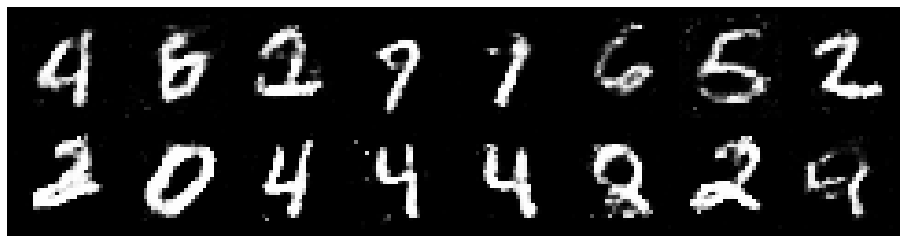

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.3517, Generator Loss: 0.8242
D(x): 0.5367, D(G(z)): 0.4691


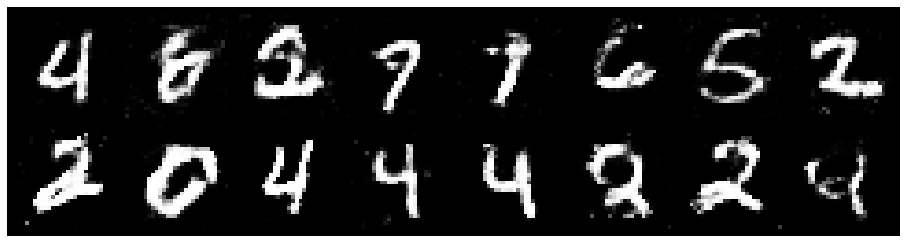

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.4319, Generator Loss: 0.8106
D(x): 0.5275, D(G(z)): 0.4771


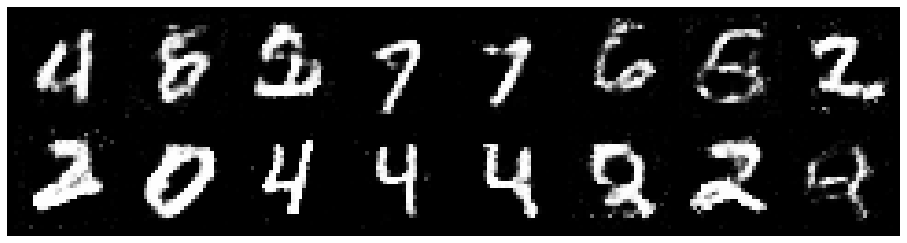

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.3654, Generator Loss: 0.7945
D(x): 0.5161, D(G(z)): 0.4524


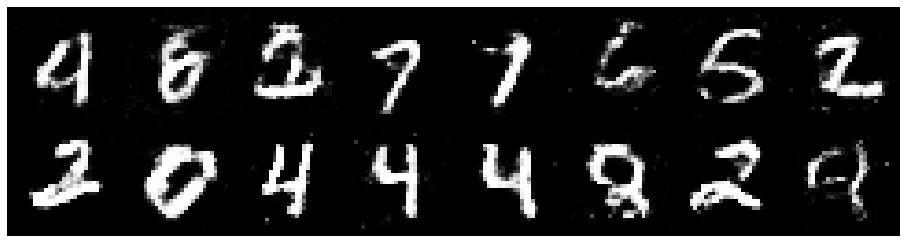

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.4699, Generator Loss: 0.7954
D(x): 0.4959, D(G(z)): 0.4822


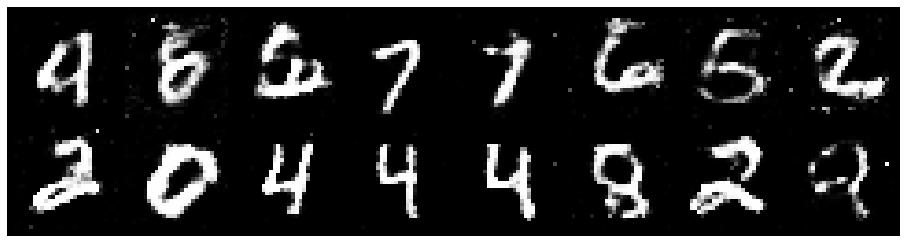

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.4098, Generator Loss: 0.9808
D(x): 0.5220, D(G(z)): 0.4621


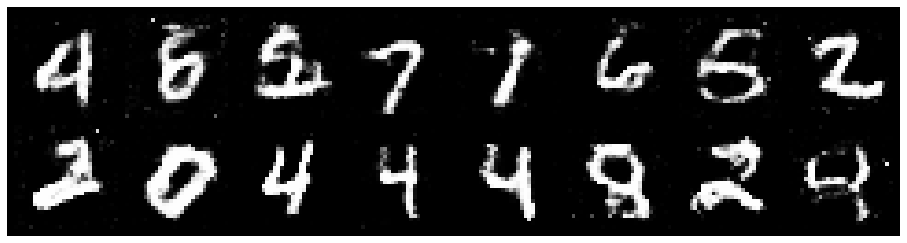

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2761, Generator Loss: 0.7964
D(x): 0.6091, D(G(z)): 0.4900


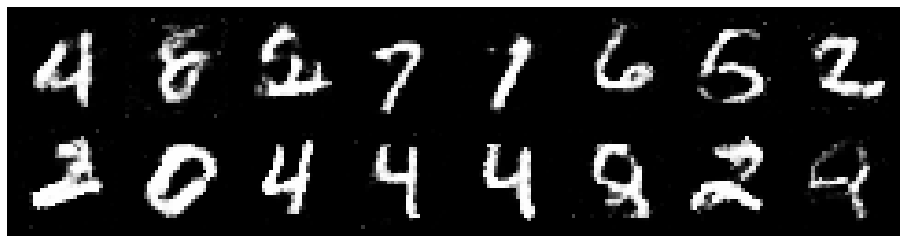

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.3225, Generator Loss: 0.9771
D(x): 0.5565, D(G(z)): 0.4603


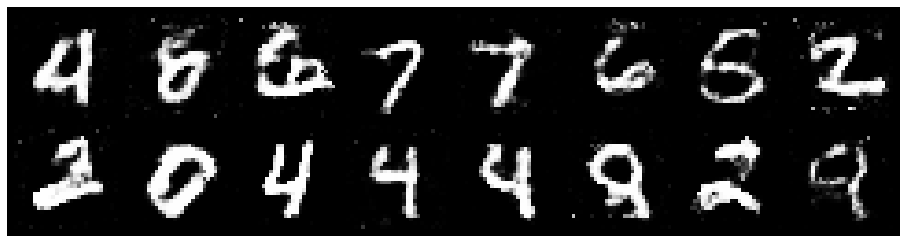

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.3285, Generator Loss: 0.7750
D(x): 0.5490, D(G(z)): 0.4684


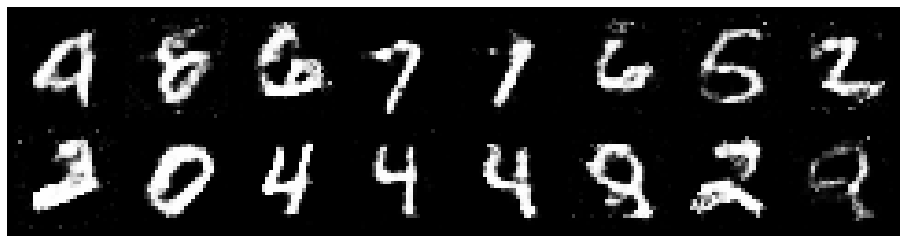

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2593, Generator Loss: 0.9727
D(x): 0.5812, D(G(z)): 0.4624


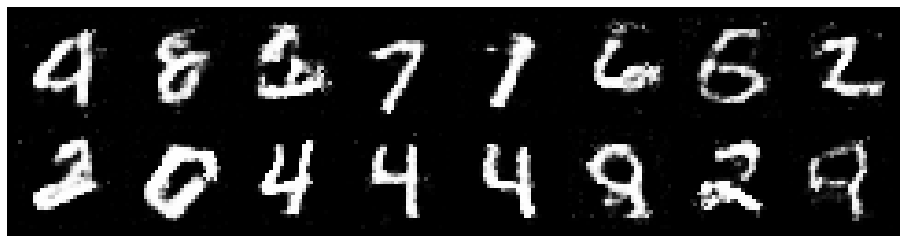

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2939, Generator Loss: 0.8947
D(x): 0.5390, D(G(z)): 0.4355


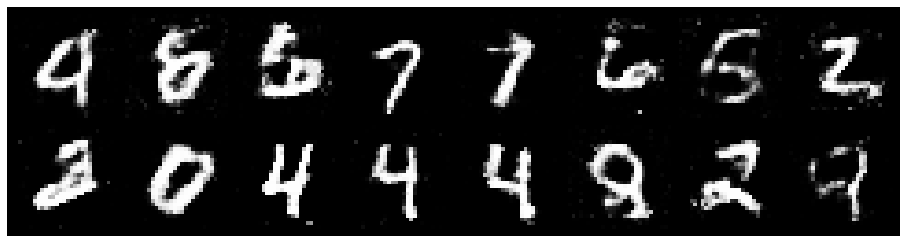

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2911, Generator Loss: 0.8416
D(x): 0.5663, D(G(z)): 0.4753


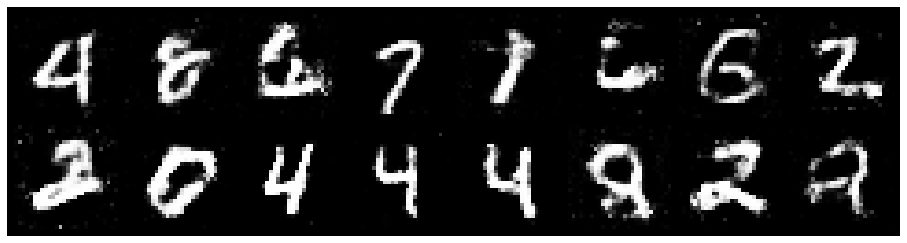

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.3242, Generator Loss: 0.7867
D(x): 0.5031, D(G(z)): 0.4502


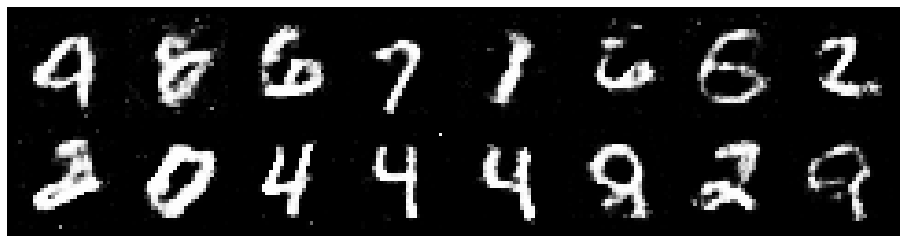

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.2572, Generator Loss: 0.8239
D(x): 0.5837, D(G(z)): 0.4665


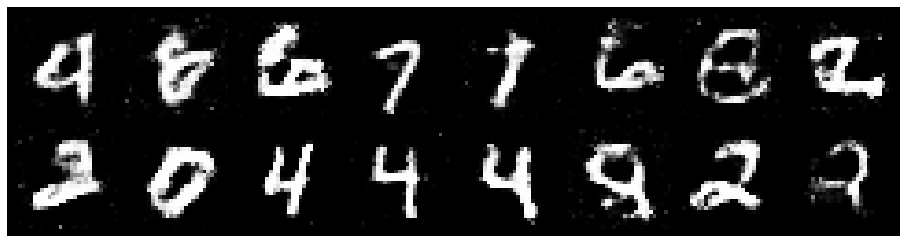

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.3030, Generator Loss: 0.7767
D(x): 0.5701, D(G(z)): 0.4858


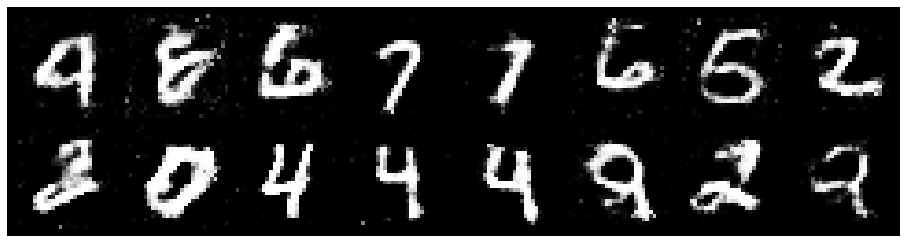

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.3234, Generator Loss: 0.8644
D(x): 0.5361, D(G(z)): 0.4555


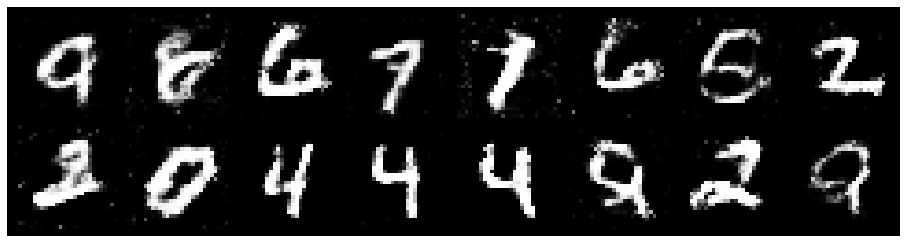

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.3245, Generator Loss: 0.8867
D(x): 0.5371, D(G(z)): 0.4696


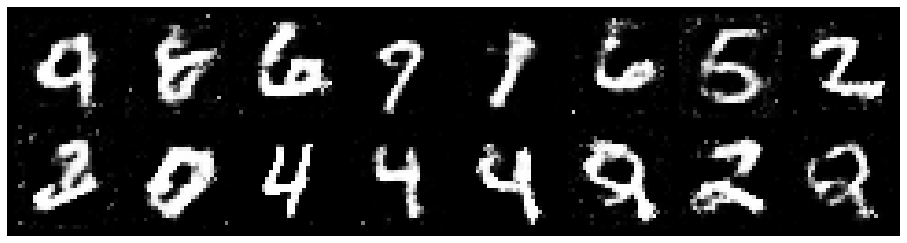

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.2552, Generator Loss: 0.9241
D(x): 0.5744, D(G(z)): 0.4527


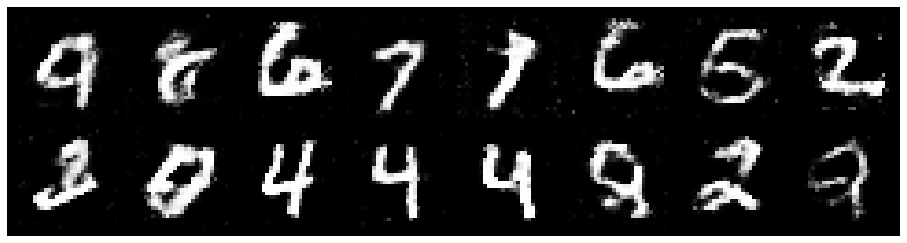

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.1803, Generator Loss: 0.9108
D(x): 0.5991, D(G(z)): 0.4323


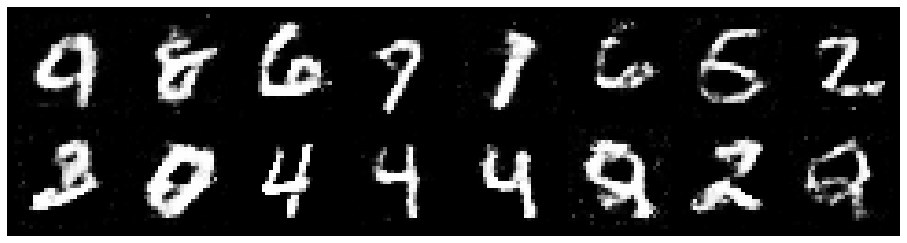

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2659, Generator Loss: 0.9898
D(x): 0.5521, D(G(z)): 0.4275


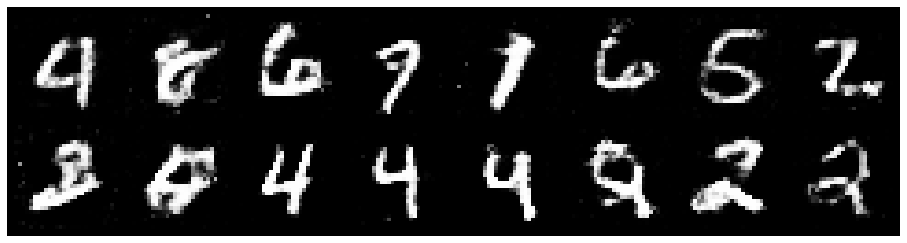

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2995, Generator Loss: 0.8138
D(x): 0.5661, D(G(z)): 0.4736


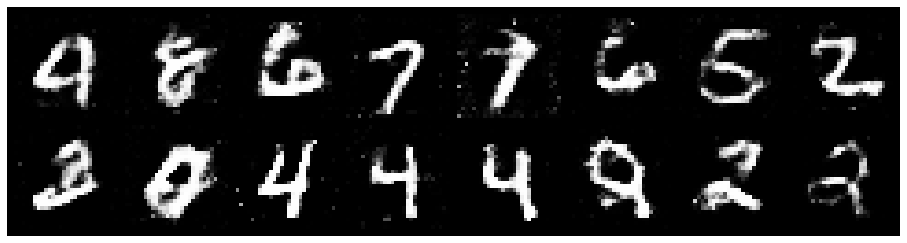

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.3809, Generator Loss: 0.8507
D(x): 0.4871, D(G(z)): 0.4298


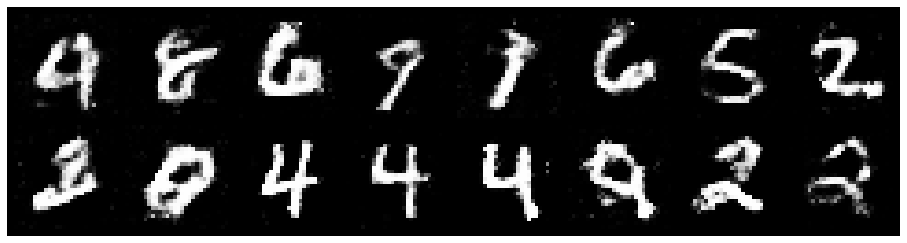

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.3091, Generator Loss: 0.7865
D(x): 0.5271, D(G(z)): 0.4469


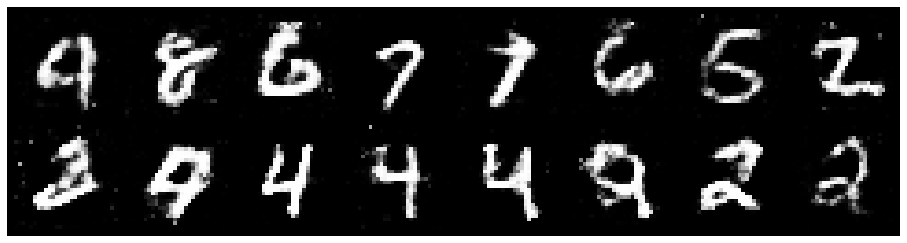

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3404, Generator Loss: 0.8149
D(x): 0.5329, D(G(z)): 0.4656


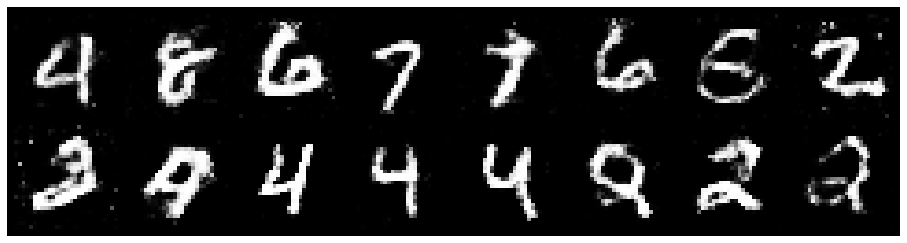

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.4000, Generator Loss: 0.8527
D(x): 0.4777, D(G(z)): 0.4346


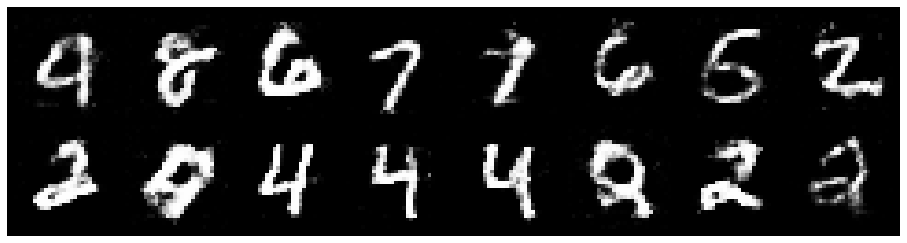

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2744, Generator Loss: 0.8282
D(x): 0.5577, D(G(z)): 0.4609


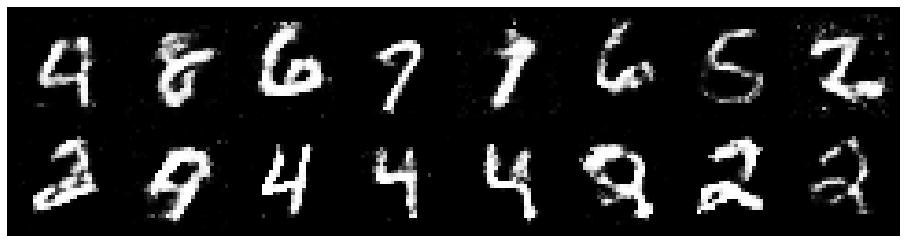

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.3262, Generator Loss: 0.8236
D(x): 0.5195, D(G(z)): 0.4558


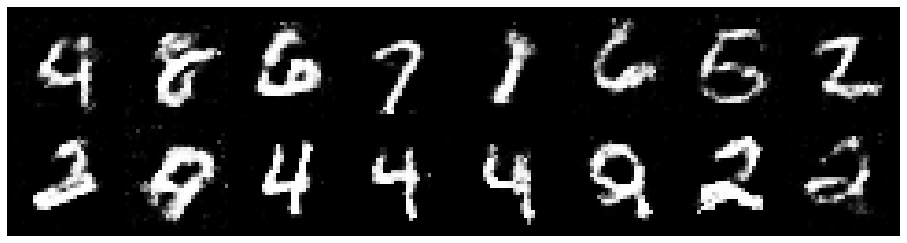

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2880, Generator Loss: 0.8827
D(x): 0.5364, D(G(z)): 0.4431


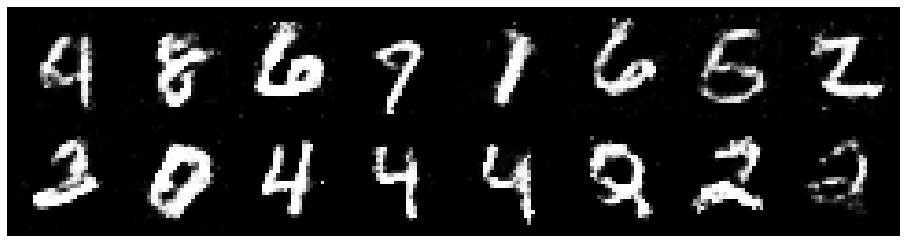

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.3257, Generator Loss: 0.8378
D(x): 0.5807, D(G(z)): 0.4885


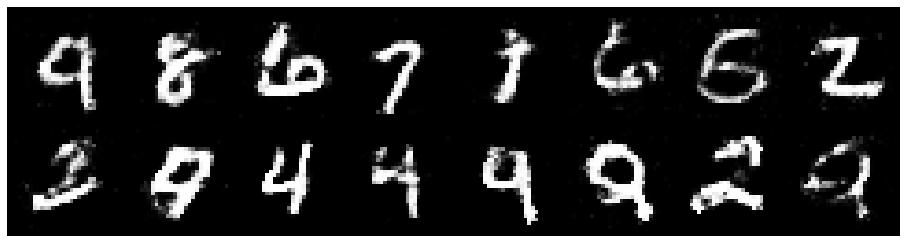

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.3718, Generator Loss: 0.8094
D(x): 0.5543, D(G(z)): 0.5032


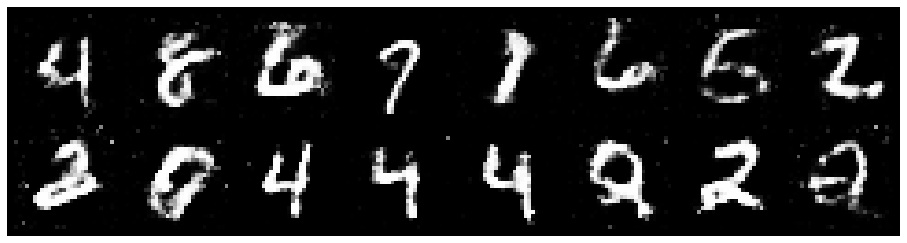

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2612, Generator Loss: 0.7838
D(x): 0.5639, D(G(z)): 0.4675


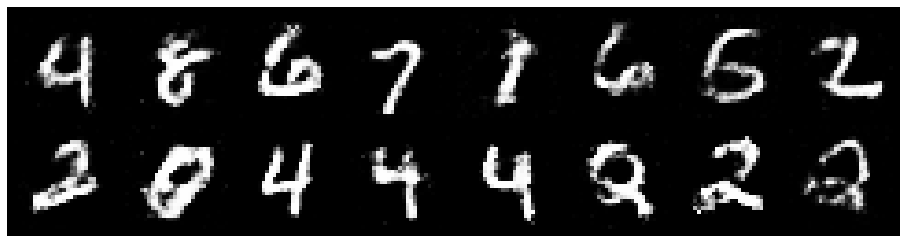

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.2786, Generator Loss: 0.8102
D(x): 0.5635, D(G(z)): 0.4493


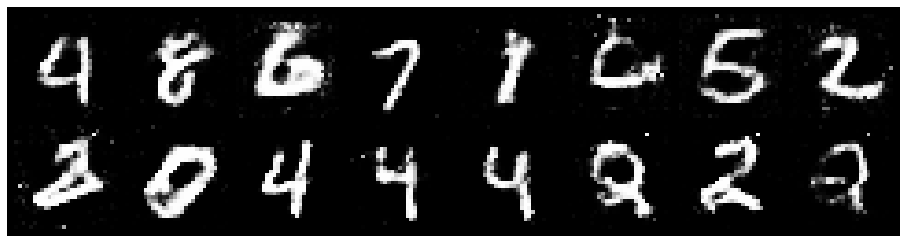

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.3533, Generator Loss: 0.8809
D(x): 0.5602, D(G(z)): 0.4927


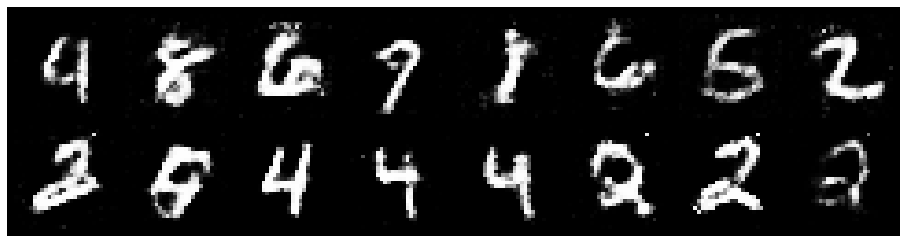

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9609
D(x): 0.5663, D(G(z)): 0.4495


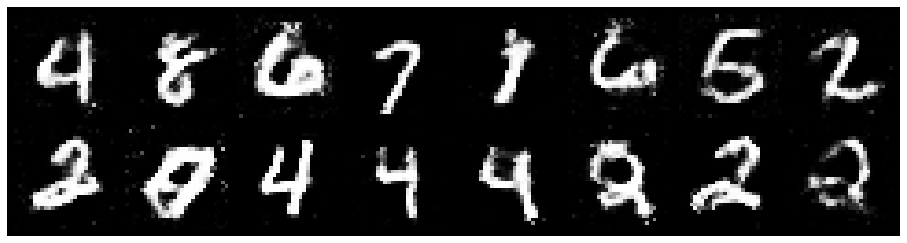

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3066, Generator Loss: 0.8976
D(x): 0.5394, D(G(z)): 0.4509


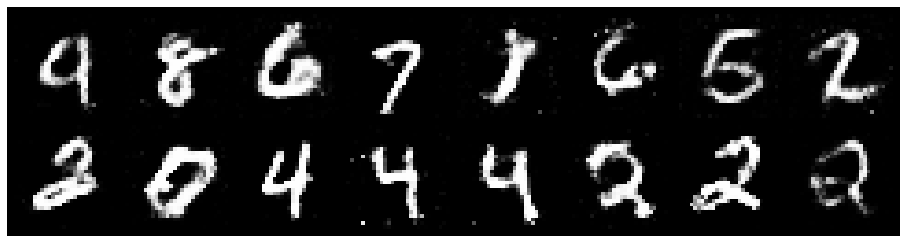

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.2990, Generator Loss: 0.8924
D(x): 0.5611, D(G(z)): 0.4760


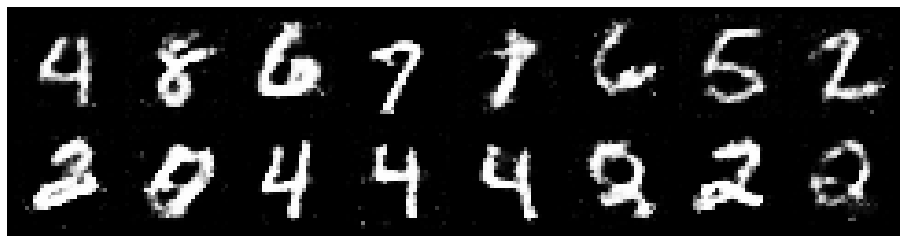

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3202, Generator Loss: 0.8525
D(x): 0.5395, D(G(z)): 0.4507


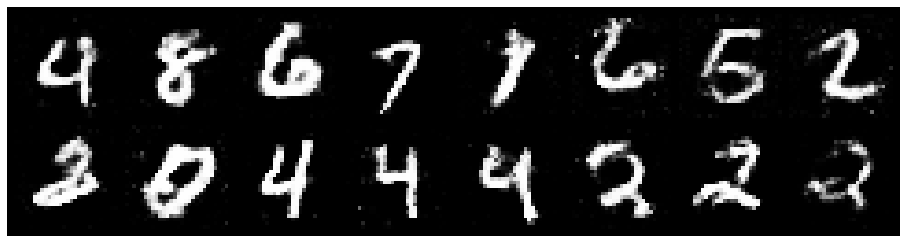

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.3079, Generator Loss: 0.8696
D(x): 0.5474, D(G(z)): 0.4521


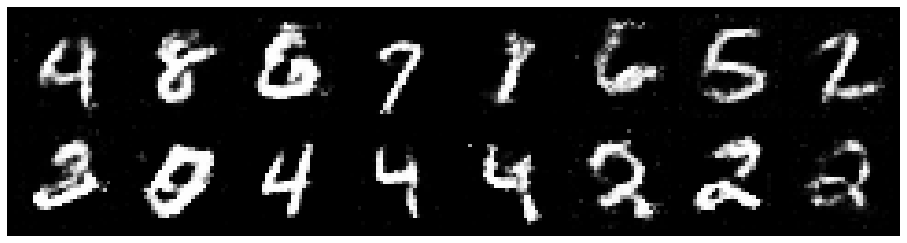

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2135, Generator Loss: 0.9695
D(x): 0.5918, D(G(z)): 0.4458


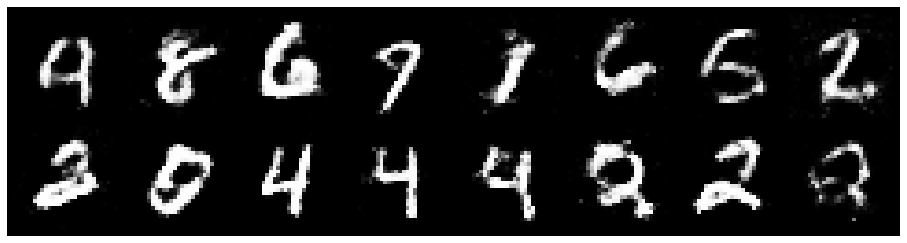

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.1969, Generator Loss: 0.9114
D(x): 0.5834, D(G(z)): 0.4338


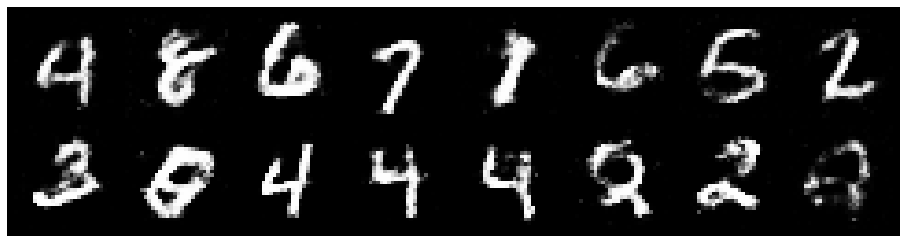

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.3760, Generator Loss: 0.9391
D(x): 0.5044, D(G(z)): 0.4473


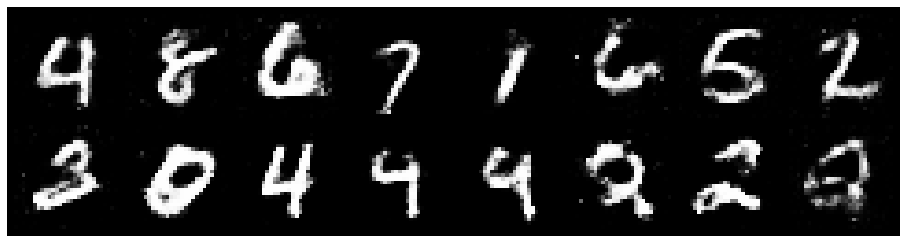

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2378, Generator Loss: 0.8629
D(x): 0.5338, D(G(z)): 0.4279


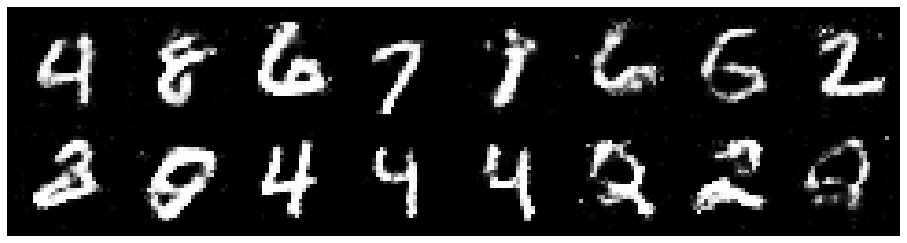

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.1981, Generator Loss: 0.9129
D(x): 0.5787, D(G(z)): 0.4418


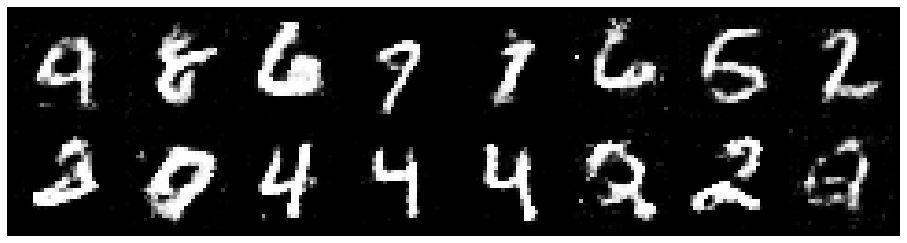

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.3323, Generator Loss: 1.0976
D(x): 0.5336, D(G(z)): 0.4482


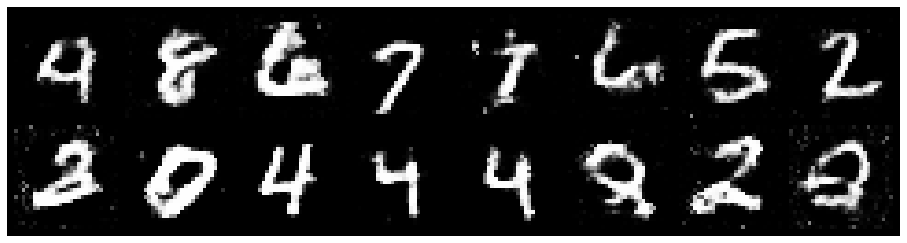

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.3346, Generator Loss: 0.9593
D(x): 0.5413, D(G(z)): 0.4517


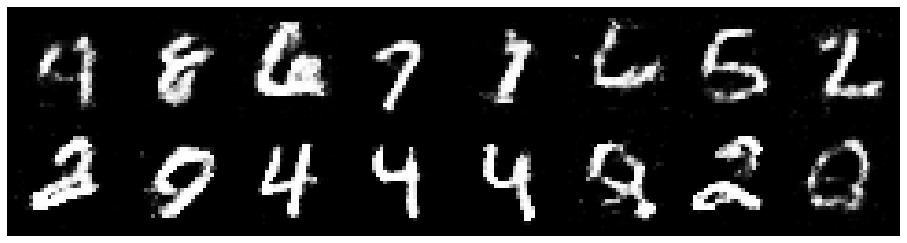

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3428, Generator Loss: 0.8649
D(x): 0.5072, D(G(z)): 0.4496


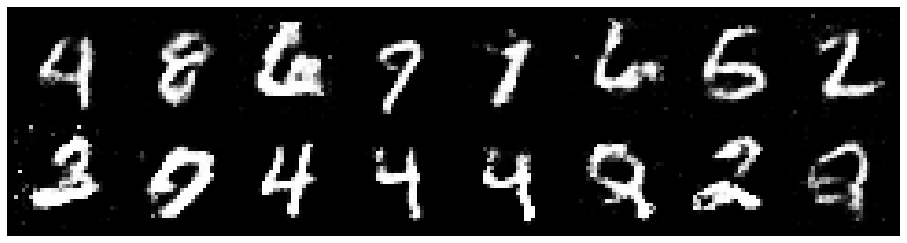

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.3707, Generator Loss: 0.7468
D(x): 0.5614, D(G(z)): 0.5111


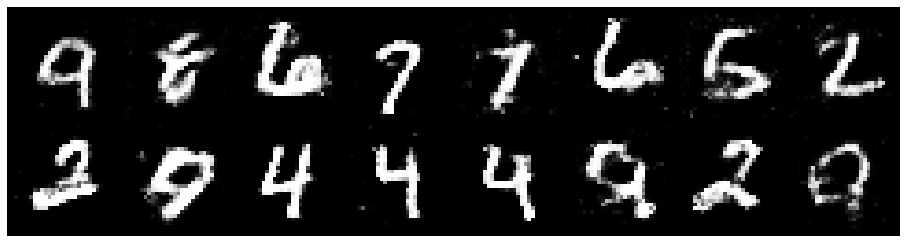

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3041, Generator Loss: 0.8961
D(x): 0.5586, D(G(z)): 0.4697


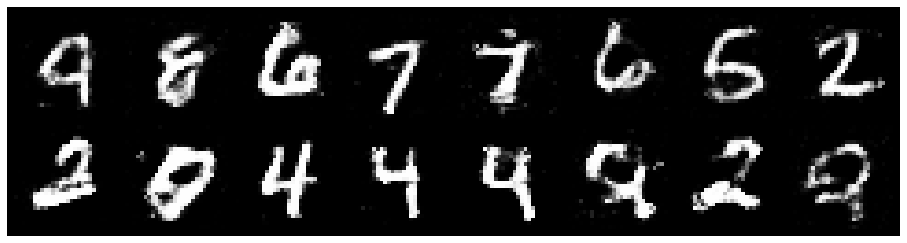

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.2343, Generator Loss: 0.8583
D(x): 0.5535, D(G(z)): 0.4477


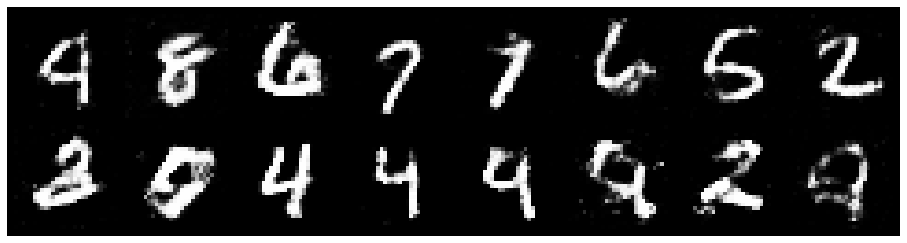

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.2752, Generator Loss: 0.9437
D(x): 0.5390, D(G(z)): 0.4339


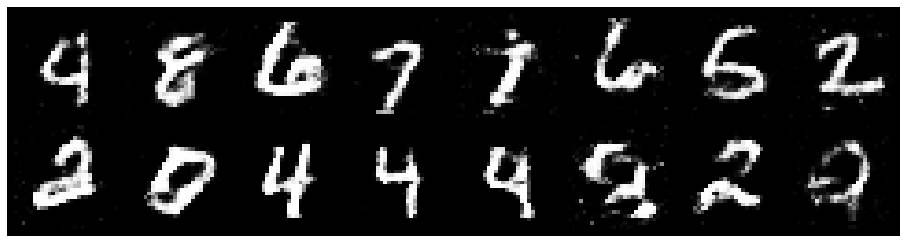

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2250, Generator Loss: 0.8390
D(x): 0.5606, D(G(z)): 0.4386


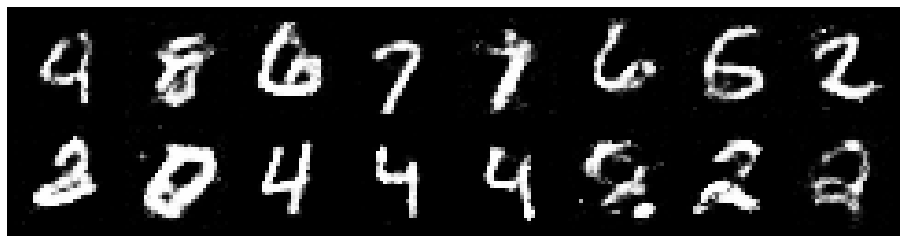

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.1968, Generator Loss: 0.8837
D(x): 0.5911, D(G(z)): 0.4349


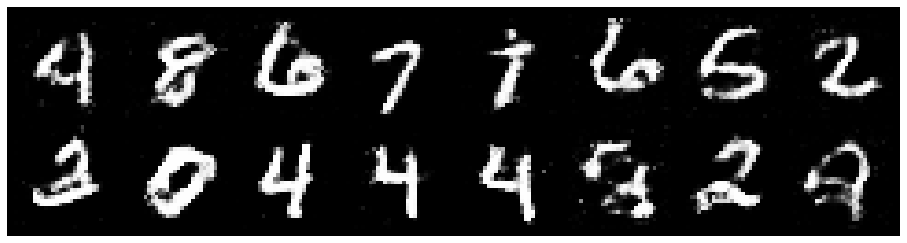

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.2887, Generator Loss: 0.8522
D(x): 0.5512, D(G(z)): 0.4587


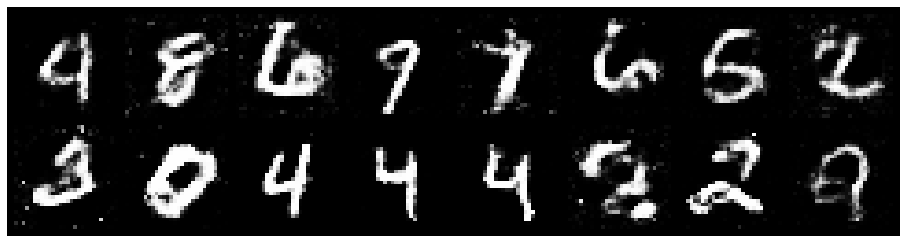

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2988, Generator Loss: 0.8263
D(x): 0.5362, D(G(z)): 0.4593


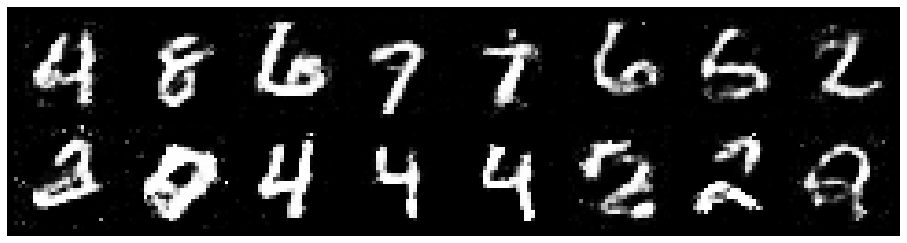

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.3133, Generator Loss: 0.9143
D(x): 0.5169, D(G(z)): 0.4399


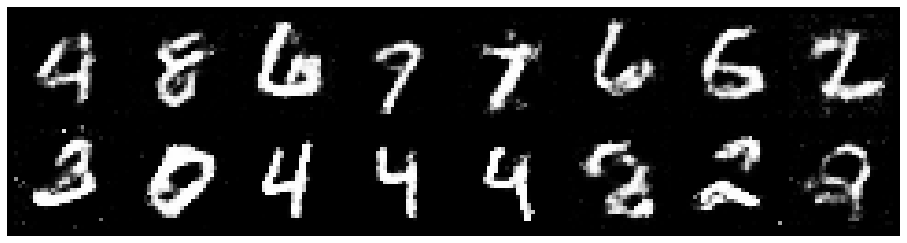

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.3044, Generator Loss: 0.7781
D(x): 0.5522, D(G(z)): 0.4675


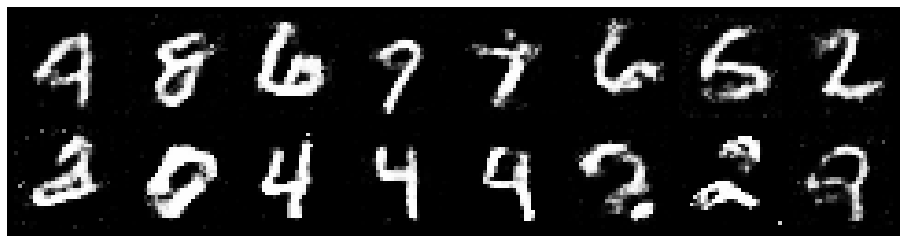

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2513, Generator Loss: 0.8440
D(x): 0.5563, D(G(z)): 0.4349


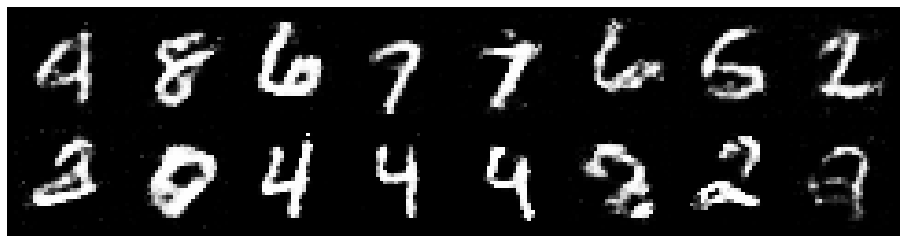

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.3180, Generator Loss: 0.9062
D(x): 0.5460, D(G(z)): 0.4564


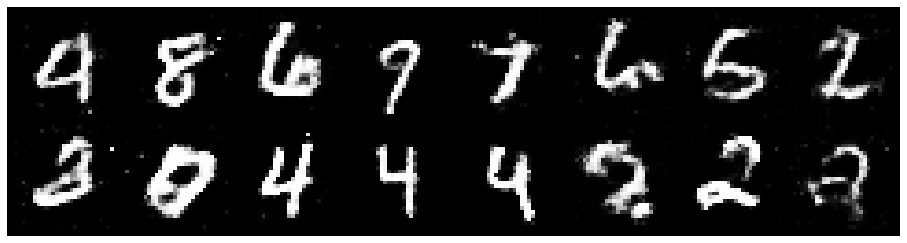

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2765, Generator Loss: 0.9602
D(x): 0.5770, D(G(z)): 0.4688


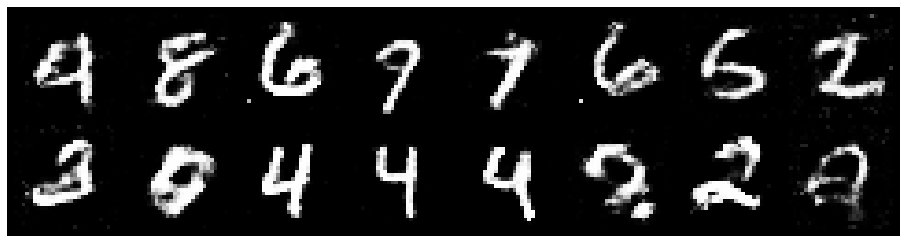

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.4660, Generator Loss: 0.8397
D(x): 0.4776, D(G(z)): 0.4663


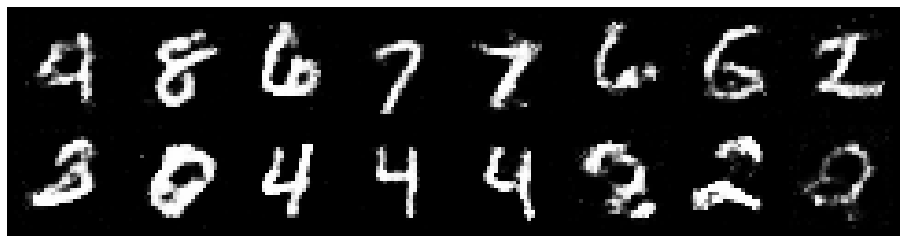

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.3376, Generator Loss: 0.8322
D(x): 0.5012, D(G(z)): 0.4333


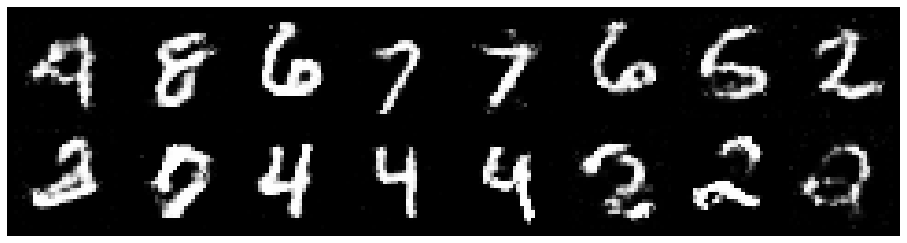

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.3659, Generator Loss: 0.8955
D(x): 0.5087, D(G(z)): 0.4537


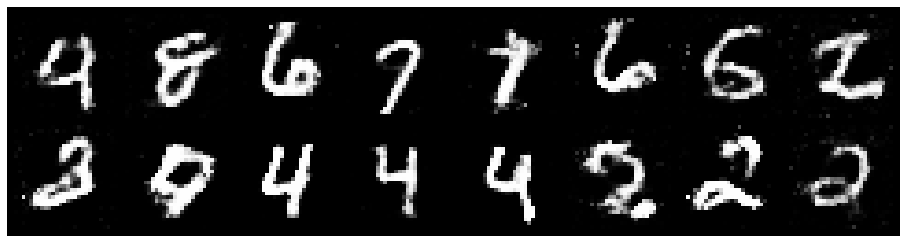

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.3392, Generator Loss: 0.9487
D(x): 0.5025, D(G(z)): 0.4157


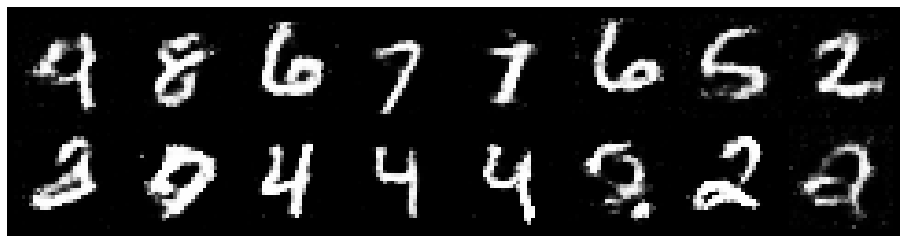

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.3664, Generator Loss: 0.8115
D(x): 0.5382, D(G(z)): 0.4927


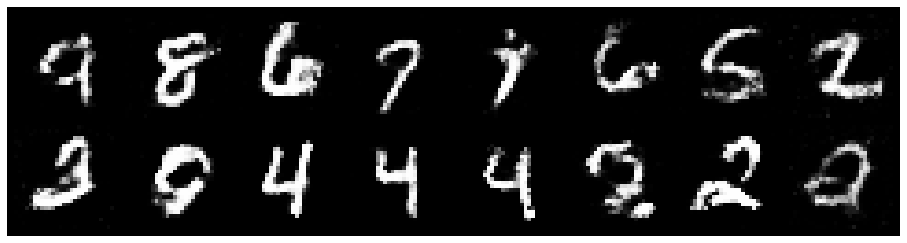

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2703, Generator Loss: 0.8667
D(x): 0.5316, D(G(z)): 0.4355


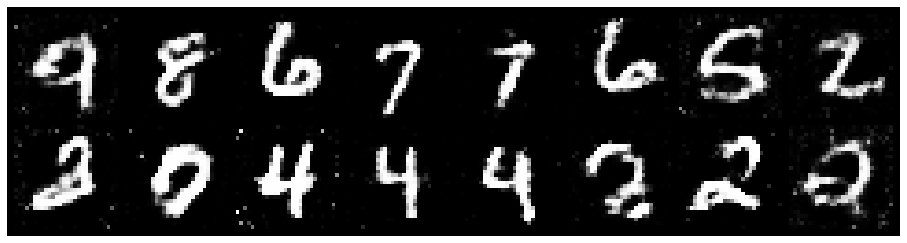

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.3472, Generator Loss: 0.8818
D(x): 0.5207, D(G(z)): 0.4652


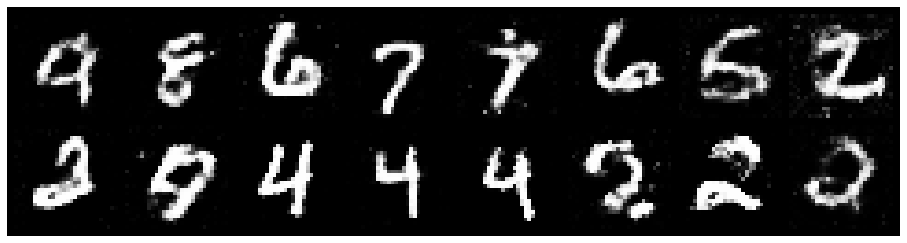

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3013, Generator Loss: 0.9445
D(x): 0.5221, D(G(z)): 0.4195


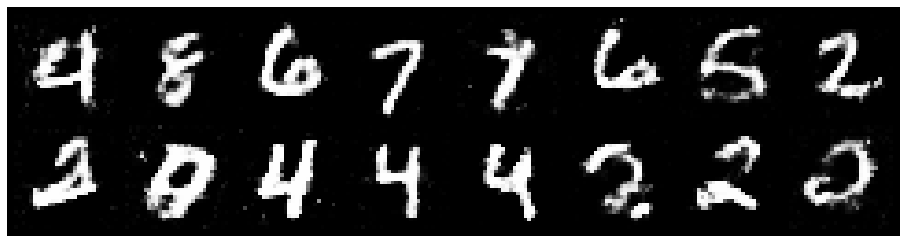

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3729, Generator Loss: 0.8043
D(x): 0.5086, D(G(z)): 0.4777


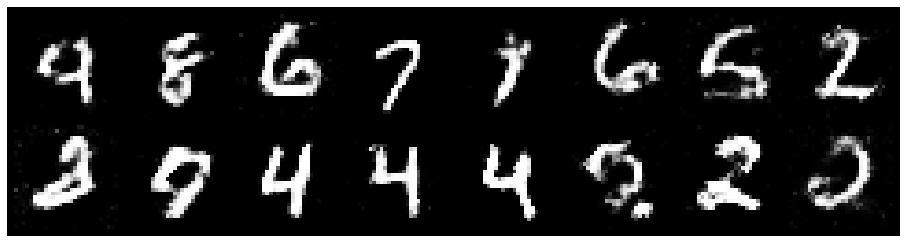

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8273
D(x): 0.5399, D(G(z)): 0.4778


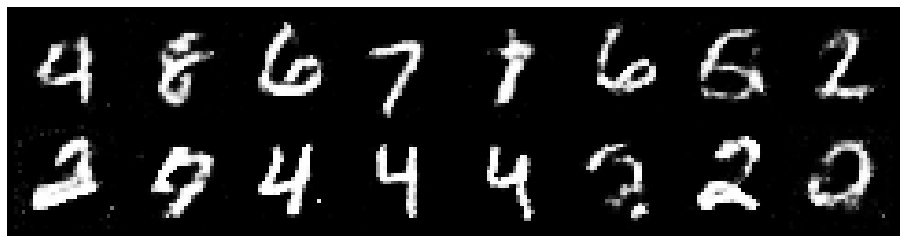

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3320, Generator Loss: 0.8336
D(x): 0.5373, D(G(z)): 0.4640


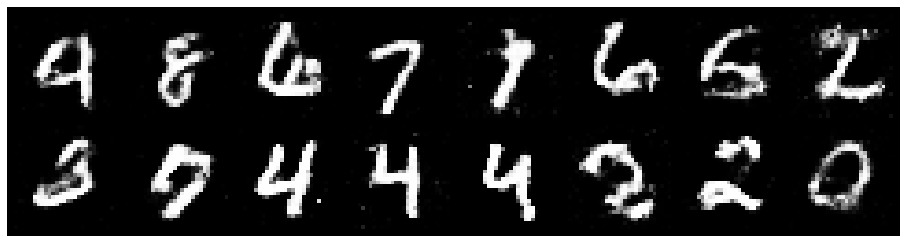

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.2448, Generator Loss: 0.8664
D(x): 0.5507, D(G(z)): 0.4406


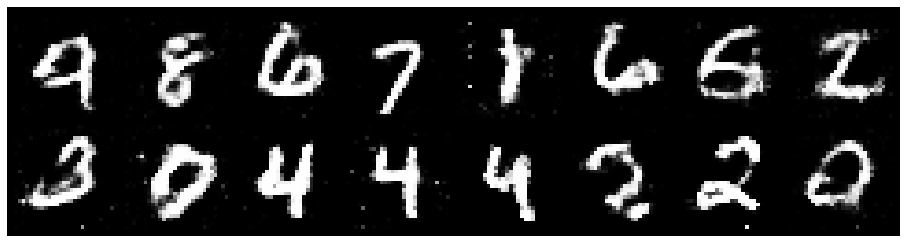

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2369, Generator Loss: 0.8910
D(x): 0.5328, D(G(z)): 0.4089


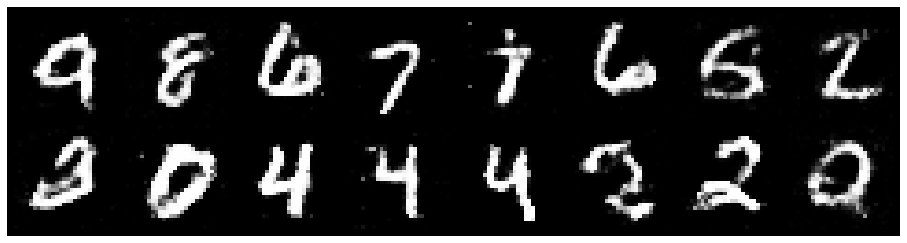

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3975, Generator Loss: 0.8246
D(x): 0.5071, D(G(z)): 0.4749


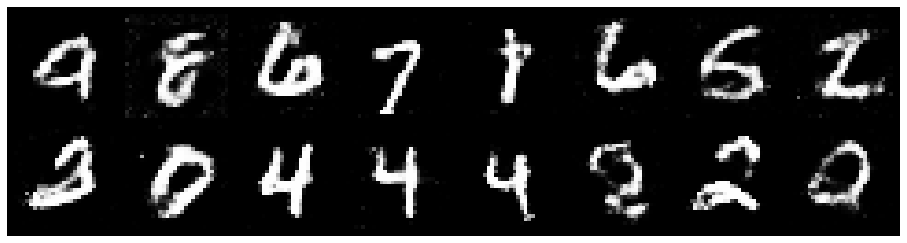

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.3886, Generator Loss: 0.8603
D(x): 0.5630, D(G(z)): 0.5140


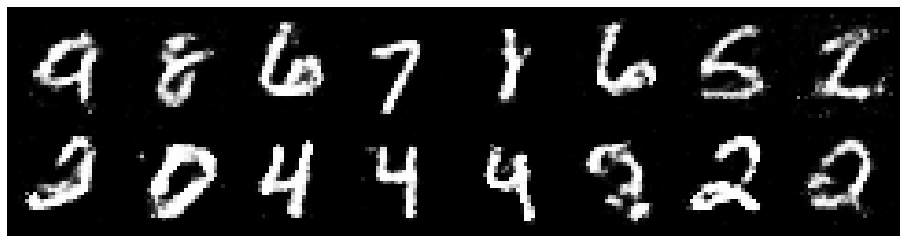

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.3264, Generator Loss: 0.9854
D(x): 0.5403, D(G(z)): 0.4566


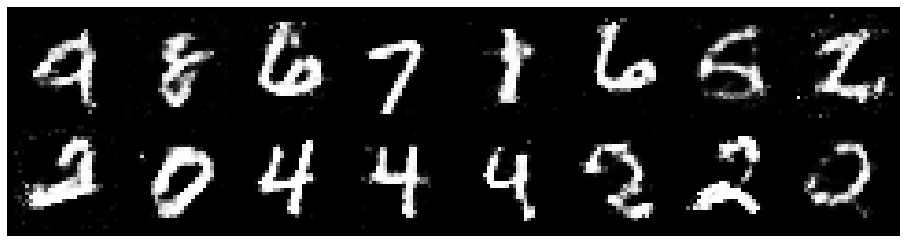

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2770, Generator Loss: 0.8588
D(x): 0.5525, D(G(z)): 0.4608


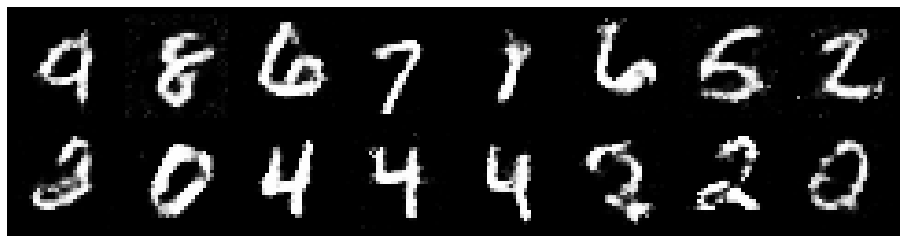

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2422, Generator Loss: 0.8568
D(x): 0.5898, D(G(z)): 0.4600


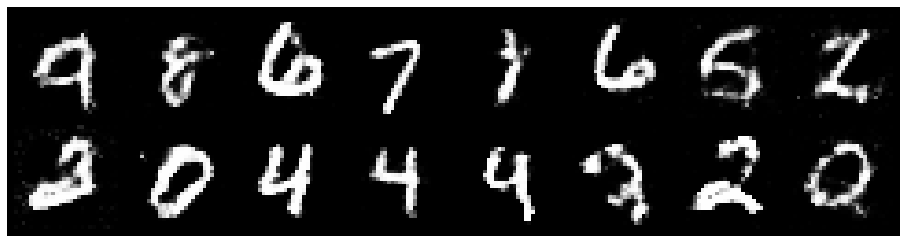

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.3123, Generator Loss: 0.8622
D(x): 0.5239, D(G(z)): 0.4536


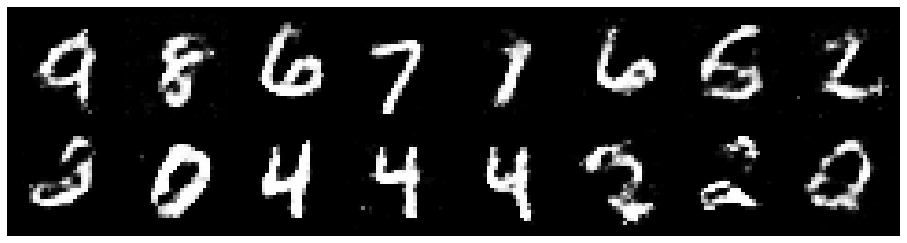

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2963, Generator Loss: 0.9751
D(x): 0.5363, D(G(z)): 0.4326


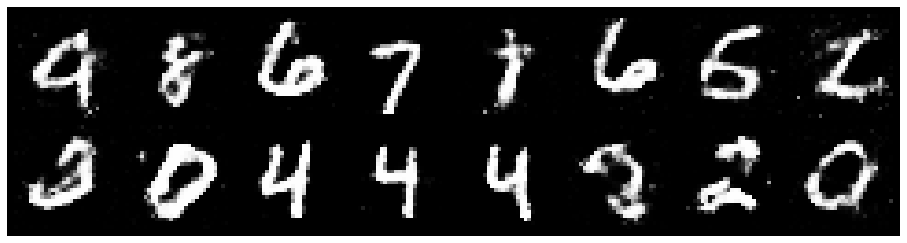

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.2830, Generator Loss: 0.8837
D(x): 0.5887, D(G(z)): 0.4672


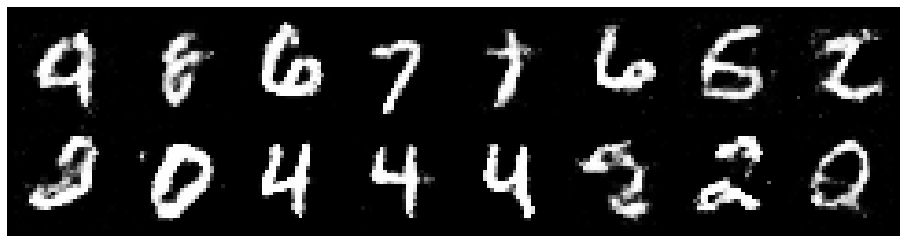

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.3409, Generator Loss: 0.7619
D(x): 0.5310, D(G(z)): 0.4598


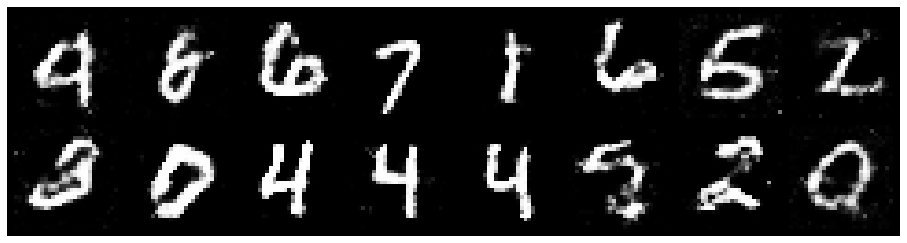

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.3644, Generator Loss: 0.8550
D(x): 0.4908, D(G(z)): 0.4522


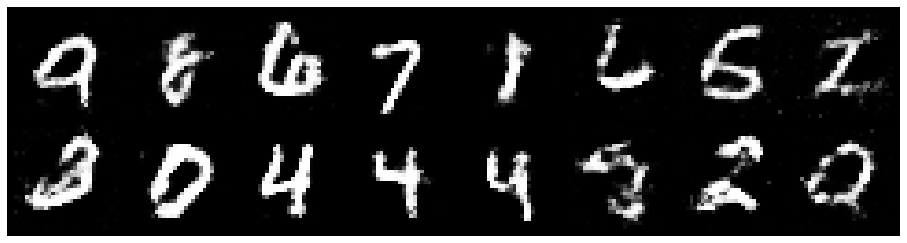

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.3298, Generator Loss: 0.7568
D(x): 0.5429, D(G(z)): 0.4714


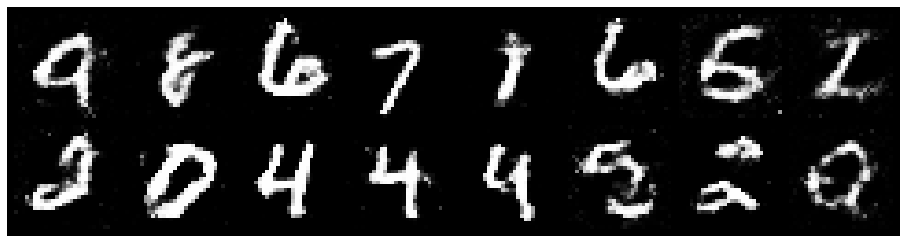

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2359, Generator Loss: 0.8131
D(x): 0.5833, D(G(z)): 0.4721


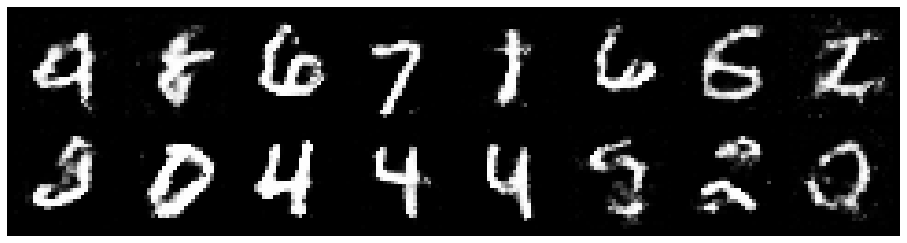

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.1766, Generator Loss: 0.9007
D(x): 0.5934, D(G(z)): 0.4227


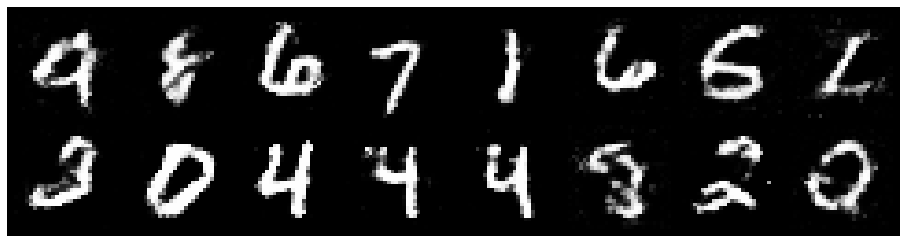

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2031, Generator Loss: 1.0110
D(x): 0.5820, D(G(z)): 0.4281


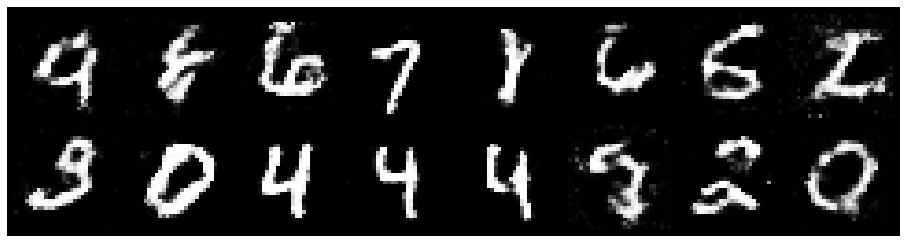

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.2297, Generator Loss: 0.9734
D(x): 0.5999, D(G(z)): 0.4177


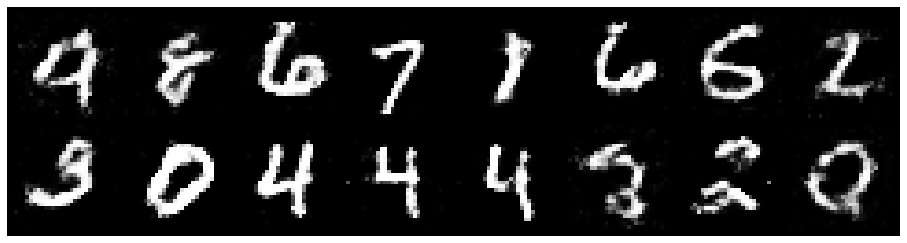

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2850, Generator Loss: 1.0153
D(x): 0.5224, D(G(z)): 0.4109


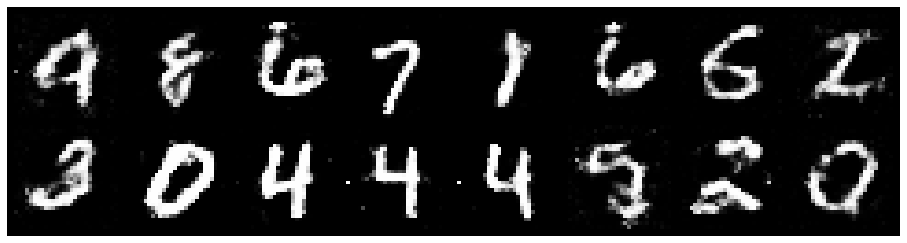

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.2910, Generator Loss: 0.8994
D(x): 0.5476, D(G(z)): 0.4367


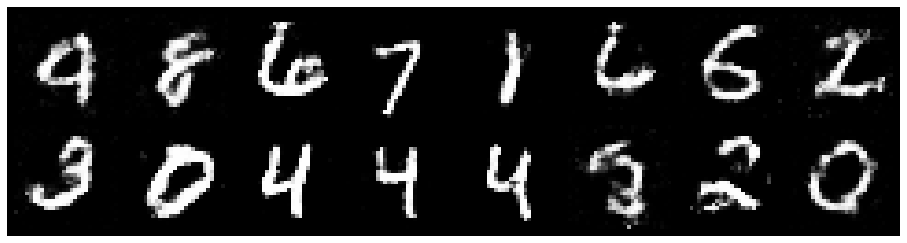

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2236, Generator Loss: 0.8704
D(x): 0.5323, D(G(z)): 0.3918


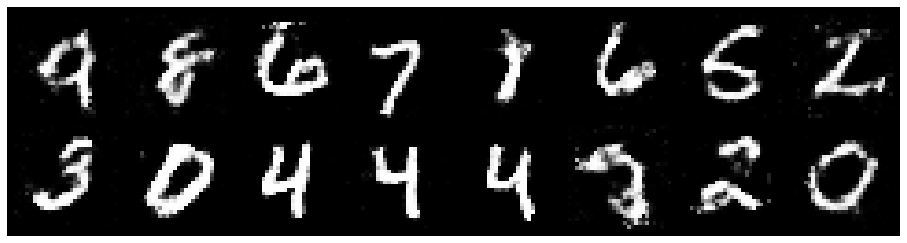

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.2517, Generator Loss: 0.9089
D(x): 0.5379, D(G(z)): 0.4234


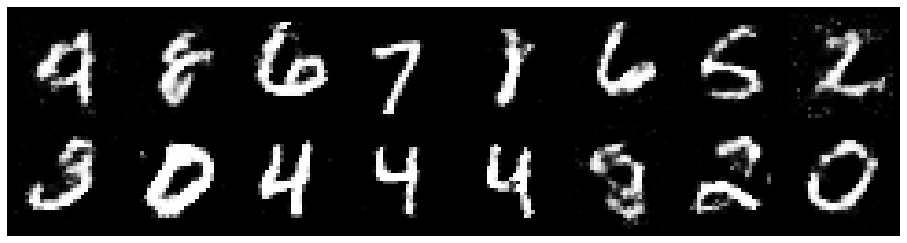

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2538, Generator Loss: 0.9710
D(x): 0.5653, D(G(z)): 0.4493


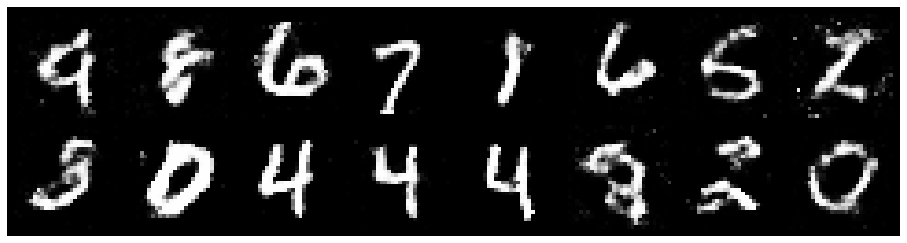

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2848, Generator Loss: 0.9518
D(x): 0.5299, D(G(z)): 0.4332


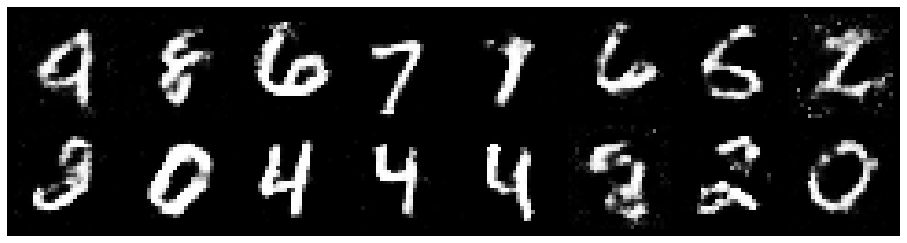

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.2401, Generator Loss: 0.8419
D(x): 0.5577, D(G(z)): 0.4300


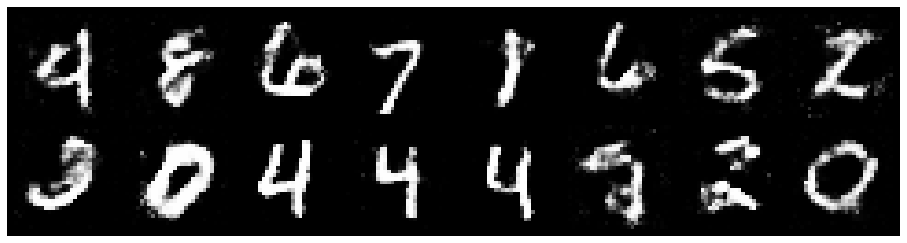

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.2474, Generator Loss: 0.8414
D(x): 0.5734, D(G(z)): 0.4471


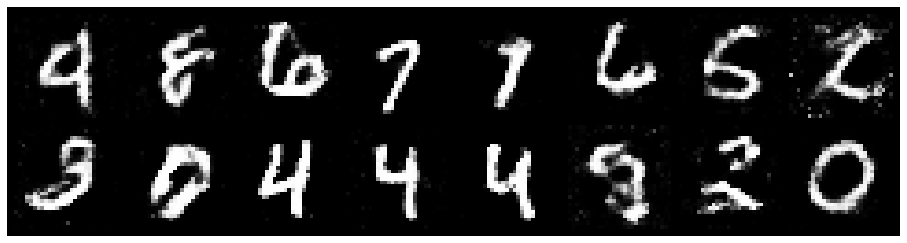

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3320, Generator Loss: 0.9478
D(x): 0.5238, D(G(z)): 0.4434


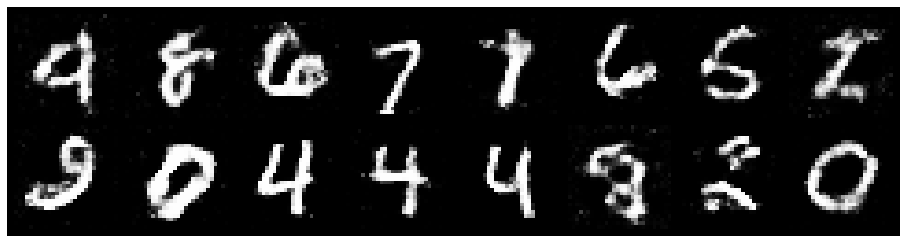

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.3177, Generator Loss: 0.8483
D(x): 0.5223, D(G(z)): 0.4494


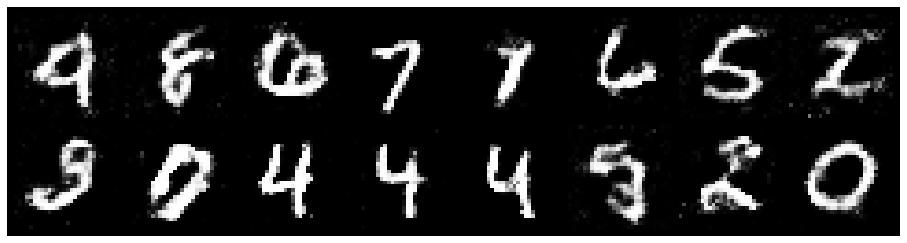

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9640
D(x): 0.5742, D(G(z)): 0.4247


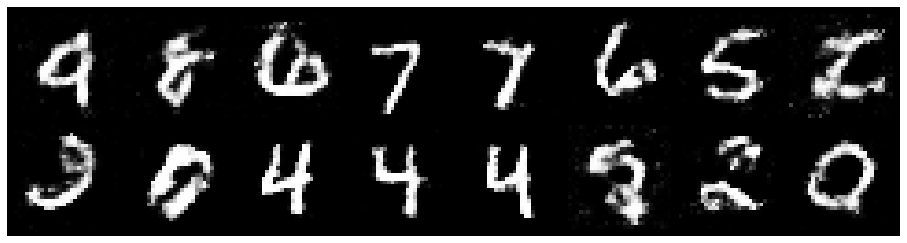

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.4355, Generator Loss: 0.8280
D(x): 0.5224, D(G(z)): 0.4937


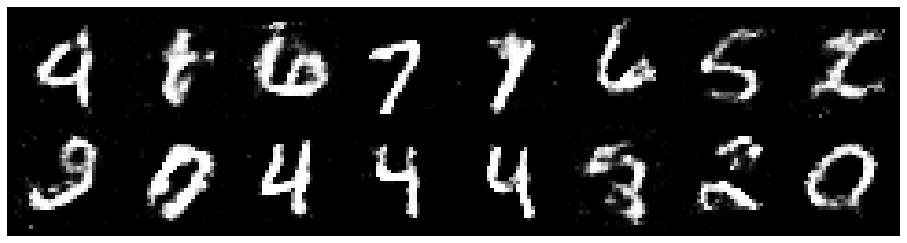

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.3223, Generator Loss: 0.7980
D(x): 0.5822, D(G(z)): 0.4688


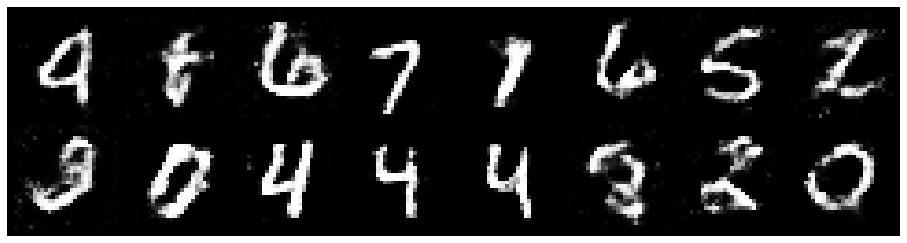

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2874, Generator Loss: 1.0465
D(x): 0.5382, D(G(z)): 0.4091


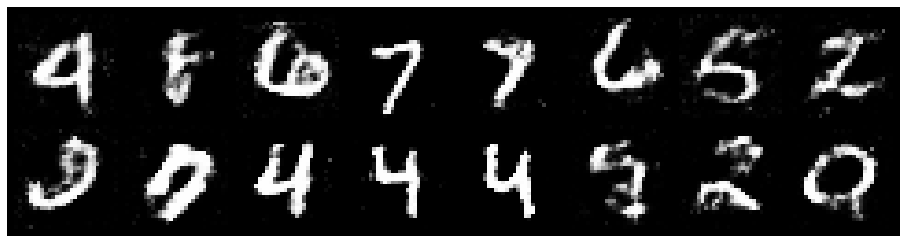

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2626, Generator Loss: 0.8952
D(x): 0.5421, D(G(z)): 0.4402


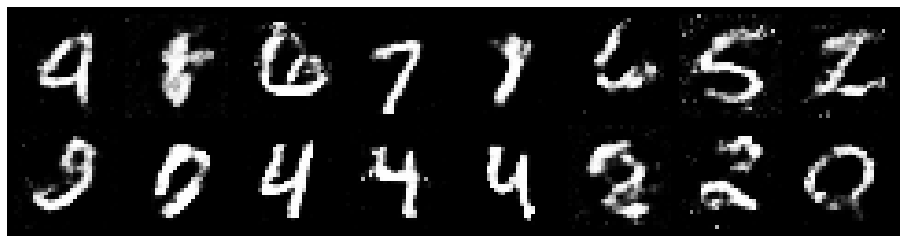

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.2476, Generator Loss: 0.8937
D(x): 0.5477, D(G(z)): 0.4384


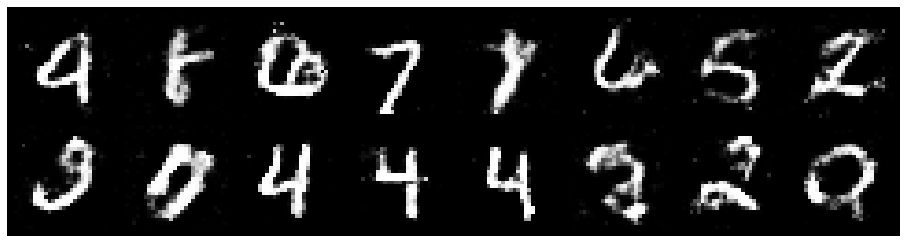

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2644, Generator Loss: 0.8695
D(x): 0.5445, D(G(z)): 0.4566


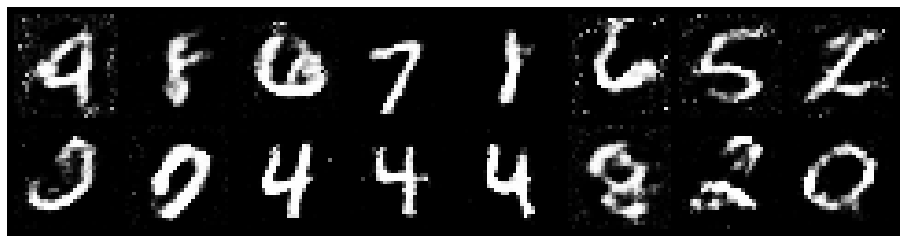

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2926, Generator Loss: 0.8705
D(x): 0.5345, D(G(z)): 0.4464


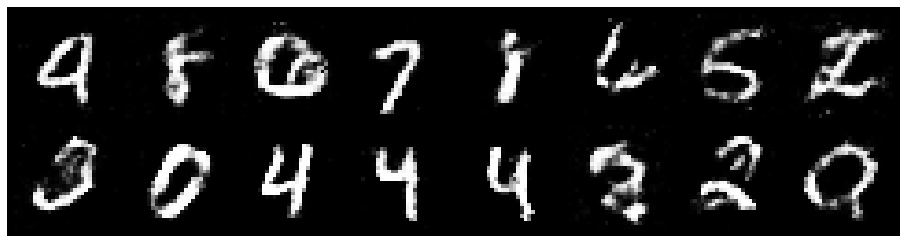

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2264, Generator Loss: 1.0180
D(x): 0.5586, D(G(z)): 0.4253


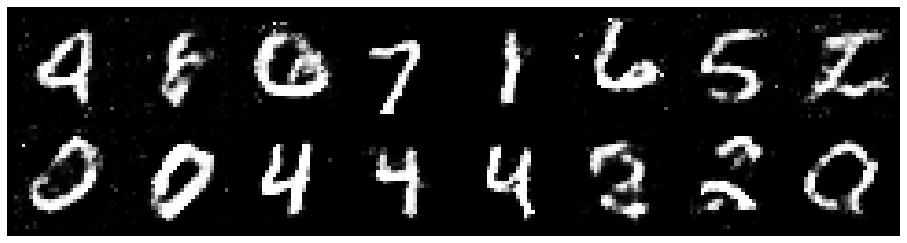

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2427, Generator Loss: 0.9221
D(x): 0.5611, D(G(z)): 0.4595


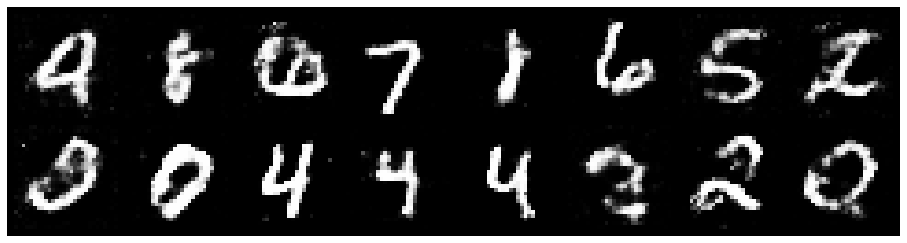

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2286, Generator Loss: 0.9124
D(x): 0.5437, D(G(z)): 0.4307


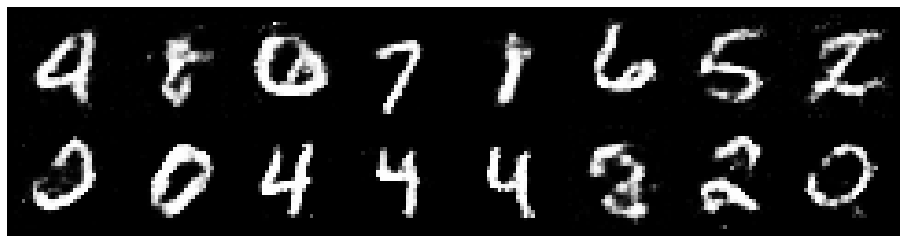

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2348, Generator Loss: 0.9763
D(x): 0.5517, D(G(z)): 0.4297


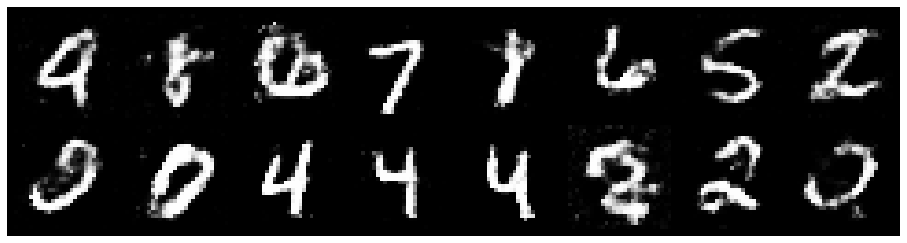

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.3365, Generator Loss: 0.8270
D(x): 0.5184, D(G(z)): 0.4552


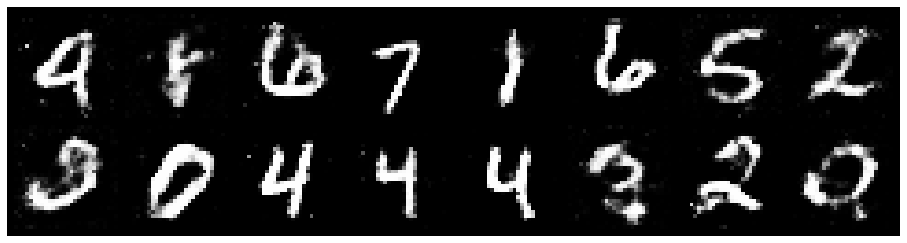

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2585, Generator Loss: 0.8797
D(x): 0.5328, D(G(z)): 0.4319


In [21]:
logger = Logger(model_name='GAN_digits', data_name='MNIST')
num_epochs = 200

for epoch in range(num_epochs):
    for n_batch,(real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        
#         Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
#     Generate fake data and detach so that gradients are not calculated for generator here
        fake_data = gen(noise(N)).detach()
#     Train D
        d_error,d_pred_real,d_pred_fake = train_discriminator(d_optim,real_data,fake_data)
    
#     Train Generator
        fake_data = gen(noise(N))
#         Train G
        g_error = train_generator(g_optim,fake_data)
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(gen(test_noise))
            test_images = test_images.data
            
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )